# <center> 14MBID .- Trabajo de Fin de Master <center>
## <center> Desarrollo de un modelo predictivo en base a sintomatología de salud mental que derivan en ansiedad y depresión <center>
###   <center> (Segunda Parte .- Análisis Exploratorio y Evaluación de Modelos) <center>
###   <center> (Enfermedad: Ansiedad) <center>
### <center> Autor: Ricardo Marrero Carrión <center>

### Indice
<ol>
<li>Librerias a Utilizar y Comprobaciones Iniciales</li>
<li>Funciones del modelo</li>
<li>Introducción</li>
<li>Carga de los Datasets</li>
<li>Análisis Exploratorio</li>
<li>Minería de Datos</li>
<li>C</li> 
<li>D</li>
<li>E</li>
</ol>

### 1.- Librerías a Utilizar y comprobaciones iniciales

In [112]:
#Librerías de uso general
from datetime import datetime
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
import matplotlib
plt.style.use('ggplot')
from matplotlib.pyplot import figure

# Funcionalidades de scikit-learn
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score, recall_score, confusion_matrix
from sklearn.linear_model import LogisticRegressionCV, SGDClassifier, LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier, StackingClassifier
from sklearn.svm import NuSVC
from sklearn.naive_bayes import GaussianNB
from xgboost import XGBClassifier
from catboost import CatBoostClassifier

# Carga de funciones adicionales
%reload_ext autoreload
%autoreload 2
import analisis_modelos as pf
import inspect
from IPython.display import Markdown, display

# Método de balanceo de clases
from imblearn.over_sampling import SMOTE

#Deshabilitar mensajes de advertencia al usuario
import warnings
warnings.filterwarnings('ignore')

#Constantes
rmst = 123
crossval = 5

In [2]:
inicio = datetime.now()
print("Fecha y hora de inicio =", inicio)

Fecha y hora de inicio = 2022-09-02 20:28:38.005978


### 2.- Funciones del Modelo

Las funciones utilizadas en el modelo, son importadas de un fichero .py llamado analisis_modelos.py

### 3.- Introducción

Una vez finalizada las fases de Limpieza de Datos, Transformaciones y Selecciones de Variables Significativas, se procede a realizar el análisis exploratorio de los conjuntos de datos resultantes y al evaluación de los algoritmos de Machine Learning, para seleccionar el modelo óptimo que busca el Dominio de este proceso. Haciendo un estudio individual para la Ansiedad y la Depresión.

Debido a que el conjunto de datos posee las etiquetas o clases que queremos clasificar, se analizarán varios métodos de Aprendizaje Supervisado. Y como referencia a estudios previos, se tomarán de base los ya utilizados por Arkaprabha Saua e Ishita Bhakta, publicado en su artículo [Screening of anxiety and depression among seafarers using machine learning technology](https://doi.org/10.1016/j.imu.2019.100228).

Los algoritmos de clasificación a analizar en este TFM son:

* __Modelos lineales:__ Regresión Logística y Stochastic Gradient Descent - SGD.
* __Modelos de Combinación de métodos (ensembles):__ Random Forest, Extra Trees, Xgboost y Catboost.
* __Modelo de Arbol de Decisión.__
* __Modelo de Support Vector Machine (SVM).__
* __Modelo basado en el algoritmo de Naive Bayes.__

Para la evaluación de los algoritmos, y su posterior comparativa y selección final, se hará uso de las siguientes métricas:

* __Matriz de confusión:__ para medir el rendimiento del modelo en las predicciones de las clases (depresión y ansiedad).
* __Precisión (Accuracy):__ porcentaje total de valores correctamente clasificados.
* __Recall (Sensibilidad) :__ porcentaje valores positivos son correctamente clasificados.
* __Area bajo la curva (AUC):__ relación entre 0 -1 del porcentaje del ratio de prediccción de verdaderos positivos vs. falsos positivos.

Una vez seleccionados los **tres mejores modelos** que ofrecen las mejores métricas, teniendo en cuenta el dominio; se construirá un clasificador que junte los estimadores y resultados individuales, en un solo modelo.

**IMPORTANTE:** Por la extensión del código utilizado, para ilustrar de una forma más clara los pasos ejecutados, se ejecutarán dos Notebook por separado. Uno para la detección de la *Ansiedad* y otro para la detección de la *Depresión.*

### 4.- Carga de los Datasets

In [3]:
#Carga de los conjuntos de datos salida de la fase de selección de variables y análisis de correlaciones

#Ansiedad
conjunto_datos = pd.read_csv('ansiedad2020_modelo.csv',index_col= 1)
conjunto_datos = conjunto_datos.drop('Unnamed: 0',axis=1)

### 5.- Análisis Exploratorio

Para proceder a esta fase, se debe recordar el objetivo del TFM, que es buscar patrones en la detección de la Ansiedad y la Depresión.

Estamos ante un problema de *Clasificación de una Clase Conocida* que tiene *dos posibles estados*: no tiene la enfermedad, o si la tiene.

Así que se deben analizar modelos y algoritmos orientados a __Clasificación de Etiquetas Binarias.__

Otro punto a tomar en cuenta en esta fase, es la tendencia de las variables objetivos. Debido a la naturaleza de la encuesta utilizada, y las respuestas ofrecidas por los entrevistados, __tanto la Clase Ansiedad como la Clase Depresión están ampliamente desbalanceadas.__

#### 5.1- Mapeo de las variables objetivos

Los valores actuales de la clase objetivo son:
* 1.- SI tiene la enfermedad.
* 2.- NO tiene la enfermedad.

Al estar en un problema de variables binarias, se cambian dichos valores a:
* 0.- NO tiene la enfermedad.
* 1.- SI tiene la enfermedad.

In [4]:
conjunto_datos['ansiedad'] = np.where((conjunto_datos['ansiedad'] == 2),0,1)

In [5]:
# Durante la evaluación de los modelos se encontró que las variables de la enfermedad a 12 meses, introducían
# ruido al modelo, se proceden a eliminar
drop_col = ['ansiedad_12meses']
conjunto_datos = conjunto_datos.drop(drop_col,axis=1)

In [6]:
# Reset a los índices para evitar errores en la validación cruzada durante la fase de Minería de Datos
conjunto_datos.reset_index(drop = True, inplace = True)

#### 5.2- Balanceo de clases

Para resolver el problema del desbalanceo de la clase objetivo, se ejecutará un *Oversampling* de la clase minoritaria, en este caso "SI tiene la enfermedad". Esta técnica consiste en añadir ejemplos a dicha condición.

Usaremos el algoritmo __SMOTE__, que mediante un sobremuestreo estadístico, añade nuevas instancias a la clase minoritaria, para igualar la cantidad de SI y NO en el conjunto de entrenamiento y test.

Es importante tomar en cuenta que a partir de este momento, el conjunto de datos generados, es el que se debe usar en las siguientes fases.

In [7]:
X = conjunto_datos.drop('ansiedad', axis=1)
y = conjunto_datos.ansiedad

In [8]:
print(y.value_counts())

0    20279
1     1793
Name: ansiedad, dtype: int64


In [9]:
# Técnica de Over-sampling basada en SMOTE
smote = SMOTE(sampling_strategy ='auto' , random_state = rmst)
X_sampling, y_sampling = smote.fit_resample(X, y)

In [10]:
print(y_sampling.value_counts())

0    20279
1    20279
Name: ansiedad, dtype: int64


Clase 0: 20279
Clase 1: 20279
Proportion: 1.0 : 1


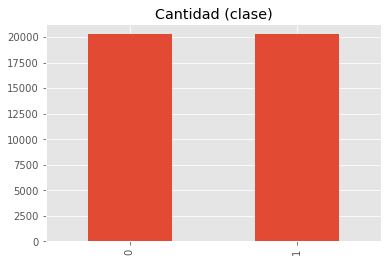

In [11]:
target_count = y_sampling.value_counts()
cero = target_count[0]
uno = target_count[1]
print('Clase 0:', cero)
print('Clase 1:', uno)
print('Proportion:', round(target_count[0] / target_count[1], 2), ': 1')

target_count.plot(kind='bar', title='Cantidad (clase)');

Así, se han creado 18.486 nuevas muestras en las instancias de la clase minoritaria (1) para balancear con la clase mayoritaria (2)

#### 5.3- Construcción de los conjuntos de entrenamiento y pruebas

In [12]:
X_train, X_test, y_train, y_test = train_test_split(X_sampling, y_sampling,
                                                    test_size=.20, 
                                                    random_state=rmst, 
                                                    stratify= y_sampling)

In [13]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(32446, 16)
(8112, 16)
(32446,)
(8112,)


Se observa que al haber aplicado el balanceo de clases mediante SMOTE, el conjunto de datos ha aumentado de 22072 instancias a 40558 instancias.

#### 5.4- Funciones de evaluación

Para la elaboración de las gráficas a utilizar en la vizualización de las métricas de cada algoritmo, se ha utilizado una herramienta desarrollada por Vivienne DiFrancesco, y disponible en el siguiente repositorio de GitHub: [project_functions](https://github.com/HeyThatsViv/Predicting-Depression.git)

In [14]:
# Classification report
func = inspect.getsource(pf.make_classification_report)

In [15]:
#Matriz de Confusión
func = inspect.getsource(pf.plot_confusion_matrix)

In [16]:
# Gráfico ROC (Area bajo la curva)
func = inspect.getsource(pf.plot_roc_curve)

In [17]:
# Variables significativas para los modelos de árbol
func = inspect.getsource(pf.plot_top_features)

In [18]:
# Constructor funciones de evaluación
func = inspect.getsource(pf.evaluate_model)

#### 5.5- Estudio de algoritmos de clasificación

A continuación se va a proceder a estudiar varios modelos de aprendizaje supervisado que pueden ser utilizados para la clasificación de variables binarias balanceadas.

Como se comentó en la primera parte, como estrategia se utilizarán los 5 modelos propuestos por Sausa y Bhakta en su estudio, y se añaden otros modelos que podrían tener buen rendimiento en problemas de clasificación.

Para cada clasificador se estudiarán dos modelos:

* Una versión base, con los estimadores por defecto que trae cada algoritmo.
* Una versión con análisis de parámetros basada en GridSearchCV (parrilla de parámetros con validación cruzada)

##### 5.5.1- Regresión Logística

In [19]:
# Clasificador Base
logreg_clf = LogisticRegressionCV(random_state=rmst,
                                  n_jobs=-1,
                                  cv = crossval
                                  )

# Entrenamiento
logreg_base = logreg_clf.fit(X_train, y_train)

__________________________________________________________________
Reporte para el Clasificador: 
	Regresión Logística CV
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.62      0.68      0.65      4056
           1       0.65      0.59      0.62      4056

    accuracy                           0.63      8112
   macro avg       0.64      0.63      0.63      8112
weighted avg       0.64      0.63      0.63      8112

__________________________________________________________________


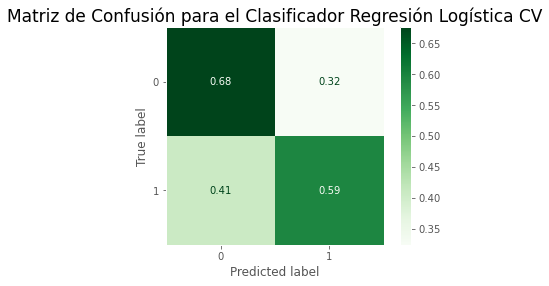

__________________________________________________________________


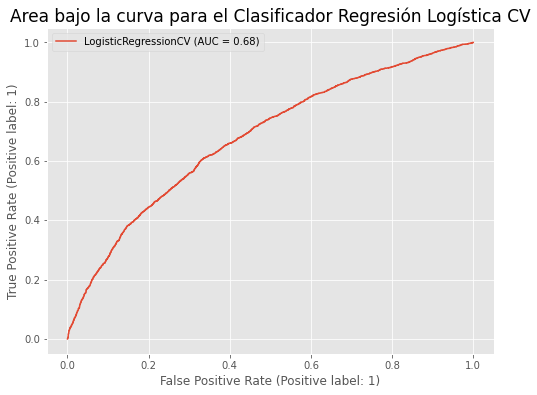

In [20]:
# Evaluación del modelo base
pf.evaluate_model(logreg_base, X_train, X_test, y_test, 
               title='Regresión Logística CV')

In [21]:
# Clasificador aplicando GridSearch CV
Cs_list = list(logreg_base.Cs_)
Cs_list

[0.0001,
 0.000774263682681127,
 0.005994842503189409,
 0.046415888336127774,
 0.3593813663804626,
 2.782559402207126,
 21.54434690031882,
 166.81005372000558,
 1291.5496650148827,
 10000.0]

In [22]:
# Estimadores a analizar
logreg_params = {'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 
                 'C': Cs_list,
                 'penalty': ['l1', 'l2', 'elasticnet', 'none']
                }

# Clasificador Base
logreg_clf2 = LogisticRegression(random_state=rmst,
                                  n_jobs=-1,
                               )

# Evaluación y selección de estimadores
gridcv_logreg = GridSearchCV(logreg_clf2,
                    logreg_params, 
                    n_jobs=-1,
                    cv = crossval)

# Entrenamiento
logreg_grid = gridcv_logreg.fit(X_train, y_train)

In [23]:
# Mejores estimadores
logreg_grid.best_params_

{'C': 2.782559402207126, 'penalty': 'l1', 'solver': 'saga'}

In [24]:
C_drill_list = list(np.linspace(logreg_grid.best_params_['C']/5, logreg_grid.best_params_['C']*5, 10))
C_drill_list.append(logreg_grid.best_params_['C'])
C_drill_list

[0.5565118804414252,
 2.0405435616185588,
 3.5245752427956925,
 5.008606923972826,
 6.49263860514996,
 7.976670286327094,
 9.460701967504226,
 10.94473364868136,
 12.428765329858495,
 13.912797011035629,
 2.782559402207126]

In [25]:
# Estimadores a analizar
logreg_params = {'C': C_drill_list}

# Clasificador con los mejores estimadores
logreg_clf2 = LogisticRegression(solver='saga', 
                                random_state=rmst,
                                penalty = 'l1',
                                n_jobs=-1
                               )

# Evaluación y selección de estimadores
gridcv_logreg = GridSearchCV(logreg_clf2,
                             logreg_params,
                             n_jobs=-1,
                             cv = crossval)

# Entrenamiento
logreg_grid2 = gridcv_logreg.fit(X_train, y_train)

In [26]:
# Mejores estimadores
logreg_grid2.best_params_

{'C': 2.0405435616185588}

In [27]:
# Modelo Regresión logística con estimadores
logreg_gridmodel = logreg_grid2.best_estimator_
logreg_gridmodel

LogisticRegression(C=2.0405435616185588, n_jobs=-1, penalty='l1',
                   random_state=123, solver='saga')

__________________________________________________________________
Reporte para el Clasificador: 
	Regresión Logística con GridSearch CV
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.62      0.68      0.65      4056
           1       0.65      0.59      0.62      4056

    accuracy                           0.63      8112
   macro avg       0.64      0.63      0.63      8112
weighted avg       0.64      0.63      0.63      8112

__________________________________________________________________


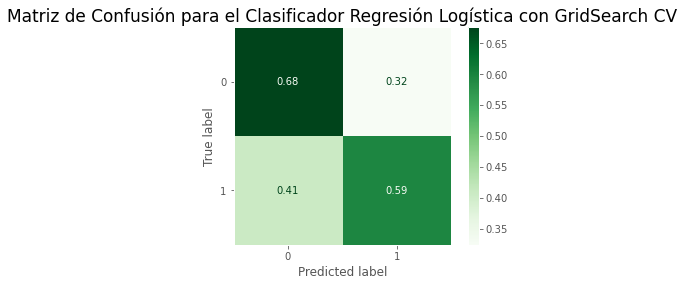

__________________________________________________________________


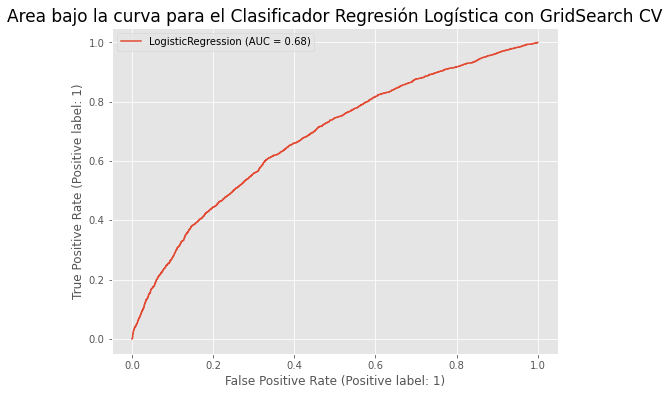

In [28]:
# Evaluación del modelo
pf.evaluate_model(logreg_gridmodel, X_train, X_test, y_test, 
               title='Regresión Logística con GridSearch CV')

##### 5.5.2- Arbol de Decisiones

In [29]:
# Clasificador Base
tree_clf = DecisionTreeClassifier(random_state=rmst)

# Entrenamiento
tree_base = tree_clf.fit(X_train, y_train)

__________________________________________________________________
Reporte para el Clasificador: 
	Arbol de Decisión
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.91      0.89      0.90      4056
           1       0.89      0.92      0.91      4056

    accuracy                           0.90      8112
   macro avg       0.90      0.90      0.90      8112
weighted avg       0.90      0.90      0.90      8112

__________________________________________________________________


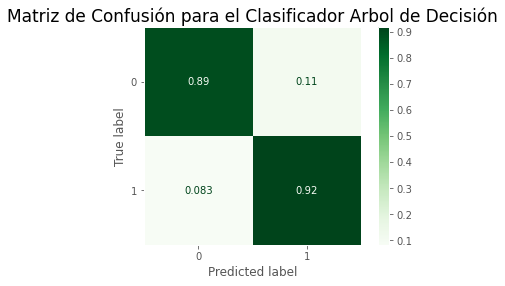

__________________________________________________________________


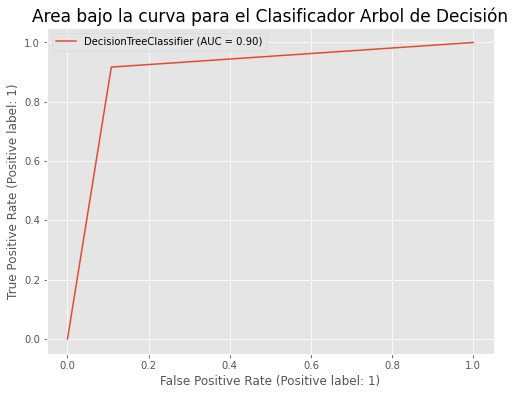

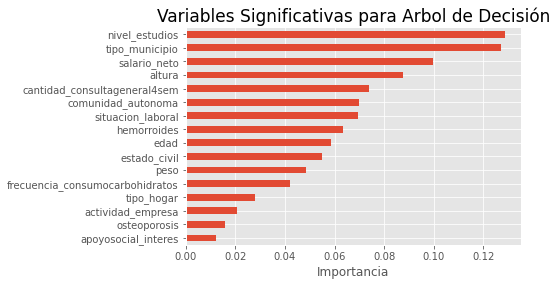

In [30]:
# Evaluación del modelo base
pf.evaluate_model(tree_base, X_train, X_test, y_test, 
               tree=True, title='Arbol de Decisión')

In [31]:
# Clasificador aplicando GridSearch CV
# Estimadores a analizar
tree_params = {'max_features': ['auto', 'sqrt', 'log2'],
               'ccp_alpha': [0.1, .01, .001],
               'max_depth' : [5, 6, 7, 8, 9],
               'criterion' :['gini', 'entropy', 'log_loss']
              }

# Clasificador Base
tree_clf2 = DecisionTreeClassifier(random_state = rmst)

# Evaluación y selección de estimadores
gridcv_tree = GridSearchCV(tree_clf2,
                    tree_params,
                    n_jobs=-1,
                    cv = crossval)

# Entrenamiento
tree_grid = gridcv_tree.fit(X_train, y_train)

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/en

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/en

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none'

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/en

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none'

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_mode

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_mode

In [32]:
# Mejores estimadores
tree_grid.best_params_

{'ccp_alpha': 0.001,
 'criterion': 'gini',
 'max_depth': 9,
 'max_features': 'auto'}

In [33]:
# Estimadores a analizar
tree_params = {'ccp_alpha': [0.1, .01, .001],
               'max_depth' : [1, 2, 3, 4, 5, 6, 7, 8, 9],
              }

# Clasificador con los mejores estimadores
tree_clf2 = DecisionTreeClassifier(random_state = rmst,
                                   criterion='gini',
                                   max_features= 'auto')

# Evaluación y selección de estimadores
gridcv_tree = GridSearchCV(tree_clf2,
                           tree_params,
                           n_jobs=-1,
                           cv = crossval)

# Entrenamiento
tree_grid2 = gridcv_tree.fit(X_train, y_train)

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWar

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none'

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1113: UserWarning: Setting penalty='none' will ignore the C and l1_ratio parameters
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebre

In [34]:
# Mejores estimadores
tree_grid2.best_params_

{'ccp_alpha': 0.001, 'max_depth': 9}

In [35]:
# Modelo Arbol de Desición con estimadores
tree_gridmodel = tree_grid2.best_estimator_
tree_gridmodel

DecisionTreeClassifier(ccp_alpha=0.001, max_depth=9, max_features='auto',
                       random_state=123)

__________________________________________________________________
Reporte para el Clasificador: 
	Arbol de Decisión con GridSearchCV
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.68      0.84      0.75      4056
           1       0.79      0.60      0.68      4056

    accuracy                           0.72      8112
   macro avg       0.73      0.72      0.72      8112
weighted avg       0.73      0.72      0.72      8112

__________________________________________________________________


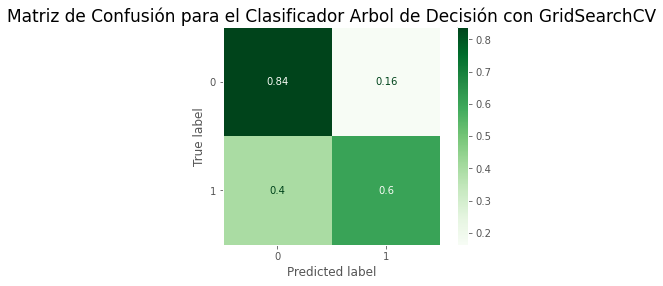

__________________________________________________________________


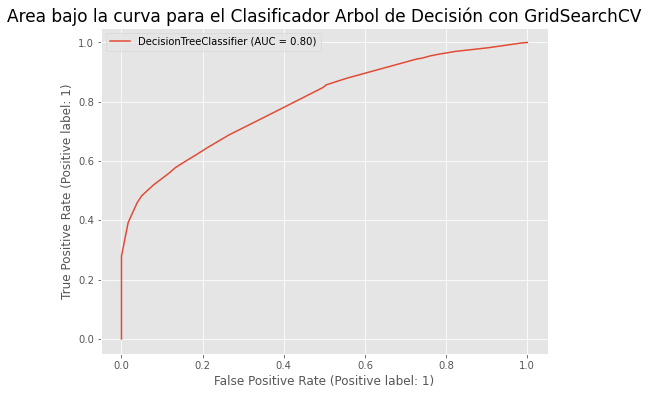

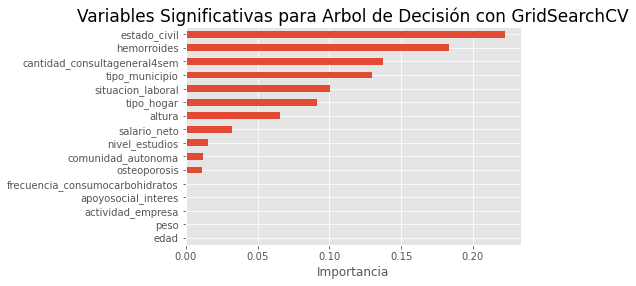

In [36]:
# Evaluación del modelo
pf.evaluate_model(tree_gridmodel, X_train, X_test, y_test, 
               tree=True, title='Arbol de Decisión con GridSearchCV')

##### 5.5.3- Support Vector Machine (SVM)

In [37]:
# Clasificador Base
svm_clf = NuSVC(random_state = rmst)

# Entrenamiento
svm_base = svm_clf.fit(X_train, y_train)

__________________________________________________________________
Reporte para el Clasificador: 
	Support Vector Machine
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.88      0.78      0.83      4056
           1       0.80      0.89      0.84      4056

    accuracy                           0.84      8112
   macro avg       0.84      0.84      0.84      8112
weighted avg       0.84      0.84      0.84      8112

__________________________________________________________________


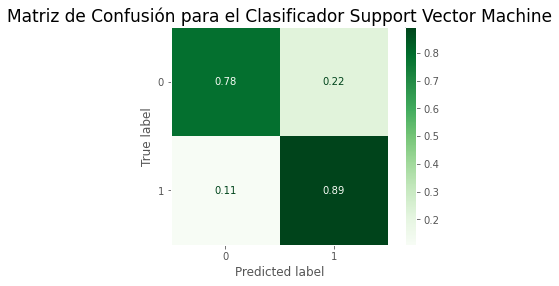

__________________________________________________________________


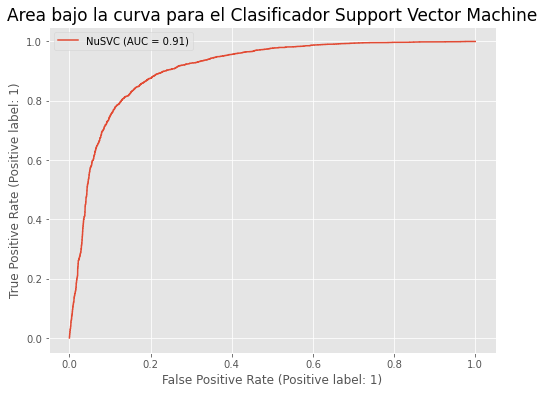

In [38]:
# Evaluación del modelo base
pf.evaluate_model(svm_base, X_train, X_test, y_test, 
               title='Support Vector Machine')

In [39]:
# Clasificador aplicando GridSearch CV
# Estimadores a analizar
svm_params = {'nu': [0,.25,.5,.75,1], 
              'kernel': ['linear','rbf','sigmoid']
             }

# Clasificador Base
svm_clf2 = NuSVC(random_state = rmst)

# Evaluación y selección de estimadores
grid_svm = GridSearchCV(svm_clf2,
                    svm_params,
                    n_jobs=-1,
                    cv = crossval)

# Entrenamiento
svm_grid = grid_svm.fit(X_train, y_train)

In [40]:
# Mejores estimadores
svm_grid.best_params_

{'kernel': 'rbf', 'nu': 0.25}

In [41]:
# Estimadores a analizar
svm_params = {'nu': [0,.125,.25]}

# Clasificador con los mejores estimadores
svm_clf2 = NuSVC(random_state = rmst,
                 kernel= 'rbf')

# Evaluación y selección de estimadores
grid_svm = GridSearchCV(svm_clf2,
                    svm_params,
                    n_jobs=-1,
                    cv = crossval)

# Entrenamiento
svm_grid2 = grid_svm.fit(X_train, y_train)

In [42]:
# Mejores estimadores
svm_grid2.best_params_

{'nu': 0.125}

In [43]:
# Modelo SVM con estimadores
svm_gridmodel = svm_grid2.best_estimator_
svm_gridmodel

NuSVC(nu=0.125, random_state=123)

__________________________________________________________________
Reporte para el Clasificador: 
	Support Vector Machine con GridSearchCV
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.99      0.88      0.93      4056
           1       0.89      0.99      0.94      4056

    accuracy                           0.93      8112
   macro avg       0.94      0.93      0.93      8112
weighted avg       0.94      0.93      0.93      8112

__________________________________________________________________


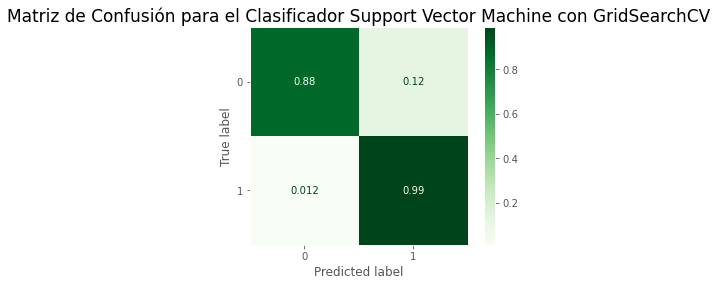

__________________________________________________________________


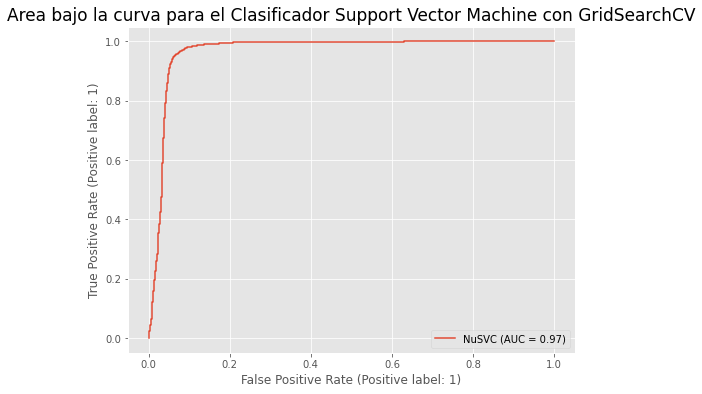

In [44]:
# Evaluación del modelo
pf.evaluate_model(svm_gridmodel, X_train, X_test, y_test, 
                  title='Support Vector Machine con GridSearchCV')

##### 5.5.4- Naive Bayes

In [46]:
# Clasificador Base
gnb_clf = GaussianNB()

# Entrenamiento
nb_base = gnb_clf.fit(X_train, y_train)

__________________________________________________________________
Reporte para el Clasificador: 
	Naive Bayes
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.61      0.74      0.67      4056
           1       0.67      0.52      0.58      4056

    accuracy                           0.63      8112
   macro avg       0.64      0.63      0.62      8112
weighted avg       0.64      0.63      0.62      8112

__________________________________________________________________


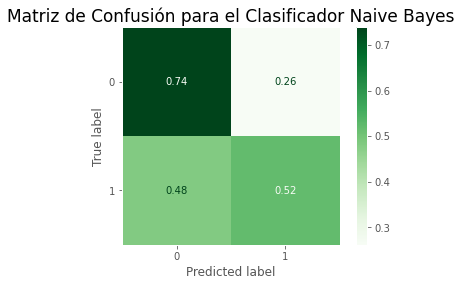

__________________________________________________________________


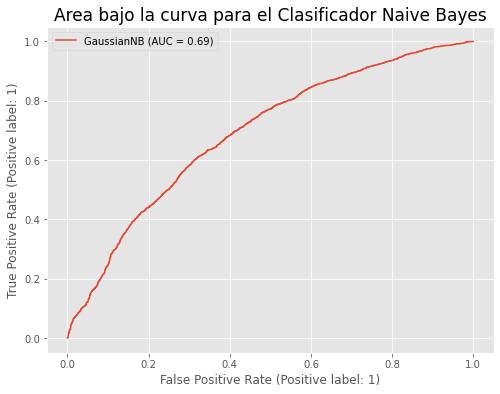

In [47]:
# Evaluación del modelo base
pf.evaluate_model(nb_base, X_train, X_test, y_test, 
               title='Naive Bayes')

In [48]:
# Clasificador aplicando GridSearch CV
# Estimadores a analizar
nb_params = {}

# Clasificador Base
gnb_clf2 = GaussianNB()

# Evaluación y selección de estimadores
grid_nb = GridSearchCV(gnb_clf,
                     nb_params,
                     cv = crossval,
                     scoring='f1_micro',
                     verbose=1,
                     n_jobs=-1)

# Entrenamiento
nb_grid2 = grid_nb.fit(X_train, y_train)

Fitting 10 folds for each of 1 candidates, totalling 10 fits


In [49]:
# Mejores estimadores
nb_grid2.best_params_

{}

In [50]:
# Modelo NB con estimadores
nb_gridmodel = nb_grid2.best_estimator_
nb_gridmodel

GaussianNB()

__________________________________________________________________
Reporte para el Clasificador: 
	Naive Bayes con GridSearch CV
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.61      0.74      0.67      4056
           1       0.67      0.52      0.58      4056

    accuracy                           0.63      8112
   macro avg       0.64      0.63      0.62      8112
weighted avg       0.64      0.63      0.62      8112

__________________________________________________________________


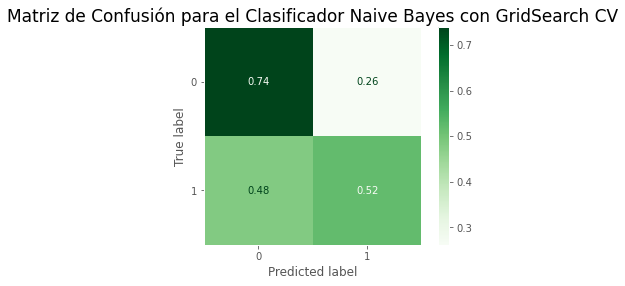

__________________________________________________________________


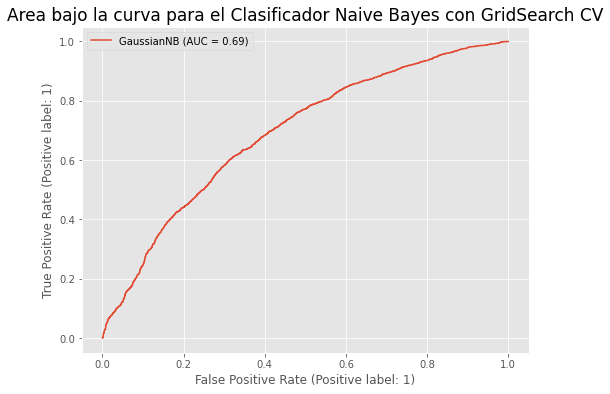

In [51]:
# Evaluación del modelo
pf.evaluate_model(nb_gridmodel, X_train, X_test, y_test, 
                  title='Naive Bayes con GridSearch CV')

##### 5.5.5- Stochastic Gradient Descent Linear Classifier (SGD)

In [52]:
# Clasificador Base
sgd_clf = SGDClassifier(random_state= rmst, n_jobs=-1)

# Entrenamiento
sgd_base = sgd_clf.fit(X_train, y_train)

__________________________________________________________________
Reporte para el Clasificador: 
	SGD
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.63      0.64      0.63      4056
           1       0.63      0.62      0.63      4056

    accuracy                           0.63      8112
   macro avg       0.63      0.63      0.63      8112
weighted avg       0.63      0.63      0.63      8112

__________________________________________________________________


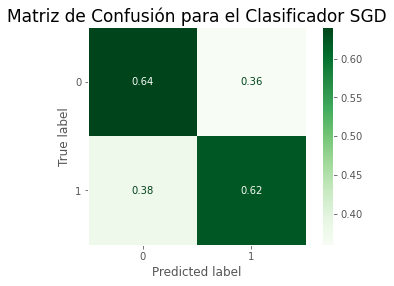

__________________________________________________________________


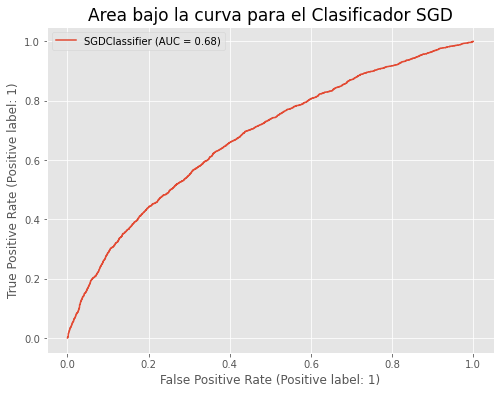

In [53]:
# Evaluación del modelo base
pf.evaluate_model(sgd_base, X_train, X_test, y_test, 
               title='SGD')

In [54]:
# Clasificador aplicando GridSearch CV
# Estimadores a analizar
sgd_params = {'loss': ['hinge', 'log_loss', 'log', 'modified_huber', 'squared_hinge', 'perceptron',
                       'squared_error', 'huber', 'epsilon_insensitive', 'squared_epsilon_insensitive'], 
              'penalty': ['l2', 'l1', 'elasticnet'],
              'fit_intercept': [True, False], 
              'alpha': [.01, .001, .0001, .00001]}

# Clasificador Base
sgd_clf2 = SGDClassifier(random_state=rmst, n_jobs=-1)

# Evaluación y selección de estimadores
grid_sgd = GridSearchCV(sgd_clf2,
                        sgd_params,
                        n_jobs=-1,
                        cv = crossval)

# Entrenamiento
sgd_grid = grid_sgd.fit(X_train, y_train)

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been d

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been d

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:1153: UserWarning: 'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 8.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/en

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been d

/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/opt/homebrew/Caskroom/miniforge/base/envs/env_1/lib/python3.8/site-packages/sklearn/tree/_classes.py:298: FutureWarning: `max_features='auto'` has been d

In [55]:
# Mejores estimadores
sgd_grid.best_params_

{'alpha': 0.001, 'fit_intercept': True, 'loss': 'log_loss', 'penalty': 'l2'}

In [56]:
# Estimadores a analizar
sgd_params = {'alpha': [1, .5, .1, .05, .01, .005, .001]}

# Clasificador con los mejores estimadores
sgd_clf2 = SGDClassifier(random_state=rmst,
                        n_jobs=-1,
                        fit_intercept=True, 
                        loss='log_loss',
                        penalty='l2',
                        l1_ratio=.4)

# Evaluación y selección de estimadores
grid_sgd = GridSearchCV(sgd_clf2,
                        sgd_params,
                        n_jobs=-1,
                        cv= crossval)

# Entrenamiento
sgd_grid2 = grid_sgd.fit(X_train, y_train)

In [57]:
# Mejores estimadores
sgd_grid2.best_params_

{'alpha': 0.001}

In [58]:
# Modelo SGD con estimadores
sgd_grid_finalmodel = sgd_grid2.best_estimator_
sgd_grid_finalmodel

SGDClassifier(alpha=0.001, l1_ratio=0.4, loss='log_loss', n_jobs=-1,
              random_state=123)

__________________________________________________________________
Reporte para el Clasificador: 
	SGD con GridSearch CV
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.63      0.65      0.64      4056
           1       0.64      0.62      0.63      4056

    accuracy                           0.63      8112
   macro avg       0.63      0.63      0.63      8112
weighted avg       0.63      0.63      0.63      8112

__________________________________________________________________


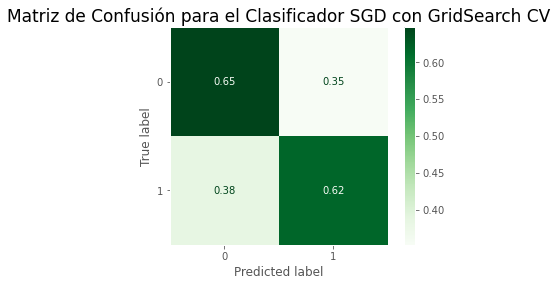

__________________________________________________________________


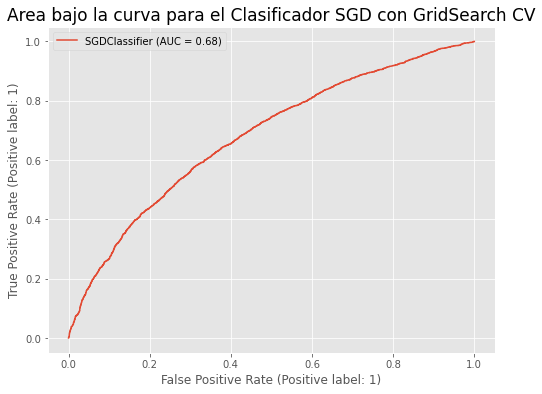

In [59]:
# Evaluación del modelo
pf.evaluate_model(sgd_grid_finalmodel, X_train, X_test, y_test, 
               title='SGD con GridSearch CV')

##### 5.5.6- Random Forest

In [60]:
# Clasificador Base
forest_clf = RandomForestClassifier(n_jobs=-1, 
                                    random_state=rmst)

# Entrenamiento
forest_base = forest_clf.fit(X_train, y_train)

__________________________________________________________________
Reporte para el Clasificador: 
	Random Forest
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.93      0.99      0.96      4056
           1       0.99      0.93      0.96      4056

    accuracy                           0.96      8112
   macro avg       0.96      0.96      0.96      8112
weighted avg       0.96      0.96      0.96      8112

__________________________________________________________________


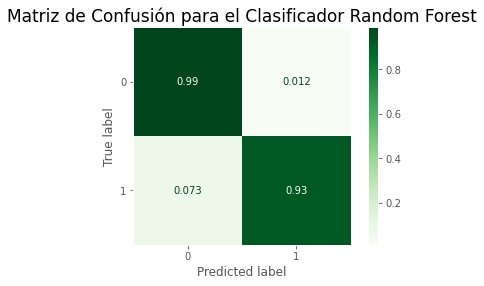

__________________________________________________________________


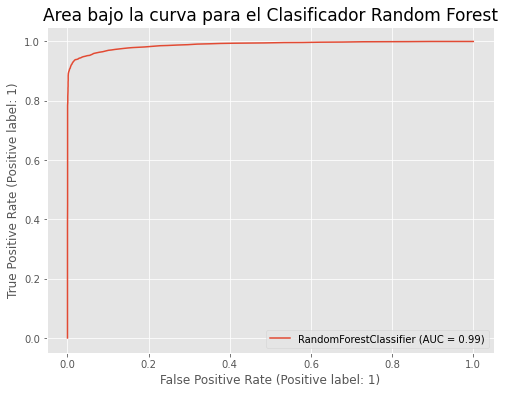

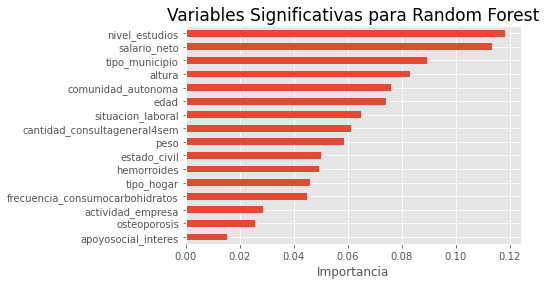

In [61]:
# Evaluación del modelo base
pf.evaluate_model(forest_base, X_train, X_test, y_test, 
               tree=True, title='Random Forest')

In [62]:
# Clasificador aplicando GridSearch CV
# Estimadores a analizar
forest_params = {'criterion': ['gini', 'entropy','log_loss'], 
                 'max_depth': [None, 5, 10, 20, 50], 
                 'min_samples_leaf': [1, 10, 20], 
                 'max_features': ['sqrt', 'log2', None],
                 'max_samples': [None, .5, .7, .9]
                }

# Clasificador Base
forest_clf2 = RandomForestClassifier(random_state=rmst)

# Evaluación y selección de estimadores
grid_forest = GridSearchCV(forest_clf2,
                           forest_params
                           ,n_jobs=-1,
                           cv= crossval)

# Entrenamiento
forest_grid = grid_forest.fit(X_train, y_train)

In [63]:
# Mejores estimadores
forest_grid.best_params_

{'criterion': 'gini',
 'max_depth': None,
 'max_features': 'sqrt',
 'max_samples': None,
 'min_samples_leaf': 1}

In [64]:
# Estimadores a analizar
forest_params = {}

# Clasificador con los mejores estimadores
forest_clf2 = RandomForestClassifier(random_state=rmst, 
                                    criterion='gini', 
                                    max_depth= None,
                                    max_features='sqrt',
                                    min_samples_leaf = 1,
                                    max_samples = None
                                   )

# Evaluación y selección de estimadores
grid_forest = GridSearchCV(forest_clf2,
                           forest_params,
                           n_jobs=-1,
                           cv= crossval)

# Entrenamiento
forest_grid2 = grid_forest.fit(X_train, y_train)

In [65]:
# Mejores estimadores
forest_grid2.best_params_

{}

In [66]:
# Modelo Random Forest con estimadores
forest_gridmodel = forest_grid2.best_estimator_
forest_gridmodel

RandomForestClassifier(random_state=123)

__________________________________________________________________
Reporte para el Clasificador: 
	Random Forest con GridSearch CV
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.93      0.99      0.96      4056
           1       0.99      0.93      0.96      4056

    accuracy                           0.96      8112
   macro avg       0.96      0.96      0.96      8112
weighted avg       0.96      0.96      0.96      8112

__________________________________________________________________


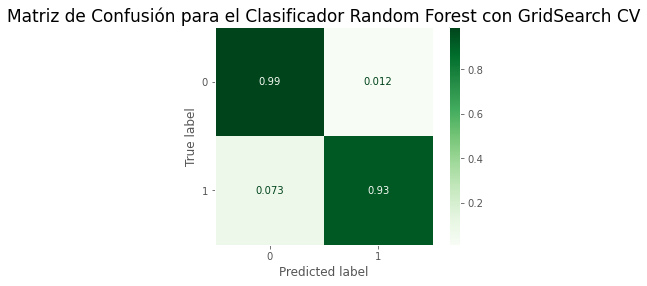

__________________________________________________________________


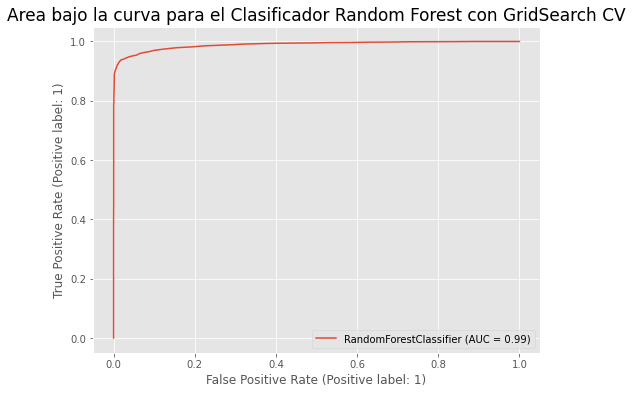

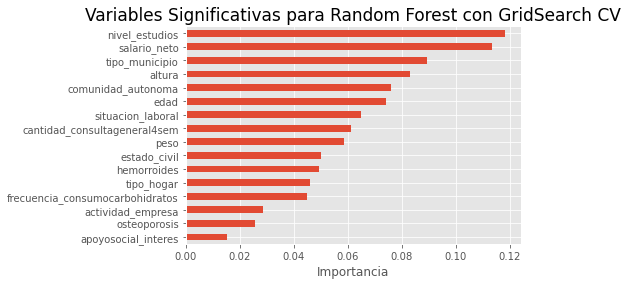

In [67]:
# Evaluación del modelo
pf.evaluate_model(forest_gridmodel, X_train, X_test, y_test, 
               tree=True, title='Random Forest con GridSearch CV')

##### 5.5.7- Extra Trees

In [69]:
# Clasificador Base
extratrees_clf = ExtraTreesClassifier(n_jobs=-1,
                                       random_state=rmst)


# Entrenamiento
extratrees_base = extratrees_clf.fit(X_train, y_train)

__________________________________________________________________
Reporte para el Clasificador: 
	Extra Trees
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.98      0.98      0.98      4056
           1       0.98      0.98      0.98      4056

    accuracy                           0.98      8112
   macro avg       0.98      0.98      0.98      8112
weighted avg       0.98      0.98      0.98      8112

__________________________________________________________________


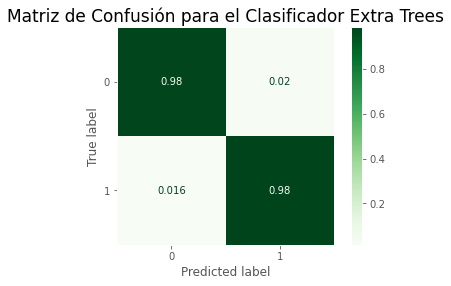

__________________________________________________________________


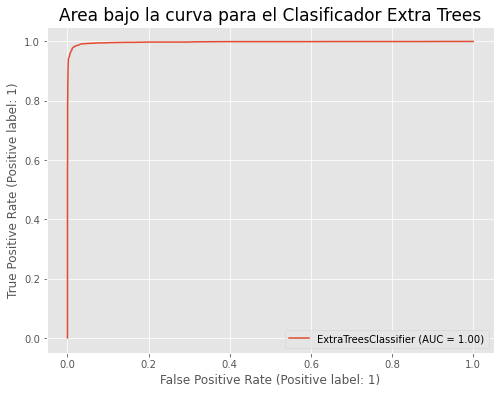

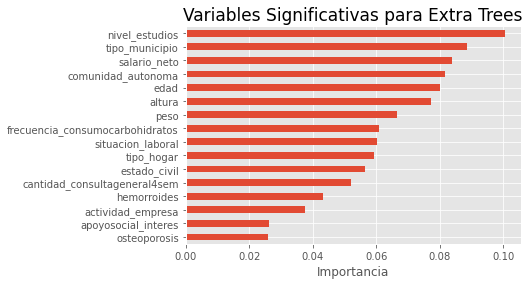

In [70]:
# Evaluación del modelo base
pf.evaluate_model(extratrees_base, X_train, X_test, y_test, 
               tree=True, title='Extra Trees')

In [71]:
# Clasificador aplicando GridSearch CV
# Estimadores a analizar
trees_params = {'criterion': ['gini', 'entropy','log_loss'], 
                'max_depth': [None, 10, 50], 
                'min_samples_leaf': [1, 5], 
                'max_features': ['sqrt','log2', None], 
                'bootstrap': [True, False], 
                'max_samples': [.5, .7, .9]
               }

# Clasificador Base
extratrees_clf2 = ExtraTreesClassifier(random_state=rmst)

# Evaluación y selección de estimadores
grid_extratree = GridSearchCV(extratrees_clf2,
                              trees_params,
                              n_jobs=-1,
                              cv= crossval)

# Entrenamiento
extratrees_grid = grid_extratree.fit(X_train, y_train)

In [72]:
# Mejores estimadores
extratrees_grid.best_params_

{'bootstrap': True,
 'criterion': 'entropy',
 'max_depth': 50,
 'max_features': 'sqrt',
 'max_samples': 0.9,
 'min_samples_leaf': 1}

In [73]:
# Estimadores a analizar
trees_params ={'max_depth': [5, 10, 20, 30, 40,50], 
               'max_samples': [.3, .4, .5, .6, .9]}

# Clasificador con los mejores estimadores
extratrees_clf2 = ExtraTreesClassifier(random_state=rmst, 
                                      criterion='entropy', 
                                      bootstrap=True, 
                                      max_features='sqrt',
                                      min_samples_leaf = 1
                                     )

# Evaluación y selección de estimadores
grid_extratree = GridSearchCV(extratrees_clf2,
                             trees_params,
                             n_jobs=-1,
                             cv= crossval)

# Entrenamiento
extratrees_grid2 = grid_extratree.fit(X_train, y_train)

In [74]:
# Mejores estimadores
extratrees_grid2.best_params_

{'max_depth': 50, 'max_samples': 0.9}

In [75]:
# Modelo Extra Trees con estimadores
extratrees_gridmodel = extratrees_grid2.best_estimator_
extratrees_gridmodel

ExtraTreesClassifier(bootstrap=True, criterion='entropy', max_depth=50,
                     max_samples=0.9, random_state=123)

__________________________________________________________________
Reporte para el Clasificador: 
	Extra Trees con GridSearch CV
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.98      0.97      0.97      4056
           1       0.97      0.98      0.97      4056

    accuracy                           0.97      8112
   macro avg       0.97      0.97      0.97      8112
weighted avg       0.97      0.97      0.97      8112

__________________________________________________________________


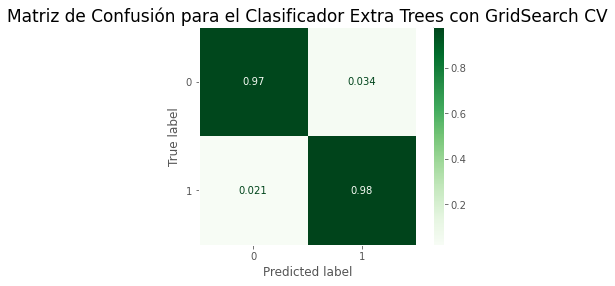

__________________________________________________________________


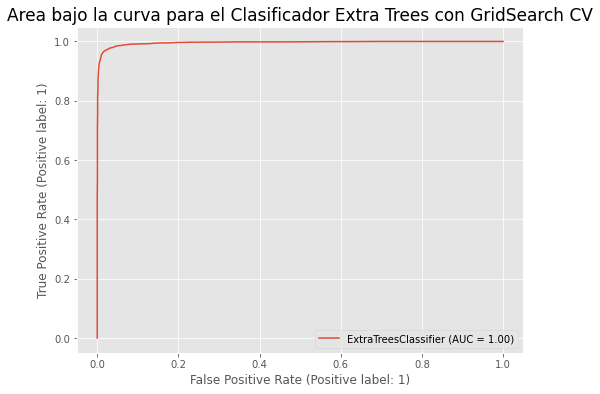

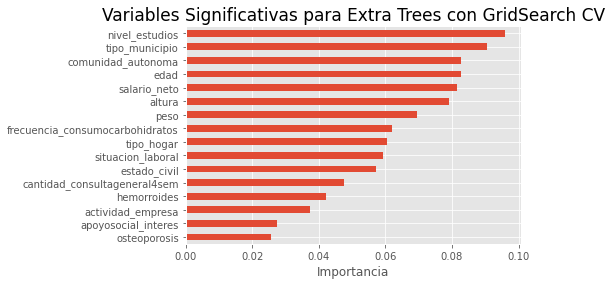

In [76]:
# Evaluación del modelo
pf.evaluate_model(extratrees_gridmodel, X_train, X_test, y_test, 
               tree=True, title='Extra Trees con GridSearch CV')

##### 5.5.8- XgBoost

In [77]:
# Clasificador Base
xgb_clf = XGBClassifier(seed = rmst)

# Entrenamiento
xgb_base = xgb_clf.fit(X_train, y_train)

__________________________________________________________________
Reporte para el Clasificador: 
	Xgboost
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.88      0.98      0.93      4056
           1       0.97      0.87      0.92      4056

    accuracy                           0.92      8112
   macro avg       0.93      0.92      0.92      8112
weighted avg       0.93      0.92      0.92      8112

__________________________________________________________________


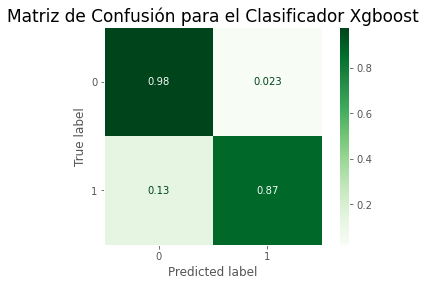

__________________________________________________________________


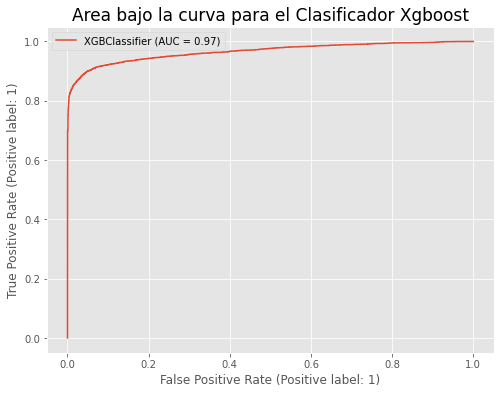

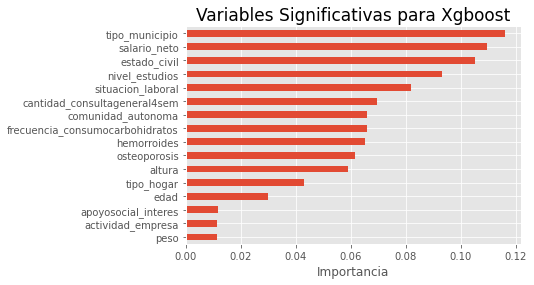

In [78]:
# Evaluación del modelo base
pf.evaluate_model(xgb_base, X_train, X_test, y_test, 
               title='Xgboost', tree=True)

In [79]:
# Clasificador aplicando GridSearch CV
# Estimadores a analizar
xgb_params = {'max_depth': [None, 3, 10], 
              'learning_rate': [.1, .05], 
              'min_child_weight': [1, 5, 10], 
              'subsample': [.3, .5, .7]
              }

# Clasificador Base
xgb_clf2 = XGBClassifier(n_jobs=-1, random_state=rmst)

# Evaluación y selección de estimadores
grid_xgb = GridSearchCV(xgb_clf2,
                        xgb_params,
                        n_jobs=-1,
                        cv= crossval)

# Entrenamiento
xgb_grid = grid_xgb.fit(X_train, y_train)

In [80]:
# Mejores estimadores
xgb_grid.best_params_

{'learning_rate': 0.1,
 'max_depth': 10,
 'min_child_weight': 1,
 'subsample': 0.7}

In [81]:
# Estimadores a analizar
xgb_params = {'max_depth': [5, 10], 
              'learning_rate': [.1, .01, .03], 
              'subsample': [.2, .3, .7]
             }

# Clasificador con los mejores estimadores
xgb_clf2 = XGBClassifier(n_jobs=-1,
                          random_state=rmst,
                          min_child_weight=1)

# Evaluación y selección de estimadores
grid_xgb = GridSearchCV(xgb_clf2,
                        xgb_params,
                        n_jobs=-1,
                        cv= crossval)

# Entrenamiento
xgb_grid2 = grid_xgb.fit(X_train, y_train)

In [82]:
# Mejores estimadores
xgb_grid2.best_params_

{'learning_rate': 0.1, 'max_depth': 10, 'subsample': 0.7}

In [83]:
# Modelo XGboost con estimadores
xgb_gridmodel = xgb_grid2.best_estimator_
xgb_gridmodel

XGBClassifier(max_depth=10, n_jobs=-1, random_state=123, subsample=0.7)

__________________________________________________________________
Reporte para el Clasificador: 
	XgBoost con GridSearchCV
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.92      0.99      0.95      4056
           1       0.99      0.91      0.95      4056

    accuracy                           0.95      8112
   macro avg       0.95      0.95      0.95      8112
weighted avg       0.95      0.95      0.95      8112

__________________________________________________________________


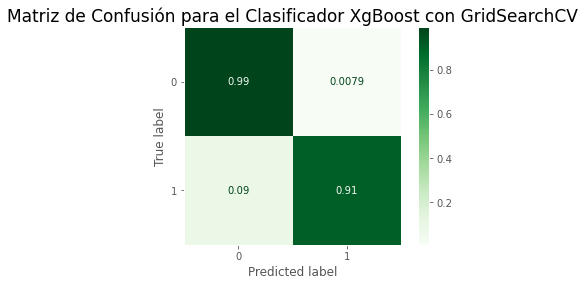

__________________________________________________________________


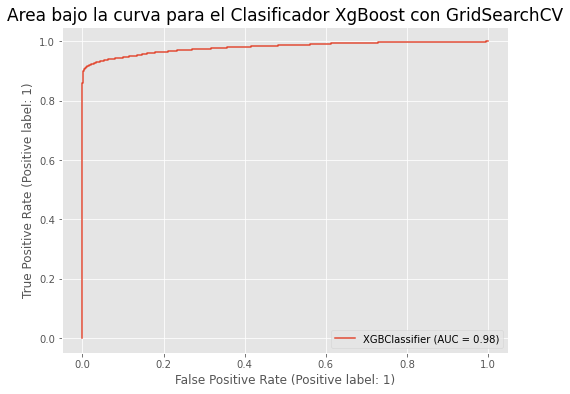

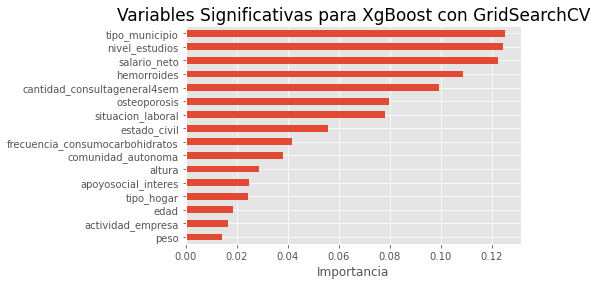

In [84]:
# Evaluación del modelo
pf.evaluate_model(xgb_gridmodel, X_train, X_test, y_test, 
               title='XgBoost con GridSearchCV', tree=True)

##### 5.5.9- CatBoost

In [85]:
# Clasificador Base
cat_clf = CatBoostClassifier(random_state = rmst,
                            verbose = None)

# Entrenamiento
cat_base = cat_clf.fit(X_train, y_train,early_stopping_rounds=3,verbose=False)

__________________________________________________________________
Reporte para el Clasificador: 
	Catboost
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.91      0.99      0.95      4056
           1       0.99      0.91      0.95      4056

    accuracy                           0.95      8112
   macro avg       0.95      0.95      0.95      8112
weighted avg       0.95      0.95      0.95      8112

__________________________________________________________________


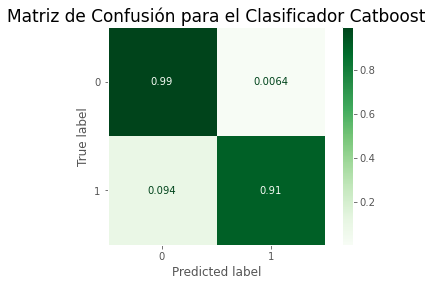

__________________________________________________________________


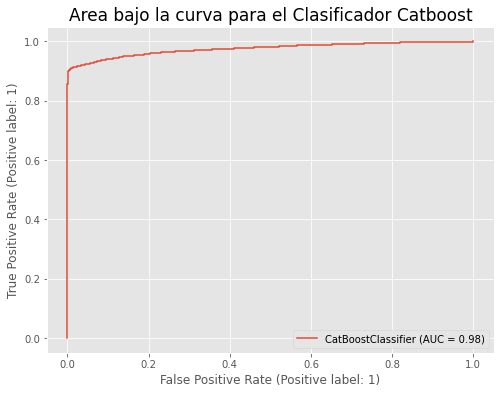

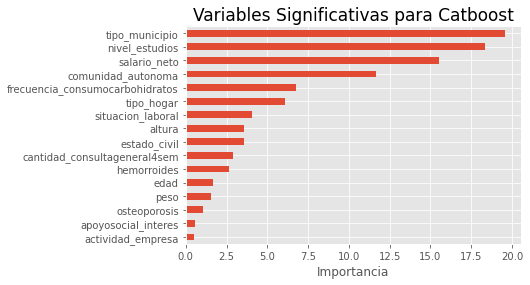

In [86]:
# Evaluación del modelo base
pf.evaluate_model(cat_base, X_train, X_test, y_test, 
               title='Catboost',tree=True)

In [87]:
# Clasificador aplicando GridSearch CV
# Estimadores a analizar
cat_params =  {'depth': [4,5,6,7,8,9,10],
               'learning_rate' : [.01,.02,.03,.04],
               'iterations'    : [10, 20,30,40,50,60,70,80,90,100]
               }

# Clasificador Base
cat_clf2 = CatBoostClassifier(random_state = rmst,
                              verbose = None)

# Evaluación y selección de estimadores
grid_cat = GridSearchCV(cat_clf2,
                        cat_params,
                        n_jobs=-1,
                        cv= crossval)

# Entrenamiento
cat_grid = grid_cat.fit(X_train, y_train)

0:	learn: 0.6917662	total: 73.1ms	remaining: 658ms
1:	learn: 0.6903711	total: 78.6ms	remaining: 314ms
2:	learn: 0.6890386	total: 83.7ms	remaining: 195ms
3:	learn: 0.6875936	total: 86.8ms	remaining: 130ms
4:	learn: 0.6862253	total: 91.1ms	remaining: 91.1ms
5:	learn: 0.6848507	total: 94.3ms	remaining: 62.9ms
6:	learn: 0.6833482	total: 97.5ms	remaining: 41.8ms
7:	learn: 0.6820696	total: 101ms	remaining: 25.2ms
8:	learn: 0.6807807	total: 103ms	remaining: 11.5ms
9:	learn: 0.6795334	total: 106ms	remaining: 0us
0:	learn: 0.6903843	total: 13.6ms	remaining: 122ms
1:	learn: 0.6876272	total: 17ms	remaining: 67.9ms
2:	learn: 0.6850374	total: 20.2ms	remaining: 47.2ms
3:	learn: 0.6822765	total: 23.4ms	remaining: 35ms
4:	learn: 0.6797102	total: 26.5ms	remaining: 26.5ms
5:	learn: 0.6771804	total: 29.6ms	remaining: 19.8ms
6:	learn: 0.6749129	total: 33.7ms	remaining: 14.4ms
7:	learn: 0.6721355	total: 42.3ms	remaining: 10.6ms
8:	learn: 0.6698478	total: 49.4ms	remaining: 5.49ms
9:	learn: 0.6676197	total: 

0:	learn: 0.6917785	total: 70.6ms	remaining: 636ms
1:	learn: 0.6904739	total: 73.8ms	remaining: 295ms
2:	learn: 0.6891544	total: 82.7ms	remaining: 193ms
3:	learn: 0.6877135	total: 90ms	remaining: 135ms
4:	learn: 0.6863494	total: 93.3ms	remaining: 93.3ms
5:	learn: 0.6849747	total: 96.6ms	remaining: 64.4ms
6:	learn: 0.6837408	total: 99.7ms	remaining: 42.7ms
7:	learn: 0.6824600	total: 103ms	remaining: 25.7ms
8:	learn: 0.6811920	total: 106ms	remaining: 11.8ms
9:	learn: 0.6799511	total: 110ms	remaining: 0us
0:	learn: 0.6917183	total: 20.7ms	remaining: 186ms
1:	learn: 0.6904010	total: 23.1ms	remaining: 92.6ms
2:	learn: 0.6888759	total: 26.2ms	remaining: 61.2ms
3:	learn: 0.6874204	total: 29ms	remaining: 43.6ms
4:	learn: 0.6860399	total: 32.1ms	remaining: 32.1ms
5:	learn: 0.6846401	total: 39.1ms	remaining: 26ms
6:	learn: 0.6833850	total: 42.3ms	remaining: 18.1ms
7:	learn: 0.6821241	total: 45.5ms	remaining: 11.4ms
8:	learn: 0.6808589	total: 48.7ms	remaining: 5.41ms
9:	learn: 0.6795993	total: 56

0:	learn: 0.6917743	total: 74.1ms	remaining: 667ms
1:	learn: 0.6903804	total: 77.1ms	remaining: 308ms
2:	learn: 0.6888473	total: 81.1ms	remaining: 189ms
3:	learn: 0.6874051	total: 87.3ms	remaining: 131ms
4:	learn: 0.6860385	total: 90.7ms	remaining: 90.7ms
5:	learn: 0.6846588	total: 94ms	remaining: 62.7ms
6:	learn: 0.6831763	total: 97.2ms	remaining: 41.6ms
7:	learn: 0.6818899	total: 100ms	remaining: 25.1ms
8:	learn: 0.6806128	total: 104ms	remaining: 11.5ms
9:	learn: 0.6794259	total: 107ms	remaining: 0us
0:	learn: 0.6904232	total: 13.1ms	remaining: 118ms
1:	learn: 0.6877741	total: 16.4ms	remaining: 65.6ms
2:	learn: 0.6852281	total: 19.6ms	remaining: 45.6ms
3:	learn: 0.6824954	total: 22.9ms	remaining: 34.3ms
4:	learn: 0.6799587	total: 26.1ms	remaining: 26.1ms
5:	learn: 0.6774515	total: 29.3ms	remaining: 19.5ms
6:	learn: 0.6745857	total: 33.3ms	remaining: 14.3ms
7:	learn: 0.6718523	total: 37.1ms	remaining: 9.28ms
8:	learn: 0.6695779	total: 40.4ms	remaining: 4.49ms
9:	learn: 0.6673770	total

18:	learn: 0.6688600	total: 92.8ms	remaining: 103ms
19:	learn: 0.6677583	total: 98.3ms	remaining: 98.3ms
20:	learn: 0.6666072	total: 102ms	remaining: 91.9ms
21:	learn: 0.6656408	total: 106ms	remaining: 86.9ms
22:	learn: 0.6643143	total: 110ms	remaining: 80.9ms
23:	learn: 0.6630204	total: 113ms	remaining: 75.1ms
24:	learn: 0.6620340	total: 116ms	remaining: 69.5ms
25:	learn: 0.6610052	total: 119ms	remaining: 64.2ms
26:	learn: 0.6600642	total: 122ms	remaining: 58.9ms
27:	learn: 0.6590218	total: 126ms	remaining: 53.8ms
28:	learn: 0.6581191	total: 129ms	remaining: 48.8ms
29:	learn: 0.6568650	total: 133ms	remaining: 44.3ms
30:	learn: 0.6553260	total: 165ms	remaining: 47.9ms
31:	learn: 0.6541439	total: 168ms	remaining: 42.1ms
32:	learn: 0.6532279	total: 171ms	remaining: 36.3ms
33:	learn: 0.6521262	total: 191ms	remaining: 33.7ms
34:	learn: 0.6510173	total: 196ms	remaining: 28.1ms
35:	learn: 0.6500274	total: 229ms	remaining: 25.5ms
36:	learn: 0.6490227	total: 242ms	remaining: 19.6ms
37:	learn: 

17:	learn: 0.6694742	total: 157ms	remaining: 192ms
18:	learn: 0.6684750	total: 160ms	remaining: 177ms
19:	learn: 0.6673526	total: 164ms	remaining: 164ms
20:	learn: 0.6663043	total: 170ms	remaining: 153ms
21:	learn: 0.6652490	total: 173ms	remaining: 142ms
22:	learn: 0.6639347	total: 177ms	remaining: 130ms
23:	learn: 0.6628433	total: 180ms	remaining: 120ms
24:	learn: 0.6618204	total: 192ms	remaining: 115ms
25:	learn: 0.6607868	total: 198ms	remaining: 107ms
26:	learn: 0.6598376	total: 201ms	remaining: 97ms
27:	learn: 0.6588539	total: 205ms	remaining: 87.7ms
28:	learn: 0.6579281	total: 208ms	remaining: 78.8ms
29:	learn: 0.6567152	total: 211ms	remaining: 70.4ms
30:	learn: 0.6557404	total: 225ms	remaining: 65.2ms
31:	learn: 0.6545700	total: 228ms	remaining: 57ms
32:	learn: 0.6535661	total: 231ms	remaining: 49.1ms
33:	learn: 0.6524711	total: 235ms	remaining: 41.4ms
34:	learn: 0.6515702	total: 238ms	remaining: 34ms
35:	learn: 0.6506220	total: 241ms	remaining: 26.8ms
36:	learn: 0.6496662	total:

8:	learn: 0.6699258	total: 87.6ms	remaining: 302ms
9:	learn: 0.6674392	total: 91ms	remaining: 273ms
10:	learn: 0.6652779	total: 123ms	remaining: 325ms
11:	learn: 0.6628082	total: 130ms	remaining: 303ms
12:	learn: 0.6608799	total: 134ms	remaining: 279ms
13:	learn: 0.6589715	total: 139ms	remaining: 258ms
14:	learn: 0.6570223	total: 150ms	remaining: 250ms
15:	learn: 0.6547576	total: 154ms	remaining: 231ms
16:	learn: 0.6528703	total: 159ms	remaining: 215ms
17:	learn: 0.6510540	total: 163ms	remaining: 200ms
18:	learn: 0.6492288	total: 168ms	remaining: 186ms
19:	learn: 0.6475678	total: 172ms	remaining: 172ms
20:	learn: 0.6454814	total: 175ms	remaining: 158ms
21:	learn: 0.6437416	total: 178ms	remaining: 146ms
22:	learn: 0.6410667	total: 182ms	remaining: 134ms
23:	learn: 0.6382372	total: 185ms	remaining: 123ms
24:	learn: 0.6355084	total: 189ms	remaining: 113ms
25:	learn: 0.6338543	total: 212ms	remaining: 114ms
26:	learn: 0.6323003	total: 215ms	remaining: 103ms
27:	learn: 0.6304791	total: 218ms

36:	learn: 0.5829056	total: 317ms	remaining: 112ms
37:	learn: 0.5811631	total: 321ms	remaining: 101ms
38:	learn: 0.5792006	total: 324ms	remaining: 91.5ms
39:	learn: 0.5770982	total: 326ms	remaining: 81.4ms
40:	learn: 0.5748844	total: 327ms	remaining: 71.8ms
41:	learn: 0.5730546	total: 331ms	remaining: 63ms
42:	learn: 0.5709924	total: 334ms	remaining: 54.4ms
43:	learn: 0.5686893	total: 338ms	remaining: 46.1ms
44:	learn: 0.5674045	total: 342ms	remaining: 38ms
45:	learn: 0.5650382	total: 345ms	remaining: 30ms
46:	learn: 0.5631196	total: 362ms	remaining: 23.1ms
47:	learn: 0.5603623	total: 365ms	remaining: 15.2ms
48:	learn: 0.5588833	total: 369ms	remaining: 7.52ms
49:	learn: 0.5574855	total: 381ms	remaining: 0us
0:	learn: 0.6877079	total: 15.8ms	remaining: 774ms
1:	learn: 0.6823663	total: 21.3ms	remaining: 511ms
2:	learn: 0.6756290	total: 29ms	remaining: 455ms
3:	learn: 0.6704511	total: 33.8ms	remaining: 389ms
4:	learn: 0.6658319	total: 38ms	remaining: 342ms
5:	learn: 0.6614003	total: 61.2m

36:	learn: 0.6147422	total: 247ms	remaining: 86.8ms
37:	learn: 0.6133777	total: 250ms	remaining: 79.1ms
38:	learn: 0.6117185	total: 254ms	remaining: 71.5ms
39:	learn: 0.6102858	total: 257ms	remaining: 64.3ms
40:	learn: 0.6090116	total: 260ms	remaining: 57.1ms
41:	learn: 0.6076416	total: 264ms	remaining: 50.2ms
42:	learn: 0.6063160	total: 267ms	remaining: 43.5ms
43:	learn: 0.6043808	total: 281ms	remaining: 38.3ms
44:	learn: 0.6033449	total: 315ms	remaining: 35ms
45:	learn: 0.6020353	total: 320ms	remaining: 27.8ms
46:	learn: 0.6004271	total: 349ms	remaining: 22.3ms
47:	learn: 0.5987387	total: 364ms	remaining: 15.2ms
48:	learn: 0.5965590	total: 367ms	remaining: 7.5ms
49:	learn: 0.5949847	total: 371ms	remaining: 0us
0:	learn: 0.6889015	total: 7.49ms	remaining: 367ms
1:	learn: 0.6848460	total: 10.4ms	remaining: 249ms
2:	learn: 0.6813467	total: 25.9ms	remaining: 406ms
3:	learn: 0.6773909	total: 29.1ms	remaining: 335ms
4:	learn: 0.6737698	total: 32.4ms	remaining: 291ms
5:	learn: 0.6702475	tot

40:	learn: 0.5781939	total: 261ms	remaining: 121ms
41:	learn: 0.5766318	total: 265ms	remaining: 113ms
42:	learn: 0.5738144	total: 268ms	remaining: 106ms
43:	learn: 0.5713886	total: 283ms	remaining: 103ms
44:	learn: 0.5698474	total: 286ms	remaining: 95.3ms
45:	learn: 0.5681089	total: 289ms	remaining: 88.1ms
46:	learn: 0.5658387	total: 353ms	remaining: 97.5ms
47:	learn: 0.5630406	total: 386ms	remaining: 96.4ms
48:	learn: 0.5604208	total: 388ms	remaining: 87.1ms
49:	learn: 0.5590607	total: 391ms	remaining: 78.2ms
50:	learn: 0.5574872	total: 394ms	remaining: 69.6ms
51:	learn: 0.5555537	total: 449ms	remaining: 69ms
52:	learn: 0.5535416	total: 452ms	remaining: 59.7ms
53:	learn: 0.5511360	total: 456ms	remaining: 50.6ms
54:	learn: 0.5489413	total: 459ms	remaining: 41.7ms
55:	learn: 0.5472250	total: 462ms	remaining: 33ms
56:	learn: 0.5457087	total: 479ms	remaining: 25.2ms
57:	learn: 0.5441929	total: 483ms	remaining: 16.6ms
58:	learn: 0.5423603	total: 487ms	remaining: 8.26ms
59:	learn: 0.5411197

34:	learn: 0.5882179	total: 209ms	remaining: 149ms
35:	learn: 0.5862483	total: 211ms	remaining: 140ms
36:	learn: 0.5839679	total: 216ms	remaining: 134ms
37:	learn: 0.5822711	total: 219ms	remaining: 127ms
38:	learn: 0.5800006	total: 226ms	remaining: 122ms
39:	learn: 0.5782240	total: 238ms	remaining: 119ms
40:	learn: 0.5760673	total: 249ms	remaining: 115ms
41:	learn: 0.5729200	total: 253ms	remaining: 109ms
42:	learn: 0.5701193	total: 278ms	remaining: 110ms
43:	learn: 0.5677642	total: 281ms	remaining: 102ms
44:	learn: 0.5661243	total: 295ms	remaining: 98.4ms
45:	learn: 0.5646080	total: 298ms	remaining: 90.8ms
46:	learn: 0.5627385	total: 302ms	remaining: 83.4ms
47:	learn: 0.5606647	total: 315ms	remaining: 78.9ms
48:	learn: 0.5579244	total: 318ms	remaining: 71.4ms
49:	learn: 0.5552210	total: 320ms	remaining: 64ms
50:	learn: 0.5531406	total: 323ms	remaining: 57ms
51:	learn: 0.5513310	total: 337ms	remaining: 51.9ms
52:	learn: 0.5497321	total: 341ms	remaining: 45ms
53:	learn: 0.5473130	total: 

33:	learn: 0.5683920	total: 232ms	remaining: 178ms
34:	learn: 0.5663354	total: 236ms	remaining: 168ms
35:	learn: 0.5645093	total: 239ms	remaining: 159ms
36:	learn: 0.5609001	total: 242ms	remaining: 151ms
37:	learn: 0.5591091	total: 265ms	remaining: 153ms
38:	learn: 0.5566630	total: 279ms	remaining: 150ms
39:	learn: 0.5530386	total: 283ms	remaining: 141ms
40:	learn: 0.5509196	total: 286ms	remaining: 133ms
41:	learn: 0.5491286	total: 290ms	remaining: 124ms
42:	learn: 0.5458848	total: 293ms	remaining: 116ms
43:	learn: 0.5431930	total: 296ms	remaining: 108ms
44:	learn: 0.5414873	total: 300ms	remaining: 99.9ms
45:	learn: 0.5399495	total: 303ms	remaining: 92.3ms
46:	learn: 0.5379624	total: 307ms	remaining: 84.8ms
47:	learn: 0.5357413	total: 319ms	remaining: 79.8ms
48:	learn: 0.5325914	total: 323ms	remaining: 72.5ms
49:	learn: 0.5310200	total: 326ms	remaining: 65.2ms
50:	learn: 0.5293075	total: 330ms	remaining: 58.3ms
51:	learn: 0.5271822	total: 356ms	remaining: 54.8ms
52:	learn: 0.5249754	to

43:	learn: 0.5714004	total: 254ms	remaining: 92.4ms
44:	learn: 0.5699120	total: 260ms	remaining: 86.7ms
45:	learn: 0.5683718	total: 263ms	remaining: 80.1ms
46:	learn: 0.5651918	total: 277ms	remaining: 76.5ms
47:	learn: 0.5631127	total: 300ms	remaining: 75.1ms
48:	learn: 0.5603504	total: 303ms	remaining: 68ms
49:	learn: 0.5584894	total: 306ms	remaining: 61.1ms
50:	learn: 0.5564226	total: 309ms	remaining: 54.5ms
51:	learn: 0.5549318	total: 322ms	remaining: 49.5ms
52:	learn: 0.5533661	total: 325ms	remaining: 43ms
53:	learn: 0.5519536	total: 329ms	remaining: 36.5ms
54:	learn: 0.5498099	total: 341ms	remaining: 31ms
55:	learn: 0.5481250	total: 345ms	remaining: 24.6ms
56:	learn: 0.5466399	total: 349ms	remaining: 18.4ms
57:	learn: 0.5455430	total: 353ms	remaining: 12.2ms
58:	learn: 0.5440284	total: 356ms	remaining: 6.04ms
59:	learn: 0.5415420	total: 360ms	remaining: 0us
0:	learn: 0.6877495	total: 14.3ms	remaining: 844ms
1:	learn: 0.6824468	total: 17.6ms	remaining: 511ms
2:	learn: 0.6779470	tot

25:	learn: 0.6099159	total: 184ms	remaining: 241ms
26:	learn: 0.6078683	total: 187ms	remaining: 228ms
27:	learn: 0.6056225	total: 190ms	remaining: 217ms
28:	learn: 0.6036633	total: 193ms	remaining: 206ms
29:	learn: 0.6013389	total: 210ms	remaining: 210ms
30:	learn: 0.5983781	total: 228ms	remaining: 214ms
31:	learn: 0.5961863	total: 236ms	remaining: 206ms
32:	learn: 0.5942937	total: 239ms	remaining: 196ms
33:	learn: 0.5923024	total: 242ms	remaining: 185ms
34:	learn: 0.5904448	total: 245ms	remaining: 175ms
35:	learn: 0.5883921	total: 248ms	remaining: 166ms
36:	learn: 0.5862367	total: 252ms	remaining: 157ms
37:	learn: 0.5846657	total: 255ms	remaining: 148ms
38:	learn: 0.5826593	total: 258ms	remaining: 139ms
39:	learn: 0.5802489	total: 262ms	remaining: 131ms
40:	learn: 0.5780685	total: 265ms	remaining: 123ms
41:	learn: 0.5764329	total: 268ms	remaining: 115ms
42:	learn: 0.5735258	total: 282ms	remaining: 111ms
43:	learn: 0.5706840	total: 335ms	remaining: 122ms
44:	learn: 0.5690420	total: 338

23:	learn: 0.6160708	total: 228ms	remaining: 436ms
24:	learn: 0.6136398	total: 231ms	remaining: 416ms
25:	learn: 0.6108820	total: 234ms	remaining: 396ms
26:	learn: 0.6087662	total: 237ms	remaining: 377ms
27:	learn: 0.6064531	total: 240ms	remaining: 360ms
28:	learn: 0.6041121	total: 243ms	remaining: 344ms
29:	learn: 0.6017110	total: 246ms	remaining: 328ms
30:	learn: 0.5988252	total: 250ms	remaining: 315ms
31:	learn: 0.5964556	total: 258ms	remaining: 307ms
32:	learn: 0.5941582	total: 261ms	remaining: 293ms
33:	learn: 0.5920211	total: 264ms	remaining: 280ms
34:	learn: 0.5902059	total: 268ms	remaining: 268ms
35:	learn: 0.5881006	total: 271ms	remaining: 256ms
36:	learn: 0.5857654	total: 275ms	remaining: 245ms
37:	learn: 0.5839900	total: 277ms	remaining: 234ms
38:	learn: 0.5819527	total: 300ms	remaining: 239ms
39:	learn: 0.5798361	total: 304ms	remaining: 228ms
40:	learn: 0.5777167	total: 311ms	remaining: 220ms
41:	learn: 0.5746999	total: 314ms	remaining: 210ms
42:	learn: 0.5720115	total: 318

33:	learn: 0.5929357	total: 501ms	remaining: 530ms
34:	learn: 0.5911857	total: 505ms	remaining: 505ms
35:	learn: 0.5888778	total: 508ms	remaining: 480ms
36:	learn: 0.5865336	total: 511ms	remaining: 456ms
37:	learn: 0.5848915	total: 515ms	remaining: 433ms
38:	learn: 0.5828931	total: 517ms	remaining: 411ms
39:	learn: 0.5799248	total: 521ms	remaining: 391ms
40:	learn: 0.5777785	total: 524ms	remaining: 370ms
41:	learn: 0.5748515	total: 545ms	remaining: 363ms
42:	learn: 0.5721022	total: 549ms	remaining: 345ms
43:	learn: 0.5697955	total: 552ms	remaining: 326ms
44:	learn: 0.5682192	total: 555ms	remaining: 309ms
45:	learn: 0.5665720	total: 559ms	remaining: 292ms
46:	learn: 0.5636595	total: 562ms	remaining: 275ms
47:	learn: 0.5617060	total: 580ms	remaining: 266ms
48:	learn: 0.5588920	total: 614ms	remaining: 263ms
49:	learn: 0.5575156	total: 617ms	remaining: 247ms
50:	learn: 0.5559259	total: 620ms	remaining: 231ms
51:	learn: 0.5540589	total: 623ms	remaining: 216ms
52:	learn: 0.5523106	total: 627

15:	learn: 0.6379489	total: 117ms	remaining: 394ms
16:	learn: 0.6355019	total: 120ms	remaining: 374ms
17:	learn: 0.6315241	total: 134ms	remaining: 387ms
18:	learn: 0.6292600	total: 223ms	remaining: 599ms
19:	learn: 0.6267379	total: 226ms	remaining: 566ms
20:	learn: 0.6245494	total: 230ms	remaining: 536ms
21:	learn: 0.6219912	total: 233ms	remaining: 508ms
22:	learn: 0.6195096	total: 261ms	remaining: 534ms
23:	learn: 0.6159252	total: 266ms	remaining: 509ms
24:	learn: 0.6130280	total: 269ms	remaining: 485ms
25:	learn: 0.6104910	total: 273ms	remaining: 462ms
26:	learn: 0.6083813	total: 277ms	remaining: 440ms
27:	learn: 0.6062299	total: 280ms	remaining: 419ms
28:	learn: 0.6042625	total: 301ms	remaining: 425ms
29:	learn: 0.6018648	total: 304ms	remaining: 405ms
30:	learn: 0.5985283	total: 307ms	remaining: 387ms
31:	learn: 0.5963954	total: 311ms	remaining: 369ms
32:	learn: 0.5945084	total: 334ms	remaining: 374ms
33:	learn: 0.5915015	total: 337ms	remaining: 357ms
34:	learn: 0.5896451	total: 340

15:	learn: 0.6233538	total: 132ms	remaining: 447ms
16:	learn: 0.6201650	total: 136ms	remaining: 424ms
17:	learn: 0.6168832	total: 159ms	remaining: 459ms
18:	learn: 0.6138051	total: 161ms	remaining: 433ms
19:	learn: 0.6110711	total: 163ms	remaining: 409ms
20:	learn: 0.6075286	total: 166ms	remaining: 387ms
21:	learn: 0.6047326	total: 255ms	remaining: 555ms
22:	learn: 0.6017713	total: 258ms	remaining: 526ms
23:	learn: 0.5974112	total: 265ms	remaining: 508ms
24:	learn: 0.5944574	total: 271ms	remaining: 489ms
25:	learn: 0.5912912	total: 275ms	remaining: 465ms
26:	learn: 0.5889240	total: 278ms	remaining: 443ms
27:	learn: 0.5846732	total: 284ms	remaining: 427ms
28:	learn: 0.5821835	total: 290ms	remaining: 410ms
29:	learn: 0.5789479	total: 293ms	remaining: 391ms
30:	learn: 0.5748507	total: 297ms	remaining: 373ms
31:	learn: 0.5721479	total: 300ms	remaining: 356ms
32:	learn: 0.5696655	total: 342ms	remaining: 384ms
33:	learn: 0.5673818	total: 346ms	remaining: 366ms
34:	learn: 0.5653327	total: 349

16:	learn: 0.6359446	total: 95.4ms	remaining: 297ms
17:	learn: 0.6319446	total: 118ms	remaining: 340ms
18:	learn: 0.6297616	total: 121ms	remaining: 325ms
19:	learn: 0.6272672	total: 125ms	remaining: 312ms
20:	learn: 0.6246653	total: 138ms	remaining: 323ms
21:	learn: 0.6217983	total: 141ms	remaining: 307ms
22:	learn: 0.6195086	total: 143ms	remaining: 292ms
23:	learn: 0.6169612	total: 146ms	remaining: 280ms
24:	learn: 0.6143780	total: 158ms	remaining: 285ms
25:	learn: 0.6118951	total: 172ms	remaining: 291ms
26:	learn: 0.6094952	total: 175ms	remaining: 279ms
27:	learn: 0.6072276	total: 179ms	remaining: 268ms
28:	learn: 0.6053329	total: 211ms	remaining: 299ms
29:	learn: 0.6031764	total: 215ms	remaining: 286ms
30:	learn: 0.6003520	total: 218ms	remaining: 274ms
31:	learn: 0.5983354	total: 231ms	remaining: 275ms
32:	learn: 0.5963842	total: 235ms	remaining: 263ms
33:	learn: 0.5940939	total: 238ms	remaining: 252ms
34:	learn: 0.5922341	total: 242ms	remaining: 242ms
35:	learn: 0.5904364	total: 24

52:	learn: 0.5908184	total: 312ms	remaining: 159ms
53:	learn: 0.5889398	total: 315ms	remaining: 152ms
54:	learn: 0.5872148	total: 319ms	remaining: 145ms
55:	learn: 0.5857595	total: 322ms	remaining: 138ms
56:	learn: 0.5844861	total: 326ms	remaining: 132ms
57:	learn: 0.5827096	total: 329ms	remaining: 125ms
58:	learn: 0.5810764	total: 333ms	remaining: 118ms
59:	learn: 0.5799736	total: 336ms	remaining: 112ms
60:	learn: 0.5789188	total: 339ms	remaining: 106ms
61:	learn: 0.5776074	total: 344ms	remaining: 99.8ms
62:	learn: 0.5759538	total: 347ms	remaining: 93.8ms
63:	learn: 0.5747509	total: 351ms	remaining: 87.8ms
64:	learn: 0.5727501	total: 364ms	remaining: 84.1ms
65:	learn: 0.5712172	total: 368ms	remaining: 78ms
66:	learn: 0.5701261	total: 371ms	remaining: 72ms
67:	learn: 0.5689748	total: 389ms	remaining: 68.6ms
68:	learn: 0.5678584	total: 396ms	remaining: 63.1ms
69:	learn: 0.5668448	total: 409ms	remaining: 58.4ms
70:	learn: 0.5657697	total: 413ms	remaining: 52.3ms
71:	learn: 0.5644532	tota

34:	learn: 0.5911857	total: 177ms	remaining: 228ms
35:	learn: 0.5888778	total: 181ms	remaining: 221ms
36:	learn: 0.5865336	total: 184ms	remaining: 214ms
37:	learn: 0.5848915	total: 196ms	remaining: 217ms
38:	learn: 0.5828931	total: 199ms	remaining: 209ms
39:	learn: 0.5799248	total: 203ms	remaining: 203ms
40:	learn: 0.5777785	total: 245ms	remaining: 233ms
41:	learn: 0.5748515	total: 248ms	remaining: 224ms
42:	learn: 0.5721022	total: 251ms	remaining: 216ms
43:	learn: 0.5697955	total: 255ms	remaining: 208ms
44:	learn: 0.5682192	total: 263ms	remaining: 204ms
45:	learn: 0.5665720	total: 266ms	remaining: 197ms
46:	learn: 0.5636595	total: 271ms	remaining: 190ms
47:	learn: 0.5617060	total: 274ms	remaining: 183ms
48:	learn: 0.5588920	total: 284ms	remaining: 180ms
49:	learn: 0.5575156	total: 293ms	remaining: 176ms
50:	learn: 0.5559259	total: 308ms	remaining: 175ms
51:	learn: 0.5540589	total: 312ms	remaining: 168ms
52:	learn: 0.5523106	total: 315ms	remaining: 160ms
53:	learn: 0.5497460	total: 331

52:	learn: 0.5905551	total: 372ms	remaining: 189ms
53:	learn: 0.5893678	total: 386ms	remaining: 186ms
54:	learn: 0.5875929	total: 392ms	remaining: 178ms
55:	learn: 0.5860847	total: 395ms	remaining: 169ms
56:	learn: 0.5848724	total: 400ms	remaining: 161ms
57:	learn: 0.5836095	total: 408ms	remaining: 155ms
58:	learn: 0.5821818	total: 411ms	remaining: 146ms
59:	learn: 0.5800432	total: 414ms	remaining: 138ms
60:	learn: 0.5789325	total: 417ms	remaining: 130ms
61:	learn: 0.5776489	total: 421ms	remaining: 122ms
62:	learn: 0.5765042	total: 424ms	remaining: 114ms
63:	learn: 0.5749641	total: 427ms	remaining: 107ms
64:	learn: 0.5729791	total: 431ms	remaining: 99.5ms
65:	learn: 0.5714659	total: 434ms	remaining: 92.1ms
66:	learn: 0.5701011	total: 438ms	remaining: 84.9ms
67:	learn: 0.5688426	total: 443ms	remaining: 78.2ms
68:	learn: 0.5677365	total: 448ms	remaining: 71.4ms
69:	learn: 0.5666943	total: 451ms	remaining: 64.4ms
70:	learn: 0.5648534	total: 455ms	remaining: 57.6ms
71:	learn: 0.5629151	tot

64:	learn: 0.5736418	total: 494ms	remaining: 114ms
65:	learn: 0.5721235	total: 498ms	remaining: 106ms
66:	learn: 0.5707013	total: 501ms	remaining: 97.2ms
67:	learn: 0.5693879	total: 505ms	remaining: 89ms
68:	learn: 0.5681042	total: 508ms	remaining: 81ms
69:	learn: 0.5670887	total: 511ms	remaining: 73ms
70:	learn: 0.5652646	total: 515ms	remaining: 65.3ms
71:	learn: 0.5637854	total: 519ms	remaining: 57.6ms
72:	learn: 0.5621339	total: 522ms	remaining: 50ms
73:	learn: 0.5610224	total: 525ms	remaining: 42.6ms
74:	learn: 0.5599608	total: 529ms	remaining: 35.2ms
75:	learn: 0.5580942	total: 532ms	remaining: 28ms
76:	learn: 0.5563388	total: 536ms	remaining: 20.9ms
77:	learn: 0.5548473	total: 539ms	remaining: 13.8ms
78:	learn: 0.5536555	total: 545ms	remaining: 6.9ms
79:	learn: 0.5526458	total: 550ms	remaining: 0us
0:	learn: 0.6889092	total: 14.6ms	remaining: 1.15s
1:	learn: 0.6849542	total: 64ms	remaining: 2.5s
2:	learn: 0.6806033	total: 67.4ms	remaining: 1.73s
3:	learn: 0.6766412	total: 70.6ms	

52:	learn: 0.6333599	total: 309ms	remaining: 216ms
53:	learn: 0.6325475	total: 323ms	remaining: 216ms
54:	learn: 0.6312236	total: 327ms	remaining: 208ms
55:	learn: 0.6302344	total: 330ms	remaining: 201ms
56:	learn: 0.6293509	total: 368ms	remaining: 213ms
57:	learn: 0.6285588	total: 373ms	remaining: 206ms
58:	learn: 0.6276683	total: 377ms	remaining: 198ms
59:	learn: 0.6268608	total: 381ms	remaining: 191ms
60:	learn: 0.6260564	total: 402ms	remaining: 191ms
61:	learn: 0.6252260	total: 407ms	remaining: 184ms
62:	learn: 0.6242203	total: 414ms	remaining: 177ms
63:	learn: 0.6233363	total: 428ms	remaining: 174ms
64:	learn: 0.6221027	total: 431ms	remaining: 166ms
65:	learn: 0.6213216	total: 465ms	remaining: 169ms
66:	learn: 0.6205661	total: 469ms	remaining: 161ms
67:	learn: 0.6198286	total: 473ms	remaining: 153ms
68:	learn: 0.6188050	total: 477ms	remaining: 145ms
69:	learn: 0.6179104	total: 480ms	remaining: 137ms
70:	learn: 0.6172021	total: 483ms	remaining: 129ms
71:	learn: 0.6165500	total: 487

24:	learn: 0.6616702	total: 220ms	remaining: 573ms
25:	learn: 0.6606125	total: 223ms	remaining: 550ms
26:	learn: 0.6595226	total: 226ms	remaining: 528ms
27:	learn: 0.6584756	total: 229ms	remaining: 507ms
28:	learn: 0.6574981	total: 232ms	remaining: 488ms
29:	learn: 0.6563057	total: 235ms	remaining: 471ms
30:	learn: 0.6550707	total: 238ms	remaining: 453ms
31:	learn: 0.6539040	total: 241ms	remaining: 438ms
32:	learn: 0.6529638	total: 245ms	remaining: 422ms
33:	learn: 0.6519948	total: 248ms	remaining: 408ms
34:	learn: 0.6511138	total: 251ms	remaining: 394ms
35:	learn: 0.6500734	total: 254ms	remaining: 380ms
36:	learn: 0.6489462	total: 257ms	remaining: 368ms
37:	learn: 0.6480419	total: 259ms	remaining: 355ms
38:	learn: 0.6469237	total: 262ms	remaining: 343ms
39:	learn: 0.6458044	total: 266ms	remaining: 332ms
40:	learn: 0.6449955	total: 268ms	remaining: 320ms
41:	learn: 0.6437443	total: 271ms	remaining: 309ms
42:	learn: 0.6428824	total: 273ms	remaining: 299ms
43:	learn: 0.6418568	total: 297

63:	learn: 0.6250868	total: 629ms	remaining: 256ms
64:	learn: 0.6243164	total: 633ms	remaining: 243ms
65:	learn: 0.6234225	total: 636ms	remaining: 231ms
66:	learn: 0.6227023	total: 642ms	remaining: 220ms
67:	learn: 0.6218864	total: 645ms	remaining: 209ms
68:	learn: 0.6211512	total: 649ms	remaining: 197ms
69:	learn: 0.6203882	total: 651ms	remaining: 186ms
70:	learn: 0.6191942	total: 654ms	remaining: 175ms
71:	learn: 0.6185602	total: 657ms	remaining: 164ms
72:	learn: 0.6177011	total: 659ms	remaining: 154ms
73:	learn: 0.6168340	total: 663ms	remaining: 143ms
74:	learn: 0.6159649	total: 666ms	remaining: 133ms
75:	learn: 0.6148957	total: 680ms	remaining: 125ms
76:	learn: 0.6137365	total: 683ms	remaining: 115ms
77:	learn: 0.6128947	total: 687ms	remaining: 106ms
78:	learn: 0.6123339	total: 690ms	remaining: 96ms
79:	learn: 0.6116320	total: 704ms	remaining: 88ms
80:	learn: 0.6109443	total: 708ms	remaining: 78.6ms
81:	learn: 0.6101285	total: 711ms	remaining: 69.4ms
82:	learn: 0.6089561	total: 746

54:	learn: 0.5860692	total: 427ms	remaining: 272ms
55:	learn: 0.5845411	total: 431ms	remaining: 261ms
56:	learn: 0.5833362	total: 473ms	remaining: 274ms
57:	learn: 0.5821029	total: 475ms	remaining: 262ms
58:	learn: 0.5806446	total: 478ms	remaining: 251ms
59:	learn: 0.5785791	total: 481ms	remaining: 241ms
60:	learn: 0.5774478	total: 484ms	remaining: 230ms
61:	learn: 0.5761854	total: 487ms	remaining: 220ms
62:	learn: 0.5749954	total: 490ms	remaining: 210ms
63:	learn: 0.5734616	total: 493ms	remaining: 200ms
64:	learn: 0.5714550	total: 495ms	remaining: 191ms
65:	learn: 0.5701174	total: 498ms	remaining: 181ms
66:	learn: 0.5690160	total: 502ms	remaining: 172ms
67:	learn: 0.5677654	total: 504ms	remaining: 163ms
68:	learn: 0.5666208	total: 506ms	remaining: 154ms
69:	learn: 0.5655978	total: 509ms	remaining: 145ms
70:	learn: 0.5637189	total: 512ms	remaining: 137ms
71:	learn: 0.5618258	total: 525ms	remaining: 131ms
72:	learn: 0.5606399	total: 538ms	remaining: 125ms
73:	learn: 0.5588549	total: 541

12:	learn: 0.6340735	total: 73.9ms	remaining: 437ms
13:	learn: 0.6303366	total: 77.1ms	remaining: 418ms
14:	learn: 0.6273564	total: 80.5ms	remaining: 402ms
15:	learn: 0.6237189	total: 87.3ms	remaining: 404ms
16:	learn: 0.6208314	total: 91.9ms	remaining: 395ms
17:	learn: 0.6160764	total: 95.4ms	remaining: 382ms
18:	learn: 0.6135506	total: 98.3ms	remaining: 367ms
19:	learn: 0.6103151	total: 104ms	remaining: 363ms
20:	learn: 0.6071470	total: 107ms	remaining: 352ms
21:	learn: 0.6044198	total: 110ms	remaining: 341ms
22:	learn: 0.6014911	total: 115ms	remaining: 336ms
23:	learn: 0.5982380	total: 122ms	remaining: 337ms
24:	learn: 0.5949863	total: 126ms	remaining: 327ms
25:	learn: 0.5920137	total: 129ms	remaining: 318ms
26:	learn: 0.5893801	total: 134ms	remaining: 314ms
27:	learn: 0.5867230	total: 168ms	remaining: 372ms
28:	learn: 0.5843346	total: 172ms	remaining: 361ms
29:	learn: 0.5814637	total: 175ms	remaining: 350ms
30:	learn: 0.5772439	total: 178ms	remaining: 339ms
31:	learn: 0.5733427	tot

74:	learn: 0.4824568	total: 530ms	remaining: 106ms
75:	learn: 0.4796194	total: 534ms	remaining: 98.3ms
76:	learn: 0.4772294	total: 537ms	remaining: 90.7ms
77:	learn: 0.4759815	total: 541ms	remaining: 83.2ms
78:	learn: 0.4734623	total: 544ms	remaining: 75.8ms
79:	learn: 0.4722641	total: 557ms	remaining: 69.7ms
80:	learn: 0.4695605	total: 561ms	remaining: 62.3ms
81:	learn: 0.4674755	total: 565ms	remaining: 55.1ms
82:	learn: 0.4660381	total: 586ms	remaining: 49.5ms
83:	learn: 0.4634770	total: 611ms	remaining: 43.6ms
84:	learn: 0.4621331	total: 614ms	remaining: 36.1ms
85:	learn: 0.4609856	total: 617ms	remaining: 28.7ms
86:	learn: 0.4600415	total: 621ms	remaining: 21.4ms
87:	learn: 0.4588915	total: 623ms	remaining: 14.2ms
88:	learn: 0.4575519	total: 625ms	remaining: 7.02ms
89:	learn: 0.4562111	total: 627ms	remaining: 0us
0:	learn: 0.6917621	total: 2.14ms	remaining: 212ms
1:	learn: 0.6903558	total: 7.35ms	remaining: 360ms
2:	learn: 0.6890121	total: 11.3ms	remaining: 367ms
3:	learn: 0.6875632

23:	learn: 0.6630452	total: 263ms	remaining: 834ms
24:	learn: 0.6620444	total: 276ms	remaining: 829ms
25:	learn: 0.6610054	total: 280ms	remaining: 796ms
26:	learn: 0.6600695	total: 289ms	remaining: 783ms
27:	learn: 0.6590644	total: 293ms	remaining: 753ms
28:	learn: 0.6581090	total: 296ms	remaining: 725ms
29:	learn: 0.6569314	total: 309ms	remaining: 721ms
30:	learn: 0.6556764	total: 312ms	remaining: 695ms
31:	learn: 0.6545113	total: 318ms	remaining: 676ms
32:	learn: 0.6535624	total: 322ms	remaining: 653ms
33:	learn: 0.6526114	total: 325ms	remaining: 631ms
34:	learn: 0.6517318	total: 329ms	remaining: 611ms
35:	learn: 0.6506078	total: 332ms	remaining: 591ms
36:	learn: 0.6494967	total: 336ms	remaining: 572ms
37:	learn: 0.6484360	total: 381ms	remaining: 622ms
38:	learn: 0.6473360	total: 406ms	remaining: 635ms
39:	learn: 0.6462409	total: 408ms	remaining: 612ms
40:	learn: 0.6453727	total: 411ms	remaining: 592ms
41:	learn: 0.6444622	total: 415ms	remaining: 572ms
42:	learn: 0.6436191	total: 417

14:	learn: 0.6733356	total: 64.8ms	remaining: 367ms
15:	learn: 0.6720198	total: 94ms	remaining: 493ms
16:	learn: 0.6709403	total: 96.6ms	remaining: 472ms
17:	learn: 0.6696729	total: 110ms	remaining: 500ms
18:	learn: 0.6686777	total: 113ms	remaining: 481ms
19:	learn: 0.6675746	total: 116ms	remaining: 465ms
20:	learn: 0.6665212	total: 119ms	remaining: 449ms
21:	learn: 0.6655393	total: 122ms	remaining: 431ms
22:	learn: 0.6644531	total: 124ms	remaining: 414ms
23:	learn: 0.6631572	total: 126ms	remaining: 400ms
24:	learn: 0.6616098	total: 130ms	remaining: 389ms
25:	learn: 0.6605771	total: 133ms	remaining: 378ms
26:	learn: 0.6595901	total: 135ms	remaining: 366ms
27:	learn: 0.6584637	total: 139ms	remaining: 357ms
28:	learn: 0.6574893	total: 151ms	remaining: 370ms
29:	learn: 0.6562836	total: 155ms	remaining: 361ms
30:	learn: 0.6550755	total: 158ms	remaining: 351ms
31:	learn: 0.6539030	total: 161ms	remaining: 341ms
32:	learn: 0.6528828	total: 164ms	remaining: 333ms
33:	learn: 0.6517659	total: 16

42:	learn: 0.5738144	total: 239ms	remaining: 316ms
43:	learn: 0.5713886	total: 245ms	remaining: 312ms
44:	learn: 0.5698474	total: 248ms	remaining: 303ms
45:	learn: 0.5681089	total: 252ms	remaining: 295ms
46:	learn: 0.5658387	total: 265ms	remaining: 299ms
47:	learn: 0.5630406	total: 268ms	remaining: 291ms
48:	learn: 0.5604208	total: 272ms	remaining: 283ms
49:	learn: 0.5590607	total: 295ms	remaining: 295ms
50:	learn: 0.5574872	total: 297ms	remaining: 285ms
51:	learn: 0.5555537	total: 299ms	remaining: 276ms
52:	learn: 0.5535416	total: 327ms	remaining: 290ms
53:	learn: 0.5511360	total: 331ms	remaining: 282ms
54:	learn: 0.5489413	total: 334ms	remaining: 273ms
55:	learn: 0.5472250	total: 337ms	remaining: 265ms
56:	learn: 0.5457087	total: 343ms	remaining: 259ms
57:	learn: 0.5441929	total: 346ms	remaining: 251ms
58:	learn: 0.5423603	total: 350ms	remaining: 243ms
59:	learn: 0.5411197	total: 353ms	remaining: 236ms
60:	learn: 0.5398790	total: 357ms	remaining: 228ms
61:	learn: 0.5372628	total: 360

4:	learn: 0.6730561	total: 14.1ms	remaining: 267ms
5:	learn: 0.6694635	total: 32ms	remaining: 501ms
6:	learn: 0.6662023	total: 34.8ms	remaining: 462ms
7:	learn: 0.6624459	total: 44.9ms	remaining: 516ms
8:	learn: 0.6593759	total: 48ms	remaining: 486ms
9:	learn: 0.6550709	total: 52.8ms	remaining: 475ms
10:	learn: 0.6521831	total: 85.2ms	remaining: 690ms
11:	learn: 0.6488630	total: 88.3ms	remaining: 648ms
12:	learn: 0.6461692	total: 91.6ms	remaining: 613ms
13:	learn: 0.6431736	total: 94.7ms	remaining: 582ms
14:	learn: 0.6407786	total: 97.2ms	remaining: 551ms
15:	learn: 0.6377549	total: 101ms	remaining: 528ms
16:	learn: 0.6353334	total: 104ms	remaining: 507ms
17:	learn: 0.6314818	total: 127ms	remaining: 577ms
18:	learn: 0.6294392	total: 130ms	remaining: 553ms
19:	learn: 0.6263315	total: 133ms	remaining: 533ms
20:	learn: 0.6235291	total: 136ms	remaining: 513ms
21:	learn: 0.6212572	total: 149ms	remaining: 528ms
22:	learn: 0.6191532	total: 152ms	remaining: 510ms
23:	learn: 0.6160708	total: 16

6:	learn: 0.6654271	total: 64.4ms	remaining: 855ms
7:	learn: 0.6616161	total: 69.3ms	remaining: 797ms
8:	learn: 0.6585676	total: 75.2ms	remaining: 761ms
9:	learn: 0.6551933	total: 82ms	remaining: 738ms
10:	learn: 0.6522918	total: 88.7ms	remaining: 717ms
11:	learn: 0.6489858	total: 91.9ms	remaining: 674ms
12:	learn: 0.6462932	total: 94.9ms	remaining: 635ms
13:	learn: 0.6432915	total: 97.9ms	remaining: 601ms
14:	learn: 0.6403515	total: 101ms	remaining: 573ms
15:	learn: 0.6372772	total: 105ms	remaining: 549ms
16:	learn: 0.6348522	total: 108ms	remaining: 526ms
17:	learn: 0.6308922	total: 111ms	remaining: 507ms
18:	learn: 0.6287059	total: 114ms	remaining: 484ms
19:	learn: 0.6255824	total: 117ms	remaining: 466ms
20:	learn: 0.6230066	total: 121ms	remaining: 457ms
21:	learn: 0.6201487	total: 125ms	remaining: 443ms
22:	learn: 0.6179497	total: 128ms	remaining: 430ms
23:	learn: 0.6156510	total: 132ms	remaining: 419ms
24:	learn: 0.6119280	total: 136ms	remaining: 408ms
25:	learn: 0.6099159	total: 1

41:	learn: 0.5749444	total: 257ms	remaining: 356ms
42:	learn: 0.5729077	total: 265ms	remaining: 351ms
43:	learn: 0.5705217	total: 321ms	remaining: 409ms
44:	learn: 0.5690003	total: 325ms	remaining: 397ms
45:	learn: 0.5671623	total: 328ms	remaining: 385ms
46:	learn: 0.5654746	total: 331ms	remaining: 374ms
47:	learn: 0.5634517	total: 350ms	remaining: 379ms
48:	learn: 0.5607071	total: 354ms	remaining: 368ms
49:	learn: 0.5580038	total: 357ms	remaining: 357ms
50:	learn: 0.5561250	total: 362ms	remaining: 347ms
51:	learn: 0.5542758	total: 369ms	remaining: 341ms
52:	learn: 0.5529167	total: 372ms	remaining: 330ms
53:	learn: 0.5504682	total: 376ms	remaining: 320ms
54:	learn: 0.5477673	total: 389ms	remaining: 318ms
55:	learn: 0.5458895	total: 392ms	remaining: 308ms
56:	learn: 0.5443713	total: 396ms	remaining: 299ms
57:	learn: 0.5422503	total: 409ms	remaining: 296ms
58:	learn: 0.5408024	total: 411ms	remaining: 286ms
59:	learn: 0.5381376	total: 415ms	remaining: 277ms
60:	learn: 0.5368807	total: 418

33:	learn: 0.5683920	total: 232ms	remaining: 451ms
34:	learn: 0.5663354	total: 236ms	remaining: 438ms
35:	learn: 0.5645093	total: 239ms	remaining: 425ms
36:	learn: 0.5609001	total: 243ms	remaining: 413ms
37:	learn: 0.5591091	total: 246ms	remaining: 401ms
38:	learn: 0.5566630	total: 250ms	remaining: 390ms
39:	learn: 0.5530386	total: 252ms	remaining: 378ms
40:	learn: 0.5509196	total: 255ms	remaining: 367ms
41:	learn: 0.5491286	total: 259ms	remaining: 357ms
42:	learn: 0.5458848	total: 271ms	remaining: 359ms
43:	learn: 0.5431930	total: 274ms	remaining: 349ms
44:	learn: 0.5414873	total: 277ms	remaining: 339ms
45:	learn: 0.5399495	total: 280ms	remaining: 329ms
46:	learn: 0.5379624	total: 303ms	remaining: 341ms
47:	learn: 0.5357413	total: 306ms	remaining: 332ms
48:	learn: 0.5325914	total: 310ms	remaining: 322ms
49:	learn: 0.5310200	total: 323ms	remaining: 323ms
50:	learn: 0.5293075	total: 327ms	remaining: 314ms
51:	learn: 0.5271822	total: 330ms	remaining: 305ms
52:	learn: 0.5249754	total: 334

12:	learn: 0.6731265	total: 92ms	remaining: 49.5ms
13:	learn: 0.6711633	total: 104ms	remaining: 44.4ms
14:	learn: 0.6696957	total: 108ms	remaining: 36ms
15:	learn: 0.6680816	total: 111ms	remaining: 27.7ms
16:	learn: 0.6667886	total: 115ms	remaining: 20.3ms
17:	learn: 0.6654269	total: 119ms	remaining: 13.2ms
18:	learn: 0.6641058	total: 122ms	remaining: 6.41ms
19:	learn: 0.6628894	total: 124ms	remaining: 0us
0:	learn: 0.6916038	total: 7.83ms	remaining: 149ms
1:	learn: 0.6899672	total: 12.1ms	remaining: 109ms
2:	learn: 0.6883719	total: 23.8ms	remaining: 135ms
3:	learn: 0.6868740	total: 29.2ms	remaining: 117ms
4:	learn: 0.6853129	total: 33.6ms	remaining: 101ms
5:	learn: 0.6837094	total: 37.2ms	remaining: 86.9ms
6:	learn: 0.6821677	total: 41.3ms	remaining: 76.6ms
7:	learn: 0.6806883	total: 45.3ms	remaining: 67.9ms
8:	learn: 0.6791569	total: 49.6ms	remaining: 60.6ms
9:	learn: 0.6775013	total: 54.4ms	remaining: 54.4ms
10:	learn: 0.6761675	total: 59.7ms	remaining: 48.8ms
11:	learn: 0.6749423	t

11:	learn: 0.6433428	total: 69.1ms	remaining: 46.1ms
12:	learn: 0.6395165	total: 73.1ms	remaining: 39.4ms
13:	learn: 0.6346084	total: 77.9ms	remaining: 33.4ms
14:	learn: 0.6316272	total: 82ms	remaining: 27.3ms
15:	learn: 0.6286637	total: 96.1ms	remaining: 24ms
16:	learn: 0.6257491	total: 99.4ms	remaining: 17.5ms
17:	learn: 0.6229641	total: 103ms	remaining: 11.5ms
18:	learn: 0.6187534	total: 124ms	remaining: 6.5ms
19:	learn: 0.6160710	total: 127ms	remaining: 0us
0:	learn: 0.6870200	total: 11.9ms	remaining: 226ms
1:	learn: 0.6806006	total: 22.3ms	remaining: 201ms
2:	learn: 0.6748883	total: 29.9ms	remaining: 170ms
3:	learn: 0.6696012	total: 33.7ms	remaining: 135ms
4:	learn: 0.6635683	total: 42.7ms	remaining: 128ms
5:	learn: 0.6577035	total: 47.7ms	remaining: 111ms
6:	learn: 0.6523771	total: 53.9ms	remaining: 100ms
7:	learn: 0.6480329	total: 58.9ms	remaining: 88.3ms
8:	learn: 0.6434938	total: 65.5ms	remaining: 80ms
9:	learn: 0.6385269	total: 69.7ms	remaining: 69.7ms
10:	learn: 0.6343379	to

11:	learn: 0.6293284	total: 61.1ms	remaining: 40.7ms
12:	learn: 0.6256406	total: 65.1ms	remaining: 35.1ms
13:	learn: 0.6198337	total: 70.5ms	remaining: 30.2ms
14:	learn: 0.6152897	total: 75.3ms	remaining: 25.1ms
15:	learn: 0.6116487	total: 79.8ms	remaining: 20ms
16:	learn: 0.6069923	total: 84.1ms	remaining: 14.8ms
17:	learn: 0.6038263	total: 90.8ms	remaining: 10.1ms
18:	learn: 0.6000453	total: 94.9ms	remaining: 5ms
19:	learn: 0.5964988	total: 108ms	remaining: 0us
0:	learn: 0.6915837	total: 3.87ms	remaining: 112ms
1:	learn: 0.6898703	total: 17.9ms	remaining: 251ms
2:	learn: 0.6882280	total: 31.5ms	remaining: 284ms
3:	learn: 0.6866803	total: 35.5ms	remaining: 231ms
4:	learn: 0.6851766	total: 42.2ms	remaining: 211ms
5:	learn: 0.6833847	total: 49.5ms	remaining: 198ms
6:	learn: 0.6818068	total: 53.8ms	remaining: 177ms
7:	learn: 0.6801315	total: 57.9ms	remaining: 159ms
8:	learn: 0.6785829	total: 61.8ms	remaining: 144ms
9:	learn: 0.6771561	total: 66.3ms	remaining: 133ms
10:	learn: 0.6758312	t

1:	learn: 0.6835752	total: 70.9ms	remaining: 638ms
2:	learn: 0.6791112	total: 85ms	remaining: 482ms
3:	learn: 0.6745039	total: 96.2ms	remaining: 385ms
4:	learn: 0.6697553	total: 100ms	remaining: 301ms
5:	learn: 0.6650252	total: 104ms	remaining: 244ms
6:	learn: 0.6612456	total: 109ms	remaining: 202ms
7:	learn: 0.6568205	total: 114ms	remaining: 170ms
8:	learn: 0.6531804	total: 122ms	remaining: 149ms
9:	learn: 0.6487316	total: 126ms	remaining: 126ms
10:	learn: 0.6454526	total: 171ms	remaining: 140ms
11:	learn: 0.6421252	total: 176ms	remaining: 118ms
12:	learn: 0.6383627	total: 180ms	remaining: 97.1ms
13:	learn: 0.6336634	total: 185ms	remaining: 79.2ms
14:	learn: 0.6303331	total: 189ms	remaining: 62.9ms
15:	learn: 0.6268174	total: 227ms	remaining: 56.6ms
16:	learn: 0.6239315	total: 237ms	remaining: 41.8ms
17:	learn: 0.6206644	total: 245ms	remaining: 27.2ms
18:	learn: 0.6166438	total: 253ms	remaining: 13.3ms
19:	learn: 0.6135103	total: 267ms	remaining: 0us
0:	learn: 0.6867022	total: 5.48ms	

1:	learn: 0.6898742	total: 9.1ms	remaining: 127ms
2:	learn: 0.6882278	total: 13.2ms	remaining: 119ms
3:	learn: 0.6867183	total: 30.2ms	remaining: 197ms
4:	learn: 0.6852225	total: 38.8ms	remaining: 194ms
5:	learn: 0.6834310	total: 46.7ms	remaining: 187ms
6:	learn: 0.6818443	total: 50.6ms	remaining: 166ms
7:	learn: 0.6803910	total: 65.8ms	remaining: 181ms
8:	learn: 0.6788286	total: 71.6ms	remaining: 167ms
9:	learn: 0.6774065	total: 77ms	remaining: 154ms
10:	learn: 0.6760979	total: 81.2ms	remaining: 140ms
11:	learn: 0.6746495	total: 86.2ms	remaining: 129ms
12:	learn: 0.6732838	total: 90.4ms	remaining: 118ms
13:	learn: 0.6712823	total: 94.7ms	remaining: 108ms
14:	learn: 0.6700219	total: 118ms	remaining: 118ms
15:	learn: 0.6683594	total: 122ms	remaining: 107ms
16:	learn: 0.6670635	total: 126ms	remaining: 96.2ms
17:	learn: 0.6657504	total: 130ms	remaining: 86.6ms
18:	learn: 0.6644143	total: 134ms	remaining: 77.5ms
19:	learn: 0.6632376	total: 147ms	remaining: 73.7ms
20:	learn: 0.6613836	total

1:	learn: 0.6868594	total: 7.88ms	remaining: 150ms
2:	learn: 0.6837832	total: 43.7ms	remaining: 538ms
3:	learn: 0.6809390	total: 47.5ms	remaining: 427ms
4:	learn: 0.6780271	total: 51.3ms	remaining: 359ms
5:	learn: 0.6746832	total: 59.5ms	remaining: 337ms
6:	learn: 0.6717852	total: 64.3ms	remaining: 303ms
7:	learn: 0.6690773	total: 68.4ms	remaining: 274ms
8:	learn: 0.6663549	total: 72.4ms	remaining: 249ms
9:	learn: 0.6634055	total: 76.5ms	remaining: 229ms
10:	learn: 0.6610410	total: 81.8ms	remaining: 216ms
11:	learn: 0.6585230	total: 86.6ms	remaining: 202ms
12:	learn: 0.6556676	total: 92.9ms	remaining: 193ms
13:	learn: 0.6522171	total: 102ms	remaining: 189ms
14:	learn: 0.6499627	total: 105ms	remaining: 174ms
15:	learn: 0.6476651	total: 109ms	remaining: 163ms
16:	learn: 0.6454592	total: 113ms	remaining: 152ms
17:	learn: 0.6432701	total: 117ms	remaining: 143ms
18:	learn: 0.6401366	total: 122ms	remaining: 135ms
19:	learn: 0.6381286	total: 126ms	remaining: 126ms
20:	learn: 0.6349596	total: 

33:	learn: 0.5709388	total: 282ms	remaining: 49.8ms
34:	learn: 0.5680494	total: 286ms	remaining: 40.9ms
35:	learn: 0.5654726	total: 291ms	remaining: 32.3ms
36:	learn: 0.5636075	total: 295ms	remaining: 23.9ms
37:	learn: 0.5617718	total: 299ms	remaining: 15.7ms
38:	learn: 0.5597531	total: 303ms	remaining: 7.76ms
39:	learn: 0.5579877	total: 307ms	remaining: 0us
0:	learn: 0.6869760	total: 13.7ms	remaining: 535ms
1:	learn: 0.6804975	total: 17.7ms	remaining: 336ms
2:	learn: 0.6745814	total: 30.8ms	remaining: 380ms
3:	learn: 0.6692538	total: 34.8ms	remaining: 313ms
4:	learn: 0.6642078	total: 42ms	remaining: 294ms
5:	learn: 0.6581640	total: 47.3ms	remaining: 268ms
6:	learn: 0.6530193	total: 51.5ms	remaining: 243ms
7:	learn: 0.6483938	total: 58.8ms	remaining: 235ms
8:	learn: 0.6439049	total: 65.7ms	remaining: 226ms
9:	learn: 0.6389395	total: 227ms	remaining: 680ms
10:	learn: 0.6350708	total: 231ms	remaining: 608ms
11:	learn: 0.6308578	total: 245ms	remaining: 571ms
12:	learn: 0.6273098	total: 24

2:	learn: 0.6739299	total: 21ms	remaining: 259ms
3:	learn: 0.6684262	total: 25ms	remaining: 225ms
4:	learn: 0.6634378	total: 28.7ms	remaining: 201ms
5:	learn: 0.6575029	total: 36.2ms	remaining: 205ms
6:	learn: 0.6507154	total: 40.4ms	remaining: 191ms
7:	learn: 0.6454678	total: 44.3ms	remaining: 177ms
8:	learn: 0.6406482	total: 48.4ms	remaining: 167ms
9:	learn: 0.6359939	total: 95.7ms	remaining: 287ms
10:	learn: 0.6312693	total: 101ms	remaining: 266ms
11:	learn: 0.6269955	total: 106ms	remaining: 246ms
12:	learn: 0.6232775	total: 110ms	remaining: 228ms
13:	learn: 0.6187376	total: 114ms	remaining: 212ms
14:	learn: 0.6149726	total: 121ms	remaining: 201ms
15:	learn: 0.6108347	total: 132ms	remaining: 198ms
16:	learn: 0.6057570	total: 140ms	remaining: 190ms
17:	learn: 0.6020696	total: 143ms	remaining: 175ms
18:	learn: 0.5983688	total: 146ms	remaining: 162ms
19:	learn: 0.5951143	total: 151ms	remaining: 151ms
20:	learn: 0.5906544	total: 155ms	remaining: 140ms
21:	learn: 0.5870985	total: 160ms	r

0:	learn: 0.6867022	total: 4.19ms	remaining: 163ms
1:	learn: 0.6803873	total: 8.24ms	remaining: 157ms
2:	learn: 0.6747214	total: 53.9ms	remaining: 664ms
3:	learn: 0.6688057	total: 62.1ms	remaining: 559ms
4:	learn: 0.6627346	total: 66.3ms	remaining: 464ms
5:	learn: 0.6568345	total: 78.7ms	remaining: 446ms
6:	learn: 0.6515611	total: 95.9ms	remaining: 452ms
7:	learn: 0.6471107	total: 113ms	remaining: 452ms
8:	learn: 0.6425702	total: 117ms	remaining: 403ms
9:	learn: 0.6375845	total: 122ms	remaining: 365ms
10:	learn: 0.6337557	total: 128ms	remaining: 337ms
11:	learn: 0.6291550	total: 134ms	remaining: 313ms
12:	learn: 0.6255125	total: 141ms	remaining: 294ms
13:	learn: 0.6193193	total: 146ms	remaining: 271ms
14:	learn: 0.6148201	total: 152ms	remaining: 253ms
15:	learn: 0.6090165	total: 156ms	remaining: 234ms
16:	learn: 0.6056764	total: 160ms	remaining: 217ms
17:	learn: 0.6006628	total: 192ms	remaining: 235ms
18:	learn: 0.5969569	total: 197ms	remaining: 218ms
19:	learn: 0.5920609	total: 203ms	

0:	learn: 0.6915870	total: 14ms	remaining: 684ms
1:	learn: 0.6897481	total: 18.1ms	remaining: 435ms
2:	learn: 0.6881601	total: 22.2ms	remaining: 347ms
3:	learn: 0.6866270	total: 26.2ms	remaining: 301ms
4:	learn: 0.6850807	total: 30.2ms	remaining: 272ms
5:	learn: 0.6832858	total: 34.2ms	remaining: 251ms
6:	learn: 0.6816936	total: 37.8ms	remaining: 232ms
7:	learn: 0.6801202	total: 41.6ms	remaining: 219ms
8:	learn: 0.6785729	total: 45.4ms	remaining: 207ms
9:	learn: 0.6771422	total: 49.1ms	remaining: 197ms
10:	learn: 0.6758041	total: 51.5ms	remaining: 183ms
11:	learn: 0.6743486	total: 55.3ms	remaining: 175ms
12:	learn: 0.6727495	total: 64.6ms	remaining: 184ms
13:	learn: 0.6711163	total: 68.6ms	remaining: 177ms
14:	learn: 0.6698627	total: 72.5ms	remaining: 169ms
15:	learn: 0.6683047	total: 75.9ms	remaining: 161ms
16:	learn: 0.6668989	total: 79.9ms	remaining: 155ms
17:	learn: 0.6655795	total: 83.5ms	remaining: 148ms
18:	learn: 0.6642195	total: 87.1ms	remaining: 142ms
19:	learn: 0.6629738	tot

0:	learn: 0.6869751	total: 14.8ms	remaining: 726ms
1:	learn: 0.6805320	total: 18.7ms	remaining: 448ms
2:	learn: 0.6747888	total: 22.5ms	remaining: 352ms
3:	learn: 0.6689031	total: 26.4ms	remaining: 304ms
4:	learn: 0.6628426	total: 30.7ms	remaining: 276ms
5:	learn: 0.6568476	total: 34.7ms	remaining: 255ms
6:	learn: 0.6517230	total: 38.9ms	remaining: 239ms
7:	learn: 0.6472762	total: 63.1ms	remaining: 331ms
8:	learn: 0.6427990	total: 67.3ms	remaining: 306ms
9:	learn: 0.6377359	total: 71.4ms	remaining: 286ms
10:	learn: 0.6336230	total: 89.7ms	remaining: 318ms
11:	learn: 0.6293062	total: 94ms	remaining: 298ms
12:	learn: 0.6248948	total: 98.8ms	remaining: 281ms
13:	learn: 0.6188328	total: 105ms	remaining: 270ms
14:	learn: 0.6146570	total: 109ms	remaining: 254ms
15:	learn: 0.6094816	total: 113ms	remaining: 241ms
16:	learn: 0.6051200	total: 118ms	remaining: 228ms
17:	learn: 0.6014300	total: 121ms	remaining: 215ms
18:	learn: 0.5973915	total: 125ms	remaining: 204ms
19:	learn: 0.5941797	total: 12

38:	learn: 0.5288292	total: 452ms	remaining: 127ms
39:	learn: 0.5262542	total: 456ms	remaining: 114ms
40:	learn: 0.5231555	total: 460ms	remaining: 101ms
41:	learn: 0.5197152	total: 462ms	remaining: 88ms
42:	learn: 0.5167071	total: 465ms	remaining: 75.7ms
43:	learn: 0.5146420	total: 470ms	remaining: 64.1ms
44:	learn: 0.5108332	total: 472ms	remaining: 52.5ms
45:	learn: 0.5087174	total: 476ms	remaining: 41.4ms
46:	learn: 0.5060398	total: 480ms	remaining: 30.6ms
47:	learn: 0.5037306	total: 482ms	remaining: 20.1ms
48:	learn: 0.5018113	total: 484ms	remaining: 9.88ms
49:	learn: 0.4992399	total: 486ms	remaining: 0us
0:	learn: 0.6915808	total: 8.23ms	remaining: 486ms
1:	learn: 0.6898792	total: 12.2ms	remaining: 355ms
2:	learn: 0.6883149	total: 16.4ms	remaining: 312ms
3:	learn: 0.6867843	total: 20.3ms	remaining: 285ms
4:	learn: 0.6852704	total: 24.5ms	remaining: 270ms
5:	learn: 0.6834823	total: 32.7ms	remaining: 295ms
6:	learn: 0.6819962	total: 36.6ms	remaining: 277ms
7:	learn: 0.6803636	total: 

30:	learn: 0.6490429	total: 296ms	remaining: 277ms
31:	learn: 0.6474993	total: 300ms	remaining: 262ms
32:	learn: 0.6458556	total: 304ms	remaining: 249ms
33:	learn: 0.6442036	total: 309ms	remaining: 236ms
34:	learn: 0.6431110	total: 313ms	remaining: 223ms
35:	learn: 0.6418786	total: 317ms	remaining: 211ms
36:	learn: 0.6406174	total: 321ms	remaining: 200ms
37:	learn: 0.6395822	total: 325ms	remaining: 188ms
38:	learn: 0.6384015	total: 329ms	remaining: 177ms
39:	learn: 0.6371631	total: 357ms	remaining: 178ms
40:	learn: 0.6359829	total: 361ms	remaining: 167ms
41:	learn: 0.6349256	total: 365ms	remaining: 156ms
42:	learn: 0.6338260	total: 408ms	remaining: 161ms
43:	learn: 0.6328380	total: 412ms	remaining: 150ms
44:	learn: 0.6312863	total: 417ms	remaining: 139ms
45:	learn: 0.6297799	total: 421ms	remaining: 128ms
46:	learn: 0.6287553	total: 436ms	remaining: 120ms
47:	learn: 0.6277540	total: 439ms	remaining: 110ms
48:	learn: 0.6263534	total: 443ms	remaining: 99.4ms
49:	learn: 0.6253365	total: 44

10:	learn: 0.6603059	total: 157ms	remaining: 700ms
11:	learn: 0.6577699	total: 161ms	remaining: 645ms
12:	learn: 0.6549854	total: 166ms	remaining: 600ms
13:	learn: 0.6514129	total: 170ms	remaining: 559ms
14:	learn: 0.6490929	total: 173ms	remaining: 519ms
15:	learn: 0.6463099	total: 176ms	remaining: 484ms
16:	learn: 0.6442033	total: 180ms	remaining: 455ms
17:	learn: 0.6420185	total: 235ms	remaining: 547ms
18:	learn: 0.6394299	total: 239ms	remaining: 515ms
19:	learn: 0.6370315	total: 252ms	remaining: 505ms
20:	learn: 0.6339584	total: 275ms	remaining: 511ms
21:	learn: 0.6316465	total: 279ms	remaining: 483ms
22:	learn: 0.6297851	total: 283ms	remaining: 456ms
23:	learn: 0.6278972	total: 286ms	remaining: 430ms
24:	learn: 0.6259592	total: 290ms	remaining: 406ms
25:	learn: 0.6235054	total: 315ms	remaining: 411ms
26:	learn: 0.6214460	total: 322ms	remaining: 394ms
27:	learn: 0.6193425	total: 338ms	remaining: 386ms
28:	learn: 0.6175256	total: 342ms	remaining: 366ms
29:	learn: 0.6153134	total: 346

30:	learn: 0.5565435	total: 312ms	remaining: 292ms
31:	learn: 0.5527172	total: 317ms	remaining: 277ms
32:	learn: 0.5485812	total: 324ms	remaining: 265ms
33:	learn: 0.5465003	total: 331ms	remaining: 253ms
34:	learn: 0.5430818	total: 336ms	remaining: 240ms
35:	learn: 0.5402757	total: 360ms	remaining: 240ms
36:	learn: 0.5372428	total: 417ms	remaining: 259ms
37:	learn: 0.5352665	total: 421ms	remaining: 244ms
38:	learn: 0.5330044	total: 426ms	remaining: 229ms
39:	learn: 0.5294877	total: 430ms	remaining: 215ms
40:	learn: 0.5268296	total: 434ms	remaining: 201ms
41:	learn: 0.5238585	total: 438ms	remaining: 188ms
42:	learn: 0.5216535	total: 442ms	remaining: 175ms
43:	learn: 0.5195233	total: 447ms	remaining: 163ms
44:	learn: 0.5171694	total: 451ms	remaining: 150ms
45:	learn: 0.5149937	total: 455ms	remaining: 139ms
46:	learn: 0.5116590	total: 460ms	remaining: 127ms
47:	learn: 0.5088351	total: 464ms	remaining: 116ms
48:	learn: 0.5067025	total: 468ms	remaining: 105ms
49:	learn: 0.5043640	total: 472

8:	learn: 0.6788286	total: 131ms	remaining: 886ms
9:	learn: 0.6774065	total: 135ms	remaining: 813ms
10:	learn: 0.6760979	total: 140ms	remaining: 750ms
11:	learn: 0.6746495	total: 145ms	remaining: 701ms
12:	learn: 0.6732838	total: 149ms	remaining: 653ms
13:	learn: 0.6712823	total: 164ms	remaining: 654ms
14:	learn: 0.6700219	total: 168ms	remaining: 614ms
15:	learn: 0.6683594	total: 176ms	remaining: 594ms
16:	learn: 0.6670635	total: 180ms	remaining: 561ms
17:	learn: 0.6657504	total: 184ms	remaining: 531ms
18:	learn: 0.6644143	total: 195ms	remaining: 522ms
19:	learn: 0.6632376	total: 200ms	remaining: 500ms
20:	learn: 0.6613836	total: 204ms	remaining: 477ms
21:	learn: 0.6599097	total: 217ms	remaining: 474ms
22:	learn: 0.6581715	total: 222ms	remaining: 454ms
23:	learn: 0.6569509	total: 226ms	remaining: 433ms
24:	learn: 0.6557419	total: 230ms	remaining: 414ms
25:	learn: 0.6545881	total: 264ms	remaining: 446ms
26:	learn: 0.6532484	total: 267ms	remaining: 426ms
27:	learn: 0.6517636	total: 272ms

52:	learn: 0.4947656	total: 490ms	remaining: 64.7ms
53:	learn: 0.4931327	total: 495ms	remaining: 55ms
54:	learn: 0.4913482	total: 525ms	remaining: 47.7ms
55:	learn: 0.4890205	total: 533ms	remaining: 38.1ms
56:	learn: 0.4874220	total: 537ms	remaining: 28.3ms
57:	learn: 0.4855031	total: 542ms	remaining: 18.7ms
58:	learn: 0.4822095	total: 569ms	remaining: 9.65ms
59:	learn: 0.4785106	total: 573ms	remaining: 0us
0:	learn: 0.6915945	total: 8.04ms	remaining: 555ms
1:	learn: 0.6898975	total: 12.9ms	remaining: 438ms
2:	learn: 0.6883104	total: 21.8ms	remaining: 487ms
3:	learn: 0.6867763	total: 26.3ms	remaining: 434ms
4:	learn: 0.6853758	total: 30.2ms	remaining: 393ms
5:	learn: 0.6835963	total: 35.5ms	remaining: 379ms
6:	learn: 0.6820970	total: 39.3ms	remaining: 354ms
7:	learn: 0.6804211	total: 43.4ms	remaining: 336ms
8:	learn: 0.6789118	total: 48.1ms	remaining: 326ms
9:	learn: 0.6774047	total: 52.2ms	remaining: 313ms
10:	learn: 0.6760789	total: 56.3ms	remaining: 302ms
11:	learn: 0.6746272	total:

50:	learn: 0.6237973	total: 333ms	remaining: 124ms
51:	learn: 0.6228271	total: 337ms	remaining: 117ms
52:	learn: 0.6218747	total: 341ms	remaining: 109ms
53:	learn: 0.6208897	total: 345ms	remaining: 102ms
54:	learn: 0.6198154	total: 349ms	remaining: 95.2ms
55:	learn: 0.6188212	total: 353ms	remaining: 88.3ms
56:	learn: 0.6178800	total: 367ms	remaining: 83.8ms
57:	learn: 0.6166023	total: 371ms	remaining: 76.8ms
58:	learn: 0.6157093	total: 375ms	remaining: 70ms
59:	learn: 0.6146287	total: 389ms	remaining: 64.8ms
60:	learn: 0.6135610	total: 393ms	remaining: 58ms
61:	learn: 0.6125776	total: 406ms	remaining: 52.4ms
62:	learn: 0.6117002	total: 416ms	remaining: 46.3ms
63:	learn: 0.6107519	total: 420ms	remaining: 39.4ms
64:	learn: 0.6095060	total: 425ms	remaining: 32.7ms
65:	learn: 0.6087581	total: 433ms	remaining: 26.3ms
66:	learn: 0.6079238	total: 438ms	remaining: 19.6ms
67:	learn: 0.6068407	total: 442ms	remaining: 13ms
68:	learn: 0.6058314	total: 446ms	remaining: 6.46ms
69:	learn: 0.6049655	t

20:	learn: 0.6360731	total: 213ms	remaining: 497ms
21:	learn: 0.6336817	total: 229ms	remaining: 499ms
22:	learn: 0.6316825	total: 239ms	remaining: 488ms
23:	learn: 0.6297278	total: 243ms	remaining: 465ms
24:	learn: 0.6277384	total: 249ms	remaining: 449ms
25:	learn: 0.6254712	total: 308ms	remaining: 521ms
26:	learn: 0.6232794	total: 319ms	remaining: 507ms
27:	learn: 0.6206177	total: 323ms	remaining: 484ms
28:	learn: 0.6187356	total: 327ms	remaining: 462ms
29:	learn: 0.6157470	total: 332ms	remaining: 442ms
30:	learn: 0.6135559	total: 336ms	remaining: 422ms
31:	learn: 0.6109476	total: 340ms	remaining: 403ms
32:	learn: 0.6082345	total: 344ms	remaining: 386ms
33:	learn: 0.6064568	total: 348ms	remaining: 369ms
34:	learn: 0.6041137	total: 352ms	remaining: 352ms
35:	learn: 0.6020801	total: 356ms	remaining: 337ms
36:	learn: 0.6002739	total: 363ms	remaining: 323ms
37:	learn: 0.5981921	total: 366ms	remaining: 309ms
38:	learn: 0.5965123	total: 380ms	remaining: 302ms
39:	learn: 0.5950137	total: 384

10:	learn: 0.6335689	total: 61.7ms	remaining: 331ms
11:	learn: 0.6295748	total: 65.9ms	remaining: 319ms
12:	learn: 0.6255775	total: 69.8ms	remaining: 306ms
13:	learn: 0.6194132	total: 84.8ms	remaining: 339ms
14:	learn: 0.6155532	total: 89ms	remaining: 326ms
15:	learn: 0.6112366	total: 103ms	remaining: 348ms
16:	learn: 0.6078699	total: 107ms	remaining: 335ms
17:	learn: 0.6047328	total: 111ms	remaining: 321ms
18:	learn: 0.5999250	total: 115ms	remaining: 309ms
19:	learn: 0.5961996	total: 119ms	remaining: 298ms
20:	learn: 0.5910575	total: 124ms	remaining: 289ms
21:	learn: 0.5878845	total: 128ms	remaining: 279ms
22:	learn: 0.5845763	total: 132ms	remaining: 270ms
23:	learn: 0.5813121	total: 154ms	remaining: 296ms
24:	learn: 0.5765960	total: 159ms	remaining: 285ms
25:	learn: 0.5727383	total: 163ms	remaining: 275ms
26:	learn: 0.5686420	total: 168ms	remaining: 267ms
27:	learn: 0.5655516	total: 172ms	remaining: 258ms
28:	learn: 0.5628405	total: 176ms	remaining: 249ms
29:	learn: 0.5600553	total: 

32:	learn: 0.6461318	total: 280ms	remaining: 399ms
33:	learn: 0.6444852	total: 284ms	remaining: 385ms
34:	learn: 0.6434005	total: 288ms	remaining: 370ms
35:	learn: 0.6421772	total: 292ms	remaining: 357ms
36:	learn: 0.6405592	total: 306ms	remaining: 355ms
37:	learn: 0.6395116	total: 310ms	remaining: 342ms
38:	learn: 0.6383094	total: 314ms	remaining: 330ms
39:	learn: 0.6373301	total: 317ms	remaining: 317ms
40:	learn: 0.6361375	total: 321ms	remaining: 305ms
41:	learn: 0.6350223	total: 325ms	remaining: 294ms
42:	learn: 0.6337776	total: 347ms	remaining: 298ms
43:	learn: 0.6326597	total: 353ms	remaining: 289ms
44:	learn: 0.6316892	total: 357ms	remaining: 277ms
45:	learn: 0.6306061	total: 361ms	remaining: 267ms
46:	learn: 0.6296203	total: 365ms	remaining: 256ms
47:	learn: 0.6282157	total: 369ms	remaining: 246ms
48:	learn: 0.6268181	total: 386ms	remaining: 244ms
49:	learn: 0.6258425	total: 390ms	remaining: 234ms
50:	learn: 0.6247386	total: 404ms	remaining: 230ms
51:	learn: 0.6237191	total: 410

59:	learn: 0.4766461	total: 536ms	remaining: 89.3ms
60:	learn: 0.4731633	total: 540ms	remaining: 79.6ms
61:	learn: 0.4700402	total: 547ms	remaining: 70.6ms
62:	learn: 0.4682137	total: 564ms	remaining: 62.6ms
63:	learn: 0.4669619	total: 572ms	remaining: 53.6ms
64:	learn: 0.4650498	total: 575ms	remaining: 44.3ms
65:	learn: 0.4631905	total: 580ms	remaining: 35.1ms
66:	learn: 0.4621546	total: 584ms	remaining: 26.1ms
67:	learn: 0.4599057	total: 588ms	remaining: 17.3ms
68:	learn: 0.4582878	total: 592ms	remaining: 8.58ms
69:	learn: 0.4573342	total: 595ms	remaining: 0us
0:	learn: 0.6915808	total: 42ms	remaining: 3.32s
1:	learn: 0.6898792	total: 45.9ms	remaining: 1.79s
2:	learn: 0.6883149	total: 49.8ms	remaining: 1.28s
3:	learn: 0.6867843	total: 53.8ms	remaining: 1.02s
4:	learn: 0.6852704	total: 57.6ms	remaining: 864ms
5:	learn: 0.6834823	total: 71.5ms	remaining: 882ms
6:	learn: 0.6819962	total: 75.4ms	remaining: 787ms
7:	learn: 0.6803636	total: 79.5ms	remaining: 716ms
8:	learn: 0.6788308	total

48:	learn: 0.5089318	total: 446ms	remaining: 191ms
49:	learn: 0.5064236	total: 460ms	remaining: 184ms
50:	learn: 0.5045892	total: 476ms	remaining: 177ms
51:	learn: 0.5025884	total: 480ms	remaining: 166ms
52:	learn: 0.4994856	total: 495ms	remaining: 159ms
53:	learn: 0.4981002	total: 500ms	remaining: 148ms
54:	learn: 0.4965266	total: 526ms	remaining: 143ms
55:	learn: 0.4936074	total: 530ms	remaining: 132ms
56:	learn: 0.4920228	total: 534ms	remaining: 122ms
57:	learn: 0.4894224	total: 557ms	remaining: 115ms
58:	learn: 0.4879861	total: 561ms	remaining: 105ms
59:	learn: 0.4850439	total: 565ms	remaining: 94.2ms
60:	learn: 0.4816019	total: 579ms	remaining: 85.5ms
61:	learn: 0.4783633	total: 586ms	remaining: 75.6ms
62:	learn: 0.4765662	total: 590ms	remaining: 65.6ms
63:	learn: 0.4738986	total: 594ms	remaining: 55.7ms
64:	learn: 0.4719679	total: 598ms	remaining: 46ms
65:	learn: 0.4678006	total: 603ms	remaining: 36.6ms
66:	learn: 0.4662396	total: 609ms	remaining: 27.3ms
67:	learn: 0.4646176	tota

22:	learn: 0.6585688	total: 262ms	remaining: 650ms
23:	learn: 0.6571647	total: 266ms	remaining: 621ms
24:	learn: 0.6559675	total: 270ms	remaining: 595ms
25:	learn: 0.6548145	total: 276ms	remaining: 574ms
26:	learn: 0.6535123	total: 280ms	remaining: 550ms
27:	learn: 0.6521753	total: 294ms	remaining: 546ms
28:	learn: 0.6510615	total: 298ms	remaining: 524ms
29:	learn: 0.6498654	total: 302ms	remaining: 504ms
30:	learn: 0.6486205	total: 329ms	remaining: 520ms
31:	learn: 0.6475577	total: 344ms	remaining: 515ms
32:	learn: 0.6459241	total: 348ms	remaining: 495ms
33:	learn: 0.6442563	total: 365ms	remaining: 494ms
34:	learn: 0.6431922	total: 369ms	remaining: 475ms
35:	learn: 0.6421073	total: 373ms	remaining: 456ms
36:	learn: 0.6404783	total: 391ms	remaining: 454ms
37:	learn: 0.6394258	total: 401ms	remaining: 443ms
38:	learn: 0.6383683	total: 409ms	remaining: 430ms
39:	learn: 0.6371169	total: 414ms	remaining: 414ms
40:	learn: 0.6361737	total: 418ms	remaining: 398ms
41:	learn: 0.6351381	total: 423

60:	learn: 0.6144401	total: 600ms	remaining: 187ms
61:	learn: 0.6133881	total: 604ms	remaining: 175ms
62:	learn: 0.6125630	total: 617ms	remaining: 166ms
63:	learn: 0.6116827	total: 621ms	remaining: 155ms
64:	learn: 0.6104371	total: 625ms	remaining: 144ms
65:	learn: 0.6096539	total: 629ms	remaining: 133ms
66:	learn: 0.6088452	total: 633ms	remaining: 123ms
67:	learn: 0.6078880	total: 637ms	remaining: 112ms
68:	learn: 0.6070965	total: 641ms	remaining: 102ms
69:	learn: 0.6063297	total: 645ms	remaining: 92.1ms
70:	learn: 0.6052742	total: 654ms	remaining: 82.9ms
71:	learn: 0.6043075	total: 662ms	remaining: 73.6ms
72:	learn: 0.6033664	total: 666ms	remaining: 63.9ms
73:	learn: 0.6024023	total: 677ms	remaining: 54.9ms
74:	learn: 0.6015221	total: 722ms	remaining: 48.1ms
75:	learn: 0.6003783	total: 726ms	remaining: 38.2ms
76:	learn: 0.5991246	total: 741ms	remaining: 28.9ms
77:	learn: 0.5981286	total: 745ms	remaining: 19.1ms
78:	learn: 0.5972392	total: 760ms	remaining: 9.62ms
79:	learn: 0.5963276	

20:	learn: 0.6123346	total: 138ms	remaining: 389ms
21:	learn: 0.6095217	total: 143ms	remaining: 376ms
22:	learn: 0.6070698	total: 147ms	remaining: 364ms
23:	learn: 0.6034646	total: 153ms	remaining: 358ms
24:	learn: 0.6009994	total: 157ms	remaining: 346ms
25:	learn: 0.5981548	total: 162ms	remaining: 335ms
26:	learn: 0.5955046	total: 166ms	remaining: 325ms
27:	learn: 0.5920642	total: 170ms	remaining: 315ms
28:	learn: 0.5897616	total: 174ms	remaining: 306ms
29:	learn: 0.5872375	total: 178ms	remaining: 297ms
30:	learn: 0.5843858	total: 212ms	remaining: 335ms
31:	learn: 0.5819267	total: 216ms	remaining: 325ms
32:	learn: 0.5785079	total: 220ms	remaining: 314ms
33:	learn: 0.5761375	total: 224ms	remaining: 302ms
34:	learn: 0.5733235	total: 227ms	remaining: 292ms
35:	learn: 0.5706907	total: 241ms	remaining: 295ms
36:	learn: 0.5672764	total: 244ms	remaining: 284ms
37:	learn: 0.5654652	total: 249ms	remaining: 275ms
38:	learn: 0.5634716	total: 253ms	remaining: 266ms
39:	learn: 0.5614876	total: 257

32:	learn: 0.5500899	total: 218ms	remaining: 310ms
33:	learn: 0.5478658	total: 222ms	remaining: 300ms
34:	learn: 0.5445450	total: 229ms	remaining: 295ms
35:	learn: 0.5423914	total: 237ms	remaining: 290ms
36:	learn: 0.5395824	total: 252ms	remaining: 293ms
37:	learn: 0.5367878	total: 257ms	remaining: 284ms
38:	learn: 0.5346852	total: 261ms	remaining: 274ms
39:	learn: 0.5326980	total: 266ms	remaining: 266ms
40:	learn: 0.5296673	total: 270ms	remaining: 257ms
41:	learn: 0.5268867	total: 293ms	remaining: 265ms
42:	learn: 0.5233790	total: 298ms	remaining: 256ms
43:	learn: 0.5212059	total: 303ms	remaining: 248ms
44:	learn: 0.5182111	total: 307ms	remaining: 239ms
45:	learn: 0.5161869	total: 321ms	remaining: 237ms
46:	learn: 0.5127569	total: 325ms	remaining: 228ms
47:	learn: 0.5098548	total: 329ms	remaining: 219ms
48:	learn: 0.5079044	total: 362ms	remaining: 229ms
49:	learn: 0.5053952	total: 366ms	remaining: 220ms
50:	learn: 0.5033681	total: 370ms	remaining: 210ms
51:	learn: 0.5013931	total: 405

58:	learn: 0.5157342	total: 428ms	remaining: 152ms
59:	learn: 0.5125340	total: 432ms	remaining: 144ms
60:	learn: 0.5103137	total: 436ms	remaining: 136ms
61:	learn: 0.5079022	total: 528ms	remaining: 153ms
62:	learn: 0.5062269	total: 545ms	remaining: 147ms
63:	learn: 0.5038780	total: 549ms	remaining: 137ms
64:	learn: 0.5021516	total: 702ms	remaining: 162ms
65:	learn: 0.4987374	total: 706ms	remaining: 150ms
66:	learn: 0.4970865	total: 713ms	remaining: 138ms
67:	learn: 0.4957326	total: 717ms	remaining: 127ms
68:	learn: 0.4943246	total: 721ms	remaining: 115ms
69:	learn: 0.4933974	total: 726ms	remaining: 104ms
70:	learn: 0.4922031	total: 735ms	remaining: 93.1ms
71:	learn: 0.4906829	total: 739ms	remaining: 82.1ms
72:	learn: 0.4885320	total: 743ms	remaining: 71.3ms
73:	learn: 0.4868818	total: 748ms	remaining: 60.6ms
74:	learn: 0.4855565	total: 752ms	remaining: 50.1ms
75:	learn: 0.4833830	total: 756ms	remaining: 39.8ms
76:	learn: 0.4821332	total: 760ms	remaining: 29.6ms
77:	learn: 0.4808434	tot

57:	learn: 0.6166023	total: 561ms	remaining: 310ms
58:	learn: 0.6157093	total: 566ms	remaining: 297ms
59:	learn: 0.6146287	total: 580ms	remaining: 290ms
60:	learn: 0.6135610	total: 585ms	remaining: 278ms
61:	learn: 0.6125776	total: 589ms	remaining: 266ms
62:	learn: 0.6117002	total: 593ms	remaining: 254ms
63:	learn: 0.6107519	total: 597ms	remaining: 242ms
64:	learn: 0.6095060	total: 601ms	remaining: 231ms
65:	learn: 0.6087581	total: 605ms	remaining: 220ms
66:	learn: 0.6079238	total: 609ms	remaining: 209ms
67:	learn: 0.6068407	total: 612ms	remaining: 198ms
68:	learn: 0.6058314	total: 616ms	remaining: 188ms
69:	learn: 0.6049655	total: 638ms	remaining: 182ms
70:	learn: 0.6039079	total: 642ms	remaining: 172ms
71:	learn: 0.6029837	total: 646ms	remaining: 162ms
72:	learn: 0.6020131	total: 650ms	remaining: 151ms
73:	learn: 0.6010761	total: 654ms	remaining: 141ms
74:	learn: 0.6002353	total: 713ms	remaining: 143ms
75:	learn: 0.5992300	total: 719ms	remaining: 133ms
76:	learn: 0.5979653	total: 724

60:	learn: 0.4777088	total: 643ms	remaining: 200ms
61:	learn: 0.4743321	total: 647ms	remaining: 188ms
62:	learn: 0.4719258	total: 652ms	remaining: 176ms
63:	learn: 0.4693157	total: 656ms	remaining: 164ms
64:	learn: 0.4672773	total: 662ms	remaining: 153ms
65:	learn: 0.4651447	total: 666ms	remaining: 141ms
66:	learn: 0.4627810	total: 671ms	remaining: 130ms
67:	learn: 0.4602543	total: 675ms	remaining: 119ms
68:	learn: 0.4569859	total: 680ms	remaining: 108ms
69:	learn: 0.4560508	total: 684ms	remaining: 97.7ms
70:	learn: 0.4548193	total: 688ms	remaining: 87.2ms
71:	learn: 0.4531669	total: 692ms	remaining: 76.9ms
72:	learn: 0.4518290	total: 697ms	remaining: 66.9ms
73:	learn: 0.4495564	total: 701ms	remaining: 56.9ms
74:	learn: 0.4471933	total: 705ms	remaining: 47ms
75:	learn: 0.4448404	total: 709ms	remaining: 37.3ms
76:	learn: 0.4437361	total: 713ms	remaining: 27.8ms
77:	learn: 0.4417066	total: 737ms	remaining: 18.9ms
78:	learn: 0.4392247	total: 751ms	remaining: 9.51ms
79:	learn: 0.4380298	to

0:	learn: 0.6899028	total: 3.79ms	remaining: 337ms
1:	learn: 0.6866737	total: 29.3ms	remaining: 1.29s
2:	learn: 0.6834983	total: 33.2ms	remaining: 962ms
3:	learn: 0.6806348	total: 36.9ms	remaining: 794ms
4:	learn: 0.6778082	total: 39.7ms	remaining: 675ms
5:	learn: 0.6744306	total: 43.7ms	remaining: 611ms
6:	learn: 0.6714979	total: 47.4ms	remaining: 563ms
7:	learn: 0.6683190	total: 61ms	remaining: 626ms
8:	learn: 0.6655447	total: 64.8ms	remaining: 583ms
9:	learn: 0.6627853	total: 68.7ms	remaining: 550ms
10:	learn: 0.6604393	total: 72.2ms	remaining: 519ms
11:	learn: 0.6578528	total: 76.1ms	remaining: 495ms
12:	learn: 0.6549557	total: 89.7ms	remaining: 531ms
13:	learn: 0.6513219	total: 93.3ms	remaining: 507ms
14:	learn: 0.6490228	total: 97.2ms	remaining: 486ms
15:	learn: 0.6461928	total: 131ms	remaining: 604ms
16:	learn: 0.6441185	total: 135ms	remaining: 580ms
17:	learn: 0.6419698	total: 139ms	remaining: 556ms
18:	learn: 0.6397707	total: 143ms	remaining: 535ms
19:	learn: 0.6372894	total: 

12:	learn: 0.6386097	total: 99.5ms	remaining: 589ms
13:	learn: 0.6340012	total: 105ms	remaining: 571ms
14:	learn: 0.6310064	total: 109ms	remaining: 546ms
15:	learn: 0.6273091	total: 114ms	remaining: 526ms
16:	learn: 0.6244064	total: 121ms	remaining: 518ms
17:	learn: 0.6213766	total: 125ms	remaining: 499ms
18:	learn: 0.6180980	total: 129ms	remaining: 481ms
19:	learn: 0.6150868	total: 133ms	remaining: 465ms
20:	learn: 0.6121001	total: 137ms	remaining: 449ms
21:	learn: 0.6094111	total: 140ms	remaining: 434ms
22:	learn: 0.6070751	total: 144ms	remaining: 420ms
23:	learn: 0.6038643	total: 148ms	remaining: 407ms
24:	learn: 0.6012856	total: 162ms	remaining: 421ms
25:	learn: 0.5985138	total: 166ms	remaining: 409ms
26:	learn: 0.5946845	total: 179ms	remaining: 419ms
27:	learn: 0.5917922	total: 184ms	remaining: 407ms
28:	learn: 0.5894043	total: 196ms	remaining: 412ms
29:	learn: 0.5870093	total: 200ms	remaining: 399ms
30:	learn: 0.5841989	total: 209ms	remaining: 397ms
31:	learn: 0.5818405	total: 21

49:	learn: 0.5750065	total: 453ms	remaining: 363ms
50:	learn: 0.5735290	total: 458ms	remaining: 350ms
51:	learn: 0.5719416	total: 462ms	remaining: 337ms
52:	learn: 0.5705910	total: 466ms	remaining: 325ms
53:	learn: 0.5692268	total: 470ms	remaining: 314ms
54:	learn: 0.5678856	total: 478ms	remaining: 304ms
55:	learn: 0.5660129	total: 486ms	remaining: 295ms
56:	learn: 0.5645968	total: 509ms	remaining: 295ms
57:	learn: 0.5624846	total: 514ms	remaining: 284ms
58:	learn: 0.5610196	total: 518ms	remaining: 272ms
59:	learn: 0.5594562	total: 563ms	remaining: 282ms
60:	learn: 0.5578426	total: 567ms	remaining: 270ms
61:	learn: 0.5558481	total: 584ms	remaining: 264ms
62:	learn: 0.5544821	total: 595ms	remaining: 255ms
63:	learn: 0.5525705	total: 599ms	remaining: 243ms
64:	learn: 0.5509594	total: 603ms	remaining: 232ms
65:	learn: 0.5498957	total: 614ms	remaining: 223ms
66:	learn: 0.5488679	total: 620ms	remaining: 213ms
67:	learn: 0.5472717	total: 624ms	remaining: 202ms
68:	learn: 0.5451547	total: 632

8:	learn: 0.6533882	total: 63.2ms	remaining: 569ms
9:	learn: 0.6494529	total: 74.8ms	remaining: 599ms
10:	learn: 0.6460905	total: 79.2ms	remaining: 569ms
11:	learn: 0.6426025	total: 83.1ms	remaining: 540ms
12:	learn: 0.6388569	total: 87.3ms	remaining: 517ms
13:	learn: 0.6341718	total: 103ms	remaining: 557ms
14:	learn: 0.6313503	total: 107ms	remaining: 533ms
15:	learn: 0.6278133	total: 111ms	remaining: 512ms
16:	learn: 0.6247436	total: 115ms	remaining: 492ms
17:	learn: 0.6218191	total: 120ms	remaining: 479ms
18:	learn: 0.6187333	total: 126ms	remaining: 473ms
19:	learn: 0.6155795	total: 131ms	remaining: 457ms
20:	learn: 0.6123346	total: 135ms	remaining: 443ms
21:	learn: 0.6095217	total: 139ms	remaining: 429ms
22:	learn: 0.6070698	total: 143ms	remaining: 417ms
23:	learn: 0.6034646	total: 147ms	remaining: 405ms
24:	learn: 0.6009994	total: 161ms	remaining: 418ms
25:	learn: 0.5981548	total: 165ms	remaining: 406ms
26:	learn: 0.5955046	total: 169ms	remaining: 394ms
27:	learn: 0.5920642	total: 

50:	learn: 0.6247386	total: 390ms	remaining: 374ms
51:	learn: 0.6237191	total: 396ms	remaining: 365ms
52:	learn: 0.6226684	total: 400ms	remaining: 355ms
53:	learn: 0.6215864	total: 404ms	remaining: 344ms
54:	learn: 0.6205073	total: 408ms	remaining: 334ms
55:	learn: 0.6195135	total: 412ms	remaining: 324ms
56:	learn: 0.6185552	total: 416ms	remaining: 314ms
57:	learn: 0.6175133	total: 420ms	remaining: 304ms
58:	learn: 0.6166312	total: 425ms	remaining: 295ms
59:	learn: 0.6152807	total: 429ms	remaining: 286ms
60:	learn: 0.6142639	total: 439ms	remaining: 281ms
61:	learn: 0.6132146	total: 443ms	remaining: 272ms
62:	learn: 0.6122745	total: 447ms	remaining: 263ms
63:	learn: 0.6110997	total: 453ms	remaining: 255ms
64:	learn: 0.6098218	total: 459ms	remaining: 247ms
65:	learn: 0.6086798	total: 464ms	remaining: 239ms
66:	learn: 0.6077011	total: 468ms	remaining: 231ms
67:	learn: 0.6069015	total: 472ms	remaining: 222ms
68:	learn: 0.6061045	total: 476ms	remaining: 214ms
69:	learn: 0.6053196	total: 479

88:	learn: 0.5847225	total: 696ms	remaining: 86ms
89:	learn: 0.5839435	total: 700ms	remaining: 77.7ms
90:	learn: 0.5831842	total: 703ms	remaining: 69.6ms
91:	learn: 0.5823275	total: 737ms	remaining: 64.1ms
92:	learn: 0.5813728	total: 741ms	remaining: 55.8ms
93:	learn: 0.5806528	total: 745ms	remaining: 47.6ms
94:	learn: 0.5798460	total: 749ms	remaining: 39.4ms
95:	learn: 0.5788994	total: 753ms	remaining: 31.4ms
96:	learn: 0.5778257	total: 777ms	remaining: 24ms
97:	learn: 0.5770772	total: 781ms	remaining: 15.9ms
98:	learn: 0.5760550	total: 785ms	remaining: 7.93ms
99:	learn: 0.5752722	total: 809ms	remaining: 0us
0:	learn: 0.6900332	total: 5.41ms	remaining: 536ms
1:	learn: 0.6866529	total: 8.95ms	remaining: 439ms
2:	learn: 0.6835812	total: 18.7ms	remaining: 604ms
3:	learn: 0.6807273	total: 23.5ms	remaining: 563ms
4:	learn: 0.6777735	total: 27.5ms	remaining: 522ms
5:	learn: 0.6744085	total: 31.8ms	remaining: 498ms
6:	learn: 0.6717242	total: 38.6ms	remaining: 513ms
7:	learn: 0.6687359	total:

62:	learn: 0.6116833	total: 555ms	remaining: 326ms
63:	learn: 0.6104923	total: 559ms	remaining: 314ms
64:	learn: 0.6092154	total: 563ms	remaining: 303ms
65:	learn: 0.6081575	total: 571ms	remaining: 294ms
66:	learn: 0.6072934	total: 575ms	remaining: 283ms
67:	learn: 0.6064435	total: 580ms	remaining: 273ms
68:	learn: 0.6054104	total: 585ms	remaining: 263ms
69:	learn: 0.6046228	total: 600ms	remaining: 257ms
70:	learn: 0.6033593	total: 607ms	remaining: 248ms
71:	learn: 0.6023756	total: 611ms	remaining: 237ms
72:	learn: 0.6011397	total: 635ms	remaining: 235ms
73:	learn: 0.6002946	total: 638ms	remaining: 224ms
74:	learn: 0.5995226	total: 642ms	remaining: 214ms
75:	learn: 0.5986607	total: 646ms	remaining: 204ms
76:	learn: 0.5976859	total: 650ms	remaining: 194ms
77:	learn: 0.5969089	total: 654ms	remaining: 185ms
78:	learn: 0.5960375	total: 659ms	remaining: 175ms
79:	learn: 0.5948267	total: 703ms	remaining: 176ms
80:	learn: 0.5940092	total: 707ms	remaining: 166ms
81:	learn: 0.5930426	total: 710

30:	learn: 0.6135559	total: 246ms	remaining: 548ms
31:	learn: 0.6109476	total: 250ms	remaining: 531ms
32:	learn: 0.6082345	total: 254ms	remaining: 516ms
33:	learn: 0.6064568	total: 258ms	remaining: 500ms
34:	learn: 0.6041137	total: 287ms	remaining: 533ms
35:	learn: 0.6020801	total: 291ms	remaining: 517ms
36:	learn: 0.6002739	total: 295ms	remaining: 502ms
37:	learn: 0.5981921	total: 299ms	remaining: 488ms
38:	learn: 0.5965123	total: 304ms	remaining: 475ms
39:	learn: 0.5950137	total: 308ms	remaining: 462ms
40:	learn: 0.5931605	total: 318ms	remaining: 457ms
41:	learn: 0.5914988	total: 322ms	remaining: 444ms
42:	learn: 0.5896389	total: 326ms	remaining: 432ms
43:	learn: 0.5875143	total: 330ms	remaining: 420ms
44:	learn: 0.5859670	total: 334ms	remaining: 408ms
45:	learn: 0.5835567	total: 339ms	remaining: 398ms
46:	learn: 0.5820953	total: 343ms	remaining: 387ms
47:	learn: 0.5798640	total: 348ms	remaining: 377ms
48:	learn: 0.5779955	total: 352ms	remaining: 366ms
49:	learn: 0.5763874	total: 356

70:	learn: 0.5000191	total: 654ms	remaining: 267ms
71:	learn: 0.4985438	total: 658ms	remaining: 256ms
72:	learn: 0.4973546	total: 662ms	remaining: 245ms
73:	learn: 0.4954754	total: 666ms	remaining: 234ms
74:	learn: 0.4932695	total: 670ms	remaining: 223ms
75:	learn: 0.4920728	total: 698ms	remaining: 220ms
76:	learn: 0.4897971	total: 703ms	remaining: 210ms
77:	learn: 0.4879852	total: 707ms	remaining: 199ms
78:	learn: 0.4858337	total: 719ms	remaining: 191ms
79:	learn: 0.4834735	total: 724ms	remaining: 181ms
80:	learn: 0.4802384	total: 728ms	remaining: 171ms
81:	learn: 0.4786814	total: 750ms	remaining: 165ms
82:	learn: 0.4776422	total: 753ms	remaining: 154ms
83:	learn: 0.4760972	total: 765ms	remaining: 146ms
84:	learn: 0.4740191	total: 769ms	remaining: 136ms
85:	learn: 0.4729328	total: 784ms	remaining: 128ms
86:	learn: 0.4710546	total: 793ms	remaining: 119ms
87:	learn: 0.4700796	total: 798ms	remaining: 109ms
88:	learn: 0.4685961	total: 805ms	remaining: 99.5ms
89:	learn: 0.4673806	total: 80

19:	learn: 0.5961996	total: 110ms	remaining: 439ms
20:	learn: 0.5910575	total: 306ms	remaining: 1.15s
21:	learn: 0.5878845	total: 325ms	remaining: 1.15s
22:	learn: 0.5845763	total: 329ms	remaining: 1.1s
23:	learn: 0.5813121	total: 347ms	remaining: 1.1s
24:	learn: 0.5765960	total: 351ms	remaining: 1.05s
25:	learn: 0.5727383	total: 365ms	remaining: 1.04s
26:	learn: 0.5686420	total: 370ms	remaining: 1s
27:	learn: 0.5655516	total: 374ms	remaining: 963ms
28:	learn: 0.5628405	total: 398ms	remaining: 975ms
29:	learn: 0.5600553	total: 423ms	remaining: 988ms
30:	learn: 0.5572857	total: 427ms	remaining: 951ms
31:	learn: 0.5533893	total: 451ms	remaining: 959ms
32:	learn: 0.5494493	total: 456ms	remaining: 925ms
33:	learn: 0.5471890	total: 460ms	remaining: 893ms
34:	learn: 0.5439171	total: 464ms	remaining: 861ms
35:	learn: 0.5416190	total: 468ms	remaining: 832ms
36:	learn: 0.5374734	total: 471ms	remaining: 803ms
37:	learn: 0.5347572	total: 476ms	remaining: 776ms
38:	learn: 0.5319760	total: 480ms	re

68:	learn: 0.4598372	total: 632ms	remaining: 284ms
69:	learn: 0.4589024	total: 637ms	remaining: 273ms
70:	learn: 0.4576851	total: 651ms	remaining: 266ms
71:	learn: 0.4559979	total: 656ms	remaining: 255ms
72:	learn: 0.4542622	total: 669ms	remaining: 247ms
73:	learn: 0.4518636	total: 673ms	remaining: 236ms
74:	learn: 0.4495801	total: 677ms	remaining: 226ms
75:	learn: 0.4484045	total: 679ms	remaining: 215ms
76:	learn: 0.4470318	total: 683ms	remaining: 204ms
77:	learn: 0.4449332	total: 687ms	remaining: 194ms
78:	learn: 0.4420516	total: 690ms	remaining: 183ms
79:	learn: 0.4394806	total: 694ms	remaining: 174ms
80:	learn: 0.4378912	total: 709ms	remaining: 166ms
81:	learn: 0.4361838	total: 713ms	remaining: 156ms
82:	learn: 0.4326925	total: 717ms	remaining: 147ms
83:	learn: 0.4305318	total: 730ms	remaining: 139ms
84:	learn: 0.4286470	total: 735ms	remaining: 130ms
85:	learn: 0.4274793	total: 738ms	remaining: 120ms
86:	learn: 0.4255683	total: 741ms	remaining: 111ms
87:	learn: 0.4243748	total: 746

90:	learn: 0.4227709	total: 956ms	remaining: 94.6ms
91:	learn: 0.4217081	total: 960ms	remaining: 83.5ms
92:	learn: 0.4197393	total: 963ms	remaining: 72.5ms
93:	learn: 0.4186951	total: 967ms	remaining: 61.7ms
94:	learn: 0.4169923	total: 971ms	remaining: 51.1ms
95:	learn: 0.4161928	total: 985ms	remaining: 41.1ms
96:	learn: 0.4152106	total: 989ms	remaining: 30.6ms
97:	learn: 0.4136284	total: 1s	remaining: 20.5ms
98:	learn: 0.4119688	total: 1.01s	remaining: 10.2ms
99:	learn: 0.4105900	total: 1.01s	remaining: 0us
0:	learn: 0.6913419	total: 131ms	remaining: 1.18s
1:	learn: 0.6892495	total: 138ms	remaining: 553ms
2:	learn: 0.6875029	total: 143ms	remaining: 334ms
3:	learn: 0.6855890	total: 153ms	remaining: 230ms
4:	learn: 0.6838052	total: 159ms	remaining: 159ms
5:	learn: 0.6818928	total: 164ms	remaining: 109ms
6:	learn: 0.6799168	total: 180ms	remaining: 77ms
7:	learn: 0.6782604	total: 185ms	remaining: 46.2ms
8:	learn: 0.6766898	total: 200ms	remaining: 22.2ms
9:	learn: 0.6750499	total: 205ms	re

0:	learn: 0.6877893	total: 5.66ms	remaining: 108ms
1:	learn: 0.6817363	total: 10.7ms	remaining: 96.2ms
2:	learn: 0.6763369	total: 16.2ms	remaining: 92ms
3:	learn: 0.6707493	total: 32.4ms	remaining: 130ms
4:	learn: 0.6659660	total: 36.9ms	remaining: 111ms
5:	learn: 0.6609238	total: 44.3ms	remaining: 103ms
6:	learn: 0.6560786	total: 64.8ms	remaining: 120ms
7:	learn: 0.6519265	total: 69.6ms	remaining: 104ms
8:	learn: 0.6475021	total: 77.4ms	remaining: 94.5ms
9:	learn: 0.6436991	total: 86ms	remaining: 86ms
10:	learn: 0.6387137	total: 91.3ms	remaining: 74.7ms
11:	learn: 0.6347364	total: 95.8ms	remaining: 63.9ms
12:	learn: 0.6297269	total: 120ms	remaining: 64.8ms
13:	learn: 0.6262359	total: 126ms	remaining: 53.8ms
14:	learn: 0.6223287	total: 130ms	remaining: 43.5ms
15:	learn: 0.6186483	total: 135ms	remaining: 33.8ms
16:	learn: 0.6151436	total: 141ms	remaining: 24.8ms
17:	learn: 0.6116717	total: 146ms	remaining: 16.2ms
18:	learn: 0.6070104	total: 152ms	remaining: 8.01ms
19:	learn: 0.6037751	t

22:	learn: 0.5943143	total: 269ms	remaining: 81.8ms
23:	learn: 0.5909604	total: 274ms	remaining: 68.5ms
24:	learn: 0.5880742	total: 282ms	remaining: 56.5ms
25:	learn: 0.5831366	total: 290ms	remaining: 44.6ms
26:	learn: 0.5798170	total: 303ms	remaining: 33.7ms
27:	learn: 0.5765493	total: 308ms	remaining: 22ms
28:	learn: 0.5741553	total: 316ms	remaining: 10.9ms
29:	learn: 0.5713927	total: 323ms	remaining: 0us
0:	learn: 0.6860127	total: 8.74ms	remaining: 254ms
1:	learn: 0.6790542	total: 13.8ms	remaining: 193ms
2:	learn: 0.6721790	total: 19.4ms	remaining: 175ms
3:	learn: 0.6660609	total: 24.4ms	remaining: 159ms
4:	learn: 0.6601876	total: 98.8ms	remaining: 494ms
5:	learn: 0.6519335	total: 158ms	remaining: 631ms
6:	learn: 0.6457877	total: 163ms	remaining: 536ms
7:	learn: 0.6404432	total: 169ms	remaining: 465ms
8:	learn: 0.6353508	total: 177ms	remaining: 413ms
9:	learn: 0.6303974	total: 182ms	remaining: 365ms
10:	learn: 0.6251046	total: 188ms	remaining: 324ms
11:	learn: 0.6198479	total: 195ms

20:	learn: 0.5788757	total: 188ms	remaining: 80.7ms
21:	learn: 0.5739373	total: 193ms	remaining: 70.3ms
22:	learn: 0.5707164	total: 208ms	remaining: 63.3ms
23:	learn: 0.5649692	total: 214ms	remaining: 53.5ms
24:	learn: 0.5617352	total: 239ms	remaining: 47.7ms
25:	learn: 0.5580901	total: 295ms	remaining: 45.4ms
26:	learn: 0.5543599	total: 299ms	remaining: 33.3ms
27:	learn: 0.5509083	total: 315ms	remaining: 22.5ms
28:	learn: 0.5479751	total: 328ms	remaining: 11.3ms
29:	learn: 0.5442768	total: 338ms	remaining: 0us
0:	learn: 0.6913364	total: 5.1ms	remaining: 199ms
1:	learn: 0.6894843	total: 30.2ms	remaining: 574ms
2:	learn: 0.6877120	total: 32.7ms	remaining: 403ms
3:	learn: 0.6859314	total: 37.2ms	remaining: 335ms
4:	learn: 0.6841826	total: 61.4ms	remaining: 430ms
5:	learn: 0.6822443	total: 66.6ms	remaining: 377ms
6:	learn: 0.6802545	total: 73.1ms	remaining: 345ms
7:	learn: 0.6786244	total: 78ms	remaining: 312ms
8:	learn: 0.6770026	total: 93.5ms	remaining: 322ms
9:	learn: 0.6754088	total: 

2:	learn: 0.6714307	total: 16.7ms	remaining: 150ms
3:	learn: 0.6644143	total: 25.5ms	remaining: 166ms
4:	learn: 0.6585125	total: 30.1ms	remaining: 151ms
5:	learn: 0.6523358	total: 35.2ms	remaining: 141ms
6:	learn: 0.6464499	total: 40.5ms	remaining: 133ms
7:	learn: 0.6410249	total: 45.9ms	remaining: 126ms
8:	learn: 0.6361622	total: 52.7ms	remaining: 123ms
9:	learn: 0.6315445	total: 57.9ms	remaining: 116ms
10:	learn: 0.6252591	total: 62.1ms	remaining: 107ms
11:	learn: 0.6195358	total: 67.5ms	remaining: 101ms
12:	learn: 0.6132445	total: 72ms	remaining: 94.2ms
13:	learn: 0.6088518	total: 76.5ms	remaining: 87.4ms
14:	learn: 0.6034336	total: 111ms	remaining: 111ms
15:	learn: 0.5991327	total: 117ms	remaining: 102ms
16:	learn: 0.5947349	total: 134ms	remaining: 102ms
17:	learn: 0.5908155	total: 136ms	remaining: 90.9ms
18:	learn: 0.5871818	total: 149ms	remaining: 86.3ms
19:	learn: 0.5833185	total: 162ms	remaining: 80.8ms
20:	learn: 0.5788266	total: 167ms	remaining: 71.6ms
21:	learn: 0.5753971	to

10:	learn: 0.6404880	total: 86.2ms	remaining: 227ms
11:	learn: 0.6364819	total: 91.4ms	remaining: 213ms
12:	learn: 0.6325145	total: 96.8ms	remaining: 201ms
13:	learn: 0.6293155	total: 103ms	remaining: 191ms
14:	learn: 0.6260849	total: 108ms	remaining: 180ms
15:	learn: 0.6220374	total: 114ms	remaining: 170ms
16:	learn: 0.6171950	total: 119ms	remaining: 161ms
17:	learn: 0.6140818	total: 126ms	remaining: 154ms
18:	learn: 0.6105370	total: 136ms	remaining: 150ms
19:	learn: 0.6071589	total: 141ms	remaining: 141ms
20:	learn: 0.6028040	total: 146ms	remaining: 132ms
21:	learn: 0.5986159	total: 152ms	remaining: 124ms
22:	learn: 0.5959451	total: 157ms	remaining: 116ms
23:	learn: 0.5924192	total: 171ms	remaining: 114ms
24:	learn: 0.5895595	total: 180ms	remaining: 108ms
25:	learn: 0.5861576	total: 188ms	remaining: 101ms
26:	learn: 0.5818665	total: 195ms	remaining: 94.1ms
27:	learn: 0.5787861	total: 201ms	remaining: 85.9ms
28:	learn: 0.5759306	total: 210ms	remaining: 79.8ms
29:	learn: 0.5737130	tota

10:	learn: 0.6556618	total: 151ms	remaining: 535ms
11:	learn: 0.6527102	total: 155ms	remaining: 492ms
12:	learn: 0.6490609	total: 161ms	remaining: 458ms
13:	learn: 0.6464781	total: 207ms	remaining: 531ms
14:	learn: 0.6436167	total: 233ms	remaining: 544ms
15:	learn: 0.6407609	total: 240ms	remaining: 510ms
16:	learn: 0.6372239	total: 250ms	remaining: 485ms
17:	learn: 0.6345139	total: 255ms	remaining: 453ms
18:	learn: 0.6311930	total: 260ms	remaining: 425ms
19:	learn: 0.6285075	total: 285ms	remaining: 428ms
20:	learn: 0.6255653	total: 290ms	remaining: 401ms
21:	learn: 0.6230275	total: 296ms	remaining: 376ms
22:	learn: 0.6204680	total: 301ms	remaining: 353ms
23:	learn: 0.6181310	total: 316ms	remaining: 342ms
24:	learn: 0.6157614	total: 321ms	remaining: 321ms
25:	learn: 0.6130353	total: 336ms	remaining: 310ms
26:	learn: 0.6110370	total: 342ms	remaining: 291ms
27:	learn: 0.6090286	total: 347ms	remaining: 272ms
28:	learn: 0.6068829	total: 355ms	remaining: 257ms
29:	learn: 0.6047433	total: 361

32:	learn: 0.5960408	total: 380ms	remaining: 196ms
33:	learn: 0.5926075	total: 396ms	remaining: 186ms
34:	learn: 0.5903926	total: 400ms	remaining: 172ms
35:	learn: 0.5883028	total: 417ms	remaining: 162ms
36:	learn: 0.5855514	total: 423ms	remaining: 149ms
37:	learn: 0.5830395	total: 539ms	remaining: 170ms
38:	learn: 0.5811491	total: 562ms	remaining: 158ms
39:	learn: 0.5794019	total: 567ms	remaining: 142ms
40:	learn: 0.5769942	total: 578ms	remaining: 127ms
41:	learn: 0.5745439	total: 583ms	remaining: 111ms
42:	learn: 0.5709492	total: 590ms	remaining: 96ms
43:	learn: 0.5690780	total: 593ms	remaining: 80.9ms
44:	learn: 0.5667469	total: 617ms	remaining: 68.5ms
45:	learn: 0.5643918	total: 623ms	remaining: 54.2ms
46:	learn: 0.5626854	total: 639ms	remaining: 40.8ms
47:	learn: 0.5606138	total: 645ms	remaining: 26.9ms
48:	learn: 0.5588055	total: 659ms	remaining: 13.4ms
49:	learn: 0.5569505	total: 664ms	remaining: 0us
0:	learn: 0.6896043	total: 5.15ms	remaining: 252ms
1:	learn: 0.6855485	total: 9

18:	learn: 0.6330335	total: 216ms	remaining: 353ms
19:	learn: 0.6304351	total: 236ms	remaining: 355ms
20:	learn: 0.6276071	total: 242ms	remaining: 334ms
21:	learn: 0.6251534	total: 277ms	remaining: 353ms
22:	learn: 0.6220311	total: 283ms	remaining: 332ms
23:	learn: 0.6187093	total: 328ms	remaining: 355ms
24:	learn: 0.6165670	total: 333ms	remaining: 333ms
25:	learn: 0.6143554	total: 348ms	remaining: 321ms
26:	learn: 0.6117095	total: 352ms	remaining: 300ms
27:	learn: 0.6096296	total: 374ms	remaining: 294ms
28:	learn: 0.6076143	total: 379ms	remaining: 274ms
29:	learn: 0.6055023	total: 387ms	remaining: 258ms
30:	learn: 0.6033888	total: 412ms	remaining: 253ms
31:	learn: 0.6006533	total: 417ms	remaining: 235ms
32:	learn: 0.5979956	total: 449ms	remaining: 231ms
33:	learn: 0.5944712	total: 474ms	remaining: 223ms
34:	learn: 0.5921200	total: 479ms	remaining: 205ms
35:	learn: 0.5903067	total: 503ms	remaining: 196ms
36:	learn: 0.5874791	total: 509ms	remaining: 179ms
37:	learn: 0.5856159	total: 515

32:	learn: 0.5616192	total: 368ms	remaining: 190ms
33:	learn: 0.5586456	total: 374ms	remaining: 176ms
34:	learn: 0.5558699	total: 390ms	remaining: 167ms
35:	learn: 0.5529514	total: 396ms	remaining: 154ms
36:	learn: 0.5502402	total: 420ms	remaining: 147ms
37:	learn: 0.5482302	total: 425ms	remaining: 134ms
38:	learn: 0.5456595	total: 469ms	remaining: 132ms
39:	learn: 0.5427212	total: 474ms	remaining: 118ms
40:	learn: 0.5404831	total: 479ms	remaining: 105ms
41:	learn: 0.5375543	total: 481ms	remaining: 91.5ms
42:	learn: 0.5349986	total: 483ms	remaining: 78.6ms
43:	learn: 0.5324681	total: 508ms	remaining: 69.3ms
44:	learn: 0.5301715	total: 513ms	remaining: 57ms
45:	learn: 0.5268770	total: 529ms	remaining: 46ms
46:	learn: 0.5245841	total: 538ms	remaining: 34.4ms
47:	learn: 0.5224223	total: 544ms	remaining: 22.7ms
48:	learn: 0.5198641	total: 577ms	remaining: 11.8ms
49:	learn: 0.5159765	total: 582ms	remaining: 0us
0:	learn: 0.6877893	total: 23.9ms	remaining: 1.17s
1:	learn: 0.6817363	total: 30

0:	learn: 0.6860330	total: 18.8ms	remaining: 921ms
1:	learn: 0.6780929	total: 23.8ms	remaining: 570ms
2:	learn: 0.6712804	total: 29.4ms	remaining: 461ms
3:	learn: 0.6644012	total: 35ms	remaining: 403ms
4:	learn: 0.6583372	total: 39.9ms	remaining: 359ms
5:	learn: 0.6521822	total: 45.9ms	remaining: 336ms
6:	learn: 0.6462274	total: 51.8ms	remaining: 318ms
7:	learn: 0.6390263	total: 67.9ms	remaining: 357ms
8:	learn: 0.6345404	total: 122ms	remaining: 557ms
9:	learn: 0.6294994	total: 126ms	remaining: 504ms
10:	learn: 0.6231923	total: 132ms	remaining: 466ms
11:	learn: 0.6180176	total: 137ms	remaining: 435ms
12:	learn: 0.6119073	total: 143ms	remaining: 408ms
13:	learn: 0.6079464	total: 149ms	remaining: 382ms
14:	learn: 0.6024239	total: 273ms	remaining: 637ms
15:	learn: 0.5979110	total: 278ms	remaining: 590ms
16:	learn: 0.5934366	total: 303ms	remaining: 589ms
17:	learn: 0.5891661	total: 309ms	remaining: 549ms
18:	learn: 0.5849256	total: 314ms	remaining: 512ms
19:	learn: 0.5813283	total: 328ms	r

0:	learn: 0.6877740	total: 5.07ms	remaining: 299ms
1:	learn: 0.6824380	total: 18.8ms	remaining: 545ms
2:	learn: 0.6771247	total: 23.2ms	remaining: 440ms
3:	learn: 0.6717340	total: 28.4ms	remaining: 397ms
4:	learn: 0.6670353	total: 43.3ms	remaining: 477ms
5:	learn: 0.6618808	total: 49.1ms	remaining: 442ms
6:	learn: 0.6567928	total: 51.6ms	remaining: 391ms
7:	learn: 0.6527871	total: 53.9ms	remaining: 351ms
8:	learn: 0.6491407	total: 57.8ms	remaining: 327ms
9:	learn: 0.6450516	total: 91.5ms	remaining: 457ms
10:	learn: 0.6414687	total: 96.6ms	remaining: 431ms
11:	learn: 0.6367308	total: 104ms	remaining: 416ms
12:	learn: 0.6317316	total: 109ms	remaining: 396ms
13:	learn: 0.6284715	total: 154ms	remaining: 506ms
14:	learn: 0.6249350	total: 159ms	remaining: 478ms
15:	learn: 0.6209253	total: 166ms	remaining: 456ms
16:	learn: 0.6162670	total: 173ms	remaining: 438ms
17:	learn: 0.6126846	total: 202ms	remaining: 471ms
18:	learn: 0.6093412	total: 342ms	remaining: 738ms
19:	learn: 0.6055688	total: 34

58:	learn: 0.4913947	total: 662ms	remaining: 11.2ms
59:	learn: 0.4880195	total: 710ms	remaining: 0us
0:	learn: 0.6878593	total: 2.28ms	remaining: 134ms
1:	learn: 0.6818793	total: 6.96ms	remaining: 202ms
2:	learn: 0.6768869	total: 11.5ms	remaining: 219ms
3:	learn: 0.6715741	total: 23.4ms	remaining: 328ms
4:	learn: 0.6669113	total: 31.3ms	remaining: 344ms
5:	learn: 0.6619149	total: 62.3ms	remaining: 560ms
6:	learn: 0.6570921	total: 69.3ms	remaining: 524ms
7:	learn: 0.6531360	total: 74.5ms	remaining: 484ms
8:	learn: 0.6487048	total: 80.1ms	remaining: 454ms
9:	learn: 0.6447619	total: 89.8ms	remaining: 449ms
10:	learn: 0.6412982	total: 122ms	remaining: 544ms
11:	learn: 0.6366251	total: 127ms	remaining: 510ms
12:	learn: 0.6316816	total: 132ms	remaining: 478ms
13:	learn: 0.6283876	total: 137ms	remaining: 451ms
14:	learn: 0.6239316	total: 163ms	remaining: 488ms
15:	learn: 0.6203712	total: 168ms	remaining: 463ms
16:	learn: 0.6164959	total: 175ms	remaining: 442ms
17:	learn: 0.6131846	total: 179m

19:	learn: 0.6045646	total: 330ms	remaining: 661ms
20:	learn: 0.6006848	total: 335ms	remaining: 623ms
21:	learn: 0.5970435	total: 349ms	remaining: 603ms
22:	learn: 0.5943143	total: 354ms	remaining: 570ms
23:	learn: 0.5909604	total: 389ms	remaining: 584ms
24:	learn: 0.5880742	total: 404ms	remaining: 565ms
25:	learn: 0.5831366	total: 410ms	remaining: 536ms
26:	learn: 0.5798170	total: 414ms	remaining: 506ms
27:	learn: 0.5765493	total: 421ms	remaining: 481ms
28:	learn: 0.5741553	total: 426ms	remaining: 455ms
29:	learn: 0.5713927	total: 435ms	remaining: 435ms
30:	learn: 0.5683498	total: 440ms	remaining: 412ms
31:	learn: 0.5649306	total: 448ms	remaining: 392ms
32:	learn: 0.5615763	total: 454ms	remaining: 371ms
33:	learn: 0.5590231	total: 461ms	remaining: 352ms
34:	learn: 0.5558875	total: 466ms	remaining: 333ms
35:	learn: 0.5529271	total: 471ms	remaining: 314ms
36:	learn: 0.5502731	total: 478ms	remaining: 297ms
37:	learn: 0.5482585	total: 486ms	remaining: 282ms
38:	learn: 0.5452261	total: 492

22:	learn: 0.5927498	total: 262ms	remaining: 422ms
23:	learn: 0.5892918	total: 268ms	remaining: 401ms
24:	learn: 0.5864063	total: 279ms	remaining: 390ms
25:	learn: 0.5827744	total: 284ms	remaining: 372ms
26:	learn: 0.5794075	total: 290ms	remaining: 354ms
27:	learn: 0.5766566	total: 298ms	remaining: 341ms
28:	learn: 0.5741445	total: 307ms	remaining: 328ms
29:	learn: 0.5713790	total: 312ms	remaining: 312ms
30:	learn: 0.5689218	total: 318ms	remaining: 297ms
31:	learn: 0.5662898	total: 322ms	remaining: 282ms
32:	learn: 0.5630781	total: 328ms	remaining: 268ms
33:	learn: 0.5585292	total: 339ms	remaining: 260ms
34:	learn: 0.5556236	total: 344ms	remaining: 246ms
35:	learn: 0.5531280	total: 350ms	remaining: 233ms
36:	learn: 0.5503896	total: 355ms	remaining: 221ms
37:	learn: 0.5482310	total: 361ms	remaining: 209ms
38:	learn: 0.5451867	total: 367ms	remaining: 198ms
39:	learn: 0.5432602	total: 488ms	remaining: 244ms
40:	learn: 0.5406541	total: 506ms	remaining: 234ms
41:	learn: 0.5377747	total: 514

30:	learn: 0.5409343	total: 293ms	remaining: 274ms
31:	learn: 0.5370881	total: 298ms	remaining: 261ms
32:	learn: 0.5332319	total: 305ms	remaining: 250ms
33:	learn: 0.5292074	total: 311ms	remaining: 238ms
34:	learn: 0.5270218	total: 314ms	remaining: 224ms
35:	learn: 0.5244008	total: 319ms	remaining: 213ms
36:	learn: 0.5213100	total: 324ms	remaining: 202ms
37:	learn: 0.5190376	total: 329ms	remaining: 190ms
38:	learn: 0.5166649	total: 334ms	remaining: 180ms
39:	learn: 0.5147769	total: 369ms	remaining: 185ms
40:	learn: 0.5107294	total: 375ms	remaining: 174ms
41:	learn: 0.5066603	total: 379ms	remaining: 162ms
42:	learn: 0.5007904	total: 385ms	remaining: 152ms
43:	learn: 0.4977639	total: 389ms	remaining: 141ms
44:	learn: 0.4953694	total: 394ms	remaining: 131ms
45:	learn: 0.4919601	total: 418ms	remaining: 127ms
46:	learn: 0.4897672	total: 423ms	remaining: 117ms
47:	learn: 0.4876062	total: 453ms	remaining: 113ms
48:	learn: 0.4834241	total: 461ms	remaining: 103ms
49:	learn: 0.4809648	total: 466

0:	learn: 0.6877946	total: 12ms	remaining: 830ms
1:	learn: 0.6817614	total: 17ms	remaining: 579ms
2:	learn: 0.6765170	total: 22.2ms	remaining: 495ms
3:	learn: 0.6712128	total: 27.5ms	remaining: 454ms
4:	learn: 0.6664743	total: 52.2ms	remaining: 678ms
5:	learn: 0.6615321	total: 71.2ms	remaining: 760ms
6:	learn: 0.6566296	total: 82.9ms	remaining: 746ms
7:	learn: 0.6524770	total: 89.6ms	remaining: 695ms
8:	learn: 0.6482162	total: 120ms	remaining: 810ms
9:	learn: 0.6444408	total: 125ms	remaining: 749ms
10:	learn: 0.6408633	total: 132ms	remaining: 709ms
11:	learn: 0.6362714	total: 137ms	remaining: 662ms
12:	learn: 0.6323252	total: 148ms	remaining: 648ms
13:	learn: 0.6290894	total: 153ms	remaining: 610ms
14:	learn: 0.6257115	total: 165ms	remaining: 604ms
15:	learn: 0.6218467	total: 170ms	remaining: 574ms
16:	learn: 0.6178986	total: 178ms	remaining: 555ms
17:	learn: 0.6136122	total: 191ms	remaining: 552ms
18:	learn: 0.6101844	total: 199ms	remaining: 533ms
19:	learn: 0.6058476	total: 209ms	rem

58:	learn: 0.5446958	total: 583ms	remaining: 109ms
59:	learn: 0.5425548	total: 585ms	remaining: 97.6ms
60:	learn: 0.5409876	total: 587ms	remaining: 86.7ms
61:	learn: 0.5394862	total: 589ms	remaining: 76.1ms
62:	learn: 0.5363300	total: 597ms	remaining: 66.3ms
63:	learn: 0.5346620	total: 605ms	remaining: 56.8ms
64:	learn: 0.5325205	total: 611ms	remaining: 47ms
65:	learn: 0.5308002	total: 616ms	remaining: 37.3ms
66:	learn: 0.5295943	total: 632ms	remaining: 28.3ms
67:	learn: 0.5279029	total: 641ms	remaining: 18.8ms
68:	learn: 0.5257243	total: 646ms	remaining: 9.37ms
69:	learn: 0.5232036	total: 653ms	remaining: 0us
0:	learn: 0.6878221	total: 5.07ms	remaining: 350ms
1:	learn: 0.6818159	total: 10.3ms	remaining: 350ms
2:	learn: 0.6765844	total: 15.4ms	remaining: 344ms
3:	learn: 0.6712559	total: 41.8ms	remaining: 690ms
4:	learn: 0.6665005	total: 65.2ms	remaining: 848ms
5:	learn: 0.6615111	total: 70.8ms	remaining: 755ms
6:	learn: 0.6567158	total: 75.8ms	remaining: 682ms
7:	learn: 0.6527091	total

32:	learn: 0.5597071	total: 320ms	remaining: 358ms
33:	learn: 0.5558745	total: 332ms	remaining: 352ms
34:	learn: 0.5531721	total: 337ms	remaining: 337ms
35:	learn: 0.5505516	total: 343ms	remaining: 324ms
36:	learn: 0.5472720	total: 349ms	remaining: 311ms
37:	learn: 0.5451889	total: 372ms	remaining: 314ms
38:	learn: 0.5421011	total: 378ms	remaining: 300ms
39:	learn: 0.5399380	total: 393ms	remaining: 295ms
40:	learn: 0.5372142	total: 398ms	remaining: 282ms
41:	learn: 0.5342940	total: 403ms	remaining: 269ms
42:	learn: 0.5295921	total: 409ms	remaining: 257ms
43:	learn: 0.5275728	total: 425ms	remaining: 251ms
44:	learn: 0.5252522	total: 430ms	remaining: 239ms
45:	learn: 0.5212157	total: 465ms	remaining: 242ms
46:	learn: 0.5193995	total: 470ms	remaining: 230ms
47:	learn: 0.5166968	total: 485ms	remaining: 222ms
48:	learn: 0.5140954	total: 490ms	remaining: 210ms
49:	learn: 0.5120738	total: 512ms	remaining: 205ms
50:	learn: 0.5098421	total: 534ms	remaining: 199ms
51:	learn: 0.5080464	total: 547

0:	learn: 0.6875188	total: 10.8ms	remaining: 747ms
1:	learn: 0.6814439	total: 20.1ms	remaining: 683ms
2:	learn: 0.6764259	total: 26ms	remaining: 581ms
3:	learn: 0.6716628	total: 31.2ms	remaining: 514ms
4:	learn: 0.6671302	total: 46ms	remaining: 598ms
5:	learn: 0.6621373	total: 51.1ms	remaining: 545ms
6:	learn: 0.6574421	total: 65.5ms	remaining: 590ms
7:	learn: 0.6534577	total: 97.1ms	remaining: 752ms
8:	learn: 0.6490235	total: 164ms	remaining: 1.11s
9:	learn: 0.6448614	total: 169ms	remaining: 1.01s
10:	learn: 0.6398405	total: 174ms	remaining: 932ms
11:	learn: 0.6357753	total: 178ms	remaining: 859ms
12:	learn: 0.6325296	total: 181ms	remaining: 793ms
13:	learn: 0.6288630	total: 184ms	remaining: 737ms
14:	learn: 0.6237288	total: 190ms	remaining: 697ms
15:	learn: 0.6198599	total: 196ms	remaining: 660ms
16:	learn: 0.6161723	total: 208ms	remaining: 649ms
17:	learn: 0.6127124	total: 213ms	remaining: 617ms
18:	learn: 0.6079539	total: 219ms	remaining: 587ms
19:	learn: 0.6045714	total: 229ms	rem

20:	learn: 0.5772758	total: 301ms	remaining: 701ms
21:	learn: 0.5730029	total: 306ms	remaining: 667ms
22:	learn: 0.5692379	total: 311ms	remaining: 635ms
23:	learn: 0.5642163	total: 316ms	remaining: 606ms
24:	learn: 0.5614990	total: 350ms	remaining: 630ms
25:	learn: 0.5554546	total: 356ms	remaining: 602ms
26:	learn: 0.5503224	total: 409ms	remaining: 651ms
27:	learn: 0.5477630	total: 413ms	remaining: 620ms
28:	learn: 0.5440835	total: 419ms	remaining: 592ms
29:	learn: 0.5410027	total: 428ms	remaining: 570ms
30:	learn: 0.5376005	total: 433ms	remaining: 545ms
31:	learn: 0.5350916	total: 447ms	remaining: 531ms
32:	learn: 0.5321082	total: 452ms	remaining: 507ms
33:	learn: 0.5276204	total: 476ms	remaining: 504ms
34:	learn: 0.5239152	total: 487ms	remaining: 487ms
35:	learn: 0.5208918	total: 496ms	remaining: 468ms
36:	learn: 0.5177235	total: 517ms	remaining: 461ms
37:	learn: 0.5155495	total: 523ms	remaining: 440ms
38:	learn: 0.5131822	total: 528ms	remaining: 420ms
39:	learn: 0.5097507	total: 536

8:	learn: 0.6625445	total: 98.8ms	remaining: 780ms
9:	learn: 0.6595066	total: 165ms	remaining: 1.16s
10:	learn: 0.6567554	total: 170ms	remaining: 1.07s
11:	learn: 0.6541215	total: 175ms	remaining: 993ms
12:	learn: 0.6516800	total: 180ms	remaining: 929ms
13:	learn: 0.6486240	total: 195ms	remaining: 920ms
14:	learn: 0.6460127	total: 200ms	remaining: 865ms
15:	learn: 0.6431792	total: 205ms	remaining: 820ms
16:	learn: 0.6401435	total: 209ms	remaining: 775ms
17:	learn: 0.6377396	total: 215ms	remaining: 739ms
18:	learn: 0.6341681	total: 231ms	remaining: 743ms
19:	learn: 0.6315187	total: 258ms	remaining: 774ms
20:	learn: 0.6288766	total: 264ms	remaining: 741ms
21:	learn: 0.6263783	total: 269ms	remaining: 710ms
22:	learn: 0.6240685	total: 275ms	remaining: 681ms
23:	learn: 0.6215025	total: 311ms	remaining: 726ms
24:	learn: 0.6193690	total: 316ms	remaining: 696ms
25:	learn: 0.6166658	total: 336ms	remaining: 698ms
26:	learn: 0.6136030	total: 345ms	remaining: 678ms
27:	learn: 0.6107150	total: 351m

18:	learn: 0.6335276	total: 205ms	remaining: 660ms
19:	learn: 0.6307603	total: 211ms	remaining: 632ms
20:	learn: 0.6276356	total: 217ms	remaining: 609ms
21:	learn: 0.6245415	total: 222ms	remaining: 586ms
22:	learn: 0.6220939	total: 231ms	remaining: 572ms
23:	learn: 0.6188027	total: 237ms	remaining: 554ms
24:	learn: 0.6167622	total: 244ms	remaining: 536ms
25:	learn: 0.6142738	total: 257ms	remaining: 534ms
26:	learn: 0.6110124	total: 262ms	remaining: 515ms
27:	learn: 0.6085221	total: 282ms	remaining: 524ms
28:	learn: 0.6063550	total: 287ms	remaining: 505ms
29:	learn: 0.6042563	total: 293ms	remaining: 488ms
30:	learn: 0.6018027	total: 304ms	remaining: 480ms
31:	learn: 0.5996491	total: 308ms	remaining: 463ms
32:	learn: 0.5969836	total: 317ms	remaining: 452ms
33:	learn: 0.5943512	total: 323ms	remaining: 436ms
34:	learn: 0.5920074	total: 328ms	remaining: 422ms
35:	learn: 0.5899840	total: 334ms	remaining: 408ms
36:	learn: 0.5871079	total: 341ms	remaining: 396ms
37:	learn: 0.5847264	total: 346

62:	learn: 0.5373319	total: 648ms	remaining: 175ms
63:	learn: 0.5353759	total: 654ms	remaining: 163ms
64:	learn: 0.5337690	total: 674ms	remaining: 155ms
65:	learn: 0.5322590	total: 679ms	remaining: 144ms
66:	learn: 0.5310682	total: 685ms	remaining: 133ms
67:	learn: 0.5293049	total: 690ms	remaining: 122ms
68:	learn: 0.5271489	total: 696ms	remaining: 111ms
69:	learn: 0.5245358	total: 701ms	remaining: 100ms
70:	learn: 0.5232822	total: 706ms	remaining: 89.5ms
71:	learn: 0.5220027	total: 750ms	remaining: 83.3ms
72:	learn: 0.5199242	total: 756ms	remaining: 72.5ms
73:	learn: 0.5176833	total: 761ms	remaining: 61.7ms
74:	learn: 0.5162352	total: 777ms	remaining: 51.8ms
75:	learn: 0.5147813	total: 783ms	remaining: 41.2ms
76:	learn: 0.5119183	total: 791ms	remaining: 30.8ms
77:	learn: 0.5105859	total: 796ms	remaining: 20.4ms
78:	learn: 0.5084985	total: 806ms	remaining: 10.2ms
79:	learn: 0.5065263	total: 812ms	remaining: 0us
0:	learn: 0.6877740	total: 3.97ms	remaining: 313ms
1:	learn: 0.6824380	tota

29:	learn: 0.5749279	total: 446ms	remaining: 743ms
30:	learn: 0.5725112	total: 451ms	remaining: 713ms
31:	learn: 0.5696009	total: 466ms	remaining: 699ms
32:	learn: 0.5668582	total: 472ms	remaining: 672ms
33:	learn: 0.5639678	total: 503ms	remaining: 681ms
34:	learn: 0.5607106	total: 509ms	remaining: 654ms
35:	learn: 0.5581159	total: 514ms	remaining: 628ms
36:	learn: 0.5554042	total: 531ms	remaining: 617ms
37:	learn: 0.5525049	total: 535ms	remaining: 592ms
38:	learn: 0.5494077	total: 563ms	remaining: 591ms
39:	learn: 0.5457672	total: 567ms	remaining: 567ms
40:	learn: 0.5435487	total: 587ms	remaining: 558ms
41:	learn: 0.5407278	total: 600ms	remaining: 543ms
42:	learn: 0.5358879	total: 606ms	remaining: 522ms
43:	learn: 0.5338431	total: 611ms	remaining: 500ms
44:	learn: 0.5316199	total: 615ms	remaining: 479ms
45:	learn: 0.5284290	total: 620ms	remaining: 459ms
46:	learn: 0.5261136	total: 635ms	remaining: 446ms
47:	learn: 0.5239140	total: 640ms	remaining: 427ms
48:	learn: 0.5210840	total: 646

20:	learn: 0.6262907	total: 196ms	remaining: 551ms
21:	learn: 0.6238428	total: 201ms	remaining: 529ms
22:	learn: 0.6209271	total: 214ms	remaining: 531ms
23:	learn: 0.6177122	total: 219ms	remaining: 511ms
24:	learn: 0.6154390	total: 234ms	remaining: 514ms
25:	learn: 0.6126475	total: 239ms	remaining: 497ms
26:	learn: 0.6099926	total: 244ms	remaining: 479ms
27:	learn: 0.6077064	total: 249ms	remaining: 463ms
28:	learn: 0.6052312	total: 264ms	remaining: 464ms
29:	learn: 0.6029239	total: 270ms	remaining: 449ms
30:	learn: 0.6008928	total: 275ms	remaining: 435ms
31:	learn: 0.5987027	total: 281ms	remaining: 421ms
32:	learn: 0.5960645	total: 305ms	remaining: 434ms
33:	learn: 0.5934469	total: 310ms	remaining: 419ms
34:	learn: 0.5912233	total: 325ms	remaining: 418ms
35:	learn: 0.5894817	total: 331ms	remaining: 404ms
36:	learn: 0.5867232	total: 347ms	remaining: 403ms
37:	learn: 0.5843982	total: 362ms	remaining: 400ms
38:	learn: 0.5826860	total: 368ms	remaining: 387ms
39:	learn: 0.5809049	total: 382

40:	learn: 0.5392235	total: 420ms	remaining: 400ms
41:	learn: 0.5365521	total: 426ms	remaining: 385ms
42:	learn: 0.5320141	total: 447ms	remaining: 384ms
43:	learn: 0.5294852	total: 458ms	remaining: 375ms
44:	learn: 0.5274736	total: 465ms	remaining: 362ms
45:	learn: 0.5244306	total: 470ms	remaining: 348ms
46:	learn: 0.5221154	total: 474ms	remaining: 333ms
47:	learn: 0.5201381	total: 489ms	remaining: 326ms
48:	learn: 0.5164835	total: 494ms	remaining: 313ms
49:	learn: 0.5139382	total: 499ms	remaining: 300ms
50:	learn: 0.5118483	total: 534ms	remaining: 304ms
51:	learn: 0.5100682	total: 539ms	remaining: 290ms
52:	learn: 0.5081785	total: 545ms	remaining: 278ms
53:	learn: 0.5063962	total: 550ms	remaining: 265ms
54:	learn: 0.5047525	total: 554ms	remaining: 252ms
55:	learn: 0.5025384	total: 559ms	remaining: 240ms
56:	learn: 0.4998320	total: 584ms	remaining: 235ms
57:	learn: 0.4982502	total: 587ms	remaining: 223ms
58:	learn: 0.4963851	total: 593ms	remaining: 211ms
59:	learn: 0.4935291	total: 598

8:	learn: 0.6764750	total: 53.2ms	remaining: 478ms
9:	learn: 0.6748180	total: 58.3ms	remaining: 466ms
10:	learn: 0.6732205	total: 63.6ms	remaining: 457ms
11:	learn: 0.6715489	total: 70.4ms	remaining: 457ms
12:	learn: 0.6700175	total: 80.7ms	remaining: 478ms
13:	learn: 0.6685002	total: 103ms	remaining: 560ms
14:	learn: 0.6668087	total: 108ms	remaining: 538ms
15:	learn: 0.6653402	total: 113ms	remaining: 525ms
16:	learn: 0.6632846	total: 119ms	remaining: 511ms
17:	learn: 0.6618069	total: 145ms	remaining: 578ms
18:	learn: 0.6601404	total: 150ms	remaining: 559ms
19:	learn: 0.6583856	total: 173ms	remaining: 607ms
20:	learn: 0.6567748	total: 178ms	remaining: 584ms
21:	learn: 0.6551821	total: 183ms	remaining: 565ms
22:	learn: 0.6537024	total: 207ms	remaining: 602ms
23:	learn: 0.6517383	total: 212ms	remaining: 584ms
24:	learn: 0.6502811	total: 223ms	remaining: 579ms
25:	learn: 0.6487870	total: 245ms	remaining: 603ms
26:	learn: 0.6469288	total: 255ms	remaining: 596ms
27:	learn: 0.6452633	total: 

30:	learn: 0.6435380	total: 344ms	remaining: 654ms
31:	learn: 0.6424069	total: 349ms	remaining: 632ms
32:	learn: 0.6406290	total: 354ms	remaining: 612ms
33:	learn: 0.6392839	total: 359ms	remaining: 591ms
34:	learn: 0.6381092	total: 401ms	remaining: 630ms
35:	learn: 0.6369602	total: 407ms	remaining: 610ms
36:	learn: 0.6352114	total: 412ms	remaining: 590ms
37:	learn: 0.6341587	total: 417ms	remaining: 571ms
38:	learn: 0.6330962	total: 461ms	remaining: 603ms
39:	learn: 0.6317206	total: 465ms	remaining: 581ms
40:	learn: 0.6300927	total: 480ms	remaining: 574ms
41:	learn: 0.6290009	total: 485ms	remaining: 555ms
42:	learn: 0.6273862	total: 496ms	remaining: 542ms
43:	learn: 0.6262291	total: 501ms	remaining: 524ms
44:	learn: 0.6246246	total: 508ms	remaining: 508ms
45:	learn: 0.6233070	total: 514ms	remaining: 492ms
46:	learn: 0.6219934	total: 547ms	remaining: 501ms
47:	learn: 0.6207780	total: 553ms	remaining: 484ms
48:	learn: 0.6194914	total: 558ms	remaining: 467ms
49:	learn: 0.6184522	total: 583

19:	learn: 0.6294784	total: 188ms	remaining: 656ms
20:	learn: 0.6263580	total: 193ms	remaining: 633ms
21:	learn: 0.6238298	total: 198ms	remaining: 613ms
22:	learn: 0.6211826	total: 203ms	remaining: 593ms
23:	learn: 0.6184825	total: 209ms	remaining: 574ms
24:	learn: 0.6162000	total: 214ms	remaining: 556ms
25:	learn: 0.6137168	total: 219ms	remaining: 539ms
26:	learn: 0.6112996	total: 224ms	remaining: 523ms
27:	learn: 0.6086380	total: 230ms	remaining: 509ms
28:	learn: 0.6067034	total: 235ms	remaining: 495ms
29:	learn: 0.6044545	total: 243ms	remaining: 487ms
30:	learn: 0.6015868	total: 249ms	remaining: 474ms
31:	learn: 0.5989856	total: 254ms	remaining: 461ms
32:	learn: 0.5963859	total: 265ms	remaining: 458ms
33:	learn: 0.5942810	total: 273ms	remaining: 449ms
34:	learn: 0.5921253	total: 278ms	remaining: 437ms
35:	learn: 0.5902386	total: 284ms	remaining: 426ms
36:	learn: 0.5874102	total: 290ms	remaining: 415ms
37:	learn: 0.5850910	total: 305ms	remaining: 418ms
38:	learn: 0.5831421	total: 310

10:	learn: 0.6555577	total: 151ms	remaining: 1.08s
11:	learn: 0.6520560	total: 175ms	remaining: 1.14s
12:	learn: 0.6492584	total: 181ms	remaining: 1.07s
13:	learn: 0.6467652	total: 186ms	remaining: 1.01s
14:	learn: 0.6431411	total: 191ms	remaining: 957ms
15:	learn: 0.6402172	total: 197ms	remaining: 913ms
16:	learn: 0.6373394	total: 203ms	remaining: 871ms
17:	learn: 0.6346693	total: 210ms	remaining: 840ms
18:	learn: 0.6324113	total: 239ms	remaining: 895ms
19:	learn: 0.6297177	total: 362ms	remaining: 1.27s
20:	learn: 0.6263893	total: 368ms	remaining: 1.21s
21:	learn: 0.6238619	total: 384ms	remaining: 1.19s
22:	learn: 0.6213700	total: 389ms	remaining: 1.13s
23:	learn: 0.6181033	total: 421ms	remaining: 1.16s
24:	learn: 0.6159130	total: 428ms	remaining: 1.11s
25:	learn: 0.6135429	total: 433ms	remaining: 1.06s
26:	learn: 0.6111463	total: 438ms	remaining: 1.02s
27:	learn: 0.6082129	total: 443ms	remaining: 982ms
28:	learn: 0.6062742	total: 449ms	remaining: 944ms
29:	learn: 0.6038957	total: 464

22:	learn: 0.6542869	total: 235ms	remaining: 684ms
23:	learn: 0.6527023	total: 240ms	remaining: 660ms
24:	learn: 0.6513051	total: 249ms	remaining: 647ms
25:	learn: 0.6498135	total: 255ms	remaining: 627ms
26:	learn: 0.6479509	total: 261ms	remaining: 609ms
27:	learn: 0.6463926	total: 266ms	remaining: 590ms
28:	learn: 0.6449327	total: 272ms	remaining: 571ms
29:	learn: 0.6437333	total: 283ms	remaining: 566ms
30:	learn: 0.6419808	total: 301ms	remaining: 572ms
31:	learn: 0.6407901	total: 306ms	remaining: 555ms
32:	learn: 0.6391037	total: 312ms	remaining: 539ms
33:	learn: 0.6376791	total: 317ms	remaining: 522ms
34:	learn: 0.6365070	total: 322ms	remaining: 506ms
35:	learn: 0.6352941	total: 327ms	remaining: 491ms
36:	learn: 0.6335767	total: 333ms	remaining: 477ms
37:	learn: 0.6323044	total: 344ms	remaining: 471ms
38:	learn: 0.6310616	total: 350ms	remaining: 458ms
39:	learn: 0.6299385	total: 356ms	remaining: 445ms
40:	learn: 0.6285376	total: 368ms	remaining: 440ms
41:	learn: 0.6272969	total: 393

20:	learn: 0.6286174	total: 138ms	remaining: 455ms
21:	learn: 0.6261412	total: 143ms	remaining: 441ms
22:	learn: 0.6237705	total: 158ms	remaining: 460ms
23:	learn: 0.6211562	total: 172ms	remaining: 473ms
24:	learn: 0.6189430	total: 177ms	remaining: 461ms
25:	learn: 0.6166125	total: 182ms	remaining: 447ms
26:	learn: 0.6145864	total: 187ms	remaining: 436ms
27:	learn: 0.6123909	total: 195ms	remaining: 433ms
28:	learn: 0.6104701	total: 200ms	remaining: 421ms
29:	learn: 0.6077993	total: 206ms	remaining: 412ms
30:	learn: 0.6049851	total: 214ms	remaining: 407ms
31:	learn: 0.6021667	total: 224ms	remaining: 405ms
32:	learn: 0.5994898	total: 249ms	remaining: 430ms
33:	learn: 0.5960433	total: 255ms	remaining: 420ms
34:	learn: 0.5935135	total: 269ms	remaining: 422ms
35:	learn: 0.5914074	total: 278ms	remaining: 418ms
36:	learn: 0.5891003	total: 316ms	remaining: 452ms
37:	learn: 0.5868553	total: 323ms	remaining: 443ms
38:	learn: 0.5849525	total: 328ms	remaining: 429ms
39:	learn: 0.5830417	total: 333

58:	learn: 0.4570415	total: 581ms	remaining: 305ms
59:	learn: 0.4528803	total: 587ms	remaining: 294ms
60:	learn: 0.4510231	total: 592ms	remaining: 281ms
61:	learn: 0.4479908	total: 609ms	remaining: 275ms
62:	learn: 0.4460306	total: 615ms	remaining: 264ms
63:	learn: 0.4434483	total: 626ms	remaining: 254ms
64:	learn: 0.4413033	total: 631ms	remaining: 243ms
65:	learn: 0.4400099	total: 657ms	remaining: 239ms
66:	learn: 0.4378764	total: 674ms	remaining: 232ms
67:	learn: 0.4359962	total: 680ms	remaining: 220ms
68:	learn: 0.4324264	total: 685ms	remaining: 209ms
69:	learn: 0.4293378	total: 691ms	remaining: 197ms
70:	learn: 0.4275956	total: 696ms	remaining: 186ms
71:	learn: 0.4259492	total: 711ms	remaining: 178ms
72:	learn: 0.4246801	total: 722ms	remaining: 168ms
73:	learn: 0.4218572	total: 737ms	remaining: 159ms
74:	learn: 0.4207475	total: 742ms	remaining: 148ms
75:	learn: 0.4185611	total: 753ms	remaining: 139ms
76:	learn: 0.4164267	total: 758ms	remaining: 128ms
77:	learn: 0.4148446	total: 764

80:	learn: 0.4062019	total: 978ms	remaining: 109ms
81:	learn: 0.4043374	total: 984ms	remaining: 96ms
82:	learn: 0.4024695	total: 995ms	remaining: 84ms
83:	learn: 0.4003923	total: 1s	remaining: 71.5ms
84:	learn: 0.3979945	total: 1.01s	remaining: 59.4ms
85:	learn: 0.3956336	total: 1.01s	remaining: 47.2ms
86:	learn: 0.3941406	total: 1.03s	remaining: 35.6ms
87:	learn: 0.3929774	total: 1.04s	remaining: 23.6ms
88:	learn: 0.3916640	total: 1.04s	remaining: 11.7ms
89:	learn: 0.3905330	total: 1.05s	remaining: 0us
0:	learn: 0.6856798	total: 14ms	remaining: 1.24s
1:	learn: 0.6777710	total: 27.9ms	remaining: 1.23s
2:	learn: 0.6708900	total: 39ms	remaining: 1.13s
3:	learn: 0.6636864	total: 47.7ms	remaining: 1.02s
4:	learn: 0.6577411	total: 52.6ms	remaining: 895ms
5:	learn: 0.6515616	total: 57.8ms	remaining: 810ms
6:	learn: 0.6453610	total: 86.6ms	remaining: 1.03s
7:	learn: 0.6400151	total: 91.8ms	remaining: 941ms
8:	learn: 0.6349797	total: 99ms	remaining: 891ms
9:	learn: 0.6299129	total: 104ms	remai

58:	learn: 0.4983888	total: 807ms	remaining: 424ms
59:	learn: 0.4948657	total: 826ms	remaining: 413ms
60:	learn: 0.4931534	total: 842ms	remaining: 400ms
61:	learn: 0.4907332	total: 847ms	remaining: 383ms
62:	learn: 0.4887881	total: 854ms	remaining: 366ms
63:	learn: 0.4864726	total: 860ms	remaining: 349ms
64:	learn: 0.4834992	total: 866ms	remaining: 333ms
65:	learn: 0.4820420	total: 871ms	remaining: 317ms
66:	learn: 0.4806173	total: 877ms	remaining: 301ms
67:	learn: 0.4787989	total: 884ms	remaining: 286ms
68:	learn: 0.4762368	total: 889ms	remaining: 271ms
69:	learn: 0.4724118	total: 897ms	remaining: 256ms
70:	learn: 0.4709087	total: 902ms	remaining: 241ms
71:	learn: 0.4692303	total: 923ms	remaining: 231ms
72:	learn: 0.4667617	total: 928ms	remaining: 216ms
73:	learn: 0.4641237	total: 933ms	remaining: 202ms
74:	learn: 0.4625014	total: 948ms	remaining: 190ms
75:	learn: 0.4602384	total: 955ms	remaining: 176ms
76:	learn: 0.4589728	total: 960ms	remaining: 162ms
77:	learn: 0.4576300	total: 965

69:	learn: 0.4284056	total: 712ms	remaining: 203ms
70:	learn: 0.4267779	total: 717ms	remaining: 192ms
71:	learn: 0.4254897	total: 722ms	remaining: 180ms
72:	learn: 0.4228603	total: 728ms	remaining: 169ms
73:	learn: 0.4200307	total: 743ms	remaining: 161ms
74:	learn: 0.4187574	total: 749ms	remaining: 150ms
75:	learn: 0.4173877	total: 764ms	remaining: 141ms
76:	learn: 0.4158892	total: 770ms	remaining: 130ms
77:	learn: 0.4143553	total: 774ms	remaining: 119ms
78:	learn: 0.4115440	total: 840ms	remaining: 117ms
79:	learn: 0.4084455	total: 855ms	remaining: 107ms
80:	learn: 0.4049826	total: 861ms	remaining: 95.6ms
81:	learn: 0.4031567	total: 866ms	remaining: 84.5ms
82:	learn: 0.4012927	total: 884ms	remaining: 74.5ms
83:	learn: 0.3989812	total: 893ms	remaining: 63.8ms
84:	learn: 0.3967538	total: 909ms	remaining: 53.5ms
85:	learn: 0.3951853	total: 914ms	remaining: 42.5ms
86:	learn: 0.3934737	total: 936ms	remaining: 32.3ms
87:	learn: 0.3924719	total: 941ms	remaining: 21.4ms
88:	learn: 0.3911225	to

72:	learn: 0.4256323	total: 1.01s	remaining: 235ms
73:	learn: 0.4237508	total: 1.01s	remaining: 220ms
74:	learn: 0.4223607	total: 1.03s	remaining: 206ms
75:	learn: 0.4210533	total: 1.03s	remaining: 191ms
76:	learn: 0.4171248	total: 1.09s	remaining: 185ms
77:	learn: 0.4157164	total: 1.1s	remaining: 169ms
78:	learn: 0.4127102	total: 1.1s	remaining: 154ms
79:	learn: 0.4113315	total: 1.13s	remaining: 141ms
80:	learn: 0.4083225	total: 1.14s	remaining: 126ms
81:	learn: 0.4073684	total: 1.14s	remaining: 111ms
82:	learn: 0.4053025	total: 1.15s	remaining: 96.7ms
83:	learn: 0.4023059	total: 1.15s	remaining: 82.5ms
84:	learn: 0.3999927	total: 1.16s	remaining: 68.5ms
85:	learn: 0.3980854	total: 1.17s	remaining: 54.4ms
86:	learn: 0.3951540	total: 1.18s	remaining: 40.6ms
87:	learn: 0.3941618	total: 1.18s	remaining: 26.8ms
88:	learn: 0.3928096	total: 1.19s	remaining: 13.3ms
89:	learn: 0.3917576	total: 1.19s	remaining: 0us
0:	learn: 0.6913561	total: 4.37ms	remaining: 433ms
1:	learn: 0.6895001	total: 9

70:	learn: 0.5927842	total: 906ms	remaining: 370ms
71:	learn: 0.5914619	total: 912ms	remaining: 355ms
72:	learn: 0.5901907	total: 917ms	remaining: 339ms
73:	learn: 0.5888179	total: 923ms	remaining: 324ms
74:	learn: 0.5879076	total: 928ms	remaining: 309ms
75:	learn: 0.5865781	total: 944ms	remaining: 298ms
76:	learn: 0.5855280	total: 953ms	remaining: 285ms
77:	learn: 0.5846525	total: 960ms	remaining: 271ms
78:	learn: 0.5831677	total: 967ms	remaining: 257ms
79:	learn: 0.5817681	total: 972ms	remaining: 243ms
80:	learn: 0.5806394	total: 977ms	remaining: 229ms
81:	learn: 0.5795577	total: 982ms	remaining: 216ms
82:	learn: 0.5784939	total: 987ms	remaining: 202ms
83:	learn: 0.5773953	total: 1s	remaining: 191ms
84:	learn: 0.5764088	total: 1.01s	remaining: 178ms
85:	learn: 0.5752511	total: 1.02s	remaining: 166ms
86:	learn: 0.5742292	total: 1.03s	remaining: 154ms
87:	learn: 0.5734142	total: 1.04s	remaining: 142ms
88:	learn: 0.5725755	total: 1.05s	remaining: 130ms
89:	learn: 0.5717397	total: 1.07s	

88:	learn: 0.4912947	total: 1.31s	remaining: 163ms
89:	learn: 0.4902212	total: 1.33s	remaining: 148ms
90:	learn: 0.4892230	total: 1.34s	remaining: 132ms
91:	learn: 0.4873353	total: 1.34s	remaining: 117ms
92:	learn: 0.4855265	total: 1.35s	remaining: 101ms
93:	learn: 0.4834559	total: 1.36s	remaining: 86.9ms
94:	learn: 0.4821555	total: 1.37s	remaining: 72ms
95:	learn: 0.4811032	total: 1.38s	remaining: 57.6ms
96:	learn: 0.4788871	total: 1.39s	remaining: 42.9ms
97:	learn: 0.4772840	total: 1.39s	remaining: 28.4ms
98:	learn: 0.4752046	total: 1.4s	remaining: 14.1ms
99:	learn: 0.4737224	total: 1.4s	remaining: 0us
0:	learn: 0.6877740	total: 12.8ms	remaining: 1.27s
1:	learn: 0.6824380	total: 27.9ms	remaining: 1.37s
2:	learn: 0.6771247	total: 32.7ms	remaining: 1.06s
3:	learn: 0.6717340	total: 38ms	remaining: 911ms
4:	learn: 0.6670353	total: 43.2ms	remaining: 822ms
5:	learn: 0.6618808	total: 48.5ms	remaining: 759ms
6:	learn: 0.6567928	total: 74.5ms	remaining: 990ms
7:	learn: 0.6527871	total: 79.5ms

52:	learn: 0.5554924	total: 554ms	remaining: 491ms
53:	learn: 0.5538559	total: 592ms	remaining: 504ms
54:	learn: 0.5521084	total: 597ms	remaining: 488ms
55:	learn: 0.5500080	total: 602ms	remaining: 473ms
56:	learn: 0.5477318	total: 607ms	remaining: 458ms
57:	learn: 0.5463260	total: 694ms	remaining: 503ms
58:	learn: 0.5446958	total: 702ms	remaining: 488ms
59:	learn: 0.5425548	total: 709ms	remaining: 472ms
60:	learn: 0.5409876	total: 729ms	remaining: 466ms
61:	learn: 0.5394862	total: 734ms	remaining: 450ms
62:	learn: 0.5363300	total: 739ms	remaining: 434ms
63:	learn: 0.5346620	total: 744ms	remaining: 419ms
64:	learn: 0.5325205	total: 789ms	remaining: 425ms
65:	learn: 0.5308002	total: 847ms	remaining: 437ms
66:	learn: 0.5295943	total: 853ms	remaining: 420ms
67:	learn: 0.5279029	total: 887ms	remaining: 417ms
68:	learn: 0.5257243	total: 892ms	remaining: 401ms
69:	learn: 0.5232036	total: 897ms	remaining: 385ms
70:	learn: 0.5218071	total: 902ms	remaining: 368ms
71:	learn: 0.5204713	total: 927

90:	learn: 0.4369825	total: 1.73s	remaining: 171ms
91:	learn: 0.4354486	total: 1.74s	remaining: 151ms
92:	learn: 0.4339539	total: 1.75s	remaining: 132ms
93:	learn: 0.4313206	total: 1.76s	remaining: 112ms
94:	learn: 0.4300099	total: 1.76s	remaining: 92.8ms
95:	learn: 0.4281366	total: 1.77s	remaining: 73.7ms
96:	learn: 0.4272662	total: 1.77s	remaining: 54.8ms
97:	learn: 0.4256361	total: 1.79s	remaining: 36.5ms
98:	learn: 0.4229791	total: 1.8s	remaining: 18.2ms
99:	learn: 0.4208042	total: 1.81s	remaining: 0us
0:	learn: 0.6878593	total: 5.07ms	remaining: 502ms
1:	learn: 0.6818793	total: 9.46ms	remaining: 464ms
2:	learn: 0.6768869	total: 14.4ms	remaining: 465ms
3:	learn: 0.6715741	total: 18.4ms	remaining: 441ms
4:	learn: 0.6669113	total: 23.5ms	remaining: 446ms
5:	learn: 0.6619149	total: 28ms	remaining: 439ms
6:	learn: 0.6570921	total: 70.9ms	remaining: 943ms
7:	learn: 0.6531360	total: 94.8ms	remaining: 1.09s
8:	learn: 0.6487048	total: 97.8ms	remaining: 989ms
9:	learn: 0.6447619	total: 102m

20:	learn: 0.6008360	total: 150ms	remaining: 563ms
21:	learn: 0.5974625	total: 185ms	remaining: 655ms
22:	learn: 0.5930828	total: 190ms	remaining: 635ms
23:	learn: 0.5888752	total: 195ms	remaining: 617ms
24:	learn: 0.5864158	total: 200ms	remaining: 600ms
25:	learn: 0.5831375	total: 206ms	remaining: 588ms
26:	learn: 0.5797012	total: 211ms	remaining: 572ms
27:	learn: 0.5757700	total: 317ms	remaining: 816ms
28:	learn: 0.5728026	total: 425ms	remaining: 1.04s
29:	learn: 0.5698867	total: 432ms	remaining: 1.01s
30:	learn: 0.5664156	total: 437ms	remaining: 973ms
31:	learn: 0.5629739	total: 443ms	remaining: 941ms
32:	learn: 0.5597071	total: 448ms	remaining: 910ms
33:	learn: 0.5558745	total: 454ms	remaining: 881ms
34:	learn: 0.5531721	total: 458ms	remaining: 851ms
35:	learn: 0.5505516	total: 463ms	remaining: 824ms
36:	learn: 0.5472720	total: 503ms	remaining: 857ms
37:	learn: 0.5451889	total: 509ms	remaining: 831ms
38:	learn: 0.5421011	total: 513ms	remaining: 803ms
39:	learn: 0.5399380	total: 520

99:	learn: 0.4739736	total: 1.49s	remaining: 0us
0:	learn: 0.6877893	total: 13.7ms	remaining: 1.35s
1:	learn: 0.6817363	total: 18.8ms	remaining: 920ms
2:	learn: 0.6763369	total: 74.1ms	remaining: 2.4s
3:	learn: 0.6707493	total: 79.5ms	remaining: 1.91s
4:	learn: 0.6659660	total: 94.7ms	remaining: 1.8s
5:	learn: 0.6609238	total: 100ms	remaining: 1.57s
6:	learn: 0.6560786	total: 115ms	remaining: 1.53s
7:	learn: 0.6519265	total: 121ms	remaining: 1.39s
8:	learn: 0.6475021	total: 135ms	remaining: 1.36s
9:	learn: 0.6436991	total: 139ms	remaining: 1.25s
10:	learn: 0.6387137	total: 173ms	remaining: 1.4s
11:	learn: 0.6347364	total: 190ms	remaining: 1.4s
12:	learn: 0.6297269	total: 196ms	remaining: 1.31s
13:	learn: 0.6262359	total: 202ms	remaining: 1.24s
14:	learn: 0.6223287	total: 256ms	remaining: 1.45s
15:	learn: 0.6186483	total: 260ms	remaining: 1.37s
16:	learn: 0.6151436	total: 266ms	remaining: 1.3s
17:	learn: 0.6116717	total: 300ms	remaining: 1.36s
18:	learn: 0.6070104	total: 305ms	remaining

2:	learn: 0.6713512	total: 23.9ms	remaining: 772ms
3:	learn: 0.6642277	total: 47.4ms	remaining: 1.14s
4:	learn: 0.6582541	total: 50.8ms	remaining: 966ms
5:	learn: 0.6521019	total: 55.9ms	remaining: 875ms
6:	learn: 0.6462401	total: 237ms	remaining: 3.15s
7:	learn: 0.6389859	total: 243ms	remaining: 2.79s
8:	learn: 0.6339028	total: 268ms	remaining: 2.71s
9:	learn: 0.6288619	total: 273ms	remaining: 2.46s
10:	learn: 0.6245010	total: 318ms	remaining: 2.57s
11:	learn: 0.6198641	total: 323ms	remaining: 2.37s
12:	learn: 0.6137229	total: 328ms	remaining: 2.19s
13:	learn: 0.6099634	total: 333ms	remaining: 2.05s
14:	learn: 0.6044848	total: 339ms	remaining: 1.92s
15:	learn: 0.6001996	total: 362ms	remaining: 1.9s
16:	learn: 0.5953004	total: 410ms	remaining: 2s
17:	learn: 0.5911836	total: 439ms	remaining: 2s
18:	learn: 0.5871701	total: 445ms	remaining: 1.9s
19:	learn: 0.5828939	total: 460ms	remaining: 1.84s
20:	learn: 0.5771955	total: 465ms	remaining: 1.75s
21:	learn: 0.5728225	total: 479ms	remaining

90:	learn: 0.4365694	total: 1.3s	remaining: 129ms
91:	learn: 0.4349845	total: 1.31s	remaining: 114ms
92:	learn: 0.4332129	total: 1.32s	remaining: 99.3ms
93:	learn: 0.4306407	total: 1.33s	remaining: 85.1ms
94:	learn: 0.4293342	total: 1.35s	remaining: 70.9ms
95:	learn: 0.4280086	total: 1.35s	remaining: 56.4ms
96:	learn: 0.4257942	total: 1.36s	remaining: 42ms
97:	learn: 0.4240526	total: 1.36s	remaining: 27.8ms
98:	learn: 0.4216614	total: 1.4s	remaining: 14.1ms
99:	learn: 0.4201169	total: 1.4s	remaining: 0us
0:	learn: 0.6860497	total: 4.71ms	remaining: 466ms
1:	learn: 0.6790595	total: 10.1ms	remaining: 493ms
2:	learn: 0.6722233	total: 26.3ms	remaining: 851ms
3:	learn: 0.6661044	total: 31.4ms	remaining: 754ms
4:	learn: 0.6593103	total: 46.7ms	remaining: 888ms
5:	learn: 0.6531549	total: 50.6ms	remaining: 792ms
6:	learn: 0.6470126	total: 65.2ms	remaining: 866ms
7:	learn: 0.6398716	total: 70.6ms	remaining: 811ms
8:	learn: 0.6342847	total: 75.1ms	remaining: 759ms
9:	learn: 0.6291216	total: 80.1

8:	learn: 0.6594917	total: 162ms	remaining: 18ms
9:	learn: 0.6562118	total: 167ms	remaining: 0us
0:	learn: 0.6873006	total: 7.24ms	remaining: 65.1ms
1:	learn: 0.6812099	total: 44.7ms	remaining: 179ms
2:	learn: 0.6752918	total: 51.1ms	remaining: 119ms
3:	learn: 0.6695404	total: 78.7ms	remaining: 118ms
4:	learn: 0.6638937	total: 86.5ms	remaining: 86.5ms
5:	learn: 0.6585160	total: 94.2ms	remaining: 62.8ms
6:	learn: 0.6524828	total: 102ms	remaining: 43.7ms
7:	learn: 0.6478221	total: 110ms	remaining: 27.4ms
8:	learn: 0.6435871	total: 136ms	remaining: 15.1ms
9:	learn: 0.6390615	total: 154ms	remaining: 0us
0:	learn: 0.6853514	total: 12.9ms	remaining: 116ms
1:	learn: 0.6773294	total: 20.2ms	remaining: 80.9ms
2:	learn: 0.6693097	total: 25.4ms	remaining: 59.3ms
3:	learn: 0.6605438	total: 43ms	remaining: 64.5ms
4:	learn: 0.6540028	total: 77.4ms	remaining: 77.4ms
5:	learn: 0.6472342	total: 80.1ms	remaining: 53.4ms
6:	learn: 0.6414311	total: 83.1ms	remaining: 35.6ms
7:	learn: 0.6355388	total: 202ms

13:	learn: 0.6660422	total: 185ms	remaining: 79.2ms
14:	learn: 0.6643656	total: 211ms	remaining: 70.5ms
15:	learn: 0.6626498	total: 218ms	remaining: 54.6ms
16:	learn: 0.6608112	total: 235ms	remaining: 41.5ms
17:	learn: 0.6592534	total: 250ms	remaining: 27.8ms
18:	learn: 0.6575539	total: 257ms	remaining: 13.5ms
19:	learn: 0.6559651	total: 276ms	remaining: 0us
0:	learn: 0.6892508	total: 4.53ms	remaining: 86ms
1:	learn: 0.6851271	total: 21.1ms	remaining: 190ms
2:	learn: 0.6810591	total: 26.8ms	remaining: 152ms
3:	learn: 0.6774690	total: 34.7ms	remaining: 139ms
4:	learn: 0.6735310	total: 57.8ms	remaining: 173ms
5:	learn: 0.6698751	total: 73.4ms	remaining: 171ms
6:	learn: 0.6666045	total: 89.9ms	remaining: 167ms
7:	learn: 0.6635643	total: 97.1ms	remaining: 146ms
8:	learn: 0.6593912	total: 104ms	remaining: 128ms
9:	learn: 0.6560986	total: 112ms	remaining: 112ms
10:	learn: 0.6528236	total: 119ms	remaining: 97.4ms
11:	learn: 0.6500087	total: 134ms	remaining: 89.6ms
12:	learn: 0.6460421	total: 

10:	learn: 0.6710158	total: 187ms	remaining: 153ms
11:	learn: 0.6693656	total: 205ms	remaining: 136ms
12:	learn: 0.6675017	total: 213ms	remaining: 115ms
13:	learn: 0.6657842	total: 229ms	remaining: 98ms
14:	learn: 0.6641644	total: 236ms	remaining: 78.5ms
15:	learn: 0.6625206	total: 241ms	remaining: 60.2ms
16:	learn: 0.6606709	total: 256ms	remaining: 45.2ms
17:	learn: 0.6590829	total: 263ms	remaining: 29.3ms
18:	learn: 0.6573189	total: 284ms	remaining: 14.9ms
19:	learn: 0.6557300	total: 291ms	remaining: 0us
0:	learn: 0.6892527	total: 17.6ms	remaining: 335ms
1:	learn: 0.6851556	total: 23.4ms	remaining: 211ms
2:	learn: 0.6810016	total: 31.6ms	remaining: 179ms
3:	learn: 0.6771171	total: 39.5ms	remaining: 158ms
4:	learn: 0.6732165	total: 45.6ms	remaining: 137ms
5:	learn: 0.6697720	total: 56.8ms	remaining: 132ms
6:	learn: 0.6661621	total: 65ms	remaining: 121ms
7:	learn: 0.6627722	total: 74.6ms	remaining: 112ms
8:	learn: 0.6591737	total: 93.4ms	remaining: 114ms
9:	learn: 0.6558624	total: 101m

8:	learn: 0.6596146	total: 115ms	remaining: 141ms
9:	learn: 0.6563161	total: 122ms	remaining: 122ms
10:	learn: 0.6530463	total: 153ms	remaining: 125ms
11:	learn: 0.6500755	total: 160ms	remaining: 107ms
12:	learn: 0.6468389	total: 188ms	remaining: 101ms
13:	learn: 0.6435729	total: 195ms	remaining: 83.5ms
14:	learn: 0.6407894	total: 202ms	remaining: 67.3ms
15:	learn: 0.6371488	total: 219ms	remaining: 54.8ms
16:	learn: 0.6340454	total: 235ms	remaining: 41.5ms
17:	learn: 0.6314471	total: 242ms	remaining: 26.9ms
18:	learn: 0.6286780	total: 269ms	remaining: 14.2ms
19:	learn: 0.6262215	total: 285ms	remaining: 0us
0:	learn: 0.6873006	total: 4.99ms	remaining: 94.8ms
1:	learn: 0.6812099	total: 21.8ms	remaining: 196ms
2:	learn: 0.6752918	total: 29.1ms	remaining: 165ms
3:	learn: 0.6695404	total: 36.8ms	remaining: 147ms
4:	learn: 0.6638937	total: 51.1ms	remaining: 153ms
5:	learn: 0.6585160	total: 59.2ms	remaining: 138ms
6:	learn: 0.6524828	total: 76.1ms	remaining: 141ms
7:	learn: 0.6478221	total: 8

1:	learn: 0.6774199	total: 30.3ms	remaining: 272ms
2:	learn: 0.6697711	total: 48.8ms	remaining: 277ms
3:	learn: 0.6623625	total: 119ms	remaining: 477ms
4:	learn: 0.6552382	total: 134ms	remaining: 402ms
5:	learn: 0.6480340	total: 147ms	remaining: 342ms
6:	learn: 0.6404762	total: 155ms	remaining: 287ms
7:	learn: 0.6346111	total: 162ms	remaining: 243ms
8:	learn: 0.6287366	total: 169ms	remaining: 206ms
9:	learn: 0.6220471	total: 223ms	remaining: 223ms
10:	learn: 0.6167438	total: 239ms	remaining: 196ms
11:	learn: 0.6121569	total: 255ms	remaining: 170ms
12:	learn: 0.6057388	total: 273ms	remaining: 147ms
13:	learn: 0.5984223	total: 280ms	remaining: 120ms
14:	learn: 0.5939846	total: 287ms	remaining: 95.7ms
15:	learn: 0.5895007	total: 292ms	remaining: 73ms
16:	learn: 0.5836299	total: 299ms	remaining: 52.7ms
17:	learn: 0.5786379	total: 306ms	remaining: 34ms
18:	learn: 0.5733319	total: 331ms	remaining: 17.4ms
19:	learn: 0.5694331	total: 338ms	remaining: 0us
0:	learn: 0.6911914	total: 8.16ms	remai

4:	learn: 0.6549662	total: 73.2ms	remaining: 220ms
5:	learn: 0.6487108	total: 88.9ms	remaining: 207ms
6:	learn: 0.6420836	total: 134ms	remaining: 250ms
7:	learn: 0.6360585	total: 142ms	remaining: 213ms
8:	learn: 0.6293554	total: 150ms	remaining: 183ms
9:	learn: 0.6237526	total: 173ms	remaining: 173ms
10:	learn: 0.6175425	total: 200ms	remaining: 164ms
11:	learn: 0.6130362	total: 223ms	remaining: 148ms
12:	learn: 0.6063907	total: 234ms	remaining: 126ms
13:	learn: 0.6013706	total: 241ms	remaining: 103ms
14:	learn: 0.5968585	total: 247ms	remaining: 82.4ms
15:	learn: 0.5924497	total: 258ms	remaining: 64.4ms
16:	learn: 0.5866484	total: 266ms	remaining: 47ms
17:	learn: 0.5807986	total: 332ms	remaining: 36.9ms
18:	learn: 0.5745035	total: 358ms	remaining: 18.9ms
19:	learn: 0.5695393	total: 366ms	remaining: 0us
0:	learn: 0.6911836	total: 10.4ms	remaining: 303ms
1:	learn: 0.6890820	total: 20.9ms	remaining: 293ms
2:	learn: 0.6870580	total: 34.8ms	remaining: 313ms
3:	learn: 0.6849999	total: 42.7ms	

12:	learn: 0.6461712	total: 442ms	remaining: 578ms
13:	learn: 0.6429322	total: 478ms	remaining: 547ms
14:	learn: 0.6401410	total: 484ms	remaining: 484ms
15:	learn: 0.6371655	total: 496ms	remaining: 434ms
16:	learn: 0.6340656	total: 504ms	remaining: 385ms
17:	learn: 0.6315185	total: 531ms	remaining: 354ms
18:	learn: 0.6278349	total: 540ms	remaining: 313ms
19:	learn: 0.6253972	total: 547ms	remaining: 273ms
20:	learn: 0.6218513	total: 557ms	remaining: 239ms
21:	learn: 0.6195413	total: 565ms	remaining: 205ms
22:	learn: 0.6162623	total: 573ms	remaining: 174ms
23:	learn: 0.6137639	total: 594ms	remaining: 148ms
24:	learn: 0.6107168	total: 606ms	remaining: 121ms
25:	learn: 0.6081321	total: 613ms	remaining: 94.4ms
26:	learn: 0.6054008	total: 624ms	remaining: 69.4ms
27:	learn: 0.6027820	total: 637ms	remaining: 45.5ms
28:	learn: 0.6002619	total: 644ms	remaining: 22.2ms
29:	learn: 0.5975938	total: 652ms	remaining: 0us
0:	learn: 0.6872716	total: 16.9ms	remaining: 489ms
1:	learn: 0.6811414	total: 32

3:	learn: 0.6771171	total: 40.3ms	remaining: 362ms
4:	learn: 0.6732165	total: 96.1ms	remaining: 673ms
5:	learn: 0.6697720	total: 104ms	remaining: 587ms
6:	learn: 0.6661621	total: 181ms	remaining: 856ms
7:	learn: 0.6627722	total: 187ms	remaining: 749ms
8:	learn: 0.6591737	total: 194ms	remaining: 668ms
9:	learn: 0.6558624	total: 202ms	remaining: 607ms
10:	learn: 0.6525485	total: 215ms	remaining: 568ms
11:	learn: 0.6495850	total: 229ms	remaining: 534ms
12:	learn: 0.6464841	total: 235ms	remaining: 489ms
13:	learn: 0.6431871	total: 252ms	remaining: 468ms
14:	learn: 0.6404186	total: 291ms	remaining: 485ms
15:	learn: 0.6373513	total: 316ms	remaining: 473ms
16:	learn: 0.6342965	total: 328ms	remaining: 444ms
17:	learn: 0.6309902	total: 339ms	remaining: 414ms
18:	learn: 0.6272964	total: 356ms	remaining: 393ms
19:	learn: 0.6247988	total: 374ms	remaining: 374ms
20:	learn: 0.6213637	total: 382ms	remaining: 346ms
21:	learn: 0.6190715	total: 467ms	remaining: 382ms
22:	learn: 0.6164890	total: 479ms	re

20:	learn: 0.6224669	total: 303ms	remaining: 274ms
21:	learn: 0.6190661	total: 310ms	remaining: 254ms
22:	learn: 0.6167009	total: 318ms	remaining: 235ms
23:	learn: 0.6133999	total: 324ms	remaining: 216ms
24:	learn: 0.6101219	total: 332ms	remaining: 199ms
25:	learn: 0.6069462	total: 367ms	remaining: 197ms
26:	learn: 0.6042716	total: 369ms	remaining: 178ms
27:	learn: 0.6017250	total: 374ms	remaining: 160ms
28:	learn: 0.5986914	total: 402ms	remaining: 153ms
29:	learn: 0.5957185	total: 419ms	remaining: 140ms
30:	learn: 0.5919230	total: 427ms	remaining: 124ms
31:	learn: 0.5898660	total: 462ms	remaining: 116ms
32:	learn: 0.5864718	total: 472ms	remaining: 100ms
33:	learn: 0.5837457	total: 480ms	remaining: 84.7ms
34:	learn: 0.5811989	total: 488ms	remaining: 69.6ms
35:	learn: 0.5779529	total: 496ms	remaining: 55.1ms
36:	learn: 0.5753816	total: 503ms	remaining: 40.7ms
37:	learn: 0.5721626	total: 513ms	remaining: 27ms
38:	learn: 0.5702313	total: 520ms	remaining: 13.3ms
39:	learn: 0.5679442	total:

30:	learn: 0.5545764	total: 398ms	remaining: 116ms
31:	learn: 0.5515754	total: 417ms	remaining: 104ms
32:	learn: 0.5471281	total: 430ms	remaining: 91.1ms
33:	learn: 0.5433204	total: 443ms	remaining: 78.1ms
34:	learn: 0.5405869	total: 453ms	remaining: 64.7ms
35:	learn: 0.5363484	total: 461ms	remaining: 51.2ms
36:	learn: 0.5331668	total: 468ms	remaining: 37.9ms
37:	learn: 0.5292143	total: 486ms	remaining: 25.6ms
38:	learn: 0.5269036	total: 522ms	remaining: 13.4ms
39:	learn: 0.5241669	total: 548ms	remaining: 0us
0:	learn: 0.6873794	total: 7.08ms	remaining: 276ms
1:	learn: 0.6812894	total: 42ms	remaining: 798ms
2:	learn: 0.6753747	total: 49.8ms	remaining: 614ms
3:	learn: 0.6695506	total: 56.6ms	remaining: 510ms
4:	learn: 0.6637908	total: 61.8ms	remaining: 432ms
5:	learn: 0.6586587	total: 69.7ms	remaining: 395ms
6:	learn: 0.6532502	total: 76.2ms	remaining: 359ms
7:	learn: 0.6490876	total: 84.9ms	remaining: 340ms
8:	learn: 0.6448267	total: 123ms	remaining: 423ms
9:	learn: 0.6403149	total: 13

1:	learn: 0.6773026	total: 48.2ms	remaining: 916ms
2:	learn: 0.6694817	total: 55.2ms	remaining: 681ms
3:	learn: 0.6622126	total: 65.9ms	remaining: 593ms
4:	learn: 0.6557489	total: 71.2ms	remaining: 499ms
5:	learn: 0.6484846	total: 76.2ms	remaining: 432ms
6:	learn: 0.6426454	total: 93.9ms	remaining: 443ms
7:	learn: 0.6367420	total: 121ms	remaining: 483ms
8:	learn: 0.6314043	total: 128ms	remaining: 439ms
9:	learn: 0.6259313	total: 134ms	remaining: 403ms
10:	learn: 0.6187606	total: 140ms	remaining: 369ms
11:	learn: 0.6139937	total: 160ms	remaining: 373ms
12:	learn: 0.6074156	total: 167ms	remaining: 348ms
13:	learn: 0.6024996	total: 183ms	remaining: 341ms
14:	learn: 0.5983248	total: 191ms	remaining: 318ms
15:	learn: 0.5936599	total: 196ms	remaining: 294ms
16:	learn: 0.5878597	total: 212ms	remaining: 287ms
17:	learn: 0.5820266	total: 219ms	remaining: 268ms
18:	learn: 0.5754277	total: 264ms	remaining: 292ms
19:	learn: 0.5702892	total: 271ms	remaining: 271ms
20:	learn: 0.5651605	total: 276ms	

24:	learn: 0.5483843	total: 315ms	remaining: 189ms
25:	learn: 0.5456171	total: 322ms	remaining: 173ms
26:	learn: 0.5424820	total: 349ms	remaining: 168ms
27:	learn: 0.5394406	total: 445ms	remaining: 191ms
28:	learn: 0.5342967	total: 454ms	remaining: 172ms
29:	learn: 0.5299867	total: 468ms	remaining: 156ms
30:	learn: 0.5240136	total: 485ms	remaining: 141ms
31:	learn: 0.5205527	total: 491ms	remaining: 123ms
32:	learn: 0.5159111	total: 655ms	remaining: 139ms
33:	learn: 0.5104096	total: 663ms	remaining: 117ms
34:	learn: 0.5071044	total: 679ms	remaining: 97ms
35:	learn: 0.5035084	total: 721ms	remaining: 80.1ms
36:	learn: 0.5002418	total: 731ms	remaining: 59.2ms
37:	learn: 0.4979490	total: 741ms	remaining: 39ms
38:	learn: 0.4955350	total: 748ms	remaining: 19.2ms
39:	learn: 0.4910057	total: 757ms	remaining: 0us
0:	learn: 0.6911914	total: 7.97ms	remaining: 391ms
1:	learn: 0.6890856	total: 14.6ms	remaining: 351ms
2:	learn: 0.6868948	total: 36.2ms	remaining: 567ms
3:	learn: 0.6847804	total: 73.7m

12:	learn: 0.6679627	total: 187ms	remaining: 531ms
13:	learn: 0.6660805	total: 196ms	remaining: 505ms
14:	learn: 0.6644670	total: 206ms	remaining: 480ms
15:	learn: 0.6627222	total: 218ms	remaining: 463ms
16:	learn: 0.6608436	total: 225ms	remaining: 437ms
17:	learn: 0.6593126	total: 287ms	remaining: 510ms
18:	learn: 0.6576006	total: 294ms	remaining: 480ms
19:	learn: 0.6560360	total: 321ms	remaining: 481ms
20:	learn: 0.6540453	total: 329ms	remaining: 454ms
21:	learn: 0.6525846	total: 338ms	remaining: 430ms
22:	learn: 0.6511294	total: 346ms	remaining: 406ms
23:	learn: 0.6496970	total: 356ms	remaining: 386ms
24:	learn: 0.6477121	total: 399ms	remaining: 399ms
25:	learn: 0.6460174	total: 405ms	remaining: 374ms
26:	learn: 0.6446722	total: 413ms	remaining: 352ms
27:	learn: 0.6431863	total: 420ms	remaining: 330ms
28:	learn: 0.6415255	total: 428ms	remaining: 310ms
29:	learn: 0.6401276	total: 454ms	remaining: 303ms
30:	learn: 0.6383994	total: 483ms	remaining: 296ms
31:	learn: 0.6370693	total: 530

14:	learn: 0.6160898	total: 206ms	remaining: 481ms
15:	learn: 0.6126182	total: 289ms	remaining: 613ms
16:	learn: 0.6085954	total: 309ms	remaining: 600ms
17:	learn: 0.6037710	total: 319ms	remaining: 568ms
18:	learn: 0.5991606	total: 327ms	remaining: 534ms
19:	learn: 0.5949346	total: 335ms	remaining: 503ms
20:	learn: 0.5905965	total: 343ms	remaining: 474ms
21:	learn: 0.5870068	total: 350ms	remaining: 446ms
22:	learn: 0.5819341	total: 357ms	remaining: 419ms
23:	learn: 0.5787961	total: 379ms	remaining: 411ms
24:	learn: 0.5756477	total: 388ms	remaining: 388ms
25:	learn: 0.5719812	total: 399ms	remaining: 368ms
26:	learn: 0.5691077	total: 409ms	remaining: 348ms
27:	learn: 0.5653283	total: 415ms	remaining: 326ms
28:	learn: 0.5612430	total: 431ms	remaining: 312ms
29:	learn: 0.5573639	total: 438ms	remaining: 292ms
30:	learn: 0.5531065	total: 455ms	remaining: 279ms
31:	learn: 0.5502157	total: 462ms	remaining: 260ms
32:	learn: 0.5477357	total: 469ms	remaining: 242ms
33:	learn: 0.5451659	total: 475

28:	learn: 0.5626067	total: 465ms	remaining: 337ms
29:	learn: 0.5592515	total: 469ms	remaining: 312ms
30:	learn: 0.5561127	total: 474ms	remaining: 290ms
31:	learn: 0.5527274	total: 489ms	remaining: 275ms
32:	learn: 0.5487076	total: 497ms	remaining: 256ms
33:	learn: 0.5463707	total: 514ms	remaining: 242ms
34:	learn: 0.5436509	total: 522ms	remaining: 224ms
35:	learn: 0.5407354	total: 530ms	remaining: 206ms
36:	learn: 0.5376195	total: 539ms	remaining: 189ms
37:	learn: 0.5336447	total: 550ms	remaining: 174ms
38:	learn: 0.5312948	total: 557ms	remaining: 157ms
39:	learn: 0.5289691	total: 758ms	remaining: 190ms
40:	learn: 0.5261704	total: 784ms	remaining: 172ms
41:	learn: 0.5233833	total: 790ms	remaining: 150ms
42:	learn: 0.5205702	total: 797ms	remaining: 130ms
43:	learn: 0.5182451	total: 814ms	remaining: 111ms
44:	learn: 0.5160813	total: 830ms	remaining: 92.3ms
45:	learn: 0.5138146	total: 854ms	remaining: 74.2ms
46:	learn: 0.5119298	total: 880ms	remaining: 56.2ms
47:	learn: 0.5085693	total: 

31:	learn: 0.6367289	total: 369ms	remaining: 323ms
32:	learn: 0.6345064	total: 377ms	remaining: 308ms
33:	learn: 0.6332913	total: 384ms	remaining: 294ms
34:	learn: 0.6318290	total: 407ms	remaining: 290ms
35:	learn: 0.6302172	total: 413ms	remaining: 275ms
36:	learn: 0.6285215	total: 439ms	remaining: 273ms
37:	learn: 0.6266575	total: 447ms	remaining: 259ms
38:	learn: 0.6253314	total: 463ms	remaining: 249ms
39:	learn: 0.6239179	total: 474ms	remaining: 237ms
40:	learn: 0.6223622	total: 484ms	remaining: 224ms
41:	learn: 0.6209912	total: 491ms	remaining: 210ms
42:	learn: 0.6192896	total: 499ms	remaining: 197ms
43:	learn: 0.6175597	total: 506ms	remaining: 184ms
44:	learn: 0.6159838	total: 513ms	remaining: 171ms
45:	learn: 0.6145421	total: 520ms	remaining: 158ms
46:	learn: 0.6134312	total: 526ms	remaining: 145ms
47:	learn: 0.6117800	total: 530ms	remaining: 133ms
48:	learn: 0.6103443	total: 537ms	remaining: 120ms
49:	learn: 0.6090394	total: 543ms	remaining: 109ms
50:	learn: 0.6077126	total: 601

31:	learn: 0.5182161	total: 463ms	remaining: 261ms
32:	learn: 0.5133859	total: 471ms	remaining: 242ms
33:	learn: 0.5078983	total: 477ms	remaining: 224ms
34:	learn: 0.5040236	total: 490ms	remaining: 210ms
35:	learn: 0.4993819	total: 498ms	remaining: 194ms
36:	learn: 0.4957354	total: 517ms	remaining: 182ms
37:	learn: 0.4931031	total: 525ms	remaining: 166ms
38:	learn: 0.4904552	total: 532ms	remaining: 150ms
39:	learn: 0.4878677	total: 539ms	remaining: 135ms
40:	learn: 0.4847759	total: 546ms	remaining: 120ms
41:	learn: 0.4823607	total: 553ms	remaining: 105ms
42:	learn: 0.4800718	total: 591ms	remaining: 96.2ms
43:	learn: 0.4755004	total: 610ms	remaining: 83.2ms
44:	learn: 0.4733776	total: 620ms	remaining: 68.9ms
45:	learn: 0.4710305	total: 639ms	remaining: 55.5ms
46:	learn: 0.4688120	total: 654ms	remaining: 41.7ms
47:	learn: 0.4664726	total: 671ms	remaining: 28ms
48:	learn: 0.4647675	total: 688ms	remaining: 14ms
49:	learn: 0.4627636	total: 696ms	remaining: 0us
0:	learn: 0.6911901	total: 6.1

22:	learn: 0.6153200	total: 295ms	remaining: 475ms
23:	learn: 0.6120003	total: 303ms	remaining: 454ms
24:	learn: 0.6087427	total: 325ms	remaining: 455ms
25:	learn: 0.6058506	total: 338ms	remaining: 442ms
26:	learn: 0.6034950	total: 378ms	remaining: 462ms
27:	learn: 0.6004734	total: 385ms	remaining: 440ms
28:	learn: 0.5976019	total: 420ms	remaining: 449ms
29:	learn: 0.5950968	total: 427ms	remaining: 427ms
30:	learn: 0.5925606	total: 444ms	remaining: 415ms
31:	learn: 0.5902864	total: 461ms	remaining: 403ms
32:	learn: 0.5869266	total: 469ms	remaining: 384ms
33:	learn: 0.5843767	total: 477ms	remaining: 365ms
34:	learn: 0.5822356	total: 485ms	remaining: 346ms
35:	learn: 0.5795787	total: 491ms	remaining: 328ms
36:	learn: 0.5768621	total: 507ms	remaining: 315ms
37:	learn: 0.5743837	total: 514ms	remaining: 297ms
38:	learn: 0.5724690	total: 530ms	remaining: 285ms
39:	learn: 0.5698028	total: 543ms	remaining: 272ms
40:	learn: 0.5674911	total: 553ms	remaining: 256ms
41:	learn: 0.5656802	total: 559

54:	learn: 0.6021154	total: 813ms	remaining: 73.9ms
55:	learn: 0.6005972	total: 832ms	remaining: 59.4ms
56:	learn: 0.5994319	total: 844ms	remaining: 44.4ms
57:	learn: 0.5979805	total: 852ms	remaining: 29.4ms
58:	learn: 0.5965682	total: 860ms	remaining: 14.6ms
59:	learn: 0.5956081	total: 867ms	remaining: 0us
0:	learn: 0.6892508	total: 8.31ms	remaining: 490ms
1:	learn: 0.6851271	total: 23.8ms	remaining: 691ms
2:	learn: 0.6810591	total: 50.5ms	remaining: 960ms
3:	learn: 0.6774690	total: 98.8ms	remaining: 1.38s
4:	learn: 0.6735310	total: 117ms	remaining: 1.28s
5:	learn: 0.6698751	total: 127ms	remaining: 1.14s
6:	learn: 0.6666045	total: 144ms	remaining: 1.09s
7:	learn: 0.6635643	total: 161ms	remaining: 1.05s
8:	learn: 0.6593912	total: 175ms	remaining: 989ms
9:	learn: 0.6560986	total: 182ms	remaining: 910ms
10:	learn: 0.6528236	total: 209ms	remaining: 930ms
11:	learn: 0.6500087	total: 215ms	remaining: 861ms
12:	learn: 0.6460421	total: 221ms	remaining: 798ms
13:	learn: 0.6428232	total: 228ms	

54:	learn: 0.4829485	total: 844ms	remaining: 76.7ms
55:	learn: 0.4805737	total: 851ms	remaining: 60.8ms
56:	learn: 0.4787526	total: 905ms	remaining: 47.6ms
57:	learn: 0.4756763	total: 930ms	remaining: 32.1ms
58:	learn: 0.4735337	total: 976ms	remaining: 16.5ms
59:	learn: 0.4709437	total: 993ms	remaining: 0us
0:	learn: 0.6853910	total: 17.2ms	remaining: 1.02s
1:	learn: 0.6774199	total: 43.7ms	remaining: 1.27s
2:	learn: 0.6697711	total: 59.9ms	remaining: 1.14s
3:	learn: 0.6623625	total: 67.8ms	remaining: 949ms
4:	learn: 0.6552382	total: 74.4ms	remaining: 819ms
5:	learn: 0.6480340	total: 91ms	remaining: 819ms
6:	learn: 0.6404762	total: 98.5ms	remaining: 746ms
7:	learn: 0.6346111	total: 104ms	remaining: 674ms
8:	learn: 0.6287366	total: 110ms	remaining: 625ms
9:	learn: 0.6220471	total: 154ms	remaining: 769ms
10:	learn: 0.6167438	total: 160ms	remaining: 712ms
11:	learn: 0.6121569	total: 183ms	remaining: 730ms
12:	learn: 0.6057388	total: 190ms	remaining: 688ms
13:	learn: 0.5984223	total: 199ms

8:	learn: 0.6302759	total: 197ms	remaining: 1.11s
9:	learn: 0.6248028	total: 204ms	remaining: 1.02s
10:	learn: 0.6179198	total: 232ms	remaining: 1.03s
11:	learn: 0.6133032	total: 240ms	remaining: 959ms
12:	learn: 0.6068779	total: 287ms	remaining: 1.04s
13:	learn: 0.5998602	total: 294ms	remaining: 966ms
14:	learn: 0.5951888	total: 303ms	remaining: 910ms
15:	learn: 0.5904918	total: 320ms	remaining: 880ms
16:	learn: 0.5843321	total: 327ms	remaining: 827ms
17:	learn: 0.5784620	total: 335ms	remaining: 781ms
18:	learn: 0.5737479	total: 342ms	remaining: 738ms
19:	learn: 0.5694361	total: 349ms	remaining: 698ms
20:	learn: 0.5644066	total: 356ms	remaining: 661ms
21:	learn: 0.5601170	total: 365ms	remaining: 630ms
22:	learn: 0.5542009	total: 374ms	remaining: 601ms
23:	learn: 0.5507916	total: 389ms	remaining: 583ms
24:	learn: 0.5474930	total: 396ms	remaining: 555ms
25:	learn: 0.5432921	total: 441ms	remaining: 576ms
26:	learn: 0.5398041	total: 459ms	remaining: 561ms
27:	learn: 0.5360762	total: 466ms

50:	learn: 0.4559910	total: 800ms	remaining: 141ms
51:	learn: 0.4529838	total: 805ms	remaining: 124ms
52:	learn: 0.4485801	total: 813ms	remaining: 107ms
53:	learn: 0.4460002	total: 819ms	remaining: 91ms
54:	learn: 0.4441122	total: 846ms	remaining: 76.9ms
55:	learn: 0.4417811	total: 853ms	remaining: 60.9ms
56:	learn: 0.4396863	total: 870ms	remaining: 45.8ms
57:	learn: 0.4354316	total: 877ms	remaining: 30.2ms
58:	learn: 0.4328075	total: 901ms	remaining: 15.3ms
59:	learn: 0.4306410	total: 906ms	remaining: 0us
0:	learn: 0.6854926	total: 7.46ms	remaining: 440ms
1:	learn: 0.6775276	total: 21.3ms	remaining: 618ms
2:	learn: 0.6693522	total: 32.6ms	remaining: 619ms
3:	learn: 0.6619966	total: 63.6ms	remaining: 890ms
4:	learn: 0.6549662	total: 77.6ms	remaining: 853ms
5:	learn: 0.6487108	total: 103ms	remaining: 923ms
6:	learn: 0.6420836	total: 110ms	remaining: 835ms
7:	learn: 0.6360585	total: 117ms	remaining: 763ms
8:	learn: 0.6293554	total: 154ms	remaining: 872ms
9:	learn: 0.6237526	total: 177ms	

51:	learn: 0.6069979	total: 805ms	remaining: 279ms
52:	learn: 0.6050840	total: 813ms	remaining: 261ms
53:	learn: 0.6037434	total: 821ms	remaining: 243ms
54:	learn: 0.6024662	total: 842ms	remaining: 230ms
55:	learn: 0.6006392	total: 851ms	remaining: 213ms
56:	learn: 0.5995080	total: 858ms	remaining: 196ms
57:	learn: 0.5980376	total: 865ms	remaining: 179ms
58:	learn: 0.5966938	total: 874ms	remaining: 163ms
59:	learn: 0.5957024	total: 885ms	remaining: 148ms
60:	learn: 0.5944507	total: 921ms	remaining: 136ms
61:	learn: 0.5934128	total: 948ms	remaining: 122ms
62:	learn: 0.5921757	total: 955ms	remaining: 106ms
63:	learn: 0.5906514	total: 981ms	remaining: 92ms
64:	learn: 0.5893865	total: 989ms	remaining: 76ms
65:	learn: 0.5881674	total: 996ms	remaining: 60.3ms
66:	learn: 0.5868258	total: 1s	remaining: 44.9ms
67:	learn: 0.5851688	total: 1.01s	remaining: 29.7ms
68:	learn: 0.5839875	total: 1.02s	remaining: 14.8ms
69:	learn: 0.5829036	total: 1.02s	remaining: 0us
0:	learn: 0.6911481	total: 7.21ms	

1:	learn: 0.6891036	total: 7.03ms	remaining: 239ms
2:	learn: 0.6869658	total: 23.1ms	remaining: 515ms
3:	learn: 0.6849426	total: 30.7ms	remaining: 506ms
4:	learn: 0.6828716	total: 37.2ms	remaining: 484ms
5:	learn: 0.6808960	total: 51.3ms	remaining: 547ms
6:	learn: 0.6789431	total: 69.3ms	remaining: 623ms
7:	learn: 0.6770834	total: 106ms	remaining: 819ms
8:	learn: 0.6750872	total: 113ms	remaining: 765ms
9:	learn: 0.6732308	total: 160ms	remaining: 959ms
10:	learn: 0.6713707	total: 167ms	remaining: 896ms
11:	learn: 0.6697361	total: 185ms	remaining: 892ms
12:	learn: 0.6678544	total: 191ms	remaining: 839ms
13:	learn: 0.6659674	total: 196ms	remaining: 784ms
14:	learn: 0.6643737	total: 213ms	remaining: 782ms
15:	learn: 0.6626188	total: 221ms	remaining: 745ms
16:	learn: 0.6607693	total: 228ms	remaining: 710ms
17:	learn: 0.6591482	total: 245ms	remaining: 707ms
18:	learn: 0.6574123	total: 253ms	remaining: 679ms
19:	learn: 0.6558590	total: 260ms	remaining: 649ms
20:	learn: 0.6539111	total: 338ms	

4:	learn: 0.6731356	total: 105ms	remaining: 1.36s
5:	learn: 0.6694828	total: 117ms	remaining: 1.25s
6:	learn: 0.6659520	total: 124ms	remaining: 1.12s
7:	learn: 0.6627698	total: 132ms	remaining: 1.03s
8:	learn: 0.6597415	total: 139ms	remaining: 945ms
9:	learn: 0.6564644	total: 146ms	remaining: 879ms
10:	learn: 0.6531474	total: 154ms	remaining: 824ms
11:	learn: 0.6503124	total: 161ms	remaining: 779ms
12:	learn: 0.6461712	total: 181ms	remaining: 793ms
13:	learn: 0.6429322	total: 197ms	remaining: 787ms
14:	learn: 0.6401410	total: 204ms	remaining: 749ms
15:	learn: 0.6371655	total: 221ms	remaining: 746ms
16:	learn: 0.6340656	total: 231ms	remaining: 719ms
17:	learn: 0.6315185	total: 238ms	remaining: 689ms
18:	learn: 0.6278349	total: 268ms	remaining: 720ms
19:	learn: 0.6253972	total: 275ms	remaining: 688ms
20:	learn: 0.6218513	total: 299ms	remaining: 698ms
21:	learn: 0.6195413	total: 308ms	remaining: 672ms
22:	learn: 0.6162623	total: 316ms	remaining: 646ms
23:	learn: 0.6137639	total: 342ms	rem

58:	learn: 0.4790214	total: 959ms	remaining: 179ms
59:	learn: 0.4764130	total: 967ms	remaining: 161ms
60:	learn: 0.4730677	total: 975ms	remaining: 144ms
61:	learn: 0.4709488	total: 982ms	remaining: 127ms
62:	learn: 0.4690198	total: 992ms	remaining: 110ms
63:	learn: 0.4674829	total: 1s	remaining: 93.8ms
64:	learn: 0.4659447	total: 1.01s	remaining: 77.6ms
65:	learn: 0.4629591	total: 1.02s	remaining: 61.9ms
66:	learn: 0.4609621	total: 1.03s	remaining: 46.3ms
67:	learn: 0.4580951	total: 1.04s	remaining: 30.6ms
68:	learn: 0.4556998	total: 1.05s	remaining: 15.2ms
69:	learn: 0.4542190	total: 1.06s	remaining: 0us
0:	learn: 0.6852714	total: 7.08ms	remaining: 488ms
1:	learn: 0.6773026	total: 28.8ms	remaining: 978ms
2:	learn: 0.6694817	total: 40.5ms	remaining: 904ms
3:	learn: 0.6622126	total: 50.9ms	remaining: 840ms
4:	learn: 0.6557489	total: 58.6ms	remaining: 762ms
5:	learn: 0.6484846	total: 76.5ms	remaining: 816ms
6:	learn: 0.6426454	total: 86.5ms	remaining: 779ms
7:	learn: 0.6367420	total: 104

40:	learn: 0.4846540	total: 432ms	remaining: 306ms
41:	learn: 0.4804055	total: 440ms	remaining: 293ms
42:	learn: 0.4784749	total: 447ms	remaining: 281ms
43:	learn: 0.4756968	total: 462ms	remaining: 273ms
44:	learn: 0.4736179	total: 472ms	remaining: 262ms
45:	learn: 0.4703679	total: 482ms	remaining: 251ms
46:	learn: 0.4683220	total: 490ms	remaining: 240ms
47:	learn: 0.4644718	total: 506ms	remaining: 232ms
48:	learn: 0.4626626	total: 513ms	remaining: 220ms
49:	learn: 0.4589840	total: 549ms	remaining: 220ms
50:	learn: 0.4559910	total: 560ms	remaining: 209ms
51:	learn: 0.4529838	total: 574ms	remaining: 199ms
52:	learn: 0.4485801	total: 585ms	remaining: 188ms
53:	learn: 0.4460002	total: 598ms	remaining: 177ms
54:	learn: 0.4441122	total: 618ms	remaining: 169ms
55:	learn: 0.4417811	total: 684ms	remaining: 171ms
56:	learn: 0.4396863	total: 691ms	remaining: 158ms
57:	learn: 0.4354316	total: 699ms	remaining: 145ms
58:	learn: 0.4328075	total: 718ms	remaining: 134ms
59:	learn: 0.4306410	total: 726

41:	learn: 0.6208699	total: 480ms	remaining: 434ms
42:	learn: 0.6191559	total: 489ms	remaining: 421ms
43:	learn: 0.6174593	total: 505ms	remaining: 413ms
44:	learn: 0.6160745	total: 511ms	remaining: 398ms
45:	learn: 0.6148309	total: 537ms	remaining: 397ms
46:	learn: 0.6137386	total: 558ms	remaining: 391ms
47:	learn: 0.6125048	total: 573ms	remaining: 382ms
48:	learn: 0.6109866	total: 579ms	remaining: 366ms
49:	learn: 0.6094327	total: 713ms	remaining: 428ms
50:	learn: 0.6080895	total: 731ms	remaining: 415ms
51:	learn: 0.6065462	total: 738ms	remaining: 397ms
52:	learn: 0.6045886	total: 776ms	remaining: 395ms
53:	learn: 0.6031909	total: 783ms	remaining: 377ms
54:	learn: 0.6019260	total: 795ms	remaining: 361ms
55:	learn: 0.6001090	total: 803ms	remaining: 344ms
56:	learn: 0.5990403	total: 811ms	remaining: 327ms
57:	learn: 0.5976034	total: 822ms	remaining: 312ms
58:	learn: 0.5961874	total: 830ms	remaining: 295ms
59:	learn: 0.5952662	total: 837ms	remaining: 279ms
60:	learn: 0.5940296	total: 844

20:	learn: 0.6538332	total: 293ms	remaining: 824ms
21:	learn: 0.6523319	total: 325ms	remaining: 857ms
22:	learn: 0.6507047	total: 332ms	remaining: 823ms
23:	learn: 0.6487270	total: 340ms	remaining: 792ms
24:	learn: 0.6468122	total: 356ms	remaining: 784ms
25:	learn: 0.6451015	total: 362ms	remaining: 752ms
26:	learn: 0.6437841	total: 369ms	remaining: 725ms
27:	learn: 0.6423192	total: 392ms	remaining: 727ms
28:	learn: 0.6406942	total: 410ms	remaining: 721ms
29:	learn: 0.6393744	total: 417ms	remaining: 696ms
30:	learn: 0.6376261	total: 428ms	remaining: 677ms
31:	learn: 0.6362323	total: 446ms	remaining: 668ms
32:	learn: 0.6341366	total: 455ms	remaining: 647ms
33:	learn: 0.6327419	total: 462ms	remaining: 625ms
34:	learn: 0.6312671	total: 472ms	remaining: 606ms
35:	learn: 0.6295543	total: 479ms	remaining: 585ms
36:	learn: 0.6278724	total: 486ms	remaining: 565ms
37:	learn: 0.6260644	total: 493ms	remaining: 545ms
38:	learn: 0.6243308	total: 589ms	remaining: 619ms
39:	learn: 0.6230071	total: 596

72:	learn: 0.5793308	total: 1.12s	remaining: 108ms
73:	learn: 0.5780606	total: 1.13s	remaining: 91.8ms
74:	learn: 0.5767967	total: 1.14s	remaining: 76ms
75:	learn: 0.5756297	total: 1.17s	remaining: 61.5ms
76:	learn: 0.5744993	total: 1.17s	remaining: 45.8ms
77:	learn: 0.5734405	total: 1.25s	remaining: 32.1ms
78:	learn: 0.5724300	total: 1.27s	remaining: 16.1ms
79:	learn: 0.5711484	total: 1.28s	remaining: 0us
0:	learn: 0.6911481	total: 16.3ms	remaining: 1.29s
1:	learn: 0.6890333	total: 22.1ms	remaining: 863ms
2:	learn: 0.6870081	total: 29.3ms	remaining: 752ms
3:	learn: 0.6849196	total: 101ms	remaining: 1.93s
4:	learn: 0.6828437	total: 110ms	remaining: 1.65s
5:	learn: 0.6808769	total: 117ms	remaining: 1.45s
6:	learn: 0.6789431	total: 125ms	remaining: 1.3s
7:	learn: 0.6772027	total: 142ms	remaining: 1.28s
8:	learn: 0.6751686	total: 150ms	remaining: 1.18s
9:	learn: 0.6733453	total: 165ms	remaining: 1.15s
10:	learn: 0.6714776	total: 172ms	remaining: 1.08s
11:	learn: 0.6698034	total: 210ms	rem

78:	learn: 0.4902020	total: 1.4s	remaining: 17.7ms
79:	learn: 0.4879055	total: 1.41s	remaining: 0us
0:	learn: 0.6872058	total: 6.98ms	remaining: 551ms
1:	learn: 0.6810956	total: 14.2ms	remaining: 556ms
2:	learn: 0.6754147	total: 20.1ms	remaining: 517ms
3:	learn: 0.6695452	total: 27.4ms	remaining: 520ms
4:	learn: 0.6639305	total: 46.5ms	remaining: 697ms
5:	learn: 0.6585523	total: 67.2ms	remaining: 829ms
6:	learn: 0.6533015	total: 94.1ms	remaining: 982ms
7:	learn: 0.6491143	total: 112ms	remaining: 1.01s
8:	learn: 0.6441189	total: 130ms	remaining: 1.02s
9:	learn: 0.6395657	total: 137ms	remaining: 962ms
10:	learn: 0.6350055	total: 144ms	remaining: 905ms
11:	learn: 0.6308088	total: 160ms	remaining: 909ms
12:	learn: 0.6264361	total: 167ms	remaining: 862ms
13:	learn: 0.6223963	total: 172ms	remaining: 810ms
14:	learn: 0.6188406	total: 178ms	remaining: 771ms
15:	learn: 0.6149104	total: 193ms	remaining: 773ms
16:	learn: 0.6098967	total: 200ms	remaining: 741ms
17:	learn: 0.6050034	total: 205ms	re

65:	learn: 0.5144079	total: 1.13s	remaining: 240ms
66:	learn: 0.5125495	total: 1.14s	remaining: 222ms
67:	learn: 0.5101257	total: 1.16s	remaining: 205ms
68:	learn: 0.5081151	total: 1.17s	remaining: 186ms
69:	learn: 0.5067680	total: 1.18s	remaining: 168ms
70:	learn: 0.5046953	total: 1.18s	remaining: 150ms
71:	learn: 0.5031539	total: 1.19s	remaining: 133ms
72:	learn: 0.5015178	total: 1.2s	remaining: 115ms
73:	learn: 0.5000365	total: 1.21s	remaining: 98.2ms
74:	learn: 0.4980718	total: 1.22s	remaining: 81.2ms
75:	learn: 0.4965680	total: 1.23s	remaining: 64.7ms
76:	learn: 0.4949563	total: 1.24s	remaining: 48.2ms
77:	learn: 0.4926063	total: 1.28s	remaining: 32.9ms
78:	learn: 0.4902360	total: 1.29s	remaining: 16.4ms
79:	learn: 0.4884569	total: 1.3s	remaining: 0us
0:	learn: 0.6873127	total: 4.37ms	remaining: 346ms
1:	learn: 0.6812441	total: 10.4ms	remaining: 407ms
2:	learn: 0.6753740	total: 17ms	remaining: 437ms
3:	learn: 0.6696272	total: 45.1ms	remaining: 857ms
4:	learn: 0.6639702	total: 52.5

31:	learn: 0.5189237	total: 480ms	remaining: 721ms
32:	learn: 0.5139677	total: 512ms	remaining: 730ms
33:	learn: 0.5085981	total: 567ms	remaining: 767ms
34:	learn: 0.5040964	total: 673ms	remaining: 866ms
35:	learn: 0.4993927	total: 681ms	remaining: 832ms
36:	learn: 0.4957496	total: 694ms	remaining: 807ms
37:	learn: 0.4913287	total: 706ms	remaining: 780ms
38:	learn: 0.4888588	total: 724ms	remaining: 761ms
39:	learn: 0.4864796	total: 732ms	remaining: 732ms
40:	learn: 0.4831991	total: 740ms	remaining: 703ms
41:	learn: 0.4795808	total: 748ms	remaining: 677ms
42:	learn: 0.4773161	total: 763ms	remaining: 656ms
43:	learn: 0.4748366	total: 769ms	remaining: 629ms
44:	learn: 0.4728432	total: 775ms	remaining: 603ms
45:	learn: 0.4703121	total: 821ms	remaining: 607ms
46:	learn: 0.4676763	total: 838ms	remaining: 588ms
47:	learn: 0.4641535	total: 848ms	remaining: 565ms
48:	learn: 0.4624039	total: 872ms	remaining: 552ms
49:	learn: 0.4592669	total: 881ms	remaining: 528ms
50:	learn: 0.4548771	total: 901

45:	learn: 0.4703679	total: 637ms	remaining: 471ms
46:	learn: 0.4683220	total: 644ms	remaining: 452ms
47:	learn: 0.4644718	total: 695ms	remaining: 463ms
48:	learn: 0.4626626	total: 707ms	remaining: 447ms
49:	learn: 0.4589840	total: 747ms	remaining: 448ms
50:	learn: 0.4559910	total: 764ms	remaining: 434ms
51:	learn: 0.4529838	total: 772ms	remaining: 416ms
52:	learn: 0.4485801	total: 783ms	remaining: 399ms
53:	learn: 0.4460002	total: 830ms	remaining: 400ms
54:	learn: 0.4441122	total: 838ms	remaining: 381ms
55:	learn: 0.4417811	total: 866ms	remaining: 371ms
56:	learn: 0.4396863	total: 873ms	remaining: 352ms
57:	learn: 0.4354316	total: 884ms	remaining: 335ms
58:	learn: 0.4328075	total: 892ms	remaining: 317ms
59:	learn: 0.4306410	total: 904ms	remaining: 301ms
60:	learn: 0.4277501	total: 912ms	remaining: 284ms
61:	learn: 0.4257677	total: 921ms	remaining: 267ms
62:	learn: 0.4239610	total: 948ms	remaining: 256ms
63:	learn: 0.4210317	total: 955ms	remaining: 239ms
64:	learn: 0.4196913	total: 971

41:	learn: 0.4869441	total: 597ms	remaining: 540ms
42:	learn: 0.4847746	total: 602ms	remaining: 518ms
43:	learn: 0.4825369	total: 608ms	remaining: 497ms
44:	learn: 0.4793316	total: 614ms	remaining: 478ms
45:	learn: 0.4767985	total: 641ms	remaining: 474ms
46:	learn: 0.4749247	total: 648ms	remaining: 455ms
47:	learn: 0.4726236	total: 654ms	remaining: 436ms
48:	learn: 0.4699071	total: 671ms	remaining: 425ms
49:	learn: 0.4677720	total: 708ms	remaining: 425ms
50:	learn: 0.4648502	total: 724ms	remaining: 411ms
51:	learn: 0.4615155	total: 732ms	remaining: 394ms
52:	learn: 0.4567912	total: 741ms	remaining: 377ms
53:	learn: 0.4541543	total: 749ms	remaining: 361ms
54:	learn: 0.4494503	total: 770ms	remaining: 350ms
55:	learn: 0.4475371	total: 778ms	remaining: 333ms
56:	learn: 0.4457818	total: 788ms	remaining: 318ms
57:	learn: 0.4430984	total: 795ms	remaining: 302ms
58:	learn: 0.4410770	total: 803ms	remaining: 286ms
59:	learn: 0.4370308	total: 816ms	remaining: 272ms
60:	learn: 0.4332545	total: 824

72:	learn: 0.4035727	total: 1.14s	remaining: 110ms
73:	learn: 0.4015724	total: 1.17s	remaining: 95.1ms
74:	learn: 0.3996444	total: 1.2s	remaining: 79.9ms
75:	learn: 0.3973121	total: 1.21s	remaining: 63.5ms
76:	learn: 0.3956465	total: 1.23s	remaining: 48ms
77:	learn: 0.3941100	total: 1.24s	remaining: 31.8ms
78:	learn: 0.3912564	total: 1.25s	remaining: 15.8ms
79:	learn: 0.3893213	total: 1.27s	remaining: 0us
0:	learn: 0.6911914	total: 24.1ms	remaining: 2.15s
1:	learn: 0.6890856	total: 31.2ms	remaining: 1.37s
2:	learn: 0.6868948	total: 38.3ms	remaining: 1.11s
3:	learn: 0.6847804	total: 45.7ms	remaining: 982ms
4:	learn: 0.6826801	total: 52.6ms	remaining: 895ms
5:	learn: 0.6807108	total: 69.5ms	remaining: 973ms
6:	learn: 0.6787831	total: 76.6ms	remaining: 908ms
7:	learn: 0.6769309	total: 92.5ms	remaining: 948ms
8:	learn: 0.6746470	total: 100ms	remaining: 900ms
9:	learn: 0.6727944	total: 145ms	remaining: 1.16s
10:	learn: 0.6709244	total: 155ms	remaining: 1.11s
11:	learn: 0.6692635	total: 161m

68:	learn: 0.5123858	total: 1.17s	remaining: 357ms
69:	learn: 0.5110159	total: 1.18s	remaining: 337ms
70:	learn: 0.5088162	total: 1.19s	remaining: 318ms
71:	learn: 0.5069586	total: 1.2s	remaining: 301ms
72:	learn: 0.5053880	total: 1.22s	remaining: 285ms
73:	learn: 0.5033036	total: 1.23s	remaining: 266ms
74:	learn: 0.5019551	total: 1.25s	remaining: 251ms
75:	learn: 0.5006508	total: 1.26s	remaining: 232ms
76:	learn: 0.4990203	total: 1.27s	remaining: 214ms
77:	learn: 0.4965977	total: 1.28s	remaining: 197ms
78:	learn: 0.4949522	total: 1.29s	remaining: 180ms
79:	learn: 0.4921076	total: 1.3s	remaining: 163ms
80:	learn: 0.4900559	total: 1.31s	remaining: 146ms
81:	learn: 0.4884966	total: 1.32s	remaining: 129ms
82:	learn: 0.4867342	total: 1.33s	remaining: 112ms
83:	learn: 0.4849221	total: 1.34s	remaining: 95.8ms
84:	learn: 0.4836521	total: 1.36s	remaining: 79.9ms
85:	learn: 0.4824942	total: 1.37s	remaining: 63.9ms
86:	learn: 0.4812269	total: 1.39s	remaining: 47.9ms
87:	learn: 0.4792627	total: 1

51:	learn: 0.5440713	total: 830ms	remaining: 606ms
52:	learn: 0.5423072	total: 891ms	remaining: 622ms
53:	learn: 0.5404211	total: 897ms	remaining: 598ms
54:	learn: 0.5379468	total: 909ms	remaining: 578ms
55:	learn: 0.5363234	total: 920ms	remaining: 559ms
56:	learn: 0.5346734	total: 927ms	remaining: 537ms
57:	learn: 0.5315787	total: 935ms	remaining: 516ms
58:	learn: 0.5300099	total: 948ms	remaining: 498ms
59:	learn: 0.5286479	total: 956ms	remaining: 478ms
60:	learn: 0.5269560	total: 984ms	remaining: 468ms
61:	learn: 0.5244822	total: 1000ms	remaining: 451ms
62:	learn: 0.5227733	total: 1.01s	remaining: 431ms
63:	learn: 0.5213347	total: 1.03s	remaining: 419ms
64:	learn: 0.5187860	total: 1.04s	remaining: 400ms
65:	learn: 0.5170358	total: 1.04s	remaining: 380ms
66:	learn: 0.5150329	total: 1.06s	remaining: 365ms
67:	learn: 0.5135744	total: 1.07s	remaining: 346ms
68:	learn: 0.5118260	total: 1.08s	remaining: 328ms
69:	learn: 0.5104578	total: 1.08s	remaining: 309ms
70:	learn: 0.5082968	total: 1.

1:	learn: 0.6813028	total: 15.5ms	remaining: 681ms
2:	learn: 0.6752778	total: 31.4ms	remaining: 909ms
3:	learn: 0.6696575	total: 49.3ms	remaining: 1.06s
4:	learn: 0.6642139	total: 56.4ms	remaining: 959ms
5:	learn: 0.6585441	total: 71.5ms	remaining: 1s
6:	learn: 0.6521984	total: 80.7ms	remaining: 956ms
7:	learn: 0.6476996	total: 88.8ms	remaining: 910ms
8:	learn: 0.6433388	total: 96ms	remaining: 864ms
9:	learn: 0.6388508	total: 103ms	remaining: 827ms
10:	learn: 0.6333031	total: 121ms	remaining: 869ms
11:	learn: 0.6288266	total: 125ms	remaining: 814ms
12:	learn: 0.6249817	total: 132ms	remaining: 785ms
13:	learn: 0.6208495	total: 187ms	remaining: 1.01s
14:	learn: 0.6173617	total: 195ms	remaining: 973ms
15:	learn: 0.6137419	total: 212ms	remaining: 983ms
16:	learn: 0.6088277	total: 227ms	remaining: 975ms
17:	learn: 0.6035619	total: 243ms	remaining: 971ms
18:	learn: 0.5995019	total: 254ms	remaining: 948ms
19:	learn: 0.5959517	total: 262ms	remaining: 918ms
20:	learn: 0.5915788	total: 269ms	rem

81:	learn: 0.4262018	total: 1.37s	remaining: 133ms
82:	learn: 0.4240017	total: 1.38s	remaining: 117ms
83:	learn: 0.4221512	total: 1.42s	remaining: 101ms
84:	learn: 0.4207424	total: 1.43s	remaining: 84ms
85:	learn: 0.4197415	total: 1.44s	remaining: 67ms
86:	learn: 0.4179657	total: 1.45s	remaining: 49.9ms
87:	learn: 0.4167134	total: 1.45s	remaining: 33ms
88:	learn: 0.4144724	total: 1.46s	remaining: 16.4ms
89:	learn: 0.4132741	total: 1.5s	remaining: 0us
0:	learn: 0.6872058	total: 6.06ms	remaining: 540ms
1:	learn: 0.6810956	total: 31.7ms	remaining: 1.39s
2:	learn: 0.6754147	total: 48.6ms	remaining: 1.41s
3:	learn: 0.6695452	total: 83.6ms	remaining: 1.8s
4:	learn: 0.6639305	total: 90.8ms	remaining: 1.54s
5:	learn: 0.6585523	total: 108ms	remaining: 1.51s
6:	learn: 0.6533015	total: 114ms	remaining: 1.35s
7:	learn: 0.6491143	total: 152ms	remaining: 1.56s
8:	learn: 0.6441189	total: 164ms	remaining: 1.48s
9:	learn: 0.6395657	total: 171ms	remaining: 1.37s
10:	learn: 0.6350055	total: 179ms	remaini

42:	learn: 0.5120478	total: 887ms	remaining: 970ms
43:	learn: 0.5096489	total: 895ms	remaining: 935ms
44:	learn: 0.5071395	total: 902ms	remaining: 902ms
45:	learn: 0.5048838	total: 909ms	remaining: 869ms
46:	learn: 0.5031047	total: 914ms	remaining: 837ms
47:	learn: 0.5007683	total: 922ms	remaining: 807ms
48:	learn: 0.4986372	total: 929ms	remaining: 777ms
49:	learn: 0.4966142	total: 938ms	remaining: 750ms
50:	learn: 0.4945723	total: 951ms	remaining: 727ms
51:	learn: 0.4921243	total: 958ms	remaining: 700ms
52:	learn: 0.4888684	total: 966ms	remaining: 674ms
53:	learn: 0.4865147	total: 973ms	remaining: 648ms
54:	learn: 0.4829485	total: 980ms	remaining: 624ms
55:	learn: 0.4805737	total: 996ms	remaining: 605ms
56:	learn: 0.4787526	total: 1s	remaining: 580ms
57:	learn: 0.4756763	total: 1.01s	remaining: 557ms
58:	learn: 0.4735337	total: 1.02s	remaining: 538ms
59:	learn: 0.4709437	total: 1.03s	remaining: 516ms
60:	learn: 0.4687167	total: 1.08s	remaining: 516ms
61:	learn: 0.4668990	total: 1.09s	

11:	learn: 0.6699008	total: 329ms	remaining: 2.41s
12:	learn: 0.6680412	total: 336ms	remaining: 2.25s
13:	learn: 0.6661900	total: 425ms	remaining: 2.61s
14:	learn: 0.6645301	total: 438ms	remaining: 2.48s
15:	learn: 0.6629837	total: 445ms	remaining: 2.34s
16:	learn: 0.6611026	total: 452ms	remaining: 2.21s
17:	learn: 0.6595622	total: 472ms	remaining: 2.15s
18:	learn: 0.6578557	total: 490ms	remaining: 2.09s
19:	learn: 0.6562627	total: 502ms	remaining: 2.01s
20:	learn: 0.6542440	total: 511ms	remaining: 1.92s
21:	learn: 0.6524330	total: 517ms	remaining: 1.83s
22:	learn: 0.6509279	total: 525ms	remaining: 1.76s
23:	learn: 0.6493368	total: 532ms	remaining: 1.68s
24:	learn: 0.6478370	total: 548ms	remaining: 1.64s
25:	learn: 0.6464601	total: 574ms	remaining: 1.63s
26:	learn: 0.6445418	total: 591ms	remaining: 1.6s
27:	learn: 0.6431144	total: 624ms	remaining: 1.6s
28:	learn: 0.6414237	total: 656ms	remaining: 1.6s
29:	learn: 0.6397954	total: 658ms	remaining: 1.54s
30:	learn: 0.6380864	total: 668ms	

28:	learn: 0.6415255	total: 419ms	remaining: 1.03s
29:	learn: 0.6401276	total: 426ms	remaining: 995ms
30:	learn: 0.6383994	total: 434ms	remaining: 965ms
31:	learn: 0.6370693	total: 441ms	remaining: 937ms
32:	learn: 0.6349562	total: 488ms	remaining: 991ms
33:	learn: 0.6330360	total: 506ms	remaining: 982ms
34:	learn: 0.6315587	total: 513ms	remaining: 953ms
35:	learn: 0.6298573	total: 521ms	remaining: 927ms
36:	learn: 0.6282009	total: 568ms	remaining: 966ms
37:	learn: 0.6263617	total: 575ms	remaining: 938ms
38:	learn: 0.6252004	total: 613ms	remaining: 958ms
39:	learn: 0.6235022	total: 620ms	remaining: 931ms
40:	learn: 0.6219454	total: 643ms	remaining: 925ms
41:	learn: 0.6205815	total: 659ms	remaining: 909ms
42:	learn: 0.6189235	total: 666ms	remaining: 883ms
43:	learn: 0.6172303	total: 673ms	remaining: 856ms
44:	learn: 0.6159102	total: 680ms	remaining: 831ms
45:	learn: 0.6145633	total: 736ms	remaining: 864ms
46:	learn: 0.6134347	total: 750ms	remaining: 846ms
47:	learn: 0.6120277	total: 769

51:	learn: 0.6060550	total: 843ms	remaining: 778ms
52:	learn: 0.6041533	total: 852ms	remaining: 755ms
53:	learn: 0.6028218	total: 860ms	remaining: 732ms
54:	learn: 0.6013853	total: 912ms	remaining: 746ms
55:	learn: 0.5997055	total: 930ms	remaining: 730ms
56:	learn: 0.5985763	total: 937ms	remaining: 707ms
57:	learn: 0.5974134	total: 944ms	remaining: 683ms
58:	learn: 0.5959378	total: 951ms	remaining: 661ms
59:	learn: 0.5949321	total: 962ms	remaining: 641ms
60:	learn: 0.5936969	total: 972ms	remaining: 621ms
61:	learn: 0.5925703	total: 982ms	remaining: 602ms
62:	learn: 0.5910660	total: 991ms	remaining: 582ms
63:	learn: 0.5895539	total: 998ms	remaining: 562ms
64:	learn: 0.5883527	total: 1.03s	remaining: 553ms
65:	learn: 0.5866332	total: 1.03s	remaining: 533ms
66:	learn: 0.5853292	total: 1.07s	remaining: 528ms
67:	learn: 0.5839509	total: 1.1s	remaining: 517ms
68:	learn: 0.5826043	total: 1.11s	remaining: 497ms
69:	learn: 0.5812527	total: 1.11s	remaining: 477ms
70:	learn: 0.5800084	total: 1.12

57:	learn: 0.5984421	total: 817ms	remaining: 592ms
58:	learn: 0.5973878	total: 843ms	remaining: 586ms
59:	learn: 0.5962532	total: 849ms	remaining: 566ms
60:	learn: 0.5949033	total: 876ms	remaining: 560ms
61:	learn: 0.5937660	total: 884ms	remaining: 542ms
62:	learn: 0.5922415	total: 901ms	remaining: 529ms
63:	learn: 0.5906797	total: 912ms	remaining: 513ms
64:	learn: 0.5896614	total: 923ms	remaining: 497ms
65:	learn: 0.5878825	total: 932ms	remaining: 480ms
66:	learn: 0.5865284	total: 945ms	remaining: 465ms
67:	learn: 0.5848371	total: 952ms	remaining: 448ms
68:	learn: 0.5836458	total: 960ms	remaining: 431ms
69:	learn: 0.5822830	total: 968ms	remaining: 415ms
70:	learn: 0.5810301	total: 985ms	remaining: 402ms
71:	learn: 0.5797444	total: 993ms	remaining: 386ms
72:	learn: 0.5786610	total: 999ms	remaining: 370ms
73:	learn: 0.5772907	total: 1.01s	remaining: 354ms
74:	learn: 0.5764176	total: 1.01s	remaining: 338ms
75:	learn: 0.5754303	total: 1.04s	remaining: 329ms
76:	learn: 0.5743576	total: 1.0

32:	learn: 0.5890665	total: 392ms	remaining: 796ms
33:	learn: 0.5865265	total: 404ms	remaining: 784ms
34:	learn: 0.5843489	total: 452ms	remaining: 840ms
35:	learn: 0.5815820	total: 470ms	remaining: 835ms
36:	learn: 0.5789495	total: 476ms	remaining: 811ms
37:	learn: 0.5756810	total: 486ms	remaining: 793ms
38:	learn: 0.5731046	total: 501ms	remaining: 783ms
39:	learn: 0.5710789	total: 514ms	remaining: 772ms
40:	learn: 0.5688190	total: 527ms	remaining: 759ms
41:	learn: 0.5668120	total: 535ms	remaining: 739ms
42:	learn: 0.5644773	total: 543ms	remaining: 720ms
43:	learn: 0.5620916	total: 563ms	remaining: 716ms
44:	learn: 0.5599245	total: 570ms	remaining: 696ms
45:	learn: 0.5576492	total: 580ms	remaining: 681ms
46:	learn: 0.5557844	total: 590ms	remaining: 665ms
47:	learn: 0.5536833	total: 597ms	remaining: 647ms
48:	learn: 0.5519771	total: 613ms	remaining: 638ms
49:	learn: 0.5503189	total: 619ms	remaining: 619ms
50:	learn: 0.5483905	total: 626ms	remaining: 602ms
51:	learn: 0.5464481	total: 637

83:	learn: 0.4862684	total: 1.07s	remaining: 205ms
84:	learn: 0.4849683	total: 1.08s	remaining: 191ms
85:	learn: 0.4832360	total: 1.09s	remaining: 178ms
86:	learn: 0.4817979	total: 1.1s	remaining: 165ms
87:	learn: 0.4798941	total: 1.11s	remaining: 151ms
88:	learn: 0.4786233	total: 1.12s	remaining: 138ms
89:	learn: 0.4774673	total: 1.12s	remaining: 125ms
90:	learn: 0.4758360	total: 1.13s	remaining: 112ms
91:	learn: 0.4749726	total: 1.14s	remaining: 99ms
92:	learn: 0.4732422	total: 1.15s	remaining: 86.3ms
93:	learn: 0.4713915	total: 1.15s	remaining: 73.6ms
94:	learn: 0.4700361	total: 1.17s	remaining: 61.4ms
95:	learn: 0.4685659	total: 1.18s	remaining: 49.2ms
96:	learn: 0.4672585	total: 1.2s	remaining: 37.1ms
97:	learn: 0.4660777	total: 1.21s	remaining: 24.7ms
98:	learn: 0.4640036	total: 1.22s	remaining: 12.3ms
99:	learn: 0.4630517	total: 1.23s	remaining: 0us
0:	learn: 0.6892407	total: 26.3ms	remaining: 2.6s
1:	learn: 0.6851159	total: 93.6ms	remaining: 4.59s
2:	learn: 0.6810815	total: 179

32:	learn: 0.5495024	total: 403ms	remaining: 817ms
33:	learn: 0.5448192	total: 414ms	remaining: 804ms
34:	learn: 0.5415860	total: 425ms	remaining: 789ms
35:	learn: 0.5384654	total: 436ms	remaining: 774ms
36:	learn: 0.5353309	total: 443ms	remaining: 754ms
37:	learn: 0.5311670	total: 450ms	remaining: 734ms
38:	learn: 0.5288717	total: 457ms	remaining: 715ms
39:	learn: 0.5260915	total: 472ms	remaining: 708ms
40:	learn: 0.5231828	total: 479ms	remaining: 689ms
41:	learn: 0.5207335	total: 486ms	remaining: 671ms
42:	learn: 0.5182494	total: 532ms	remaining: 706ms
43:	learn: 0.5159647	total: 549ms	remaining: 699ms
44:	learn: 0.5134657	total: 557ms	remaining: 680ms
45:	learn: 0.5112537	total: 572ms	remaining: 671ms
46:	learn: 0.5089239	total: 580ms	remaining: 654ms
47:	learn: 0.5066122	total: 629ms	remaining: 681ms
48:	learn: 0.5047361	total: 637ms	remaining: 663ms
49:	learn: 0.5028565	total: 644ms	remaining: 644ms
50:	learn: 0.5008270	total: 651ms	remaining: 626ms
51:	learn: 0.4978871	total: 662

36:	learn: 0.5335149	total: 570ms	remaining: 971ms
37:	learn: 0.5299253	total: 578ms	remaining: 943ms
38:	learn: 0.5273575	total: 584ms	remaining: 914ms
39:	learn: 0.5231377	total: 602ms	remaining: 902ms
40:	learn: 0.5206037	total: 609ms	remaining: 876ms
41:	learn: 0.5171983	total: 644ms	remaining: 889ms
42:	learn: 0.5146997	total: 651ms	remaining: 864ms
43:	learn: 0.5123782	total: 657ms	remaining: 836ms
44:	learn: 0.5099057	total: 663ms	remaining: 811ms
45:	learn: 0.5076777	total: 678ms	remaining: 796ms
46:	learn: 0.5059772	total: 685ms	remaining: 773ms
47:	learn: 0.5028072	total: 705ms	remaining: 764ms
48:	learn: 0.5008689	total: 721ms	remaining: 750ms
49:	learn: 0.4987947	total: 738ms	remaining: 738ms
50:	learn: 0.4966082	total: 755ms	remaining: 726ms
51:	learn: 0.4941856	total: 761ms	remaining: 703ms
52:	learn: 0.4921066	total: 785ms	remaining: 696ms
53:	learn: 0.4895816	total: 793ms	remaining: 676ms
54:	learn: 0.4870520	total: 807ms	remaining: 660ms
55:	learn: 0.4851625	total: 814

82:	learn: 0.3791404	total: 1.5s	remaining: 306ms
83:	learn: 0.3763397	total: 1.5s	remaining: 286ms
84:	learn: 0.3738198	total: 1.51s	remaining: 267ms
85:	learn: 0.3718790	total: 1.52s	remaining: 247ms
86:	learn: 0.3690773	total: 1.57s	remaining: 235ms
87:	learn: 0.3671087	total: 1.58s	remaining: 216ms
88:	learn: 0.3656629	total: 1.6s	remaining: 198ms
89:	learn: 0.3639792	total: 1.62s	remaining: 180ms
90:	learn: 0.3625146	total: 1.63s	remaining: 161ms
91:	learn: 0.3608119	total: 1.65s	remaining: 144ms
92:	learn: 0.3591499	total: 1.66s	remaining: 125ms
93:	learn: 0.3576609	total: 1.7s	remaining: 108ms
94:	learn: 0.3565721	total: 1.73s	remaining: 91.3ms
95:	learn: 0.3555805	total: 1.75s	remaining: 73ms
96:	learn: 0.3538490	total: 1.76s	remaining: 54.4ms
97:	learn: 0.3520134	total: 1.77s	remaining: 36.1ms
98:	learn: 0.3499215	total: 1.79s	remaining: 18.1ms
99:	learn: 0.3492091	total: 1.8s	remaining: 0us
0:	learn: 0.6910364	total: 21.6ms	remaining: 195ms
1:	learn: 0.6884620	total: 31.8ms	r

71:	learn: 0.4123628	total: 1.02s	remaining: 397ms
72:	learn: 0.4102289	total: 1.03s	remaining: 380ms
73:	learn: 0.4064090	total: 1.04s	remaining: 364ms
74:	learn: 0.4026511	total: 1.05s	remaining: 352ms
75:	learn: 0.3994848	total: 1.11s	remaining: 349ms
76:	learn: 0.3962473	total: 1.11s	remaining: 333ms
77:	learn: 0.3942219	total: 1.13s	remaining: 319ms
78:	learn: 0.3914335	total: 1.14s	remaining: 303ms
79:	learn: 0.3886585	total: 1.15s	remaining: 288ms
80:	learn: 0.3866575	total: 1.16s	remaining: 272ms
81:	learn: 0.3854824	total: 1.17s	remaining: 257ms
82:	learn: 0.3835205	total: 1.19s	remaining: 244ms
83:	learn: 0.3817991	total: 1.2s	remaining: 228ms
84:	learn: 0.3799275	total: 1.21s	remaining: 213ms
85:	learn: 0.3780422	total: 1.21s	remaining: 197ms
86:	learn: 0.3757962	total: 1.22s	remaining: 182ms
87:	learn: 0.3732167	total: 1.24s	remaining: 169ms
88:	learn: 0.3713938	total: 1.24s	remaining: 154ms
89:	learn: 0.3704194	total: 1.27s	remaining: 141ms
90:	learn: 0.3679990	total: 1.3s

77:	learn: 0.3898210	total: 1.07s	remaining: 302ms
78:	learn: 0.3869388	total: 1.08s	remaining: 288ms
79:	learn: 0.3835780	total: 1.1s	remaining: 276ms
80:	learn: 0.3811592	total: 1.11s	remaining: 261ms
81:	learn: 0.3796434	total: 1.13s	remaining: 248ms
82:	learn: 0.3775388	total: 1.14s	remaining: 234ms
83:	learn: 0.3750063	total: 1.15s	remaining: 219ms
84:	learn: 0.3734714	total: 1.32s	remaining: 233ms
85:	learn: 0.3721792	total: 1.34s	remaining: 219ms
86:	learn: 0.3692146	total: 1.35s	remaining: 202ms
87:	learn: 0.3668579	total: 1.37s	remaining: 187ms
88:	learn: 0.3654355	total: 1.38s	remaining: 170ms
89:	learn: 0.3643991	total: 1.4s	remaining: 156ms
90:	learn: 0.3627961	total: 1.41s	remaining: 139ms
91:	learn: 0.3607946	total: 1.42s	remaining: 123ms
92:	learn: 0.3592695	total: 1.52s	remaining: 115ms
93:	learn: 0.3572905	total: 1.53s	remaining: 97.7ms
94:	learn: 0.3559280	total: 1.54s	remaining: 81.1ms
95:	learn: 0.3547352	total: 1.55s	remaining: 64.5ms
96:	learn: 0.3528555	total: 1.

52:	learn: 0.4477977	total: 945ms	remaining: 838ms
53:	learn: 0.4452125	total: 950ms	remaining: 810ms
54:	learn: 0.4413275	total: 968ms	remaining: 792ms
55:	learn: 0.4387379	total: 973ms	remaining: 765ms
56:	learn: 0.4369676	total: 980ms	remaining: 740ms
57:	learn: 0.4335906	total: 988ms	remaining: 716ms
58:	learn: 0.4314739	total: 1.01s	remaining: 706ms
59:	learn: 0.4290596	total: 1.03s	remaining: 688ms
60:	learn: 0.4267331	total: 1.04s	remaining: 664ms
61:	learn: 0.4250836	total: 1.05s	remaining: 642ms
62:	learn: 0.4230381	total: 1.06s	remaining: 621ms
63:	learn: 0.4202448	total: 1.07s	remaining: 600ms
64:	learn: 0.4185099	total: 1.07s	remaining: 578ms
65:	learn: 0.4160447	total: 1.08s	remaining: 557ms
66:	learn: 0.4142030	total: 1.1s	remaining: 541ms
67:	learn: 0.4112643	total: 1.1s	remaining: 520ms
68:	learn: 0.4088505	total: 1.11s	remaining: 500ms
69:	learn: 0.4051952	total: 1.12s	remaining: 481ms
70:	learn: 0.4023667	total: 1.13s	remaining: 460ms
71:	learn: 0.4000159	total: 1.13s

4:	learn: 0.6816413	total: 82.1ms	remaining: 82.1ms
5:	learn: 0.6794703	total: 130ms	remaining: 86.6ms
6:	learn: 0.6775338	total: 150ms	remaining: 64.2ms
7:	learn: 0.6754584	total: 159ms	remaining: 39.8ms
8:	learn: 0.6736131	total: 168ms	remaining: 18.6ms
9:	learn: 0.6715617	total: 197ms	remaining: 0us
0:	learn: 0.6910475	total: 8.53ms	remaining: 76.8ms
1:	learn: 0.6884784	total: 34.1ms	remaining: 137ms
2:	learn: 0.6862119	total: 50.6ms	remaining: 118ms
3:	learn: 0.6838241	total: 61.9ms	remaining: 92.9ms
4:	learn: 0.6817917	total: 70.2ms	remaining: 70.2ms
5:	learn: 0.6797058	total: 81.1ms	remaining: 54.1ms
6:	learn: 0.6777844	total: 99.8ms	remaining: 42.8ms
7:	learn: 0.6757191	total: 111ms	remaining: 27.7ms
8:	learn: 0.6737725	total: 129ms	remaining: 14.4ms
9:	learn: 0.6717849	total: 139ms	remaining: 0us
0:	learn: 0.6889877	total: 10.8ms	remaining: 97ms
1:	learn: 0.6838413	total: 22.5ms	remaining: 90ms
2:	learn: 0.6795058	total: 33.6ms	remaining: 78.5ms
3:	learn: 0.6748999	total: 43.4m

3:	learn: 0.6667790	total: 60.6ms	remaining: 394ms
4:	learn: 0.6614094	total: 68.3ms	remaining: 341ms
5:	learn: 0.6556331	total: 79.8ms	remaining: 319ms
6:	learn: 0.6501729	total: 93.4ms	remaining: 307ms
7:	learn: 0.6450129	total: 104ms	remaining: 286ms
8:	learn: 0.6405030	total: 115ms	remaining: 268ms
9:	learn: 0.6356677	total: 139ms	remaining: 278ms
10:	learn: 0.6309892	total: 159ms	remaining: 275ms
11:	learn: 0.6264357	total: 167ms	remaining: 251ms
12:	learn: 0.6202163	total: 180ms	remaining: 235ms
13:	learn: 0.6160729	total: 189ms	remaining: 216ms
14:	learn: 0.6118248	total: 201ms	remaining: 201ms
15:	learn: 0.6071295	total: 210ms	remaining: 184ms
16:	learn: 0.6032352	total: 241ms	remaining: 185ms
17:	learn: 0.5988320	total: 271ms	remaining: 181ms
18:	learn: 0.5930797	total: 282ms	remaining: 163ms
19:	learn: 0.5885216	total: 293ms	remaining: 147ms
20:	learn: 0.5849860	total: 306ms	remaining: 131ms
21:	learn: 0.5809127	total: 316ms	remaining: 115ms
22:	learn: 0.5756614	total: 350ms	

17:	learn: 0.6559233	total: 425ms	remaining: 284ms
18:	learn: 0.6540074	total: 435ms	remaining: 252ms
19:	learn: 0.6519297	total: 454ms	remaining: 227ms
20:	learn: 0.6501953	total: 484ms	remaining: 207ms
21:	learn: 0.6481965	total: 525ms	remaining: 191ms
22:	learn: 0.6460369	total: 538ms	remaining: 164ms
23:	learn: 0.6443942	total: 552ms	remaining: 138ms
24:	learn: 0.6428699	total: 572ms	remaining: 114ms
25:	learn: 0.6412131	total: 605ms	remaining: 93ms
26:	learn: 0.6394261	total: 617ms	remaining: 68.5ms
27:	learn: 0.6375046	total: 629ms	remaining: 44.9ms
28:	learn: 0.6359687	total: 638ms	remaining: 22ms
29:	learn: 0.6342881	total: 668ms	remaining: 0us
0:	learn: 0.6889877	total: 16.4ms	remaining: 475ms
1:	learn: 0.6838413	total: 28.1ms	remaining: 393ms
2:	learn: 0.6795058	total: 68.2ms	remaining: 614ms
3:	learn: 0.6748999	total: 94.4ms	remaining: 614ms
4:	learn: 0.6705914	total: 107ms	remaining: 537ms
5:	learn: 0.6663778	total: 119ms	remaining: 477ms
6:	learn: 0.6623930	total: 138ms	re

3:	learn: 0.6838609	total: 153ms	remaining: 994ms
4:	learn: 0.6818817	total: 163ms	remaining: 815ms
5:	learn: 0.6797468	total: 173ms	remaining: 692ms
6:	learn: 0.6778339	total: 190ms	remaining: 624ms
7:	learn: 0.6757504	total: 316ms	remaining: 868ms
8:	learn: 0.6734932	total: 326ms	remaining: 760ms
9:	learn: 0.6715878	total: 340ms	remaining: 681ms
10:	learn: 0.6697096	total: 359ms	remaining: 620ms
11:	learn: 0.6679096	total: 379ms	remaining: 569ms
12:	learn: 0.6655133	total: 396ms	remaining: 517ms
13:	learn: 0.6637393	total: 414ms	remaining: 473ms
14:	learn: 0.6617772	total: 514ms	remaining: 514ms
15:	learn: 0.6598390	total: 535ms	remaining: 468ms
16:	learn: 0.6581074	total: 547ms	remaining: 419ms
17:	learn: 0.6563878	total: 559ms	remaining: 373ms
18:	learn: 0.6545254	total: 570ms	remaining: 330ms
19:	learn: 0.6523881	total: 591ms	remaining: 296ms
20:	learn: 0.6502685	total: 606ms	remaining: 260ms
21:	learn: 0.6482040	total: 620ms	remaining: 226ms
22:	learn: 0.6464887	total: 688ms	rema

20:	learn: 0.6143460	total: 370ms	remaining: 159ms
21:	learn: 0.6110442	total: 420ms	remaining: 153ms
22:	learn: 0.6075983	total: 434ms	remaining: 132ms
23:	learn: 0.6050193	total: 464ms	remaining: 116ms
24:	learn: 0.6011797	total: 485ms	remaining: 97ms
25:	learn: 0.5984902	total: 531ms	remaining: 81.7ms
26:	learn: 0.5950129	total: 550ms	remaining: 61.2ms
27:	learn: 0.5925605	total: 606ms	remaining: 43.3ms
28:	learn: 0.5899172	total: 625ms	remaining: 21.6ms
29:	learn: 0.5875138	total: 637ms	remaining: 0us
0:	learn: 0.6889734	total: 29.2ms	remaining: 846ms
1:	learn: 0.6840062	total: 41.7ms	remaining: 584ms
2:	learn: 0.6796570	total: 53ms	remaining: 477ms
3:	learn: 0.6751168	total: 62.9ms	remaining: 409ms
4:	learn: 0.6714260	total: 74.4ms	remaining: 372ms
5:	learn: 0.6674385	total: 80.7ms	remaining: 323ms
6:	learn: 0.6639131	total: 89.3ms	remaining: 294ms
7:	learn: 0.6601186	total: 109ms	remaining: 299ms
8:	learn: 0.6560406	total: 128ms	remaining: 298ms
9:	learn: 0.6526966	total: 181ms	r

13:	learn: 0.6389360	total: 284ms	remaining: 325ms
14:	learn: 0.6357994	total: 372ms	remaining: 372ms
15:	learn: 0.6317545	total: 393ms	remaining: 344ms
16:	learn: 0.6285831	total: 402ms	remaining: 307ms
17:	learn: 0.6257310	total: 411ms	remaining: 274ms
18:	learn: 0.6226017	total: 445ms	remaining: 257ms
19:	learn: 0.6190385	total: 458ms	remaining: 229ms
20:	learn: 0.6163848	total: 470ms	remaining: 202ms
21:	learn: 0.6133184	total: 491ms	remaining: 178ms
22:	learn: 0.6093582	total: 501ms	remaining: 152ms
23:	learn: 0.6064021	total: 511ms	remaining: 128ms
24:	learn: 0.6025494	total: 559ms	remaining: 112ms
25:	learn: 0.5997015	total: 584ms	remaining: 89.8ms
26:	learn: 0.5964673	total: 598ms	remaining: 66.4ms
27:	learn: 0.5932711	total: 626ms	remaining: 44.7ms
28:	learn: 0.5909735	total: 636ms	remaining: 21.9ms
29:	learn: 0.5873074	total: 677ms	remaining: 0us
0:	learn: 0.6869080	total: 6.1ms	remaining: 177ms
1:	learn: 0.6793380	total: 16.7ms	remaining: 234ms
2:	learn: 0.6731101	total: 62.

29:	learn: 0.5469846	total: 633ms	remaining: 0us
0:	learn: 0.6849179	total: 41.1ms	remaining: 1.19s
1:	learn: 0.6752993	total: 111ms	remaining: 1.56s
2:	learn: 0.6670999	total: 141ms	remaining: 1.27s
3:	learn: 0.6587535	total: 155ms	remaining: 1.01s
4:	learn: 0.6519527	total: 167ms	remaining: 833ms
5:	learn: 0.6433486	total: 184ms	remaining: 735ms
6:	learn: 0.6368668	total: 205ms	remaining: 674ms
7:	learn: 0.6306961	total: 213ms	remaining: 587ms
8:	learn: 0.6247558	total: 234ms	remaining: 546ms
9:	learn: 0.6189245	total: 247ms	remaining: 494ms
10:	learn: 0.6131942	total: 262ms	remaining: 453ms
11:	learn: 0.6069682	total: 282ms	remaining: 423ms
12:	learn: 0.5995912	total: 304ms	remaining: 398ms
13:	learn: 0.5944070	total: 316ms	remaining: 361ms
14:	learn: 0.5892563	total: 325ms	remaining: 325ms
15:	learn: 0.5830827	total: 357ms	remaining: 312ms
16:	learn: 0.5784087	total: 366ms	remaining: 280ms
17:	learn: 0.5738126	total: 406ms	remaining: 271ms
18:	learn: 0.5667709	total: 418ms	remainin

4:	learn: 0.6818397	total: 71.4ms	remaining: 500ms
5:	learn: 0.6797458	total: 94.8ms	remaining: 537ms
6:	learn: 0.6777510	total: 106ms	remaining: 501ms
7:	learn: 0.6756487	total: 124ms	remaining: 497ms
8:	learn: 0.6736575	total: 130ms	remaining: 448ms
9:	learn: 0.6717334	total: 141ms	remaining: 423ms
10:	learn: 0.6696807	total: 174ms	remaining: 458ms
11:	learn: 0.6678169	total: 182ms	remaining: 424ms
12:	learn: 0.6654282	total: 210ms	remaining: 437ms
13:	learn: 0.6636627	total: 243ms	remaining: 451ms
14:	learn: 0.6616897	total: 256ms	remaining: 427ms
15:	learn: 0.6597915	total: 268ms	remaining: 403ms
16:	learn: 0.6578457	total: 303ms	remaining: 411ms
17:	learn: 0.6562441	total: 330ms	remaining: 403ms
18:	learn: 0.6543939	total: 343ms	remaining: 379ms
19:	learn: 0.6522543	total: 357ms	remaining: 357ms
20:	learn: 0.6505356	total: 368ms	remaining: 333ms
21:	learn: 0.6483858	total: 383ms	remaining: 313ms
22:	learn: 0.6462127	total: 397ms	remaining: 293ms
23:	learn: 0.6443500	total: 408ms	r

33:	learn: 0.4943895	total: 667ms	remaining: 118ms
34:	learn: 0.4894472	total: 678ms	remaining: 96.9ms
35:	learn: 0.4841825	total: 686ms	remaining: 76.2ms
36:	learn: 0.4807744	total: 696ms	remaining: 56.4ms
37:	learn: 0.4775899	total: 704ms	remaining: 37ms
38:	learn: 0.4745577	total: 713ms	remaining: 18.3ms
39:	learn: 0.4712083	total: 731ms	remaining: 0us
0:	learn: 0.6910540	total: 10ms	remaining: 491ms
1:	learn: 0.6884744	total: 20.5ms	remaining: 493ms
2:	learn: 0.6862161	total: 30.7ms	remaining: 481ms
3:	learn: 0.6838925	total: 51.1ms	remaining: 587ms
4:	learn: 0.6817125	total: 109ms	remaining: 979ms
5:	learn: 0.6795552	total: 131ms	remaining: 958ms
6:	learn: 0.6776372	total: 140ms	remaining: 858ms
7:	learn: 0.6755529	total: 179ms	remaining: 940ms
8:	learn: 0.6733535	total: 189ms	remaining: 861ms
9:	learn: 0.6714368	total: 200ms	remaining: 800ms
10:	learn: 0.6693913	total: 210ms	remaining: 745ms
11:	learn: 0.6676848	total: 266ms	remaining: 841ms
12:	learn: 0.6653147	total: 284ms	rema

22:	learn: 0.6454877	total: 460ms	remaining: 540ms
23:	learn: 0.6438726	total: 470ms	remaining: 510ms
24:	learn: 0.6423443	total: 592ms	remaining: 592ms
25:	learn: 0.6406194	total: 628ms	remaining: 580ms
26:	learn: 0.6389845	total: 647ms	remaining: 551ms
27:	learn: 0.6374241	total: 655ms	remaining: 515ms
28:	learn: 0.6359441	total: 665ms	remaining: 482ms
29:	learn: 0.6343229	total: 727ms	remaining: 485ms
30:	learn: 0.6326859	total: 736ms	remaining: 451ms
31:	learn: 0.6310880	total: 757ms	remaining: 426ms
32:	learn: 0.6288417	total: 768ms	remaining: 395ms
33:	learn: 0.6270650	total: 788ms	remaining: 371ms
34:	learn: 0.6253243	total: 874ms	remaining: 374ms
35:	learn: 0.6234393	total: 885ms	remaining: 344ms
36:	learn: 0.6217205	total: 894ms	remaining: 314ms
37:	learn: 0.6200462	total: 917ms	remaining: 290ms
38:	learn: 0.6181331	total: 929ms	remaining: 262ms
39:	learn: 0.6159863	total: 940ms	remaining: 235ms
40:	learn: 0.6145062	total: 950ms	remaining: 209ms
41:	learn: 0.6130707	total: 969

15:	learn: 0.5817603	total: 353ms	remaining: 530ms
16:	learn: 0.5767369	total: 367ms	remaining: 497ms
17:	learn: 0.5723287	total: 379ms	remaining: 463ms
18:	learn: 0.5676131	total: 389ms	remaining: 430ms
19:	learn: 0.5617543	total: 659ms	remaining: 659ms
20:	learn: 0.5575312	total: 710ms	remaining: 642ms
21:	learn: 0.5539434	total: 721ms	remaining: 590ms
22:	learn: 0.5473604	total: 743ms	remaining: 549ms
23:	learn: 0.5422503	total: 754ms	remaining: 503ms
24:	learn: 0.5384389	total: 814ms	remaining: 488ms
25:	learn: 0.5346211	total: 835ms	remaining: 450ms
26:	learn: 0.5299042	total: 874ms	remaining: 421ms
27:	learn: 0.5263538	total: 915ms	remaining: 392ms
28:	learn: 0.5231299	total: 925ms	remaining: 351ms
29:	learn: 0.5176144	total: 935ms	remaining: 312ms
30:	learn: 0.5143382	total: 956ms	remaining: 277ms
31:	learn: 0.5086912	total: 967ms	remaining: 242ms
32:	learn: 0.5036878	total: 1.01s	remaining: 214ms
33:	learn: 0.4984991	total: 1.05s	remaining: 186ms
34:	learn: 0.4938341	total: 1.0

45:	learn: 0.6069792	total: 1.16s	remaining: 101ms
46:	learn: 0.6053121	total: 1.17s	remaining: 74.7ms
47:	learn: 0.6035808	total: 1.18s	remaining: 49.3ms
48:	learn: 0.6020908	total: 1.19s	remaining: 24.4ms
49:	learn: 0.6007217	total: 1.22s	remaining: 0us
0:	learn: 0.6889933	total: 14.7ms	remaining: 720ms
1:	learn: 0.6839098	total: 27.4ms	remaining: 657ms
2:	learn: 0.6795611	total: 43.4ms	remaining: 681ms
3:	learn: 0.6750185	total: 80.6ms	remaining: 927ms
4:	learn: 0.6712367	total: 107ms	remaining: 962ms
5:	learn: 0.6670675	total: 116ms	remaining: 851ms
6:	learn: 0.6631328	total: 129ms	remaining: 790ms
7:	learn: 0.6593474	total: 139ms	remaining: 730ms
8:	learn: 0.6560176	total: 157ms	remaining: 714ms
9:	learn: 0.6524903	total: 182ms	remaining: 728ms
10:	learn: 0.6488913	total: 204ms	remaining: 724ms
11:	learn: 0.6454222	total: 216ms	remaining: 685ms
12:	learn: 0.6422872	total: 228ms	remaining: 648ms
13:	learn: 0.6392796	total: 239ms	remaining: 614ms
14:	learn: 0.6359650	total: 297ms	re

14:	learn: 0.5881167	total: 216ms	remaining: 504ms
15:	learn: 0.5822610	total: 244ms	remaining: 519ms
16:	learn: 0.5774374	total: 256ms	remaining: 496ms
17:	learn: 0.5723662	total: 269ms	remaining: 479ms
18:	learn: 0.5666353	total: 283ms	remaining: 461ms
19:	learn: 0.5608558	total: 293ms	remaining: 440ms
20:	learn: 0.5568073	total: 307ms	remaining: 423ms
21:	learn: 0.5524214	total: 320ms	remaining: 407ms
22:	learn: 0.5459865	total: 329ms	remaining: 387ms
23:	learn: 0.5413311	total: 337ms	remaining: 365ms
24:	learn: 0.5368005	total: 346ms	remaining: 346ms
25:	learn: 0.5329480	total: 358ms	remaining: 331ms
26:	learn: 0.5271842	total: 374ms	remaining: 319ms
27:	learn: 0.5237347	total: 384ms	remaining: 302ms
28:	learn: 0.5201336	total: 395ms	remaining: 286ms
29:	learn: 0.5161801	total: 401ms	remaining: 268ms
30:	learn: 0.5097219	total: 413ms	remaining: 253ms
31:	learn: 0.5022140	total: 424ms	remaining: 239ms
32:	learn: 0.4981681	total: 435ms	remaining: 224ms
33:	learn: 0.4922744	total: 445

19:	learn: 0.6522543	total: 705ms	remaining: 1.06s
20:	learn: 0.6505356	total: 731ms	remaining: 1.01s
21:	learn: 0.6483858	total: 751ms	remaining: 956ms
22:	learn: 0.6462127	total: 789ms	remaining: 927ms
23:	learn: 0.6443500	total: 799ms	remaining: 865ms
24:	learn: 0.6427990	total: 813ms	remaining: 813ms
25:	learn: 0.6410765	total: 826ms	remaining: 762ms
26:	learn: 0.6394364	total: 843ms	remaining: 718ms
27:	learn: 0.6378347	total: 866ms	remaining: 680ms
28:	learn: 0.6363148	total: 877ms	remaining: 635ms
29:	learn: 0.6346935	total: 886ms	remaining: 591ms
30:	learn: 0.6324136	total: 904ms	remaining: 554ms
31:	learn: 0.6303510	total: 916ms	remaining: 515ms
32:	learn: 0.6281109	total: 938ms	remaining: 483ms
33:	learn: 0.6266302	total: 949ms	remaining: 447ms
34:	learn: 0.6251871	total: 971ms	remaining: 416ms
35:	learn: 0.6230707	total: 1.01s	remaining: 393ms
36:	learn: 0.6213452	total: 1.04s	remaining: 366ms
37:	learn: 0.6196401	total: 1.05s	remaining: 332ms
38:	learn: 0.6176104	total: 1.0

26:	learn: 0.5571787	total: 630ms	remaining: 536ms
27:	learn: 0.5540599	total: 670ms	remaining: 526ms
28:	learn: 0.5507768	total: 688ms	remaining: 498ms
29:	learn: 0.5465296	total: 709ms	remaining: 472ms
30:	learn: 0.5434247	total: 745ms	remaining: 456ms
31:	learn: 0.5408674	total: 755ms	remaining: 425ms
32:	learn: 0.5366414	total: 786ms	remaining: 405ms
33:	learn: 0.5315650	total: 813ms	remaining: 383ms
34:	learn: 0.5282330	total: 823ms	remaining: 353ms
35:	learn: 0.5239733	total: 871ms	remaining: 339ms
36:	learn: 0.5207463	total: 894ms	remaining: 314ms
37:	learn: 0.5178004	total: 909ms	remaining: 287ms
38:	learn: 0.5150276	total: 919ms	remaining: 259ms
39:	learn: 0.5121381	total: 946ms	remaining: 237ms
40:	learn: 0.5096845	total: 971ms	remaining: 213ms
41:	learn: 0.5072150	total: 1.12s	remaining: 213ms
42:	learn: 0.5049045	total: 1.14s	remaining: 186ms
43:	learn: 0.5022241	total: 1.17s	remaining: 160ms
44:	learn: 0.4999249	total: 1.19s	remaining: 132ms
45:	learn: 0.4964249	total: 1.2

27:	learn: 0.5568066	total: 596ms	remaining: 469ms
28:	learn: 0.5529315	total: 625ms	remaining: 452ms
29:	learn: 0.5492433	total: 634ms	remaining: 422ms
30:	learn: 0.5452928	total: 681ms	remaining: 418ms
31:	learn: 0.5406958	total: 702ms	remaining: 395ms
32:	learn: 0.5364218	total: 713ms	remaining: 367ms
33:	learn: 0.5315120	total: 776ms	remaining: 365ms
34:	learn: 0.5290157	total: 808ms	remaining: 346ms
35:	learn: 0.5249708	total: 827ms	remaining: 322ms
36:	learn: 0.5217316	total: 874ms	remaining: 307ms
37:	learn: 0.5187231	total: 896ms	remaining: 283ms
38:	learn: 0.5150762	total: 922ms	remaining: 260ms
39:	learn: 0.5124779	total: 941ms	remaining: 235ms
40:	learn: 0.5095123	total: 962ms	remaining: 211ms
41:	learn: 0.5070546	total: 994ms	remaining: 189ms
42:	learn: 0.5039812	total: 1.03s	remaining: 168ms
43:	learn: 0.5016360	total: 1.05s	remaining: 143ms
44:	learn: 0.4983493	total: 1.07s	remaining: 118ms
45:	learn: 0.4948886	total: 1.1s	remaining: 95.5ms
46:	learn: 0.4918349	total: 1.1

34:	learn: 0.5738902	total: 860ms	remaining: 614ms
35:	learn: 0.5707267	total: 882ms	remaining: 588ms
36:	learn: 0.5675371	total: 894ms	remaining: 556ms
37:	learn: 0.5649102	total: 905ms	remaining: 524ms
38:	learn: 0.5619009	total: 919ms	remaining: 495ms
39:	learn: 0.5596923	total: 934ms	remaining: 467ms
40:	learn: 0.5570378	total: 949ms	remaining: 440ms
41:	learn: 0.5550150	total: 968ms	remaining: 415ms
42:	learn: 0.5527843	total: 999ms	remaining: 395ms
43:	learn: 0.5509694	total: 1.03s	remaining: 375ms
44:	learn: 0.5490675	total: 1.04s	remaining: 345ms
45:	learn: 0.5463191	total: 1.06s	remaining: 321ms
46:	learn: 0.5435855	total: 1.09s	remaining: 301ms
47:	learn: 0.5415562	total: 1.1s	remaining: 275ms
48:	learn: 0.5395781	total: 1.11s	remaining: 249ms
49:	learn: 0.5376138	total: 1.12s	remaining: 224ms
50:	learn: 0.5357477	total: 1.13s	remaining: 199ms
51:	learn: 0.5340347	total: 1.16s	remaining: 178ms
52:	learn: 0.5308032	total: 1.18s	remaining: 155ms
53:	learn: 0.5282023	total: 1.2s

44:	learn: 0.4969154	total: 629ms	remaining: 210ms
45:	learn: 0.4946798	total: 636ms	remaining: 194ms
46:	learn: 0.4909306	total: 648ms	remaining: 179ms
47:	learn: 0.4886111	total: 658ms	remaining: 165ms
48:	learn: 0.4854431	total: 671ms	remaining: 151ms
49:	learn: 0.4832930	total: 682ms	remaining: 136ms
50:	learn: 0.4805817	total: 692ms	remaining: 122ms
51:	learn: 0.4774304	total: 703ms	remaining: 108ms
52:	learn: 0.4735713	total: 711ms	remaining: 93.9ms
53:	learn: 0.4703649	total: 724ms	remaining: 80.5ms
54:	learn: 0.4669588	total: 737ms	remaining: 67ms
55:	learn: 0.4627559	total: 746ms	remaining: 53.3ms
56:	learn: 0.4585582	total: 757ms	remaining: 39.9ms
57:	learn: 0.4567650	total: 768ms	remaining: 26.5ms
58:	learn: 0.4540279	total: 777ms	remaining: 13.2ms
59:	learn: 0.4518285	total: 788ms	remaining: 0us
0:	learn: 0.6848287	total: 20.1ms	remaining: 1.18s
1:	learn: 0.6749541	total: 41.9ms	remaining: 1.21s
2:	learn: 0.6668791	total: 53ms	remaining: 1.01s
3:	learn: 0.6584576	total: 65.

57:	learn: 0.5179423	total: 1.33s	remaining: 45.9ms
58:	learn: 0.5162997	total: 1.34s	remaining: 22.7ms
59:	learn: 0.5145110	total: 1.38s	remaining: 0us
0:	learn: 0.6889792	total: 18ms	remaining: 1.06s
1:	learn: 0.6838583	total: 36.5ms	remaining: 1.06s
2:	learn: 0.6794757	total: 57ms	remaining: 1.08s
3:	learn: 0.6749194	total: 77.4ms	remaining: 1.08s
4:	learn: 0.6711556	total: 97.9ms	remaining: 1.08s
5:	learn: 0.6671486	total: 109ms	remaining: 982ms
6:	learn: 0.6636239	total: 120ms	remaining: 907ms
7:	learn: 0.6595083	total: 242ms	remaining: 1.57s
8:	learn: 0.6555433	total: 261ms	remaining: 1.48s
9:	learn: 0.6520831	total: 269ms	remaining: 1.34s
10:	learn: 0.6488514	total: 281ms	remaining: 1.25s
11:	learn: 0.6453743	total: 291ms	remaining: 1.17s
12:	learn: 0.6411626	total: 306ms	remaining: 1.11s
13:	learn: 0.6378188	total: 331ms	remaining: 1.09s
14:	learn: 0.6345780	total: 352ms	remaining: 1.05s
15:	learn: 0.6305948	total: 364ms	remaining: 1s
16:	learn: 0.6274926	total: 394ms	remaining

43:	learn: 0.5049826	total: 825ms	remaining: 300ms
44:	learn: 0.5028912	total: 871ms	remaining: 290ms
45:	learn: 0.4994656	total: 883ms	remaining: 269ms
46:	learn: 0.4971455	total: 893ms	remaining: 247ms
47:	learn: 0.4940206	total: 904ms	remaining: 226ms
48:	learn: 0.4918486	total: 920ms	remaining: 207ms
49:	learn: 0.4888423	total: 938ms	remaining: 188ms
50:	learn: 0.4869184	total: 949ms	remaining: 167ms
51:	learn: 0.4836626	total: 961ms	remaining: 148ms
52:	learn: 0.4808830	total: 972ms	remaining: 128ms
53:	learn: 0.4790288	total: 980ms	remaining: 109ms
54:	learn: 0.4754029	total: 1s	remaining: 91ms
55:	learn: 0.4730590	total: 1.04s	remaining: 74.4ms
56:	learn: 0.4707588	total: 1.07s	remaining: 56.5ms
57:	learn: 0.4681402	total: 1.08s	remaining: 37.4ms
58:	learn: 0.4665374	total: 1.1s	remaining: 18.7ms
59:	learn: 0.4641649	total: 1.12s	remaining: 0us
0:	learn: 0.6869745	total: 11.1ms	remaining: 657ms
1:	learn: 0.6793977	total: 25.2ms	remaining: 732ms
2:	learn: 0.6730856	total: 33.3ms	

45:	learn: 0.6067781	total: 896ms	remaining: 468ms
46:	learn: 0.6051065	total: 907ms	remaining: 444ms
47:	learn: 0.6036119	total: 926ms	remaining: 425ms
48:	learn: 0.6019209	total: 941ms	remaining: 403ms
49:	learn: 0.6005745	total: 986ms	remaining: 394ms
50:	learn: 0.5992392	total: 997ms	remaining: 371ms
51:	learn: 0.5979506	total: 1.01s	remaining: 349ms
52:	learn: 0.5960239	total: 1.02s	remaining: 328ms
53:	learn: 0.5948464	total: 1.04s	remaining: 310ms
54:	learn: 0.5932894	total: 1.08s	remaining: 296ms
55:	learn: 0.5919439	total: 1.13s	remaining: 282ms
56:	learn: 0.5906041	total: 1.14s	remaining: 260ms
57:	learn: 0.5887104	total: 1.17s	remaining: 242ms
58:	learn: 0.5873496	total: 1.2s	remaining: 225ms
59:	learn: 0.5858270	total: 1.22s	remaining: 204ms
60:	learn: 0.5845329	total: 1.24s	remaining: 182ms
61:	learn: 0.5833647	total: 1.25s	remaining: 162ms
62:	learn: 0.5819284	total: 1.26s	remaining: 140ms
63:	learn: 0.5803189	total: 1.28s	remaining: 120ms
64:	learn: 0.5791539	total: 1.29

31:	learn: 0.5842626	total: 1.07s	remaining: 936ms
32:	learn: 0.5805679	total: 1.08s	remaining: 885ms
33:	learn: 0.5766224	total: 1.13s	remaining: 865ms
34:	learn: 0.5738041	total: 1.15s	remaining: 825ms
35:	learn: 0.5704112	total: 1.17s	remaining: 777ms
36:	learn: 0.5676909	total: 1.18s	remaining: 736ms
37:	learn: 0.5648292	total: 1.2s	remaining: 692ms
38:	learn: 0.5620422	total: 1.26s	remaining: 677ms
39:	learn: 0.5597094	total: 1.28s	remaining: 642ms
40:	learn: 0.5573667	total: 1.32s	remaining: 611ms
41:	learn: 0.5554031	total: 1.33s	remaining: 572ms
42:	learn: 0.5531467	total: 1.34s	remaining: 532ms
43:	learn: 0.5508978	total: 1.36s	remaining: 493ms
44:	learn: 0.5487776	total: 1.47s	remaining: 489ms
45:	learn: 0.5458812	total: 1.52s	remaining: 463ms
46:	learn: 0.5436957	total: 1.56s	remaining: 431ms
47:	learn: 0.5413283	total: 1.59s	remaining: 397ms
48:	learn: 0.5390415	total: 1.65s	remaining: 369ms
49:	learn: 0.5368477	total: 1.67s	remaining: 333ms
50:	learn: 0.5350141	total: 1.68

8:	learn: 0.6210968	total: 147ms	remaining: 835ms
9:	learn: 0.6142126	total: 159ms	remaining: 796ms
10:	learn: 0.6086082	total: 193ms	remaining: 859ms
11:	learn: 0.6038313	total: 219ms	remaining: 875ms
12:	learn: 0.5989765	total: 246ms	remaining: 890ms
13:	learn: 0.5909599	total: 273ms	remaining: 898ms
14:	learn: 0.5851261	total: 300ms	remaining: 899ms
15:	learn: 0.5791307	total: 401ms	remaining: 1.1s
16:	learn: 0.5725427	total: 412ms	remaining: 1.04s
17:	learn: 0.5655741	total: 432ms	remaining: 1.01s
18:	learn: 0.5587530	total: 445ms	remaining: 961ms
19:	learn: 0.5531262	total: 458ms	remaining: 917ms
20:	learn: 0.5478895	total: 488ms	remaining: 907ms
21:	learn: 0.5434807	total: 517ms	remaining: 893ms
22:	learn: 0.5391616	total: 571ms	remaining: 918ms
23:	learn: 0.5353109	total: 585ms	remaining: 877ms
24:	learn: 0.5305255	total: 605ms	remaining: 847ms
25:	learn: 0.5270579	total: 668ms	remaining: 873ms
26:	learn: 0.5226712	total: 680ms	remaining: 831ms
27:	learn: 0.5191151	total: 721ms	

35:	learn: 0.5685070	total: 516ms	remaining: 487ms
36:	learn: 0.5658204	total: 568ms	remaining: 506ms
37:	learn: 0.5634047	total: 609ms	remaining: 513ms
38:	learn: 0.5610083	total: 632ms	remaining: 502ms
39:	learn: 0.5581615	total: 642ms	remaining: 481ms
40:	learn: 0.5554164	total: 656ms	remaining: 464ms
41:	learn: 0.5535130	total: 676ms	remaining: 451ms
42:	learn: 0.5513373	total: 685ms	remaining: 430ms
43:	learn: 0.5492434	total: 694ms	remaining: 410ms
44:	learn: 0.5469948	total: 701ms	remaining: 389ms
45:	learn: 0.5440079	total: 729ms	remaining: 380ms
46:	learn: 0.5418584	total: 739ms	remaining: 361ms
47:	learn: 0.5398496	total: 758ms	remaining: 348ms
48:	learn: 0.5376984	total: 785ms	remaining: 336ms
49:	learn: 0.5359560	total: 796ms	remaining: 318ms
50:	learn: 0.5341058	total: 814ms	remaining: 303ms
51:	learn: 0.5318122	total: 829ms	remaining: 287ms
52:	learn: 0.5289681	total: 853ms	remaining: 274ms
53:	learn: 0.5271904	total: 870ms	remaining: 258ms
54:	learn: 0.5248693	total: 880

16:	learn: 0.5784087	total: 193ms	remaining: 602ms
17:	learn: 0.5738126	total: 201ms	remaining: 580ms
18:	learn: 0.5667709	total: 212ms	remaining: 570ms
19:	learn: 0.5603989	total: 223ms	remaining: 556ms
20:	learn: 0.5563233	total: 241ms	remaining: 562ms
21:	learn: 0.5518534	total: 247ms	remaining: 538ms
22:	learn: 0.5455235	total: 253ms	remaining: 516ms
23:	learn: 0.5402767	total: 260ms	remaining: 499ms
24:	learn: 0.5366325	total: 289ms	remaining: 519ms
25:	learn: 0.5326215	total: 304ms	remaining: 514ms
26:	learn: 0.5280235	total: 317ms	remaining: 505ms
27:	learn: 0.5246052	total: 330ms	remaining: 495ms
28:	learn: 0.5209240	total: 356ms	remaining: 504ms
29:	learn: 0.5165800	total: 363ms	remaining: 484ms
30:	learn: 0.5136003	total: 369ms	remaining: 465ms
31:	learn: 0.5102766	total: 387ms	remaining: 460ms
32:	learn: 0.5055304	total: 398ms	remaining: 446ms
33:	learn: 0.4996715	total: 408ms	remaining: 432ms
34:	learn: 0.4957137	total: 438ms	remaining: 438ms
35:	learn: 0.4902299	total: 466

69:	learn: 0.4951327	total: 1.46s	remaining: 0us
0:	learn: 0.6869271	total: 14.4ms	remaining: 991ms
1:	learn: 0.6793982	total: 30.2ms	remaining: 1.03s
2:	learn: 0.6729730	total: 40.5ms	remaining: 905ms
3:	learn: 0.6664208	total: 51.5ms	remaining: 850ms
4:	learn: 0.6609080	total: 125ms	remaining: 1.62s
5:	learn: 0.6541354	total: 155ms	remaining: 1.65s
6:	learn: 0.6491762	total: 197ms	remaining: 1.78s
7:	learn: 0.6436560	total: 218ms	remaining: 1.69s
8:	learn: 0.6390903	total: 228ms	remaining: 1.55s
9:	learn: 0.6343539	total: 249ms	remaining: 1.5s
10:	learn: 0.6297750	total: 280ms	remaining: 1.5s
11:	learn: 0.6256616	total: 300ms	remaining: 1.45s
12:	learn: 0.6204542	total: 311ms	remaining: 1.36s
13:	learn: 0.6162571	total: 323ms	remaining: 1.29s
14:	learn: 0.6123636	total: 345ms	remaining: 1.26s
15:	learn: 0.6079167	total: 393ms	remaining: 1.33s
16:	learn: 0.6039359	total: 443ms	remaining: 1.38s
17:	learn: 0.5980084	total: 482ms	remaining: 1.39s
18:	learn: 0.5937212	total: 511ms	remaini

48:	learn: 0.5351801	total: 1.3s	remaining: 557ms
49:	learn: 0.5335861	total: 1.32s	remaining: 528ms
50:	learn: 0.5318993	total: 1.35s	remaining: 503ms
51:	learn: 0.5295244	total: 1.38s	remaining: 478ms
52:	learn: 0.5264049	total: 1.44s	remaining: 463ms
53:	learn: 0.5238129	total: 1.45s	remaining: 431ms
54:	learn: 0.5213020	total: 1.48s	remaining: 402ms
55:	learn: 0.5190746	total: 1.49s	remaining: 374ms
56:	learn: 0.5171162	total: 1.51s	remaining: 344ms
57:	learn: 0.5152631	total: 1.53s	remaining: 316ms
58:	learn: 0.5136976	total: 1.55s	remaining: 288ms
59:	learn: 0.5110518	total: 1.55s	remaining: 259ms
60:	learn: 0.5092577	total: 1.58s	remaining: 233ms
61:	learn: 0.5064639	total: 1.6s	remaining: 207ms
62:	learn: 0.5042318	total: 1.62s	remaining: 180ms
63:	learn: 0.5025301	total: 1.63s	remaining: 153ms
64:	learn: 0.5002659	total: 1.64s	remaining: 126ms
65:	learn: 0.4984186	total: 1.65s	remaining: 100ms
66:	learn: 0.4967767	total: 1.66s	remaining: 74.5ms
67:	learn: 0.4946941	total: 1.68

45:	learn: 0.4964249	total: 1.01s	remaining: 528ms
46:	learn: 0.4940655	total: 1.06s	remaining: 518ms
47:	learn: 0.4917821	total: 1.08s	remaining: 495ms
48:	learn: 0.4890193	total: 1.14s	remaining: 489ms
49:	learn: 0.4872159	total: 1.16s	remaining: 464ms
50:	learn: 0.4851207	total: 1.31s	remaining: 488ms
51:	learn: 0.4804547	total: 1.34s	remaining: 463ms
52:	learn: 0.4765349	total: 1.36s	remaining: 436ms
53:	learn: 0.4733252	total: 1.39s	remaining: 411ms
54:	learn: 0.4708381	total: 1.42s	remaining: 388ms
55:	learn: 0.4685658	total: 1.43s	remaining: 359ms
56:	learn: 0.4641106	total: 1.45s	remaining: 330ms
57:	learn: 0.4615096	total: 1.46s	remaining: 301ms
58:	learn: 0.4585922	total: 1.47s	remaining: 273ms
59:	learn: 0.4554591	total: 1.51s	remaining: 251ms
60:	learn: 0.4522788	total: 1.54s	remaining: 228ms
61:	learn: 0.4497207	total: 1.56s	remaining: 202ms
62:	learn: 0.4475140	total: 1.57s	remaining: 175ms
63:	learn: 0.4458178	total: 1.6s	remaining: 150ms
64:	learn: 0.4434044	total: 1.61

76:	learn: 0.5633642	total: 1.65s	remaining: 64.5ms
77:	learn: 0.5621274	total: 1.66s	remaining: 42.7ms
78:	learn: 0.5606136	total: 1.69s	remaining: 21.4ms
79:	learn: 0.5592358	total: 1.7s	remaining: 0us
0:	learn: 0.6910697	total: 15.3ms	remaining: 1.21s
1:	learn: 0.6884719	total: 25.4ms	remaining: 990ms
2:	learn: 0.6862525	total: 63ms	remaining: 1.61s
3:	learn: 0.6839291	total: 103ms	remaining: 1.95s
4:	learn: 0.6820034	total: 249ms	remaining: 3.74s
5:	learn: 0.6798680	total: 260ms	remaining: 3.21s
6:	learn: 0.6778936	total: 281ms	remaining: 2.92s
7:	learn: 0.6758085	total: 290ms	remaining: 2.61s
8:	learn: 0.6737157	total: 301ms	remaining: 2.38s
9:	learn: 0.6717078	total: 311ms	remaining: 2.17s
10:	learn: 0.6696948	total: 331ms	remaining: 2.07s
11:	learn: 0.6678906	total: 363ms	remaining: 2.06s
12:	learn: 0.6655281	total: 374ms	remaining: 1.93s
13:	learn: 0.6637807	total: 389ms	remaining: 1.83s
14:	learn: 0.6618331	total: 400ms	remaining: 1.73s
15:	learn: 0.6600184	total: 409ms	remain

26:	learn: 0.5949503	total: 545ms	remaining: 1.07s
27:	learn: 0.5915896	total: 575ms	remaining: 1.07s
28:	learn: 0.5889044	total: 616ms	remaining: 1.08s
29:	learn: 0.5860728	total: 653ms	remaining: 1.09s
30:	learn: 0.5829391	total: 693ms	remaining: 1.09s
31:	learn: 0.5807371	total: 736ms	remaining: 1.1s
32:	learn: 0.5771148	total: 757ms	remaining: 1.08s
33:	learn: 0.5736410	total: 774ms	remaining: 1.05s
34:	learn: 0.5716773	total: 804ms	remaining: 1.03s
35:	learn: 0.5685070	total: 870ms	remaining: 1.06s
36:	learn: 0.5658204	total: 892ms	remaining: 1.04s
37:	learn: 0.5634047	total: 912ms	remaining: 1.01s
38:	learn: 0.5610083	total: 924ms	remaining: 971ms
39:	learn: 0.5581615	total: 935ms	remaining: 935ms
40:	learn: 0.5554164	total: 947ms	remaining: 901ms
41:	learn: 0.5535130	total: 958ms	remaining: 867ms
42:	learn: 0.5513373	total: 970ms	remaining: 835ms
43:	learn: 0.5492434	total: 982ms	remaining: 804ms
44:	learn: 0.5469948	total: 996ms	remaining: 775ms
45:	learn: 0.5440079	total: 1.02

33:	learn: 0.5315120	total: 991ms	remaining: 1.05s
34:	learn: 0.5290157	total: 999ms	remaining: 999ms
35:	learn: 0.5249708	total: 1.02s	remaining: 962ms
36:	learn: 0.5217316	total: 1.04s	remaining: 926ms
37:	learn: 0.5187231	total: 1.06s	remaining: 892ms
38:	learn: 0.5150762	total: 1.08s	remaining: 858ms
39:	learn: 0.5124779	total: 1.09s	remaining: 817ms
40:	learn: 0.5095123	total: 1.13s	remaining: 799ms
41:	learn: 0.5070546	total: 1.15s	remaining: 767ms
42:	learn: 0.5039812	total: 1.18s	remaining: 741ms
43:	learn: 0.5016360	total: 1.19s	remaining: 702ms
44:	learn: 0.4983493	total: 1.22s	remaining: 675ms
45:	learn: 0.4948886	total: 1.26s	remaining: 657ms
46:	learn: 0.4918349	total: 1.3s	remaining: 636ms
47:	learn: 0.4887150	total: 1.37s	remaining: 628ms
48:	learn: 0.4853409	total: 1.38s	remaining: 592ms
49:	learn: 0.4822002	total: 1.39s	remaining: 556ms
50:	learn: 0.4800840	total: 1.41s	remaining: 525ms
51:	learn: 0.4771978	total: 1.45s	remaining: 500ms
52:	learn: 0.4746509	total: 1.47

60:	learn: 0.4503280	total: 2.26s	remaining: 334ms
61:	learn: 0.4471348	total: 2.27s	remaining: 293ms
62:	learn: 0.4452337	total: 2.3s	remaining: 256ms
63:	learn: 0.4425687	total: 2.36s	remaining: 221ms
64:	learn: 0.4403973	total: 2.37s	remaining: 182ms
65:	learn: 0.4385742	total: 2.38s	remaining: 144ms
66:	learn: 0.4368140	total: 2.39s	remaining: 107ms
67:	learn: 0.4338594	total: 2.4s	remaining: 70.6ms
68:	learn: 0.4325979	total: 2.41s	remaining: 34.9ms
69:	learn: 0.4311694	total: 2.42s	remaining: 0us
0:	learn: 0.6910418	total: 18.7ms	remaining: 1.48s
1:	learn: 0.6884404	total: 29.2ms	remaining: 1.14s
2:	learn: 0.6862253	total: 52.8ms	remaining: 1.36s
3:	learn: 0.6838493	total: 63.9ms	remaining: 1.21s
4:	learn: 0.6818397	total: 75ms	remaining: 1.13s
5:	learn: 0.6797458	total: 85.6ms	remaining: 1.06s
6:	learn: 0.6777510	total: 95.6ms	remaining: 997ms
7:	learn: 0.6756487	total: 143ms	remaining: 1.29s
8:	learn: 0.6736575	total: 167ms	remaining: 1.32s
9:	learn: 0.6717334	total: 180ms	rema

60:	learn: 0.4098071	total: 1.73s	remaining: 255ms
61:	learn: 0.4078899	total: 1.74s	remaining: 224ms
62:	learn: 0.4056691	total: 1.75s	remaining: 194ms
63:	learn: 0.4036543	total: 1.94s	remaining: 182ms
64:	learn: 0.4005202	total: 1.96s	remaining: 151ms
65:	learn: 0.3991557	total: 1.98s	remaining: 120ms
66:	learn: 0.3973307	total: 1.99s	remaining: 89.3ms
67:	learn: 0.3952217	total: 2.06s	remaining: 60.5ms
68:	learn: 0.3923403	total: 2.11s	remaining: 30.6ms
69:	learn: 0.3903990	total: 2.17s	remaining: 0us
0:	learn: 0.6910364	total: 33.4ms	remaining: 2.64s
1:	learn: 0.6884620	total: 45.7ms	remaining: 1.78s
2:	learn: 0.6862204	total: 77.9ms	remaining: 2s
3:	learn: 0.6838379	total: 137ms	remaining: 2.6s
4:	learn: 0.6815883	total: 158ms	remaining: 2.37s
5:	learn: 0.6795091	total: 169ms	remaining: 2.08s
6:	learn: 0.6775363	total: 230ms	remaining: 2.39s
7:	learn: 0.6754478	total: 240ms	remaining: 2.16s
8:	learn: 0.6735195	total: 273ms	remaining: 2.15s
9:	learn: 0.6715409	total: 321ms	remaini

77:	learn: 0.4153894	total: 1.64s	remaining: 41.9ms
78:	learn: 0.4130512	total: 1.69s	remaining: 21.5ms
79:	learn: 0.4110696	total: 1.72s	remaining: 0us
0:	learn: 0.6848287	total: 11.5ms	remaining: 911ms
1:	learn: 0.6749541	total: 23.1ms	remaining: 902ms
2:	learn: 0.6668791	total: 34.2ms	remaining: 878ms
3:	learn: 0.6584576	total: 46.1ms	remaining: 876ms
4:	learn: 0.6510662	total: 97.3ms	remaining: 1.46s
5:	learn: 0.6442276	total: 116ms	remaining: 1.43s
6:	learn: 0.6374573	total: 125ms	remaining: 1.3s
7:	learn: 0.6312800	total: 135ms	remaining: 1.21s
8:	learn: 0.6253031	total: 147ms	remaining: 1.16s
9:	learn: 0.6195031	total: 153ms	remaining: 1.07s
10:	learn: 0.6138508	total: 162ms	remaining: 1.02s
11:	learn: 0.6091765	total: 170ms	remaining: 962ms
12:	learn: 0.6013244	total: 197ms	remaining: 1.01s
13:	learn: 0.5957278	total: 209ms	remaining: 987ms
14:	learn: 0.5898796	total: 219ms	remaining: 951ms
15:	learn: 0.5825887	total: 237ms	remaining: 950ms
16:	learn: 0.5786339	total: 250ms	rem

31:	learn: 0.5823187	total: 760ms	remaining: 1.14s
32:	learn: 0.5786933	total: 783ms	remaining: 1.11s
33:	learn: 0.5752112	total: 807ms	remaining: 1.09s
34:	learn: 0.5723989	total: 845ms	remaining: 1.09s
35:	learn: 0.5693339	total: 856ms	remaining: 1.04s
36:	learn: 0.5665592	total: 877ms	remaining: 1.02s
37:	learn: 0.5639312	total: 887ms	remaining: 981ms
38:	learn: 0.5603461	total: 918ms	remaining: 965ms
39:	learn: 0.5579877	total: 937ms	remaining: 937ms
40:	learn: 0.5559193	total: 945ms	remaining: 899ms
41:	learn: 0.5538242	total: 964ms	remaining: 873ms
42:	learn: 0.5517611	total: 984ms	remaining: 846ms
43:	learn: 0.5498995	total: 1.01s	remaining: 829ms
44:	learn: 0.5474578	total: 1.03s	remaining: 804ms
45:	learn: 0.5454860	total: 1.07s	remaining: 795ms
46:	learn: 0.5425781	total: 1.09s	remaining: 763ms
47:	learn: 0.5408652	total: 1.1s	remaining: 732ms
48:	learn: 0.5386917	total: 1.17s	remaining: 737ms
49:	learn: 0.5369659	total: 1.17s	remaining: 705ms
50:	learn: 0.5351323	total: 1.2s

28:	learn: 0.5231299	total: 436ms	remaining: 767ms
29:	learn: 0.5176144	total: 456ms	remaining: 759ms
30:	learn: 0.5143382	total: 466ms	remaining: 736ms
31:	learn: 0.5086912	total: 486ms	remaining: 730ms
32:	learn: 0.5036878	total: 515ms	remaining: 733ms
33:	learn: 0.4984991	total: 530ms	remaining: 717ms
34:	learn: 0.4938341	total: 581ms	remaining: 747ms
35:	learn: 0.4891770	total: 599ms	remaining: 732ms
36:	learn: 0.4839488	total: 609ms	remaining: 708ms
37:	learn: 0.4809782	total: 622ms	remaining: 688ms
38:	learn: 0.4775789	total: 632ms	remaining: 665ms
39:	learn: 0.4729656	total: 642ms	remaining: 642ms
40:	learn: 0.4679855	total: 654ms	remaining: 622ms
41:	learn: 0.4653422	total: 667ms	remaining: 604ms
42:	learn: 0.4627358	total: 677ms	remaining: 583ms
43:	learn: 0.4603044	total: 686ms	remaining: 561ms
44:	learn: 0.4580555	total: 692ms	remaining: 538ms
45:	learn: 0.4558832	total: 700ms	remaining: 517ms
46:	learn: 0.4524934	total: 708ms	remaining: 497ms
47:	learn: 0.4488515	total: 728

10:	learn: 0.6486501	total: 334ms	remaining: 2.1s
11:	learn: 0.6451837	total: 342ms	remaining: 1.94s
12:	learn: 0.6418740	total: 350ms	remaining: 1.8s
13:	learn: 0.6386852	total: 453ms	remaining: 2.13s
14:	learn: 0.6354001	total: 527ms	remaining: 2.28s
15:	learn: 0.6315835	total: 537ms	remaining: 2.15s
16:	learn: 0.6285521	total: 714ms	remaining: 2.64s
17:	learn: 0.6259603	total: 736ms	remaining: 2.53s
18:	learn: 0.6216388	total: 758ms	remaining: 2.43s
19:	learn: 0.6180572	total: 789ms	remaining: 2.37s
20:	learn: 0.6139579	total: 819ms	remaining: 2.3s
21:	learn: 0.6106350	total: 901ms	remaining: 2.38s
22:	learn: 0.6077232	total: 927ms	remaining: 2.3s
23:	learn: 0.6047662	total: 947ms	remaining: 2.21s
24:	learn: 0.6009800	total: 969ms	remaining: 2.13s
25:	learn: 0.5982696	total: 989ms	remaining: 2.05s
26:	learn: 0.5950564	total: 1.05s	remaining: 2.06s
27:	learn: 0.5918782	total: 1.06s	remaining: 1.97s
28:	learn: 0.5891584	total: 1.35s	remaining: 2.38s
29:	learn: 0.5864045	total: 1.37s	r

77:	learn: 0.4810975	total: 2.65s	remaining: 68.1ms
78:	learn: 0.4789701	total: 2.7s	remaining: 34.2ms
79:	learn: 0.4766331	total: 2.72s	remaining: 0us
0:	learn: 0.6869462	total: 40.4ms	remaining: 3.19s
1:	learn: 0.6796348	total: 62.5ms	remaining: 2.44s
2:	learn: 0.6733095	total: 83.5ms	remaining: 2.14s
3:	learn: 0.6667790	total: 94.1ms	remaining: 1.79s
4:	learn: 0.6614094	total: 104ms	remaining: 1.56s
5:	learn: 0.6556331	total: 124ms	remaining: 1.53s
6:	learn: 0.6501729	total: 155ms	remaining: 1.62s
7:	learn: 0.6450129	total: 175ms	remaining: 1.58s
8:	learn: 0.6405030	total: 206ms	remaining: 1.62s
9:	learn: 0.6356677	total: 217ms	remaining: 1.52s
10:	learn: 0.6309892	total: 227ms	remaining: 1.42s
11:	learn: 0.6264357	total: 237ms	remaining: 1.34s
12:	learn: 0.6202163	total: 257ms	remaining: 1.33s
13:	learn: 0.6160729	total: 279ms	remaining: 1.31s
14:	learn: 0.6118248	total: 290ms	remaining: 1.25s
15:	learn: 0.6071295	total: 320ms	remaining: 1.28s
16:	learn: 0.6032352	total: 329ms	rema

23:	learn: 0.6441609	total: 1.18s	remaining: 3.24s
24:	learn: 0.6424408	total: 1.29s	remaining: 3.36s
25:	learn: 0.6408004	total: 1.3s	remaining: 3.21s
26:	learn: 0.6392412	total: 1.34s	remaining: 3.13s
27:	learn: 0.6375820	total: 1.36s	remaining: 3.01s
28:	learn: 0.6359792	total: 1.39s	remaining: 2.93s
29:	learn: 0.6343610	total: 1.49s	remaining: 2.99s
30:	learn: 0.6327128	total: 1.5s	remaining: 2.86s
31:	learn: 0.6312433	total: 1.54s	remaining: 2.79s
32:	learn: 0.6289838	total: 1.55s	remaining: 2.68s
33:	learn: 0.6270998	total: 1.57s	remaining: 2.59s
34:	learn: 0.6256564	total: 1.78s	remaining: 2.79s
35:	learn: 0.6235974	total: 1.81s	remaining: 2.71s
36:	learn: 0.6219092	total: 1.84s	remaining: 2.64s
37:	learn: 0.6198697	total: 1.96s	remaining: 2.69s
38:	learn: 0.6183365	total: 1.98s	remaining: 2.58s
39:	learn: 0.6162078	total: 1.99s	remaining: 2.48s
40:	learn: 0.6145504	total: 2s	remaining: 2.38s
41:	learn: 0.6131263	total: 2.04s	remaining: 2.33s
42:	learn: 0.6115267	total: 2.07s	re

45:	learn: 0.4588550	total: 1.65s	remaining: 1.22s
46:	learn: 0.4559425	total: 1.66s	remaining: 1.17s
47:	learn: 0.4535696	total: 1.7s	remaining: 1.13s
48:	learn: 0.4502563	total: 1.71s	remaining: 1.08s
49:	learn: 0.4471059	total: 1.76s	remaining: 1.05s
50:	learn: 0.4429483	total: 1.79s	remaining: 1.02s
51:	learn: 0.4393388	total: 1.8s	remaining: 969ms
52:	learn: 0.4364365	total: 1.82s	remaining: 927ms
53:	learn: 0.4337016	total: 1.85s	remaining: 893ms
54:	learn: 0.4301793	total: 1.89s	remaining: 857ms
55:	learn: 0.4279644	total: 1.9s	remaining: 812ms
56:	learn: 0.4247677	total: 1.9s	remaining: 769ms
57:	learn: 0.4217238	total: 1.95s	remaining: 738ms
58:	learn: 0.4200143	total: 1.98s	remaining: 703ms
59:	learn: 0.4174491	total: 2.01s	remaining: 671ms
60:	learn: 0.4155255	total: 2.04s	remaining: 636ms
61:	learn: 0.4125977	total: 2.06s	remaining: 597ms
62:	learn: 0.4102987	total: 2.07s	remaining: 558ms
63:	learn: 0.4080172	total: 2.09s	remaining: 522ms
64:	learn: 0.4053730	total: 2.1s	re

88:	learn: 0.4621608	total: 2.07s	remaining: 23.3ms
89:	learn: 0.4611563	total: 2.08s	remaining: 0us
0:	learn: 0.6869378	total: 9.23ms	remaining: 822ms
1:	learn: 0.6793267	total: 20.8ms	remaining: 916ms
2:	learn: 0.6729950	total: 29.2ms	remaining: 847ms
3:	learn: 0.6663711	total: 36.5ms	remaining: 785ms
4:	learn: 0.6611281	total: 55ms	remaining: 936ms
5:	learn: 0.6554033	total: 106ms	remaining: 1.48s
6:	learn: 0.6498021	total: 118ms	remaining: 1.39s
7:	learn: 0.6445676	total: 131ms	remaining: 1.35s
8:	learn: 0.6401492	total: 143ms	remaining: 1.28s
9:	learn: 0.6352107	total: 152ms	remaining: 1.22s
10:	learn: 0.6304179	total: 207ms	remaining: 1.49s
11:	learn: 0.6258202	total: 267ms	remaining: 1.73s
12:	learn: 0.6194605	total: 298ms	remaining: 1.76s
13:	learn: 0.6153189	total: 311ms	remaining: 1.69s
14:	learn: 0.6112164	total: 335ms	remaining: 1.68s
15:	learn: 0.6057531	total: 344ms	remaining: 1.59s
16:	learn: 0.6018829	total: 353ms	remaining: 1.51s
17:	learn: 0.5975996	total: 370ms	remai

79:	learn: 0.4751907	total: 2.73s	remaining: 342ms
80:	learn: 0.4723308	total: 2.75s	remaining: 306ms
81:	learn: 0.4708514	total: 2.79s	remaining: 272ms
82:	learn: 0.4696134	total: 2.81s	remaining: 237ms
83:	learn: 0.4678080	total: 2.82s	remaining: 201ms
84:	learn: 0.4663928	total: 2.84s	remaining: 167ms
85:	learn: 0.4652785	total: 2.87s	remaining: 133ms
86:	learn: 0.4639772	total: 2.9s	remaining: 99.9ms
87:	learn: 0.4623373	total: 2.91s	remaining: 66.1ms
88:	learn: 0.4605373	total: 2.93s	remaining: 33ms
89:	learn: 0.4594515	total: 2.94s	remaining: 0us
0:	learn: 0.6889792	total: 9.35ms	remaining: 832ms
1:	learn: 0.6838583	total: 20.1ms	remaining: 882ms
2:	learn: 0.6794757	total: 47.1ms	remaining: 1.37s
3:	learn: 0.6749194	total: 75.8ms	remaining: 1.63s
4:	learn: 0.6711556	total: 117ms	remaining: 1.98s
5:	learn: 0.6671486	total: 163ms	remaining: 2.28s
6:	learn: 0.6636239	total: 193ms	remaining: 2.29s
7:	learn: 0.6595083	total: 253ms	remaining: 2.59s
8:	learn: 0.6555433	total: 264ms	rema

75:	learn: 0.3816175	total: 1.54s	remaining: 285ms
76:	learn: 0.3789865	total: 1.55s	remaining: 262ms
77:	learn: 0.3766239	total: 1.57s	remaining: 242ms
78:	learn: 0.3743988	total: 1.63s	remaining: 227ms
79:	learn: 0.3724399	total: 1.67s	remaining: 209ms
80:	learn: 0.3709141	total: 1.71s	remaining: 190ms
81:	learn: 0.3693148	total: 1.72s	remaining: 168ms
82:	learn: 0.3656577	total: 1.74s	remaining: 147ms
83:	learn: 0.3639021	total: 1.77s	remaining: 127ms
84:	learn: 0.3622109	total: 1.78s	remaining: 105ms
85:	learn: 0.3599263	total: 1.8s	remaining: 83.6ms
86:	learn: 0.3586593	total: 1.82s	remaining: 62.7ms
87:	learn: 0.3564840	total: 1.86s	remaining: 42.2ms
88:	learn: 0.3550106	total: 1.88s	remaining: 21.2ms
89:	learn: 0.3526879	total: 1.89s	remaining: 0us
0:	learn: 0.6848654	total: 14.2ms	remaining: 1.26s
1:	learn: 0.6749182	total: 25.2ms	remaining: 1.11s
2:	learn: 0.6668467	total: 50.9ms	remaining: 1.48s
3:	learn: 0.6583962	total: 60.9ms	remaining: 1.31s
4:	learn: 0.6516169	total: 71m

2:	learn: 0.6795779	total: 240ms	remaining: 6.96s
3:	learn: 0.6749815	total: 296ms	remaining: 6.36s
4:	learn: 0.6712519	total: 316ms	remaining: 5.36s
5:	learn: 0.6671798	total: 336ms	remaining: 4.71s
6:	learn: 0.6636157	total: 346ms	remaining: 4.1s
7:	learn: 0.6597767	total: 405ms	remaining: 4.15s
8:	learn: 0.6562939	total: 412ms	remaining: 3.71s
9:	learn: 0.6528602	total: 432ms	remaining: 3.46s
10:	learn: 0.6491634	total: 477ms	remaining: 3.42s
11:	learn: 0.6456442	total: 496ms	remaining: 3.22s
12:	learn: 0.6413003	total: 507ms	remaining: 3s
13:	learn: 0.6381825	total: 517ms	remaining: 2.81s
14:	learn: 0.6347090	total: 528ms	remaining: 2.64s
15:	learn: 0.6317538	total: 542ms	remaining: 2.5s
16:	learn: 0.6285339	total: 613ms	remaining: 2.63s
17:	learn: 0.6253916	total: 624ms	remaining: 2.49s
18:	learn: 0.6209892	total: 644ms	remaining: 2.41s
19:	learn: 0.6168493	total: 1.17s	remaining: 4.09s
20:	learn: 0.6141819	total: 1.18s	remaining: 3.88s
21:	learn: 0.6108290	total: 1.19s	remaining:

58:	learn: 0.4174746	total: 2.3s	remaining: 1.21s
59:	learn: 0.4149870	total: 2.34s	remaining: 1.17s
60:	learn: 0.4116381	total: 2.36s	remaining: 1.12s
61:	learn: 0.4082683	total: 2.37s	remaining: 1.07s
62:	learn: 0.4059658	total: 2.38s	remaining: 1.02s
63:	learn: 0.4039170	total: 2.4s	remaining: 977ms
64:	learn: 0.4006204	total: 2.42s	remaining: 929ms
65:	learn: 0.3989061	total: 2.45s	remaining: 890ms
66:	learn: 0.3967658	total: 2.48s	remaining: 850ms
67:	learn: 0.3945040	total: 2.53s	remaining: 818ms
68:	learn: 0.3923890	total: 2.54s	remaining: 773ms
69:	learn: 0.3904993	total: 2.56s	remaining: 732ms
70:	learn: 0.3886526	total: 2.67s	remaining: 714ms
71:	learn: 0.3867266	total: 2.72s	remaining: 681ms
72:	learn: 0.3838894	total: 2.74s	remaining: 637ms
73:	learn: 0.3817378	total: 2.75s	remaining: 594ms
74:	learn: 0.3786928	total: 2.76s	remaining: 552ms
75:	learn: 0.3772397	total: 2.79s	remaining: 514ms
76:	learn: 0.3743776	total: 2.82s	remaining: 475ms
77:	learn: 0.3724622	total: 2.83s

50:	learn: 0.5985134	total: 947ms	remaining: 910ms
51:	learn: 0.5973567	total: 954ms	remaining: 881ms
52:	learn: 0.5954201	total: 972ms	remaining: 862ms
53:	learn: 0.5937087	total: 988ms	remaining: 842ms
54:	learn: 0.5921374	total: 1.01s	remaining: 824ms
55:	learn: 0.5909778	total: 1.02s	remaining: 800ms
56:	learn: 0.5896212	total: 1.04s	remaining: 783ms
57:	learn: 0.5880337	total: 1.06s	remaining: 767ms
58:	learn: 0.5865596	total: 1.07s	remaining: 744ms
59:	learn: 0.5849720	total: 1.09s	remaining: 728ms
60:	learn: 0.5833948	total: 1.11s	remaining: 708ms
61:	learn: 0.5821858	total: 1.12s	remaining: 686ms
62:	learn: 0.5807182	total: 1.13s	remaining: 664ms
63:	learn: 0.5795926	total: 1.14s	remaining: 642ms
64:	learn: 0.5783361	total: 1.15s	remaining: 621ms
65:	learn: 0.5770352	total: 1.19s	remaining: 614ms
66:	learn: 0.5757143	total: 1.27s	remaining: 626ms
67:	learn: 0.5744341	total: 1.29s	remaining: 606ms
68:	learn: 0.5731203	total: 1.31s	remaining: 589ms
69:	learn: 0.5718996	total: 1.3

41:	learn: 0.6130269	total: 686ms	remaining: 947ms
42:	learn: 0.6113802	total: 696ms	remaining: 922ms
43:	learn: 0.6098634	total: 757ms	remaining: 963ms
44:	learn: 0.6086101	total: 804ms	remaining: 982ms
45:	learn: 0.6069428	total: 823ms	remaining: 966ms
46:	learn: 0.6052866	total: 842ms	remaining: 949ms
47:	learn: 0.6040933	total: 853ms	remaining: 924ms
48:	learn: 0.6022620	total: 868ms	remaining: 903ms
49:	learn: 0.6008911	total: 879ms	remaining: 879ms
50:	learn: 0.5994571	total: 1.02s	remaining: 977ms
51:	learn: 0.5981002	total: 1.05s	remaining: 969ms
52:	learn: 0.5961314	total: 1.08s	remaining: 962ms
53:	learn: 0.5948763	total: 1.1s	remaining: 936ms
54:	learn: 0.5932265	total: 1.11s	remaining: 912ms
55:	learn: 0.5920758	total: 1.16s	remaining: 913ms
56:	learn: 0.5907371	total: 1.18s	remaining: 891ms
57:	learn: 0.5891192	total: 1.21s	remaining: 876ms
58:	learn: 0.5878195	total: 1.24s	remaining: 861ms
59:	learn: 0.5865531	total: 1.26s	remaining: 838ms
60:	learn: 0.5850744	total: 1.26

17:	learn: 0.5748895	total: 722ms	remaining: 2.89s
18:	learn: 0.5684273	total: 733ms	remaining: 2.74s
19:	learn: 0.5625996	total: 782ms	remaining: 2.74s
20:	learn: 0.5570429	total: 803ms	remaining: 2.64s
21:	learn: 0.5529663	total: 813ms	remaining: 2.51s
22:	learn: 0.5464830	total: 823ms	remaining: 2.4s
23:	learn: 0.5427404	total: 882ms	remaining: 2.42s
24:	learn: 0.5380595	total: 892ms	remaining: 2.32s
25:	learn: 0.5342966	total: 947ms	remaining: 2.33s
26:	learn: 0.5289754	total: 965ms	remaining: 2.25s
27:	learn: 0.5255388	total: 973ms	remaining: 2.15s
28:	learn: 0.5210399	total: 994ms	remaining: 2.09s
29:	learn: 0.5166740	total: 1.01s	remaining: 2.01s
30:	learn: 0.5119748	total: 1.07s	remaining: 2.03s
31:	learn: 0.5070191	total: 1.12s	remaining: 2.02s
32:	learn: 0.5022308	total: 1.14s	remaining: 1.97s
33:	learn: 0.4959926	total: 1.16s	remaining: 1.91s
34:	learn: 0.4921262	total: 1.17s	remaining: 1.84s
35:	learn: 0.4867841	total: 1.19s	remaining: 1.78s
36:	learn: 0.4814751	total: 1.2s

44:	learn: 0.4542267	total: 1.64s	remaining: 1.64s
45:	learn: 0.4522369	total: 1.65s	remaining: 1.58s
46:	learn: 0.4493707	total: 1.67s	remaining: 1.53s
47:	learn: 0.4459435	total: 1.7s	remaining: 1.49s
48:	learn: 0.4426213	total: 1.71s	remaining: 1.43s
49:	learn: 0.4393224	total: 2s	remaining: 1.6s
50:	learn: 0.4352635	total: 2.04s	remaining: 1.56s
51:	learn: 0.4319334	total: 2.05s	remaining: 1.5s
52:	learn: 0.4291615	total: 2.05s	remaining: 1.43s
53:	learn: 0.4258956	total: 2.07s	remaining: 1.38s
54:	learn: 0.4224251	total: 2.1s	remaining: 1.33s
55:	learn: 0.4200166	total: 2.13s	remaining: 1.29s
56:	learn: 0.4172515	total: 2.16s	remaining: 1.25s
57:	learn: 0.4147547	total: 2.19s	remaining: 1.21s
58:	learn: 0.4118338	total: 2.21s	remaining: 1.16s
59:	learn: 0.4079023	total: 2.23s	remaining: 1.11s
60:	learn: 0.4045186	total: 2.24s	remaining: 1.06s
61:	learn: 0.4010539	total: 2.27s	remaining: 1.02s
62:	learn: 0.3986944	total: 2.28s	remaining: 976ms
63:	learn: 0.3968644	total: 2.3s	remai

73:	learn: 0.4831622	total: 1.63s	remaining: 574ms
74:	learn: 0.4802545	total: 1.65s	remaining: 549ms
75:	learn: 0.4785890	total: 1.66s	remaining: 524ms
76:	learn: 0.4765698	total: 1.67s	remaining: 498ms
77:	learn: 0.4748522	total: 1.68s	remaining: 473ms
78:	learn: 0.4730285	total: 1.69s	remaining: 450ms
79:	learn: 0.4715097	total: 1.7s	remaining: 425ms
80:	learn: 0.4693962	total: 1.72s	remaining: 402ms
81:	learn: 0.4681367	total: 1.74s	remaining: 382ms
82:	learn: 0.4668134	total: 1.75s	remaining: 359ms
83:	learn: 0.4650446	total: 1.77s	remaining: 337ms
84:	learn: 0.4635677	total: 1.82s	remaining: 321ms
85:	learn: 0.4613794	total: 1.83s	remaining: 298ms
86:	learn: 0.4598052	total: 1.84s	remaining: 275ms
87:	learn: 0.4581807	total: 1.87s	remaining: 255ms
88:	learn: 0.4565075	total: 1.9s	remaining: 234ms
89:	learn: 0.4555637	total: 1.94s	remaining: 215ms
90:	learn: 0.4542932	total: 1.96s	remaining: 194ms
91:	learn: 0.4523535	total: 1.98s	remaining: 172ms
92:	learn: 0.4505825	total: 2s	re

6:	learn: 0.6498659	total: 296ms	remaining: 3.93s
7:	learn: 0.6446944	total: 317ms	remaining: 3.64s
8:	learn: 0.6401985	total: 377ms	remaining: 3.81s
9:	learn: 0.6354221	total: 414ms	remaining: 3.72s
10:	learn: 0.6307198	total: 489ms	remaining: 3.96s
11:	learn: 0.6263958	total: 499ms	remaining: 3.66s
12:	learn: 0.6209718	total: 519ms	remaining: 3.48s
13:	learn: 0.6165638	total: 535ms	remaining: 3.29s
14:	learn: 0.6124090	total: 556ms	remaining: 3.15s
15:	learn: 0.6070859	total: 579ms	remaining: 3.04s
16:	learn: 0.6031385	total: 590ms	remaining: 2.88s
17:	learn: 0.5985967	total: 603ms	remaining: 2.75s
18:	learn: 0.5928957	total: 760ms	remaining: 3.24s
19:	learn: 0.5883429	total: 791ms	remaining: 3.16s
20:	learn: 0.5837448	total: 812ms	remaining: 3.06s
21:	learn: 0.5797898	total: 842ms	remaining: 2.98s
22:	learn: 0.5743447	total: 1.16s	remaining: 3.87s
23:	learn: 0.5705462	total: 1.18s	remaining: 3.74s
24:	learn: 0.5664124	total: 1.21s	remaining: 3.62s
25:	learn: 0.5618278	total: 1.23s	r

54:	learn: 0.5931670	total: 1.76s	remaining: 1.44s
55:	learn: 0.5920251	total: 1.77s	remaining: 1.39s
56:	learn: 0.5906837	total: 1.78s	remaining: 1.35s
57:	learn: 0.5890789	total: 1.8s	remaining: 1.31s
58:	learn: 0.5878947	total: 1.82s	remaining: 1.26s
59:	learn: 0.5866128	total: 1.86s	remaining: 1.24s
60:	learn: 0.5853344	total: 1.91s	remaining: 1.22s
61:	learn: 0.5842036	total: 1.97s	remaining: 1.2s
62:	learn: 0.5830419	total: 1.99s	remaining: 1.17s
63:	learn: 0.5815512	total: 2s	remaining: 1.12s
64:	learn: 0.5802886	total: 2.02s	remaining: 1.09s
65:	learn: 0.5789734	total: 2.03s	remaining: 1.05s
66:	learn: 0.5776929	total: 2.07s	remaining: 1.02s
67:	learn: 0.5764113	total: 2.11s	remaining: 994ms
68:	learn: 0.5752673	total: 2.15s	remaining: 967ms
69:	learn: 0.5742722	total: 2.17s	remaining: 931ms
70:	learn: 0.5728643	total: 2.23s	remaining: 909ms
71:	learn: 0.5713066	total: 2.25s	remaining: 874ms
72:	learn: 0.5700787	total: 2.27s	remaining: 841ms
73:	learn: 0.5686326	total: 2.28s	re

63:	learn: 0.4464821	total: 1.18s	remaining: 666ms
64:	learn: 0.4429797	total: 1.2s	remaining: 647ms
65:	learn: 0.4409159	total: 1.21s	remaining: 625ms
66:	learn: 0.4386083	total: 1.22s	remaining: 602ms
67:	learn: 0.4362378	total: 1.26s	remaining: 594ms
68:	learn: 0.4339388	total: 1.27s	remaining: 573ms
69:	learn: 0.4320171	total: 1.28s	remaining: 550ms
70:	learn: 0.4298116	total: 1.29s	remaining: 528ms
71:	learn: 0.4285067	total: 1.3s	remaining: 507ms
72:	learn: 0.4263729	total: 1.31s	remaining: 486ms
73:	learn: 0.4246146	total: 1.33s	remaining: 466ms
74:	learn: 0.4225537	total: 1.35s	remaining: 452ms
75:	learn: 0.4206642	total: 1.36s	remaining: 431ms
76:	learn: 0.4169455	total: 1.37s	remaining: 410ms
77:	learn: 0.4151011	total: 1.39s	remaining: 392ms
78:	learn: 0.4137672	total: 1.4s	remaining: 373ms
79:	learn: 0.4113845	total: 1.42s	remaining: 356ms
80:	learn: 0.4087922	total: 1.44s	remaining: 338ms
81:	learn: 0.4074236	total: 1.47s	remaining: 322ms
82:	learn: 0.4052243	total: 1.48s	

76:	learn: 0.4171194	total: 2.27s	remaining: 679ms
77:	learn: 0.4151709	total: 2.28s	remaining: 644ms
78:	learn: 0.4140321	total: 2.29s	remaining: 610ms
79:	learn: 0.4115282	total: 2.31s	remaining: 577ms
80:	learn: 0.4091704	total: 2.32s	remaining: 545ms
81:	learn: 0.4077095	total: 2.36s	remaining: 518ms
82:	learn: 0.4065310	total: 2.38s	remaining: 487ms
83:	learn: 0.4048268	total: 2.4s	remaining: 457ms
84:	learn: 0.4038017	total: 2.44s	remaining: 431ms
85:	learn: 0.4026978	total: 2.45s	remaining: 400ms
86:	learn: 0.4012675	total: 2.47s	remaining: 370ms
87:	learn: 0.3986358	total: 2.48s	remaining: 339ms
88:	learn: 0.3964264	total: 2.49s	remaining: 308ms
89:	learn: 0.3945370	total: 2.5s	remaining: 278ms
90:	learn: 0.3914217	total: 2.54s	remaining: 251ms
91:	learn: 0.3900055	total: 2.79s	remaining: 242ms
92:	learn: 0.3890532	total: 2.81s	remaining: 211ms
93:	learn: 0.3873768	total: 2.85s	remaining: 182ms
94:	learn: 0.3848341	total: 2.86s	remaining: 151ms
95:	learn: 0.3833659	total: 2.87s

38:	learn: 0.4745577	total: 499ms	remaining: 780ms
39:	learn: 0.4712083	total: 512ms	remaining: 767ms
40:	learn: 0.4680929	total: 523ms	remaining: 753ms
41:	learn: 0.4646654	total: 535ms	remaining: 739ms
42:	learn: 0.4604409	total: 546ms	remaining: 724ms
43:	learn: 0.4577206	total: 557ms	remaining: 709ms
44:	learn: 0.4554671	total: 571ms	remaining: 697ms
45:	learn: 0.4528715	total: 581ms	remaining: 682ms
46:	learn: 0.4495095	total: 592ms	remaining: 667ms
47:	learn: 0.4464408	total: 603ms	remaining: 653ms
48:	learn: 0.4430446	total: 734ms	remaining: 764ms
49:	learn: 0.4397283	total: 746ms	remaining: 746ms
50:	learn: 0.4359522	total: 761ms	remaining: 732ms
51:	learn: 0.4327177	total: 773ms	remaining: 714ms
52:	learn: 0.4296656	total: 784ms	remaining: 695ms
53:	learn: 0.4276728	total: 802ms	remaining: 683ms
54:	learn: 0.4247793	total: 812ms	remaining: 664ms
55:	learn: 0.4224661	total: 819ms	remaining: 644ms
56:	learn: 0.4199030	total: 826ms	remaining: 623ms
57:	learn: 0.4175382	total: 843

14:	learn: 0.6579570	total: 757ms	remaining: 757ms
15:	learn: 0.6559927	total: 784ms	remaining: 686ms
16:	learn: 0.6538206	total: 803ms	remaining: 614ms
17:	learn: 0.6517449	total: 819ms	remaining: 546ms
18:	learn: 0.6494692	total: 837ms	remaining: 484ms
19:	learn: 0.6476335	total: 867ms	remaining: 433ms
20:	learn: 0.6457458	total: 890ms	remaining: 382ms
21:	learn: 0.6439249	total: 918ms	remaining: 334ms
22:	learn: 0.6421269	total: 940ms	remaining: 286ms
23:	learn: 0.6401913	total: 975ms	remaining: 244ms
24:	learn: 0.6384847	total: 994ms	remaining: 199ms
25:	learn: 0.6367777	total: 1.02s	remaining: 157ms
26:	learn: 0.6343763	total: 1.06s	remaining: 117ms
27:	learn: 0.6320873	total: 1.08s	remaining: 77ms
28:	learn: 0.6302186	total: 1.1s	remaining: 37.9ms
29:	learn: 0.6278848	total: 1.16s	remaining: 0us
0:	learn: 0.6884528	total: 21.7ms	remaining: 631ms
1:	learn: 0.6835822	total: 41.9ms	remaining: 586ms
2:	learn: 0.6787686	total: 74.5ms	remaining: 671ms
3:	learn: 0.6741527	total: 88.1ms	

1:	learn: 0.6838103	total: 87.1ms	remaining: 1.22s
2:	learn: 0.6792536	total: 186ms	remaining: 1.67s
3:	learn: 0.6746613	total: 200ms	remaining: 1.3s
4:	learn: 0.6690976	total: 266ms	remaining: 1.33s
5:	learn: 0.6649554	total: 280ms	remaining: 1.12s
6:	learn: 0.6602715	total: 328ms	remaining: 1.08s
7:	learn: 0.6563374	total: 346ms	remaining: 952ms
8:	learn: 0.6525813	total: 374ms	remaining: 873ms
9:	learn: 0.6486135	total: 465ms	remaining: 929ms
10:	learn: 0.6440906	total: 503ms	remaining: 868ms
11:	learn: 0.6405594	total: 526ms	remaining: 789ms
12:	learn: 0.6372557	total: 545ms	remaining: 713ms
13:	learn: 0.6336887	total: 570ms	remaining: 652ms
14:	learn: 0.6303715	total: 584ms	remaining: 584ms
15:	learn: 0.6271458	total: 598ms	remaining: 523ms
16:	learn: 0.6229873	total: 655ms	remaining: 501ms
17:	learn: 0.6190326	total: 689ms	remaining: 459ms
18:	learn: 0.6147603	total: 727ms	remaining: 421ms
19:	learn: 0.6112102	total: 758ms	remaining: 379ms
20:	learn: 0.6070864	total: 781ms	remain

29:	learn: 0.5772383	total: 1.19s	remaining: 0us
0:	learn: 0.6861360	total: 37.2ms	remaining: 1.08s
1:	learn: 0.6789589	total: 56ms	remaining: 784ms
2:	learn: 0.6719484	total: 70.9ms	remaining: 638ms
3:	learn: 0.6653396	total: 113ms	remaining: 735ms
4:	learn: 0.6590362	total: 136ms	remaining: 680ms
5:	learn: 0.6530559	total: 160ms	remaining: 640ms
6:	learn: 0.6460942	total: 180ms	remaining: 592ms
7:	learn: 0.6408789	total: 200ms	remaining: 551ms
8:	learn: 0.6358095	total: 232ms	remaining: 541ms
9:	learn: 0.6299065	total: 259ms	remaining: 518ms
10:	learn: 0.6246904	total: 277ms	remaining: 479ms
11:	learn: 0.6199147	total: 291ms	remaining: 436ms
12:	learn: 0.6155095	total: 303ms	remaining: 396ms
13:	learn: 0.6107128	total: 314ms	remaining: 358ms
14:	learn: 0.6063296	total: 326ms	remaining: 326ms
15:	learn: 0.6021045	total: 337ms	remaining: 295ms
16:	learn: 0.5953856	total: 360ms	remaining: 275ms
17:	learn: 0.5899893	total: 378ms	remaining: 252ms
18:	learn: 0.5851216	total: 412ms	remainin

5:	learn: 0.6785610	total: 335ms	remaining: 782ms
6:	learn: 0.6760377	total: 368ms	remaining: 683ms
7:	learn: 0.6737418	total: 397ms	remaining: 596ms
8:	learn: 0.6716549	total: 436ms	remaining: 533ms
9:	learn: 0.6694683	total: 490ms	remaining: 490ms
10:	learn: 0.6669939	total: 503ms	remaining: 411ms
11:	learn: 0.6650082	total: 544ms	remaining: 363ms
12:	learn: 0.6631002	total: 556ms	remaining: 299ms
13:	learn: 0.6610318	total: 581ms	remaining: 249ms
14:	learn: 0.6589954	total: 622ms	remaining: 207ms
15:	learn: 0.6570759	total: 651ms	remaining: 163ms
16:	learn: 0.6552920	total: 664ms	remaining: 117ms
17:	learn: 0.6534625	total: 696ms	remaining: 77.3ms
18:	learn: 0.6514240	total: 727ms	remaining: 38.2ms
19:	learn: 0.6497182	total: 782ms	remaining: 0us
0:	learn: 0.6884689	total: 33.7ms	remaining: 641ms
1:	learn: 0.6837616	total: 102ms	remaining: 915ms
2:	learn: 0.6793226	total: 164ms	remaining: 929ms
3:	learn: 0.6746082	total: 187ms	remaining: 748ms
4:	learn: 0.6702326	total: 242ms	remain

2:	learn: 0.6790872	total: 101ms	remaining: 906ms
3:	learn: 0.6745654	total: 146ms	remaining: 947ms
4:	learn: 0.6689374	total: 174ms	remaining: 869ms
5:	learn: 0.6645324	total: 196ms	remaining: 783ms
6:	learn: 0.6596613	total: 221ms	remaining: 726ms
7:	learn: 0.6556139	total: 237ms	remaining: 653ms
8:	learn: 0.6517161	total: 255ms	remaining: 594ms
9:	learn: 0.6475377	total: 272ms	remaining: 544ms
10:	learn: 0.6437562	total: 291ms	remaining: 503ms
11:	learn: 0.6400702	total: 311ms	remaining: 467ms
12:	learn: 0.6366818	total: 324ms	remaining: 424ms
13:	learn: 0.6323310	total: 351ms	remaining: 401ms
14:	learn: 0.6275017	total: 376ms	remaining: 376ms
15:	learn: 0.6242361	total: 420ms	remaining: 368ms
16:	learn: 0.6206416	total: 443ms	remaining: 339ms
17:	learn: 0.6174615	total: 463ms	remaining: 309ms
18:	learn: 0.6137630	total: 482ms	remaining: 279ms
19:	learn: 0.6101973	total: 502ms	remaining: 251ms
20:	learn: 0.6064363	total: 528ms	remaining: 226ms
21:	learn: 0.6027851	total: 549ms	remai

28:	learn: 0.5046610	total: 895ms	remaining: 339ms
29:	learn: 0.5008171	total: 939ms	remaining: 313ms
30:	learn: 0.4977748	total: 969ms	remaining: 281ms
31:	learn: 0.4943256	total: 1.01s	remaining: 252ms
32:	learn: 0.4901137	total: 1.05s	remaining: 224ms
33:	learn: 0.4859224	total: 1.1s	remaining: 194ms
34:	learn: 0.4823068	total: 1.11s	remaining: 159ms
35:	learn: 0.4781293	total: 1.13s	remaining: 126ms
36:	learn: 0.4741832	total: 1.17s	remaining: 94.6ms
37:	learn: 0.4710806	total: 1.21s	remaining: 63.4ms
38:	learn: 0.4668012	total: 1.24s	remaining: 31.9ms
39:	learn: 0.4599893	total: 1.31s	remaining: 0us
0:	learn: 0.6908124	total: 47.6ms	remaining: 2.33s
1:	learn: 0.6883799	total: 77.6ms	remaining: 1.86s
2:	learn: 0.6859203	total: 129ms	remaining: 2.02s
3:	learn: 0.6835052	total: 181ms	remaining: 2.08s
4:	learn: 0.6810185	total: 214ms	remaining: 1.92s
5:	learn: 0.6782526	total: 235ms	remaining: 1.72s
6:	learn: 0.6755698	total: 279ms	remaining: 1.71s
7:	learn: 0.6732958	total: 293ms	rem

30:	learn: 0.5745242	total: 1.41s	remaining: 408ms
31:	learn: 0.5719216	total: 1.53s	remaining: 382ms
32:	learn: 0.5696037	total: 1.54s	remaining: 326ms
33:	learn: 0.5663228	total: 1.57s	remaining: 278ms
34:	learn: 0.5629726	total: 1.61s	remaining: 230ms
35:	learn: 0.5600830	total: 1.63s	remaining: 181ms
36:	learn: 0.5568356	total: 1.66s	remaining: 135ms
37:	learn: 0.5542181	total: 1.68s	remaining: 88.3ms
38:	learn: 0.5509367	total: 1.69s	remaining: 43.3ms
39:	learn: 0.5482257	total: 1.82s	remaining: 0us
0:	learn: 0.6861360	total: 24.7ms	remaining: 963ms
1:	learn: 0.6789589	total: 81.1ms	remaining: 1.54s
2:	learn: 0.6719484	total: 134ms	remaining: 1.65s
3:	learn: 0.6653396	total: 157ms	remaining: 1.41s
4:	learn: 0.6590362	total: 233ms	remaining: 1.63s
5:	learn: 0.6530559	total: 276ms	remaining: 1.57s
6:	learn: 0.6460942	total: 293ms	remaining: 1.38s
7:	learn: 0.6408789	total: 327ms	remaining: 1.31s
8:	learn: 0.6358095	total: 370ms	remaining: 1.27s
9:	learn: 0.6299065	total: 397ms	remai

15:	learn: 0.6569677	total: 682ms	remaining: 1.02s
16:	learn: 0.6545754	total: 740ms	remaining: 1s
17:	learn: 0.6527057	total: 769ms	remaining: 940ms
18:	learn: 0.6501689	total: 789ms	remaining: 872ms
19:	learn: 0.6485015	total: 840ms	remaining: 840ms
20:	learn: 0.6465805	total: 922ms	remaining: 834ms
21:	learn: 0.6447255	total: 952ms	remaining: 779ms
22:	learn: 0.6430010	total: 961ms	remaining: 711ms
23:	learn: 0.6410011	total: 1.07s	remaining: 716ms
24:	learn: 0.6392421	total: 1.09s	remaining: 655ms
25:	learn: 0.6373874	total: 1.11s	remaining: 598ms
26:	learn: 0.6348532	total: 1.13s	remaining: 546ms
27:	learn: 0.6325175	total: 1.17s	remaining: 503ms
28:	learn: 0.6306581	total: 1.19s	remaining: 453ms
29:	learn: 0.6283205	total: 1.22s	remaining: 406ms
30:	learn: 0.6264761	total: 1.26s	remaining: 366ms
31:	learn: 0.6249995	total: 1.27s	remaining: 318ms
32:	learn: 0.6234782	total: 1.36s	remaining: 289ms
33:	learn: 0.6220054	total: 1.41s	remaining: 249ms
34:	learn: 0.6202205	total: 1.46s	

1:	learn: 0.6880204	total: 55.5ms	remaining: 1.33s
2:	learn: 0.6856964	total: 79.3ms	remaining: 1.24s
3:	learn: 0.6832111	total: 93.9ms	remaining: 1.08s
4:	learn: 0.6809228	total: 108ms	remaining: 968ms
5:	learn: 0.6785896	total: 152ms	remaining: 1.11s
6:	learn: 0.6762784	total: 195ms	remaining: 1.2s
7:	learn: 0.6740064	total: 216ms	remaining: 1.14s
8:	learn: 0.6716821	total: 262ms	remaining: 1.19s
9:	learn: 0.6692901	total: 335ms	remaining: 1.34s
10:	learn: 0.6672377	total: 370ms	remaining: 1.31s
11:	learn: 0.6650509	total: 531ms	remaining: 1.68s
12:	learn: 0.6632491	total: 549ms	remaining: 1.56s
13:	learn: 0.6612211	total: 585ms	remaining: 1.5s
14:	learn: 0.6588808	total: 620ms	remaining: 1.45s
15:	learn: 0.6568811	total: 661ms	remaining: 1.41s
16:	learn: 0.6541347	total: 694ms	remaining: 1.35s
17:	learn: 0.6520690	total: 724ms	remaining: 1.29s
18:	learn: 0.6499008	total: 771ms	remaining: 1.26s
19:	learn: 0.6477783	total: 790ms	remaining: 1.19s
20:	learn: 0.6451299	total: 821ms	remai

37:	learn: 0.5540466	total: 1.54s	remaining: 81.3ms
38:	learn: 0.5511438	total: 1.59s	remaining: 40.7ms
39:	learn: 0.5478433	total: 1.6s	remaining: 0us
0:	learn: 0.6862354	total: 27.7ms	remaining: 1.08s
1:	learn: 0.6791142	total: 59.1ms	remaining: 1.12s
2:	learn: 0.6721445	total: 83.3ms	remaining: 1.03s
3:	learn: 0.6657129	total: 104ms	remaining: 934ms
4:	learn: 0.6576278	total: 158ms	remaining: 1.11s
5:	learn: 0.6503510	total: 248ms	remaining: 1.41s
6:	learn: 0.6438994	total: 310ms	remaining: 1.46s
7:	learn: 0.6384587	total: 445ms	remaining: 1.78s
8:	learn: 0.6331167	total: 481ms	remaining: 1.66s
9:	learn: 0.6265633	total: 502ms	remaining: 1.51s
10:	learn: 0.6207972	total: 534ms	remaining: 1.41s
11:	learn: 0.6159405	total: 553ms	remaining: 1.29s
12:	learn: 0.6114634	total: 586ms	remaining: 1.22s
13:	learn: 0.6067085	total: 636ms	remaining: 1.18s
14:	learn: 0.6025526	total: 671ms	remaining: 1.12s
15:	learn: 0.5982648	total: 692ms	remaining: 1.04s
16:	learn: 0.5916537	total: 714ms	remai

34:	learn: 0.6194134	total: 1.24s	remaining: 531ms
35:	learn: 0.6174545	total: 1.26s	remaining: 491ms
36:	learn: 0.6158310	total: 1.28s	remaining: 451ms
37:	learn: 0.6140037	total: 1.31s	remaining: 415ms
38:	learn: 0.6123707	total: 1.33s	remaining: 376ms
39:	learn: 0.6106912	total: 1.41s	remaining: 352ms
40:	learn: 0.6090161	total: 1.43s	remaining: 315ms
41:	learn: 0.6075682	total: 1.49s	remaining: 284ms
42:	learn: 0.6055019	total: 1.54s	remaining: 250ms
43:	learn: 0.6035755	total: 1.56s	remaining: 213ms
44:	learn: 0.6020528	total: 1.63s	remaining: 181ms
45:	learn: 0.6004496	total: 1.66s	remaining: 145ms
46:	learn: 0.5986029	total: 1.71s	remaining: 109ms
47:	learn: 0.5969033	total: 1.73s	remaining: 72.2ms
48:	learn: 0.5954398	total: 1.77s	remaining: 36ms
49:	learn: 0.5930205	total: 1.78s	remaining: 0us
0:	learn: 0.6884907	total: 11.9ms	remaining: 584ms
1:	learn: 0.6835062	total: 62ms	remaining: 1.49s
2:	learn: 0.6787306	total: 90.7ms	remaining: 1.42s
3:	learn: 0.6742420	total: 114ms	re

21:	learn: 0.6434853	total: 789ms	remaining: 1s
22:	learn: 0.6416546	total: 867ms	remaining: 1.02s
23:	learn: 0.6397510	total: 890ms	remaining: 964ms
24:	learn: 0.6377315	total: 924ms	remaining: 924ms
25:	learn: 0.6359166	total: 962ms	remaining: 888ms
26:	learn: 0.6338416	total: 1.02s	remaining: 868ms
27:	learn: 0.6317792	total: 1.05s	remaining: 827ms
28:	learn: 0.6300346	total: 1.09s	remaining: 787ms
29:	learn: 0.6280016	total: 1.1s	remaining: 732ms
30:	learn: 0.6261702	total: 1.14s	remaining: 698ms
31:	learn: 0.6239745	total: 1.25s	remaining: 705ms
32:	learn: 0.6224233	total: 1.28s	remaining: 660ms
33:	learn: 0.6208059	total: 1.32s	remaining: 622ms
34:	learn: 0.6192542	total: 1.35s	remaining: 581ms
35:	learn: 0.6173644	total: 1.39s	remaining: 539ms
36:	learn: 0.6158786	total: 1.42s	remaining: 499ms
37:	learn: 0.6138656	total: 1.44s	remaining: 456ms
38:	learn: 0.6116986	total: 1.46s	remaining: 410ms
39:	learn: 0.6098531	total: 1.51s	remaining: 377ms
40:	learn: 0.6081997	total: 1.55s	r

30:	learn: 0.6281144	total: 1.42s	remaining: 869ms
31:	learn: 0.6265135	total: 1.43s	remaining: 807ms
32:	learn: 0.6249789	total: 1.47s	remaining: 757ms
33:	learn: 0.6235291	total: 1.49s	remaining: 703ms
34:	learn: 0.6214461	total: 1.53s	remaining: 656ms
35:	learn: 0.6195597	total: 1.57s	remaining: 612ms
36:	learn: 0.6173313	total: 1.6s	remaining: 561ms
37:	learn: 0.6151997	total: 1.66s	remaining: 524ms
38:	learn: 0.6133440	total: 1.69s	remaining: 477ms
39:	learn: 0.6115197	total: 1.71s	remaining: 428ms
40:	learn: 0.6100149	total: 1.77s	remaining: 389ms
41:	learn: 0.6084065	total: 1.81s	remaining: 344ms
42:	learn: 0.6067602	total: 1.87s	remaining: 304ms
43:	learn: 0.6048362	total: 1.9s	remaining: 259ms
44:	learn: 0.6033106	total: 1.96s	remaining: 218ms
45:	learn: 0.6016902	total: 1.98s	remaining: 172ms
46:	learn: 0.6000605	total: 2.01s	remaining: 128ms
47:	learn: 0.5980630	total: 2.08s	remaining: 86.5ms
48:	learn: 0.5966717	total: 2.14s	remaining: 43.7ms
49:	learn: 0.5953416	total: 2.1

39:	learn: 0.6103398	total: 1.7s	remaining: 424ms
40:	learn: 0.6088138	total: 1.73s	remaining: 380ms
41:	learn: 0.6072598	total: 1.77s	remaining: 337ms
42:	learn: 0.6055975	total: 1.84s	remaining: 300ms
43:	learn: 0.6036425	total: 1.88s	remaining: 257ms
44:	learn: 0.6020244	total: 1.91s	remaining: 212ms
45:	learn: 0.6004466	total: 1.93s	remaining: 168ms
46:	learn: 0.5981773	total: 1.96s	remaining: 125ms
47:	learn: 0.5967275	total: 1.99s	remaining: 82.8ms
48:	learn: 0.5952834	total: 2.01s	remaining: 41ms
49:	learn: 0.5939493	total: 2.03s	remaining: 0us
0:	learn: 0.6884528	total: 19.7ms	remaining: 967ms
1:	learn: 0.6835822	total: 100ms	remaining: 2.41s
2:	learn: 0.6787686	total: 156ms	remaining: 2.44s
3:	learn: 0.6741527	total: 168ms	remaining: 1.93s
4:	learn: 0.6696607	total: 191ms	remaining: 1.72s
5:	learn: 0.6654162	total: 247ms	remaining: 1.81s
6:	learn: 0.6604798	total: 289ms	remaining: 1.77s
7:	learn: 0.6566035	total: 346ms	remaining: 1.81s
8:	learn: 0.6528834	total: 388ms	remainin

36:	learn: 0.4741832	total: 1.76s	remaining: 619ms
37:	learn: 0.4710806	total: 1.79s	remaining: 566ms
38:	learn: 0.4668012	total: 1.82s	remaining: 515ms
39:	learn: 0.4599893	total: 1.89s	remaining: 472ms
40:	learn: 0.4561851	total: 1.91s	remaining: 420ms
41:	learn: 0.4505527	total: 1.94s	remaining: 369ms
42:	learn: 0.4465306	total: 1.99s	remaining: 323ms
43:	learn: 0.4412283	total: 2.03s	remaining: 277ms
44:	learn: 0.4385841	total: 2.07s	remaining: 230ms
45:	learn: 0.4360123	total: 2.08s	remaining: 181ms
46:	learn: 0.4332212	total: 2.11s	remaining: 135ms
47:	learn: 0.4311500	total: 2.15s	remaining: 89.7ms
48:	learn: 0.4292233	total: 2.22s	remaining: 45.2ms
49:	learn: 0.4258197	total: 2.27s	remaining: 0us
0:	learn: 0.6907961	total: 53.8ms	remaining: 3.17s
1:	learn: 0.6884010	total: 75.1ms	remaining: 2.18s
2:	learn: 0.6860102	total: 138ms	remaining: 2.62s
3:	learn: 0.6835722	total: 196ms	remaining: 2.74s
4:	learn: 0.6812598	total: 231ms	remaining: 2.54s
5:	learn: 0.6788125	total: 304ms	r

37:	learn: 0.5066357	total: 1.71s	remaining: 541ms
38:	learn: 0.5038148	total: 1.78s	remaining: 503ms
39:	learn: 0.4999779	total: 1.79s	remaining: 449ms
40:	learn: 0.4966832	total: 1.84s	remaining: 403ms
41:	learn: 0.4924194	total: 1.87s	remaining: 356ms
42:	learn: 0.4889988	total: 1.92s	remaining: 312ms
43:	learn: 0.4853471	total: 1.93s	remaining: 263ms
44:	learn: 0.4831785	total: 1.99s	remaining: 221ms
45:	learn: 0.4802367	total: 2.02s	remaining: 176ms
46:	learn: 0.4764420	total: 2.05s	remaining: 131ms
47:	learn: 0.4733807	total: 2.07s	remaining: 86.4ms
48:	learn: 0.4710060	total: 2.11s	remaining: 43.1ms
49:	learn: 0.4689950	total: 2.15s	remaining: 0us
0:	learn: 0.6839198	total: 24.9ms	remaining: 1.22s
1:	learn: 0.6742990	total: 47.3ms	remaining: 1.13s
2:	learn: 0.6648799	total: 63ms	remaining: 987ms
3:	learn: 0.6564057	total: 80.8ms	remaining: 930ms
4:	learn: 0.6488937	total: 105ms	remaining: 947ms
5:	learn: 0.6411948	total: 115ms	remaining: 843ms
6:	learn: 0.6343630	total: 134ms	re

49:	learn: 0.4194839	total: 1.88s	remaining: 0us
0:	learn: 0.6907885	total: 12.5ms	remaining: 739ms
1:	learn: 0.6883105	total: 42.5ms	remaining: 1.23s
2:	learn: 0.6858328	total: 94.5ms	remaining: 1.79s
3:	learn: 0.6834142	total: 144ms	remaining: 2.01s
4:	learn: 0.6810779	total: 209ms	remaining: 2.3s
5:	learn: 0.6787370	total: 228ms	remaining: 2.06s
6:	learn: 0.6761096	total: 261ms	remaining: 1.98s
7:	learn: 0.6739893	total: 335ms	remaining: 2.18s
8:	learn: 0.6719086	total: 387ms	remaining: 2.19s
9:	learn: 0.6695087	total: 439ms	remaining: 2.19s
10:	learn: 0.6669796	total: 452ms	remaining: 2.01s
11:	learn: 0.6650602	total: 474ms	remaining: 1.9s
12:	learn: 0.6629058	total: 520ms	remaining: 1.88s
13:	learn: 0.6608956	total: 575ms	remaining: 1.89s
14:	learn: 0.6589244	total: 611ms	remaining: 1.83s
15:	learn: 0.6569677	total: 641ms	remaining: 1.76s
16:	learn: 0.6545754	total: 701ms	remaining: 1.77s
17:	learn: 0.6527057	total: 723ms	remaining: 1.69s
18:	learn: 0.6501689	total: 786ms	remainin

56:	learn: 0.5838355	total: 2.04s	remaining: 108ms
57:	learn: 0.5821740	total: 2.1s	remaining: 72.3ms
58:	learn: 0.5805611	total: 2.15s	remaining: 36.5ms
59:	learn: 0.5791222	total: 2.19s	remaining: 0us
0:	learn: 0.6884966	total: 33.1ms	remaining: 1.95s
1:	learn: 0.6837299	total: 111ms	remaining: 3.21s
2:	learn: 0.6789734	total: 168ms	remaining: 3.2s
3:	learn: 0.6743705	total: 182ms	remaining: 2.54s
4:	learn: 0.6696711	total: 218ms	remaining: 2.4s
5:	learn: 0.6639923	total: 275ms	remaining: 2.48s
6:	learn: 0.6589463	total: 292ms	remaining: 2.21s
7:	learn: 0.6551646	total: 308ms	remaining: 2s
8:	learn: 0.6514563	total: 341ms	remaining: 1.93s
9:	learn: 0.6470844	total: 366ms	remaining: 1.83s
10:	learn: 0.6424526	total: 413ms	remaining: 1.84s
11:	learn: 0.6384443	total: 444ms	remaining: 1.78s
12:	learn: 0.6351506	total: 469ms	remaining: 1.7s
13:	learn: 0.6316973	total: 501ms	remaining: 1.65s
14:	learn: 0.6283660	total: 562ms	remaining: 1.68s
15:	learn: 0.6251000	total: 594ms	remaining: 1.

33:	learn: 0.5666823	total: 1.34s	remaining: 1.02s
34:	learn: 0.5642166	total: 1.39s	remaining: 990ms
35:	learn: 0.5614227	total: 1.42s	remaining: 946ms
36:	learn: 0.5584110	total: 1.5s	remaining: 932ms
37:	learn: 0.5549883	total: 1.54s	remaining: 893ms
38:	learn: 0.5529072	total: 1.57s	remaining: 848ms
39:	learn: 0.5496898	total: 1.6s	remaining: 798ms
40:	learn: 0.5473101	total: 1.72s	remaining: 795ms
41:	learn: 0.5451666	total: 1.76s	remaining: 753ms
42:	learn: 0.5429487	total: 1.77s	remaining: 702ms
43:	learn: 0.5399516	total: 1.81s	remaining: 658ms
44:	learn: 0.5379411	total: 1.82s	remaining: 607ms
45:	learn: 0.5360310	total: 1.84s	remaining: 561ms
46:	learn: 0.5328628	total: 1.87s	remaining: 518ms
47:	learn: 0.5302139	total: 1.89s	remaining: 472ms
48:	learn: 0.5281618	total: 2s	remaining: 448ms
49:	learn: 0.5251068	total: 2.02s	remaining: 404ms
50:	learn: 0.5231547	total: 2.03s	remaining: 359ms
51:	learn: 0.5212123	total: 2.05s	remaining: 315ms
52:	learn: 0.5189714	total: 2.06s	re

49:	learn: 0.5937725	total: 1.96s	remaining: 784ms
50:	learn: 0.5923154	total: 1.98s	remaining: 737ms
51:	learn: 0.5908874	total: 2.01s	remaining: 697ms
52:	learn: 0.5896599	total: 2.05s	remaining: 658ms
53:	learn: 0.5876886	total: 2.06s	remaining: 611ms
54:	learn: 0.5863276	total: 2.08s	remaining: 567ms
55:	learn: 0.5850020	total: 2.13s	remaining: 534ms
56:	learn: 0.5836111	total: 2.17s	remaining: 494ms
57:	learn: 0.5816460	total: 2.19s	remaining: 453ms
58:	learn: 0.5798246	total: 2.27s	remaining: 423ms
59:	learn: 0.5783942	total: 2.29s	remaining: 383ms
60:	learn: 0.5765673	total: 2.35s	remaining: 346ms
61:	learn: 0.5752767	total: 2.37s	remaining: 305ms
62:	learn: 0.5739840	total: 2.38s	remaining: 265ms
63:	learn: 0.5726933	total: 2.51s	remaining: 235ms
64:	learn: 0.5712093	total: 2.53s	remaining: 195ms
65:	learn: 0.5696859	total: 2.61s	remaining: 158ms
66:	learn: 0.5681834	total: 2.63s	remaining: 118ms
67:	learn: 0.5669227	total: 2.71s	remaining: 79.8ms
68:	learn: 0.5655555	total: 2.

55:	learn: 0.5085612	total: 2.42s	remaining: 173ms
56:	learn: 0.5063141	total: 2.45s	remaining: 129ms
57:	learn: 0.5036378	total: 2.48s	remaining: 85.5ms
58:	learn: 0.5017085	total: 2.49s	remaining: 42.2ms
59:	learn: 0.4998432	total: 2.51s	remaining: 0us
0:	learn: 0.6886232	total: 21.9ms	remaining: 1.29s
1:	learn: 0.6829976	total: 34.6ms	remaining: 1s
2:	learn: 0.6784948	total: 93.4ms	remaining: 1.77s
3:	learn: 0.6737267	total: 116ms	remaining: 1.63s
4:	learn: 0.6693980	total: 139ms	remaining: 1.53s
5:	learn: 0.6651158	total: 177ms	remaining: 1.59s
6:	learn: 0.6608593	total: 269ms	remaining: 2.04s
7:	learn: 0.6569333	total: 388ms	remaining: 2.52s
8:	learn: 0.6527137	total: 424ms	remaining: 2.4s
9:	learn: 0.6487569	total: 475ms	remaining: 2.37s
10:	learn: 0.6451806	total: 489ms	remaining: 2.18s
11:	learn: 0.6418606	total: 526ms	remaining: 2.1s
12:	learn: 0.6385089	total: 597ms	remaining: 2.16s
13:	learn: 0.6349840	total: 620ms	remaining: 2.04s
14:	learn: 0.6303596	total: 653ms	remaining

63:	learn: 0.5715358	total: 2.15s	remaining: 201ms
64:	learn: 0.5702007	total: 2.15s	remaining: 166ms
65:	learn: 0.5687680	total: 2.18s	remaining: 132ms
66:	learn: 0.5675874	total: 2.22s	remaining: 99.4ms
67:	learn: 0.5655743	total: 2.24s	remaining: 65.8ms
68:	learn: 0.5643155	total: 2.27s	remaining: 32.9ms
69:	learn: 0.5627825	total: 2.32s	remaining: 0us
0:	learn: 0.6885445	total: 37.3ms	remaining: 2.57s
1:	learn: 0.6838676	total: 114ms	remaining: 3.89s
2:	learn: 0.6790872	total: 147ms	remaining: 3.29s
3:	learn: 0.6745654	total: 164ms	remaining: 2.71s
4:	learn: 0.6689374	total: 195ms	remaining: 2.54s
5:	learn: 0.6645324	total: 212ms	remaining: 2.26s
6:	learn: 0.6596613	total: 238ms	remaining: 2.14s
7:	learn: 0.6556139	total: 254ms	remaining: 1.96s
8:	learn: 0.6517161	total: 299ms	remaining: 2.02s
9:	learn: 0.6475377	total: 316ms	remaining: 1.89s
10:	learn: 0.6437562	total: 357ms	remaining: 1.91s
11:	learn: 0.6400702	total: 397ms	remaining: 1.92s
12:	learn: 0.6366818	total: 430ms	remai

60:	learn: 0.5763641	total: 2.13s	remaining: 314ms
61:	learn: 0.5750401	total: 2.15s	remaining: 277ms
62:	learn: 0.5734581	total: 2.16s	remaining: 240ms
63:	learn: 0.5716691	total: 2.18s	remaining: 204ms
64:	learn: 0.5702050	total: 2.31s	remaining: 178ms
65:	learn: 0.5688382	total: 2.33s	remaining: 141ms
66:	learn: 0.5675418	total: 2.35s	remaining: 105ms
67:	learn: 0.5661754	total: 2.37s	remaining: 69.7ms
68:	learn: 0.5648100	total: 2.38s	remaining: 34.6ms
69:	learn: 0.5635486	total: 2.55s	remaining: 0us
0:	learn: 0.6908751	total: 44.5ms	remaining: 3.07s
1:	learn: 0.6880204	total: 68.6ms	remaining: 2.33s
2:	learn: 0.6856964	total: 79.6ms	remaining: 1.78s
3:	learn: 0.6832111	total: 90.6ms	remaining: 1.5s
4:	learn: 0.6809228	total: 156ms	remaining: 2.02s
5:	learn: 0.6785896	total: 182ms	remaining: 1.94s
6:	learn: 0.6762784	total: 213ms	remaining: 1.91s
7:	learn: 0.6740064	total: 239ms	remaining: 1.85s
8:	learn: 0.6716821	total: 251ms	remaining: 1.7s
9:	learn: 0.6692901	total: 272ms	remai

8:	learn: 0.6528834	total: 347ms	remaining: 2.35s
9:	learn: 0.6485266	total: 387ms	remaining: 2.32s
10:	learn: 0.6439845	total: 400ms	remaining: 2.14s
11:	learn: 0.6404494	total: 443ms	remaining: 2.14s
12:	learn: 0.6371245	total: 480ms	remaining: 2.1s
13:	learn: 0.6334143	total: 494ms	remaining: 1.97s
14:	learn: 0.6300564	total: 514ms	remaining: 1.89s
15:	learn: 0.6268924	total: 531ms	remaining: 1.79s
16:	learn: 0.6218293	total: 550ms	remaining: 1.71s
17:	learn: 0.6187497	total: 565ms	remaining: 1.63s
18:	learn: 0.6144337	total: 620ms	remaining: 1.66s
19:	learn: 0.6108749	total: 649ms	remaining: 1.62s
20:	learn: 0.6078368	total: 662ms	remaining: 1.54s
21:	learn: 0.6042627	total: 717ms	remaining: 1.56s
22:	learn: 0.6011888	total: 728ms	remaining: 1.49s
23:	learn: 0.5979179	total: 790ms	remaining: 1.51s
24:	learn: 0.5946296	total: 842ms	remaining: 1.51s
25:	learn: 0.5918927	total: 874ms	remaining: 1.48s
26:	learn: 0.5878913	total: 888ms	remaining: 1.41s
27:	learn: 0.5837475	total: 927ms	

3:	learn: 0.6835447	total: 134ms	remaining: 2.55s
4:	learn: 0.6811733	total: 170ms	remaining: 2.55s
5:	learn: 0.6787924	total: 248ms	remaining: 3.06s
6:	learn: 0.6762680	total: 273ms	remaining: 2.85s
7:	learn: 0.6740175	total: 287ms	remaining: 2.58s
8:	learn: 0.6719220	total: 323ms	remaining: 2.54s
9:	learn: 0.6695013	total: 362ms	remaining: 2.53s
10:	learn: 0.6670121	total: 389ms	remaining: 2.44s
11:	learn: 0.6649607	total: 423ms	remaining: 2.4s
12:	learn: 0.6628610	total: 450ms	remaining: 2.32s
13:	learn: 0.6608576	total: 474ms	remaining: 2.24s
14:	learn: 0.6587480	total: 516ms	remaining: 2.24s
15:	learn: 0.6568232	total: 555ms	remaining: 2.22s
16:	learn: 0.6544680	total: 589ms	remaining: 2.18s
17:	learn: 0.6524115	total: 631ms	remaining: 2.17s
18:	learn: 0.6503127	total: 646ms	remaining: 2.07s
19:	learn: 0.6485768	total: 668ms	remaining: 2s
20:	learn: 0.6466439	total: 697ms	remaining: 1.96s
21:	learn: 0.6448368	total: 724ms	remaining: 1.91s
22:	learn: 0.6430726	total: 766ms	remainin

63:	learn: 0.4923672	total: 2.48s	remaining: 232ms
64:	learn: 0.4888764	total: 2.5s	remaining: 193ms
65:	learn: 0.4861481	total: 2.52s	remaining: 153ms
66:	learn: 0.4840299	total: 2.54s	remaining: 114ms
67:	learn: 0.4820520	total: 2.59s	remaining: 76.2ms
68:	learn: 0.4803174	total: 2.6s	remaining: 37.7ms
69:	learn: 0.4783707	total: 2.66s	remaining: 0us
0:	learn: 0.6861360	total: 204ms	remaining: 14.1s
1:	learn: 0.6789589	total: 237ms	remaining: 8.06s
2:	learn: 0.6719484	total: 271ms	remaining: 6.06s
3:	learn: 0.6653396	total: 295ms	remaining: 4.86s
4:	learn: 0.6590362	total: 351ms	remaining: 4.56s
5:	learn: 0.6530559	total: 443ms	remaining: 4.72s
6:	learn: 0.6460942	total: 472ms	remaining: 4.25s
7:	learn: 0.6408789	total: 490ms	remaining: 3.79s
8:	learn: 0.6358095	total: 519ms	remaining: 3.52s
9:	learn: 0.6299065	total: 553ms	remaining: 3.32s
10:	learn: 0.6246904	total: 611ms	remaining: 3.28s
11:	learn: 0.6199147	total: 644ms	remaining: 3.11s
12:	learn: 0.6155095	total: 700ms	remaining

23:	learn: 0.5606997	total: 861ms	remaining: 1.65s
24:	learn: 0.5564881	total: 995ms	remaining: 1.79s
25:	learn: 0.5529903	total: 1.02s	remaining: 1.73s
26:	learn: 0.5477547	total: 1.05s	remaining: 1.68s
27:	learn: 0.5433364	total: 1.07s	remaining: 1.61s
28:	learn: 0.5398564	total: 1.13s	remaining: 1.6s
29:	learn: 0.5363173	total: 1.17s	remaining: 1.56s
30:	learn: 0.5326652	total: 1.21s	remaining: 1.53s
31:	learn: 0.5297752	total: 1.26s	remaining: 1.5s
32:	learn: 0.5269015	total: 1.28s	remaining: 1.44s
33:	learn: 0.5228613	total: 1.31s	remaining: 1.39s
34:	learn: 0.5194037	total: 1.35s	remaining: 1.35s
35:	learn: 0.5163467	total: 1.37s	remaining: 1.29s
36:	learn: 0.5135235	total: 1.4s	remaining: 1.25s
37:	learn: 0.5102501	total: 1.54s	remaining: 1.3s
38:	learn: 0.5073988	total: 1.55s	remaining: 1.23s
39:	learn: 0.5032819	total: 1.58s	remaining: 1.19s
40:	learn: 0.4998000	total: 1.61s	remaining: 1.14s
41:	learn: 0.4955424	total: 1.63s	remaining: 1.09s
42:	learn: 0.4915733	total: 1.66s	r

60:	learn: 0.3946286	total: 2.22s	remaining: 328ms
61:	learn: 0.3908534	total: 2.26s	remaining: 292ms
62:	learn: 0.3877559	total: 2.29s	remaining: 254ms
63:	learn: 0.3856991	total: 2.31s	remaining: 217ms
64:	learn: 0.3833067	total: 2.32s	remaining: 179ms
65:	learn: 0.3805116	total: 2.33s	remaining: 141ms
66:	learn: 0.3783404	total: 2.36s	remaining: 106ms
67:	learn: 0.3750628	total: 2.38s	remaining: 70ms
68:	learn: 0.3729480	total: 2.45s	remaining: 35.5ms
69:	learn: 0.3712241	total: 2.48s	remaining: 0us
0:	learn: 0.6908347	total: 54.1ms	remaining: 4.27s
1:	learn: 0.6883572	total: 79.6ms	remaining: 3.1s
2:	learn: 0.6859492	total: 96ms	remaining: 2.46s
3:	learn: 0.6835894	total: 142ms	remaining: 2.71s
4:	learn: 0.6806440	total: 199ms	remaining: 2.99s
5:	learn: 0.6782077	total: 218ms	remaining: 2.69s
6:	learn: 0.6755853	total: 259ms	remaining: 2.7s
7:	learn: 0.6733811	total: 298ms	remaining: 2.69s
8:	learn: 0.6713130	total: 311ms	remaining: 2.45s
9:	learn: 0.6688816	total: 331ms	remaining:

22:	learn: 0.6000599	total: 839ms	remaining: 2.08s
23:	learn: 0.5970435	total: 881ms	remaining: 2.06s
24:	learn: 0.5935758	total: 976ms	remaining: 2.15s
25:	learn: 0.5901687	total: 1.04s	remaining: 2.16s
26:	learn: 0.5862487	total: 1.07s	remaining: 2.1s
27:	learn: 0.5833296	total: 1.09s	remaining: 2.03s
28:	learn: 0.5805499	total: 1.14s	remaining: 2.01s
44:	learn: 0.4797273	total: 1.72s	remaining: 957ms
45:	learn: 0.4772514	total: 1.78s	remaining: 930ms
46:	learn: 0.4735140	total: 1.88s	remaining: 921ms
47:	learn: 0.4700418	total: 1.93s	remaining: 887ms
48:	learn: 0.4677405	total: 1.99s	remaining: 853ms
49:	learn: 0.4647132	total: 2.02s	remaining: 809ms
50:	learn: 0.4625423	total: 2.05s	remaining: 763ms
51:	learn: 0.4582834	total: 2.07s	remaining: 716ms
52:	learn: 0.4557415	total: 2.09s	remaining: 669ms
53:	learn: 0.4530424	total: 2.1s	remaining: 624ms
54:	learn: 0.4507705	total: 2.12s	remaining: 579ms
55:	learn: 0.4473435	total: 2.18s	remaining: 544ms
56:	learn: 0.4437936	total: 2.23s

11:	learn: 0.5961586	total: 480ms	remaining: 2.32s
12:	learn: 0.5907473	total: 496ms	remaining: 2.18s
13:	learn: 0.5837682	total: 524ms	remaining: 2.1s
14:	learn: 0.5757060	total: 557ms	remaining: 2.04s
15:	learn: 0.5707325	total: 597ms	remaining: 2.01s
16:	learn: 0.5639950	total: 631ms	remaining: 1.97s
17:	learn: 0.5580328	total: 721ms	remaining: 2.08s
18:	learn: 0.5530960	total: 767ms	remaining: 2.06s
19:	learn: 0.5480338	total: 796ms	remaining: 1.99s
20:	learn: 0.5408505	total: 815ms	remaining: 1.9s
21:	learn: 0.5352430	total: 833ms	remaining: 1.82s
22:	learn: 0.5309570	total: 876ms	remaining: 1.79s
23:	learn: 0.5252473	total: 907ms	remaining: 1.74s
24:	learn: 0.5207749	total: 926ms	remaining: 1.67s
25:	learn: 0.5168703	total: 953ms	remaining: 1.61s
26:	learn: 0.5118602	total: 1s	remaining: 1.6s
27:	learn: 0.5083284	total: 1.05s	remaining: 1.57s
28:	learn: 0.5034018	total: 1.08s	remaining: 1.53s
29:	learn: 0.4972385	total: 1.1s	remaining: 1.46s
30:	learn: 0.4941003	total: 1.16s	rema

63:	learn: 0.3850887	total: 2.19s	remaining: 205ms
64:	learn: 0.3815141	total: 2.25s	remaining: 173ms
65:	learn: 0.3792901	total: 2.28s	remaining: 138ms
66:	learn: 0.3771460	total: 2.33s	remaining: 104ms
67:	learn: 0.3750576	total: 2.36s	remaining: 69.4ms
68:	learn: 0.3735895	total: 2.39s	remaining: 34.6ms
69:	learn: 0.3715408	total: 2.43s	remaining: 0us
0:	learn: 0.6907885	total: 27.7ms	remaining: 2.19s
1:	learn: 0.6883105	total: 56.7ms	remaining: 2.21s
2:	learn: 0.6858328	total: 99.1ms	remaining: 2.54s
3:	learn: 0.6834142	total: 140ms	remaining: 2.67s
4:	learn: 0.6810779	total: 172ms	remaining: 2.58s
5:	learn: 0.6787370	total: 224ms	remaining: 2.76s
6:	learn: 0.6761096	total: 246ms	remaining: 2.57s
7:	learn: 0.6739893	total: 280ms	remaining: 2.52s
8:	learn: 0.6719086	total: 309ms	remaining: 2.44s
9:	learn: 0.6695087	total: 357ms	remaining: 2.5s
10:	learn: 0.6669796	total: 384ms	remaining: 2.41s
11:	learn: 0.6650602	total: 407ms	remaining: 2.31s
12:	learn: 0.6629058	total: 438ms	remai

50:	learn: 0.5923197	total: 1.67s	remaining: 952ms
51:	learn: 0.5908632	total: 1.72s	remaining: 924ms
52:	learn: 0.5896217	total: 1.74s	remaining: 886ms
53:	learn: 0.5876097	total: 1.75s	remaining: 844ms
54:	learn: 0.5859180	total: 1.79s	remaining: 812ms
55:	learn: 0.5839335	total: 1.83s	remaining: 784ms
56:	learn: 0.5825930	total: 1.85s	remaining: 746ms
57:	learn: 0.5812131	total: 1.87s	remaining: 708ms
58:	learn: 0.5797984	total: 1.91s	remaining: 680ms
59:	learn: 0.5783523	total: 1.93s	remaining: 644ms
60:	learn: 0.5767278	total: 1.99s	remaining: 621ms
61:	learn: 0.5747511	total: 2.04s	remaining: 592ms
62:	learn: 0.5728725	total: 2.06s	remaining: 555ms
63:	learn: 0.5714063	total: 2.1s	remaining: 525ms
64:	learn: 0.5699524	total: 2.15s	remaining: 497ms
65:	learn: 0.5684478	total: 2.17s	remaining: 460ms
66:	learn: 0.5673204	total: 2.2s	remaining: 426ms
67:	learn: 0.5658877	total: 2.24s	remaining: 396ms
68:	learn: 0.5646101	total: 2.27s	remaining: 361ms
69:	learn: 0.5633803	total: 2.29s

45:	learn: 0.4380457	total: 1.74s	remaining: 1.28s
46:	learn: 0.4338877	total: 1.78s	remaining: 1.25s
47:	learn: 0.4300188	total: 1.8s	remaining: 1.2s
48:	learn: 0.4278071	total: 1.88s	remaining: 1.19s
49:	learn: 0.4244301	total: 1.93s	remaining: 1.16s
50:	learn: 0.4224194	total: 1.97s	remaining: 1.12s
51:	learn: 0.4174143	total: 1.99s	remaining: 1.07s
7:	learn: 0.6561656	total: 261ms	remaining: 2.35s
8:	learn: 0.6524389	total: 325ms	remaining: 2.57s
9:	learn: 0.6480307	total: 338ms	remaining: 2.36s
10:	learn: 0.6445423	total: 380ms	remaining: 2.38s
11:	learn: 0.6409423	total: 443ms	remaining: 2.51s
12:	learn: 0.6375982	total: 488ms	remaining: 2.52s
13:	learn: 0.6338846	total: 519ms	remaining: 2.45s
14:	learn: 0.6296228	total: 620ms	remaining: 2.69s
15:	learn: 0.6263011	total: 637ms	remaining: 2.55s
16:	learn: 0.6222539	total: 673ms	remaining: 2.49s
17:	learn: 0.6191275	total: 706ms	remaining: 2.43s
18:	learn: 0.6154891	total: 720ms	remaining: 2.31s
19:	learn: 0.6117159	total: 759ms	re

54:	learn: 0.5120300	total: 2.36s	remaining: 1.07s
55:	learn: 0.5095493	total: 2.4s	remaining: 1.03s
56:	learn: 0.5071227	total: 2.45s	remaining: 990ms
57:	learn: 0.5039610	total: 2.47s	remaining: 936ms
58:	learn: 0.5010017	total: 2.5s	remaining: 889ms
59:	learn: 0.4988223	total: 2.56s	remaining: 853ms
60:	learn: 0.4957979	total: 2.6s	remaining: 809ms
61:	learn: 0.4938813	total: 2.63s	remaining: 764ms
62:	learn: 0.4912191	total: 2.68s	remaining: 723ms
63:	learn: 0.4894338	total: 2.69s	remaining: 673ms
64:	learn: 0.4860338	total: 2.73s	remaining: 631ms
65:	learn: 0.4838085	total: 2.77s	remaining: 587ms
66:	learn: 0.4815690	total: 2.78s	remaining: 540ms
67:	learn: 0.4800787	total: 2.83s	remaining: 499ms
68:	learn: 0.4784679	total: 2.85s	remaining: 454ms
69:	learn: 0.4770789	total: 2.86s	remaining: 409ms
70:	learn: 0.4754503	total: 2.89s	remaining: 366ms
71:	learn: 0.4729429	total: 2.91s	remaining: 324ms
72:	learn: 0.4715177	total: 2.93s	remaining: 281ms
73:	learn: 0.4693136	total: 2.98s	

29:	learn: 0.5771128	total: 1.26s	remaining: 2.1s
30:	learn: 0.5745694	total: 1.31s	remaining: 2.08s
31:	learn: 0.5715899	total: 1.38s	remaining: 2.06s
32:	learn: 0.5689205	total: 1.41s	remaining: 2.01s
33:	learn: 0.5660015	total: 1.5s	remaining: 2.03s
34:	learn: 0.5628359	total: 1.51s	remaining: 1.94s
35:	learn: 0.5602910	total: 1.57s	remaining: 1.92s
36:	learn: 0.5577994	total: 1.62s	remaining: 1.89s
37:	learn: 0.5544629	total: 1.67s	remaining: 1.85s
38:	learn: 0.5518569	total: 1.72s	remaining: 1.81s
39:	learn: 0.5486377	total: 1.81s	remaining: 1.81s
40:	learn: 0.5464591	total: 1.83s	remaining: 1.74s
41:	learn: 0.5431007	total: 1.87s	remaining: 1.69s
42:	learn: 0.5406545	total: 1.9s	remaining: 1.63s
43:	learn: 0.5373135	total: 1.94s	remaining: 1.59s
44:	learn: 0.5345920	total: 2s	remaining: 1.55s
45:	learn: 0.5323663	total: 2.08s	remaining: 1.54s
46:	learn: 0.5293779	total: 2.1s	remaining: 1.48s
47:	learn: 0.5260201	total: 2.12s	remaining: 1.41s
48:	learn: 0.5240852	total: 2.16s	rema

75:	learn: 0.4027952	total: 2.59s	remaining: 136ms
76:	learn: 0.4004763	total: 2.68s	remaining: 105ms
77:	learn: 0.3988717	total: 2.72s	remaining: 69.7ms
78:	learn: 0.3971235	total: 2.75s	remaining: 34.8ms
79:	learn: 0.3949834	total: 2.77s	remaining: 0us
0:	learn: 0.6838440	total: 64.7ms	remaining: 5.11s
1:	learn: 0.6752747	total: 89.1ms	remaining: 3.47s
2:	learn: 0.6661949	total: 134ms	remaining: 3.44s
3:	learn: 0.6578128	total: 146ms	remaining: 2.78s
4:	learn: 0.6474324	total: 198ms	remaining: 2.98s
5:	learn: 0.6398081	total: 262ms	remaining: 3.24s
6:	learn: 0.6324923	total: 316ms	remaining: 3.29s
7:	learn: 0.6257953	total: 354ms	remaining: 3.18s
8:	learn: 0.6196464	total: 405ms	remaining: 3.19s
9:	learn: 0.6106874	total: 417ms	remaining: 2.92s
10:	learn: 0.6031688	total: 471ms	remaining: 2.96s
11:	learn: 0.5960160	total: 505ms	remaining: 2.86s
12:	learn: 0.5907169	total: 530ms	remaining: 2.73s
13:	learn: 0.5838152	total: 567ms	remaining: 2.67s
14:	learn: 0.5767242	total: 601ms	remai

52:	learn: 0.4155108	total: 2s	remaining: 1.02s
53:	learn: 0.4133137	total: 2.05s	remaining: 986ms
54:	learn: 0.4109217	total: 2.08s	remaining: 946ms
55:	learn: 0.4072162	total: 2.13s	remaining: 913ms
56:	learn: 0.4031108	total: 2.15s	remaining: 867ms
57:	learn: 0.4004438	total: 2.19s	remaining: 831ms
58:	learn: 0.3968940	total: 2.22s	remaining: 790ms
59:	learn: 0.3940204	total: 2.27s	remaining: 757ms
60:	learn: 0.3904659	total: 2.31s	remaining: 718ms
61:	learn: 0.3866953	total: 2.34s	remaining: 679ms
62:	learn: 0.3847827	total: 2.36s	remaining: 636ms
63:	learn: 0.3832328	total: 2.38s	remaining: 594ms
64:	learn: 0.3801412	total: 2.43s	remaining: 560ms
65:	learn: 0.3780357	total: 2.47s	remaining: 524ms
66:	learn: 0.3753170	total: 2.52s	remaining: 489ms
67:	learn: 0.3733916	total: 2.56s	remaining: 451ms
68:	learn: 0.3706340	total: 2.58s	remaining: 412ms
69:	learn: 0.3685880	total: 2.6s	remaining: 372ms
70:	learn: 0.3669705	total: 2.65s	remaining: 336ms
71:	learn: 0.3646946	total: 2.67s	r

9:	learn: 0.6695013	total: 368ms	remaining: 2.94s
10:	learn: 0.6670121	total: 400ms	remaining: 2.87s
11:	learn: 0.6649607	total: 442ms	remaining: 2.87s
12:	learn: 0.6628610	total: 485ms	remaining: 2.88s
13:	learn: 0.6608576	total: 567ms	remaining: 3.08s
14:	learn: 0.6587480	total: 609ms	remaining: 3.04s
15:	learn: 0.6568232	total: 622ms	remaining: 2.88s
16:	learn: 0.6544680	total: 659ms	remaining: 2.83s
17:	learn: 0.6524115	total: 714ms	remaining: 2.85s
18:	learn: 0.6503127	total: 764ms	remaining: 2.85s
19:	learn: 0.6485768	total: 798ms	remaining: 2.79s
20:	learn: 0.6466439	total: 826ms	remaining: 2.71s
21:	learn: 0.6448368	total: 844ms	remaining: 2.61s
22:	learn: 0.6430726	total: 867ms	remaining: 2.53s
23:	learn: 0.6411690	total: 894ms	remaining: 2.46s
24:	learn: 0.6394502	total: 933ms	remaining: 2.42s
25:	learn: 0.6376709	total: 1.01s	remaining: 2.49s
26:	learn: 0.6351526	total: 1.06s	remaining: 2.47s
27:	learn: 0.6328006	total: 1.17s	remaining: 2.59s
28:	learn: 0.6310142	total: 1.19

27:	learn: 0.6323587	total: 1.18s	remaining: 2.61s
28:	learn: 0.6304918	total: 1.2s	remaining: 2.51s
29:	learn: 0.6282043	total: 1.25s	remaining: 2.5s
30:	learn: 0.6265816	total: 1.32s	remaining: 2.52s
31:	learn: 0.6243741	total: 1.37s	remaining: 2.48s
32:	learn: 0.6229405	total: 1.39s	remaining: 2.4s
33:	learn: 0.6213584	total: 1.4s	remaining: 2.31s
34:	learn: 0.6193670	total: 1.43s	remaining: 2.24s
35:	learn: 0.6174947	total: 1.48s	remaining: 2.22s
36:	learn: 0.6158799	total: 1.52s	remaining: 2.18s
37:	learn: 0.6140149	total: 1.54s	remaining: 2.11s
38:	learn: 0.6123573	total: 1.62s	remaining: 2.12s
39:	learn: 0.6103398	total: 1.65s	remaining: 2.06s
40:	learn: 0.6088138	total: 1.68s	remaining: 2.01s
41:	learn: 0.6072598	total: 1.73s	remaining: 1.98s
42:	learn: 0.6055975	total: 1.79s	remaining: 1.95s
43:	learn: 0.6036425	total: 1.8s	remaining: 1.88s
44:	learn: 0.6020244	total: 1.82s	remaining: 1.82s
45:	learn: 0.6004466	total: 1.86s	remaining: 1.78s
46:	learn: 0.5981773	total: 1.9s	rem

78:	learn: 0.5507851	total: 2.88s	remaining: 401ms
79:	learn: 0.5494992	total: 2.92s	remaining: 366ms
80:	learn: 0.5483513	total: 2.96s	remaining: 329ms
81:	learn: 0.5470882	total: 3.02s	remaining: 295ms
82:	learn: 0.5458512	total: 3.04s	remaining: 256ms
83:	learn: 0.5449346	total: 3.06s	remaining: 218ms
84:	learn: 0.5434061	total: 3.1s	remaining: 182ms
85:	learn: 0.5418950	total: 3.13s	remaining: 146ms
86:	learn: 0.5405467	total: 3.16s	remaining: 109ms
87:	learn: 0.5393336	total: 3.2s	remaining: 72.7ms
88:	learn: 0.5381504	total: 3.21s	remaining: 36.1ms
89:	learn: 0.5365899	total: 3.27s	remaining: 0us
0:	learn: 0.6884689	total: 57.7ms	remaining: 5.14s
1:	learn: 0.6837616	total: 94.9ms	remaining: 4.17s
2:	learn: 0.6793226	total: 110ms	remaining: 3.19s
3:	learn: 0.6746082	total: 143ms	remaining: 3.07s
4:	learn: 0.6702326	total: 159ms	remaining: 2.7s
5:	learn: 0.6650328	total: 179ms	remaining: 2.5s
6:	learn: 0.6601292	total: 194ms	remaining: 2.3s
7:	learn: 0.6561389	total: 227ms	remainin

21:	learn: 0.6042627	total: 839ms	remaining: 2.59s
22:	learn: 0.6011888	total: 883ms	remaining: 2.57s
23:	learn: 0.5979179	total: 920ms	remaining: 2.53s
24:	learn: 0.5946296	total: 939ms	remaining: 2.44s
25:	learn: 0.5918927	total: 965ms	remaining: 2.38s
26:	learn: 0.5878913	total: 1s	remaining: 2.34s
27:	learn: 0.5837475	total: 1.02s	remaining: 2.27s
28:	learn: 0.5805640	total: 1.08s	remaining: 2.28s
29:	learn: 0.5781380	total: 1.1s	remaining: 2.2s
30:	learn: 0.5752697	total: 1.14s	remaining: 2.17s
31:	learn: 0.5728497	total: 1.17s	remaining: 2.11s
32:	learn: 0.5707971	total: 1.19s	remaining: 2.05s
33:	learn: 0.5678086	total: 1.23s	remaining: 2.03s
34:	learn: 0.5648613	total: 1.33s	remaining: 2.09s
35:	learn: 0.5620324	total: 1.37s	remaining: 2.05s
36:	learn: 0.5586066	total: 1.45s	remaining: 2.08s
37:	learn: 0.5551621	total: 1.5s	remaining: 2.06s
38:	learn: 0.5525806	total: 1.53s	remaining: 2.01s
39:	learn: 0.5493227	total: 1.58s	remaining: 1.98s
40:	learn: 0.5469413	total: 1.65s	rem

5:	learn: 0.6644643	total: 313ms	remaining: 4.38s
6:	learn: 0.6596123	total: 331ms	remaining: 3.93s
7:	learn: 0.6549120	total: 349ms	remaining: 3.58s
8:	learn: 0.6511366	total: 385ms	remaining: 3.46s
9:	learn: 0.6467723	total: 405ms	remaining: 3.24s
10:	learn: 0.6424188	total: 461ms	remaining: 3.31s
11:	learn: 0.6390518	total: 489ms	remaining: 3.18s
12:	learn: 0.6354106	total: 521ms	remaining: 3.09s
13:	learn: 0.6311226	total: 578ms	remaining: 3.14s
14:	learn: 0.6278548	total: 604ms	remaining: 3.02s
15:	learn: 0.6243804	total: 671ms	remaining: 3.1s
16:	learn: 0.6203467	total: 708ms	remaining: 3.04s
17:	learn: 0.6172180	total: 726ms	remaining: 2.9s
18:	learn: 0.6135921	total: 774ms	remaining: 2.89s
19:	learn: 0.6100561	total: 802ms	remaining: 2.81s
20:	learn: 0.6063768	total: 830ms	remaining: 2.73s
21:	learn: 0.6027522	total: 849ms	remaining: 2.63s
22:	learn: 0.5995901	total: 870ms	remaining: 2.53s
23:	learn: 0.5965539	total: 895ms	remaining: 2.46s
24:	learn: 0.5925989	total: 922ms	rema

16:	learn: 0.5923291	total: 464ms	remaining: 1.99s
17:	learn: 0.5873753	total: 487ms	remaining: 1.95s
18:	learn: 0.5825905	total: 506ms	remaining: 1.89s
19:	learn: 0.5782850	total: 532ms	remaining: 1.86s
20:	learn: 0.5732408	total: 571ms	remaining: 1.88s
21:	learn: 0.5686855	total: 602ms	remaining: 1.86s
22:	learn: 0.5646265	total: 615ms	remaining: 1.79s
23:	learn: 0.5606045	total: 639ms	remaining: 1.76s
24:	learn: 0.5549690	total: 663ms	remaining: 1.72s
25:	learn: 0.5515357	total: 682ms	remaining: 1.68s
26:	learn: 0.5465842	total: 701ms	remaining: 1.64s
27:	learn: 0.5421734	total: 745ms	remaining: 1.65s
28:	learn: 0.5372435	total: 804ms	remaining: 1.69s
29:	learn: 0.5331840	total: 828ms	remaining: 1.66s
30:	learn: 0.5297030	total: 855ms	remaining: 1.63s
31:	learn: 0.5265941	total: 876ms	remaining: 1.59s
32:	learn: 0.5237222	total: 890ms	remaining: 1.54s
33:	learn: 0.5202686	total: 942ms	remaining: 1.55s
34:	learn: 0.5170211	total: 972ms	remaining: 1.53s
35:	learn: 0.5133564	total: 988

53:	learn: 0.4163655	total: 2.15s	remaining: 1.44s
54:	learn: 0.4137726	total: 2.17s	remaining: 1.38s
55:	learn: 0.4095426	total: 2.18s	remaining: 1.32s
56:	learn: 0.4054441	total: 2.2s	remaining: 1.27s
57:	learn: 0.4032785	total: 2.28s	remaining: 1.26s
58:	learn: 0.3996609	total: 2.29s	remaining: 1.2s
59:	learn: 0.3963882	total: 2.32s	remaining: 1.16s
60:	learn: 0.3943625	total: 2.34s	remaining: 1.11s
61:	learn: 0.3906527	total: 2.36s	remaining: 1.07s
62:	learn: 0.3887296	total: 2.45s	remaining: 1.05s
63:	learn: 0.3860066	total: 2.49s	remaining: 1.01s
64:	learn: 0.3835206	total: 2.51s	remaining: 965ms
65:	learn: 0.3806795	total: 2.53s	remaining: 920ms
66:	learn: 0.3782780	total: 2.57s	remaining: 883ms
67:	learn: 0.3755118	total: 2.59s	remaining: 838ms
68:	learn: 0.3730727	total: 2.62s	remaining: 799ms
69:	learn: 0.3716940	total: 2.67s	remaining: 763ms
70:	learn: 0.3700089	total: 2.78s	remaining: 743ms
71:	learn: 0.3676678	total: 2.8s	remaining: 701ms
72:	learn: 0.3653190	total: 2.82s	

79:	learn: 0.3917745	total: 2.84s	remaining: 355ms
80:	learn: 0.3896281	total: 2.98s	remaining: 331ms
81:	learn: 0.3881338	total: 3.01s	remaining: 294ms
82:	learn: 0.3864388	total: 3.03s	remaining: 255ms
83:	learn: 0.3836553	total: 3.07s	remaining: 219ms
84:	learn: 0.3816952	total: 3.1s	remaining: 183ms
85:	learn: 0.3799089	total: 3.13s	remaining: 145ms
86:	learn: 0.3781807	total: 3.17s	remaining: 109ms
87:	learn: 0.3770823	total: 3.2s	remaining: 72.7ms
88:	learn: 0.3747167	total: 3.24s	remaining: 36.4ms
89:	learn: 0.3735905	total: 3.25s	remaining: 0us
0:	learn: 0.6840233	total: 29.6ms	remaining: 2.64s
1:	learn: 0.6746366	total: 73.3ms	remaining: 3.22s
2:	learn: 0.6637985	total: 96.2ms	remaining: 2.79s
3:	learn: 0.6555870	total: 126ms	remaining: 2.7s
4:	learn: 0.6464543	total: 180ms	remaining: 3.06s
5:	learn: 0.6386847	total: 203ms	remaining: 2.84s
6:	learn: 0.6303887	total: 250ms	remaining: 2.97s
7:	learn: 0.6240357	total: 305ms	remaining: 3.13s
8:	learn: 0.6177018	total: 333ms	remain

86:	learn: 0.3422909	total: 3.23s	remaining: 111ms
87:	learn: 0.3403653	total: 3.26s	remaining: 74.1ms
88:	learn: 0.3386780	total: 3.29s	remaining: 37ms
89:	learn: 0.3373915	total: 3.3s	remaining: 0us
0:	learn: 0.6908443	total: 38.8ms	remaining: 3.84s
1:	learn: 0.6884283	total: 51.9ms	remaining: 2.54s
2:	learn: 0.6860791	total: 242ms	remaining: 7.83s
3:	learn: 0.6836792	total: 304ms	remaining: 7.3s
4:	learn: 0.6807852	total: 328ms	remaining: 6.23s
5:	learn: 0.6785610	total: 361ms	remaining: 5.66s
6:	learn: 0.6760377	total: 376ms	remaining: 4.99s
7:	learn: 0.6737418	total: 408ms	remaining: 4.7s
8:	learn: 0.6716549	total: 450ms	remaining: 4.55s
9:	learn: 0.6694683	total: 519ms	remaining: 4.67s
10:	learn: 0.6669939	total: 537ms	remaining: 4.34s
11:	learn: 0.6650082	total: 555ms	remaining: 4.07s
12:	learn: 0.6631002	total: 586ms	remaining: 3.92s
13:	learn: 0.6610318	total: 610ms	remaining: 3.75s
14:	learn: 0.6589954	total: 667ms	remaining: 3.78s
15:	learn: 0.6570759	total: 690ms	remaining:

32:	learn: 0.5241312	total: 1.57s	remaining: 3.2s
33:	learn: 0.5203812	total: 1.62s	remaining: 3.14s
34:	learn: 0.5174163	total: 1.67s	remaining: 3.11s
35:	learn: 0.5142413	total: 1.7s	remaining: 3.02s
36:	learn: 0.5102704	total: 1.75s	remaining: 2.98s
37:	learn: 0.5066357	total: 1.76s	remaining: 2.88s
38:	learn: 0.5038148	total: 1.79s	remaining: 2.8s
39:	learn: 0.4999779	total: 1.81s	remaining: 2.71s
40:	learn: 0.4966832	total: 1.84s	remaining: 2.65s
41:	learn: 0.4924194	total: 1.88s	remaining: 2.6s
42:	learn: 0.4889988	total: 1.96s	remaining: 2.59s
43:	learn: 0.4853471	total: 1.97s	remaining: 2.51s
44:	learn: 0.4831785	total: 1.99s	remaining: 2.43s
45:	learn: 0.4802367	total: 2.07s	remaining: 2.43s
46:	learn: 0.4764420	total: 2.1s	remaining: 2.37s
47:	learn: 0.4733807	total: 2.12s	remaining: 2.3s
48:	learn: 0.4710060	total: 2.15s	remaining: 2.24s
49:	learn: 0.4689950	total: 2.17s	remaining: 2.17s
50:	learn: 0.4669823	total: 2.18s	remaining: 2.1s
51:	learn: 0.4645706	total: 2.23s	rema

84:	learn: 0.4526686	total: 3.07s	remaining: 542ms
85:	learn: 0.4508081	total: 3.14s	remaining: 511ms
86:	learn: 0.4491320	total: 3.17s	remaining: 474ms
87:	learn: 0.4469582	total: 3.19s	remaining: 435ms
88:	learn: 0.4455455	total: 3.23s	remaining: 399ms
89:	learn: 0.4441953	total: 3.25s	remaining: 361ms
90:	learn: 0.4430132	total: 3.28s	remaining: 324ms
91:	learn: 0.4411145	total: 3.3s	remaining: 287ms
92:	learn: 0.4395333	total: 3.32s	remaining: 250ms
93:	learn: 0.4372530	total: 3.34s	remaining: 213ms
94:	learn: 0.4360080	total: 3.36s	remaining: 177ms
95:	learn: 0.4342305	total: 3.4s	remaining: 142ms
96:	learn: 0.4320395	total: 3.46s	remaining: 107ms
97:	learn: 0.4305707	total: 3.48s	remaining: 71ms
98:	learn: 0.4295031	total: 3.51s	remaining: 35.4ms
99:	learn: 0.4280501	total: 3.56s	remaining: 0us
0:	learn: 0.6885677	total: 48.2ms	remaining: 4.77s
1:	learn: 0.6837033	total: 81.8ms	remaining: 4.01s
2:	learn: 0.6791055	total: 105ms	remaining: 3.4s
3:	learn: 0.6744859	total: 137ms	rema

82:	learn: 0.4565054	total: 3.11s	remaining: 637ms
83:	learn: 0.4538739	total: 3.13s	remaining: 597ms
84:	learn: 0.4524183	total: 3.18s	remaining: 562ms
85:	learn: 0.4506151	total: 3.28s	remaining: 534ms
86:	learn: 0.4487258	total: 3.3s	remaining: 493ms
87:	learn: 0.4466553	total: 3.33s	remaining: 454ms
88:	learn: 0.4452100	total: 3.36s	remaining: 415ms
89:	learn: 0.4428529	total: 3.39s	remaining: 377ms
90:	learn: 0.4413648	total: 3.44s	remaining: 341ms
91:	learn: 0.4398614	total: 3.46s	remaining: 301ms
92:	learn: 0.4376320	total: 3.48s	remaining: 262ms
93:	learn: 0.4352882	total: 3.54s	remaining: 226ms
94:	learn: 0.4334708	total: 3.6s	remaining: 189ms
95:	learn: 0.4313864	total: 3.63s	remaining: 151ms
96:	learn: 0.4291806	total: 3.69s	remaining: 114ms
97:	learn: 0.4271265	total: 3.71s	remaining: 75.8ms
98:	learn: 0.4257371	total: 3.75s	remaining: 37.8ms
99:	learn: 0.4244864	total: 3.77s	remaining: 0us
0:	learn: 0.6863014	total: 50.2ms	remaining: 4.97s
1:	learn: 0.6798734	total: 65.5ms

64:	learn: 0.4883240	total: 2.55s	remaining: 1.37s
65:	learn: 0.4861173	total: 2.6s	remaining: 1.34s
66:	learn: 0.4838246	total: 2.66s	remaining: 1.31s
67:	learn: 0.4811336	total: 2.7s	remaining: 1.27s
68:	learn: 0.4791750	total: 2.72s	remaining: 1.22s
69:	learn: 0.4772629	total: 2.79s	remaining: 1.2s
70:	learn: 0.4754914	total: 2.86s	remaining: 1.17s
71:	learn: 0.4726508	total: 2.9s	remaining: 1.13s
72:	learn: 0.4713340	total: 2.93s	remaining: 1.08s
73:	learn: 0.4694000	total: 2.95s	remaining: 1.04s
74:	learn: 0.4673601	total: 2.98s	remaining: 995ms
75:	learn: 0.4654202	total: 3.01s	remaining: 950ms
76:	learn: 0.4638946	total: 3.05s	remaining: 910ms
77:	learn: 0.4624938	total: 3.11s	remaining: 877ms
78:	learn: 0.4610969	total: 3.15s	remaining: 838ms
79:	learn: 0.4586812	total: 3.18s	remaining: 794ms
80:	learn: 0.4568831	total: 3.22s	remaining: 755ms
81:	learn: 0.4551519	total: 3.27s	remaining: 718ms
82:	learn: 0.4528834	total: 3.3s	remaining: 676ms
83:	learn: 0.4509169	total: 3.34s	re

75:	learn: 0.4641624	total: 2.98s	remaining: 943ms
76:	learn: 0.4628280	total: 3.02s	remaining: 902ms
77:	learn: 0.4612381	total: 3.04s	remaining: 859ms
78:	learn: 0.4598816	total: 3.07s	remaining: 817ms
79:	learn: 0.4576798	total: 3.1s	remaining: 776ms
80:	learn: 0.4557976	total: 3.15s	remaining: 738ms
81:	learn: 0.4544950	total: 3.18s	remaining: 699ms
82:	learn: 0.4522468	total: 3.21s	remaining: 657ms
83:	learn: 0.4506989	total: 3.24s	remaining: 617ms
84:	learn: 0.4488966	total: 3.3s	remaining: 583ms
85:	learn: 0.4473634	total: 3.35s	remaining: 545ms
86:	learn: 0.4454686	total: 3.42s	remaining: 511ms
87:	learn: 0.4434810	total: 3.49s	remaining: 476ms
88:	learn: 0.4415286	total: 3.53s	remaining: 437ms
89:	learn: 0.4392226	total: 3.56s	remaining: 395ms
90:	learn: 0.4375389	total: 3.6s	remaining: 356ms
91:	learn: 0.4359432	total: 3.63s	remaining: 315ms
92:	learn: 0.4336346	total: 3.64s	remaining: 274ms
93:	learn: 0.4313120	total: 3.69s	remaining: 236ms
94:	learn: 0.4295936	total: 3.73s	

53:	learn: 0.4089782	total: 2.18s	remaining: 1.86s
54:	learn: 0.4066518	total: 2.24s	remaining: 1.84s
55:	learn: 0.4029105	total: 2.29s	remaining: 1.8s
56:	learn: 0.3995149	total: 2.31s	remaining: 1.74s
57:	learn: 0.3959668	total: 2.34s	remaining: 1.7s
58:	learn: 0.3931348	total: 2.36s	remaining: 1.64s
59:	learn: 0.3906326	total: 2.38s	remaining: 1.58s
60:	learn: 0.3879860	total: 2.42s	remaining: 1.55s
61:	learn: 0.3853733	total: 2.44s	remaining: 1.49s
62:	learn: 0.3836658	total: 2.48s	remaining: 1.46s
63:	learn: 0.3818355	total: 2.5s	remaining: 1.41s
64:	learn: 0.3797719	total: 2.52s	remaining: 1.36s
65:	learn: 0.3771695	total: 2.55s	remaining: 1.31s
66:	learn: 0.3747212	total: 2.57s	remaining: 1.26s
67:	learn: 0.3717063	total: 2.59s	remaining: 1.22s
68:	learn: 0.3692047	total: 2.6s	remaining: 1.17s
69:	learn: 0.3668544	total: 2.62s	remaining: 1.12s
70:	learn: 0.3645833	total: 2.67s	remaining: 1.09s
71:	learn: 0.3624267	total: 2.68s	remaining: 1.04s
72:	learn: 0.3613112	total: 2.72s	r

26:	learn: 0.5452170	total: 964ms	remaining: 2.61s
27:	learn: 0.5419854	total: 999ms	remaining: 2.57s
28:	learn: 0.5386254	total: 1.03s	remaining: 2.51s
29:	learn: 0.5346157	total: 1.04s	remaining: 2.44s
30:	learn: 0.5310765	total: 1.08s	remaining: 2.41s
31:	learn: 0.5280293	total: 1.11s	remaining: 2.35s
32:	learn: 0.5234587	total: 1.14s	remaining: 2.31s
33:	learn: 0.5193172	total: 1.19s	remaining: 2.3s
34:	learn: 0.5155920	total: 1.21s	remaining: 2.25s
35:	learn: 0.5109730	total: 1.22s	remaining: 2.17s
36:	learn: 0.5076856	total: 1.24s	remaining: 2.11s
37:	learn: 0.5037387	total: 1.27s	remaining: 2.07s
38:	learn: 0.5000977	total: 1.29s	remaining: 2.02s
39:	learn: 0.4957744	total: 1.32s	remaining: 1.98s
40:	learn: 0.4924973	total: 1.35s	remaining: 1.95s
41:	learn: 0.4873849	total: 1.38s	remaining: 1.9s
42:	learn: 0.4840289	total: 1.43s	remaining: 1.89s
43:	learn: 0.4791862	total: 1.47s	remaining: 1.87s
44:	learn: 0.4755059	total: 1.53s	remaining: 1.86s
45:	learn: 0.4735197	total: 1.55s

30:	learn: 0.4958155	total: 1.09s	remaining: 2.43s
31:	learn: 0.4924697	total: 1.13s	remaining: 2.4s
32:	learn: 0.4889755	total: 1.17s	remaining: 2.38s
33:	learn: 0.4846227	total: 1.19s	remaining: 2.31s
34:	learn: 0.4807807	total: 1.23s	remaining: 2.28s
35:	learn: 0.4770254	total: 1.26s	remaining: 2.24s
36:	learn: 0.4724353	total: 1.29s	remaining: 2.2s
37:	learn: 0.4691523	total: 1.32s	remaining: 2.16s
38:	learn: 0.4650369	total: 1.34s	remaining: 2.1s
39:	learn: 0.4627536	total: 1.37s	remaining: 2.06s
40:	learn: 0.4588162	total: 1.4s	remaining: 2.02s
41:	learn: 0.4541466	total: 1.53s	remaining: 2.11s
42:	learn: 0.4500774	total: 1.55s	remaining: 2.05s
43:	learn: 0.4471326	total: 1.58s	remaining: 2.01s
44:	learn: 0.4442483	total: 1.6s	remaining: 1.96s
45:	learn: 0.4421730	total: 1.64s	remaining: 1.93s
46:	learn: 0.4388116	total: 1.69s	remaining: 1.9s
47:	learn: 0.4339228	total: 1.73s	remaining: 1.87s
48:	learn: 0.4317244	total: 1.77s	remaining: 1.84s
49:	learn: 0.4297249	total: 1.9s	rema

4:	learn: 0.6467169	total: 156ms	remaining: 2.96s
5:	learn: 0.6391413	total: 179ms	remaining: 2.81s
6:	learn: 0.6320136	total: 215ms	remaining: 2.85s
7:	learn: 0.6253589	total: 286ms	remaining: 3.29s
8:	learn: 0.6195779	total: 305ms	remaining: 3.08s
9:	learn: 0.6122367	total: 343ms	remaining: 3.09s
10:	learn: 0.6067485	total: 365ms	remaining: 2.95s
11:	learn: 0.5997975	total: 379ms	remaining: 2.78s
12:	learn: 0.5947601	total: 403ms	remaining: 2.7s
13:	learn: 0.5874801	total: 530ms	remaining: 3.26s
14:	learn: 0.5798734	total: 581ms	remaining: 3.29s
15:	learn: 0.5732057	total: 601ms	remaining: 3.15s
16:	learn: 0.5656045	total: 623ms	remaining: 3.04s
17:	learn: 0.5595109	total: 675ms	remaining: 3.08s
18:	learn: 0.5526243	total: 712ms	remaining: 3.03s
19:	learn: 0.5483636	total: 730ms	remaining: 2.92s
20:	learn: 0.5421636	total: 795ms	remaining: 2.99s
21:	learn: 0.5366034	total: 829ms	remaining: 2.94s
22:	learn: 0.5323628	total: 851ms	remaining: 2.85s
23:	learn: 0.5278789	total: 870ms	rema

5:	learn: 0.6525065	total: 143ms	remaining: 2.24s
6:	learn: 0.6470051	total: 197ms	remaining: 2.61s
7:	learn: 0.6414648	total: 236ms	remaining: 2.72s
8:	learn: 0.6358586	total: 255ms	remaining: 2.58s
9:	learn: 0.6300307	total: 289ms	remaining: 2.6s
10:	learn: 0.6238914	total: 319ms	remaining: 2.58s
11:	learn: 0.6193085	total: 390ms	remaining: 2.86s
12:	learn: 0.6148828	total: 420ms	remaining: 2.81s
13:	learn: 0.6100079	total: 442ms	remaining: 2.72s
14:	learn: 0.6037345	total: 473ms	remaining: 2.68s
15:	learn: 0.5996145	total: 492ms	remaining: 2.58s
16:	learn: 0.5931079	total: 511ms	remaining: 2.5s
17:	learn: 0.5879479	total: 526ms	remaining: 2.4s
18:	learn: 0.5827324	total: 538ms	remaining: 2.29s
19:	learn: 0.5781069	total: 564ms	remaining: 2.25s
20:	learn: 0.5730346	total: 588ms	remaining: 2.21s
21:	learn: 0.5679007	total: 646ms	remaining: 2.29s
22:	learn: 0.5641041	total: 689ms	remaining: 2.31s
23:	learn: 0.5602308	total: 782ms	remaining: 2.48s
24:	learn: 0.5554283	total: 847ms	remai

2:	learn: 0.6785037	total: 153ms	remaining: 356ms
3:	learn: 0.6740072	total: 195ms	remaining: 292ms
4:	learn: 0.6693931	total: 253ms	remaining: 253ms
5:	learn: 0.6651125	total: 419ms	remaining: 279ms
6:	learn: 0.6616359	total: 451ms	remaining: 193ms
7:	learn: 0.6564804	total: 507ms	remaining: 127ms
8:	learn: 0.6522055	total: 575ms	remaining: 63.9ms
9:	learn: 0.6484835	total: 642ms	remaining: 0us
0:	learn: 0.6859726	total: 39.5ms	remaining: 356ms
1:	learn: 0.6787162	total: 68.2ms	remaining: 273ms
2:	learn: 0.6717480	total: 131ms	remaining: 307ms
3:	learn: 0.6646521	total: 169ms	remaining: 253ms
4:	learn: 0.6577034	total: 209ms	remaining: 209ms
5:	learn: 0.6509297	total: 279ms	remaining: 186ms
6:	learn: 0.6461075	total: 350ms	remaining: 150ms
7:	learn: 0.6389778	total: 384ms	remaining: 95.9ms
8:	learn: 0.6327374	total: 417ms	remaining: 46.3ms
9:	learn: 0.6251078	total: 445ms	remaining: 0us
0:	learn: 0.6833175	total: 38ms	remaining: 342ms
1:	learn: 0.6733563	total: 121ms	remaining: 484ms


97:	learn: 0.3187625	total: 3.59s	remaining: 73.2ms
98:	learn: 0.3175347	total: 3.62s	remaining: 36.5ms
99:	learn: 0.3161715	total: 3.66s	remaining: 0us
0:	learn: 0.6906444	total: 25.3ms	remaining: 227ms
1:	learn: 0.6884814	total: 52.2ms	remaining: 209ms
2:	learn: 0.6857317	total: 113ms	remaining: 263ms
3:	learn: 0.6829425	total: 160ms	remaining: 240ms
4:	learn: 0.6805286	total: 200ms	remaining: 200ms
5:	learn: 0.6782729	total: 278ms	remaining: 185ms
6:	learn: 0.6763499	total: 360ms	remaining: 154ms
7:	learn: 0.6742769	total: 418ms	remaining: 104ms
8:	learn: 0.6719407	total: 478ms	remaining: 53.1ms
9:	learn: 0.6695106	total: 511ms	remaining: 0us
0:	learn: 0.6906442	total: 69.3ms	remaining: 624ms
1:	learn: 0.6877285	total: 185ms	remaining: 740ms
2:	learn: 0.6848899	total: 229ms	remaining: 534ms
3:	learn: 0.6822312	total: 279ms	remaining: 419ms
4:	learn: 0.6797797	total: 338ms	remaining: 338ms
5:	learn: 0.6775099	total: 382ms	remaining: 255ms
6:	learn: 0.6755907	total: 422ms	remaining: 1

11:	learn: 0.6370044	total: 504ms	remaining: 757ms
12:	learn: 0.6336891	total: 572ms	remaining: 748ms
13:	learn: 0.6289459	total: 613ms	remaining: 701ms
14:	learn: 0.6253446	total: 658ms	remaining: 658ms
15:	learn: 0.6211087	total: 707ms	remaining: 619ms
16:	learn: 0.6170139	total: 787ms	remaining: 602ms
17:	learn: 0.6132974	total: 847ms	remaining: 565ms
18:	learn: 0.6102940	total: 881ms	remaining: 510ms
19:	learn: 0.6059995	total: 937ms	remaining: 468ms
20:	learn: 0.6020671	total: 992ms	remaining: 425ms
21:	learn: 0.5989656	total: 1.02s	remaining: 371ms
22:	learn: 0.5961313	total: 1.07s	remaining: 325ms
23:	learn: 0.5927602	total: 1.1s	remaining: 275ms
24:	learn: 0.5897784	total: 1.16s	remaining: 232ms
25:	learn: 0.5870643	total: 1.2s	remaining: 184ms
26:	learn: 0.5830060	total: 1.26s	remaining: 140ms
27:	learn: 0.5802998	total: 1.29s	remaining: 92.5ms
28:	learn: 0.5763503	total: 1.35s	remaining: 46.6ms
29:	learn: 0.5721838	total: 1.39s	remaining: 0us
0:	learn: 0.6857104	total: 64.1ms

22:	learn: 0.5962792	total: 1.12s	remaining: 341ms
23:	learn: 0.5924429	total: 1.14s	remaining: 286ms
24:	learn: 0.5894516	total: 1.17s	remaining: 234ms
25:	learn: 0.5866656	total: 1.23s	remaining: 190ms
26:	learn: 0.5825801	total: 1.39s	remaining: 154ms
27:	learn: 0.5797015	total: 1.42s	remaining: 101ms
28:	learn: 0.5768866	total: 1.47s	remaining: 50.7ms
29:	learn: 0.5744585	total: 1.53s	remaining: 0us
0:	learn: 0.6860674	total: 32.4ms	remaining: 939ms
1:	learn: 0.6789112	total: 87.2ms	remaining: 1.22s
2:	learn: 0.6710556	total: 198ms	remaining: 1.78s
3:	learn: 0.6643349	total: 227ms	remaining: 1.48s
4:	learn: 0.6571822	total: 276ms	remaining: 1.38s
5:	learn: 0.6504149	total: 421ms	remaining: 1.68s
6:	learn: 0.6455613	total: 453ms	remaining: 1.49s
7:	learn: 0.6384491	total: 491ms	remaining: 1.35s
8:	learn: 0.6325297	total: 589ms	remaining: 1.37s
9:	learn: 0.6256638	total: 649ms	remaining: 1.3s
10:	learn: 0.6190597	total: 695ms	remaining: 1.2s
11:	learn: 0.6130357	total: 771ms	remainin

14:	learn: 0.5704924	total: 910ms	remaining: 303ms
15:	learn: 0.5641787	total: 956ms	remaining: 239ms
16:	learn: 0.5578124	total: 1.01s	remaining: 178ms
17:	learn: 0.5510013	total: 1.08s	remaining: 120ms
18:	learn: 0.5454826	total: 1.12s	remaining: 59ms
19:	learn: 0.5402066	total: 1.19s	remaining: 0us
0:	learn: 0.6837260	total: 53.2ms	remaining: 1.01s
1:	learn: 0.6742034	total: 72.8ms	remaining: 655ms
2:	learn: 0.6656513	total: 89ms	remaining: 504ms
3:	learn: 0.6577696	total: 205ms	remaining: 819ms
4:	learn: 0.6487085	total: 272ms	remaining: 817ms
5:	learn: 0.6397638	total: 338ms	remaining: 788ms
6:	learn: 0.6316440	total: 388ms	remaining: 721ms
7:	learn: 0.6216087	total: 415ms	remaining: 622ms
8:	learn: 0.6140652	total: 492ms	remaining: 601ms
9:	learn: 0.6048323	total: 592ms	remaining: 592ms
10:	learn: 0.5966689	total: 623ms	remaining: 510ms
11:	learn: 0.5889893	total: 670ms	remaining: 447ms
12:	learn: 0.5838822	total: 709ms	remaining: 382ms
13:	learn: 0.5762020	total: 792ms	remaining

2:	learn: 0.6855989	total: 173ms	remaining: 2.13s
3:	learn: 0.6830042	total: 255ms	remaining: 2.3s
4:	learn: 0.6805203	total: 310ms	remaining: 2.17s
5:	learn: 0.6780435	total: 381ms	remaining: 2.16s
6:	learn: 0.6759754	total: 421ms	remaining: 1.99s
7:	learn: 0.6734781	total: 470ms	remaining: 1.88s
8:	learn: 0.6711385	total: 498ms	remaining: 1.71s
9:	learn: 0.6690612	total: 576ms	remaining: 1.73s
10:	learn: 0.6664001	total: 659ms	remaining: 1.74s
11:	learn: 0.6638836	total: 733ms	remaining: 1.71s
12:	learn: 0.6619970	total: 778ms	remaining: 1.61s
13:	learn: 0.6598663	total: 804ms	remaining: 1.49s
14:	learn: 0.6576813	total: 854ms	remaining: 1.42s
15:	learn: 0.6555949	total: 887ms	remaining: 1.33s
16:	learn: 0.6530056	total: 917ms	remaining: 1.24s
17:	learn: 0.6509970	total: 970ms	remaining: 1.19s
18:	learn: 0.6491353	total: 1.03s	remaining: 1.14s
19:	learn: 0.6471470	total: 1.06s	remaining: 1.06s
20:	learn: 0.6447745	total: 1.12s	remaining: 1.01s
21:	learn: 0.6428804	total: 1.16s	remain

17:	learn: 0.6512605	total: 934ms	remaining: 1.14s
18:	learn: 0.6493022	total: 956ms	remaining: 1.06s
19:	learn: 0.6473284	total: 994ms	remaining: 994ms
20:	learn: 0.6449320	total: 1.13s	remaining: 1.02s
21:	learn: 0.6427917	total: 1.16s	remaining: 951ms
22:	learn: 0.6410463	total: 1.22s	remaining: 899ms
23:	learn: 0.6389944	total: 1.37s	remaining: 912ms
24:	learn: 0.6371815	total: 1.42s	remaining: 852ms
25:	learn: 0.6353719	total: 1.49s	remaining: 803ms
26:	learn: 0.6335122	total: 1.54s	remaining: 744ms
27:	learn: 0.6314995	total: 1.58s	remaining: 676ms
28:	learn: 0.6297089	total: 1.62s	remaining: 616ms
29:	learn: 0.6272912	total: 1.67s	remaining: 555ms
30:	learn: 0.6255307	total: 1.74s	remaining: 506ms
31:	learn: 0.6237218	total: 1.79s	remaining: 448ms
32:	learn: 0.6218198	total: 1.81s	remaining: 385ms
33:	learn: 0.6199049	total: 1.94s	remaining: 342ms
34:	learn: 0.6183287	total: 2.01s	remaining: 287ms
35:	learn: 0.6163840	total: 2.06s	remaining: 229ms
36:	learn: 0.6147628	total: 2.1

23:	learn: 0.5192079	total: 1.24s	remaining: 310ms
24:	learn: 0.5127906	total: 1.27s	remaining: 255ms
25:	learn: 0.5094712	total: 1.34s	remaining: 207ms
26:	learn: 0.5040426	total: 1.38s	remaining: 153ms
27:	learn: 0.4998183	total: 1.41s	remaining: 101ms
28:	learn: 0.4954695	total: 1.47s	remaining: 50.7ms
29:	learn: 0.4916728	total: 1.51s	remaining: 0us
0:	learn: 0.6837501	total: 75.8ms	remaining: 2.2s
1:	learn: 0.6748240	total: 104ms	remaining: 1.46s
2:	learn: 0.6645187	total: 137ms	remaining: 1.24s
3:	learn: 0.6557208	total: 189ms	remaining: 1.23s
4:	learn: 0.6465515	total: 244ms	remaining: 1.22s
5:	learn: 0.6369829	total: 280ms	remaining: 1.12s
6:	learn: 0.6309637	total: 340ms	remaining: 1.12s
7:	learn: 0.6222760	total: 381ms	remaining: 1.05s
8:	learn: 0.6119663	total: 486ms	remaining: 1.13s
9:	learn: 0.6053610	total: 525ms	remaining: 1.05s
10:	learn: 0.5973535	total: 567ms	remaining: 979ms
11:	learn: 0.5900760	total: 597ms	remaining: 896ms
12:	learn: 0.5845493	total: 640ms	remainin

27:	learn: 0.6325894	total: 1.52s	remaining: 108ms
28:	learn: 0.6306735	total: 1.56s	remaining: 53.9ms
29:	learn: 0.6282922	total: 1.61s	remaining: 0us
0:	learn: 0.6907627	total: 56.5ms	remaining: 1.64s
1:	learn: 0.6882866	total: 121ms	remaining: 1.7s
2:	learn: 0.6855078	total: 202ms	remaining: 1.81s
3:	learn: 0.6830609	total: 266ms	remaining: 1.73s
4:	learn: 0.6805994	total: 332ms	remaining: 1.66s
5:	learn: 0.6781245	total: 398ms	remaining: 1.59s
6:	learn: 0.6761987	total: 496ms	remaining: 1.63s
7:	learn: 0.6738444	total: 560ms	remaining: 1.54s
8:	learn: 0.6715217	total: 610ms	remaining: 1.42s
9:	learn: 0.6692554	total: 674ms	remaining: 1.35s
10:	learn: 0.6668748	total: 755ms	remaining: 1.3s
11:	learn: 0.6645799	total: 814ms	remaining: 1.22s
12:	learn: 0.6625327	total: 864ms	remaining: 1.13s
13:	learn: 0.6602854	total: 921ms	remaining: 1.05s
14:	learn: 0.6582216	total: 965ms	remaining: 965ms
15:	learn: 0.6561793	total: 993ms	remaining: 869ms
16:	learn: 0.6537595	total: 1.02s	remaining

14:	learn: 0.5980395	total: 756ms	remaining: 1.26s
15:	learn: 0.5930340	total: 794ms	remaining: 1.19s
16:	learn: 0.5876961	total: 859ms	remaining: 1.16s
17:	learn: 0.5827934	total: 952ms	remaining: 1.16s
18:	learn: 0.5786772	total: 986ms	remaining: 1.09s
19:	learn: 0.5730263	total: 1.04s	remaining: 1.04s
20:	learn: 0.5677894	total: 1.1s	remaining: 1s
21:	learn: 0.5630755	total: 1.15s	remaining: 943ms
22:	learn: 0.5600454	total: 1.19s	remaining: 879ms
23:	learn: 0.5557484	total: 1.25s	remaining: 835ms
24:	learn: 0.5520917	total: 1.3s	remaining: 779ms
25:	learn: 0.5483189	total: 1.34s	remaining: 725ms
26:	learn: 0.5439653	total: 1.38s	remaining: 665ms
27:	learn: 0.5385362	total: 1.56s	remaining: 671ms
28:	learn: 0.5352886	total: 1.6s	remaining: 608ms
29:	learn: 0.5318589	total: 1.67s	remaining: 558ms
30:	learn: 0.5271655	total: 1.71s	remaining: 496ms
31:	learn: 0.5230356	total: 1.77s	remaining: 442ms
32:	learn: 0.5190294	total: 1.8s	remaining: 382ms
33:	learn: 0.5153451	total: 1.84s	rema

14:	learn: 0.5956163	total: 746ms	remaining: 746ms
15:	learn: 0.5912096	total: 784ms	remaining: 686ms
16:	learn: 0.5859167	total: 821ms	remaining: 628ms
17:	learn: 0.5813189	total: 897ms	remaining: 598ms
18:	learn: 0.5766499	total: 1.02s	remaining: 591ms
19:	learn: 0.5719329	total: 1.06s	remaining: 532ms
20:	learn: 0.5666809	total: 1.12s	remaining: 480ms
21:	learn: 0.5609940	total: 1.17s	remaining: 425ms
22:	learn: 0.5573078	total: 1.25s	remaining: 382ms
23:	learn: 0.5528667	total: 1.28s	remaining: 320ms
24:	learn: 0.5491101	total: 1.32s	remaining: 263ms
25:	learn: 0.5461662	total: 1.44s	remaining: 222ms
26:	learn: 0.5411267	total: 1.48s	remaining: 165ms
27:	learn: 0.5369025	total: 1.55s	remaining: 111ms
28:	learn: 0.5336776	total: 1.56s	remaining: 54ms
29:	learn: 0.5286321	total: 1.63s	remaining: 0us
0:	learn: 0.6860501	total: 71.2ms	remaining: 2.06s
1:	learn: 0.6786942	total: 125ms	remaining: 1.74s
2:	learn: 0.6720872	total: 163ms	remaining: 1.47s
3:	learn: 0.6659180	total: 197ms	rem

22:	learn: 0.5253531	total: 1.18s	remaining: 359ms
23:	learn: 0.5205938	total: 1.23s	remaining: 307ms
24:	learn: 0.5164298	total: 1.26s	remaining: 253ms
25:	learn: 0.5116566	total: 1.33s	remaining: 205ms
26:	learn: 0.5063602	total: 1.39s	remaining: 155ms
27:	learn: 0.5004560	total: 1.43s	remaining: 102ms
28:	learn: 0.4968627	total: 1.49s	remaining: 51.3ms
29:	learn: 0.4935518	total: 1.55s	remaining: 0us
0:	learn: 0.6906565	total: 40.7ms	remaining: 1.59s
1:	learn: 0.6880272	total: 93ms	remaining: 1.77s
2:	learn: 0.6855086	total: 169ms	remaining: 2.09s
3:	learn: 0.6829582	total: 196ms	remaining: 1.76s
4:	learn: 0.6804223	total: 244ms	remaining: 1.71s
5:	learn: 0.6779554	total: 297ms	remaining: 1.68s
6:	learn: 0.6760265	total: 366ms	remaining: 1.73s
7:	learn: 0.6739468	total: 404ms	remaining: 1.62s
8:	learn: 0.6716177	total: 430ms	remaining: 1.48s
9:	learn: 0.6691387	total: 483ms	remaining: 1.45s
10:	learn: 0.6664614	total: 527ms	remaining: 1.39s
11:	learn: 0.6640216	total: 572ms	remainin

29:	learn: 0.6282922	total: 1.71s	remaining: 569ms
30:	learn: 0.6265348	total: 1.75s	remaining: 509ms
31:	learn: 0.6245066	total: 1.8s	remaining: 450ms
32:	learn: 0.6225580	total: 1.86s	remaining: 395ms
33:	learn: 0.6205914	total: 1.91s	remaining: 336ms
34:	learn: 0.6189520	total: 1.94s	remaining: 277ms
35:	learn: 0.6171165	total: 1.97s	remaining: 219ms
36:	learn: 0.6151920	total: 2.01s	remaining: 163ms
37:	learn: 0.6128531	total: 2.07s	remaining: 109ms
38:	learn: 0.6105391	total: 2.13s	remaining: 54.5ms
39:	learn: 0.6088902	total: 2.17s	remaining: 0us
0:	learn: 0.6907576	total: 43.9ms	remaining: 1.71s
1:	learn: 0.6881002	total: 89.6ms	remaining: 1.7s
2:	learn: 0.6857448	total: 140ms	remaining: 1.73s
3:	learn: 0.6833870	total: 181ms	remaining: 1.63s
4:	learn: 0.6809414	total: 244ms	remaining: 1.71s
5:	learn: 0.6786504	total: 301ms	remaining: 1.7s
6:	learn: 0.6767344	total: 441ms	remaining: 2.08s
7:	learn: 0.6743143	total: 485ms	remaining: 1.94s
8:	learn: 0.6720700	total: 555ms	remainin

36:	learn: 0.6138254	total: 1.99s	remaining: 162ms
37:	learn: 0.6119912	total: 2.03s	remaining: 107ms
38:	learn: 0.6097144	total: 2.08s	remaining: 53.3ms
39:	learn: 0.6082166	total: 2.15s	remaining: 0us
0:	learn: 0.6883405	total: 49.4ms	remaining: 1.93s
1:	learn: 0.6828582	total: 99ms	remaining: 1.88s
2:	learn: 0.6774340	total: 191ms	remaining: 2.36s
3:	learn: 0.6725134	total: 225ms	remaining: 2.03s
4:	learn: 0.6677867	total: 265ms	remaining: 1.86s
5:	learn: 0.6635485	total: 280ms	remaining: 1.58s
6:	learn: 0.6597091	total: 331ms	remaining: 1.56s
7:	learn: 0.6552462	total: 395ms	remaining: 1.58s
8:	learn: 0.6510115	total: 462ms	remaining: 1.59s
9:	learn: 0.6468036	total: 555ms	remaining: 1.66s
10:	learn: 0.6415351	total: 607ms	remaining: 1.6s
11:	learn: 0.6368731	total: 641ms	remaining: 1.5s
12:	learn: 0.6335646	total: 721ms	remaining: 1.5s
13:	learn: 0.6293504	total: 783ms	remaining: 1.45s
14:	learn: 0.6255249	total: 828ms	remaining: 1.38s
15:	learn: 0.6219921	total: 866ms	remaining: 

17:	learn: 0.6516922	total: 876ms	remaining: 1.07s
18:	learn: 0.6499673	total: 917ms	remaining: 1.01s
19:	learn: 0.6479293	total: 985ms	remaining: 985ms
20:	learn: 0.6455638	total: 1.11s	remaining: 1.01s
21:	learn: 0.6431794	total: 1.19s	remaining: 974ms
22:	learn: 0.6413070	total: 1.27s	remaining: 937ms
23:	learn: 0.6392624	total: 1.33s	remaining: 890ms
24:	learn: 0.6374073	total: 1.37s	remaining: 824ms
25:	learn: 0.6358411	total: 1.44s	remaining: 775ms
26:	learn: 0.6332852	total: 1.48s	remaining: 714ms
27:	learn: 0.6312927	total: 1.53s	remaining: 654ms
28:	learn: 0.6292812	total: 1.57s	remaining: 594ms
29:	learn: 0.6268693	total: 1.62s	remaining: 541ms
30:	learn: 0.6250456	total: 1.66s	remaining: 481ms
31:	learn: 0.6228454	total: 1.69s	remaining: 423ms
32:	learn: 0.6209628	total: 1.74s	remaining: 368ms
33:	learn: 0.6191757	total: 1.79s	remaining: 316ms
34:	learn: 0.6174687	total: 1.85s	remaining: 264ms
35:	learn: 0.6157914	total: 1.89s	remaining: 210ms
36:	learn: 0.6142497	total: 1.9

13:	learn: 0.6289436	total: 771ms	remaining: 1.98s
14:	learn: 0.6252364	total: 802ms	remaining: 1.87s
15:	learn: 0.6217760	total: 841ms	remaining: 1.79s
16:	learn: 0.6175789	total: 904ms	remaining: 1.75s
17:	learn: 0.6133336	total: 936ms	remaining: 1.66s
18:	learn: 0.6099721	total: 1.01s	remaining: 1.65s
19:	learn: 0.6069012	total: 1.08s	remaining: 1.62s
20:	learn: 0.6036974	total: 1.14s	remaining: 1.58s
21:	learn: 0.5998069	total: 1.19s	remaining: 1.52s
22:	learn: 0.5971767	total: 1.26s	remaining: 1.48s
23:	learn: 0.5936129	total: 1.32s	remaining: 1.43s
24:	learn: 0.5906217	total: 1.42s	remaining: 1.42s
25:	learn: 0.5878975	total: 1.44s	remaining: 1.33s
26:	learn: 0.5838696	total: 1.5s	remaining: 1.28s
27:	learn: 0.5810259	total: 1.55s	remaining: 1.22s
28:	learn: 0.5779518	total: 1.63s	remaining: 1.18s
29:	learn: 0.5735841	total: 1.68s	remaining: 1.12s
30:	learn: 0.5707715	total: 1.74s	remaining: 1.07s
31:	learn: 0.5682167	total: 1.81s	remaining: 1.02s
32:	learn: 0.5648046	total: 1.9s

16:	learn: 0.6191978	total: 995ms	remaining: 1.93s
17:	learn: 0.6158287	total: 1.1s	remaining: 1.95s
18:	learn: 0.6118457	total: 1.15s	remaining: 1.88s
19:	learn: 0.6086493	total: 1.21s	remaining: 1.81s
20:	learn: 0.6040038	total: 1.24s	remaining: 1.71s
21:	learn: 0.6001125	total: 1.26s	remaining: 1.6s
22:	learn: 0.5973941	total: 1.3s	remaining: 1.52s
23:	learn: 0.5938494	total: 1.35s	remaining: 1.46s
24:	learn: 0.5907030	total: 1.4s	remaining: 1.4s
25:	learn: 0.5879618	total: 1.44s	remaining: 1.33s
26:	learn: 0.5836183	total: 1.54s	remaining: 1.31s
27:	learn: 0.5804359	total: 1.58s	remaining: 1.24s
28:	learn: 0.5776054	total: 1.66s	remaining: 1.2s
29:	learn: 0.5738320	total: 1.68s	remaining: 1.12s
30:	learn: 0.5700308	total: 1.71s	remaining: 1.05s
31:	learn: 0.5669420	total: 1.75s	remaining: 984ms
32:	learn: 0.5643241	total: 1.78s	remaining: 917ms
33:	learn: 0.5613025	total: 1.82s	remaining: 859ms
34:	learn: 0.5577262	total: 1.89s	remaining: 808ms
35:	learn: 0.5545056	total: 1.92s	rem

0:	learn: 0.6832774	total: 64.6ms	remaining: 2.52s
1:	learn: 0.6721016	total: 145ms	remaining: 2.75s
2:	learn: 0.6623818	total: 177ms	remaining: 2.18s
3:	learn: 0.6532600	total: 281ms	remaining: 2.53s
4:	learn: 0.6443702	total: 321ms	remaining: 2.24s
5:	learn: 0.6356008	total: 350ms	remaining: 1.98s
6:	learn: 0.6282932	total: 416ms	remaining: 1.96s
7:	learn: 0.6184079	total: 484ms	remaining: 1.94s
8:	learn: 0.6108787	total: 568ms	remaining: 1.95s
9:	learn: 0.6025069	total: 598ms	remaining: 1.79s
10:	learn: 0.5945785	total: 765ms	remaining: 2.02s
11:	learn: 0.5877065	total: 833ms	remaining: 1.94s
12:	learn: 0.5825515	total: 916ms	remaining: 1.9s
13:	learn: 0.5744703	total: 973ms	remaining: 1.81s
14:	learn: 0.5662777	total: 1.1s	remaining: 1.84s
15:	learn: 0.5608921	total: 1.16s	remaining: 1.75s
16:	learn: 0.5556241	total: 1.2s	remaining: 1.63s
17:	learn: 0.5500866	total: 1.25s	remaining: 1.53s
18:	learn: 0.5454293	total: 1.33s	remaining: 1.47s
19:	learn: 0.5400386	total: 1.42s	remaining

44:	learn: 0.5978330	total: 2.45s	remaining: 272ms
45:	learn: 0.5960173	total: 2.5s	remaining: 217ms
46:	learn: 0.5942128	total: 2.57s	remaining: 164ms
47:	learn: 0.5929123	total: 2.62s	remaining: 109ms
48:	learn: 0.5910120	total: 2.67s	remaining: 54.4ms
49:	learn: 0.5890213	total: 2.75s	remaining: 0us
0:	learn: 0.6881650	total: 49.2ms	remaining: 2.41s
1:	learn: 0.6824157	total: 79.4ms	remaining: 1.91s
2:	learn: 0.6769196	total: 147ms	remaining: 2.3s
3:	learn: 0.6719601	total: 240ms	remaining: 2.76s
4:	learn: 0.6673215	total: 267ms	remaining: 2.4s
5:	learn: 0.6630863	total: 304ms	remaining: 2.23s
6:	learn: 0.6588386	total: 344ms	remaining: 2.11s
7:	learn: 0.6537760	total: 373ms	remaining: 1.96s
8:	learn: 0.6495098	total: 425ms	remaining: 1.94s
9:	learn: 0.6444578	total: 483ms	remaining: 1.93s
10:	learn: 0.6403000	total: 541ms	remaining: 1.92s
11:	learn: 0.6360240	total: 582ms	remaining: 1.84s
12:	learn: 0.6318962	total: 635ms	remaining: 1.8s
13:	learn: 0.6271432	total: 710ms	remaining:

46:	learn: 0.5946689	total: 2.81s	remaining: 179ms
47:	learn: 0.5933644	total: 2.88s	remaining: 120ms
48:	learn: 0.5919562	total: 2.91s	remaining: 59.3ms
49:	learn: 0.5899816	total: 2.94s	remaining: 0us
0:	learn: 0.6881423	total: 40.5ms	remaining: 1.99s
1:	learn: 0.6831703	total: 85.7ms	remaining: 2.06s
2:	learn: 0.6782776	total: 152ms	remaining: 2.38s
3:	learn: 0.6737487	total: 195ms	remaining: 2.24s
4:	learn: 0.6677721	total: 239ms	remaining: 2.15s
5:	learn: 0.6634820	total: 300ms	remaining: 2.2s
6:	learn: 0.6599555	total: 362ms	remaining: 2.22s
7:	learn: 0.6548773	total: 385ms	remaining: 2.02s
8:	learn: 0.6505833	total: 429ms	remaining: 1.96s
9:	learn: 0.6455111	total: 466ms	remaining: 1.86s
10:	learn: 0.6412992	total: 621ms	remaining: 2.2s
11:	learn: 0.6370044	total: 679ms	remaining: 2.15s
12:	learn: 0.6336891	total: 794ms	remaining: 2.26s
13:	learn: 0.6289459	total: 865ms	remaining: 2.22s
14:	learn: 0.6253446	total: 905ms	remaining: 2.11s
15:	learn: 0.6211087	total: 973ms	remainin

14:	learn: 0.6268357	total: 818ms	remaining: 1.91s
15:	learn: 0.6230155	total: 903ms	remaining: 1.92s
16:	learn: 0.6187408	total: 978ms	remaining: 1.9s
17:	learn: 0.6143974	total: 1.03s	remaining: 1.83s
18:	learn: 0.6112257	total: 1.1s	remaining: 1.79s
19:	learn: 0.6078888	total: 1.2s	remaining: 1.8s
20:	learn: 0.6037992	total: 1.24s	remaining: 1.71s
21:	learn: 0.6000291	total: 1.29s	remaining: 1.64s
22:	learn: 0.5969108	total: 1.34s	remaining: 1.57s
23:	learn: 0.5934006	total: 1.39s	remaining: 1.51s
24:	learn: 0.5904134	total: 1.46s	remaining: 1.46s
25:	learn: 0.5871094	total: 1.52s	remaining: 1.4s
26:	learn: 0.5830151	total: 1.59s	remaining: 1.35s
27:	learn: 0.5798555	total: 1.69s	remaining: 1.32s
28:	learn: 0.5772065	total: 1.71s	remaining: 1.24s
29:	learn: 0.5727457	total: 1.76s	remaining: 1.17s
30:	learn: 0.5699281	total: 1.85s	remaining: 1.13s
31:	learn: 0.5664956	total: 1.88s	remaining: 1.06s
32:	learn: 0.5629603	total: 1.94s	remaining: 999ms
33:	learn: 0.5607237	total: 1.96s	re

1:	learn: 0.6787162	total: 139ms	remaining: 3.34s
2:	learn: 0.6717480	total: 172ms	remaining: 2.7s
3:	learn: 0.6646521	total: 203ms	remaining: 2.34s
4:	learn: 0.6577034	total: 235ms	remaining: 2.12s
5:	learn: 0.6509297	total: 283ms	remaining: 2.08s
6:	learn: 0.6461075	total: 327ms	remaining: 2.01s
7:	learn: 0.6389778	total: 354ms	remaining: 1.86s
8:	learn: 0.6327374	total: 396ms	remaining: 1.8s
9:	learn: 0.6251078	total: 444ms	remaining: 1.77s
10:	learn: 0.6184029	total: 472ms	remaining: 1.67s
11:	learn: 0.6129656	total: 502ms	remaining: 1.59s
12:	learn: 0.6084001	total: 535ms	remaining: 1.52s
13:	learn: 0.6018126	total: 610ms	remaining: 1.57s
14:	learn: 0.5970434	total: 639ms	remaining: 1.49s
15:	learn: 0.5924989	total: 686ms	remaining: 1.46s
16:	learn: 0.5868560	total: 752ms	remaining: 1.46s
17:	learn: 0.5807851	total: 809ms	remaining: 1.44s
18:	learn: 0.5758722	total: 852ms	remaining: 1.39s
19:	learn: 0.5714812	total: 915ms	remaining: 1.37s
20:	learn: 0.5666296	total: 973ms	remainin

57:	learn: 0.4364918	total: 3.41s	remaining: 118ms
58:	learn: 0.4333496	total: 3.47s	remaining: 58.8ms
59:	learn: 0.4306577	total: 3.51s	remaining: 0us
0:	learn: 0.6832787	total: 35.9ms	remaining: 2.12s
1:	learn: 0.6727762	total: 92ms	remaining: 2.67s
2:	learn: 0.6627064	total: 149ms	remaining: 2.83s
3:	learn: 0.6536352	total: 211ms	remaining: 2.96s
4:	learn: 0.6454336	total: 310ms	remaining: 3.41s
5:	learn: 0.6358787	total: 354ms	remaining: 3.18s
6:	learn: 0.6278837	total: 422ms	remaining: 3.19s
7:	learn: 0.6183113	total: 551ms	remaining: 3.58s
8:	learn: 0.6112742	total: 602ms	remaining: 3.41s
9:	learn: 0.6050585	total: 662ms	remaining: 3.31s
10:	learn: 0.5992403	total: 694ms	remaining: 3.09s
11:	learn: 0.5915751	total: 743ms	remaining: 2.97s
12:	learn: 0.5866790	total: 788ms	remaining: 2.85s
13:	learn: 0.5787024	total: 824ms	remaining: 2.71s
14:	learn: 0.5704924	total: 860ms	remaining: 2.58s
15:	learn: 0.5641787	total: 932ms	remaining: 2.56s
16:	learn: 0.5578124	total: 967ms	remainin

29:	learn: 0.5325714	total: 1.76s	remaining: 1.17s
30:	learn: 0.5284699	total: 1.83s	remaining: 1.12s
31:	learn: 0.5231389	total: 1.88s	remaining: 1.06s
32:	learn: 0.5179996	total: 1.92s	remaining: 991ms
33:	learn: 0.5150030	total: 1.99s	remaining: 937ms
34:	learn: 0.5090452	total: 2.06s	remaining: 885ms
35:	learn: 0.5040972	total: 2.11s	remaining: 821ms
36:	learn: 0.5008558	total: 2.15s	remaining: 755ms
37:	learn: 0.4962906	total: 2.17s	remaining: 686ms
38:	learn: 0.4922824	total: 2.21s	remaining: 624ms
39:	learn: 0.4895640	total: 2.26s	remaining: 566ms
40:	learn: 0.4869328	total: 2.29s	remaining: 503ms
41:	learn: 0.4840460	total: 2.39s	remaining: 455ms
42:	learn: 0.4812692	total: 2.44s	remaining: 397ms
43:	learn: 0.4789043	total: 2.48s	remaining: 339ms
44:	learn: 0.4744514	total: 2.55s	remaining: 283ms
45:	learn: 0.4708425	total: 2.57s	remaining: 224ms
46:	learn: 0.4678085	total: 2.61s	remaining: 167ms
47:	learn: 0.4657819	total: 2.68s	remaining: 112ms
48:	learn: 0.4627778	total: 2.7

30:	learn: 0.4878946	total: 1.76s	remaining: 1.08s
31:	learn: 0.4837997	total: 1.85s	remaining: 1.04s
32:	learn: 0.4780539	total: 1.9s	remaining: 977ms
33:	learn: 0.4728258	total: 1.92s	remaining: 904ms
34:	learn: 0.4661104	total: 1.97s	remaining: 842ms
35:	learn: 0.4620400	total: 2.04s	remaining: 793ms
36:	learn: 0.4591488	total: 2.08s	remaining: 730ms
37:	learn: 0.4541790	total: 2.15s	remaining: 678ms
38:	learn: 0.4498858	total: 2.24s	remaining: 633ms
39:	learn: 0.4468683	total: 2.28s	remaining: 570ms
40:	learn: 0.4442954	total: 2.34s	remaining: 514ms
41:	learn: 0.4413123	total: 2.4s	remaining: 458ms
42:	learn: 0.4376015	total: 2.46s	remaining: 400ms
43:	learn: 0.4336050	total: 2.5s	remaining: 341ms
44:	learn: 0.4284113	total: 2.57s	remaining: 286ms
45:	learn: 0.4251389	total: 2.65s	remaining: 231ms
46:	learn: 0.4221117	total: 2.7s	remaining: 172ms
47:	learn: 0.4182910	total: 2.78s	remaining: 116ms
48:	learn: 0.4160538	total: 2.82s	remaining: 57.6ms
49:	learn: 0.4115939	total: 2.86s	

32:	learn: 0.6199784	total: 2.02s	remaining: 1.65s
33:	learn: 0.6180489	total: 2.08s	remaining: 1.59s
34:	learn: 0.6163851	total: 2.15s	remaining: 1.54s
35:	learn: 0.6146674	total: 2.21s	remaining: 1.47s
36:	learn: 0.6130410	total: 2.27s	remaining: 1.41s
37:	learn: 0.6106880	total: 2.35s	remaining: 1.36s
38:	learn: 0.6084242	total: 2.41s	remaining: 1.29s
39:	learn: 0.6069146	total: 2.44s	remaining: 1.22s
40:	learn: 0.6055310	total: 2.46s	remaining: 1.14s
41:	learn: 0.6035809	total: 2.51s	remaining: 1.08s
42:	learn: 0.6018483	total: 2.59s	remaining: 1.02s
43:	learn: 0.5996944	total: 2.63s	remaining: 955ms
44:	learn: 0.5981016	total: 2.75s	remaining: 916ms
45:	learn: 0.5965503	total: 2.8s	remaining: 852ms
46:	learn: 0.5946689	total: 2.83s	remaining: 782ms
47:	learn: 0.5933644	total: 2.86s	remaining: 714ms
48:	learn: 0.5919562	total: 2.92s	remaining: 655ms
49:	learn: 0.5899816	total: 2.95s	remaining: 589ms
50:	learn: 0.5880018	total: 3.04s	remaining: 537ms
51:	learn: 0.5866100	total: 3.12

56:	learn: 0.5764864	total: 3.18s	remaining: 168ms
57:	learn: 0.5751238	total: 3.23s	remaining: 111ms
58:	learn: 0.5731914	total: 3.28s	remaining: 55.6ms
59:	learn: 0.5714595	total: 3.38s	remaining: 0us
0:	learn: 0.6884051	total: 44.9ms	remaining: 2.65s
1:	learn: 0.6835449	total: 120ms	remaining: 3.48s
2:	learn: 0.6781602	total: 169ms	remaining: 3.22s
3:	learn: 0.6735086	total: 235ms	remaining: 3.29s
4:	learn: 0.6675823	total: 276ms	remaining: 3.03s
5:	learn: 0.6629205	total: 356ms	remaining: 3.2s
6:	learn: 0.6593844	total: 400ms	remaining: 3.03s
7:	learn: 0.6551090	total: 423ms	remaining: 2.75s
8:	learn: 0.6496180	total: 502ms	remaining: 2.85s
9:	learn: 0.6449757	total: 544ms	remaining: 2.72s
10:	learn: 0.6401918	total: 596ms	remaining: 2.65s
11:	learn: 0.6358847	total: 668ms	remaining: 2.67s
12:	learn: 0.6324998	total: 726ms	remaining: 2.62s
13:	learn: 0.6289436	total: 774ms	remaining: 2.54s
14:	learn: 0.6252364	total: 846ms	remaining: 2.54s
15:	learn: 0.6217760	total: 917ms	remainin

58:	learn: 0.4961732	total: 3.36s	remaining: 57ms
59:	learn: 0.4944649	total: 3.41s	remaining: 0us
0:	learn: 0.6857104	total: 22.6ms	remaining: 1.33s
1:	learn: 0.6772064	total: 95.1ms	remaining: 2.76s
2:	learn: 0.6697004	total: 121ms	remaining: 2.3s
3:	learn: 0.6625765	total: 156ms	remaining: 2.19s
4:	learn: 0.6555179	total: 200ms	remaining: 2.2s
5:	learn: 0.6485829	total: 233ms	remaining: 2.1s
6:	learn: 0.6426530	total: 285ms	remaining: 2.16s
7:	learn: 0.6356058	total: 337ms	remaining: 2.19s
8:	learn: 0.6296560	total: 374ms	remaining: 2.12s
9:	learn: 0.6226957	total: 439ms	remaining: 2.19s
10:	learn: 0.6169641	total: 476ms	remaining: 2.12s
11:	learn: 0.6112539	total: 542ms	remaining: 2.17s
12:	learn: 0.6068814	total: 589ms	remaining: 2.13s
13:	learn: 0.6003196	total: 728ms	remaining: 2.39s
14:	learn: 0.5956163	total: 763ms	remaining: 2.29s
15:	learn: 0.5912096	total: 822ms	remaining: 2.26s
16:	learn: 0.5859167	total: 855ms	remaining: 2.16s
17:	learn: 0.5813189	total: 882ms	remaining: 

6:	learn: 0.6468936	total: 340ms	remaining: 2.57s
7:	learn: 0.6397603	total: 421ms	remaining: 2.74s
8:	learn: 0.6335912	total: 458ms	remaining: 2.59s
9:	learn: 0.6267281	total: 549ms	remaining: 2.75s
10:	learn: 0.6200632	total: 578ms	remaining: 2.58s
11:	learn: 0.6139260	total: 655ms	remaining: 2.62s
12:	learn: 0.6095405	total: 765ms	remaining: 2.76s
13:	learn: 0.6022592	total: 811ms	remaining: 2.66s
14:	learn: 0.5975483	total: 876ms	remaining: 2.63s
15:	learn: 0.5926042	total: 921ms	remaining: 2.53s
16:	learn: 0.5873451	total: 959ms	remaining: 2.43s
17:	learn: 0.5813950	total: 1.05s	remaining: 2.44s
18:	learn: 0.5765952	total: 1.13s	remaining: 2.43s
19:	learn: 0.5725856	total: 1.17s	remaining: 2.33s
20:	learn: 0.5673690	total: 1.26s	remaining: 2.35s
21:	learn: 0.5628367	total: 1.32s	remaining: 2.28s
22:	learn: 0.5588227	total: 1.39s	remaining: 2.23s
23:	learn: 0.5545555	total: 1.42s	remaining: 2.13s
24:	learn: 0.5508914	total: 1.47s	remaining: 2.06s
25:	learn: 0.5475364	total: 1.5s	re

13:	learn: 0.6605920	total: 775ms	remaining: 3.1s
14:	learn: 0.6585022	total: 824ms	remaining: 3.02s
15:	learn: 0.6564552	total: 875ms	remaining: 2.95s
16:	learn: 0.6539996	total: 931ms	remaining: 2.9s
17:	learn: 0.6517152	total: 987ms	remaining: 2.85s
18:	learn: 0.6498609	total: 1.07s	remaining: 2.87s
19:	learn: 0.6478540	total: 1.12s	remaining: 2.79s
20:	learn: 0.6454718	total: 1.18s	remaining: 2.76s
21:	learn: 0.6430499	total: 1.21s	remaining: 2.63s
22:	learn: 0.6410528	total: 1.27s	remaining: 2.6s
23:	learn: 0.6389746	total: 1.33s	remaining: 2.55s
24:	learn: 0.6370939	total: 1.36s	remaining: 2.46s
25:	learn: 0.6352989	total: 1.42s	remaining: 2.4s
26:	learn: 0.6327397	total: 1.47s	remaining: 2.35s
27:	learn: 0.6308841	total: 1.55s	remaining: 2.32s
28:	learn: 0.6289779	total: 1.6s	remaining: 2.26s
29:	learn: 0.6266480	total: 1.64s	remaining: 2.19s
30:	learn: 0.6249539	total: 1.72s	remaining: 2.16s
31:	learn: 0.6228232	total: 1.75s	remaining: 2.08s
32:	learn: 0.6209402	total: 1.79s	re

11:	learn: 0.5877835	total: 685ms	remaining: 2.74s
12:	learn: 0.5824895	total: 782ms	remaining: 2.83s
13:	learn: 0.5746063	total: 826ms	remaining: 2.71s
14:	learn: 0.5685575	total: 978ms	remaining: 2.93s
15:	learn: 0.5620037	total: 1.04s	remaining: 2.86s
16:	learn: 0.5555802	total: 1.08s	remaining: 2.73s
17:	learn: 0.5487466	total: 1.15s	remaining: 2.69s
18:	learn: 0.5441490	total: 1.2s	remaining: 2.59s
19:	learn: 0.5395509	total: 1.29s	remaining: 2.58s
20:	learn: 0.5353833	total: 1.42s	remaining: 2.64s
21:	learn: 0.5298882	total: 1.48s	remaining: 2.56s
22:	learn: 0.5246525	total: 1.53s	remaining: 2.47s
23:	learn: 0.5192735	total: 1.58s	remaining: 2.37s
24:	learn: 0.5145230	total: 1.62s	remaining: 2.26s
25:	learn: 0.5113304	total: 1.67s	remaining: 2.18s
26:	learn: 0.5052997	total: 1.74s	remaining: 2.13s
27:	learn: 0.5006056	total: 1.78s	remaining: 2.04s
28:	learn: 0.4972376	total: 1.95s	remaining: 2.09s
29:	learn: 0.4925969	total: 1.98s	remaining: 1.98s
30:	learn: 0.4886924	total: 2.03

51:	learn: 0.5147567	total: 2.98s	remaining: 1.03s
52:	learn: 0.5118911	total: 3.01s	remaining: 967ms
53:	learn: 0.5098079	total: 3.06s	remaining: 906ms
54:	learn: 0.5061414	total: 3.19s	remaining: 870ms
55:	learn: 0.5041145	total: 3.24s	remaining: 809ms
56:	learn: 0.5017983	total: 3.28s	remaining: 749ms
57:	learn: 0.4995938	total: 3.34s	remaining: 692ms
58:	learn: 0.4961732	total: 3.42s	remaining: 637ms
59:	learn: 0.4944649	total: 3.46s	remaining: 577ms
60:	learn: 0.4923224	total: 3.54s	remaining: 522ms
61:	learn: 0.4899195	total: 3.58s	remaining: 461ms
62:	learn: 0.4882442	total: 3.65s	remaining: 406ms
63:	learn: 0.4865443	total: 3.71s	remaining: 348ms
64:	learn: 0.4844557	total: 3.81s	remaining: 293ms
65:	learn: 0.4808130	total: 3.96s	remaining: 240ms
66:	learn: 0.4783043	total: 4.04s	remaining: 181ms
67:	learn: 0.4765965	total: 4.08s	remaining: 120ms
68:	learn: 0.4747130	total: 4.13s	remaining: 59.9ms
69:	learn: 0.4722737	total: 4.18s	remaining: 0us
0:	learn: 0.6857401	total: 64.1m

54:	learn: 0.5808530	total: 3.3s	remaining: 900ms
55:	learn: 0.5790442	total: 3.35s	remaining: 837ms
56:	learn: 0.5773706	total: 3.39s	remaining: 773ms
57:	learn: 0.5758276	total: 3.44s	remaining: 711ms
58:	learn: 0.5739959	total: 3.49s	remaining: 651ms
59:	learn: 0.5723963	total: 3.52s	remaining: 586ms
60:	learn: 0.5709469	total: 3.55s	remaining: 524ms
61:	learn: 0.5691903	total: 3.63s	remaining: 468ms
62:	learn: 0.5674860	total: 3.66s	remaining: 406ms
63:	learn: 0.5659932	total: 3.7s	remaining: 347ms
64:	learn: 0.5641753	total: 3.75s	remaining: 289ms
65:	learn: 0.5620934	total: 3.84s	remaining: 233ms
66:	learn: 0.5606434	total: 3.86s	remaining: 173ms
67:	learn: 0.5593008	total: 3.89s	remaining: 114ms
68:	learn: 0.5580358	total: 3.98s	remaining: 57.7ms
69:	learn: 0.5567579	total: 4.08s	remaining: 0us
0:	learn: 0.6881650	total: 50.2ms	remaining: 3.46s
1:	learn: 0.6824157	total: 160ms	remaining: 5.45s
2:	learn: 0.6769196	total: 221ms	remaining: 4.94s
3:	learn: 0.6719601	total: 284ms	rem

20:	learn: 0.6447326	total: 1.11s	remaining: 3.12s
21:	learn: 0.6424382	total: 1.2s	remaining: 3.17s
22:	learn: 0.6405252	total: 1.22s	remaining: 3.03s
23:	learn: 0.6384808	total: 1.27s	remaining: 2.96s
24:	learn: 0.6367326	total: 1.31s	remaining: 2.89s
25:	learn: 0.6347118	total: 1.36s	remaining: 2.83s
68:	learn: 0.5579401	total: 4s	remaining: 58ms
69:	learn: 0.5560193	total: 4.05s	remaining: 0us
0:	learn: 0.6883428	total: 100ms	remaining: 6.93s
1:	learn: 0.6834202	total: 152ms	remaining: 5.17s
2:	learn: 0.6786317	total: 177ms	remaining: 3.96s
3:	learn: 0.6736735	total: 220ms	remaining: 3.63s
4:	learn: 0.6688577	total: 248ms	remaining: 3.23s
5:	learn: 0.6641486	total: 288ms	remaining: 3.07s
6:	learn: 0.6599999	total: 346ms	remaining: 3.11s
7:	learn: 0.6548561	total: 385ms	remaining: 2.99s
8:	learn: 0.6505711	total: 497ms	remaining: 3.37s
9:	learn: 0.6469030	total: 624ms	remaining: 3.74s
10:	learn: 0.6420728	total: 674ms	remaining: 3.62s
11:	learn: 0.6376277	total: 741ms	remaining: 3.5

1:	learn: 0.6772064	total: 107ms	remaining: 3.64s
2:	learn: 0.6697004	total: 166ms	remaining: 3.71s
3:	learn: 0.6625765	total: 234ms	remaining: 3.85s
4:	learn: 0.6555179	total: 289ms	remaining: 3.76s
5:	learn: 0.6485829	total: 315ms	remaining: 3.36s
6:	learn: 0.6426530	total: 370ms	remaining: 3.33s
7:	learn: 0.6356058	total: 443ms	remaining: 3.43s
8:	learn: 0.6296560	total: 476ms	remaining: 3.23s
9:	learn: 0.6226957	total: 529ms	remaining: 3.17s
10:	learn: 0.6169641	total: 566ms	remaining: 3.04s
11:	learn: 0.6112539	total: 626ms	remaining: 3.02s
12:	learn: 0.6068814	total: 707ms	remaining: 3.1s
13:	learn: 0.6003196	total: 745ms	remaining: 2.98s
14:	learn: 0.5956163	total: 810ms	remaining: 2.97s
15:	learn: 0.5912096	total: 884ms	remaining: 2.98s
16:	learn: 0.5859167	total: 953ms	remaining: 2.97s
17:	learn: 0.5813189	total: 982ms	remaining: 2.84s
18:	learn: 0.5766499	total: 1.06s	remaining: 2.84s
19:	learn: 0.5719329	total: 1.1s	remaining: 2.76s
20:	learn: 0.5666809	total: 1.14s	remainin

68:	learn: 0.4687223	total: 4.05s	remaining: 58.7ms
69:	learn: 0.4666079	total: 4.09s	remaining: 0us
0:	learn: 0.6856737	total: 63ms	remaining: 4.35s
1:	learn: 0.6790902	total: 126ms	remaining: 4.29s
2:	learn: 0.6709517	total: 219ms	remaining: 4.89s
3:	learn: 0.6638394	total: 283ms	remaining: 4.67s
4:	learn: 0.6569021	total: 320ms	remaining: 4.16s
5:	learn: 0.6501422	total: 357ms	remaining: 3.81s
6:	learn: 0.6452876	total: 399ms	remaining: 3.59s
7:	learn: 0.6382259	total: 503ms	remaining: 3.9s
8:	learn: 0.6322261	total: 605ms	remaining: 4.1s
9:	learn: 0.6252156	total: 656ms	remaining: 3.94s
10:	learn: 0.6193010	total: 709ms	remaining: 3.8s
11:	learn: 0.6135824	total: 759ms	remaining: 3.67s
12:	learn: 0.6092169	total: 859ms	remaining: 3.77s
13:	learn: 0.6026644	total: 906ms	remaining: 3.62s
14:	learn: 0.5980395	total: 949ms	remaining: 3.48s
15:	learn: 0.5930340	total: 982ms	remaining: 3.31s
16:	learn: 0.5876961	total: 1.03s	remaining: 3.22s
17:	learn: 0.5827934	total: 1.11s	remaining: 3

35:	learn: 0.5060172	total: 1.86s	remaining: 1.76s
36:	learn: 0.5033518	total: 1.9s	remaining: 1.7s
37:	learn: 0.4992552	total: 1.94s	remaining: 1.64s
38:	learn: 0.4953786	total: 1.99s	remaining: 1.58s
39:	learn: 0.4925471	total: 2.04s	remaining: 1.53s
40:	learn: 0.4899388	total: 2.1s	remaining: 1.49s
41:	learn: 0.4867898	total: 2.15s	remaining: 1.44s
42:	learn: 0.4830939	total: 2.21s	remaining: 1.39s
43:	learn: 0.4797755	total: 2.26s	remaining: 1.33s
44:	learn: 0.4753051	total: 2.29s	remaining: 1.27s
45:	learn: 0.4722441	total: 2.34s	remaining: 1.22s
46:	learn: 0.4694213	total: 2.38s	remaining: 1.16s
47:	learn: 0.4670974	total: 2.45s	remaining: 1.12s
48:	learn: 0.4638488	total: 2.51s	remaining: 1.07s
49:	learn: 0.4606065	total: 2.55s	remaining: 1.02s
50:	learn: 0.4576962	total: 2.6s	remaining: 969ms
51:	learn: 0.4557769	total: 2.65s	remaining: 916ms
52:	learn: 0.4528633	total: 2.96s	remaining: 950ms
53:	learn: 0.4508745	total: 3s	remaining: 888ms
54:	learn: 0.4474690	total: 3.04s	rema

63:	learn: 0.4160721	total: 3.09s	remaining: 290ms
64:	learn: 0.4135214	total: 3.17s	remaining: 244ms
65:	learn: 0.4102871	total: 3.21s	remaining: 195ms
66:	learn: 0.4077108	total: 3.27s	remaining: 146ms
67:	learn: 0.4059394	total: 3.36s	remaining: 98.7ms
68:	learn: 0.4037439	total: 3.42s	remaining: 49.6ms
69:	learn: 0.4021004	total: 3.48s	remaining: 0us
0:	learn: 0.6832774	total: 101ms	remaining: 6.96s
1:	learn: 0.6721016	total: 150ms	remaining: 5.09s
2:	learn: 0.6623818	total: 206ms	remaining: 4.6s
3:	learn: 0.6532600	total: 257ms	remaining: 4.23s
4:	learn: 0.6443702	total: 321ms	remaining: 4.17s
5:	learn: 0.6356008	total: 398ms	remaining: 4.24s
6:	learn: 0.6282932	total: 441ms	remaining: 3.97s
7:	learn: 0.6184079	total: 474ms	remaining: 3.67s
8:	learn: 0.6108787	total: 515ms	remaining: 3.49s
9:	learn: 0.6025069	total: 607ms	remaining: 3.64s
10:	learn: 0.5945785	total: 657ms	remaining: 3.52s
11:	learn: 0.5877065	total: 712ms	remaining: 3.44s
12:	learn: 0.5825515	total: 739ms	remainin

44:	learn: 0.4284113	total: 2.44s	remaining: 1.35s
45:	learn: 0.4251389	total: 2.5s	remaining: 1.3s
46:	learn: 0.4221117	total: 2.55s	remaining: 1.25s
47:	learn: 0.4182910	total: 2.58s	remaining: 1.18s
48:	learn: 0.4160538	total: 2.64s	remaining: 1.13s
49:	learn: 0.4115939	total: 2.68s	remaining: 1.07s
50:	learn: 0.4078633	total: 2.71s	remaining: 1.01s
51:	learn: 0.4046468	total: 2.78s	remaining: 963ms
52:	learn: 0.4009637	total: 2.95s	remaining: 946ms
53:	learn: 0.3973096	total: 3s	remaining: 890ms
54:	learn: 0.3955406	total: 3.06s	remaining: 836ms
55:	learn: 0.3932895	total: 3.11s	remaining: 777ms
56:	learn: 0.3902806	total: 3.19s	remaining: 727ms
57:	learn: 0.3874676	total: 3.26s	remaining: 675ms
58:	learn: 0.3847867	total: 3.33s	remaining: 621ms
59:	learn: 0.3830744	total: 3.38s	remaining: 563ms
60:	learn: 0.3806142	total: 3.42s	remaining: 505ms
61:	learn: 0.3771556	total: 3.49s	remaining: 450ms
62:	learn: 0.3738575	total: 3.59s	remaining: 399ms
63:	learn: 0.3713176	total: 3.65s	re

26:	learn: 0.6321135	total: 1.41s	remaining: 2.77s
27:	learn: 0.6300130	total: 1.48s	remaining: 2.75s
28:	learn: 0.6280423	total: 1.54s	remaining: 2.7s
29:	learn: 0.6256217	total: 1.57s	remaining: 2.63s
30:	learn: 0.6238200	total: 1.68s	remaining: 2.65s
31:	learn: 0.6218629	total: 1.72s	remaining: 2.58s
32:	learn: 0.6199784	total: 1.76s	remaining: 2.5s
33:	learn: 0.6180489	total: 1.82s	remaining: 2.46s
34:	learn: 0.6163851	total: 1.84s	remaining: 2.37s
35:	learn: 0.6146674	total: 1.87s	remaining: 2.29s
36:	learn: 0.6130410	total: 1.95s	remaining: 2.27s
37:	learn: 0.6106880	total: 2s	remaining: 2.21s
38:	learn: 0.6084242	total: 2.04s	remaining: 2.14s
39:	learn: 0.6069146	total: 2.07s	remaining: 2.07s
40:	learn: 0.6055310	total: 2.17s	remaining: 2.07s
41:	learn: 0.6035809	total: 2.23s	remaining: 2.02s
42:	learn: 0.6018483	total: 2.28s	remaining: 1.96s
43:	learn: 0.5996944	total: 2.33s	remaining: 1.91s
44:	learn: 0.5981016	total: 2.36s	remaining: 1.84s
45:	learn: 0.5965503	total: 2.38s	re

30:	learn: 0.6250456	total: 1.79s	remaining: 2.83s
31:	learn: 0.6228454	total: 1.83s	remaining: 2.75s
32:	learn: 0.6209628	total: 1.91s	remaining: 2.73s
33:	learn: 0.6191757	total: 1.98s	remaining: 2.68s
34:	learn: 0.6174687	total: 2.06s	remaining: 2.66s
35:	learn: 0.6157914	total: 2.13s	remaining: 2.61s
36:	learn: 0.6142497	total: 2.22s	remaining: 2.58s
37:	learn: 0.6123861	total: 2.27s	remaining: 2.51s
38:	learn: 0.6100886	total: 2.35s	remaining: 2.47s
39:	learn: 0.6085931	total: 2.4s	remaining: 2.4s
40:	learn: 0.6070638	total: 2.44s	remaining: 2.33s
41:	learn: 0.6048490	total: 2.49s	remaining: 2.25s
42:	learn: 0.6031080	total: 2.53s	remaining: 2.18s
43:	learn: 0.6008386	total: 2.59s	remaining: 2.12s
44:	learn: 0.5992379	total: 2.65s	remaining: 2.06s
45:	learn: 0.5977094	total: 2.68s	remaining: 1.98s
46:	learn: 0.5958954	total: 2.73s	remaining: 1.92s
47:	learn: 0.5944139	total: 2.77s	remaining: 1.85s
48:	learn: 0.5923326	total: 2.83s	remaining: 1.79s
49:	learn: 0.5903277	total: 2.91s

33:	learn: 0.5590352	total: 1.85s	remaining: 2.51s
34:	learn: 0.5543253	total: 1.89s	remaining: 2.42s
35:	learn: 0.5515226	total: 1.94s	remaining: 2.37s
36:	learn: 0.5485365	total: 1.98s	remaining: 2.31s
37:	learn: 0.5461513	total: 2.02s	remaining: 2.24s
38:	learn: 0.5430851	total: 2.12s	remaining: 2.22s
39:	learn: 0.5401920	total: 2.23s	remaining: 2.23s
40:	learn: 0.5373719	total: 2.29s	remaining: 2.18s
41:	learn: 0.5349111	total: 2.37s	remaining: 2.15s
42:	learn: 0.5323084	total: 2.42s	remaining: 2.08s
43:	learn: 0.5295573	total: 2.47s	remaining: 2.02s
44:	learn: 0.5265164	total: 2.53s	remaining: 1.97s
45:	learn: 0.5235829	total: 2.59s	remaining: 1.92s
46:	learn: 0.5209785	total: 2.67s	remaining: 1.87s
47:	learn: 0.5180274	total: 2.71s	remaining: 1.81s
48:	learn: 0.5155961	total: 2.75s	remaining: 1.74s
49:	learn: 0.5127722	total: 2.82s	remaining: 1.69s
50:	learn: 0.5103168	total: 2.85s	remaining: 1.62s
51:	learn: 0.5082773	total: 2.96s	remaining: 1.59s
52:	learn: 0.5055312	total: 3.0

20:	learn: 0.6037992	total: 1.02s	remaining: 2.88s
21:	learn: 0.6000291	total: 1.09s	remaining: 2.88s
22:	learn: 0.5969108	total: 1.17s	remaining: 2.9s
23:	learn: 0.5934006	total: 1.23s	remaining: 2.87s
24:	learn: 0.5904134	total: 1.27s	remaining: 2.79s
25:	learn: 0.5871094	total: 1.31s	remaining: 2.72s
26:	learn: 0.5830151	total: 1.36s	remaining: 2.66s
27:	learn: 0.5798555	total: 1.39s	remaining: 2.58s
28:	learn: 0.5772065	total: 1.42s	remaining: 2.49s
29:	learn: 0.5727457	total: 1.49s	remaining: 2.48s
30:	learn: 0.5699281	total: 1.54s	remaining: 2.43s
31:	learn: 0.5664956	total: 1.56s	remaining: 2.35s
32:	learn: 0.5629603	total: 1.59s	remaining: 2.27s
33:	learn: 0.5607237	total: 1.78s	remaining: 2.41s
34:	learn: 0.5571408	total: 1.85s	remaining: 2.38s
35:	learn: 0.5547528	total: 1.94s	remaining: 2.37s
36:	learn: 0.5517564	total: 2s	remaining: 2.33s
37:	learn: 0.5483012	total: 2.07s	remaining: 2.29s
38:	learn: 0.5452333	total: 2.1s	remaining: 2.21s
39:	learn: 0.5428099	total: 2.17s	re

57:	learn: 0.4384779	total: 3.41s	remaining: 1.29s
58:	learn: 0.4352454	total: 3.48s	remaining: 1.24s
59:	learn: 0.4327831	total: 3.52s	remaining: 1.17s
60:	learn: 0.4308811	total: 3.56s	remaining: 1.11s
61:	learn: 0.4270484	total: 3.62s	remaining: 1.05s
62:	learn: 0.4251601	total: 3.65s	remaining: 986ms
63:	learn: 0.4211703	total: 3.68s	remaining: 919ms
64:	learn: 0.4189509	total: 3.69s	remaining: 853ms
65:	learn: 0.4159082	total: 3.75s	remaining: 795ms
66:	learn: 0.4134475	total: 3.81s	remaining: 740ms
67:	learn: 0.4113044	total: 3.87s	remaining: 683ms
68:	learn: 0.4093381	total: 3.9s	remaining: 622ms
69:	learn: 0.4074936	total: 3.98s	remaining: 569ms
70:	learn: 0.4056075	total: 4.03s	remaining: 510ms
71:	learn: 0.4037541	total: 4.1s	remaining: 456ms
72:	learn: 0.4006102	total: 4.13s	remaining: 396ms
73:	learn: 0.3990822	total: 4.24s	remaining: 344ms
74:	learn: 0.3970431	total: 4.36s	remaining: 291ms
75:	learn: 0.3940784	total: 4.44s	remaining: 234ms
76:	learn: 0.3920760	total: 4.53s

65:	learn: 0.4116902	total: 3.62s	remaining: 768ms
66:	learn: 0.4093077	total: 3.65s	remaining: 709ms
67:	learn: 0.4071605	total: 3.7s	remaining: 653ms
68:	learn: 0.4049406	total: 3.8s	remaining: 606ms
69:	learn: 0.4030448	total: 3.9s	remaining: 557ms
70:	learn: 0.4005631	total: 3.99s	remaining: 505ms
71:	learn: 0.3983782	total: 4.05s	remaining: 451ms
72:	learn: 0.3967300	total: 4.17s	remaining: 399ms
73:	learn: 0.3955434	total: 4.21s	remaining: 341ms
74:	learn: 0.3930507	total: 4.27s	remaining: 285ms
75:	learn: 0.3907525	total: 4.36s	remaining: 229ms
76:	learn: 0.3890711	total: 4.41s	remaining: 172ms
77:	learn: 0.3855331	total: 4.45s	remaining: 114ms
78:	learn: 0.3832042	total: 4.49s	remaining: 56.9ms
79:	learn: 0.3816517	total: 4.55s	remaining: 0us
0:	learn: 0.6831850	total: 61.4ms	remaining: 4.85s
1:	learn: 0.6738948	total: 122ms	remaining: 4.74s
2:	learn: 0.6648465	total: 177ms	remaining: 4.55s
3:	learn: 0.6555835	total: 223ms	remaining: 4.24s
4:	learn: 0.6473462	total: 293ms	remai

5:	learn: 0.6504149	total: 265ms	remaining: 3.27s
6:	learn: 0.6455613	total: 348ms	remaining: 3.63s
7:	learn: 0.6384491	total: 377ms	remaining: 3.39s
8:	learn: 0.6325297	total: 473ms	remaining: 3.73s
9:	learn: 0.6256638	total: 511ms	remaining: 3.58s
10:	learn: 0.6190597	total: 546ms	remaining: 3.42s
11:	learn: 0.6130357	total: 625ms	remaining: 3.54s
12:	learn: 0.6087518	total: 682ms	remaining: 3.51s
13:	learn: 0.6023494	total: 747ms	remaining: 3.52s
14:	learn: 0.5976574	total: 778ms	remaining: 3.37s
15:	learn: 0.5927793	total: 845ms	remaining: 3.38s
16:	learn: 0.5872904	total: 907ms	remaining: 3.36s
17:	learn: 0.5811457	total: 973ms	remaining: 3.35s
18:	learn: 0.5764677	total: 1.02s	remaining: 3.27s
19:	learn: 0.5708114	total: 1.08s	remaining: 3.25s
20:	learn: 0.5667586	total: 1.18s	remaining: 3.31s
21:	learn: 0.5628625	total: 1.27s	remaining: 3.35s
22:	learn: 0.5592725	total: 1.32s	remaining: 3.28s
23:	learn: 0.5541188	total: 1.4s	remaining: 3.28s
24:	learn: 0.5505468	total: 1.48s	rem

56:	learn: 0.4381845	total: 3.22s	remaining: 1.3s
57:	learn: 0.4344661	total: 3.29s	remaining: 1.25s
58:	learn: 0.4307260	total: 3.32s	remaining: 1.18s
59:	learn: 0.4280060	total: 3.38s	remaining: 1.13s
60:	learn: 0.4256125	total: 3.43s	remaining: 1.07s
61:	learn: 0.4224863	total: 3.49s	remaining: 1.01s
62:	learn: 0.4202691	total: 3.52s	remaining: 950ms
63:	learn: 0.4177693	total: 3.57s	remaining: 894ms
64:	learn: 0.4160048	total: 3.63s	remaining: 838ms
65:	learn: 0.4137047	total: 3.67s	remaining: 778ms
66:	learn: 0.4113040	total: 3.7s	remaining: 718ms
67:	learn: 0.4099146	total: 3.77s	remaining: 665ms
68:	learn: 0.4084517	total: 3.87s	remaining: 618ms
69:	learn: 0.4066533	total: 3.94s	remaining: 564ms
70:	learn: 0.4046911	total: 4.04s	remaining: 512ms
71:	learn: 0.4028911	total: 4.06s	remaining: 451ms
72:	learn: 0.4013761	total: 4.1s	remaining: 393ms
73:	learn: 0.3995849	total: 4.15s	remaining: 336ms
74:	learn: 0.3967136	total: 4.3s	remaining: 286ms
75:	learn: 0.3937812	total: 4.35s	r

28:	learn: 0.4945391	total: 1.53s	remaining: 2.69s
29:	learn: 0.4907166	total: 1.63s	remaining: 2.72s
30:	learn: 0.4872598	total: 1.68s	remaining: 2.65s
31:	learn: 0.4825176	total: 1.72s	remaining: 2.58s
32:	learn: 0.4755332	total: 1.76s	remaining: 2.51s
33:	learn: 0.4718124	total: 1.83s	remaining: 2.48s
34:	learn: 0.4661575	total: 1.88s	remaining: 2.41s
35:	learn: 0.4620760	total: 1.95s	remaining: 2.38s
36:	learn: 0.4581944	total: 1.98s	remaining: 2.31s
37:	learn: 0.4532430	total: 2.04s	remaining: 2.25s
38:	learn: 0.4489236	total: 2.12s	remaining: 2.23s
39:	learn: 0.4436643	total: 2.2s	remaining: 2.2s
40:	learn: 0.4387359	total: 2.27s	remaining: 2.15s
41:	learn: 0.4354696	total: 2.33s	remaining: 2.1s
42:	learn: 0.4321468	total: 2.38s	remaining: 2.05s
43:	learn: 0.4297731	total: 2.44s	remaining: 2s
44:	learn: 0.4263103	total: 2.49s	remaining: 1.94s
45:	learn: 0.4233200	total: 2.52s	remaining: 1.87s
46:	learn: 0.4205947	total: 2.6s	remaining: 1.83s
47:	learn: 0.4175800	total: 2.71s	rema

32:	learn: 0.6218198	total: 1.8s	remaining: 3.1s
33:	learn: 0.6199049	total: 1.88s	remaining: 3.09s
34:	learn: 0.6183287	total: 1.91s	remaining: 3s
35:	learn: 0.6163840	total: 1.95s	remaining: 2.93s
36:	learn: 0.6147628	total: 1.99s	remaining: 2.84s
37:	learn: 0.6125011	total: 2.04s	remaining: 2.79s
38:	learn: 0.6102040	total: 2.07s	remaining: 2.71s
39:	learn: 0.6085578	total: 2.13s	remaining: 2.67s
40:	learn: 0.6069400	total: 2.18s	remaining: 2.61s
41:	learn: 0.6051767	total: 2.25s	remaining: 2.57s
42:	learn: 0.6028578	total: 2.29s	remaining: 2.5s
43:	learn: 0.6011879	total: 2.31s	remaining: 2.42s
44:	learn: 0.5997740	total: 2.34s	remaining: 2.34s
45:	learn: 0.5980227	total: 2.51s	remaining: 2.4s
46:	learn: 0.5962591	total: 2.63s	remaining: 2.4s
47:	learn: 0.5949475	total: 2.71s	remaining: 2.37s
48:	learn: 0.5933321	total: 2.75s	remaining: 2.3s
49:	learn: 0.5916469	total: 2.81s	remaining: 2.25s
50:	learn: 0.5897517	total: 2.86s	remaining: 2.19s
51:	learn: 0.5883327	total: 2.89s	remain

35:	learn: 0.6146674	total: 1.96s	remaining: 2.94s
36:	learn: 0.6130410	total: 2s	remaining: 2.87s
37:	learn: 0.6106880	total: 2.04s	remaining: 2.8s
38:	learn: 0.6084242	total: 2.1s	remaining: 2.75s
39:	learn: 0.6069146	total: 2.14s	remaining: 2.68s
40:	learn: 0.6055310	total: 2.2s	remaining: 2.63s
41:	learn: 0.6035809	total: 2.26s	remaining: 2.59s
42:	learn: 0.6018483	total: 2.32s	remaining: 2.54s
43:	learn: 0.5996944	total: 2.37s	remaining: 2.47s
44:	learn: 0.5981016	total: 2.42s	remaining: 2.42s
45:	learn: 0.5965503	total: 2.47s	remaining: 2.36s
46:	learn: 0.5946689	total: 2.52s	remaining: 2.3s
47:	learn: 0.5933644	total: 2.55s	remaining: 2.23s
48:	learn: 0.5919562	total: 2.62s	remaining: 2.19s
49:	learn: 0.5899816	total: 2.66s	remaining: 2.13s
50:	learn: 0.5880018	total: 2.71s	remaining: 2.07s
51:	learn: 0.5866100	total: 2.76s	remaining: 2.02s
52:	learn: 0.5846426	total: 2.81s	remaining: 1.96s
53:	learn: 0.5829741	total: 2.84s	remaining: 1.89s
54:	learn: 0.5815296	total: 2.89s	rema

12:	learn: 0.6357962	total: 585ms	remaining: 3.46s
13:	learn: 0.6315832	total: 646ms	remaining: 3.5s
14:	learn: 0.6272958	total: 724ms	remaining: 3.62s
15:	learn: 0.6236621	total: 783ms	remaining: 3.62s
16:	learn: 0.6193852	total: 829ms	remaining: 3.56s
17:	learn: 0.6158788	total: 881ms	remaining: 3.52s
18:	learn: 0.6120853	total: 941ms	remaining: 3.52s
19:	learn: 0.6087381	total: 972ms	remaining: 3.4s
20:	learn: 0.6049522	total: 1.02s	remaining: 3.35s
21:	learn: 0.6010983	total: 1.06s	remaining: 3.27s
22:	learn: 0.5980860	total: 1.1s	remaining: 3.22s
23:	learn: 0.5937944	total: 1.22s	remaining: 3.35s
24:	learn: 0.5907780	total: 1.27s	remaining: 3.31s
25:	learn: 0.5880305	total: 1.31s	remaining: 3.23s
26:	learn: 0.5837886	total: 1.34s	remaining: 3.14s
27:	learn: 0.5809098	total: 1.4s	remaining: 3.11s
28:	learn: 0.5780517	total: 1.47s	remaining: 3.1s
29:	learn: 0.5743794	total: 1.5s	remaining: 3s
30:	learn: 0.5706080	total: 1.54s	remaining: 2.94s
31:	learn: 0.5674650	total: 1.6s	remaini

49:	learn: 0.5199788	total: 2.62s	remaining: 2.09s
50:	learn: 0.5166481	total: 2.66s	remaining: 2.03s
51:	learn: 0.5147567	total: 2.69s	remaining: 1.96s
52:	learn: 0.5118911	total: 2.73s	remaining: 1.9s
53:	learn: 0.5098079	total: 2.76s	remaining: 1.84s
54:	learn: 0.5061414	total: 2.82s	remaining: 1.79s
55:	learn: 0.5041145	total: 2.88s	remaining: 1.75s
56:	learn: 0.5017983	total: 2.94s	remaining: 1.7s
57:	learn: 0.4995938	total: 2.98s	remaining: 1.64s
58:	learn: 0.4961732	total: 3.04s	remaining: 1.6s
59:	learn: 0.4944649	total: 3.1s	remaining: 1.55s
60:	learn: 0.4923224	total: 3.17s	remaining: 1.5s
61:	learn: 0.4899195	total: 3.21s	remaining: 1.45s
62:	learn: 0.4882442	total: 3.26s	remaining: 1.4s
63:	learn: 0.4865443	total: 3.3s	remaining: 1.34s
64:	learn: 0.4844557	total: 3.37s	remaining: 1.3s
65:	learn: 0.4808130	total: 3.44s	remaining: 1.25s
66:	learn: 0.4783043	total: 3.48s	remaining: 1.2s
67:	learn: 0.4765965	total: 3.58s	remaining: 1.16s
68:	learn: 0.4747130	total: 3.62s	remain

38:	learn: 0.5451226	total: 1.93s	remaining: 2.52s
39:	learn: 0.5427345	total: 1.96s	remaining: 2.45s
40:	learn: 0.5402917	total: 2s	remaining: 2.4s
41:	learn: 0.5374290	total: 2.03s	remaining: 2.32s
42:	learn: 0.5346642	total: 2.08s	remaining: 2.27s
43:	learn: 0.5315953	total: 2.12s	remaining: 2.22s
44:	learn: 0.5284946	total: 2.18s	remaining: 2.18s
45:	learn: 0.5261411	total: 2.23s	remaining: 2.13s
46:	learn: 0.5237507	total: 2.29s	remaining: 2.1s
47:	learn: 0.5219427	total: 2.33s	remaining: 2.04s
48:	learn: 0.5192282	total: 2.37s	remaining: 1.98s
49:	learn: 0.5162772	total: 2.41s	remaining: 1.93s
50:	learn: 0.5133451	total: 2.48s	remaining: 1.9s
51:	learn: 0.5102510	total: 2.51s	remaining: 1.84s
52:	learn: 0.5075359	total: 2.56s	remaining: 1.78s
53:	learn: 0.5050554	total: 2.61s	remaining: 1.74s
54:	learn: 0.5030310	total: 2.65s	remaining: 1.69s
55:	learn: 0.5006636	total: 2.7s	remaining: 1.64s
56:	learn: 0.4985025	total: 2.77s	remaining: 1.6s
57:	learn: 0.4955414	total: 2.8s	remain

0:	learn: 0.6860674	total: 65.2ms	remaining: 5.81s
1:	learn: 0.6789112	total: 128ms	remaining: 5.65s
2:	learn: 0.6710556	total: 203ms	remaining: 5.89s
3:	learn: 0.6643349	total: 235ms	remaining: 5.05s
4:	learn: 0.6571822	total: 276ms	remaining: 4.7s
5:	learn: 0.6504149	total: 307ms	remaining: 4.3s
6:	learn: 0.6455613	total: 349ms	remaining: 4.14s
7:	learn: 0.6384491	total: 401ms	remaining: 4.11s
8:	learn: 0.6325297	total: 445ms	remaining: 4s
9:	learn: 0.6256638	total: 494ms	remaining: 3.95s
10:	learn: 0.6190597	total: 538ms	remaining: 3.87s
11:	learn: 0.6130357	total: 593ms	remaining: 3.86s
12:	learn: 0.6087518	total: 649ms	remaining: 3.84s
13:	learn: 0.6023494	total: 770ms	remaining: 4.18s
14:	learn: 0.5976574	total: 816ms	remaining: 4.08s
15:	learn: 0.5927793	total: 850ms	remaining: 3.93s
16:	learn: 0.5872904	total: 940ms	remaining: 4.04s
17:	learn: 0.5811457	total: 1.03s	remaining: 4.12s
18:	learn: 0.5764677	total: 1.07s	remaining: 3.99s
19:	learn: 0.5708114	total: 1.1s	remaining: 3

84:	learn: 0.3753836	total: 4.6s	remaining: 270ms
85:	learn: 0.3738103	total: 4.65s	remaining: 216ms
86:	learn: 0.3717714	total: 4.7s	remaining: 162ms
87:	learn: 0.3706393	total: 4.75s	remaining: 108ms
88:	learn: 0.3693972	total: 4.79s	remaining: 53.8ms
89:	learn: 0.3677987	total: 4.82s	remaining: 0us
0:	learn: 0.6832774	total: 43.6ms	remaining: 3.88s
1:	learn: 0.6721016	total: 66.7ms	remaining: 2.93s
2:	learn: 0.6623818	total: 114ms	remaining: 3.32s
3:	learn: 0.6532600	total: 209ms	remaining: 4.5s
4:	learn: 0.6443702	total: 251ms	remaining: 4.26s
5:	learn: 0.6356008	total: 405ms	remaining: 5.67s
6:	learn: 0.6282932	total: 459ms	remaining: 5.44s
7:	learn: 0.6184079	total: 535ms	remaining: 5.48s
8:	learn: 0.6108787	total: 615ms	remaining: 5.53s
9:	learn: 0.6025069	total: 665ms	remaining: 5.32s
10:	learn: 0.5945785	total: 695ms	remaining: 4.99s
11:	learn: 0.5877065	total: 725ms	remaining: 4.71s
12:	learn: 0.5825515	total: 809ms	remaining: 4.79s
13:	learn: 0.5744703	total: 860ms	remaining

87:	learn: 0.3682788	total: 4.89s	remaining: 111ms
88:	learn: 0.3669391	total: 4.93s	remaining: 55.4ms
89:	learn: 0.3650638	total: 4.96s	remaining: 0us
0:	learn: 0.6836261	total: 55.1ms	remaining: 4.9s
1:	learn: 0.6741171	total: 108ms	remaining: 4.77s
2:	learn: 0.6658894	total: 130ms	remaining: 3.78s
3:	learn: 0.6568275	total: 178ms	remaining: 3.83s
4:	learn: 0.6479715	total: 247ms	remaining: 4.2s
5:	learn: 0.6398385	total: 328ms	remaining: 4.58s
6:	learn: 0.6318594	total: 364ms	remaining: 4.32s
7:	learn: 0.6230350	total: 424ms	remaining: 4.35s
8:	learn: 0.6157149	total: 475ms	remaining: 4.27s
9:	learn: 0.6062668	total: 537ms	remaining: 4.3s
10:	learn: 0.5980610	total: 595ms	remaining: 4.27s
11:	learn: 0.5906023	total: 630ms	remaining: 4.09s
12:	learn: 0.5848285	total: 700ms	remaining: 4.15s
13:	learn: 0.5767220	total: 764ms	remaining: 4.14s
14:	learn: 0.5706462	total: 867ms	remaining: 4.34s
15:	learn: 0.5647109	total: 973ms	remaining: 4.5s
16:	learn: 0.5581213	total: 1.03s	remaining: 

64:	learn: 0.3693266	total: 3.6s	remaining: 1.38s
65:	learn: 0.3669881	total: 3.63s	remaining: 1.32s
66:	learn: 0.3646401	total: 3.67s	remaining: 1.26s
67:	learn: 0.3628831	total: 3.75s	remaining: 1.21s
68:	learn: 0.3601922	total: 3.78s	remaining: 1.15s
69:	learn: 0.3582222	total: 3.84s	remaining: 1.1s
70:	learn: 0.3562235	total: 3.89s	remaining: 1.04s
71:	learn: 0.3544186	total: 3.92s	remaining: 981ms
72:	learn: 0.3522961	total: 3.95s	remaining: 921ms
73:	learn: 0.3507929	total: 4s	remaining: 864ms
74:	learn: 0.3488752	total: 4.03s	remaining: 807ms
75:	learn: 0.3472880	total: 4.09s	remaining: 753ms
76:	learn: 0.3443579	total: 4.13s	remaining: 697ms
77:	learn: 0.3415879	total: 4.17s	remaining: 641ms
78:	learn: 0.3392510	total: 4.2s	remaining: 585ms
79:	learn: 0.3372749	total: 4.23s	remaining: 529ms
80:	learn: 0.3341114	total: 4.28s	remaining: 476ms
81:	learn: 0.3316002	total: 4.35s	remaining: 424ms
82:	learn: 0.3297949	total: 4.39s	remaining: 370ms
83:	learn: 0.3282870	total: 4.43s	rem

11:	learn: 0.6638836	total: 764ms	remaining: 5.6s
12:	learn: 0.6619970	total: 833ms	remaining: 5.58s
13:	learn: 0.6598663	total: 882ms	remaining: 5.42s
14:	learn: 0.6576813	total: 916ms	remaining: 5.19s
15:	learn: 0.6555949	total: 1s	remaining: 5.28s
16:	learn: 0.6530056	total: 1.08s	remaining: 5.26s
17:	learn: 0.6509970	total: 1.12s	remaining: 5.09s
18:	learn: 0.6491353	total: 1.15s	remaining: 4.91s
19:	learn: 0.6471470	total: 1.21s	remaining: 4.85s
20:	learn: 0.6447745	total: 1.27s	remaining: 4.79s
21:	learn: 0.6428804	total: 1.32s	remaining: 4.7s
22:	learn: 0.6409782	total: 1.39s	remaining: 4.65s
23:	learn: 0.6389259	total: 1.44s	remaining: 4.55s
24:	learn: 0.6371605	total: 1.48s	remaining: 4.44s
25:	learn: 0.6356019	total: 1.51s	remaining: 4.3s
26:	learn: 0.6330528	total: 1.59s	remaining: 4.3s
27:	learn: 0.6310205	total: 1.64s	remaining: 4.21s
28:	learn: 0.6291163	total: 1.72s	remaining: 4.22s
29:	learn: 0.6267833	total: 1.76s	remaining: 4.12s
30:	learn: 0.6250394	total: 1.81s	rema

0:	learn: 0.6831589	total: 42.3ms	remaining: 4.19s
1:	learn: 0.6727680	total: 69.5ms	remaining: 3.41s
2:	learn: 0.6625577	total: 127ms	remaining: 4.11s
3:	learn: 0.6541010	total: 146ms	remaining: 3.5s
4:	learn: 0.6449192	total: 177ms	remaining: 3.37s
5:	learn: 0.6358634	total: 206ms	remaining: 3.23s
6:	learn: 0.6279799	total: 244ms	remaining: 3.25s
7:	learn: 0.6181215	total: 260ms	remaining: 2.98s
8:	learn: 0.6112580	total: 274ms	remaining: 2.77s
9:	learn: 0.6034481	total: 291ms	remaining: 2.62s
10:	learn: 0.5953154	total: 303ms	remaining: 2.45s
11:	learn: 0.5888233	total: 317ms	remaining: 2.32s
12:	learn: 0.5833901	total: 336ms	remaining: 2.25s
13:	learn: 0.5755090	total: 350ms	remaining: 2.15s
14:	learn: 0.5669378	total: 364ms	remaining: 2.06s
15:	learn: 0.5615047	total: 378ms	remaining: 1.98s
16:	learn: 0.5550451	total: 394ms	remaining: 1.92s
17:	learn: 0.5485398	total: 411ms	remaining: 1.87s
18:	learn: 0.5430088	total: 421ms	remaining: 1.8s
19:	learn: 0.5374388	total: 435ms	remaini

In [88]:
# Mejores estimadores
cat_grid.best_params_

{'depth': 10, 'iterations': 100, 'learning_rate': 0.04}

In [89]:
# Estimadores a analizar
cat_params = {'depth': [2,4,6,8,10],
               'learning_rate' : [.02,.03,.04],
               'iterations'    : [10,50,100]
             }

# Clasificador con los mejores estimadores
cat_clf2 = CatBoostClassifier(random_state = rmst,
                              verbose = None)


# Evaluación y selección de estimadores
ggrid_cat = GridSearchCV(cat_clf2,
                         cat_params,
                         n_jobs=-1,
                         cv= crossval)

# Entrenamiento
cat_grid2 = grid_cat.fit(X_train, y_train)

19:	learn: 0.6469849	total: 1.18s	remaining: 4.73s
20:	learn: 0.6446822	total: 1.23s	remaining: 4.64s
21:	learn: 0.6425931	total: 1.28s	remaining: 4.54s
22:	learn: 0.6405905	total: 1.32s	remaining: 4.42s
23:	learn: 0.6385266	total: 1.36s	remaining: 4.31s
24:	learn: 0.6367396	total: 1.4s	remaining: 4.21s
25:	learn: 0.6349457	total: 1.46s	remaining: 4.16s
26:	learn: 0.6324050	total: 1.53s	remaining: 4.14s
27:	learn: 0.6303695	total: 1.6s	remaining: 4.12s
28:	learn: 0.6284744	total: 1.65s	remaining: 4.05s
29:	learn: 0.6261379	total: 1.67s	remaining: 3.91s
30:	learn: 0.6244422	total: 1.7s	remaining: 3.79s
31:	learn: 0.6223344	total: 1.75s	remaining: 3.72s
32:	learn: 0.6205360	total: 1.81s	remaining: 3.67s
33:	learn: 0.6186197	total: 1.86s	remaining: 3.62s
34:	learn: 0.6162734	total: 1.91s	remaining: 3.55s
35:	learn: 0.6139255	total: 1.98s	remaining: 3.52s
36:	learn: 0.6123078	total: 2.01s	remaining: 3.43s
37:	learn: 0.6103984	total: 2.05s	remaining: 3.35s
38:	learn: 0.6081390	total: 2.15s	

39:	learn: 0.6071784	total: 2.18s	remaining: 3.28s
40:	learn: 0.6055676	total: 2.22s	remaining: 3.19s
41:	learn: 0.6034856	total: 2.26s	remaining: 3.12s
42:	learn: 0.6011715	total: 2.31s	remaining: 3.06s
43:	learn: 0.5994366	total: 2.38s	remaining: 3.03s
44:	learn: 0.5978330	total: 2.43s	remaining: 2.97s
45:	learn: 0.5960173	total: 2.47s	remaining: 2.9s
46:	learn: 0.5942128	total: 2.51s	remaining: 2.83s
47:	learn: 0.5929123	total: 2.58s	remaining: 2.79s
48:	learn: 0.5910120	total: 2.62s	remaining: 2.73s
49:	learn: 0.5890213	total: 2.7s	remaining: 2.7s
50:	learn: 0.5870825	total: 2.76s	remaining: 2.65s
51:	learn: 0.5856821	total: 2.81s	remaining: 2.6s
52:	learn: 0.5841193	total: 2.83s	remaining: 2.51s
53:	learn: 0.5825505	total: 2.9s	remaining: 2.47s
54:	learn: 0.5812314	total: 2.98s	remaining: 2.44s
55:	learn: 0.5796563	total: 3.02s	remaining: 2.37s
56:	learn: 0.5777162	total: 3.06s	remaining: 2.31s
57:	learn: 0.5757186	total: 3.1s	remaining: 2.25s
58:	learn: 0.5737583	total: 3.13s	rem

90:	learn: 0.5290814	total: 4.91s	remaining: 486ms
91:	learn: 0.5276618	total: 4.96s	remaining: 431ms
92:	learn: 0.5264232	total: 4.99s	remaining: 376ms
93:	learn: 0.5251710	total: 5.02s	remaining: 321ms
94:	learn: 0.5238210	total: 5.08s	remaining: 267ms
95:	learn: 0.5224284	total: 5.11s	remaining: 213ms
96:	learn: 0.5210650	total: 5.15s	remaining: 159ms
97:	learn: 0.5197310	total: 5.17s	remaining: 106ms
98:	learn: 0.5185438	total: 5.24s	remaining: 52.9ms
99:	learn: 0.5169461	total: 5.29s	remaining: 0us
0:	learn: 0.6907576	total: 25.1ms	remaining: 2.48s
1:	learn: 0.6881002	total: 69.2ms	remaining: 3.39s
2:	learn: 0.6857448	total: 123ms	remaining: 3.99s
3:	learn: 0.6833870	total: 154ms	remaining: 3.69s
4:	learn: 0.6809414	total: 180ms	remaining: 3.41s
5:	learn: 0.6786504	total: 381ms	remaining: 5.97s
6:	learn: 0.6767344	total: 439ms	remaining: 5.84s
7:	learn: 0.6743143	total: 542ms	remaining: 6.24s
8:	learn: 0.6720700	total: 577ms	remaining: 5.83s
9:	learn: 0.6699924	total: 640ms	remain

7:	learn: 0.6389778	total: 428ms	remaining: 4.92s
8:	learn: 0.6327374	total: 498ms	remaining: 5.04s
9:	learn: 0.6251078	total: 548ms	remaining: 4.93s
10:	learn: 0.6184029	total: 612ms	remaining: 4.95s
11:	learn: 0.6129656	total: 651ms	remaining: 4.77s
12:	learn: 0.6084001	total: 692ms	remaining: 4.63s
13:	learn: 0.6018126	total: 747ms	remaining: 4.59s
14:	learn: 0.5970434	total: 779ms	remaining: 4.41s
15:	learn: 0.5924989	total: 820ms	remaining: 4.31s
16:	learn: 0.5868560	total: 849ms	remaining: 4.14s
17:	learn: 0.5807851	total: 893ms	remaining: 4.07s
18:	learn: 0.5758722	total: 1.06s	remaining: 4.54s
19:	learn: 0.5714812	total: 1.1s	remaining: 4.39s
20:	learn: 0.5666296	total: 1.13s	remaining: 4.26s
21:	learn: 0.5613472	total: 1.17s	remaining: 4.15s
22:	learn: 0.5575572	total: 1.21s	remaining: 4.05s
23:	learn: 0.5531662	total: 1.25s	remaining: 3.96s
24:	learn: 0.5488815	total: 1.29s	remaining: 3.86s
25:	learn: 0.5460934	total: 1.32s	remaining: 3.75s
26:	learn: 0.5411327	total: 1.42s	r

29:	learn: 0.5309832	total: 1.69s	remaining: 3.94s
30:	learn: 0.5278053	total: 1.76s	remaining: 3.93s
31:	learn: 0.5234746	total: 1.82s	remaining: 3.87s
32:	learn: 0.5202930	total: 1.88s	remaining: 3.81s
33:	learn: 0.5165991	total: 1.91s	remaining: 3.7s
34:	learn: 0.5136779	total: 1.95s	remaining: 3.62s
35:	learn: 0.5092309	total: 2.03s	remaining: 3.6s
36:	learn: 0.5063285	total: 2.08s	remaining: 3.54s
37:	learn: 0.5025119	total: 2.13s	remaining: 3.47s
38:	learn: 0.4985470	total: 2.19s	remaining: 3.43s
39:	learn: 0.4952246	total: 2.34s	remaining: 3.5s
40:	learn: 0.4903383	total: 2.36s	remaining: 3.4s
41:	learn: 0.4869373	total: 2.45s	remaining: 3.38s
42:	learn: 0.4834166	total: 2.47s	remaining: 3.27s
43:	learn: 0.4811722	total: 2.51s	remaining: 3.2s
44:	learn: 0.4765683	total: 2.56s	remaining: 3.13s
45:	learn: 0.4733664	total: 2.69s	remaining: 3.16s
46:	learn: 0.4699554	total: 2.76s	remaining: 3.11s
47:	learn: 0.4678705	total: 2.82s	remaining: 3.05s
48:	learn: 0.4653987	total: 2.86s	re

96:	learn: 0.3557797	total: 4.86s	remaining: 150ms
97:	learn: 0.3542710	total: 4.92s	remaining: 100ms
98:	learn: 0.3524042	total: 4.98s	remaining: 50.3ms
99:	learn: 0.3503645	total: 5s	remaining: 0us
0:	learn: 0.6860501	total: 143ms	remaining: 14.2s
1:	learn: 0.6786942	total: 193ms	remaining: 9.44s
2:	learn: 0.6720872	total: 244ms	remaining: 7.9s
3:	learn: 0.6659180	total: 301ms	remaining: 7.24s
4:	learn: 0.6587698	total: 346ms	remaining: 6.57s
5:	learn: 0.6517318	total: 393ms	remaining: 6.16s
6:	learn: 0.6468936	total: 429ms	remaining: 5.7s
7:	learn: 0.6397603	total: 493ms	remaining: 5.67s
8:	learn: 0.6335912	total: 539ms	remaining: 5.45s
9:	learn: 0.6267281	total: 583ms	remaining: 5.25s
10:	learn: 0.6200632	total: 734ms	remaining: 5.94s
11:	learn: 0.6139260	total: 792ms	remaining: 5.81s
12:	learn: 0.6095405	total: 824ms	remaining: 5.51s
13:	learn: 0.6022592	total: 871ms	remaining: 5.35s
14:	learn: 0.5975483	total: 925ms	remaining: 5.24s
15:	learn: 0.5926042	total: 960ms	remaining: 5.

39:	learn: 0.4507963	total: 2.49s	remaining: 3.73s
40:	learn: 0.4468727	total: 2.54s	remaining: 3.65s
41:	learn: 0.4423783	total: 2.6s	remaining: 3.58s
42:	learn: 0.4389483	total: 2.63s	remaining: 3.49s
43:	learn: 0.4352218	total: 2.7s	remaining: 3.43s
44:	learn: 0.4310664	total: 2.76s	remaining: 3.38s
45:	learn: 0.4284811	total: 2.82s	remaining: 3.31s
46:	learn: 0.4246193	total: 2.87s	remaining: 3.24s
47:	learn: 0.4209461	total: 2.89s	remaining: 3.13s
48:	learn: 0.4185759	total: 2.98s	remaining: 3.1s
49:	learn: 0.4140202	total: 3.02s	remaining: 3.02s
50:	learn: 0.4112255	total: 3.07s	remaining: 2.95s
51:	learn: 0.4090882	total: 3.11s	remaining: 2.87s
52:	learn: 0.4058784	total: 3.15s	remaining: 2.79s
53:	learn: 0.4031783	total: 3.18s	remaining: 2.71s
54:	learn: 0.3984759	total: 3.24s	remaining: 2.65s
55:	learn: 0.3956991	total: 3.32s	remaining: 2.61s
56:	learn: 0.3917828	total: 3.39s	remaining: 2.56s
57:	learn: 0.3878819	total: 3.43s	remaining: 2.48s
58:	learn: 0.3857416	total: 3.45s	

61:	learn: 0.4263508	total: 3.17s	remaining: 1.95s
62:	learn: 0.4241660	total: 3.21s	remaining: 1.89s
63:	learn: 0.4216224	total: 3.26s	remaining: 1.83s
64:	learn: 0.4190139	total: 3.32s	remaining: 1.78s
65:	learn: 0.4156521	total: 3.36s	remaining: 1.73s
66:	learn: 0.4129739	total: 3.39s	remaining: 1.67s
67:	learn: 0.4113561	total: 3.47s	remaining: 1.63s
68:	learn: 0.4099574	total: 3.52s	remaining: 1.58s
69:	learn: 0.4067761	total: 3.56s	remaining: 1.53s
70:	learn: 0.4048604	total: 3.61s	remaining: 1.47s
71:	learn: 0.4027887	total: 3.65s	remaining: 1.42s
72:	learn: 0.4012017	total: 3.7s	remaining: 1.37s
73:	learn: 0.3995366	total: 3.74s	remaining: 1.31s
74:	learn: 0.3971393	total: 3.78s	remaining: 1.26s
75:	learn: 0.3947419	total: 3.84s	remaining: 1.21s
76:	learn: 0.3928664	total: 3.89s	remaining: 1.16s
77:	learn: 0.3893538	total: 3.92s	remaining: 1.11s
78:	learn: 0.3864162	total: 3.98s	remaining: 1.06s
79:	learn: 0.3848952	total: 4.02s	remaining: 1s
80:	learn: 0.3831298	total: 4.07s	r

51:	learn: 0.4103969	total: 3.21s	remaining: 2.96s
52:	learn: 0.4067837	total: 3.28s	remaining: 2.91s
53:	learn: 0.4027302	total: 3.36s	remaining: 2.86s
54:	learn: 0.3986678	total: 3.38s	remaining: 2.77s
55:	learn: 0.3960522	total: 3.47s	remaining: 2.73s
56:	learn: 0.3936623	total: 3.52s	remaining: 2.65s
57:	learn: 0.3909775	total: 3.55s	remaining: 2.57s
58:	learn: 0.3881801	total: 3.61s	remaining: 2.51s
59:	learn: 0.3857047	total: 3.66s	remaining: 2.44s
60:	learn: 0.3813184	total: 3.74s	remaining: 2.39s
61:	learn: 0.3786640	total: 3.82s	remaining: 2.34s
62:	learn: 0.3754441	total: 3.9s	remaining: 2.29s
63:	learn: 0.3738191	total: 3.93s	remaining: 2.21s
64:	learn: 0.3709784	total: 3.98s	remaining: 2.15s
65:	learn: 0.3680036	total: 4.06s	remaining: 2.09s
66:	learn: 0.3656351	total: 4.1s	remaining: 2.02s
67:	learn: 0.3641111	total: 4.16s	remaining: 1.96s
68:	learn: 0.3623469	total: 4.24s	remaining: 1.9s
69:	learn: 0.3592614	total: 4.29s	remaining: 1.84s
70:	learn: 0.3574569	total: 4.33s	

7:	learn: 0.6528094	total: 50.9ms	remaining: 76.4ms
8:	learn: 0.6491405	total: 73.8ms	remaining: 90.2ms
9:	learn: 0.6451020	total: 77.1ms	remaining: 77.1ms
10:	learn: 0.6413258	total: 80.3ms	remaining: 65.7ms
11:	learn: 0.6372234	total: 93.4ms	remaining: 62.3ms
12:	learn: 0.6339974	total: 96.6ms	remaining: 52ms
13:	learn: 0.6308656	total: 99.9ms	remaining: 42.8ms
14:	learn: 0.6272946	total: 103ms	remaining: 34.5ms
15:	learn: 0.6226822	total: 107ms	remaining: 26.7ms
16:	learn: 0.6192333	total: 110ms	remaining: 19.4ms
17:	learn: 0.6156002	total: 123ms	remaining: 13.7ms
18:	learn: 0.6130943	total: 128ms	remaining: 6.76ms
19:	learn: 0.6092577	total: 150ms	remaining: 0us
0:	learn: 0.6877269	total: 13.5ms	remaining: 256ms
1:	learn: 0.6824447	total: 16.7ms	remaining: 150ms
2:	learn: 0.6767387	total: 19.9ms	remaining: 113ms
3:	learn: 0.6717411	total: 32.5ms	remaining: 130ms
4:	learn: 0.6672810	total: 35.7ms	remaining: 107ms
5:	learn: 0.6627358	total: 39ms	remaining: 91.1ms
6:	learn: 0.6574239	

1:	learn: 0.6903711	total: 12.4ms	remaining: 173ms
2:	learn: 0.6890386	total: 16.5ms	remaining: 149ms
3:	learn: 0.6875936	total: 39.7ms	remaining: 258ms
4:	learn: 0.6862253	total: 42.9ms	remaining: 215ms
5:	learn: 0.6848507	total: 46.1ms	remaining: 184ms
6:	learn: 0.6833482	total: 49.3ms	remaining: 162ms
7:	learn: 0.6820696	total: 52.5ms	remaining: 144ms
8:	learn: 0.6807807	total: 55.7ms	remaining: 130ms
9:	learn: 0.6795334	total: 79ms	remaining: 158ms
10:	learn: 0.6782843	total: 82.6ms	remaining: 143ms
11:	learn: 0.6768405	total: 85.8ms	remaining: 129ms
12:	learn: 0.6756841	total: 88.8ms	remaining: 116ms
13:	learn: 0.6745488	total: 90.3ms	remaining: 103ms
14:	learn: 0.6734261	total: 106ms	remaining: 106ms
15:	learn: 0.6721151	total: 119ms	remaining: 104ms
16:	learn: 0.6709554	total: 123ms	remaining: 93.8ms
17:	learn: 0.6698434	total: 126ms	remaining: 83.9ms
18:	learn: 0.6688600	total: 129ms	remaining: 74.7ms
19:	learn: 0.6677583	total: 152ms	remaining: 76ms
20:	learn: 0.6666072	total:

16:	learn: 0.6353334	total: 168ms	remaining: 29.7ms
17:	learn: 0.6314818	total: 190ms	remaining: 21.1ms
18:	learn: 0.6294392	total: 199ms	remaining: 10.5ms
19:	learn: 0.6263315	total: 203ms	remaining: 0us
0:	learn: 0.6890795	total: 3.24ms	remaining: 61.6ms
1:	learn: 0.6850347	total: 16.6ms	remaining: 150ms
2:	learn: 0.6815613	total: 19.7ms	remaining: 112ms
3:	learn: 0.6776110	total: 32.1ms	remaining: 128ms
4:	learn: 0.6733239	total: 35.3ms	remaining: 106ms
5:	learn: 0.6697591	total: 53.9ms	remaining: 126ms
6:	learn: 0.6656859	total: 57.4ms	remaining: 107ms
7:	learn: 0.6626026	total: 60.6ms	remaining: 90.9ms
8:	learn: 0.6595549	total: 63.7ms	remaining: 77.8ms
9:	learn: 0.6561246	total: 74.1ms	remaining: 74.1ms
10:	learn: 0.6533267	total: 106ms	remaining: 86.8ms
11:	learn: 0.6500701	total: 107ms	remaining: 71.6ms
12:	learn: 0.6471539	total: 109ms	remaining: 58.7ms
13:	learn: 0.6443990	total: 111ms	remaining: 47.4ms
14:	learn: 0.6418006	total: 113ms	remaining: 37.6ms
15:	learn: 0.6387003	

28:	learn: 0.6295565	total: 239ms	remaining: 8.23ms
29:	learn: 0.6276692	total: 242ms	remaining: 0us
0:	learn: 0.6875214	total: 14.3ms	remaining: 414ms
1:	learn: 0.6823485	total: 17.8ms	remaining: 249ms
2:	learn: 0.6766860	total: 20.4ms	remaining: 183ms
3:	learn: 0.6716501	total: 22.9ms	remaining: 149ms
4:	learn: 0.6671530	total: 27.7ms	remaining: 138ms
5:	learn: 0.6628271	total: 31.1ms	remaining: 124ms
6:	learn: 0.6576272	total: 33.4ms	remaining: 110ms
7:	learn: 0.6538447	total: 76.4ms	remaining: 210ms
8:	learn: 0.6502264	total: 109ms	remaining: 254ms
9:	learn: 0.6447587	total: 112ms	remaining: 225ms
10:	learn: 0.6409277	total: 116ms	remaining: 200ms
11:	learn: 0.6367480	total: 119ms	remaining: 179ms
12:	learn: 0.6328268	total: 134ms	remaining: 176ms
13:	learn: 0.6291190	total: 138ms	remaining: 157ms
14:	learn: 0.6255500	total: 159ms	remaining: 159ms
15:	learn: 0.6219017	total: 171ms	remaining: 149ms
16:	learn: 0.6189750	total: 174ms	remaining: 133ms
17:	learn: 0.6142548	total: 201ms	

11:	learn: 0.6374562	total: 75.2ms	remaining: 113ms
12:	learn: 0.6337138	total: 88.6ms	remaining: 116ms
13:	learn: 0.6303007	total: 91.9ms	remaining: 105ms
14:	learn: 0.6269724	total: 103ms	remaining: 103ms
15:	learn: 0.6233538	total: 105ms	remaining: 92ms
16:	learn: 0.6201650	total: 108ms	remaining: 82.9ms
17:	learn: 0.6168832	total: 112ms	remaining: 74.5ms
18:	learn: 0.6138051	total: 115ms	remaining: 66.8ms
19:	learn: 0.6110711	total: 119ms	remaining: 59.3ms
20:	learn: 0.6075286	total: 131ms	remaining: 56ms
21:	learn: 0.6047326	total: 133ms	remaining: 48.4ms
22:	learn: 0.6017713	total: 137ms	remaining: 41.7ms
23:	learn: 0.5974112	total: 161ms	remaining: 40.1ms
24:	learn: 0.5944574	total: 164ms	remaining: 32.8ms
25:	learn: 0.5912912	total: 168ms	remaining: 25.8ms
26:	learn: 0.5889240	total: 181ms	remaining: 20.1ms
27:	learn: 0.5846732	total: 194ms	remaining: 13.8ms
28:	learn: 0.5821835	total: 197ms	remaining: 6.81ms
29:	learn: 0.5789479	total: 201ms	remaining: 0us
0:	learn: 0.6876825	

1:	learn: 0.6822104	total: 15ms	remaining: 210ms
2:	learn: 0.6776810	total: 17.1ms	remaining: 154ms
3:	learn: 0.6726508	total: 20.2ms	remaining: 131ms
4:	learn: 0.6671341	total: 31.1ms	remaining: 156ms
5:	learn: 0.6627127	total: 34.1ms	remaining: 136ms
6:	learn: 0.6574545	total: 47.5ms	remaining: 156ms
7:	learn: 0.6528094	total: 60.1ms	remaining: 165ms
8:	learn: 0.6491405	total: 73.2ms	remaining: 171ms
9:	learn: 0.6451020	total: 76.5ms	remaining: 153ms
10:	learn: 0.6413258	total: 80.9ms	remaining: 140ms
11:	learn: 0.6372234	total: 83.7ms	remaining: 126ms
12:	learn: 0.6339974	total: 86.7ms	remaining: 113ms
13:	learn: 0.6308656	total: 89.8ms	remaining: 103ms
14:	learn: 0.6272946	total: 92.3ms	remaining: 92.3ms
15:	learn: 0.6226822	total: 105ms	remaining: 91.7ms
16:	learn: 0.6192333	total: 108ms	remaining: 82.7ms
17:	learn: 0.6156002	total: 111ms	remaining: 74.3ms
18:	learn: 0.6130943	total: 114ms	remaining: 66ms
19:	learn: 0.6092577	total: 171ms	remaining: 85.7ms
20:	learn: 0.6057461	tot

36:	learn: 0.6151041	total: 228ms	remaining: 18.5ms
37:	learn: 0.6137306	total: 240ms	remaining: 12.6ms
38:	learn: 0.6121114	total: 262ms	remaining: 6.72ms
39:	learn: 0.6102269	total: 264ms	remaining: 0us
0:	learn: 0.6877498	total: 23.2ms	remaining: 904ms
1:	learn: 0.6826456	total: 26.3ms	remaining: 501ms
2:	learn: 0.6759484	total: 30.3ms	remaining: 374ms
3:	learn: 0.6707845	total: 34ms	remaining: 306ms
4:	learn: 0.6661741	total: 37.6ms	remaining: 263ms
5:	learn: 0.6617246	total: 51.4ms	remaining: 291ms
6:	learn: 0.6566370	total: 55.6ms	remaining: 262ms
7:	learn: 0.6528340	total: 58.6ms	remaining: 234ms
8:	learn: 0.6491273	total: 73.4ms	remaining: 253ms
9:	learn: 0.6448900	total: 87ms	remaining: 261ms
10:	learn: 0.6414838	total: 90.3ms	remaining: 238ms
11:	learn: 0.6374562	total: 93.6ms	remaining: 218ms
12:	learn: 0.6337138	total: 106ms	remaining: 220ms
13:	learn: 0.6303007	total: 110ms	remaining: 204ms
14:	learn: 0.6269724	total: 114ms	remaining: 190ms
15:	learn: 0.6233538	total: 137m

42:	learn: 0.5716247	total: 339ms	remaining: 55.2ms
43:	learn: 0.5692561	total: 343ms	remaining: 46.8ms
44:	learn: 0.5677049	total: 347ms	remaining: 38.5ms
45:	learn: 0.5660981	total: 349ms	remaining: 30.4ms
46:	learn: 0.5641222	total: 353ms	remaining: 22.5ms
47:	learn: 0.5611865	total: 356ms	remaining: 14.8ms
48:	learn: 0.5584367	total: 358ms	remaining: 7.3ms
49:	learn: 0.5570282	total: 360ms	remaining: 0us
0:	learn: 0.6917785	total: 2.75ms	remaining: 162ms
1:	learn: 0.6904739	total: 5.66ms	remaining: 164ms
2:	learn: 0.6891544	total: 8.81ms	remaining: 167ms
3:	learn: 0.6877135	total: 12ms	remaining: 168ms
4:	learn: 0.6863494	total: 15ms	remaining: 165ms
5:	learn: 0.6849747	total: 18ms	remaining: 162ms
6:	learn: 0.6837408	total: 31.1ms	remaining: 236ms
7:	learn: 0.6824600	total: 147ms	remaining: 956ms
8:	learn: 0.6811920	total: 150ms	remaining: 852ms
9:	learn: 0.6799511	total: 154ms	remaining: 769ms
10:	learn: 0.6787051	total: 166ms	remaining: 742ms
11:	learn: 0.6773161	total: 170ms	re

46:	learn: 0.5636595	total: 279ms	remaining: 17.8ms
47:	learn: 0.5617060	total: 322ms	remaining: 13.4ms
48:	learn: 0.5588920	total: 324ms	remaining: 6.62ms
49:	learn: 0.5575156	total: 328ms	remaining: 0us
0:	learn: 0.6890258	total: 1.59ms	remaining: 77.8ms
1:	learn: 0.6849575	total: 3.44ms	remaining: 82.5ms
2:	learn: 0.6814142	total: 5.44ms	remaining: 85.2ms
3:	learn: 0.6774342	total: 8.7ms	remaining: 100ms
4:	learn: 0.6738063	total: 19.5ms	remaining: 175ms
5:	learn: 0.6702760	total: 28.6ms	remaining: 210ms
6:	learn: 0.6661143	total: 39.6ms	remaining: 243ms
7:	learn: 0.6622576	total: 50ms	remaining: 263ms
8:	learn: 0.6591592	total: 53.6ms	remaining: 244ms
9:	learn: 0.6557962	total: 56.8ms	remaining: 227ms
10:	learn: 0.6530328	total: 69ms	remaining: 244ms
11:	learn: 0.6497792	total: 71.6ms	remaining: 227ms
12:	learn: 0.6470068	total: 74.6ms	remaining: 212ms
13:	learn: 0.6444492	total: 77.8ms	remaining: 200ms
14:	learn: 0.6418153	total: 139ms	remaining: 323ms
15:	learn: 0.6387080	total: 

52:	learn: 0.5902701	total: 388ms	remaining: 124ms
53:	learn: 0.5881285	total: 391ms	remaining: 116ms
54:	learn: 0.5860443	total: 401ms	remaining: 109ms
55:	learn: 0.5845229	total: 403ms	remaining: 101ms
56:	learn: 0.5833435	total: 407ms	remaining: 92.8ms
57:	learn: 0.5815562	total: 418ms	remaining: 86.4ms
58:	learn: 0.5799095	total: 424ms	remaining: 79.1ms
59:	learn: 0.5788583	total: 428ms	remaining: 71.3ms
60:	learn: 0.5769844	total: 431ms	remaining: 63.6ms
61:	learn: 0.5756959	total: 475ms	remaining: 61.4ms
62:	learn: 0.5746628	total: 486ms	remaining: 54ms
63:	learn: 0.5731260	total: 489ms	remaining: 45.9ms
64:	learn: 0.5711348	total: 492ms	remaining: 37.9ms
65:	learn: 0.5697767	total: 495ms	remaining: 30ms
66:	learn: 0.5684952	total: 512ms	remaining: 22.9ms
67:	learn: 0.5673336	total: 516ms	remaining: 15.2ms
68:	learn: 0.5662474	total: 519ms	remaining: 7.52ms
69:	learn: 0.5652250	total: 552ms	remaining: 0us
0:	learn: 0.6904432	total: 4.89ms	remaining: 337ms
1:	learn: 0.6877309	tota

41:	learn: 0.6072717	total: 218ms	remaining: 145ms
42:	learn: 0.6050190	total: 221ms	remaining: 139ms
43:	learn: 0.6031032	total: 224ms	remaining: 132ms
44:	learn: 0.6017779	total: 236ms	remaining: 131ms
45:	learn: 0.6004711	total: 239ms	remaining: 125ms
46:	learn: 0.5991110	total: 242ms	remaining: 119ms
47:	learn: 0.5974331	total: 245ms	remaining: 112ms
48:	learn: 0.5952653	total: 247ms	remaining: 106ms
49:	learn: 0.5941028	total: 259ms	remaining: 104ms
50:	learn: 0.5925247	total: 273ms	remaining: 102ms
51:	learn: 0.5910369	total: 275ms	remaining: 95ms
52:	learn: 0.5896607	total: 277ms	remaining: 88.7ms
53:	learn: 0.5885697	total: 279ms	remaining: 82.6ms
54:	learn: 0.5864194	total: 281ms	remaining: 76.6ms
55:	learn: 0.5848137	total: 345ms	remaining: 86.2ms
56:	learn: 0.5832063	total: 348ms	remaining: 79.3ms
57:	learn: 0.5821180	total: 351ms	remaining: 72.6ms
58:	learn: 0.5806529	total: 354ms	remaining: 66ms
59:	learn: 0.5793434	total: 390ms	remaining: 64.9ms
60:	learn: 0.5781953	total

8:	learn: 0.6807541	total: 35.3ms	remaining: 239ms
9:	learn: 0.6795721	total: 43.1ms	remaining: 259ms
10:	learn: 0.6780494	total: 48.5ms	remaining: 260ms
11:	learn: 0.6766511	total: 76.6ms	remaining: 370ms
12:	learn: 0.6754900	total: 79ms	remaining: 346ms
13:	learn: 0.6743511	total: 82.1ms	remaining: 329ms
14:	learn: 0.6731670	total: 85.1ms	remaining: 312ms
15:	learn: 0.6717881	total: 97.4ms	remaining: 329ms
16:	learn: 0.6706343	total: 101ms	remaining: 314ms
17:	learn: 0.6695145	total: 104ms	remaining: 300ms
18:	learn: 0.6685303	total: 127ms	remaining: 340ms
19:	learn: 0.6674538	total: 130ms	remaining: 325ms
20:	learn: 0.6662427	total: 133ms	remaining: 311ms
21:	learn: 0.6651649	total: 156ms	remaining: 341ms
22:	learn: 0.6638546	total: 179ms	remaining: 366ms
23:	learn: 0.6625615	total: 182ms	remaining: 350ms
24:	learn: 0.6615662	total: 186ms	remaining: 334ms
25:	learn: 0.6605517	total: 188ms	remaining: 319ms
26:	learn: 0.6595814	total: 192ms	remaining: 305ms
27:	learn: 0.6585611	total:

61:	learn: 0.5036923	total: 620ms	remaining: 80ms
62:	learn: 0.5013477	total: 624ms	remaining: 69.3ms
63:	learn: 0.4995774	total: 627ms	remaining: 58.8ms
64:	learn: 0.4970675	total: 650ms	remaining: 50ms
65:	learn: 0.4955943	total: 663ms	remaining: 40.2ms
66:	learn: 0.4937086	total: 666ms	remaining: 29.8ms
67:	learn: 0.4917508	total: 669ms	remaining: 19.7ms
68:	learn: 0.4891822	total: 683ms	remaining: 9.89ms
69:	learn: 0.4878718	total: 686ms	remaining: 0us
0:	learn: 0.6917743	total: 2.65ms	remaining: 209ms
1:	learn: 0.6903804	total: 6ms	remaining: 234ms
2:	learn: 0.6888473	total: 9.3ms	remaining: 239ms
3:	learn: 0.6874051	total: 11.8ms	remaining: 224ms
4:	learn: 0.6860385	total: 14.9ms	remaining: 224ms
5:	learn: 0.6846588	total: 18ms	remaining: 222ms
6:	learn: 0.6831763	total: 49.9ms	remaining: 520ms
7:	learn: 0.6818899	total: 52.9ms	remaining: 476ms
8:	learn: 0.6806128	total: 55.9ms	remaining: 441ms
9:	learn: 0.6794259	total: 59ms	remaining: 413ms
10:	learn: 0.6781745	total: 71.8ms	re

31:	learn: 0.6545700	total: 214ms	remaining: 321ms
32:	learn: 0.6535661	total: 218ms	remaining: 310ms
33:	learn: 0.6524711	total: 241ms	remaining: 326ms
34:	learn: 0.6515702	total: 244ms	remaining: 314ms
35:	learn: 0.6506220	total: 248ms	remaining: 303ms
36:	learn: 0.6496662	total: 264ms	remaining: 307ms
37:	learn: 0.6487709	total: 287ms	remaining: 317ms
38:	learn: 0.6478792	total: 290ms	remaining: 305ms
39:	learn: 0.6464182	total: 294ms	remaining: 294ms
40:	learn: 0.6455510	total: 297ms	remaining: 282ms
41:	learn: 0.6446546	total: 310ms	remaining: 281ms
42:	learn: 0.6437936	total: 313ms	remaining: 269ms
43:	learn: 0.6426940	total: 316ms	remaining: 259ms
44:	learn: 0.6418565	total: 319ms	remaining: 248ms
45:	learn: 0.6410165	total: 353ms	remaining: 261ms
46:	learn: 0.6398690	total: 356ms	remaining: 250ms
47:	learn: 0.6387717	total: 359ms	remaining: 240ms
48:	learn: 0.6379279	total: 372ms	remaining: 235ms
49:	learn: 0.6368334	total: 375ms	remaining: 225ms
50:	learn: 0.6358899	total: 379

49:	learn: 0.5602864	total: 353ms	remaining: 212ms
50:	learn: 0.5587218	total: 357ms	remaining: 203ms
51:	learn: 0.5568645	total: 359ms	remaining: 193ms
52:	learn: 0.5550026	total: 362ms	remaining: 184ms
53:	learn: 0.5525486	total: 366ms	remaining: 176ms
54:	learn: 0.5503337	total: 379ms	remaining: 172ms
55:	learn: 0.5485910	total: 382ms	remaining: 164ms
56:	learn: 0.5471106	total: 386ms	remaining: 156ms
57:	learn: 0.5458329	total: 408ms	remaining: 155ms
58:	learn: 0.5442276	total: 427ms	remaining: 152ms
59:	learn: 0.5429723	total.6665508	total: 115ms	remaining: 322ms
21:	learn: 0.6655000	total: 118ms	remaining: 310ms
22:	learn: 0.6643709	total: 121ms	remaining: 299ms
23:	learn: 0.6633064	total: 123ms	remaining: 288ms
24:	learn: 0.6622559	total: 135ms	remaining: 298ms
25:	learn: 0.6612729	total: 139ms	remaining: 288ms
26:	learn: 0.6600635	total: 142ms	remaining: 279ms
27:	learn: 0.6590148	total: 145ms	remaining: 270ms
28:	learn: 0.6580330	total: 157ms	remaining: 277ms
29:	learn: 0.6568

67:	learn: 0.5274104	total: 466ms	remaining: 82.3ms
68:	learn: 0.5256831	total: 470ms	remaining: 74.9ms
69:	learn: 0.5244980	total: 473ms	remaining: 67.5ms
70:	learn: 0.5232549	total: 499ms	remaining: 63.3ms
71:	learn: 0.5219543	total: 503ms	remaining: 55.9ms
72:	learn: 0.5195605	total: 522ms	remaining: 50ms
73:	learn: 0.5175049	total: 536ms	remaining: 43.5ms
74:	learn: 0.5155923	total: 539ms	remaining: 36ms
75:	learn: 0.5133165	total: 549ms	remaining: 28.9ms
76:	learn: 0.5118435	total: 551ms	remaining: 21.5ms
77:	learn: 0.5104720	total: 571ms	remaining: 14.6ms
78:	learn: 0.5089523	total: 643ms	remaining: 8.14ms
79:	learn: 0.5078096	total: 646ms	remaining: 0us
0:	learn: 0.6877239	total: 6.92ms	remaining: 546ms
1:	learn: 0.6823621	total: 10.6ms	remaining: 413ms
2:	learn: 0.6778626	total: 13.6ms	remaining: 349ms
3:	learn: 0.6727762	total: 36ms	remaining: 684ms
4:	learn: 0.6673615	total: 39.6ms	remaining: 594ms
5:	learn: 0.6630459	total: 42.8ms	remaining: 528ms
6:	learn: 0.6583836	total: 

79:	learn: 0.6110631	total: 715ms	remaining: 0us
0:	learn: 0.6904054	total: 11.7ms	remaining: 923ms
1:	learn: 0.6876364	total: 25.5ms	remaining: 993ms
2:	learn: 0.6850604	total: 28.9ms	remaining: 742ms
3:	learn: 0.6822888	total: 38.3ms	remaining: 729ms
4:	learn: 0.6797248	total: 48.6ms	remaining: 729ms
5:	learn: 0.6771824	total: 56.1ms	remaining: 692ms
6:	learn: 0.6749371	total: 59.9ms	remaining: 625ms
7:	learn: 0.6722055	total: 66ms	remaining: 594ms
8:	learn: 0.6699398	total: 105ms	remaining: 826ms
9:	learn: 0.6674589	total: 107ms	remaining: 749ms
10:	learn: 0.6652823	total: 135ms	remaining: 850ms
11:	learn: 0.6627860	total: 148ms	remaining: 840ms
12:	learn: 0.6604121	total: 152ms	remaining: 781ms
13:	learn: 0.6585031	total: 155ms	remaining: 732ms
14:	learn: 0.6567492	total: 158ms	remaining: 685ms
15:	learn: 0.6545971	total: 162ms	remaining: 647ms
16:	learn: 0.6528347	total: 181ms	remaining: 670ms
17:	learn: 0.6500247	total: 184ms	remaining: 635ms
18:	learn: 0.6483240	total: 188ms	rem

4:	learn: 0.6861354	total: 79.4ms	remaining: 1.35s
5:	learn: 0.6847529	total: 86.1ms	remaining: 1.2s
6:	learn: 0.6834803	total: 89.3ms	remaining: 1.06s
7:	learn: 0.6822093	total: 92.5ms	remaining: 948ms
8:	learn: 0.6809216	total: 103ms	remaining: 926ms
9:	learn: 0.6795385	total: 106ms	remaining: 848ms
10:	learn: 0.6783458	total: 109ms	remaining: 784ms
11:	learn: 0.6769868	total: 183ms	remaining: 1.19s
12:	learn: 0.6758634	total: 186ms	remaining: 1.1s
13:	learn: 0.6747400	total: 189ms	remaining: 1.02s
14:	learn: 0.6736355	total: 212ms	remaining: 1.06s
15:	learn: 0.6722579	total: 215ms	remaining: 994ms
16:	learn: 0.6711054	total: 218ms	remaining: 937ms
17:	learn: 0.6698682	total: 221ms	remaining: 885ms
18:	learn: 0.6687933	total: 224ms	remaining: 838ms
19:	learn: 0.6677142	total: 227ms	remaining: 795ms
20:	learn: 0.6665508	total: 230ms	remaining: 756ms
21:	learn: 0.6655000	total: 253ms	remaining: 781ms
22:	learn: 0.6643709	total: 256ms	remaining: 745ms
23:	learn: 0.6633064	total: 259ms	r

67:	learn: 0.4917508	total: 438ms	remaining: 77.2ms
68:	learn: 0.4891822	total: 441ms	remaining: 70.3ms
69:	learn: 0.4878718	total: 464ms	remaining: 66.3ms
70:	learn: 0.4865770	total: 467ms	remaining: 59.2ms
71:	learn: 0.4850947	total: 470ms	remaining: 52.3ms
72:	learn: 0.4826877	total: 481ms	remaining: 46.1ms
73:	learn: 0.4813165	total: 485ms	remaining: 39.3ms
74:	learn: 0.4791025	total: 488ms	remaining: 32.6ms
75:	learn: 0.4767701	total: 492ms	remaining: 25.9ms
76:	learn: 0.4739198	total: 500ms	remaining: 19.5ms
77:	learn: 0.4715685	total: 504ms	remaining: 12.9ms
78:	learn: 0.4695627	total: 507ms	remaining: 6.41ms
79:	learn: 0.4681041	total: 510ms	remaining: 0us
0:	learn: 0.6917743	total: 12.8ms	remaining: 1.14s
1:	learn: 0.6903804	total: 73.5ms	remaining: 3.23s
2:	learn: 0.6888473	total: 97.8ms	remaining: 2.84s
3:	learn: 0.6874051	total: 101ms	remaining: 2.17s
4:	learn: 0.6860385	total: 104ms	remaining: 1.77s
5:	learn: 0.6846588	total: 107ms	remaining: 1.5s
6:	learn: 0.6831763	total

74:	learn: 0.5184491	total: 804ms	remaining: 161ms
75:	learn: 0.5161062	total: 807ms	remaining: 149ms
76:	learn: 0.5136372	total: 811ms	remaining: 137ms
77:	learn: 0.5121701	total: 814ms	remaining: 125ms
78:	learn: 0.5099686	total: 818ms	remaining: 114ms
79:	learn: 0.5088073	total: 821ms	remaining: 103ms
80:	learn: 0.5073194	total: 825ms	remaining: 91.6ms
81:	learn: 0.5061456	total: 831ms	remaining: 81.1ms
82:	learn: 0.5047972	total: 833ms	remaining: 70.3ms
83:	learn: 0.5025306	total: 837ms	remaining: 59.8ms
84:	learn: 0.5014973	total: 841ms	remaining: 622ms	remaining: 296ms
61:	learn: 0.5391867	total: 625ms	remaining: 282ms
62:	learn: 0.5371897	total: 627ms	remaining: 269ms
63:	learn: 0.5360510	total: 631ms	remaining: 256ms
: 49.5ms
85:	learn: 0.5005287	total: 853ms	remaining: 39.7ms
86:	learn: 0.4984739	total: 865ms	remaining: 29.8ms
87:	learn: 0.4973584	total: 868ms	remaining: 19.7ms
88:	learn: 0.4961099	total: 872ms	remaining: 9.79ms
89:	learn: 0.4947342	total: 894ms	remaining: 0us

17:	learn: 0.6147096	total: 99.4ms	remaining: 398ms
18:	learn: 0.6120530	total: 103ms	remaining: 385ms
19:	learn: 0.6083165	total: 107ms	remaining: 373ms
20:	learn: 0.6045952	total: 116ms	remaining: 380ms
21:	learn: 0.6013128	total: 157ms	remaining: 485ms
22:	learn: 0.5970433	total: 179ms	remaining: 522ms
23:	learn: 0.5926733	total: 202ms	remaining: 555ms
24:	learn: 0.5897377	total: 205ms	remaining: 534ms
25:	learn: 0.5868140	total: 209ms	remaining: 514ms
26:	learn: 0.5843101	total: 218ms	remaining: 509ms
27:	learn: 0.5816416	total: 227ms	remaiarn: 0.6085258	total: 728ms	remaining: 71ms
82:	learn: 0.6074811	total: 731ms	remaining: 61.6ms
83:	learn: 0.6063124	total: 734ms	remaining: 52.5ms
84:	learn: 0.6056674	total: 747ms	remaining: 44ms
85:	learn: 0.6049345	total: 769ms	remaining: 35.8ms
86:	learn: 0.6041824	total: 772ms	remaining: 26.6ms
87:	learn: 0.6033539	total: 775ms	remaining: 17.6ms
88:	learn: 0.6025457	total: 778ms	remaining: 8.74ms
89:	learn: 0.6018712	total: 780ms	remaining:

57:	learn: 0.5142277	total: 588ms	remaining: 324ms
58:	learn: 0.5129219	total: 600ms	remaining: 315ms
59:	learn: 0.5100937	total: 603ms	remaining: 301ms
60:	learn: 0.5087937	total: 606ms	remaining: 288ms
61:	learn: 0.5072499	total: 614ms	remaining: 277ms
62:	learn: 0.5047772	total: 625ms	remaining: 268ms
63:	learn: 0.5029378	total: 629ms	remaining: 255ms
64:	learn: 0.5002373	total: 633ms	remaining: 243ms
65:	learn: 0.4987251	total: 636ms	remaining: 231ms
66:	learn: 0.4970571	total: 640ms	remaining: 220ms
67:	learn: 0.4952336	total: 644ms	remaining: 208ms
68:	learn: 0.493594rn: 0.5905231	total: 342ms	remaining: 239ms
53:	learn: 0.5893905	total: 345ms	remaining: 230ms
54:	learn: 0.5877023	total: 348ms	remaining: 221ms
55:	learn: 0.5862328	total: 351ms	remaining: 213ms
56:	learn: 0.5852095	total: 354ms	remaining: 205ms
57:	learn: 0.5840563	total: 357ms	remaining: 197ms
58:	learn: 0.5826184	total: 360ms	remaining: 189ms
59:	learn: 0.5804979	total: 382ms	remaining: 191ms
60:	learn: 0.579406

57:	learn: 0.5821029	total: 325ms	remaining: 235ms
58:	learn: 0.5806446	total: 331ms	remaining: 230ms
59:	learn: 0.5785791	total: 334ms	remaining: 223ms
60:	learn: 0.5774478	total: 338ms	remaining: 216ms
61:	learn: 0.5761854	total: 345ms	remaining: 211ms
62:	learn: 0.5749954	total: 353ms	remaining: 207ms
63:	learn: 0.5734616	total: 356ms	remaining: 200ms
64:	learn: 0.5714550	total: 358ms	remaining: 193ms
65:	learn: 0.5701174	total: 372ms	remaining: 191ms
66:	learn: 0.5690160	total: 374ms	remaining: 184ms
67:	learn: 0.5677654	total: 377ms	remaining: 178ms
68:	learn: 0.5666208	emaining: 444ms
22:	learn: 0.6645336	total: 128ms	remaining: 429ms
23:	learn: 0.6632531	total: 131ms	remaining: 416ms
24:	learn: 0.6622042	total: 135ms	remaining: 404ms
25:	learn: 0.6611720	total: 137ms	remaining: 390ms
26:	learn: 0.6601140	total: 140ms	remaining: 380ms
27:	learn: 0.6591163	total: 146ms	remaining: 375ms
28:	learn: 0.6581277	total: 150ms	remaining: 366ms
29:	learn: 0.6569334	total: 153ms	remaining: 

30:	learn: 0.6553330	total: 180ms	remaining: 400ms
31:	learn: 0.6541737	total: 183ms	remaining: 389ms
32:	learn: 0.6532216	total: 188ms	remaining: 382ms
33:	learn: 0.6521410	total: 200ms	remaining: 389ms
34:	learn: 0.6513045	total: 212ms	remaining: 394ms
35:	learn: 0.6503266	total: 215ms	remaining: 383ms
36:	learn: 0.6493773	total: 219ms	remaining: 372ms
37:	learn: 0.6484810	total: 251ms	remaining: 410ms
38:	learn: 0.6475699	total: 254ms	remaining: 397ms
39:	learn: 0.6464542	total: 262ms	remaining: 392ms
40:	learn: 0.6456528	total: 264ms	remaining: 379ms
41:	learn: 0.6447422	total: 267ms	remaining: 369ms
42:	learn: 0.6439169	total: 270ms	remaining: 357ms
43:	learn: 0.6428865	total: 272ms	remaining: 347ms
44:	learn: 0.6420420	total: 275ms	remaining: 336ms
45:	learn: 0.6412051	total: 278ms	remaining: 326ms
46:	learn: 0.6400600	total: 281ms	remaining: 317ms
47:	learn: 0.6389792	total: 284ms	remaining: 308ms
48:	learn: 0.6381281	total: 287ms	remaining: 298ms
49:	learn: 0.6370506	total: 290

14:	learn: 0.6418916	total: 210ms	remaining: 1.19s
15:	learn: 0.6387739	total: 214ms	remaining: 1.12s
16:	learn: 0.6363634	total: 217ms	remaining: 1.06s
17:	learn: 0.6322842	total: 221ms	remaining: 1s
18:	learn: 0.6300333	total: 224ms	remaining: 954ms
19:	learn: 0.6261435	total: 227ms	remaining: 907ms
20:	learn: 0.6232740	total: 229ms	remaining: 862ms
21:	learn: 0.6208077	total: 246ms	remaining: 871ms
22:	learn: 0.6182854	total: 248ms	remaining: 830ms
23:	learn: 0.6153994	total: 251ms	remaining: 794ms
24:	learn: 0.6127935	total: 254ms	remaining: 762ms
25:	learn: 0.6108230	total: 257ms	remaining: 732ms
26:	learn: 0.6088477	total: 260ms	remaining: 702ms
27:	learn: 0.6065762	total: 282ms	remaining: 724ms
28:	learn: 0.6047375	total: 283ms	remaining: 694ms
29:	learn: 0.6025838	total: 286ms	remaining: 667ms
30:	learn: 0.5996232	total: 290ms	remaining: 644ms
31:	learn: 0.5974194	total: 299ms	remaining: 635ms
32:	learn: 0.5953122	total: 301ms	remaining: 611ms
33:	learn: 0.5931072	total: 303ms	

49:	learn: 0.5947037	total: 727ms	remaining: 727ms
50:	learn: 0.5931135	total: 730ms	remaining: 701ms
51:	learn: 0.5916622	total: 733ms	remaining: 677ms
52:	learn: 0.5905231	total: 737ms	remaining: 653ms
53:	learn: 0.5893905	total: 740ms	remaining: 630ms
54:	learn: 0.5877023	total: 747ms	remaining: 611ms
55:	learn: 0.5862328	total: 751ms	remaining: 590ms
56:	learn: 0.5852095	total: 758ms	remaining: 572ms
57:	learn: 0.5840563	total: 761ms	remaining: 551ms
58:	learn: 0.5826184	total: 897ms	remaining: 624ms
59:	learn: 0.5804979	total: 910ms	remaining: 607ms
60:	learn: 0.5794066	total: 913ms	remaining: 584ms
61:	learn: 0.5782996	total: 919ms	remaining: 563ms
62:	learn: 0.5771830	total: 923ms	remaining: 542ms
63:	learn: 0.5756079	total: 940ms	remaining: 529ms
64:	learn: 0.5736418	total: 943ms	remaining: 508ms
65:	learn: 0.5721235	total: 947ms	remaining: 488ms
66:	learn: 0.5707013	total: 950ms	remaining: 468ms
67:	learn: 0.5693879	total: 954ms	remaining: 449ms
68:	learn: 0.5681042	total: 959

37:	learn: 0.5839900	total: 287ms	remaining: 469ms
38:	learn: 0.5819527	total: 291ms	remaining: 455ms
39:	learn: 0.5798361	total: 296ms	remaining: 444ms
40:	learn: 0.5777167	total: 300ms	remaining: 432ms
41:	learn: 0.5746999	total: 304ms	remaining: 419ms
42:	learn: 0.5720115	total: 307ms	remaining: 407ms
43:	learn: 0.5697359	total: 310ms	remaining: 395ms
44:	learn: 0.5684060	total: 314ms	remaining: 383ms
45:	learn: 0.5667524	total: 319ms	remaining: 375ms
46:	learn: 0.5647965	total: 323ms	remaining: 365ms
47:	learn: 0.5628168	total: 329ms	remaining: 357ms
48:	learn: 0.5600320	total: 333ms	remaining: 346ms
49:	learn: 0.5586407	total: 372ms	remaining: 372ms
50:	learn: 0.5569234	total: 387ms	remaining: 372ms
51:	learn: 0.5551055	total: 390ms	remaining: 360ms
52:	learn: 0.5534938	total: 394ms	remaining: 349ms
53:	learn: 0.5509164	total: 426ms	remaining: 363ms
54:	learn: 0.5482199	total: 458ms	remaining: 375ms
55:	learn: 0.5465110	total: 464ms	remaining: 365ms
56:	learn: 0.5446176	total: 471

17:	learn: 0.6421684	total: 136ms	remaining: 15.2ms
18:	learn: 0.6398514	total: 140ms	remaining: 7.35ms
19:	learn: 0.6373951	total: 145ms	remaining: 0us
0:	learn: 0.6884961	total: 12.9ms	remaining: 245ms
1:	learn: 0.6835480	total: 16.8ms	remaining: 151ms
2:	learn: 0.6790269	total: 21ms	remaining: 119ms
3:	learn: 0.6748290	total: 45.8ms	remaining: 183ms
4:	learn: 0.6708270	total: 58.7ms	remaining: 176ms
5:	learn: 0.6660294	total: 62.3ms	remaining: 145ms
6:	learn: 0.6620303	total: 66ms	remaining: 123ms
7:	learn: 0.6567362	total: 69.8ms	remaining: 105ms
8:	learn: 0.6530569	total: 73.7ms	remaining: 90.1ms
9:	learn: 0.6491109	total: 87.9ms	remaining: 87.9ms
10:	learn: 0.6459203	total: 108ms	remaining: 88ms
11:	learn: 0.6423804	total: 114ms	remaining: 76.1ms
12:	learn: 0.6386098	total: 118ms	remaining: 63.7ms
13:	learn: 0.6338677	total: 123ms	remaining: 52.7ms
14:	learn: 0.6304850	total: 137ms	remaining: 45.7ms
15:	learn: 0.6273062	total: 139ms	remaining: 34.9ms
16:	learn: 0.6243827	total: 1

2:	learn: 0.6786441	total: 10.8ms	remaining: 61ms
3:	learn: 0.6743677	total: 14.1ms	remaining: 56.5ms
4:	learn: 0.6703752	total: 18.6ms	remaining: 55.8ms
5:	learn: 0.6656077	total: 23.6ms	remaining: 55.1ms
6:	learn: 0.6601770	total: 28.2ms	remaining: 52.4ms
7:	learn: 0.6564834	total: 31.6ms	remaining: 47.3ms
8:	learn: 0.6527953	total: 35.7ms	remaining: 43.6ms
9:	learn: 0.6488614	total: 39.8ms	remaining: 39.8ms
10:	learn: 0.6457413	total: 42.5ms	remaining: 34.8ms
11:	learn: 0.6424919	total: 75ms	remaining: 50ms
12:	learn: 0.6388641	total: 89.5ms	remaining: 48.2ms
13:	learn: 0.6341950	total: 95ms	remaining: 40.7ms
14:	learn: 0.6311678	total: 117ms	remaining: 39ms
15:	learn: 0.6279196	total: 121ms	remaining: 30.1ms
16:	learn: 0.6250358	total: 133ms	remaining: 23.5ms
17:	learn: 0.6220667	total: 137ms	remaining: 15.2ms
18:	learn: 0.6192725	total: 141ms	remaining: 7.41ms
19:	learn: 0.6157951	total: 154ms	remaining: 0us
0:	learn: 0.6882921	total: 4.44ms	remaining: 84.3ms
1:	learn: 0.6834627	t

25:	learn: 0.6238276	total: 117ms	remaining: 62.8ms
26:	learn: 0.6217433	total: 121ms	remaining: 58.1ms
27:	learn: 0.6190905	total: 125ms	remaining: 53.6ms
28:	learn: 0.6173209	total: 133ms	remaining: 50.3ms
29:	learn: 0.6153622	total: 137ms	remaining: 45.6ms
30:	learn: 0.6131782	total: 154ms	remaining: 44.7ms
31:	learn: 0.6105743	total: 166ms	remaining: 41.4ms
32:	learn: 0.6079707	total: 170ms	remaining: 36.1ms
33:	learn: 0.6053695	total: 179ms	remaining: 31.6ms
34:	learn: 0.6037770	total: 194ms	remaining: 27.7ms
35:	learn: 0.6019755	total: 198ms	remaining: 22ms
36:	learn: 0.6003617	total: 202ms	remaining: 16.4ms
37:	learn: 0.5988941	total: 206ms	remaining: 10.8ms
38:	learn: 0.5972183	total: 220ms	remaining: 5.64ms
39:	learn: 0.5955217	total: 224ms	remaining: 0us
0:	learn: 0.6884961	total: 13.4ms	remaining: 523ms
1:	learn: 0.6835480	total: 17.3ms	remaining: 329ms
2:	learn: 0.6790269	total: 21.2ms	remaining: 262ms
3:	learn: 0.6748290	total: 23ms	remaining: 207ms
4:	learn: 0.6708270	tot

13:	learn: 0.6211969	total: 78.4ms	remaining: 146ms
14:	learn: 0.6173930	total: 81.8ms	remaining: 136ms
15:	learn: 0.6127346	total: 84.4ms	remaining: 127ms
16:	learn: 0.6075844	total: 88.5ms	remaining: 120ms
17:	learn: 0.6039035	total: 112ms	remaining: 137ms
18:	learn: 0.5988541	total: 116ms	remaining: 128ms
19:	learn: 0.5955543	total: 120ms	remaining: 120ms
20:	learn: 0.5920144	total: 126ms	remaining: 114ms
21:	learn: 0.5884611	total: 130ms	remaining: 106ms
22:	learn: 0.5857526	total: 134ms	remaining: 98.9ms
23:	learn: 0.5814744	total: 162ms	remaining: 108ms
24:	learn: 0.5784152	total: 167ms	remaining: 100ms
25:	learn: 0.5740685	total: 173ms	remaining: 93.1ms
26:	learn: 0.5694213	total: 177ms	remaining: 85.4ms
27:	learn: 0.5649999	total: 192ms	remaining: 82.4ms
28:	learn: 0.5625213	total: 197ms	remaining: 74.7ms
29:	learn: 0.5597481	total: 210ms	remaining: 70ms
30:	learn: 0.5564617	total: 214ms	remaining: 62.2ms
31:	learn: 0.5535139	total: 218ms	remaining: 54.6ms
32:	learn: 0.5500899	

8:	learn: 0.6423675	total: 36.7ms	remaining: 167ms
9:	learn: 0.6377140	total: 40.8ms	remaining: 163ms
10:	learn: 0.6335689	total: 45ms	remaining: 160ms
11:	learn: 0.6295748	total: 49.4ms	remaining: 156ms
12:	learn: 0.6255775	total: 53.3ms	remaining: 152ms
13:	learn: 0.6194132	total: 60.2ms	remaining: 155ms
14:	learn: 0.6155532	total: 64.5ms	remaining: 151ms
15:	learn: 0.6112366	total: 80.2ms	remaining: 170ms
16:	learn: 0.6078699	total: 84.4ms	remaining: 164ms
17:	learn: 0.6047328	total: 88.3ms	remaining: 157ms
18:	learn: 0.5999250	total: 98.5ms	remaining: 161ms
19:	learn: 0.5961996	total: 102ms	remaining: 154ms
20:	learn: 0.5910575	total: 116ms	remaining: 160ms
21:	learn: 0.5878845	total: 130ms	remaining: 165ms
22:	learn: 0.5845763	total: 134ms	remaining: 157ms
23:	learn: 0.5813121	total: 140ms	remaining: 151ms
24:	learn: 0.5765960	total: 144ms	remaining: 144ms
25:	learn: 0.5727383	total: 147ms	remaining: 136ms
26:	learn: 0.5686420	total: 150ms	remaining: 128ms
27:	learn: 0.5655516	tot

28:	learn: 0.5623721	total: 148ms	remaining: 56.1ms
29:	learn: 0.5594474	total: 152ms	remaining: 50.6ms
30:	learn: 0.5565435	total: 167ms	remaining: 48.6ms
31:	learn: 0.5527172	total: 211ms	remaining: 52.8ms
32:	learn: 0.5485812	total: 224ms	remaining: 47.5ms
33:	learn: 0.5465003	total: 239ms	remaining: 42.1ms
34:	learn: 0.5430818	total: 247ms	remaining: 35.3ms
35:	learn: 0.5402757	total: 253ms	remaining: 28.1ms
36:	learn: 0.5372428	total: 258ms	remaining: 21ms
37:	learn: 0.5352665	total: 263ms	remaining: 13.8ms
38:	learn: 0.5330044	total: 268ms	remaining: 6.88ms
39:	learn: 0.5294877	total: 273ms	remaining: 0us
0:	learn: 0.6915870	total: 33.1ms	remaining: 1.62s
1:	learn: 0.6897481	total: 37.2ms	remaining: 893ms
2:	learn: 0.6881601	total: 61.1ms	remaining: 958ms
3:	learn: 0.6866270	total: 67.5ms	remaining: 776ms
4:	learn: 0.6850807	total: 71.8ms	remaining: 646ms
5:	learn: 0.6832858	total: 82.9ms	remaining: 608ms
6:	learn: 0.6816936	total: 90.6ms	remaining: 557ms
7:	learn: 0.6801202	tota

33:	learn: 0.5460108	total: 195ms	remaining: 91.8ms
34:	learn: 0.5427578	total: 199ms	remaining: 85.1ms
35:	learn: 0.5402824	total: 201ms	remaining: 78.3ms
36:	learn: 0.5362667	total: 206ms	remaining: 72.2ms
37:	learn: 0.5335500	total: 281ms	remaining: 88.6ms
38:	learn: 0.5313156	total: 285ms	remaining: 80.3ms
39:	learn: 0.5292925	total: 289ms	remaining: 72.2ms
40:	learn: 0.5261958	total: 322ms	remaining: 70.7ms
41:	learn: 0.5226123	total: 326ms	remaining: 62.1ms
42:	learn: 0.5199230	total: 330ms	remaining: 53.8ms
43:	learn: 0.5178583	total: 374ms	remaining: 51ms
44:	learn: 0.5144624	total: 399ms	remaining: 44.3ms
45:	learn: 0.5126664	total: 403ms	remaining: 35.1ms
46:	learn: 0.5094053	total: 418ms	remaining: 26.7ms
47:	learn: 0.5076338	total: 422ms	remaining: 17.6ms
48:	learn: 0.5055774	total: 428ms	remaining: 8.73ms
49:	learn: 0.5029683	total: 432ms	remaining: 0us
0:	learn: 0.6915843	total: 3.92ms	remaining: 231ms
1:	learn: 0.6898622	total: 7.87ms	remaining: 228ms
2:	learn: 0.6882712

57:	learn: 0.5226900	total: 357ms	remaining: 12.3ms
58:	learn: 0.5213063	total: 361ms	remaining: 6.11ms
59:	learn: 0.5189351	total: 365ms	remaining: 0us
0:	learn: 0.6882921	total: 3.41ms	remaining: 201ms
1:	learn: 0.6834627	total: 7.61ms	remaining: 221ms
2:	learn: 0.6790564	total: 21.4ms	remaining: 406ms
3:	learn: 0.6748934	total: 25.1ms	remaining: 352ms
4:	learn: 0.6700999	total: 29.2ms	remaining: 322ms
5:	learn: 0.6653988	total: 32.9ms	remaining: 296ms
6:	learn: 0.6614123	total: 37.1ms	remaining: 281ms
7:	learn: 0.6575550	total: 4earn: 0.6213706	total: 439ms	remaining: 48.8ms
54:	learn: 0.6202677	total: 444ms	remaining: 40.3ms
55:	learn: 0.6192378	total: 462ms	remaining: 33ms
56:	learn: 0.6183340	total: 466ms	remaining: 24.5ms
57:	learn: 0.6169086	total: 471ms	remaining: 16.2ms
58:	learn: 0.6160216	total: 480ms	remaining: 8.13ms
59:	learn: 0.6149346	total: 484ms	remaining: 0us
0:	learn: 0.6900334	total: 3.88ms	remaining: 229ms
1:	learn: 0.6867083	total: 7.84ms	remaining: 227ms
2:	lea

36:	learn: 0.5372428	total: 478ms	remaining: 297ms
37:	learn: 0.5352665	total: 483ms	remaining: 280ms
38:	learn: 0.5330044	total: 495ms	remaining: 267ms
39:	learn: 0.5294877	total: 504ms	remaining: 252ms
40:	learn: 0.5268296	total: 514ms	remaining: 238ms
41:	learn: 0.5238585	total: 521ms	remaining: 223ms
42:	learn: 0.5216535	total: 528ms	remaining: 209ms
43:	learn: 0.5195233	total: 542ms	remaining: 197ms
44:	learn: 0.5171694	total: 546ms	remaining: 182ms
45:	learn: 0.5149937	total: 550ms	remaining: 167ms
46:	learn: 0.5116590	total: 561ms	remaining: 155ms
47:	learn: 0.5088351	total: 565ms	remaining: 141ms
48:	learn: 0.5067025	total: 575ms	remaining: 129ms
49:	learn: 0.5043640	total: 592ms	remaining: 118ms
50:	learn: 0.5022717	total: 614ms	remaining: 108ms
51:	learn: 0.5006725	total: 616ms	remaining: 94.8ms
52:	learn: 0.4988173	total: 619ms	remaining: 81.7ms
53:	learn: 0.4956015	total: 623ms	remaining: 69.2ms
54:	learn: 0.4935188	total: 645ms	remaining: 58.7ms
55:	learn: 0.4914616	total:

13:	learn: 0.6170332	total: 83.4ms	remaining: 274ms
14:	learn: 0.6125635	total: 87.4ms	remaining: 262ms
15:	learn: 0.6080534	total: 91.5ms	remaining: 252ms
16:	learn: 0.6044512	total: 95.9ms	remaining: 243ms
17:	learn: 0.6012133	total: 99.8ms	remaining: 233ms
18:	learn: 0.5972548	total: 104ms	remaining: 225ms
19:	learn: 0.5937281	total: 118ms	remaining: 236ms
20:	learn: 0.5902086	total: 133ms	remaining: 247ms
21:	learn: 0.5870487	total: 137ms	remaining: 237ms
22:	learn: 0.5823962	total: 179ms	remaining: 287ms
23:	learn: 0.5788876	total: 198ms	remaining: 296ms
24:	learn: 0.5755751	total: 202ms	remaining: 283ms
25:	learn: 0.5713752	total: 215ms	remaining: 281ms
26:	learn: 0.5682332	total: 216ms	remaining: 265ms
27:	learn: 0.5641625	total: 218ms	remaining: 249ms
28:	learn: 0.5614713	total: 230ms	remaining: 246ms
29:	learn: 0.5585747	total: 234ms	remaining: 234ms
30:	learn: 0.5554899	total: 244ms	remaining: 229ms
31:	learn: 0.5529453	total: 249ms	remaining: 218ms
32:	learn: 0.5497420	total

20:	learn: 0.6347338	total: 199ms	remaining: 465ms
21:	learn: 0.6323711	total: 203ms	remaining: 443ms
22:	learn: 0.6294434	total: 247ms	remaining: 505ms
23:	learn: 0.6275694	total: 250ms	remaining: 479ms
24:	learn: 0.6256428	total: 253ms	remaining: 455ms
25:	learn: 0.6233779	total: 387ms	remaining: 656ms
26:	learn: 0.6212703	total: 392ms	remaining: 624ms
27:	learn: 0.6188974	total: 400ms	remaining: 600ms
28:	learn: 0.6169887	total: 408ms	remaining: 577ms
29:	learn: 0.6147586	total: 414ms	remaining: 552ms
30:	learn: 0.6126129	total: 418ms	remaining: 526ms
31:	learn: 0.6100051	total: 424ms	remaining: 503ms
32:	learn: 0.6073838	total: 428ms	remaining: 480ms
33:	learn: 0.6054022	total: 433ms	remaining: 459ms
34:	learn: 0.6031934	total: 438ms	remaining: 438ms
35:	learn: 0.6014162	total: 442ms	remaining: 418ms
36:	learn: 0.5997614	total: 447ms	remaining: 399ms
37:	learn: 0.5981651	total: 451ms	remaining: 380ms
38:	learn: 0.5965781	total: 464ms	remaining: 369ms
39:	learn: 0.5948292	total: 468

66:	learn: 0.4641972	total: 498ms	remaining: 22.3ms
67:	learn: 0.4616928	total: 504ms	remaining: 14.8ms
68:	learn: 0.4585645	total: 510ms	remaining: 7.39ms
69:	learn: 0.4576374	total: 514ms	remaining: 0us
0:	learn: 0.6867244	total: 7.41ms	remaining: 511ms
1:	learn: 0.6805076	total: 11.1ms	remaining: 379ms
2:	learn: 0.6745889	total: 26.7ms	remaining: 597ms
3:	learn: 0.6687164	total: 30.7ms	remaining: 507ms
4:	learn: 0.6628937	total: 35.2ms	remaining: 458ms
5:	learn: 0.6568865	total: 39ms	remaining: 416ms
6:	learn: 0.6518011	total: 45.3ms	remaining: 408ms
7:	learn: 0.6472975	total: 53.8ms	remaining: 417ms
8:	learn: 0.6423675	total: 62.4ms	remaining: 423ms
9:	learn: 0.6377140	total: 66.4ms	remaining: 398ms
10:	learn: 0.6335689	total: 72.1ms	remaining: 387ms
11:	learn: 0.6295748	total: 76.5ms	remaining: 370ms
12:	learn: 0.6255775	total: 90.1ms	remaining: 395ms
13:	learn: 0.6194132	total: 94.8ms	remaining: 379ms
14:	learn: 0.6155532	total: 122ms	remaining: 447ms
15:	learn: 0.6112366	total: 

41:	learn: 0.5197152	total: 227ms	remaining: 151ms
42:	learn: 0.5167071	total: 231ms	remaining: 145ms
43:	learn: 0.5146420	total: 236ms	remaining: 139ms
44:	learn: 0.5108332	total: 240ms	remaining: 134ms
45:	learn: 0.5087174	total: 244ms	remaining: 128ms
46:	learn: 0.5060398	total: 249ms	remaining: 122ms
47:	learn: 0.5037306	total: 253ms	remaining: 116ms
48:	learn: 0.5018113	total: 257ms	remaining: 110ms
49:	learn: 0.4992399	total: 261ms	remaining: 105ms
50:	learn: 0.4971975	total: 266ms	remaining: 99ms
51:	learn: 0.4942769	total: 270ms	remaining: 93.4ms
52:	learn: 0.4925939	total: 275ms	remaining: 88.1ms
53:	learn: 0.4910716	total: 279ms	remaining: 82.7ms
54:	learn: 0.4890991	total: 292ms	remaining: 79.6ms
55:	learn: 0.4863671	total: 297ms	remaining: 74.3ms
56:	learn: 0.4843393	total: 301ms	remaining: 68.7ms
57:	learn: 0.4813317	total: 308ms	remaining: 63.7ms
58:	learn: 0.4799459	total: 313ms	remaining: 58.3ms
59:	learn: 0.4762262	total: 317ms	remaining: 52.9ms
60:	learn: 0.4740156	to

61:	learn: 0.4743321	total: 561ms	remaining: 72.3ms
62:	learn: 0.4719258	total: 575ms	remaining: 63.9ms
63:	learn: 0.4693157	total: 579ms	remaining: 54.3ms
64:	learn: 0.4672773	total: 613ms	remaining: 47.2ms
65:	learn: 0.4651447	total: 656ms	remaining: 39.7ms
66:	learn: 0.4627810	total: 669ms	remaining: 30ms
67:	learn: 0.4602543	total: 674ms	remaining: 19.8ms
68:	learn: 0.4569859	total: 698ms	remaining: 10.1ms
69:	learn: 0.4560508	total: 702ms	remaining: 0us
0:	learn: 0.6916038	total: 3.91ms	remaining: 309ms
1:	learn: 0.6899672	total: 7.93ms	remaining: 309ms
2:	learn: 0.6883719	total: 11.9ms	remaining: 305ms
3:	learn: 0.6868740	total: 15.7ms	remaining: 298ms
4:	learn: 0.6853129	total: 20.2ms	remaining: 303ms
5:	learn: 0.6837094	total: 24.1ms	remaining: 297ms
6:	learn: 0.6821677	total: 28.1ms	remaining: 293ms
7:	learn: 0.6806883	total: 32.1ms	remaining: 289ms
8:	learn: 0.6791569	total: 36.3ms	remaining: 286ms
9:	learn: 0.6775013	total: 40.3ms	remaining: 282ms
10:	learn: 0.6761675	total:

48:	learn: 0.5753610	total: 247ms	remaining: 156ms
49:	learn: 0.5737693	total: 251ms	remaining: 151ms
50:	learn: 0.5722392	total: 259ms	remaining: 147ms
51:	learn: 0.5706158	total: 263ms	remaining: 141ms
52:	learn: 0.5692146	total: 268ms	remaining: 137ms
53:	learn: 0.5678580	total: 273ms	remaining: 131ms
54:	learn: 0.5662062	total: 277ms	remaining: 126ms
55:	learn: 0.5639306	total: 281ms	remaining: 121ms
56:	learn: 0.5625359	total: 285ms	remaining: 115ms
57:	learn: 0.5604313	total: 290ms	remaining: 110ms
58:	learn: 0.5591751	total: 294ms	remaining: 105ms
59:	learn: 0.5577018	total: 298ms	remaining: 99.4ms
60:	learn: 0.5559491	total: 302ms	remaining: 94.2ms
61:	learn: 0.5539638	total: 312ms	remaining: 90.6ms
62:	learn: 0.5524844	total: 318ms	remaining: 85.9ms
63:	learn: 0.5507921	total: 322ms	remaining: 80.6ms
64:	learn: 0.5490330	total: 327ms	remaining: 75.4ms
65:	learn: 0.5467322	total: 331ms	remaining: 70.3ms
66:	learn: 0.5455428	total: 338ms	remaining: 65.5ms
67:	learn: 0.5441297	to

7:	learn: 0.6680149	total: 58.3ms	remaining: 525ms
8:	learn: 0.6654478	total: 61.9ms	remaining: 489ms
9:	learn: 0.6626316	total: 65.4ms	remaining: 458ms
10:	learn: 0.6603059	total: 69.5ms	remaining: 436ms
11:	learn: 0.6577699	total: 77.8ms	remaining: 441ms
12:	learn: 0.6549854	total: 81.9ms	remaining: 422ms
13:	learn: 0.6514129	total: 90.3ms	remaining: 426ms
14:	learn: 0.6490929	total: 94.2ms	remaining: 408ms
15:	learn: 0.6463099	total: 99.4ms	remaining: 398ms
16:	learn: 0.6442033	total: 104ms	remaining: 387ms
17:	learn: 0.6420185	total: 111ms	remaining: 384ms
18:	learn: 0.6394299	total: 115ms	remaining: 370ms
19:	learn: 0.6370315	total: 139ms	remaining: 417ms
20:	learn: 0.6339584	total: 171ms	remaining: 480ms
21:	learn: 0.6316465	total: 174ms	remaining: 460ms
22:	learn: 0.6297851	total: 178ms	remaining: 441ms
23:	learn: 0.6278972	total: 181ms	remaining: 422ms
24:	learn: 0.6259592	total: 184ms	remaining: 405ms
25:	learn: 0.6235054	total: 188ms	remaining: 391ms
26:	learn: 0.6214460	tota

23:	learn: 0.6278972	total: 173ms	remaining: 477ms
24:	learn: 0.6259592	total: 177ms	remaining: 461ms
25:	learn: 0.6235054	total: 201ms	remaining: 495ms
26:	learn: 0.6214460	total: 215ms	remaining: 502ms
27:	learn: 0.6193425	total: 259ms	remaining: 573ms
28:	learn: 0.6175256	total: 263ms	remaining: 553ms
29:	learn: 0.6153134	total: 267ms	remaining: 534ms
30:	learn: 0.6133865	total: 283ms	remaining: 539ms
31:	learn: 0.6113450	total: 287ms	remaining: 520ms
32:	learn: 0.6086807	total: 291ms	remaining: 503ms
33:	learn: 0.6061044	total: 296ms	remaining: 487ms
34:	learn: 0.6038792	total: 300ms	remaining: 471ms
35:	learn: 0.6018340	total: 304ms	remaining: 457ms
36:	learn: 0.5994503	total: 309ms	remaining: 442ms
37:	learn: 0.5978277	total: 313ms	remaining: 428ms
38:	learn: 0.5962000	total: 317ms	remaining: 414ms
39:	learn: 0.5944265	total: 321ms	remaining: 401ms
40:	learn: 0.5924938	total: 325ms	remaining: 388ms
41:	learn: 0.5904994	total: 329ms	remaining: 376ms
42:	learn: 0.5884616	total: 335

40:	learn: 0.6354957	total: 345ms	remaining: 412ms
41:	learn: 0.6344969	total: 349ms	remaining: 398ms
42:	learn: 0.6334751	total: 352ms	remaining: 385ms
43:	learn: 0.6324209	total: 357ms	remaining: 373ms
44:	learn: 0.6312149	total: 361ms	remaining: 361ms
45:	learn: 0.6301263	total: 365ms	remaining: 349ms
46:	learn: 0.6289591	total: 369ms	remaining: 338ms
47:	learn: 0.6279592	total: 373ms	remaining: 326ms
48:	learn: 0.6264624	total: 377ms	remaining: 315ms
49:	learn: 0.6253526	total: 381ms	remaining: 305ms
50:	learn: 0.6243694	total: 385ms	remaining: 295ms
51:	learn: 0.6233266	total: 389ms	remaining: 284ms
52:	learn: 0.6222497	total: 393ms	remaining: 274ms
53:	learn: 0.6213706	total: 396ms	remaining: 264ms
54:	learn: 0.6202677	total: 430ms	remaining: 274ms
55:	learn: 0.6192378	total: 434ms	remaining: 263ms
56:	learn: 0.6183340	total: 438ms	remaining: 254ms
57:	learn: 0.6169086	total: 442ms	remaining: 244ms
58:	learn: 0.6160216	total: 455ms	remaining: 239ms
59:	learn: 0.6149346	total: 459

43:	learn: 0.5868169	total: 357ms	remaining: 373ms
44:	learn: 0.5852012	total: 365ms	remaining: 365ms
45:	learn: 0.5829508	total: 384ms	remaining: 367ms
46:	learn: 0.5806743	total: 390ms	remaining: 357ms
47:	learn: 0.5783935	total: 394ms	remaining: 345ms
48:	learn: 0.5766630	total: 399ms	remaining: 334ms
49:	learn: 0.5748944	total: 403ms	remaining: 322ms
50:	learn: 0.5734409	total: 407ms	remaining: 311ms
51:	learn: 0.5718361	total: 411ms	remaining: 301ms
52:	learn: 0.5702836	total: 415ms	remaining: 290ms
53:	learn: 0.5686344	total: 420ms	remaining: 280ms
54:	learn: 0.5669925	total: 424ms	remaining: 270ms
55:	learn: 0.5648161	total: 428ms	remaining: 260ms
56:	learn: 0.5632238	total: 430ms	remaining: 249ms
57:	learn: 0.5612658	total: 434ms	remaining: 240ms
58:	learn: 0.5600255	total: 448ms	remaining: 235ms
59:	learn: 0.5585791	total: 452ms	remaining: 226ms
60:	learn: 0.5568583	total: 455ms	remaining: 216ms
61:	learn: 0.5548971	total: 459ms	remaining: 207ms
62:	learn: 0.5535370	total: 462

39:	learn: 0.5297628	total: 298ms	remaining: 373ms
40:	learn: 0.5267422	total: 302ms	remaining: 361ms
41:	learn: 0.5246035	total: 309ms	remaining: 353ms
42:	learn: 0.5215193	total: 314ms	remaining: 343ms
43:	learn: 0.5194182	total: 318ms	remaining: 332ms
44:	learn: 0.5155262	total: 322ms	remaining: 322ms
45:	learn: 0.5136417	total: 328ms	remaining: 314ms
22:	learn: 0.6040607	total: 195ms	remaining: 484ms
23:	learn: 0.6011459	total: 215ms	remaining: 502ms
24:	learn: 0.5972974	total: 230ms	remaining: 505ms
25:	learn: 0.5943021	total: 234ms	remaining: 485ms
26:	learn: 0.5907157	total: 238ms	remaining: 467ms
27:	learn: 0.5881767	total: 242ms	remaining: 450ms
28:	learn: 0.5860829	total: 246ms	remaining: 433ms
29:	learn: 0.5836356	total: 250ms	remaining: 417ms
30:	learn: 0.5810708	total: 255ms	remaining: 402ms
31:	learn: 0.5782693	total: 259ms	remaining: 388ms
32:	learn: 0.5752647	total: 350ms	remaining: 499ms
33:	learn: 0.5732991	total: 374ms	remaining: 505ms
34:	learn: 0.5705410	total: 378

22:	learn: 0.5823962	total: 168ms	remaining: 488ms
23:	learn: 0.5788876	total: 172ms	remaining: 473ms
24:	learn: 0.5755751	total: 176ms	remaining: 459ms
25:	learn: 0.5713752	total: 181ms	remaining: 445ms
26:	learn: 0.5682332	total: 185ms	remaining: 431ms
27:	learn: 0.5641625	total: 189ms	remaining: 419ms
28:	learn: 0.5614713	total: 213ms	remaining: 448ms
29:	learn: 0.5585747	total: 245ms	remaining: 491ms
30:	learn: 0.5554899	total: 250ms	remaining: 475ms
31:	learn: 0.5529453	total: 254ms	remaining: 461ms
32:	learn: 0.5497420	total: 258ms	remaining: 446ms
33:	learn: 0.5474672	total: 262ms	remaining: 432ms
34:	learn: 0.5441206	total: 266ms	remaining: 419ms
35:	learn: 0.5420143	total: 271ms	remaining: 407ms
36:	learn: 0.5391251	total: 278ms	remaining: 398ms
37:	learn: 0.5365506	total: 282ms	remaining: 386ms
38:	learn: 0.5344956	total: 310ms	remaining: 405ms
39:	learn: 0.5319351	total: 313ms	remaining: 391ms
40:	learn: 0.5294455	total: 317ms	remaining: 379ms
41:	learn: 0.5271106	total: 321

77:	learn: 0.5331610	total: 778ms	remaining: 219ms
78:	learn: 0.5316141	total: 783ms	remaining: 208ms
79:	learn: 0.5304710	total: 792ms	remaining: 198ms
80:	learn: 0.5287102	total: 797ms	remaining: 187ms
81:	learn: 0.5274296	total: 802ms	remaining: 176ms
82:	learn: 0.5258542	total: 806ms	remaining: 165ms
83:	learn: 0.5239452	total: 811ms	remaining: 154ms
84:	learn: 0.5228090	total: 818ms	remaining: 144ms
85:	learn: 0.5216099	total: 821ms	remaining: 134ms
86:	learn: 0.5198740	total: 825ms	remaining: 123ms
87:	learn: 0.5190355	total: 828ms	remaining: 113ms
88:	learn: 0.5176957	total: 862ms	remaining: 107ms
89:	learn: 0.5164895	total: 885ms	remaining: 98.3ms
90:	learn: 0.5153959	total: 889ms	remaining: 87.9ms
91:	learn: 0.5142511	total: 893ms	remaining: 77.7ms
92:	learn: 0.5125851	total: 896ms	remaining: 67.5ms
93:	learn: 0.5110649	total: 900ms	remaining: 57.5ms
94:	learn: 0.5100794	total: 913ms	remaining: 48.1ms
95:	learn: 0.5088763	total: 917ms	remaining: 38.2ms
96:	learn: 0.5073027	tot

47:	learn: 0.6272895	total: 357ms	remaining: 387ms
48:	learn: 0.6258788	total: 361ms	remaining: 375ms
49:	learn: 0.6248778	total: 365ms	remaining: 365ms
50:	learn: 0.6237973	total: 369ms	remaining: 354ms
51:	learn: 0.6228271	total: 373ms	remaining: 344ms
52:	learn: 0.6218747	total: 386ms	remaining: 343ms
53:	learn: 0.6208897	total: 389ms	remaining: 332ms
54:	learn: 0.6198154	total: 394ms	remaining: 322ms
55:	learn: 0.6188212	total: 398ms	remaining: 312ms
56:	learn: 0.6178800	total: 402ms	remaining: 303ms
57:	learn: 0.6166023	total: 416ms	remaining: 301ms
58:	learn: 0.6157093	total: 420ms	remaining: 292ms
59:	learn: 0.6146287	total: 424ms	remaining: 282ms
60:	learn: 0.6135610	total: 443ms	remaining: 284ms
61:	learn: 0.6125776	total: 449ms	remaining: 275ms
62:	learn: 0.6117002	total: 453ms	remaining: 266ms
63:	learn: 0.6107519	total: 469ms	remaining: 264ms
64:	learn: 0.6095060	total: 473ms	remaining: 255ms
65:	learn: 0.6087581	total: 497ms	remaining: 256ms
66:	learn: 0.6079238	total: 500

62:	learn: 0.4727515	total: 338ms	remaining: 199ms
63:	learn: 0.4703821	total: 346ms	remaining: 194ms
64:	learn: 0.4686447	total: 349ms	remaining: 188ms
65:	learn: 0.4654959	total: 353ms	remaining: 182ms
66:	learn: 0.4631396	total: 356ms	remaining: 176ms
67:	learn: 0.4613636	total: 388ms	remaining: 183ms
68:	learn: 0.4580433	total: 422ms	remaining: 189ms
69:	learn: 0.4571190	total: 434ms	remaining: 186ms
70:	learn: 0.4558968	total: 437ms	remaining: 179ms
71:	learn: 0.4543616	total: 441ms	remaining: 172ms
72:	learn: 0.4529881	total: 458ms	remaining: 170ms
73:	learn: 0.4506398	total: 463ms	remaining: 163ms
74:	learn: 0.4484356	total: 472ms	remaining: 157ms
75:	learn: 0.4472695	total: 476ms	remaining: 150ms
76:	learn: 0.4444838	total: 481ms	remaining: 144ms
77:	learn: 0.4423953	total: 486ms	remaining: 137ms
78:	learn: 0.4413707	total: 490ms	remaining: 130ms
79:	learn: 0.4389202	total: 495ms	remaining: 124ms
80:	learn: 0.4372242	total: 505ms	remaining: 118ms
81:	learn: 0.4357468	total: 515

14:	learn: 0.6313503	total: 135ms	remaining: 763ms
15:	learn: 0.6278133	total: 139ms	remaining: 728ms
16:	learn: 0.6247436	total: 152ms	remaining: 743ms
17:	learn: 0.6218191	total: 156ms	remaining: 712ms
18:	learn: 0.6187333	total: 161ms	remaining: 685ms
19:	learn: 0.6155795	total: 168ms	remaining: 673ms
20:	learn: 0.6123346	total: 174ms	remaining: 653ms
21:	learn: 0.6095217	total: 178ms	remaining: 630ms
22:	learn: 0.6070698	total: 182ms	remaining: 609ms
23:	learn: 0.6034646	total: 186ms	remaining: 589ms
24:	learn: 0.6009994	total: 190ms	remaining: 571ms
25:	learn: 0.5981548	total: 433ms	remaining: 1.23s
26:	learn: 0.5955046	total: 459ms	remaining: 1.24s
27:	learn: 0.5920642	total: 473ms	remaining: 1.22s
28:	learn: 0.5897616	total: 478ms	remaining: 1.17s
29:	learn: 0.5872375	total: 511ms	remaining: 1.19s
30:	learn: 0.5843858	total: 564ms	remaining: 1.25s
31:	learn: 0.5819267	total: 568ms	remaining: 1.21s
32:	learn: 0.5785079	total: 573ms	remaining: 1.16s
33:	learn: 0.5761375	total: 576

15:	learn: 0.6268174	total: 69.2ms	remaining: 363ms
16:	learn: 0.6239315	total: 72.3ms	remaining: 353ms
17:	learn: 0.6206644	total: 76.7ms	remaining: 349ms
18:	learn: 0.6166438	total: 80.2ms	remaining: 342ms
19:	learn: 0.6135103	total: 86.3ms	remaining: 345ms
20:	learn: 0.6106473	total: 90.3ms	remaining: 340ms
21:	learn: 0.6078334	total: 94.2ms	remaining: 334ms
22:	learn: 0.6040607	total: 137ms	remaining: 458ms
23:	learn: 0.6011459	total: 177ms	remaining: 560ms
24:	learn: 0.5972974	total: 180ms	remaining: 541ms
25:	learn: 0.5943021	total: 184ms	remaining: 524ms
26:	learn: 0.5907157	total: 193ms	remaining: 522ms
27:	learn: 0.5881767	total: 197ms	remaining: 506ms
28:	learn: 0.5860829	total: 209ms	remaining: 512ms
29:	learn: 0.5836356	total: 214ms	remaining: 499ms
30:	learn: 0.5810708	total: 218ms	remaining: 485ms
31:	learn: 0.5782693	total: 222ms	remaining: 472ms
32:	learn: 0.5752647	total: 226ms	remaining: 459ms
33:	learn: 0.5732991	total: 525ms	remaining: 1.02s
34:	learn: 0.5705410	tot

67:	learn: 0.4613717	total: 500ms	remaining: 235ms
68:	learn: 0.4583080	total: 504ms	remaining: 227ms
69:	learn: 0.4573790	total: 513ms	remaining: 220ms
70:	learn: 0.4561879	total: 517ms	remaining: 211ms
71:	learn: 0.4545197	total: 528ms	remaining: 205ms
72:	learn: 0.4521724	total: 532ms	remaining: 197ms
73:	learn: 0.4499402	total: 536ms	remaining: 188ms
74:	learn: 0.4476164	total: 541ms	remaining: 180ms
75:	learn: 0.4464653	total: 545ms	remaining: 172ms
76:	learn: 0.4453230	total: 559ms	remaining: 167ms
77:	learn: 0.4432928	total: 573ms	remaining: 162ms
78:	learn: 0.4414560	total: 576ms	remaining: 153ms
79:	learn: 0.4404424	total: 580ms	remaining: 145ms
80:	learn: 0.4369073	total: 604ms	remaining: 142ms
81:	learn: 0.4358249	total: 611ms	remaining: 134ms
82:	learn: 0.4342497	total: 615ms	remaining: 126ms
83:	learn: 0.4316721	total: 620ms	remaining: 118ms
84:	learn: 0.4297033	total: 624ms	remaining: 110ms
85:	learn: 0.4283739	total: 629ms	remaining: 102ms
86:	learn: 0.4265650	total: 633

5:	learn: 0.6822443	total: 47.7ms	remaining: 111ms
6:	learn: 0.6802545	total: 53.1ms	remaining: 98.6ms
7:	learn: 0.6786244	total: 56.5ms	remaining: 84.7ms
8:	learn: 0.6770026	total: 61.8ms	remaining: 75.6ms
9:	learn: 0.6754088	total: 75.1ms	remaining: 75.1ms
10:	learn: 0.6738543	total: 102ms	remaining: 83.1ms
11:	learn: 0.6722059	total: 112ms	remaining: 74.4ms
12:	learn: 0.6706032	total: 119ms	remaining: 64.2ms
13:	learn: 0.6690925	total: 124ms	remaining: 53.3ms
14:	learn: 0.6676323	total: 130ms	remaining: 43.3ms
15:	learn: 0.6660329	total: 137ms	remaining: 34.4ms
16:	learn: 0.6639529	total: 143ms	remaining: 25.3ms
17:	learn: 0.6624989	total: 148ms	remaining: 16.5ms
18:	learn: 0.6608843	total: 154ms	remaining: 8.08ms
19:	learn: 0.6591398	total: 159ms	remaining: 0us
0:	learn: 0.6912532	total: 50.4ms	remaining: 958ms
1:	learn: 0.6893861	total: 54.8ms	remaining: 493ms
2:	learn: 0.6876108	total: 59.9ms	remaining: 339ms
3:	learn: 0.6856831	total: 64.1ms	remaining: 256ms
4:	learn: 0.6839193	

8:	learn: 0.6353508	total: 96.5ms	remaining: 118ms
9:	learn: 0.6303974	total: 123ms	remaining: 123ms
10:	learn: 0.6251046	total: 129ms	remaining: 106ms
11:	learn: 0.6198479	total: 139ms	remaining: 92.5ms
12:	learn: 0.6151199	total: 159ms	remaining: 85.9ms
13:	learn: 0.6111691	total: 163ms	remaining: 70ms
14:	learn: 0.6052468	total: 167ms	remaining: 55.7ms
15:	learn: 0.5994645	total: 187ms	remaining: 46.7ms
16:	learn: 0.5938232	total: 193ms	remaining: 34ms
17:	learn: 0.5898778	total: 224ms	remaining: 24.9ms
18:	learn: 0.5864626	total: 237ms	remaining: 12.5ms
19:	learn: 0.5823470	total: 250ms	remaining: 0us
0:	learn: 0.6856798	total: 4.77ms	remaining: 90.7ms
1:	learn: 0.6777710	total: 9.19ms	remaining: 82.7ms
2:	learn: 0.6708900	total: 21.9ms	remaining: 124ms
3:	learn: 0.6636864	total: 27.9ms	remaining: 111ms
4:	learn: 0.6577411	total: 52.8ms	remaining: 159ms
5:	learn: 0.6515616	total: 58.1ms	remaining: 136ms
6:	learn: 0.6453610	total: 63.3ms	remaining: 117ms
7:	learn: 0.6400151	total: 6

32:	learn: 0.5497420	total: 553ms	remaining: 1.12s
33:	learn: 0.5474672	total: 557ms	remaining: 1.08s
34:	learn: 0.5441206	total: 561ms	remaining: 1.04s
35:	learn: 0.5420143	total: 565ms	remaining: 1s
36:	learn: 0.5391251	total: 569ms	remaining: 969ms
37:	learn: 0.5365506	total: 573ms	remaining: 935ms
38:	learn: 0.5344956	total: 588ms	remaining: 920ms
39:	learn: 0.5319351	total: 592ms	remaining: 888ms
40:	learn: 0.5294455	total: 596ms	remaining: 858ms
41:	learn: 0.5271106	total: 601ms	remaining: 830ms
42:	learn: 0.5236134	total: 615ms	remaining: 815ms
43:	learn: 0.5211632	total: 618ms	remaining: 787ms
44:	learn: 0.5186488	total: 623ms	remaining: 762ms
45:	learn: 0.5168257	total: 647ms	remaining: 759ms
46:	learn: 0.5141043	total: 660ms	remaining: 744ms
47:	learn: 0.5114821	total: 664ms	remaining: 719ms
48:	learn: 0.5094117	total: 667ms	remaining: 694ms
49:	learn: 0.5072070	total: 669ms	remaining: 669ms
50:	learn: 0.5052350	total: 721ms	remaining: 693ms
51:	learn: 0.5034311	total: 728ms	

7:	learn: 0.6404432	total: 63.8ms	remaining: 255ms
8:	learn: 0.6353508	total: 69.3ms	remaining: 239ms
9:	learn: 0.6303974	total: 74.5ms	remaining: 223ms
10:	learn: 0.6251046	total: 79.8ms	remaining: 210ms
11:	learn: 0.6198479	total: 98.6ms	remaining: 230ms
12:	learn: 0.6151199	total: 105ms	remaining: 217ms
13:	learn: 0.6111691	total: 110ms	remaining: 204ms
14:	learn: 0.6052468	total: 124ms	remaining: 206ms
15:	learn: 0.5994645	total: 133ms	remaining: 200ms
16:	learn: 0.5938232	total: 168ms	remaining: 228ms
17:	learn: 0.5898778	total: 174ms	remaining: 212ms
18:	learn: 0.5864626	total: 179ms	remaining: 198ms
19:	learn: 0.5823470	total: 184ms	remaining: 184ms
20:	learn: 0.5772758	total: 195ms	remaining: 177ms
21:	learn: 0.5730029	total: 201ms	remaining: 164ms
22:	learn: 0.5692379	total: 206ms	remaining: 152ms
23:	learn: 0.5642163	total: 211ms	remaining: 141ms
24:	learn: 0.5614990	total: 219ms	remaining: 132ms
25:	learn: 0.5554546	total: 228ms	remaining: 123ms
26:	learn: 0.5503224	total: 2

31:	learn: 0.5385526	total: 622ms	remaining: 155ms
32:	learn: 0.5346262	total: 638ms	remaining: 135ms
33:	learn: 0.5290628	total: 644ms	remaining: 114ms
34:	learn: 0.5262723	total: 660ms	remaining: 94.2ms
35:	learn: 0.5231165	total: 679ms	remaining: 75.4ms
36:	learn: 0.5180139	total: 685ms	remaining: 55.5ms
37:	learn: 0.5147538	total: 690ms	remaining: 36.3ms
38:	learn: 0.5097420	total: 696ms	remaining: 17.9ms
39:	learn: 0.5052143	total: 702ms	remaining: 0us
0:	learn: 0.6913561	total: 13.5ms	remaining: 662ms
1:	learn: 0.6895001	total: 23.2ms	remaining: 558ms
2:	learn: 0.6877442	total: 28.4ms	remaining: 445ms
3:	learn: 0.6858436	total: 38ms	remaining: 437ms
4:	learn: 0.6841379	total: 43.2ms	remaining: 389ms
5:	learn: 0.6822323	total: 97.7ms	remaining: 717ms
6:	learn: 0.6802583	total: 103ms	remaining: 634ms
7:	learn: 0.6786251	total: 138ms	remaining: 727ms
8:	learn: 0.6769924	total: 144ms	remaining: 656ms
9:	learn: 0.6753575	total: 149ms	remaining: 597ms
10:	learn: 0.6737719	total: 154ms	

45:	learn: 0.5696123	total: 380ms	remaining: 33ms
46:	learn: 0.5679297	total: 385ms	remaining: 24.6ms
47:	learn: 0.5662369	total: 391ms	remaining: 16.3ms
48:	learn: 0.5644319	total: 397ms	remaining: 8.09ms
49:	learn: 0.5625185	total: 402ms	remaining: 0us
0:	learn: 0.6893778	total: 4.33ms	remaining: 212ms
1:	learn: 0.6852543	total: 29.4ms	remaining: 706ms
2:	learn: 0.6819017	total: 73.1ms	remaining: 1.15s
3:	learn: 0.6785482	total: 78.2ms	remaining: 899ms
4:	learn: 0.6753069	total: 83.2ms	remaining: 748ms
5:	learn: 0.6717292	total: 87.5ms	remaining: 642ms
6:	learn: 0.6682547	total: 93.1ms	remaining: 572ms
7:	learn: 0.6653012	total: 110ms	remaining: 579ms
8:	learn: 0.6624156	total: 120ms	remaining: 544ms
9:	learn: 0.6596477	total: 128ms	remaining: 512ms
4:	learn: 0.6841379	total: 41.9ms	remaining: 293ms
5:	learn: 0.6822323	total: 44ms	remaining: 249ms
6:	learn: 0.6802583	total: 46.1ms	remaining: 217ms
7:	learn: 0.6786251	total: 59.9ms	remaining: 239ms
8:	learn: 0.6769924	total: 65ms	rema

44:	learn: 0.6218567	total: 450ms	remaining: 50ms
45:	learn: 0.6207283	total: 456ms	remaining: 39.7ms
46:	learn: 0.6194990	total: 462ms	remaining: 29.5ms
47:	learn: 0.6182752	total: 467ms	remaining: 19.5ms
48:	learn: 0.6170450	total: 473ms	remaining: 9.65ms
49:	learn: 0.6159837	total: 478ms	remaining: 0us
0:	learn: 0.6895793	total: 5.1ms	remaining: 250ms
1:	learn: 0.6859453	total: 10.1ms	remaining: 243ms
2:	learn: 0.6825585	total: 19ms	remaining: 298ms
3:	learn: 0.6788333	total: 32.1ms	remaining: 369ms
4:	learn: 0.6755241	total: 42.3ms	remaining: 380ms
5:	learn: 0.6719409	total: 47.7ms	remaining: 350ms
6:	learn: 0.6683049	total: 53.8ms	remaining: 330ms
7:	learn: 0.6653489	total: 59.1ms	remaining: 310ms
8:	learn: 0.6625445	total: 64.4ms	remaining: 293ms
9:	learn: 0.6595066	total: 69.7ms	remaining: 279ms
10:	learn: 0.6567554	total: 75ms	remaining: 266ms
11:	learn: 0.6541215	total: 80.1ms	remaining: 254ms
12:	learn: 0.6516800	total: 85.9ms	remaining: 244ms
13:	learn: 0.6486240	total: 91.3

45:	learn: 0.6216325	total: 408ms	remaining: 35.5ms
46:	learn: 0.6203231	total: 413ms	remaining: 26.4ms
47:	learn: 0.6189710	total: 421ms	remaining: 17.5ms
48:	learn: 0.6175268	total: 426ms	remaining: 8.7ms
49:	learn: 0.6164605	total: 432ms	remaining: 0us
0:	learn: 0.6895548	total: 5.09ms	remaining: 249ms
1:	learn: 0.6854415	total: 10.3ms	remaining: 248ms
2:	learn: 0.6818291	total: 15.5ms	remaining: 242ms
3:	learn: 0.6781327	total: 20.8ms	remaining: 239ms
4:	learn: 0.6747435	total: 26.1ms	remaining: 235ms
5:	learn: 0.6711536	total: 31.3ms	remaining: 230ms
6:	learn: 0.6675182	total: 36.6ms	remaining: 225ms
7:	learn: 0.6645124	total: 45.2ms	remaining: 237ms
8:	learn: 0.6616940	total: 52.9ms	remaining: 241ms
9:	learn: 0.6586582	total: 58.1ms	remaining: 232ms
10:	learn: 0.6558835	total: 63.4ms	remaining: 225ms
11:	learn: 0.6529201	total: 68.6ms	remaining: 217ms
12:	learn: 0.6503335	total: 73.8ms	remaining: 210ms
13:	learn: 0.6478755	total: 79.4ms	remaining: 204ms
14:	learn: 0.6442546	total

20:	learn: 0.6573541	total: 164ms	remaining: 304ms
21:	learn: 0.6557766	total: 169ms	remaining: 292ms
22:	learn: 0.6542869	total: 174ms	remaining: 280ms
23:	learn: 0.6527023	total: 179ms	remaining: 269ms
24:	learn: 0.6513051	total: 185ms	remaining: 259ms
25:	learn: 0.6498135	total: 202ms	remaining: 264ms
26:	learn: 0.6479509	total: 218ms	remaining: 267ms
27:	learn: 0.6463926	total: 233ms	remaining: 266ms
28:	learn: 0.6449327	total: 272ms	remaining: 291ms
29:	learn: 0.6437333	total: 276ms	remaining: 276ms
30:	learn: 0.6419808	total: 281ms	remaining: 263ms
31:	learn: 0.6407901	total: 291ms	remaining: 255ms
32:	learn: 0.6391037	total: 294ms	remaining: 240ms
33:	learn: 0.6376791	total: 298ms	remaining: 228ms
34:	learn: 0.6365070	total: 323ms	remaining: 231ms
35:	learn: 0.6352941	total: 328ms	remaining: 219ms
36:	learn: 0.6335767	total: 343ms	remaining: 213ms
37:	learn: 0.6323044	total: 349ms	remaining: 202ms
38:	learn: 0.6310616	total: 354ms	remaining: 191ms
39:	learn: 0.6299385	total: 359

8:	learn: 0.6491407	total: 99ms	remaining: 451ms
9:	learn: 0.6450516	total: 105ms	remaining: 419ms
10:	learn: 0.6414687	total: 110ms	remaining: 390ms
11:	learn: 0.6367308	total: 115ms	remaining: 366ms
12:	learn: 0.6317316	total: 121ms	remaining: 345ms
13:	learn: 0.6284715	total: 127ms	remaining: 326ms
14:	learn: 0.6249350	total: 132ms	remaining: 308ms
15:	learn: 0.6209253	total: 137ms	remaining: 292ms
16:	learn: 0.6162670	total: 153ms	remaining: 296ms
17:	learn: 0.6126846	total: 158ms	remaining: 280ms
18:	learn: 0.6093412	total: 174ms	remaining: 284ms
19:	learn: 0.6055688	total: 179ms	remaining: 269ms
20:	learn: 0.6011103	total: 185ms	remaining: 256ms
21:	learn: 0.5973589	total: 190ms	remaining: 242ms
22:	learn: 0.5946526	total: 200ms	remaining: 235ms
23:	learn: 0.5913637	total: 206ms	remaining: 223ms
24:	learn: 0.5884544	total: 222ms	remaining: 222ms
25:	learn: 0.5834756	total: 228ms	remaining: 210ms
26:	learn: 0.5803962	total: 234ms	remaining: 199ms
27:	learn: 0.5767047	total: 260ms	

44:	learn: 0.6242457	total: 367ms	remaining: 122ms
45:	learn: 0.6230436	total: 374ms	remaining: 114ms
46:	learn: 0.6217235	total: 380ms	remaining: 105ms
47:	learn: 0.6201097	total: 383ms	remaining: 95.9ms
48:	learn: 0.6188284	total: 389ms	remaining: 87.3ms
49:	learn: 0.6177882	total: 398ms	remaining: 79.5ms
50:	learn: 0.6167116	total: 402ms	remaining: 70.9ms
51:	learn: 0.6154552	total: 407ms	remaining: 62.5ms
52:	learn: 0.6139896	total: 412ms	remaining: 54.4ms
53:	learn: 0.6130277	total: 417ms	remaining: 46.3ms
54:	learn: 0.6118766	total: 424ms	remaining: 38.5ms
55:	learn: 0.6104598	total: 442ms	remaining: 31.6ms
56:	learn: 0.6093056	total: 447ms	remaining: 23.5ms
57:	learn: 0.6081264	total: 453ms	remaining: 15.6ms
58:	learn: 0.6070459	total: 458ms	remaining: 7.76ms
59:	learn: 0.6056350	total: 464ms	remaining: 0us
0:	learn: 0.6895467	total: 5.17ms	remaining: 305ms
1:	learn: 0.6859162	total: 10.6ms	remaining: 306ms
2:	learn: 0.6824934	total: 15.7ms	remaining: 297ms
3:	learn: 0.6791205	t

31:	learn: 0.5662898	total: 317ms	remaining: 277ms
32:	learn: 0.5630781	total: 332ms	remaining: 272ms
33:	learn: 0.5585292	total: 338ms	remaining: 259ms
34:	learn: 0.5556236	total: 343ms	remaining: 245ms
35:	learn: 0.5531280	total: 349ms	remaining: 233ms
36:	learn: 0.5503896	total: 364ms	remaining: 226ms
37:	learn: 0.5482310	total: 368ms	remaining: 213ms
38:	learn: 0.5451867	total: 374ms	remaining: 201ms
39:	learn: 0.5432602	total: 383ms	remaining: 192ms
40:	learn: 0.5406541	total: 389ms	remaining: 180ms
41:	learn: 0.5377747	total: 395ms	remaining: 169ms
42:	learn: 0.5346777	total: 400ms	remaining: 158ms
43:	learn: 0.5327261	total: 410ms	remaining: 149ms
44:	learn: 0.5302433	total: 419ms	remaining: 140ms
45:	learn: 0.5271497	total: 425ms	remaining: 129ms
46:	learn: 0.5248131	total: 430ms	remaining: 119ms
47:	learn: 0.5223195	total: 435ms	remaining: 109ms
48:	learn: 0.5206872	total: 441ms	remaining: 99ms
49:	learn: 0.5180950	total: 446ms	remaining: 89.3ms
50:	learn: 0.5162934	total: 451

14:	learn: 0.6234960	total: 201ms	remaining: 604ms
15:	learn: 0.6185907	total: 210ms	remaining: 578ms
16:	learn: 0.6150036	total: 225ms	remaining: 569ms
17:	learn: 0.6115792	total: 227ms	remaining: 530ms
18:	learn: 0.6086721	total: 229ms	remaining: 495ms
19:	learn: 0.6052507	total: 231ms	remaining: 463ms
20:	learn: 0.6008360	total: 254ms	remaining: 472ms
21:	learn: 0.5974625	total: 259ms	remaining: 447ms
22:	learn: 0.5930828	total: 264ms	remaining: 425ms
23:	learn: 0.5888752	total: 268ms	remaining: 402ms
24:	learn: 0.5864158	total: 273ms	remaining: 383ms
25:	learn: 0.5831375	total: 298ms	remaining: 389ms
26:	learn: 0.5797012	total: 303ms	remaining: 370ms
27:	learn: 0.5757700	total: 309ms	remaining: 353ms
28:	learn: 0.5728026	total: 314ms	remaining: 336ms
29:	learn: 0.5698867	total: 319ms	remaining: 319ms
30:	learn: 0.5664156	total: 325ms	remaining: 304ms
31:	learn: 0.5629739	total: 332ms	remaining: 290ms
32:	learn: 0.5597071	total: 348ms	remaining: 285ms
33:	learn: 0.5558745	total: 354

22:	learn: 0.5695477	total: 191ms	remaining: 307ms
23:	learn: 0.5653690	total: 196ms	remaining: 294ms
24:	learn: 0.5626914	total: 211ms	remaining: 295ms
25:	learn: 0.5568293	total: 217ms	remaining: 284ms
26:	learn: 0.5530364	total: 221ms	remaining: 270ms
27:	learn: 0.5499526	total: 228ms	remaining: 261ms
28:	learn: 0.5471601	total: 234ms	remaining: 250ms
29:	learn: 0.5442324	total: 240ms	remaining: 240ms
30:	learn: 0.5401164	total: 245ms	remaining: 230ms
31:	learn: 0.5355422	total: 251ms	remaining: 220ms
32:	learn: 0.5320212	total: 256ms	remaining: 210ms
33:	learn: 0.5285266	total: 275ms	remaining: 210ms
34:	learn: 0.5246256	total: 280ms	remaining: 200ms
35:	learn: 0.5216506	total: 284ms	remaining: 189ms
36:	learn: 0.5186673	total: 310ms	remaining: 192ms
37:	learn: 0.5163579	total: 315ms	remaining: 182ms
38:	learn: 0.5125527	total: 320ms	remaining: 172ms
39:	learn: 0.5104984	total: 326ms	remaining: 163ms
40:	learn: 0.5077830	total: 330ms	remaining: 153ms
41:	learn: 0.5046466	total: 335

54:	learn: 0.4656369	total: 625ms	remaining: 170ms
55:	learn: 0.4628199	total: 630ms	remaining: 158ms
56:	learn: 0.4588883	total: 638ms	remaining: 146ms
57:	learn: 0.4567676	total: 644ms	remaining: 133ms
58:	learn: 0.4553795	total: 649ms	remaining: 121ms
59:	learn: 0.4515373	total: 672ms	remaining: 112ms
60:	learn: 0.4487615	total: 677ms	remaining: 99.9ms
61:	learn: 0.4468249	total: 688ms	remaining: 88.8ms
62:	learn: 0.4450301	total: 694ms	remaining: 77.1ms
63:	learn: 0.4427249	total: 699ms	remaining: 65.5ms
64:	learn: 0.4414475	total: 705ms	remaining: 54.2ms
65:	learn: 0.4393772	total: 710ms	remaining: 43ms
66:	learn: 0.4372486	total: 715ms	remaining: 32ms
67:	learn: 0.4354554	total: 720ms	remaining: 21.2ms
68:	learn: 0.4325926	total: 725ms	remaining: 10.5ms
69:	learn: 0.4283979	total: 735ms	remaining: 0us
0:	learn: 0.6856798	total: 5.08ms	remaining: 350ms
1:	learn: 0.6777710	total: 10.3ms	remaining: 352ms
2:	learn: 0.6708900	total: 17.6ms	remaining: 392ms
3:	learn: 0.6636864	total: 3

32:	learn: 0.5969836	total: 282ms	remaining: 316ms
33:	learn: 0.5943512	total: 287ms	remaining: 304ms
34:	learn: 0.5920074	total: 292ms	remaining: 292ms
35:	learn: 0.5899840	total: 297ms	remaining: 281ms
36:	learn: 0.5871079	total: 302ms	remaining: 270ms
37:	learn: 0.5847264	total: 307ms	remaining: 258ms
38:	learn: 0.5827880	total: 311ms	remaining: 247ms
39:	learn: 0.5810190	total: 315ms	remaining: 236ms
40:	learn: 0.5789989	total: 320ms	remaining: 227ms
41:	learn: 0.5759915	total: 325ms	remaining: 217ms
42:	learn: 0.5738813	total: 330ms	remaining: 207ms
43:	learn: 0.5722103	total: 335ms	remaining: 198ms
44:	learn: 0.5697239	total: 345ms	remaining: 192ms
45:	learn: 0.5677003	total: 352ms	remaining: 184ms
46:	learn: 0.5658523	total: 357ms	remaining: 175ms
47:	learn: 0.5637248	total: 374ms	remaining: 171ms
48:	learn: 0.5618216	total: 379ms	remaining: 163ms
49:	learn: 0.5599536	total: 386ms	remaining: 154ms
50:	learn: 0.5584177	total: 531ms	remaining: 198ms
51:	learn: 0.5562753	total: 536

68:	learn: 0.4765834	total: 865ms	remaining: 12.5ms
69:	learn: 0.4731597	total: 940ms	remaining: 0us
0:	learn: 0.6861313	total: 12.8ms	remaining: 886ms
1:	learn: 0.6782990	total: 27ms	remaining: 919ms
2:	learn: 0.6714307	total: 60ms	remaining: 1.34s
3:	learn: 0.6644143	total: 65.4ms	remaining: 1.08s
4:	learn: 0.6585125	total: 70.3ms	remaining: 914ms
5:	learn: 0.6523358	total: 84.7ms	remaining: 904ms
6:	learn: 0.6464499	total: 89.7ms	remaining: 807ms
7:	learn: 0.6410249	total: 95.4ms	remaining: 739ms
8:	learn: 0.6361622	total: 139ms	remaining: 939ms
9:	learn: 0.6315445	total: 144ms	remaining: 862ms
10:	learn: 0.6252591	total: 149ms	remaining: 798ms
11:	learn: 0.6195358	total: 154ms	remaining: 745ms
12:	learn: 0.6132445	total: 181ms	remaining: 792ms
13:	learn: 0.6088518	total: 186ms	remaining: 744ms
14:	learn: 0.6034336	total: 194ms	remaining: 713ms
15:	learn: 0.5991327	total: 212ms	remaining: 715ms
16:	learn: 0.5947349	total: 217ms	remaining: 678ms
17:	learn: 0.5908155	total: 242ms	rema

18:	learn: 0.6605924	total: 153ms	remaining: 491ms
19:	learn: 0.6588529	total: 164ms	remaining: 491ms
20:	learn: 0.6574530	total: 171ms	remaining: 479ms
21:	learn: 0.6558540	total: 176ms	remaining: 464ms
22:	learn: 0.6543609	total: 188ms	remaining: 466ms
23:	learn: 0.6527857	total: 192ms	remaining: 449ms
24:	learn: 0.6514638	total: 196ms	remaining: 430ms
25:	learn: 0.6500395	total: 199ms	remaining: 414ms
26:	learn: 0.6487055	total: 214ms	remaining: 420ms
27:	learn: 0.6470416	total: 229ms	remaining: 426ms
28:	learn: 0.6457886	total: 312ms	remaining: 548ms
29:	learn: 0.6444733	total: 317ms	remaining: 528ms
30:	learn: 0.6430435	total: 322ms	remaining: 509ms
31:	learn: 0.6416275	total: 327ms	remaining: 491ms
32:	learn: 0.6398540	total: 337ms	remaining: 480ms
33:	learn: 0.6384788	total: 342ms	remaining: 463ms
34:	learn: 0.6370630	total: 351ms	remaining: 451ms
35:	learn: 0.6359158	total: 359ms	remaining: 439ms
36:	learn: 0.6342227	total: 403ms	remaining: 469ms
37:	learn: 0.6330725	total: 408

16:	learn: 0.6638164	total: 235ms	remaining: 870ms
17:	learn: 0.6623540	total: 241ms	remaining: 830ms
18:	learn: 0.6608358	total: 246ms	remaining: 791ms
19:	learn: 0.6593540	total: 254ms	remaining: 763ms
20:	learn: 0.6576827	total: 259ms	remaining: 729ms
21:	learn: 0.6560770	total: 265ms	remaining: 698ms
22:	learn: 0.6547468	total: 270ms	remaining: 669ms
23:	learn: 0.6531714	total: 275ms	remaining: 642ms
24:	learn: 0.6517449	total: 280ms	remaining: 617ms
25:	learn: 0.6502416	total: 286ms	remaining: 593ms
26:	learn: 0.6488902	total: 300ms	remaining: 589ms
27:	learn: 0.6472595	total: 305ms	remaining: 566ms
28:	learn: 0.6459870	total: 329ms	remaining: 579ms
29:	learn: 0.6447267	total: 334ms	remaining: 556ms
30:	learn: 0.6429266	total: 339ms	remaining: 536ms
31:	learn: 0.6417972	total: 344ms	remaining: 517ms
32:	learn: 0.6400104	total: 350ms	remaining: 499ms
33:	learn: 0.6386747	total: 355ms	remaining: 481ms
34:	learn: 0.6372443	total: 361ms	remaining: 464ms
35:	learn: 0.6360249	total: 366

67:	learn: 0.5308870	total: 541ms	remaining: 95.5ms
68:	learn: 0.5287479	total: 547ms	remaining: 87.2ms
69:	learn: 0.5263557	total: 558ms	remaining: 79.7ms
70:	learn: 0.5250733	total: 563ms	remaining: 71.4ms
71:	learn: 0.5235478	total: 568ms	remaining: 63.2ms
72:	learn: 0.5214954	total: 574ms	remaining: 55ms
73:	learn: 0.5183938	total: 580ms	remaining: 47ms
74:	learn: 0.5169285	total: 589ms	remaining: 39.3ms
75:	learn: 0.5155502	total: 604ms	remaining: 31.8ms
76:	learn: 0.5137400	total: 609ms	remaining: 23.7ms
77:	learn: 0.5123705	total: 615ms	remaining: 15.8ms
78:	learn: 0.5103195	total: 620ms	remaining: 7.85ms
79:	learn: 0.5084092	total: 626ms	remaining: 0us
0:	learn: 0.6877740	total: 5.1ms	remaining: 403ms
1:	learn: 0.6824380	total: 10.4ms	remaining: 406ms
2:	learn: 0.6771247	total: 15.5ms	remaining: 398ms
3:	learn: 0.6717340	total: 30.7ms	remaining: 583ms
4:	learn: 0.6670353	total: 54.4ms	remaining: 816ms
5:	learn: 0.6618808	total: 57.9ms	remaining: 714ms
6:	learn: 0.6567928	total:

25:	learn: 0.6126475	total: 213ms	remaining: 442ms
26:	learn: 0.6099926	total: 218ms	remaining: 428ms
27:	learn: 0.6077064	total: 224ms	remaining: 415ms
28:	learn: 0.6052312	total: 229ms	remaining: 403ms
29:	learn: 0.6029239	total: 234ms	remaining: 391ms
30:	learn: 0.6008928	total: 240ms	remaining: 379ms
31:	learn: 0.5987027	total: 245ms	remaining: 368ms
32:	learn: 0.5960645	total: 251ms	remaining: 357ms
33:	learn: 0.5934469	total: 256ms	remaining: 346ms
34:	learn: 0.5912233	total: 262ms	remaining: 337ms
35:	learn: 0.5894817	total: 280ms	remaining: 342ms
36:	learn: 0.5867232	total: 317ms	remaining: 369ms
37:	learn: 0.5843982	total: 322ms	remaining: 356ms
38:	learn: 0.5826860	total: 327ms	remaining: 344ms
39:	learn: 0.5809049	total: 332ms	remaining: 332ms
40:	learn: 0.5789532	total: 338ms	remaining: 322ms
41:	learn: 0.5768911	total: 344ms	remaining: 311ms
42:	learn: 0.5747468	total: 349ms	remaining: 300ms
43:	learn: 0.5727282	total: 364ms	remaining: 298ms
44:	learn: 0.5702905	total: 399

46:	learn: 0.4865780	total: 488ms	remaining: 343ms
47:	learn: 0.4842578	total: 492ms	remaining: 328ms
48:	learn: 0.4812555	total: 497ms	remaining: 314ms
49:	learn: 0.4757829	total: 522ms	remaining: 313ms
50:	learn: 0.4733979	total: 527ms	remaining: 300ms
51:	learn: 0.4703075	total: 533ms	remaining: 287ms
52:	learn: 0.4676390	total: 539ms	remaining: 274ms
53:	learn: 0.4650119	total: 545ms	remaining: 263ms
54:	learn: 0.4627010	total: 551ms	remaining: 250ms
55:	learn: 0.4603493	total: 562ms	remaining: 241ms
56:	learn: 0.4561247	total: 567ms	remaining: 229ms
57:	learn: 0.4545230	total: 582ms	remaining: 221ms
58:	learn: 0.4524641	total: 603ms	remaining: 215ms
59:	learn: 0.4486482	total: 608ms	remaining: 203ms
60:	learn: 0.4468614	total: 614ms	remaining: 191ms
61:	learn: 0.4444123	total: 623ms	remaining: 181ms
62:	learn: 0.4400277	total: 629ms	remaining: 170ms
63:	learn: 0.4373466	total: 634ms	remaining: 159ms
64:	learn: 0.4355335	total: 640ms	remaining: 148ms
65:	learn: 0.4334717	total: 645

46:	learn: 0.5193995	total: 313ms	remaining: 286ms
47:	learn: 0.5166968	total: 318ms	remaining: 278ms
48:	learn: 0.5140954	total: 323ms	remaining: 270ms
49:	learn: 0.5120738	total: 328ms	remaining: 262ms
50:	learn: 0.5098421	total: 333ms	remaining: 255ms
51:	learn: 0.5080464	total: 338ms	remaining: 247ms
52:	learn: 0.5062506	total: 346ms	remaining: 242ms
53:	learn: 0.5044523	total: 351ms	remaining: 234ms
54:	learn: 0.5014417	total: 359ms	remaining: 229ms
55:	learn: 0.4991107	total: 365ms	remaining: 222ms
56:	learn: 0.4956541	total: 371ms	remaining: 215ms
57:	learn: 0.4936715	total: 406ms	remaining: 224ms
58:	learn: 0.4913947	total: 411ms	remaining: 216ms
59:	learn: 0.4880195	total: 426ms	remaining: 213ms
60:	learn: 0.4862091	total: 432ms	remaining: 205ms
61:	learn: 0.4846054	total: 511ms	remaining: 231ms
62:	learn: 0.4826066	total: 589ms	remaining: 252ms
63:	learn: 0.4803354	total: 594ms	remaining: 241ms
64:	learn: 0.4778068	total: 608ms	remaining: 234ms
65:	learn: 0.4757925	total: 613

35:	learn: 0.5205427	total: 400ms	remaining: 601ms
36:	learn: 0.5153327	total: 406ms	remaining: 582ms
37:	learn: 0.5130724	total: 423ms	remaining: 579ms
38:	learn: 0.5111362	total: 427ms	remaining: 559ms
39:	learn: 0.5067830	total: 432ms	remaining: 539ms
40:	learn: 0.5044421	total: 446ms	remaining: 533ms
41:	learn: 0.5004884	total: 449ms	remaining: 513ms
42:	learn: 0.4950690	total: 454ms	remaining: 496ms
43:	learn: 0.4922877	total: 478ms	remaining: 500ms
44:	learn: 0.4903256	total: 484ms	remaining: 484ms
45:	learn: 0.4870017	total: 488ms	remaining: 467ms
46:	learn: 0.4850579	total: 493ms	remaining: 451ms
47:	learn: 0.4825512	total: 497ms	remaining: 435ms
48:	learn: 0.4793086	total: 501ms	remaining: 419ms
49:	learn: 0.4765432	total: 526ms	remaining: 421ms
50:	learn: 0.4729036	total: 532ms	remaining: 407ms
51:	learn: 0.4701230	total: 536ms	remaining: 392ms
52:	learn: 0.4678124	total: 541ms	remaining: 377ms
53:	learn: 0.4656421	total: 576ms	remaining: 384ms
54:	learn: 0.4631457	total: 592

57:	learn: 0.4567676	total: 859ms	remaining: 474ms
58:	learn: 0.4553795	total: 865ms	remaining: 455ms
59:	learn: 0.4515373	total: 871ms	remaining: 435ms
60:	learn: 0.4487615	total: 876ms	remaining: 417ms
61:	learn: 0.4468249	total: 880ms	remaining: 398ms
62:	learn: 0.4450301	total: 888ms	remaining: 381ms
63:	learn: 0.4427249	total: 894ms	remaining: 363ms
64:	learn: 0.4414475	total: 900ms	remaining: 346ms
65:	learn: 0.4393772	total: 905ms	remaining: 329ms
66:	learn: 0.4372486	total: 935ms	remaining: 321ms
67:	learn: 0.4354554	total: 939ms	remaining: 304ms
68:	learn: 0.4325926	total: 946ms	remaining: 288ms
69:	learn: 0.4283979	total: 950ms	remaining: 271ms
70:	learn: 0.4272013	total: 973ms	remaining: 260ms
71:	learn: 0.4257933	total: 978ms	remaining: 244ms
72:	learn: 0.4234608	total: 983ms	remaining: 229ms
73:	learn: 0.4208879	total: 987ms	remaining: 214ms
74:	learn: 0.4190095	total: 993ms	remaining: 199ms
75:	learn: 0.4166668	total: 997ms	remaining: 184ms
76:	learn: 0.4144196	total: 1s	

72:	learn: 0.5893514	total: 737ms	remaining: 273ms
73:	learn: 0.5884785	total: 742ms	remaining: 261ms
74:	learn: 0.5875477	total: 748ms	remaining: 249ms
75:	learn: 0.5864682	total: 753ms	remaining: 238ms
76:	learn: 0.5851001	total: 758ms	remaining: 227ms
77:	learn: 0.5841661	total: 764ms	remaining: 215ms
78:	learn: 0.5826878	total: 772ms	remaining: 205ms
79:	learn: 0.5814965	total: 779ms	remaining: 195ms
80:	learn: 0.5805647	total: 785ms	remaining: 184ms
81:	learn: 0.5793964	total: 798ms	remaining: 175ms
82:	learn: 0.5783240	total: 804ms	remaining: 165ms
83:	learn: 0.5771539	total: 817ms	remaining: 156ms
84:	learn: 0.5762049	total: 822ms	remaining: 145ms
85:	learn: 0.5750212	total: 828ms	remaining: 135ms
86:	learn: 0.5738637	total: 833ms	remaining: 124ms
87:	learn: 0.5727237	total: 839ms	remaining: 114ms
88:	learn: 0.5718330	total: 844ms	remaining: 104ms
89:	learn: 0.5707987	total: 849ms	remaining: 94.4ms
90:	learn: 0.5697430	total: 855ms	remaining: 84.5ms
91:	learn: 0.5684250	total: 8

16:	learn: 0.6612356	total: 169ms	remaining: 29.8ms
17:	learn: 0.6597186	total: 176ms	remaining: 19.6ms
18:	learn: 0.6580256	total: 184ms	remaining: 9.66ms
19:	learn: 0.6564783	total: 191ms	remaining: 0us
0:	learn: 0.6911481	total: 7.31ms	remaining: 139ms
1:	learn: 0.6890333	total: 26.3ms	remaining: 237ms
2:	learn: 0.6870081	total: 34.4ms	remaining: 195ms
3:	learn: 0.6849196	total: 40.8ms	remaining: 163ms
4:	learn: 0.6828437	total: 48.2ms	remaining: 145ms
5:	learn: 0.6808769	total: 66.1ms	remaining: 154ms
6:	learn: 0.6789431	total: 72.8ms	remaining: 135ms
7:	learn: 0.6772027	total: 81.8ms	remaining: 123ms
8:	learn: 0.6751686	total: 89.3ms	remaining: 109ms
9:	learn: 0.6733453	total: 94.2ms	remaining: 94.2ms
10:	learn: 0.6714776	total: 100ms	remaining: 81.8ms
11:	learn: 0.6698034	total: 105ms	remaining: 69.8ms
12:	learn: 0.6679303	total: 116ms	remaining: 62.4ms
13:	learn: 0.6660799	total: 128ms	remaining: 54.8ms
14:	learn: 0.6644218	total: 136ms	remaining: 45.3ms
15:	learn: 0.6627994	tot

34:	learn: 0.5243529	total: 229ms	remaining: 425ms
35:	learn: 0.5212076	total: 274ms	remaining: 487ms
36:	learn: 0.5181983	total: 280ms	remaining: 476ms
37:	learn: 0.5156275	total: 284ms	remaining: 463ms
38:	learn: 0.5132846	total: 289ms	remaining: 452ms
39:	learn: 0.5108018	total: 293ms	remaining: 439ms
40:	learn: 0.5076325	total: 299ms	remaining: 430ms
41:	learn: 0.5035478	total: 314ms	remaining: 433ms
42:	learn: 0.4997511	total: 319ms	remaining: 423ms
43:	learn: 0.4974380	total: 325ms	remaining: 413ms
44:	learn: 0.4953339	total: 330ms	remaining: 403ms
45:	learn: 0.4919752	total: 335ms	remaining: 394ms
46:	learn: 0.4893430	total: 341ms	remaining: 384ms
47:	learn: 0.4869544	total: 348ms	remaining: 377ms
48:	learn: 0.4829096	total: 354ms	remaining: 369ms
49:	learn: 0.4786085	total: 359ms	remaining: 359ms
50:	learn: 0.4747528	total: 365ms	remaining: 350ms
51:	learn: 0.4729077	total: 380ms	remaining: 351ms
52:	learn: 0.4710655	total: 385ms	remaining: 341ms
53:	learn: 0.4681374	total: 390

3:	learn: 0.6788333	total: 20.5ms	remaining: 492ms
4:	learn: 0.6755241	total: 25.8ms	remaining: 491ms
5:	learn: 0.6719409	total: 31ms	remaining: 486ms
6:	learn: 0.6683049	total: 110ms	remaining: 1.46s
7:	learn: 0.6653489	total: 119ms	remaining: 1.37s
8:	learn: 0.6625445	total: 124ms	remaining: 1.26s
9:	learn: 0.6595066	total: 129ms	remaining: 1.16s
10:	learn: 0.6567554	total: 134ms	remaining: 1.08s
11:	learn: 0.6541215	total: 153ms	remaining: 1.12s
12:	learn: 0.6516800	total: 158ms	remaining: 1.06s
13:	learn: 0.6486240	total: 163ms	remaining: 1s
14:	learn: 0.6460127	total: 168ms	remaining: 951ms
15:	learn: 0.6431792	total: 172ms	remaining: 901ms
16:	learn: 0.6401435	total: 177ms	remaining: 865ms
17:	learn: 0.6377396	total: 182ms	remaining: 831ms
18:	learn: 0.6341681	total: 188ms	remaining: 803ms
19:	learn: 0.6315187	total: 194ms	remaining: 775ms
20:	learn: 0.6288766	total: 199ms	remaining: 747ms
21:	learn: 0.6263783	total: 223ms	remaining: 789ms
22:	learn: 0.6240685	total: 228ms	remain

17:	learn: 0.6321764	total: 198ms	remaining: 22ms
18:	learn: 0.6292896	total: 214ms	remaining: 11.3ms
19:	learn: 0.6266249	total: 221ms	remaining: 0us
0:	learn: 0.6872119	total: 14.1ms	remaining: 268ms
1:	learn: 0.6811207	total: 21.6ms	remaining: 195ms
2:	learn: 0.6750639	total: 28.4ms	remaining: 161ms
3:	learn: 0.6694004	total: 34.6ms	remaining: 138ms
4:	learn: 0.6642903	total: 41.9ms	remaining: 126ms
5:	learn: 0.6586089	total: 52.8ms	remaining: 123ms
6:	learn: 0.6538710	total: 58.1ms	remaining: 108ms
7:	learn: 0.6490738	total: 74.9ms	remaining: 112ms
8:	learn: 0.6447961	total: 82.1ms	remaining: 100ms
9:	learn: 0.6403060	total: 111ms	remaining: 111ms
10:	learn: 0.6345447	total: 125ms	remaining: 102ms
11:	learn: 0.6306510	total: 131ms	remaining: 87.5ms
12:	learn: 0.6252244	total: 137ms	remaining: 73.8ms
13:	learn: 0.6210559	total: 144ms	remaining: 61.6ms
14:	learn: 0.6173604	total: 149ms	remaining: 49.7ms
15:	learn: 0.6135837	total: 156ms	remaining: 39ms
16:	learn: 0.6096342	total: 165

5:	learn: 0.6807108	total: 61.4ms	remaining: 40.9ms
6:	learn: 0.6787831	total: 67.2ms	remaining: 28.8ms
7:	learn: 0.6769309	total: 84.6ms	remaining: 21.2ms
8:	learn: 0.6746470	total: 90.8ms	remaining: 10.1ms
9:	learn: 0.6727944	total: 95.7ms	remaining: 0us
0:	learn: 0.6911782	total: 7.32ms	remaining: 65.9ms
1:	learn: 0.6890708	total: 16.7ms	remaining: 66.8ms
2:	learn: 0.6870419	total: 23.9ms	remaining: 55.7ms
3:	learn: 0.6849829	total: 31.3ms	remaining: 46.9ms
4:	learn: 0.6828772	total: 37.7ms	remaining: 37.7ms
5:	learn: 0.6808963	total75:	learn: 0.5156083	total: 1.1s	remaining: 347ms
76:	learn: 0.5126804	total: 1.12s	remaining: 335ms
77:	learn: 0.5114388	total: 1.13s	remaining: 318ms
78:	learn: 0.5093296	total: 1.13s	remaining: 301ms
79:	learn: 0.5080217	total: 1.14s	remaining: 285ms
80:	learn: 0.5069344	total: 1.16s	remaining: 273ms
81:	learn: 0.5057425	total: 1.17s	remaining: 257ms
82:	learn: 0.5033571	total: 1.19s	remaining: 245ms
83:	learn: 0.5020815	total: 1.21s	remaining: 230ms


7:	learn: 0.6367420	total: 90.4ms	remaining: 249ms
8:	learn: 0.6314043	total: 175ms	remaining: 409ms
9:	learn: 0.6259313	total: 183ms	remaining: 366ms
10:	learn: 0.6187606	total: 201ms	remaining: 346ms
11:	learn: 0.6139937	total: 207ms	remaining: 311ms
12:	learn: 0.6074156	total: 214ms	remaining: 280ms
13:	learn: 0.6024996	total: 220ms	remaining: 252ms
14:	learn: 0.5983248	total: 226ms	remaining: 226ms
15:	learn: 0.5936599	total: 233ms	remaining: 204ms
16:	learn: 0.5878597	total: 240ms	remaining: 184ms
17:	learn: 0.5820266	total: 248ms	remaining: 166ms
18:	learn: 0.5754277	total: 258ms	remaining: 149ms
19:	learn: 0.5702892	total: 272ms	remaining: 136ms
20:	learn: 0.5651605	total: 285ms	remaining: 122ms
21:	learn: 0.5604745	total: 322ms	remaining: 117ms
22:	learn: 0.5550179	total: 349ms	remaining: 106ms
23:	learn: 0.5504284	total: 360ms	remaining: 90ms
24:	learn: 0.5470938	total: 367ms	remaining: 73.3ms
25:	learn: 0.5424004	total: 374ms	remaining: 57.5ms
26:	learn: 0.5391756	total: 382m

15:	learn: 0.6354795	total: 436ms	remaining: 381ms
16:	learn: 0.6324440	total: 443ms	remaining: 339ms
n: 0.6599346	total: 37.8ms	remaining: 151ms
4:	learn: 0.6528190	total: 52.2ms	remaining: 157ms
5:	learn: 0.6455833	total: 58.5ms	remaining: 136ms
6:	learn: 0.6396932	total: 75.8ms	remaining: 141ms
7:	learn: 0.6338836	total: 83.1ms	remaining: 125ms
8:	learn: 0.6284492	total: 90.2ms	remaining: 110ms
9:	learn: 0.6228873	total: 98.5ms	remaining: 98.5ms
10:	learn: 0.6160672	total: 109ms	remaining: 89.1ms
11:	learn: 0.6108050	total: 130ms	remaining	learn: 0.6850463	total: 37.5ms	remaining: 56.2ms
4:	learn: 0.6829043	total: 43.6ms	remaining: 43.6ms
5:	learn: 0.6808223	total: 69.5ms	remaining: 46.4ms
6:	learn: 0.6788843	total: 75.4ms	remaining: 32.3ms
7:	learn: 0.6770861	total: 80.8ms	remaining: 20.2ms
8:	learn: 0.6750869	total: 86.4ms	remaining: 9.6ms
9:	learn: 0.6732732	total: 95.1ms	remaining: 0us
0:	learn: 0.6892135	total: 4.38ms	remaining: 39.4ms
1:	learn: 0.6850453	total: 7.78ms	remainin

23:	learn: 0.5796736	total: 218ms	remaining: 145ms
24:	learn: 0.5760917	total: 233ms	remaining: 140ms
25:	learn: 0.5726576	total: 248ms	remaining: 134ms
26:	learn: 0.5695725	total: 255ms	remaining: 123ms
27:	learn: 0.5663296	total: 261ms	remaining: 112ms
28:	learn: 0.5639110	total: 280ms	remaining: 106ms
29:	learn: 0.5584717	total: 306ms	remaining: 102ms
30:	learn: 0.5540279	total: 311ms	remaining: 90.3ms
31:	learn: 0.5502841	total: 335ms	remaining: 83.8ms
32:	learn: 0.5460683	total: 342ms	remaining: 72.6ms
33:	learn: 0.5433996	tot6235019	total: 360ms	remaining: 1.08s
10:	learn: 0.6181901	total: 368ms	remaining: 970ms
11:	learn: 0.6131386	total: 374ms	remaining: 873ms
12:	learn: 0.6083040	total: 381ms	remaining: 790ms
13:	learn: 0.6033823	total: 396ms	remaining: 736ms
14:	learn: 0.5987763	total: 403ms	remaining: 671ms
15:	learn: 0.5940195	total: 437ms	remaining: 656ms
16:	learn: 0.5882047	total: 443ms	remaining: 600ms
17:	learn: 0.5825256	total: 459ms	remaining: 561ms
18:	learn: 0.5775

30:	learn: 0.6374892	total: 421ms	remaining: 258ms
31:	learn: 0.6361316	total: 427ms	remaining: 240ms
32:	learn: 0.6340220	total: 434ms	remaining: 224ms
33:	learn: 0.6326040	total: 441ms	remaining: 208ms
34:	learn: 0.6312220	total: 446ms	remaining: 191ms
35:	learn: 0.6296105	total: 457ms	remaining: 178ms
36:	learn: 0.6279365	total: 464ms	remaining: 163ms
37:	learn: 0.6264806	total: 471ms	remaining: 149ms
38:	learn: 0.6252556	total: 498ms	remaining: 140ms
39:	learn: 0.6235125	total: 513ms	remaining: 128ms
40:	learn: 0.6219475	total: 520ms	remaining: 114ms
41:	learn: 
3:	learn: 0.6849196	total: 40.8ms	remaining: 469ms
4:	learn: 0.6828437	total: 67.6ms	remaining: 609ms
5:	learn: 0.6808769	total: 78.4ms	remaining: 575ms
6:	learn: 0.6789431	total: 94.3ms	remaining: 579ms
7:	learn: 0.6772027	total: 101ms	remaining: 533ms
8:	learn: 0.6751686	total: 106ms	remaining: 481ms
9:	learn: 0.6733453	total: 110ms	remaining: 438ms
10:	learn: 0.6714776	total: 125ms	remaining: 443ms
11:	learn: 0.6698034	t

17:	learn: 0.6297695	total: 464ms	remaining: 310ms
18:	learn: 0.6270597	total: 577ms	remaining: 334ms
19:	learn: 0.6242714	total: 584ms	remaining: 292ms
20:	learn: 0.6202271	total: 596ms	remaining: 255ms
21:	learn: 0.6178980	total: 603ms	remaining: 219ms
22:	learn: 0.6153200	total: 649ms	remaining: 198ms
23:	learn: 0.6120003	total: 663ms	remaining: 166ms
24:	learn: 0.6087427	total: 670ms	remaining: 134ms
25:	learn: 0.6058506	total: 686ms	remaining: 106ms
26:	learn: 0.6034950	total: 713ms	remaining: 79.2ms
27:	learn: 0.6004734	total: 720ms	remaining: 51.4ms
28:	learn: 0.5976019	total: 724ms	remaining: 25ms
29:	learn: 0.5950968	total: 792ms	remaining: 0us
0:	learn: 0.6873006	total: 18.4ms	remaining: 532ms
1:	learn: 0.6812099	total: 37.1ms	remaining: 519ms
2:	learn: 0.6752918	total: 43.3ms	remaining: 390ms
3:	learn: 0.6695404	total: 79.8ms	remaining: 519ms
4:	learn: 0.6638937	total: 87ms	remaining: 435ms
5:	learn: 0.6585160	total: 144ms	remaining: 576ms
6:	learn: 0.6524828	total: 152ms	re

44:	learn: 0.5125206	total: 641ms	remaining: 71.3ms
45:	learn: 0.5102988	total: 669ms	remaining: 58.2ms
46:	learn: 0.5081882	total: 683ms	remaining: 43.6ms
47:	learn: 0.5057537	total: 690ms	remaining: 28.7ms
48:	learn: 0.5034224	total: 714ms	remaining: 14.6ms
49:	learn: 0.5013774	total: 721ms	remaining: 0us
0:	learn: 0.6873127	total: 56ms	remaining: 2.74s
1:	learn: 0.6812441	total: 63.6ms	remaining: 1.52s
2:	learn: 0.6753740	total: 119ms	remaining: 1.87s
3:	learn: 0.6696272	total: 127ms	remaining: 1.46s
4:	learn: 0.6639702	total: 135ms	remaining: 1.21s
5:	learn: 0.6586074	total: 142ms	remaining: 1.04s
6:	learn: 0.6524975	total: 149ms	remaining: 916ms
7:	learn: 0.6478107	total: 157ms	remaining: 823ms
8:	learn: 0.6434885	total: 166ms	remaining: 754ms
9:	learn: 0.6389921	total: 172ms	remaining: 688ms
10:	learn: 0.6334154	total: 188ms	remaining: 667ms
11:	learn: 0.6294240	total: 195ms	remaining: 616ms
12:	learn: 0.6241117	total: 200ms	remaining: 569ms
13:	learn: 0.6198675	total: 206ms	rema

18:	learn: 0.6029193	total: 756ms	remaining: 1.23s
19:	learn: 0.5995069	total: 763ms	remaining: 1.14s
20:	learn: 0.5951262	total: 779ms	remaining: 1.07s
21:	learn: 0.5922091	total: 786ms	remaining: 1s
22:	learn: 0.5879864	total: 794ms	remaining: 932ms
23:	learn: 0.5833565	total: 811ms	remaining: 878ms
24:	learn: 0.5778394	total: 818ms	remaining: 818ms
25:	learn: 0.5739893	total: 827ms	remaining: 763ms
26:	learn: 0.5707663	total: 835ms	remaining: 711ms
27:	learn: 0.5674980	total: 841ms	remaining: 660ms
28:	learn: 0.5642035	total: 848ms	remaining: 614ms
29:	learn: 0.5602828	total: 854ms	remaining: 569ms
30:	learn: 0.5569631	total: 860ms	remaining: 527ms
31:	learn: 0.5529199	total: 867ms	remaining: 488ms
32:	learn: 0.5487036	total: 884ms	remaining: 455ms
33:	learn: 0.5464134	total: 900ms	remaining: 424ms
34:	learn: 0.5429740	total: 908ms	remaining: 389ms
35:	learn: 0.5394149	total: 935ms	remaining: 364ms
36:	learn: 0.5363875	total: 961ms	remaining: 338ms
37:	learn: 0.5325294	total: 970ms	

44:	learn: 0.5603803	total: 742ms	remaining: 247ms
45:	learn: 0.5584035	total: 748ms	remaining: 228ms
46:	learn: 0.5566324	total: 756ms	remaining: 209ms
47:	learn: 0.5544659	total: 767ms	remaining: 192ms
48:	learn: 0.5529832	total: 782ms	remaining: 175ms
49:	learn: 0.5511285	total: 789ms	remaining: 158ms
50:	learn: 0.5491733	total: 796ms	remaining: 141ms
51:	learn: 0.5467334	total: 808ms	remaining: 124ms
52:	learn: 0.5440248	total: 814ms	remaining: 107ms
53:	learn: 0.5419252	total: 943ms	remaining: 105ms
54:	learn: 0.5397929	total: 954ms	remaining: 86.8ms
55:	learn: 0.5375393	total: 962ms	remaining: 68.7ms
56:	learn: 0.5358084	total: 969ms	remaining: 51ms
57:	learn: 0.5334875	total: 977ms	remaining: 33.7ms
58:	learn: 0.5309210	total: 984ms	remaining: 16.7ms
59:	learn: 0.5288585	total: 1s	remaining: 0us
0:	learn: 0.6872716	total: 7.07ms	remaining: 417ms
1:	learn: 0.6811414	total: 14.4ms	remaining: 418ms
2:	learn: 0.6749447	total: 21.7ms	remaining: 412ms
3:	learn: 0.6692543	total: 29.2ms

28:	learn: 0.5291825	total: 328ms	remaining: 237ms
29:	learn: 0.5259652	total: 335ms	remaining: 223ms
30:	learn: 0.5225253	total: 343ms	remaining: 210ms
31:	learn: 0.5197785	total: 350ms	remaining: 197ms
32:	learn: 0.5149192	total: 365ms	remaining: 188ms
33:	learn: 0.5085577	total: 372ms	remaining: 175ms
34:	learn: 0.5054197	total: 413ms	remaining: 177ms
35:	learn: 0.5025733	total: 421ms	remaining: 164ms
36:	learn: 0.4992171	total: 428ms	remaining: 150ms
37:	learn: 0.4965176	total: 439ms	remaining: 139ms
38:	learn: 0.4938353	total: 444ms	remaining: 125ms
39:	learn: 0.4907079	total: 456ms	remaining: 114ms
40:	learn: 0.4874755	total: 466ms	remaining: 102ms
41:	learn: 0.4848963	total: 477ms	remaining: 90.9ms
42:	learn: 0.4814682	total: 483ms	remaining: 78.6ms
43:	learn: 0.4789619	total: 489ms	remaining: 66.6ms
44:	learn: 0.4768587	total: 504ms	remaining: 56ms
45:	learn: 0.4736872	total: 559ms	remaining: 48.6ms
46:	learn: 0.4711948	total: 613ms	remaining: 39.1ms
47:	learn: 0.4676072	total:

31:	learn: 0.6362323	total: 289ms	remaining: 253ms
32:	learn: 0.6341366	total: 299ms	remaining: 244ms
33:	learn: 0.6327419	total: 306ms	remaining: 234ms
34:	learn: 0.6312671	total: 323ms	remaining: 231ms
35:	learn: 0.6295543	total: 331ms	remaining: 220ms
36:	learn: 0.6278724	total: 338ms	remaining: 210ms
37:	learn: 0.6260644	total: 346ms	remaining: 200ms
38:	learn: 0.6243308	total: 425ms	remaining: 229ms
39:	learn: 0.6230071	total: 431ms	remaining: 215ms
40:	learn: 0.6214651	total: 442ms	remaining: 205ms
41:	learn: 0.6200799	total: 450ms	remaining: 193ms
42:	learn: 0.6184476	total: 457ms	remaining: 181ms
43:	learn: 0.6171401	total: 466ms	remaining: 169ms
44:	learn: 0.6158254	total: 474ms	remaining: 158ms
45:	learn: 0.6143312	total: 481ms	remaining: 147ms
46:	learn: 0.6132146	total: 488ms	remaining: 135ms
47:	learn: 0.6119041	total: 496ms	remaining: 124ms
48:	learn: 0.6103964	total: 504ms	remaining: 113ms
49:	learn: 0.6090983	total: 512ms	remaining: 102ms
50:	learn: 0.6077684	total: 523

23:	learn: 0.5507916	total: 318ms	remaining: 478ms
24:	learn: 0.5474930	total: 335ms	remaining: 468ms
25:	learn: 0.5432921	total: 342ms	remaining: 447ms
26:	learn: 0.5398041	total: 349ms	remaining: 427ms
27:	learn: 0.5360762	total: 356ms	remaining: 407ms
28:	learn: 0.5310025	total: 365ms	remaining: 390ms
29:	learn: 0.5263745	total: 376ms	remaining: 376ms
30:	learn: 0.5213649	total: 384ms	remaining: 359ms
31:	learn: 0.5182161	total: 391ms	remaining: 342ms
32:	learn: 0.5133859	total: 399ms	remaining: 326ms
33:	learn: 0.5078983	total: 405ms	remaining: 310ms
34:	learn: 0.5040236	totams	remaining: 775ms
16:	learn: 0.5845159	total: 286ms	remaining: 724ms
17:	learn: 0.5776751	total: 313ms	remaining: 730ms
18:	learn: 0.5736490	total: 321ms	remaining: 692ms
19:	learn: 0.5679421	total: 337ms	remaining: 673ms
20:	learn: 0.5620991	total: 343ms	remaining: 638ms
21:	learn: 0.5564441	total: 353ms	remaining: 609ms
22:	learn: 0.5506057	total: 380ms	remaining: 611ms
23:	learn: 0.5458567	total: 396ms	rem

3:	learn: 0.6851137	total: 68.7ms	remaining: 1.13s
4:	learn: 0.6830252	total: 76.1ms	remaining: 989ms
5:	learn: 0.6810625	total: 83.4ms	remaining: 890ms
6:	learn: 0.6792128	total: 108ms	remaining: 971ms
7:	learn: 0.6775109	total: 130ms	remaining: 1s
8:	learn: 0.6754835	total: 171ms	remaining: 1.16s
9:	learn: 0.6736445	total: 178ms	remaining: 1.06s
10:	learn: 0.6717934	total: 185ms	remaining: 991ms
11:	learn: 0.6701311	total: 233ms	remaining: 1.13s
12:	learn: 0.6682609	total: 241ms	remaining: 1.06s
13:	learn: 0.6663692	total: 248ms	remarn: 0.6420836	total: 98.2ms	remaining: 744ms
7:	learn: 0.6360585	total: 111ms	remaining: 718ms
8:	learn: 0.6293554	total: 119ms	remaining: 675ms
9:	learn: 0.6237526	total: 127ms	remaining: 633ms
10:	learn: 0.6175425	total: 135ms	remaining: 602ms
11:	learn: 0.6130362	total: 144ms	remaining: 578ms
12:	learn: 0.6063907	total: 152ms	remaining: 549ms
13:	learn: 0.6013706	total: 159ms	remaining: 523ms
14:	learn: 0.5968585	total: 166ms	remaining: 499ms
15:	learn

36:	learn: 0.6279365	total: 592ms	remaining: 688ms
37:	learn: 0.6264806	total: 598ms	remaining: 661ms
38:	learn: 0.6252556	total: 604ms	remaining: 635ms
39:	learn: 0.6235125	total: 609ms	remaining: 609ms
40:	learn: 0.6219475	total: 615ms	remaining: 585ms
41:	learn: 0.6205817	total: 621ms	remaining: 562ms
42:	learn: 0.6189055	total: 628ms	remaining: 540ms
43:	learn: 0.6172930	total: 634ms	remaining: 518ms
44:	learn: 0.6159796	total: 640ms	remaining: 498ms
45:	learn: 0.6147094	total: 645ms	remaining: 477ms
46:	learn: 0.6136420	total: 651ms	remaining: 457ms
47:	learn: 0.6122818	total: 669ms	remaining: 446ms
48:	learn: 0.6108454	total: 674ms	remaining: 426ms
49:	learn: 0.6095097	total: 682ms	remaining: 409ms
50:	learn: 0.6082282	total: 708ms	remaining: 403ms
51:	learn: 0.6066835	total: 735ms	remaining: 396ms
52:	learn: 0.6047233	total: 752ms	remaining: 383ms
53:	learn: 0.6033848	total: 757ms	remaining: 365ms
54:	learn: 0.6021209	total: 764ms	remaining: 347ms
55:	learn: 0.6003275	total: 773

26:	learn: 0.6045555	total: 357ms	remaining: 701ms
27:	learn: 0.6015163	total: 364ms	remaining: 676ms
28:	learn: 0.5986006	total: 372ms	remaining: 654ms
29:	learn: 0.5960761	total: 379ms	remaining: 632ms
30:	learn: 0.5935518	total: 386ms	remaining: 610ms
31:	learn: 0.5914714	total: 393ms	remaining: 590ms
32:	learn: 0.5881477	total: 401ms	remaining: 572ms
33:	learn: 0.5860492	total: 409ms	remaining: 554ms
34:	learn: 0.5838260	total: 422ms	remaining: 542ms
35:	learn: 0.5805279	total: 435ms	remaining: 532ms
36:	learn: 0.5778485	total: 442ms	r 24.8ms	remaining: 1.96s
1:	learn: 0.6890820	total: 31.5ms	remaining: 1.23s
2:	learn: 0.6870580	total: 66.2ms	remaining: 1.7s
3:	learn: 0.6849999	total: 82.6ms	remaining: 1.57s
4:	learn: 0.6828925	total: 98.6ms	remaining: 1.48s
5:	learn: 0.6809319	total: 106ms	remaining: 1.3s
6:	learn: 0.6790052	total: 136ms	remaining: 1.42s
7:	learn: 0.6772786	total: 147ms	remaining: 1.32s
8:	learn: 0.6750257	total: 163ms	remaining: 1.29s
9:	learn: 0.6732127	total: 1

0:	learn: 0.6873127	total: 6.1ms	remaining: 482ms
1:	learn: 0.6812441	total: 13.4ms	remaining: 524ms
2:	learn: 0.6753740	total: 36.2ms	remaining: 929ms
3:	learn: 0.6696272	total: 57.2ms	remaining: 1.09s
4:	learn: 0.6639702	total: 64.5ms	remaining: 968ms
5:	learn: 0.6586074	total: 72.2ms	remaining: 890ms
6:	learn: 0.6524975	total: 79.8ms	remaining: 832ms
7:	learn: 0.6478107	total: 87.9ms	remaining: 791ms
8:	learn: 0.6434885	total: 94.8ms	remaining: 748ms
9:	learn: 0.6389921	total: 102ms	remaining: 714ms
10:	learn: 0.6334154	total: 110ms	remaining: 689ms
11:	learn: 0.6294240	tots	remaining: 21.5ms
69:	learn: 0.5073582	total: 1.5s	remaining: 0us
0:	learn: 0.6872119	total: 27.1ms	remaining: 1.87s
1:	learn: 0.6811207	total: 43.6ms	remaining: 1.48s
2:	learn: 0.6750639	total: 50.6ms	remaining: 1.13s
3:	learn: 0.6694004	total: 135ms	remaining: 2.23s
4:	learn: 0.6642903	total: 143ms	remaining: 1.85s
5:	learn: 0.6586089	total: 211ms	remaining: 2.25s
6:	learn: 0.6538710	total: 215ms	remaining: 1.

30:	learn: 0.5219277	total: 999ms	remaining: 1.26s
31:	learn: 0.5162509	total: 1.04s	remaining: 1.24s
32:	learn: 0.5115034	total: 1.05s	remaining: 1.18s
33:	learn: 0.5060120	total: 1.06s	remaining: 1.12s
34:	learn: 0.5021803	total: 1.1s	remaining: 1.1s
35:	learn: 0.4983065	total: 1.14s	remaining: 1.07s
36:	learn: 0.4950007	total: 1.15s	remaining: 1.03s
37:	learn: 0.4923877	total: 1.17s	remaining: 985ms
38:	learn: 0.4900184	total: 1.19s	remaining: 946ms
39:	learn: 0.4878874	total: 1.22s	remaining: 918ms
40:	learn: 0.4847173	total: 1.27113ms	remaining: 1.17s
7:	learn: 0.6772027	total: 147ms	remaining: 1.32s
8:	learn: 0.6751686	total: 150ms	remaining: 1.18s
9:	learn: 0.6733453	total: 167ms	remaining: 1.17s
10:	learn: 0.6714776	total: 197ms	remaining: 1.24s
11:	learn: 0.6698034	total: 205ms	remaining: 1.16s
12:	learn: 0.6679303	total: 214ms	remaining: 1.1s
13:	learn: 0.6660799	total: 239ms	remaining: 1.13s
14:	learn: 0.6644218	total: 243ms	remaining: 1.05s
15:	learn: 0.6627994	total: 259ms

58:	learn: 0.5967416	total: 1.84s	remaining: 655ms
59:	learn: 0.5957466	total: 1.86s	remaining: 622ms
60:	learn: 0.5943551	total: 1.87s	remaining: 583ms
61:	learn: 0.5933057	total: 1.91s	remaining: 554ms
62:	learn: 0.5918033	total: 1.92s	remaining: 517ms
63:	learn: 0.5902758	total: 2.05s	remaining: 512ms
64:	learn: 0.5890773	total: 2.08s	remaining: 481ms
65:	learn: 0.5873303	total: 2.11s	remaining: 448ms
66:	learn: 0.5860247	total: 2.13s	remaining: 413ms
67:	learn: 0.5843613	total: 2.13s	remaining: 377ms
68:	learn: 0.5829205	total: 2.17s	remaining: 346ms
69:otal: 177ms	remaining: 295ms
30:	learn: 0.5252469	total: 184ms	remaining: 291ms
31:	learn: 0.5189237	total: 191ms	remaining: 286ms
32:	learn: 0.5139677	total: 197ms	remaining: 281ms
33:	learn: 0.5085981	total: 205ms	remaining: 278ms
34:	learn: 0.5040964	total: 211ms	remaining: 272ms
35:	learn: 0.4993927	total: 217ms	remaining: 265ms
36:	learn: 0.4957496	total: 222ms	remaining: 258ms
37:	learn: 0.4913287	total: 227ms	remaining: 251ms

88:	learn: 0.4162364	total: 1.07s	remaining: 12ms
89:	learn: 0.4139142	total: 1.09s	remaining: 0us
0:	learn: 0.6854254	total: 7.24ms	remaining: 645ms
1:	learn: 0.6774855	total: 20.8ms	remaining: 914ms
2:	learn: 0.6683891	total: 28.5ms	remaining: 827ms
3:	learn: 0.6612051	total: 35.7ms	remaining: 767ms
4:	learn: 0.6541594	total: 42ms	remaining: 714ms
5:	learn: 0.6474878	total: 49.2ms	remaining: 689ms
6:	learn: 0.6417824	total: 54.5ms	remaining: 646ms
7:	learn: 0.6359324	total: 61.7ms	remaining: 633ms
8:	learn: 0.6290133	total: 66.6ms	remaining: 599ms
9:	learn: 0.6235019	total: 81.5ms	remaining: 652ms
10:	learn: 0.6181901	total: 88.7ms	remaining: 637ms
11:	learn: 0.6131386	total: 114ms	remaining: 743ms
12:	learn: 0.6083040	total: 121ms	remaining: 718ms
13:	learn: 0.6033823	total: 129ms	remaining: 702ms
14:	learn: 0.5987763	total: 198ms	remaining: 990ms
15:	learn: 0.5940195	total: 210ms	remaining: 972ms
16:	learn: 0.5882047	total: 218ms	remaining: 934ms
17:	learn: 0.5825256	total: 227ms	r

86:	learn: 0.4119521	total: 1.11s	remaining: 38.3ms
87:	learn: 0.4103277	total: 1.12s	remaining: 25.4ms
88:	learn: 0.4090229	total: 1.13s	remaining: 12.7ms
89:	learn: 0.4066849	total: 1.14s	remaining: 0us
0:	learn: 0.6853514	total: 6.19ms	remaining: 551ms
1:	learn: 0.6773294	total: 13.2ms	remaining: 579ms
2:	learn: 0.6693097	total: 39.6ms	remaining: 1.15s
3:	learn: 0.6605438	total: 47.1ms	remaining: 1.01s
4:	learn: 0.6540028	total: 79.2ms	remaining: 1.35s
5:	learn: 0.6472342	total: 93.9ms	remaining: 1.31s
6:	learn: 0.6414311	total: 101ms	remaining: 1.2s
7:	learn: 0.6355388	total: 108ms	remaining: 1.11s
8:	learn: 0.6296148	total: 115ms	remaining: 1.03s
9:	learn: 0.6242259	total: 123ms	remaining: 983ms
10:	learn: 0.6188969	total: 130ms	remaining: 936ms
11:	learn: 0.6143712	total: 139ms	remaining: 904ms
12:	learn: 0.6077094	total: 146ms	remaining: 863ms
13:	learn: 0.6027587	total: 150ms	remaining: 814ms
14:	learn: 0.5982788	total: 156ms	remaining: 779ms
15:	learn: 0.5933150	total: 174ms	r

6:	learn: 0.6789431	total: 48.8ms	remaining: 648ms
7:	learn: 0.6770834	total: 56ms	remaining: 644ms
8:	learn: 0.6750872	total: 71.4ms	remaining: 722ms
9:	learn: 0.6732308	total: 80.9ms	remaining: 728ms
10:	learn: 0.6713707	total: 92.2ms	remaining: 746ms
11:	learn: 0.6697361	total: 99.6ms	remaining: 730ms
12:	learn: 0.6678544	total: 107ms	remaining: 718ms
13:	learn: 0.6659674	total: 115ms	remaining: 707ms
14:	learn: 0.6643737	total: 123ms	remaining: 694ms
15:	learn: 0.6626188	total: 130ms	remaining: 681ms
16:	learn: 0.6607693	total: 137ms	remaining: 669ms
17:	learn: 0.6591482	total: 144ms	remaining: 657ms
18:	learn: 0.6574123	total: 152ms	remaining: 646ms
19:	learn: 0.6558590	total: 157ms	remaining: 629ms
20:	learn: 0.6539111	total: 164ms	remaining: 617ms
21:	learn: 0.6524403	total: 171ms	remaining: 607ms
22:	learn: 0.6508848	total: 188ms	remaining: 631ms
23:	learn: 0.6494202	total: 198ms	remaining: 625ms
24:	learn: 0.6474518	total: 205ms	remaining: 615ms
25:	learn: 0.6458574	total: 212

79:	learn: 0.3839062	total: 1.02s	remaining: 127ms
80:	learn: 0.3821886	total: 1.04s	remaining: 116ms
81:	learn: 0.3811582	total: 1.05s	remaining: 102ms
82:	learn: 0.3791404	total: 1.07s	remaining: 90ms
83:	learn: 0.3763397	total: 1.07s	remaining: 76.9ms
84:	learn: 0.3738198	total: 1.08s	remaining: 63.7ms
85:	learn: 0.3718790	total: 1.09s	remaining: 50.6ms
86:	learn: 0.3690773	total: 1.1s	remaining: 37.9ms
87:	learn: 0.3671087	total: 1.11s	remaining: 25.2ms
88:	learn: 0.3656629	total: 1.11s	remaining: 12.5ms
89:	learn: 0.3639792	total: 1.12s16:	learn: 0.6339535	total: 289ms	remaining: 1.24s
17:	learn: 0.6314495	total: 298ms	remaining: 1.19s
18:	learn: 0.6287628	total: 305ms	remaining: 1.14s
19:	learn: 0.6262707	total: 315ms	remaining: 1.1s
20:	learn: 0.6226346	total: 324ms	remaining: 1.06s
21:	learn: 0.6193936	total: 360ms	remaining: 1.11s
22:	learn: 0.6159810	total: 367ms	remaining: 1.07s
23:	learn: 0.6128052	total: 375ms	remaining: 1.03s
24:	learn: 0.6097095	total: 382ms	remaining: 9

56:	learn: 0.5998887	total: 796ms	remaining: 601ms
57:	learn: 0.5984421	total: 812ms	remaining: 588ms
58:	learn: 0.5973878	total: 830ms	remaining: 577ms
59:	learn: 0.5962532	total: 837ms	remaining: 558ms
60:	learn: 0.5949033	total: 845ms	remaining: 540ms
61:	learn: 0.5937660	total: 852ms	remaining: 522ms
62:	learn: 0.5922415	total: 881ms	remaining: 518ms
63:	learn: 0.5906797	total: 889ms	remaining: 500ms
64:	learn: 0.5896614	total: 930ms	remaining: 501ms
65:	learn: 0.5878825	total: 938ms	remaining: 483ms
66:	learn: 0.5865284	total: 945ms	remaining: 465ms
67:	learn: 0.5848371	total: 951ms	remaining: 447ms
68:	learn: 0.5836458	total: 997ms	remaining: 448ms
69:	learn: 0.5822830	total: 1s	remaining: 430ms
70:	learn: 0.5810301	total: 1.01s	remaining: 414ms
71:	learn: 0.5797444	total: 1.03s	remaining: 400ms
72:	learn: 0.5786610	total: 1.06s	remaining: 391ms
73:	learn: 0.5772907	total: 1.06s	remaining: 373ms
74:	learn: 0.5764176	total: 1.09s	remaining: 364ms
75:	learn: 0.5754303	total: 1.11s	

18:	learn: 0.6276055	total: 295ms	remaining: 1.26s
19:	learn: 0.6250112	total: 302ms	remaining: 1.21s
20:	learn: 0.6215734	total: 309ms	remaining: 1.16s
21:	learn: 0.6182706	total: 326ms	remaining: 1.16s
22:	learn: 0.6153952	total: 333ms	remaining: 1.11s
23:	learn: 0.6120834	total: 357ms	remaining: 1.13s
24:	learn: 0.6091556	total: 365ms	remaining: 1.09s
25:	learn: 0.6060620	total: 381ms	remaining: 1.08s
26:	learn: 0.6035475	total: 388ms	remaining: 1.05s
27:	learn: 0.6003722	total: 396ms	remaining: 1.02s
28:	learn: 0.5983363	total: 403ms	remaining: 986ms
29:	learn: 0.5954595	total: 410ms	remaining: 957ms
30:	learn: 0.5917591	total: 423ms	remaining: 942ms
31:	learn: 0.5893459	total: 430ms	remaining: 914ms
32:	learn: 0.5860171	total: 437ms	remaining: 887ms
33:	learn: 0.5835019	total: 444ms	remaining: 863ms
34:	learn: 0.5812003	total: 452ms	remaining: 839ms
35:	learn: 0.5784648	total: 459ms	remaining: 816ms
36:	learn: 0.5758378	total: 466ms	remaining: 794ms
37:	learn: 0.5731161	total: 474

18:	learn: 0.5739963	total: 227ms	remaining: 966ms
19:	learn: 0.5699644	total: 246ms	remaining: 983ms
20:	learn: 0.5647577	total: 257ms	remaining: 967ms
21:	learn: 0.5602782	total: 264ms	remaining: 938ms
22:	learn: 0.5549503	total: 271ms	remaining: 909ms
23:	learn: 0.5505469	total: 276ms	remaining: 874ms
24:	learn: 0.5454611	total: 322ms	remaining: 966ms
25:	learn: 0.5417567	total: 672ms	remaining: 1.91s
26:	learn: 0.5379263	total: 679ms	remaining: 1.83s
27:	learn: 0.5346496	total: 687ms	remaining: 1.76s
28:	learn: 0.5309938	total: 697ms	remaining: 1.71s
29:	learn: 0.5264476	total: 703ms	remaining: 1.64s
30:	learn: 0.5228432	total: 709ms	remaining: 1.58s
31:	learn: 0.5198799	total: 726ms	remaining: 1.54s
32:	learn: 0.5166060	total: 747ms	remaining: 1.51s
33:	learn: 0.5138743	total: 753ms	remaining: 1.46s
34:	learn: 0.5106366	total: 760ms	remaining: 1.41s
35:	learn: 0.5073304	total: 767ms	remaining: 1.36s
36:	learn: 0.5047991	total: 778ms	remaining: 1.32s
37:	learn: 0.5000538	total: 785

5:	learn: 0.6559680	total: 125ms	remaining: 83.3ms
6:	learn: 0.6502892	total: 136ms	remaining: 58.3ms
7:	learn: 0.6451274	total: 165ms	remaining: 41.1ms
8:	learn: 0.6402031	total: 173ms	remaining: 19.3ms
9:	learn: 0.6341614	total: 182ms	remaining: 0us
0:	learn: 0.6849179	total: 12.3ms	remaining: 110ms
1:	learn: 0.6752993	total: 24.4ms	remaining: 97.6ms
2:	learn: 0.6670999	total: 35.5ms	remaining: 82.9ms
3:	learn: 0.6587535	total: 47ms	remaining: 70.5ms
4:	learn: 0.6519527	total: 58.5ms	remaining: 58.5ms
5:	learn: 0.6433486	total: 79.9ms	remaining: 53.2ms
6:	learn: 0.6368668	total: 87.8ms	remaining: 37.6ms
7:	learn: 0.6306961	total: 93.3ms	remaining: 23.3ms
8:	learn: 0.6247558	total: 102ms	remaining: 11.3ms
9:	learn: 0.6189245	total: 111ms	remaining: 0us
0:	learn: 0.6910540	total: 18.2ms	remaining: 345ms
1:	learn: 0.6884744	total: 29.9ms	remaining: 269ms
2:	learn: 0.6862161	total: 47.5ms	remaining: 269ms
3:	learn: 0.6838925	total: 94.4ms	remaining: 378ms
4:	learn: 0.6817125	total: 124ms

49:	learn: 0.4653674	total: 665ms	remaining: 665ms
50:	learn: 0.4622983	total: 673ms	remaining: 646ms
51:	learn: 0.4591444	total: 689ms	remaining: 636ms
52:	learn: 0.4574034	total: 695ms	remaining: 616ms
53:	learn: 0.4545606	total: 701ms	remaining: 597ms
54:	learn: 0.4501720	total: 705ms	remaining: 577ms
55:	learn: 0.4488195	total: 711ms	remaining: 559ms
56:	learn: 0.4470703	total: 727ms	remaining: 548ms
57:	learn: 0.4449864	total: 731ms	remaining: 529ms
58:	learn: 0.4422306	total: 747ms	remaining: 519ms
59:	learn: 0.4382178	total: 755ms	remaining: 503ms
60:	learn: 0.4346719	total: 763ms	remaining: 488ms
61:	learn: 0.4330323	total: 769ms	remaining: 471ms
62:	learn: 0.4311377	total: 778ms	remaining: 457ms
63:	learn: 0.4275396	total: 786ms	remaining: 442ms
64:	learn: 0.4256760	total: 792ms	remaining: 427ms
65:	learn: 0.4225436	total: 798ms	remaining: 411ms
66:	learn: 0.4204259	total: 806ms	remaining: 397ms
67:	learn: 0.4172588	total: 813ms	remaining: 383ms
68:	learn: 0.4155477	total: 822

60:	learn: 0.4279730	total: 1.11s	remaining: 711ms
61:	learn: 0.4248847	total: 1.13s	remaining: 694ms
62:	learn: 0.4230475	total: 1.15s	remaining: 676ms
63:	learn: 0.4214250	total: 1.16s	remaining: 652ms
64:	learn: 0.4197790	total: 1.2s	remaining: 645ms
65:	learn: 0.4177831	total: 1.21s	remaining: 623ms
66:	learn: 0.4158208	total: 1.22s	remaining: 600ms
67:	learn: 0.4135386	total: 1.25s	remaining: 586ms
68:	learn: 0.4118321	total: 1.25s	remaining: 563ms
69:	learn: 0.4093266	total: 1.26s	remaining: 540ms
70:	learn: 0.4073576	total: 1.27s	remaining: 518ms
71:	learn: 0.4057192	total: 1.28s	remaining: 496ms
72:	learn: 0.4035727	total: 1.31s	remaining: 486ms
73:	learn: 0.4015724	total: 1.36s	remaining: 479ms
74:	learn: 0.3996444	total: 1.37s	remaining: 457ms
75:	learn: 0.3973121	total: 1.39s	remaining: 440ms
76:	learn: 0.3956465	total: 1.4s	remaining: 418ms
77:	learn: 0.3941100	total: 1.42s	remaining: 400ms
78:	learn: 0.3912564	total: 1.44s	remaining: 383ms
79:	learn: 0.3893213	total: 1.46s

19:	learn: 0.6514371	total: 779ms	remaining: 0us
0:	learn: 0.6890122	total: 39.4ms	remaining: 749ms
1:	learn: 0.6838899	total: 59.9ms	remaining: 539ms
2:	learn: 0.6795676	total: 100ms	remaining: 567ms
3:	learn: 0.6751155	total: 137ms	remaining: 547ms
4:	learn: 0.6713916	total: 157ms	remaining: 470ms
5:	learn: 0.6673851	total: 205ms	remaining: 477ms
6:	learn: 0.6637315	total: 244ms	remaining: 453ms
7:	learn: 0.6599280	total: 276ms	remaining: 414ms
8:	learn: 0.6560828	total: 306ms	remaining: 374ms
9:	learn: 0.6526562	total: 314ms	remaining: 314ms
10:	learn: 0.6494582	total: 333ms	remaining: 272ms
11:	learn: 0.6454493	total: 373ms	remaining: 249ms
12:	learn: 0.6419139	total: 382ms	remaining: 206ms
13:	learn: 0.6389360	total: 470ms	remaining: 201ms
14:	learn: 0.6357994	total: 479ms	remaining: 160ms
15:	learn: 0.6317545	total: 490ms	remaining: 122ms
16:	learn: 0.6285831	total: 501ms	remaining: 88.4ms
17:	learn: 0.6257310	total: 510ms	remaining: 56.7ms
18:	learn: 0.6226017	total: 550ms	remai

93:	learn: 0.3585854	total: 1.14s	remaining: 73ms
94:	learn: 0.3560484	total: 1.17s	remaining: 61.5ms
95:	learn: 0.3544552	total: 1.19s	remaining: 49.4ms
96:	learn: 0.3525018	total: 1.19s	remaining: 36.9ms
97:	learn: 0.3510252	total: 1.22s	remaining: 24.8ms
98:	learn: 0.3493673	total: 1.24s	remaining: 12.6ms
99:	learn: 0.3484346	total: 1.27s	remaining: 0us
0:	learn: 0.6910540	total: 21.1ms	remaining: 190ms
1:	learn: 0.6884744	total: 88.1ms	remaining: 353ms
2:	learn: 0.6862161	total: 106ms	remaining: 247ms
3:	learn: 0.6838925	total: 129ms	remaining: 194ms
4:	learn: 0.6817125	total: 150ms	remaining: 150ms
5:	learn: 0.6795552	total: 168ms	remaining: 112ms
6:	learn: 0.6776372	total: 179ms	remaining: 76.7ms
7:	learn: 0.6755529	total: 190ms	remaining: 47.5ms
8:	learn: 0.6733535	total: 206ms	remaining: 22.9ms
9:	learn: 0.6714368	total: 232ms	remaining: 0us
0:	learn: 0.6910591	total: 43.3ms	remaining: 389ms
1:	learn: 0.6884495	total: 55.1ms	remaining: 220ms
2:	learn: 0.6862076	total: 65.3ms	re

24:	learn: 0.6424405	total: 680ms	remaining: 136ms
25:	learn: 0.6407317	total: 693ms	remaining: 107ms
26:	learn: 0.6390847	total: 716ms	remaining: 79.5ms
27:	learn: 0.6371820	total: 749ms	remaining: 53.5ms
28:	learn: 0.6356585	total: 795ms	remaining: 27.4ms
29:	learn: 0.6341722	total: 806ms	remaining: 0us
0:	learn: 0.6889986	total: 26.3ms	remaining: 762ms
1:	learn: 0.6838751	total: 43.2ms	remaining: 605ms
2:	learn: 0.6794284	total: 69.5ms	remaining: 625ms
3:	learn: 0.6749520	total: 80.7ms	remaining: 525ms
4:	learn: 0.6709518	total: 98.5ms	remaining: 493ms
5:	learn: 0.6668803	total: 108ms	remaining: 430ms
6:	learn: 0.6629647	total: 127ms	remaining: 418ms
7:	learn: 0.6592323	total: 138ms	remaining: 380ms
8:	learn: 0.6557223	total: 168ms	remaining: 392ms
9:	learn: 0.6521709	total: 182ms	remaining: 364ms
10:	learn: 0.6486501	total: 191ms	remaining: 331ms
11:	learn: 0.6451837	total: 217ms	remaining: 325ms
12:	learn: 0.6418740	total: 238ms	remaining: 311ms
13:	learn: 0.6386852	total: 263ms	r

8:	learn: 0.6558619	total: 142ms	remaining: 173ms
9:	learn: 0.6523692	total: 159ms	remaining: 159ms
10:	learn: 0.6487214	total: 168ms	remaining: 137ms
11:	learn: 0.6455875	total: 229ms	remaining: 152ms
12:	learn: 0.6419777	total: 245ms	remaining: 132ms
13:	learn: 0.6387836	total: 256ms	remaining: 110ms
14:	learn: 0.6352924	total: 267ms	remaining: 89ms
15:	learn: 0.6324585	total: 300ms	remaining: 75ms
16:	learn: 0.6292476	total: 319ms	remaining: 56.3ms
17:	learn: 0.6262992	total: 329ms	remaining: 36.6ms
18:	learn: 0.6231835	total: 368ms	remaining: 19.4ms
19:	learn: 0.6195003	total: 385ms	remaining: 0us
0:	learn: 0.6889734	total: 11.1ms	remaining: 210ms
1:	learn: 0.6840062	total: 25.6ms	remaining: 230ms
2:	learn: 0.6796570	total: 36.4ms	remaining: 206ms
3:	learn: 0.6751168	total: 47.5ms	remaining: 190ms
4:	learn: 0.6714260	total: 74.4ms	remaining: 223ms
5:	learn: 0.6674385	total: 85.2ms	remaining: 199ms
6:	learn: 0.6639131	total: 96.1ms	remaining: 178ms
7:	learn: 0.6601186	total: 114ms	r

24:	learn: 0.6427990	total: 491ms	remaining: 295ms
25:	learn: 0.6410765	total: 511ms	remaining: 275ms
26:	learn: 0.6394364	total: 545ms	remaining: 262ms
27:	learn: 0.6378347	total: 555ms	remaining: 238ms
28:	learn: 0.6363148	total: 565ms	remaining: 214ms
29:	learn: 0.6346935	total: 579ms	remaining: 193ms
30:	learn: 0.6324136	total: 587ms	remaining: 171ms
31:	learn: 0.6303510	total: 690ms	remaining: 172ms
32:	learn: 0.6281109	total: 702ms	remaining: 149ms
33:	learn: 0.6266302	total: 714ms	remaining: 126ms
34:	learn: 0.6251871	total: 725ms	remaining: 104ms
35:	learn: 0.6230707	total: 734ms	remaining: 81.6ms
36:	learn: 0.6213452	total: 739ms	remaining: 59.9ms
37:	learn: 0.6196401	total: 746ms	remaining: 39.3ms
38:	learn: 0.6176104	total: 775ms	remaining: 19.9ms
39:	learn: 0.6160928	total: 785ms	remaining: 0us
0:	learn: 0.6910524	total: 17.9ms	remaining: 698ms
1:	learn: 0.6884558	total: 26.6ms	remaining: 506ms
2:	learn: 0.6862020	total: 39.8ms	remaining: 490ms
3:	learn: 0.6838252	total: 18

10:	learn: 0.6487214	total: 150ms	remaining: 259ms
11:	learn: 0.6455875	total: 190ms	remaining: 286ms
12:	learn: 0.6419777	total: 201ms	remaining: 263ms
13:	learn: 0.6387836	total: 230ms	remaining: 263ms
14:	learn: 0.6352924	total: 260ms	remaining: 260ms
15:	learn: 0.6324585	total: 271ms	remaining: 237ms
16:	learn: 0.6292476	total: 283ms	remaining: 217ms
17:	learn: 0.6262992	total: 294ms	remaining: 196ms
18:	learn: 0.6231835	total: 306ms	remaining: 177ms
19:	learn: 0.6195003	total: 317ms	remaining: 159ms
20:	learn: 0.6168600	total: 328ms	remaining: 141ms
21:	learn: 0.6134073	total: 347ms	remaining: 126ms
22:	learn: 0.6098813	total: 358ms	remaining: 109ms
23:	learn: 0.6073496	total: 370ms	remaining: 92.6ms
24:	learn: 0.6033794	total: 380ms	remaining: 76.1ms
25:	learn: 0.6008014	total: 387ms	remaining: 59.5ms
26:	learn: 0.5973768	total: 393ms	remaining: 43.7ms
27:	learn: 0.5947326	total: 400ms	remaining: 28.6ms
28:	learn: 0.5920746	total: 419ms	remaining: 14.5ms
29:	learn: 0.5896397	tota

18:	learn: 0.6196227	total: 370ms	remaining: 603ms
19:	learn: 0.6161723	total: 383ms	remaining: 574ms
20:	learn: 0.6135046	total: 401ms	remaining: 554ms
21:	learn: 0.6102454	total: 418ms	remaining: 532ms
22:	learn: 0.6074946	total: 433ms	remaining: 508ms
23:	learn: 0.6048092	total: 452ms	remaining: 489ms
24:	learn: 0.6008721	total: 482ms	remaining: 482ms
25:	learn: 0.5984767	total: 494ms	remaining: 456ms
26:	learn: 0.5951559	total: 507ms	remaining: 432ms
27:	learn: 0.5919724	total: 518ms	remaining: 407ms
28:	learn: 0.5893198	total: 529ms	remaining: 383m 213ms	remaining: 699ms
7:	learn: 0.6450129	total: 284ms	remaining: 781ms
8:	learn: 0.6405030	total: 326ms	remaining: 762ms
9:	learn: 0.6356677	total: 337ms	remaining: 674ms
10:	learn: 0.6309892	total: 439ms	remaining: 758ms
11:	learn: 0.6264357	total: 477ms	remaining: 716ms
12:	learn: 0.6202163	total: 497ms	remaining: 650ms
13:	learn: 0.6160729	total: 504ms	remaining: 576ms
14:	learn: 0.6118248	total: 522ms	remaining: 522ms
15:	learn: 0

3:	learn: 0.6582077	total: 92.6ms	remaining: 833ms
4:	learn: 0.6518537	total: 104ms	remaining: 730ms
5:	learn: 0.6431831	total: 116ms	remaining: 656ms
6:	learn: 0.6366165	total: 148ms	remaining: 695ms
7:	learn: 0.6310139	total: 158ms	remaining: 632ms
8:	learn: 0.6224979	total: 176ms	remaining: 607ms
9:	learn: 0.6164816	total: 197ms	remaining: 591ms
10:	learn: 0.6107898	total: 233ms	remaining: 615ms
11:	learn: 0.6048059	total: 246ms	remaining: 573ms
12:	learn: 0.5992806	total: 277ms	remaining: 575ms
13:	learn: 0.5939853	total: 289ms	remaining: 537ms
14:	learn 948ms	remaining: 19.3ms
49:	learn: 0.5335861	total: 966ms	remaining: 0us
0:	learn: 0.6889734	total: 20.2ms	remaining: 988ms
1:	learn: 0.6840062	total: 32.6ms	remaining: 783ms
2:	learn: 0.6796570	total: 46.4ms	remaining: 728ms
3:	learn: 0.6751168	total: 61.4ms	remaining: 706ms
4:	learn: 0.6714260	total: 73.1ms	remaining: 657ms
5:	learn: 0.6674385	total: 93.3ms	remaining: 684ms
6:	learn: 0.6639131	total: 104ms	remaining: 639ms
7:	lea

13:	learn: 0.6165638	total: 332ms	remaining: 616ms
14:	learn: 0.6124090	total: 369ms	remaining: 615ms
15:	learn: 0.6070859	total: 378ms	remaining: 566ms
16:	learn: 0.6031385	total: 396ms	remaining: 536ms
17:	learn: 0.5985967	total: 406ms	remaining: 497ms
18:	learn: 0.5928957	total: 417ms	remaining: 460ms
19:	learn: 0.5883429	total: 427ms	remaining: 427ms
20:	learn: 0.5837448	total: 454ms	remaining: 411ms
21:	learn: 0.5797898	total: 480ms	remaining: 393ms
22:	learn: 0.5743447	total: 492ms	remaining: 363ms
23:	learn: 0.5705462	total: 585ms	remaining: 390ms
24:	learn: 0.5664124	total: 595ms	remaining: 357ms
25:	learn: 0.5618278	total: 659ms	remaining: 355ms
26:	learn: 0.5571787	total: 686ms	remaining: 330ms
27:	learn: 0.5540599	total: 731ms	remaining: 313ms
28:	learn: 0.5507768	total: 741ms	remaining: 281ms
29:	learn: 0.5465296	total: 774ms	remaining: 258ms
30:	learn: 0.5434247	total: 802ms	remaining: 233ms
31:	learn: 0.5408674	total: 854ms	remaining: 214ms
32:	learn: 0.5366414	total: 864

31:	learn: 0.5086912	total: 826ms	remaining: 207ms
32:	learn: 0.5036878	total: 857ms	remaining: 182ms
33:	learn: 0.4984991	total: 874ms	remaining: 154ms
34:	learn: 0.4938341	total: 897ms	remaining: 128ms
35:	learn: 0.4891770	total: 916ms	remaining: 102ms
36:	learn: 0.4839488	total: 929ms	remaining: 75.3ms
37:	learn: 0.4809782	total: 980ms	remaining: 51.6ms
38:	learn: 0.4775789	total: 991ms	remaining: 25.4ms
39:	learn: 0.4729656	total: 1s	remaining: 0us
0:	learn: 0.6910475	total: 29.9ms	remaining: 1.46s
1:	learn: 0.6884784	total: 39.2ms	remaining: 941ms
2:	learn: 0.6862119	total: 58.2ms	remaining: 912ms
3:	learn: 0.6838241	total: 68.2ms	remaining: 784ms
4:	learn: 0.6817917	total: 88.1ms	remaining: 793ms
5:	learn: 0.6797058	total: 101ms	remaining: 742ms
6:	learn: 0.6777844	total: 110ms	remaining: 678ms
7:	learn: 0.6757191	total: 119ms	remaining: 627ms
8:	learn: 0.6737725	total: 345ms	remaining: 1.57s
9:	learn: 0.6717849	total: 385ms	remaining: 1.54s
10:	learn: 0.6697025	total: 415ms	rema

9:	learn: 0.6189245	total: 220ms	remaining: 1.1s
10:	learn: 0.6131942	total: 243ms	remaining: 1.08s
11:	learn: 0.6069682	total: 253ms	remaining: 1.01s
12:	learn: 0.5995912	total: 264ms	remaining: 956ms
13:	learn: 0.5944070	total: 274ms	remaining: 900ms
14:	learn: 0.5892563	total: 283ms	remaining: 850ms
15:	learn: 0.5830827	total: 294ms	remaining: 808ms
16:	learn: 0.5784087	total: 324ms	remaining: 818ms
17:	learn: 0.5738126	total: 334ms	remaining: 779ms
18:	learn: 0.5667709	total: 345ms	remaining: 745ms
19:	learn: 0.5603989	total: 356ms	remaining: 711ms
20:	learn: 0.5563233	total: 364ms	remaining: 675ms
21:	learn: 0.5518534	total: 393ms	remaining: 679ms
22:	learn: 0.5455235	total: 413ms	remaining: 665ms
23:	learn: 0.5402767	total: 434ms	remaining: 652ms
24:	learn: 0.5366325	total: 445ms	remaining: 624ms
25:	learn: 0.5326215	total: 455ms	remaining: 595ms
26:	learn: 0.5280235	total: 469ms	remaining: 573ms
27:	learn: 0.5246052	total: 478ms	remaining: 547ms
28:	learn: 0.5209240	total: 495ms

51:	learn: 0.4796159	total: 980ms	remaining: 151ms
52:	learn: 0.4757849	total: 992ms	remaining: 131ms
53:	learn: 0.4727220	total: 1s	remaining: 111ms
54:	learn: 0.4707045	total: 1.01s	remaining: 92.2ms
55:	learn: 0.4684312	total: 1.03s	remaining: 73.3ms
56:	learn: 0.4648429	total: 1.04s	remaining: 54.6ms
57:	learn: 0.4623834	total: 1.05s	remaining: 36.2ms
58:	learn: 0.4594662	total: 1.06s	remaining: 18ms
59:	learn: 0.4571630	total: 1.08s	remaining: 0us
0:	learn: 0.6849066	total: 18.7ms	remaining: 1.1s
1:	learn: 0.6751695	total: 30.6ms	remaining: 888ms
2:	learn: 0.6669824	total: 53.9ms	remaining: 1.02s
3:	learn: 0.6585166	total: 66ms	remaining: 924ms
4:	learn: 0.6496240	total: 76.6ms	remaining: 843ms
5:	learn: 0.6423376	total: 96.5ms	remaining: 868ms
6:	learn: 0.6356701	total: 106ms	remaining: 804ms
7:	learn: 0.6276929	total: 117ms	remaining: 759ms
8:	learn: 0.6210968	total: 147ms	remaining: 832ms
9:	learn: 0.6142126	total: 159ms	remaining: 796ms
10:	learn: 0.6086082	total: 175ms	remain

16:	learn: 0.5767369	total: 323ms	remaining: 1s
17:	learn: 0.5723287	total: 335ms	remaining: 967ms
18:	learn: 0.5676131	total: 420ms	remaining: 1.13s
19:	learn: 0.5617543	total: 436ms	remaining: 1.09s
20:	learn: 0.5575312	total: 447ms	remaining: 1.04s
21:	learn: 0.5539434	total: 473ms	remaining: 1.03s
22:	learn: 0.5473604	total: 493ms	remaining: 1.01s
23:	learn: 0.5422503	total: 507ms	remaining: 971ms
24:	learn: 0.5384389	total: 521ms	remaining: 938ms
25:	learn: 0.5346211	total: 534ms	remaining: 904ms
26:	learn: 0.5299042	total: 563ms	remaining: 896ms
27:	learn: 0.5263538	total: 589ms	remaining: 883ms
28:	learn: 0.5231299	total: 619ms	remaining: 876ms
29:	learn: 0.5176144	total: 652ms	remaining: 869ms
30:	learn: 0.5143382	total: 662ms	remaining: 833ms
31:	learn: 0.5086912	total: 670ms	remaining: 795ms
32:	learn: 0.5036878	total: 677ms	remaining: 759ms
33:	learn: 0.4984991	total: 691ms	remaining: 731ms
34:	learn: 0.4938341	total: 726ms	remaining: 726ms
35:	learn: 0.4891770	total: 736ms	

31:	learn: 0.5810979	total: 753ms	remaining: 894ms
32:	learn: 0.5776392	total: 764ms	remaining: 857ms
33:	learn: 0.5743582	total: 774ms	remaining: 820ms
34:	learn: 0.5723588	total: 784ms	remaining: 784ms
35:	learn: 0.5691857	total: 793ms	remaining: 749ms
36:	learn: 0.5665209	total: 800ms	remaining: 714ms
37:	learn: 0.5635660	total: 838ms	remaining: 706ms
38:	learn: 0.5608291	total: 849ms	remaining: 675ms
39:	learn: 0.5578443	total: 879ms	remaining: 659ms
40:	learn: 0.5551792	total: 905ms	remaining: 640ms
41:	learn: 0.5530199	total: 913ms	remaining: 609ms
42:	learn: 0.5509264	total: 922ms	remaining: 579ms
43:	learn: 0.5488624	total: 952ms	remaining: 563ms
44:	learn: 0.5470777	total: 968ms	remaining: 538ms
45:	learn: 0.5447442	total: 988ms	remaining: 515ms
46:	learn: 0.5426038	total: 998ms	remaining: 488ms
47:	learn: 0.5405662	total: 1.01s	remaining: 462ms
48:	learn: 0.5383096	total: 1.03s	remaining: 440ms
49:	learn: 0.5364434	total: 1.04s	remaining: 416ms
50:	learn: 0.5341937	total: 1.0

8:	learn: 0.6562939	total: 147ms	remaining: 1000ms
9:	learn: 0.6528602	total: 165ms	remaining: 989ms
10:	learn: 0.6491634	total: 175ms	remaining: 941ms
11:	learn: 0.6456442	total: 186ms	remaining: 897ms
12:	learn: 0.6413003	total: 202ms	remaining: 884ms
13:	learn: 0.6381825	total: 234ms	remaining: 936ms
14:	learn: 0.6347090	total: 273ms	remaining: 1s
15:	learn: 0.6317538	total: 282ms	remaining: 953ms
16:	learn: 0.6285339	total: 303ms	remaining: 944ms
17:	learn: 0.6253916	total: 322ms	remaining: 930ms
18:	learn: 0.6209892	total: 332ms	remaining: 892ms
19:	learn: 0.6168493	total: 361ms	remaining: 901ms
20:	learn: 0.6141819	total: 371ms	remaining: 865ms
21:	learn: 0.6108290	total: 381ms	remaining: 832ms
22:	learn: 0.6072995	total: 395ms	remaining: 807ms
23:	learn: 0.6046696	total: 404ms	remaining: 773ms
24:	learn: 0.6008460	total: 412ms	remaining: 742ms
25:	learn: 0.5979766	total: 420ms	remaining: 711ms
26:	learn: 0.5948187	total: 440ms	remaining: 700ms
27:	learn: 0.5916796	total: 458ms	r

41:	learn: 0.4646654	total: 1.52s	remaining: 651ms
42:	learn: 0.4604409	total: 1.54s	remaining: 609ms
43:	learn: 0.4577206	total: 1.61s	remaining: 584ms
44:	learn: 0.4554671	total: 1.64s	remaining: 546ms
45:	learn: 0.4528715	total: 1.65s	remaining: 501ms
46:	learn: 0.4495095	total: 1.66s	remaining: 459ms
47:	learn: 0.4464408	total: 1.78s	remaining: 445ms
48:	learn: 0.4430446	total: 1.82s	remaining: 409ms
49:	learn: 0.4397283	total: 1.84s	remaining: 369ms
50:	learn: 0.4359522	total: 1.86s	remaining: 328ms
51:	learn: 0.4327177	total: 1.88s	remaining: 289ms
52:	learn: 0.4296656	total: 2.05s	remaining: 271ms
53:	learn: 0.4276728	total: 2.08s	remaining: 231ms
54:	learn: 0.4247793	total: 2.09s	remaining: 190ms
55:	learn: 0.4224661	total: 2.11s	remaining: 151ms
56:	learn: 0.4199030	total: 2.13s	remaining: 112ms
57:	learn: 0.4175382	total: 2.14s	remaining: 73.7ms
58:	learn: 0.4156184	total: 2.18s	remaining: 37ms
59:	learn: 0.4129977	total: 2.21s	remaining: 0us
0:	learn: 0.6910475	total: 11.2ms

11:	learn: 0.6057060	total: 341ms	remaining: 1.36s
12:	learn: 0.5981161	total: 351ms	remaining: 1.27s
13:	learn: 0.5929873	total: 361ms	remaining: 1.19s
14:	learn: 0.5875845	total: 372ms	remaining: 1.11s
15:	learn: 0.5819459	total: 383ms	remaining: 1.05s
16:	learn: 0.5774774	total: 404ms	remaining: 1.02s
17:	learn: 0.5718585	total: 428ms	remaining: 999ms
18:	learn: 0.5663672	total: 440ms	remaining: 950ms
19:	learn: 0.5608255	total: 451ms	remaining: 902ms
20:	learn: 0.5550919	total: 490ms	remaining: 911ms
21:	learn: 0.5507225	total: 500ms	remaining: 864ms
22:	learn: 0.5443745	total: 523ms	remaining: 841ms
23:	learn: 0.5393517	total: 560ms	remaining: 841ms
24:	learn: 0.5358536	total: 589ms	remaining: 825ms
25:	learn: 0.5303648	total: 601ms	remaining: 786ms
26:	learn: 0.5249943	total: 658ms	remaining: 804ms
27:	learn: 0.5216431	total: 684ms	remaining: 782ms
28:	learn: 0.5184168	total: 709ms	remaining: 758ms
29:	learn: 0.5139129	total: 737ms	remaining: 737ms
30:	learn: 0.5077718	total: 761

40:	learn: 0.4658533	total: 868ms	remaining: 614ms
41:	learn: 0.4632704	total: 877ms	remaining: 585ms
42:	learn: 0.4615076	total: 924ms	remaining: 580ms
43:	learn: 0.4594433	total: 943ms	remaining: 557ms
44:	learn: 0.4562260	total: 1.01s	remaining: 564ms
45:	learn: 0.4531026	total: 1.02s	remaining: 535ms
46:	learn: 0.4501471	total: 1.04s	remaining: 508ms
47:	learn: 0.4466109	total: 1.08s	remaining: 495ms
48:	learn: 0.4435489	total: 1.1s	remaining: 470ms
49:	learn: 0.4399184	total: 1.12s	remaining: 447ms
50:	learn: 0.4362847	total: 1.13s	remaining: 420ms
51:	learn: 0.4336069	total: 1.17s	remaining: 407ms
52:	learn: 0.4314350	total: 1.19s	remaining: 382ms
53:	learn: 0.4287343	total: 1.21s	remaining: 358ms
54:	learn: 0.4266653	total: 1.22s	remaining: 334ms
55:	learn: 0.4241005	total: 1.23s	remaining: 308ms
56:	learn: 0.4202001	total: 1.25s	remaining: 286ms
57:	learn: 0.4175433	total: 1.3s	remaining: 270ms
58:	learn: 0.4143396	total: 1.32s	remaining: 246ms
59:	learn: 0.4123907	total: 1.33s

65:	learn: 0.5018210	total: 1.57s	remaining: 334ms
66:	learn: 0.5001962	total: 1.61s	remaining: 313ms
67:	learn: 0.4983480	total: 1.63s	remaining: 288ms
68:	learn: 0.4967286	total: 1.64s	remaining: 262ms
69:	learn: 0.4936705	total: 1.66s	remaining: 236ms
70:	learn: 0.4918221	total: 1.67s	remaining: 211ms
71:	learn: 0.4903626	total: 1.68s	remaining: 187ms
72:	learn: 0.4881896	total: 1.7s	remaining: 163ms
73:	learn: 0.4856032	total: 1.71s	remaining: 139ms
74:	learn: 0.4837648	total: 1.72s	remaining: 115ms
75:	learn: 0.4820330	total: 1.74s	remaining: 91.7ms
76:	learn: 0.4800497	total: 1.77s	remaining: 69ms
77:	learn: 0.4782906	total: 1.79s	remaining: 45.9ms
78:	learn: 0.4762212	total: 1.8s	remaining: 22.8ms
79:	learn: 0.4745449	total: 1.81s	remaining: 0us
0:	learn: 0.6869462	total: 10.4ms	remaining: 820ms
1:	learn: 0.6796348	total: 33.2ms	remaining: 1.29s
2:	learn: 0.6733095	total: 53ms	remaining: 1.36s
3:	learn: 0.6667790	total: 61.7ms	remaining: 1.17s
4:	learn: 0.6614094	total: 107ms	re

3:	learn: 0.6749379	total: 75.5ms	remaining: 1.43s
4:	learn: 0.6708329	total: 86.7ms	remaining: 1.3s
5:	learn: 0.6666927	total: 95.6ms	remaining: 1.18s
6:	learn: 0.6631513	total: 107ms	remaining: 1.11s
7:	learn: 0.6593962	total: 138ms	remaining: 1.24s
8:	learn: 0.6554372	total: 147ms	remaining: 1.16s
9:	learn: 0.6519926	total: 163ms	remaining: 1.14s
10:	learn: 0.6485619	total: 173ms	remaining: 1.09s
11:	learn: 0.6452127	total: 196ms	remaining: 1.11s
12:	learn: 0.6410492	total: 208ms	remaining: 1.07s
13:	learn: 0.6378863	total: 219ms	remaining: 1.03s
14:	learn: 0.6346731	total: 230ms	remaining: 995ms
15:	learn: 0.6309458	total: 241ms	remaining: 964ms
16:	learn: 0.6277943	total: 252ms	remaining: 935ms
17:	learn: 0.6246718	total: 263ms	remaining: 907ms
18:	learn: 0.6215955	total: 274ms	remaining: 880ms
19:	learn: 0.6180738	total: 286ms	remaining: 858ms
20:	learn: 0.6143460	total: 298ms	remaining: 836ms
21:	learn: 0.6110442	total: 309ms	remaining: 814ms
22:	learn: 0.6075983	total: 320ms	re

38:	learn: 0.4760233	total: 836ms	remaining: 664ms
39:	learn: 0.4725259	total: 878ms	remaining: 659ms
40:	learn: 0.4681194	total: 907ms	remaining: 641ms
41:	learn: 0.4654665	total: 914ms	remaining: 609ms
42:	learn: 0.4612038	total: 924ms	remaining: 580ms
43:	learn: 0.4585385	total: 934ms	remaining: 552ms
44:	learn: 0.4553976	total: 945ms	remaining: 525ms
45:	learn: 0.4532795	total: 965ms	remaining: 503ms
46:	learn: 0.4481938	total: 989ms	remaining: 484ms
47:	learn: 0.4452839	total: 1000ms	remaining: 458ms
48:	learn: 0.4416794	total: 1.02s	remaining: 437ms
49:	learn: 0.4397715	total: 1.04s	remaining: 416ms
50:	learn: 0.4376245	total: 1.05s	remaining: 392ms
51:	learn: 0.4339592	total: 1.07s	remaining: 369ms
52:	learn: 0.4296669	total: 1.08s	remaining: 346ms
53:	learn: 0.4261572	total: 1.09s	remaining: 323ms
54:	learn: 0.4234878	total: 1.1s	remaining: 300ms
55:	learn: 0.4210062	total: 1.11s	remaining: 278ms
56:	learn: 0.4183751	total: 1.13s	remaining: 257ms
57:	learn: 0.4165651	total: 1.1

24:	learn: 0.5676638	total: 452ms	remaining: 995ms
25:	learn: 0.5645626	total: 464ms	remaining: 964ms
26:	learn: 0.5604900	total: 479ms	remaining: 941ms
27:	learn: 0.5569562	total: 492ms	remaining: 913ms
28:	learn: 0.5537179	total: 528ms	remaining: 928ms
29:	learn: 0.5497481	total: 536ms	remaining: 894ms
30:	learn: 0.5466298	total: 547ms	remaining: 865ms
31:	learn: 0.5433664	total: 559ms	remaining: 839ms
32:	learn: 0.5391636	total: 570ms	remaining: 812ms
33:	learn: 0.5349030	total: 586ms	remaining: 792ms
34:	learn: 0.5313638	total: 596ms	remaining: 767ms
35:	learn: 0.5273098	total: 720ms	remaining: 879ms
36:	learn: 0.5242704	total: 728ms	remaining: 846ms
37:	learn: 0.5213757	total: 748ms	remaining: 826ms
38:	learn: 0.5187042	total: 759ms	remaining: 798ms
39:	learn: 0.5160110	total: 771ms	remaining: 771ms
40:	learn: 0.5123361	total: 783ms	remaining: 744ms
41:	learn: 0.5098764	total: 793ms	remaining: 718ms
42:	learn: 0.5075405	total: 805ms	remaining: 693ms
43:	learn: 0.5049826	total: 817

79:	learn: 0.5602980	total: 2.35s	remaining: 0us
0:	learn: 0.6889792	total: 20.6ms	remaining: 1.63s
1:	learn: 0.6838583	total: 32.5ms	remaining: 1.26s
2:	learn: 0.6794757	total: 89.3ms	remaining: 2.29s
3:	learn: 0.6749194	total: 100ms	remaining: 1.9s
4:	learn: 0.6711556	total: 133ms	remaining: 1.99s
5:	learn: 0.6671486	total: 172ms	remaining: 2.12s
6:	learn: 0.6636239	total: 184ms	remaining: 1.92s
7:	learn: 0.6595083	total: 221ms	remaining: 1.99s
8:	learn: 0.6555433	total: 299ms	remaining: 2.35s
9:	learn: 0.6520831	total: 339ms	remaining: 2.37s
10:	learn: 0.6488514	total: 369ms	remaining: 2.31s
11:	learn: 0.6453743	total: 379ms	remaining: 2.14s
12:	learn: 0.6411626	total: 388ms	remaining: 2s
13:	learn: 0.6378188	total: 394ms	remaining: 1.86s
14:	learn: 0.6345780	total: 424ms	remaining: 1.84s
15:	learn: 0.6305948	total: 437ms	remaining: 1.75s
16:	learn: 0.6274926	total: 454ms	remaining: 1.68s
17:	learn: 0.6243308	total: 473ms	remaining: 1.63s
18:	learn: 0.6210992	total: 502ms	remaining:

17:	learn: 0.6559233	total: 312ms	remaining: 1.25s
18:	learn: 0.6540074	total: 323ms	remaining: 1.21s
19:	learn: 0.6519297	total: 340ms	remaining: 1.19s
20:	learn: 0.6501953	total: 350ms	remaining: 1.15s
21:	learn: 0.6481965	total: 360ms	remaining: 1.11s
22:	learn: 0.6460369	total: 367ms	remaining: 1.07s
23:	learn: 0.6443942	total: 384ms	remaining: 1.06s
24:	learn: 0.6428699	total: 415ms	remaining: 1.08s
25:	learn: 0.6412131	total: 443ms	remaining: 1.09s
26:	learn: 0.6394261	total: 450ms	remaining: 1.05s
27:	learn: 0.6375046	total: 469ms	remaining: 1.04s
28:	learn: 0.6359687	total: 481ms	remaining: 1.01s
29:	learn: 0.6342881	total: 494ms	remaining: 987ms
30:	learn: 0.6327140	total: 508ms	remaining: 967ms
31:	learn: 0.6312017	total: 518ms	remaining: 939ms
32:	learn: 0.6289361	total: 533ms	remaining: 921ms
33:	learn: 0.6268414	total: 539ms	remaining: 888ms
34:	learn: 0.6253681	total: 587ms	remaining: 922ms
35:	learn: 0.6233937	total: 621ms	remaining: 932ms
36:	learn: 0.6212575	total: 639

6:	learn: 0.6777844	total: 204ms	remaining: 2.42s
7:	learn: 0.6757191	total: 337ms	remaining: 3.45s
8:	learn: 0.6737725	total: 355ms	remaining: 3.19s
9:	learn: 0.6717849	total: 363ms	remaining: 2.9s
10:	learn: 0.6697025	total: 373ms	remaining: 2.67s
11:	learn: 0.6679075	total: 382ms	remaining: 2.48s
12:	learn: 0.6654587	total: 403ms	remaining: 2.39s
13:	learn: 0.6637090	total: 433ms	remaining: 2.35s
14:	learn: 0.6616703	total: 453ms	remaining: 2.26s
15:	learn: 0.6597663	total: 463ms	remaining: 2.14s
16:	learn: 0.6580239	total: 485ms	remaining: 2.08s
17:	learn: 0.6561548	total: 498ms	remaining: 1.99s
18:	learn: 0.6536298	total: 517ms	remaining: 1.93s
19:	learn: 0.6515288	total: 538ms	remaining: 1.88s
20:	learn: 0.6498115	total: 568ms	remaining: 1.86s
21:	learn: 0.6476886	total: 605ms	remaining: 1.87s
22:	learn: 0.6459506	total: 613ms	remaining: 1.79s
23:	learn: 0.6442666	total: 633ms	remaining: 1.74s
24:	learn: 0.6425277	total: 667ms	remaining: 1.73s
25:	learn: 0.6405208	total: 680ms	re

40:	learn: 0.4669042	total: 683ms	remaining: 650ms
41:	learn: 0.4635565	total: 695ms	remaining: 629ms
42:	learn: 0.4592656	total: 707ms	remaining: 608ms
43:	learn: 0.4566099	total: 718ms	remaining: 588ms
44:	learn: 0.4542767	total: 734ms	remaining: 571ms
45:	learn: 0.4520959	total: 743ms	remaining: 549ms
46:	learn: 0.4490697	total: 754ms	remaining: 529ms
47:	learn: 0.4462267	total: 765ms	remaining: 510ms
48:	learn: 0.4430740	total: 774ms	remaining: 490ms
49:	learn: 0.4395109	total: 805ms	remaining: 483ms
50:	learn: 0.4373762	total: 815ms	remaining: 463ms
51:	learn: 0.4339814	total: 828ms	remaining: 446ms
52:	learn: 0.4311624	total: 838ms	remaining: 427ms
53:	learn: 0.4273254	total: 853ms	remaining: 410ms
54:	learn: 0.4244642	total: 877ms	remaining: 398ms
55:	learn: 0.4220681	total: 901ms	remaining: 386ms
56:	learn: 0.4182302	total: 912ms	remaining: 368ms
57:	learn: 0.4164267	total: 922ms	remaining: 350ms
58:	learn: 0.4132550	total: 1.13s	remaining: 404ms
59:	learn: 0.4108597	total: 1.1

66:	learn: 0.4967767	total: 1.49s	remaining: 511ms
67:	learn: 0.4946941	total: 1.53s	remaining: 494ms
68:	learn: 0.4928513	total: 1.57s	remaining: 478ms
69:	learn: 0.4909146	total: 1.59s	remaining: 454ms
70:	learn: 0.4888531	total: 1.6s	remaining: 429ms
71:	learn: 0.4873291	total: 1.63s	remaining: 408ms
72:	learn: 0.4851932	total: 1.64s	remaining: 382ms
73:	learn: 0.4831622	total: 1.65s	remaining: 357ms
74:	learn: 0.4802545	total: 1.67s	remaining: 333ms
75:	learn: 0.4785890	total: 1.68s	remaining: 309ms
76:	learn: 0.4765698	total: 1l: 704ms	remaining: 842ms
41:	learn: 0.6114595	total: 723ms	remaining: 826ms
42:	learn: 0.6098341	total: 744ms	remaining: 813ms
43:	learn: 0.6085309	total: 755ms	remaining: 789ms
44:	learn: 0.6072941	total: 795ms	remaining: 795ms
45:	learn: 0.6055472	total: 823ms	remaining: 787ms
46:	learn: 0.6038078	total: 832ms	remaining: 761ms
47:	learn: 0.6018330	total: 847ms	remaining: 741ms
48:	learn: 0.6000713	total: 863ms	remaining: 722ms
49:	learn: 0.5987302	total: 

48:	learn: 0.4853409	total: 1.84s	remaining: 1.17s
49:	learn: 0.4822002	total: 1.86s	remaining: 1.12s
50:	learn: 0.4800840	total: 1.87s	remaining: 1.06s
51:	learn: 0.4771978	total: 1.89s	remaining: 1.02s
52:	learn: 0.4746509	total: 1.9s	remaining: 967ms
53:	learn: 0.4715252	total: 1.92s	remaining: 924ms
54:	learn: 0.4681486	total: 2.06s	remaining: 936ms
55:	learn: 0.4656708	total: 2.07s	remaining: 887ms
56:	learn: 0.4631945	total: 2.1s	remaining: 848ms
57:	learn: 0.4611747	total: 2.11s	remaining: 801ms
58:	learn: 0.4595621	total: 2.25s	remaining: 801ms
59:	learn: 0.4565645	total: 2.29s	remaining: 763ms
60:	learn: 0.4548218	total: 2.3s	remaining: 717ms
61:	learn: 0.4514109	total: 2.31s	remaining: 671ms
62:	learn: 0.4491691	total: 2.33s	remaining: 629ms
63:	learn: 0.4470421	total: 2.34s	remaining: 586ms
64:	learn: 0.4447463	total: 2.37s	remaining: 547ms
65:	learn: 0.4427271	total: 2.42s	remaining: 514ms
66:	learn: 0.4403564	total: 2.44s	remaining: 473ms
67:	learn: 0.4384217	total: 2.47s	

46:	learn: 0.5413199	total: 1.02s	remaining: 932ms
47:	learn: 0.5394242	total: 1.05s	remaining: 916ms
48:	learn: 0.5366632	total: 1.1s	remaining: 918ms
49:	learn: 0.5349916	total: 1.11s	remaining: 886ms
50:	learn: 0.5331181	total: 1.12s	remaining: 856ms
51:	learn: 0.5313047	total: 1.14s	remaining: 831ms
52:	learn: 0.5285077	total: 1.15s	remaining: 805ms
53:	learn: 0.5255741	total: 1.17s	remaining: 781ms
54:	learn: 0.5235377	total: 1.18s	remaining: 753ms
55:	learn: 0.5216139	total: 1.19s	remaining: 725ms
56:	learn: 0.5192074	total: 1.21s	remaining: 698ms
57:	learn: 0.5174217	total: 1.22s	remaining: 671ms
58:	learn: 0.5155278	total: 1.24s	remaining: 650ms
59:	learn: 0.5137019	total: 1.26s	remaining: 629ms
60:	learn: 0.5115853	total: 1.27s	remaining: 606ms
61:	learn: 0.5097642	total: 1.37s	remaining: 620ms
62:	learn: 0.5077767	total: 1.39s	remaining: 594ms
63:	learn: 0.5062989	total: 1.4s	remaining: 568ms
64:	learn: 0.5044058	total: 1.41s	remaining: 542ms
65:	learn: 0.5026440	total: 1.42s

44:	learn: 0.5487776	total: 823ms	remaining: 823ms
45:	learn: 0.5458812	total: 835ms	remaining: 799ms
46:	learn: 0.5436957	total: 846ms	remaining: 774ms
47:	learn: 0.5413283	total: 857ms	remaining: 750ms
48:	learn: 0.5390415	total: 877ms	remaining: 734ms
49:	learn: 0.5368477	total: 889ms	remaining: 711ms
50:	learn: 0.5350141	total: 900ms	remaining: 688ms
51:	learn: 0.5327527	total: 911ms	remaining: 665ms
52:	learn: 0.5300549	total: 922ms	remaining: 644ms
53:	learn: 0.5274384	total: 953ms	remaining: 635ms
54:	learn: 0.5249678	total: 1.07s	remaining: 680ms
55:	learn: 0.5229893	total: 1.08s	remaining: 655ms
56:	learn: 0.5206660	total: 1.09s	remaining: 630ms
57:	learn: 0.5185302	total: 1.12s	remaining: 616ms
58:	learn: 0.5158070	total: 1.13s	remaining: 595ms
59:	learn: 0.5140173	total: 1.14s	remaining: 572ms
60:	learn: 0.5118970	total: 1.16s	remaining: 549ms
61:	learn: 0.5103042	total: 1.17s	remaining: 527ms
62:	learn: 0.5080673	total: 1.18s	remaining: 508ms
63:	learn: 0.5063624	total: 1.2

44:	learn: 0.4982527	total: 759ms	remaining: 759ms
45:	learn: 0.4946960	total: 768ms	remaining: 735ms
46:	learn: 0.4925888	total: 778ms	remaining: 712ms
47:	learn: 0.4906901	total: 803ms	remaining: 702ms
48:	learn: 0.4881450	total: 810ms	remaining: 678ms
49:	learn: 0.4848316	total: 818ms	remaining: 654ms
50:	learn: 0.4827733	total: 846ms	remaining: 647ms
51:	learn: 0.4801856	total: 867ms	remaining: 633ms
52:	learn: 0.4780739	total: 877ms	remaining: 612ms
53:	learn: 0.4750604	total: 888ms	remaining: 592ms
54:	learn: 0.4730483	total: 900ms	remaining: 572ms
55:	learn: 0.4707386	total: 911ms	remaining: 553ms
56:	learn: 0.4668284	total: 963ms	remaining: 558ms
57:	learn: 0.4639351	total: 980ms	remaining: 541ms
58:	learn: 0.4610502	total: 992ms	remaining: 521ms
59:	learn: 0.4593135	total: 1s	remaining: 501ms
60:	learn: 0.4560251	total: 1.01s	remaining: 483ms
61:	learn: 0.4542709	total: 1.03s	remaining: 464ms
62:	learn: 0.4526110	total: 1.04s	remaining: 445ms
63:	learn: 0.4507506	total: 1.05s	

40:	learn: 0.4692795	total: 680ms	remaining: 812ms
41:	learn: 0.4664605	total: 691ms	remaining: 789ms
42:	learn: 0.4640294	total: 702ms	remaining: 767ms
43:	learn: 0.4614135	total: 713ms	remaining: 745ms
44:	learn: 0.4589722	total: 724ms	remaining: 724ms
45:	learn: 0.4570054	total: 755ms	remaining: 722ms
46:	learn: 0.4535644	total: 770ms	remaining: 704ms
47:	learn: 0.4509943	total: 790ms	remaining: 691ms
48:	learn: 0.4476951	total: 805ms	remaining: 673ms
49:	learn: 0.4445927	total: 824ms	remaining: 659ms
50:	learn: 0.4410699	total: 840ms	remaining: 642ms
51:	learn: 0.4376486	total: 848ms	remaining: 620ms
52:	learn: 0.4353722	total: 862ms	remaining: 602ms
53:	learn: 0.4327917	total: 872ms	remaining: 582ms
54:	learn: 0.4292120	total: 881ms	remaining: 561ms
55:	learn: 0.4263120	total: 891ms	remaining: 541ms
56:	learn: 0.4242237	total: 901ms	remaining: 522ms
57:	learn: 0.4216544	total: 912ms	remaining: 503ms
58:	learn: 0.4186734	total: 922ms	remaining: 485ms
59:	learn: 0.4158012	total: 945

2:	learn: 0.6729950	total: 50.5ms	remaining: 1.46s
3:	learn: 0.6663711	total: 67.3ms	remaining: 1.45s
4:	learn: 0.6611281	total: 76.5ms	remaining: 1.3s
5:	learn: 0.6554033	total: 88.9ms	remaining: 1.24s
6:	learn: 0.6498021	total: 97.7ms	remaining: 1.16s
7:	learn: 0.6445676	total: 105ms	remaining: 1.08s
8:	learn: 0.6401492	total: 142ms	remaining: 1.27s
9:	learn: 0.6352107	total: 153ms	remaining: 1.23s
10:	learn: 0.6304179	total: 163ms	remaining: 1.17s
11:	learn: 0.6258202	total: 172ms	remaining: 1.11s
12:	learn: 0.6194605	total: 189ms	remaining: 1.12s
13:	learn: 0.6153189	total: 202ms	remaining: 1.1s
14:	learn: 0.6112164	total: 223ms	remaining: 1.12s
15:	learn: 0.6057531	total: 236ms	remaining: 1.09s
16:	learn: 0.6018829	total: 254ms	remaining: 1.09s
17:	learn: 0.5975996	total: 262ms	remaining: 1.05s
18:	learn: 0.5918274	total: 279ms	remaining: 1.04s
19:	learn: 0.5873159	total: 308ms	remaining: 1.08s
20:	learn: 0.5823931	total: 325ms	remaining: 1.07s
21:	learn: 0.5783793	total: 354ms	re

57:	learn: 0.4160363	total: 1.17s	remaining: 644ms
58:	learn: 0.4131037	total: 1.18s	remaining: 618ms
59:	learn: 0.4103229	total: 1.2s	remaining: 598ms
60:	learn: 0.4068717	total: 1.2s	remaining: 572ms
61:	learn: 0.4035686	total: 1.23s	remaining: 556ms
62:	learn: 0.4006182	total: 1.24s	remaining: 533ms
63:	learn: 0.3985225	total: 1.25s	remaining: 510ms
64:	learn: 0.3961223	total: 1.27s	remaining: 490ms
65:	learn: 0.3943450	total: 1.29s	remaining: 470ms
66:	learn: 0.3919129	total: 1.3s	remaining: 448ms
67:	learn: 0.3903245	total: 1.32s	remaining: 426ms
68:	learn: 0.3881716	total: 1.32s	remaining: 403ms
69:	learn: 0.3862813	total: 1.33s	remaining: 381ms
70:	learn: 0.3843552	total: 1.4s	remaining: 373ms
71:	learn: 0.3828708	total: 1.42s	remaining: 354ms
72:	learn: 0.3808443	total: 1.47s	remaining: 341ms
73:	learn: 0.3781339	total: 1.48s	remaining: 319ms
74:	learn: 0.3759789	total: 1.49s	remaining: 298ms
75:	learn: 0.3746234	total: 1.5s	remaining: 276ms
76:	learn: 0.3724885	total: 1.51s	re

25:	learn: 0.6412131	total: 403ms	remaining: 1.15s
26:	learn: 0.6394261	total: 418ms	remaining: 1.13s
27:	learn: 0.6375046	total: 442ms	remaining: 1.14s
28:	learn: 0.6359687	total: 452ms	remaining: 1.1s
29:	learn: 0.6342881	total: 463ms	remaining: 1.08s
30:	learn: 0.6327140	total: 475ms	remaining: 1.06s
31:	learn: 0.6312017	total: 485ms	remaining: 1.03s
32:	learn: 0.6289361	total: 865ms	remaining: 1.76s
33:	learn: 0.6268414	total: 882ms	remaining: 1.71s
34:	learn: 0.6253681	total: 899ms	remaining: 1.67s
35:	learn: 0.6233937	total: 909ms	remaining: 1.61s
36:	learn: 0.6212575	total: 926ms	remaining: 1.58s
37:	learn: 0.6195552	total: 937ms	remaining: 1.53s
38:	learn: 0.6177053	total: 957ms	remaining: 1.5s
39:	learn: 0.6161081	total: 983ms	remaining: 1.48s
40:	learn: 0.6146333	total: 997ms	remaining: 1.43s
41:	learn: 0.6132020	total: 1.02s	remaining: 1.41s
42:	learn: 0.6116080	total: 1.04s	remaining: 1.38s
43:	learn: 0.6102755	total: 1.06s	remaining: 1.35s
44:	learn: 0.6090663	total: 1.07s

41:	learn: 0.5535130	total: 671ms	remaining: 927ms
42:	learn: 0.5513373	total: 683ms	remaining: 906ms
43:	learn: 0.5492434	total: 698ms	remaining: 889ms
44:	learn: 0.5469948	total: 713ms	remaining: 872ms
45:	learn: 0.5440079	total: 736ms	remaining: 864ms
46:	learn: 0.5418584	total: 747ms	remaining: 842ms
47:	learn: 0.5398496	total: 758ms	remaining: 821ms
48:	learn: 0.5376984	total: 770ms	remaining: 801ms
49:	learn: 0.5359560	total: 781ms	remaining: 781ms
50:	learn: 0.5341058	total: 792ms	remaining: 761ms
51:	learn: 0.5318122	total: 804ms	remaining: 742ms
52:	learn: 0.5289681	total: 816ms	remaining: 724ms
53:	learn: 0.5271904	total: 845ms	remaining: 720ms
54:	learn: 0.5248693	total: 856ms	remaining: 700ms
55:	learn: 0.5229157	total: 870ms	remaining: 684ms
56:	learn: 0.5204362	total: 887ms	remaining: 669ms
57:	learn: 0.5187468	total: 905ms	remaining: 655ms
58:	learn: 0.5163111	total: 916ms	remaining: 637ms
59:	learn: 0.5143227	total: 927ms	remaining: 618ms
60:	learn: 0.5124682	total: 939

4:	learn: 0.6817917	total: 191ms	remaining: 3.63s
5:	learn: 0.6797058	total: 201ms	remaining: 3.15s
6:	learn: 0.6777844	total: 221ms	remaining: 2.94s
7:	learn: 0.6757191	total: 241ms	remaining: 2.78s
8:	learn: 0.6737725	total: 260ms	remaining: 2.63s
9:	learn: 0.6717849	total: 269ms	remaining: 2.42s
10:	learn: 0.6697025	total: 296ms	remaining: 2.39s
11:	learn: 0.6679075	total: 325ms	remaining: 2.39s
12:	learn: 0.6654587	total: 356ms	remaining: 2.38s
13:	learn: 0.6637090	total: 367ms	remaining: 2.25s
14:	learn: 0.6616703	total: 378ms	remaining: 2.14s
15:	learn: 0.6597663	total: 395ms	remaining: 2.08s
16:	learn: 0.6580239	total: 440ms	remaining: 2.15s
17:	learn: 0.6561548	total: 483ms	remaining: 2.2s
18:	learn: 0.6536298	total: 495ms	remaining: 2.11s
19:	learn: 0.6515288	total: 516ms	remaining: 2.06s
20:	learn: 0.6498115	total: 537ms	remaining: 2.02s
21:	learn: 0.6476886	total: 571ms	remaining: 2.02s
22:	learn: 0.6459506	total: 581ms	remaining: 1.95s
23:	learn: 0.6442666	total: 602ms	rema

18:	learn: 0.5943811	total: 301ms	remaining: 1.28s
19:	learn: 0.5894717	total: 311ms	remaining: 1.24s
20:	learn: 0.5861804	total: 338ms	remaining: 1.27s
21:	learn: 0.5816682	total: 362ms	remaining: 1.28s
22:	learn: 0.5762853	total: 373ms	remaining: 1.25s
23:	learn: 0.5719876	total: 384ms	remaining: 1.22s
24:	learn: 0.5671021	total: 401ms	remaining: 1.2s
25:	learn: 0.5635234	total: 420ms	remaining: 1.2s
98:	learn: 0.5374237	total: 2.12s	remaining: 21.5ms
99:	learn: 0.5361629	total: 2.17s	remaining: 0us
0:	learn: 0.6910524	total: 13.8ms	remaining: 1.37s
1:	learn: 0.6884558	total: 29ms	remaining: 1.42s
2:	learn: 0.6862020	total: 39.4ms	remaining: 1.27s
3:	learn: 0.6838252	total: 49.2ms	remaining: 1.18s
4:	learn: 0.6818245	total: 59.1ms	remaining: 1.12s
5:	learn: 0.6796840	total: 76.4ms	remaining: 1.2s
6:	learn: 0.6777053	total: 87.7ms	remaining: 1.17s
7:	learn: 0.6756180	total: 98.5ms	remaining: 1.13s
8:	learn: 0.6734213	total: 113ms	remaining: 1.14s
9:	learn: 0.6714920	total: 150ms	remai

29:	learn: 0.5465296	total: 699ms	remaining: 1.63s
30:	learn: 0.5434247	total: 710ms	remaining: 1.58s
31:	learn: 0.5408674	total: 719ms	remaining: 1.53s
32:	learn: 0.5366414	total: 730ms	remaining: 1.48s
33:	learn: 0.5315650	total: 742ms	remaining: 1.44s
34:	learn: 0.5282330	total: 776ms	remaining: 1.44s
35:	learn: 0.5239733	total: 886ms	remaining: 1.57s
36:	learn: 0.5207463	total: 894ms	remaining: 1.52s
37:	learn: 0.5178004	total: 906ms	remaining: 1.48s
38:	learn: 0.5150276	total: 918ms	remaining: 1.44s
39:	learn: 0.5121381	total: 935ms	remaining: 1.4s
40:	learn: 0.5096845	total: 947ms	remaining: 1.36s
41:	learn: 0.5072150	total: 959ms	remaining: 1.32s
42:	learn: 0.5049045	total: 970ms	remaining: 1.28s
43:	learn: 0.5022241	total: 981ms	remaining: 1.25s
44:	learn: 0.4999249	total: 1.07s	remaining: 1.31s
45:	learn: 0.4964249	total: 1.19s	remaining: 1.39s
46:	learn: 0.4940655	total: 1.21s	remaining: 1.36s
47:	learn: 0.4917821	total: 1.21s	remaining: 1.31s
48:	learn: 0.4890193	total: 1.24

7:	learn: 0.6449476	total: 92.4ms	remaining: 1.06s
8:	learn: 0.6402200	total: 286ms	remaining: 2.89s
9:	learn: 0.6350300	total: 305ms	remaining: 2.75s
10:	learn: 0.6300823	total: 316ms	remaining: 2.55s
11:	learn: 0.6255870	total: 335ms	remaining: 2.46s
12:	learn: 0.6199705	total: 365ms	remaining: 2.44s
13:	learn: 0.6148210	total: 375ms	remaining: 2.3s
14:	learn: 0.6102010	total: 399ms	remaining: 2.26s
15:	learn: 0.6050522	total: 421ms	remaining: 2.21s
16:	learn: 0.6010291	total: 436ms	remaining: 2.13s
17:	learn: 0.5973427	total: 447ms	remaining: 2.04s
18:	learn: 0.5917938	total: 459ms	remaining: 1.96s
19:	learn: 0.5873206	total: 471ms	remaining: 1.88s
20:	learn: 0.5839994	total: 481ms	remaining: 1.81s
21:	learn: 0.5803062	total: 502ms	remaining: 1.78s
22:	learn: 0.5749916	total: 523ms	remaining: 1.75s
23:	learn: 0.5713337	total: 652ms	remaining: 2.06s
24:	learn: 0.5680861	total: 668ms	remaining: 2s
25:	learn: 0.5647067	total: 682ms	remaining: 1.94s
26:	learn: 0.5600049	total: 693ms	rem

3:	learn: 0.6578128	total: 140ms	remaining: 210ms
4:	learn: 0.6474324	total: 162ms	remaining: 162ms
5:	learn: 0.6398081	total: 197ms	remaining: 132ms
6:	learn: 0.6324923	total: 223ms	remaining: 95.5ms
7:	learn: 0.6257953	total: 257ms	remaining: 64.3ms
8:	learn: 0.6196464	total: 279ms	remaining: 31ms
9:	learn: 0.6106874	total: 294ms	remaining: 0us
0:	learn: 0.6841858	total: 24.5ms	remaining: 220ms
1:	learn: 0.6732524	total: 40.6ms	remaining: 163ms
2:	learn: 0.6648097	total: 67.9ms	remaining: 158ms
3:	learn: 0.6561156	total: 93.8ms	remaining: 141ms
4:	learn: 0.6467169	total: 139ms	remaining: 139ms
5:	learn: 0.6391413	total: 157ms	remaining: 105ms
6:	learn: 0.6320136	total: 202ms	remaining: 86.6ms
7:	learn: 0.6253589	total: 216ms	remaining: 54ms
8:	learn: 0.6195779	total: 240ms	remaining: 26.6ms
9:	learn: 0.6122367	total: 273ms	remaining: 0us
0:	learn: 0.6908443	total: 21.5ms	remaining: 409ms
1:	learn: 0.6884283	total: 40.7ms	remaining: 366ms
2:	learn: 0.6860791	total: 55ms	remaining: 311

17:	learn: 0.6523894	total: 596ms	remaining: 66.2ms
18:	learn: 0.6502163	total: 622ms	remaining: 32.8ms
19:	learn: 0.6479793	total: 661ms	remaining: 0us
0:	learn: 0.6885621	total: 50ms	remaining: 949ms
1:	learn: 0.6838103	total: 96.2ms	remaining: 866ms
2:	learn: 0.6792536	total: 134ms	remaining: 761ms
3:	learn: 0.6746613	total: 169ms	remaining: 678ms
4:	learn: 0.6690976	total: 220ms	remaining: 659ms
5:	learn: 0.6649554	total: 251ms	remaining: 585ms
6:	learn: 0.6602715	total: 289ms	remaining: 537ms
7:	learn: 0.6563374	total: 328ms	remaining: 492ms
8:	learn: 0.6525813	total: 379ms	remaining: 464ms
9:	learn: 0.6486135	total: 416ms	remaining: 416ms
10:	learn: 0.6440906	total: 434ms	remaining: 355ms
11:	learn: 0.6405594	total: 460ms	remaining: 306ms
12:	learn: 0.6372557	total: 479ms	remaining: 258ms
13:	learn: 0.6336887	total: 507ms	remaining: 217ms
14:	learn: 0.6303715	total: 522ms	remaining: 174ms
15:	learn: 0.6271458	total: 535ms	remaining: 134ms
16:	learn: 0.6229873	total: 624ms	remaini

58:	learn: 0.4610502	total: 1.82s	remaining: 1.26s
59:	learn: 0.4593135	total: 1.83s	remaining: 1.22s
60:	learn: 0.4560251	total: 1.84s	remaining: 1.18s
61:	learn: 0.4542709	total: 1.9s	remaining: 1.16s
62:	learn: 0.4526110	total: 1.91s	remaining: 1.12s
63:	learn: 0.4507506	total: 1.92s	remaining: 1.08s
64:	learn: 0.4485415	total: 1.96s	remaining: 1.05s
65:	learn: 0.4464135	total: 1.98s	remaining: 1.02s
66:	learn: 0.4440569	total: 1.99s	remaining: 982ms
67:	learn: 0.4417387	total: 2.04s	remaining: 962ms
68:	learn: 0.4388509	total: 2.09s	remaining: 940ms
69:	learn: 0.4368812	total: 2.1s	remaining: 901ms
70:	learn: 0.4348258	total: 2.11s	remaining: 863ms
71:	learn: 0.4329969	total: 2.12s	remaining: 826ms
72:	learn: 0.4300676	total: 2.13s	remaining: 790ms
73:	learn: 0.4281239	total: 2.15s	remaining: 754ms
74:	learn: 0.4249425	total: 2.17s	remaining: 725ms
75:	learn: 0.4236291	total: 2.29s	remaining: 723ms
76:	learn: 0.4207512	total: 2.35s	remaining: 701ms
77:	learn: 0.4186048	total: 2.38s

5:	learn: 0.6787924	total: 193ms	remaining: 451ms
6:	learn: 0.6762680	total: 225ms	remaining: 419ms
7:	learn: 0.6740175	total: 266ms	remaining: 399ms
8:	learn: 0.6719220	total: 327ms	remaining: 400ms
9:	learn: 0.6695013	total: 375ms	remaining: 375ms
10:	learn: 0.6670121	total: 393ms	remaining: 322ms
11:	learn: 0.6649607	total: 412ms	remaining: 274ms
12:	learn: 0.6628610	total: 430ms	remaining: 232ms
13:	learn: 0.6608576	total: 449ms	remaining: 192ms
14:	learn: 0.6587480	total: 467ms	remaining: 156ms
15:	learn: 0.6568232	total: 486ms	remaining: 122ms
16:	learn: 0.6544680	total: 509ms	remaining: 89.8ms
17:	learn: 0.6524115	total: 529ms	remaining: 58.8ms
18:	learn: 0.6503127	total: 548ms	remaining: 28.8ms
19:	learn: 0.6485768	total: 573ms	remaining: 0us
0:	learn: 0.6884966	total: 43.1ms	remaining: 818ms
1:	learn: 0.6837299	total: 60.1ms	remaining: 541ms
2:	learn: 0.6789734	total: 94.6ms	remaining: 536ms
3:	learn: 0.6743705	total: 196ms	remaining: 786ms
4:	learn: 0.6696711	total: 215ms	rem

1:	learn: 0.6835822	total: 79.3ms	remaining: 713ms
2:	learn: 0.6787686	total: 162ms	remaining: 916ms
3:	learn: 0.6741527	total: 205ms	remaining: 818ms
4:	learn: 0.6696607	total: 223ms	remaining: 669ms
5:	learn: 0.6654162	total: 249ms	remaining: 581ms
6:	learn: 0.6604798	total: 270ms	remaining: 502ms
7:	learn: 0.6566035	total: 282ms	remaining: 423ms
8:	learn: 0.6528834	total: 425ms	remaining: 520ms
9:	learn: 0.6485266	total: 442ms	remaining: 442ms
10:	learn: 0.6439845	total: 459ms	remaining: 376ms
11:	learn: 0.6404494	total: 485ms	remaining: 323ms
12:	learn: 0.6371245	total: 538ms	remaining: 290ms
13:	learn: 0.6334143	total: 555ms	remaining: 238ms
14:	learn: 0.6300564	total: 573ms	remaining: 191ms
15:	learn: 0.6268924	total: 603ms	remaining: 151ms
16:	learn: 0.6218293	total: 635ms	remaining: 112ms
17:	learn: 0.6187497	total: 654ms	remaining: 72.6ms
18:	learn: 0.6144337	total: 671ms	remaining: 35.3ms
19:	learn: 0.6108749	total: 827ms	remaining: 0us
0:	learn: 0.6861360	total: 12.5ms	remai

1:	learn: 0.6788493	total: 44ms	remaining: 396ms
2:	learn: 0.6719060	total: 65.6ms	remaining: 372ms
3:	learn: 0.6654606	total: 77ms	remaining: 308ms
4:	learn: 0.6592091	total: 89ms	remaining: 267ms
5:	learn: 0.6531878	total: 110ms	remaining: 257ms
6:	learn: 0.6473096	total: 133ms	remaining: 247ms
7:	learn: 0.6419562	total: 152ms	remaining: 228ms
8:	learn: 0.6354930	total: 173ms	remaining: 211ms
9:	learn: 0.6296698	total: 204ms	remaining: 204ms
10:	learn: 0.6228139	total: 234ms	remaining: 192ms
11:	learn: 0.6181974	total: 275ms	remaining: 183ms
12:	learn: 0.6137859	total: 310ms	remaining: 167ms
13:	learn: 0.6091089	total: 325ms	remaining: 139ms
14:	learn: 0.6032019	total: 361ms	remaining: 120ms
15:	learn: 0.5989378	total: 399ms	remaining: 99.6ms
16:	learn: 0.5923291	total: 423ms	remaining: 74.7ms
17:	learn: 0.5873753	total: 437ms	remaining: 48.6ms
18:	learn: 0.5825905	total: 475ms	remaining: 25ms
19:	learn: 0.5782850	total: 531ms	remaining: 0us
0:	learn: 0.6862739	total: 56.1ms	remainin

37:	learn: 0.6138656	total: 1.59s	remaining: 83.8ms
38:	learn: 0.6116986	total: 1.61s	remaining: 41.3ms
39:	learn: 0.6098531	total: 1.64s	remaining: 0us
0:	learn: 0.6885621	total: 46.8ms	remaining: 1.82s
1:	learn: 0.6838103	total: 66.1ms	remaining: 1.26s
2:	learn: 0.6792536	total: 108ms	remaining: 1.33s
3:	learn: 0.6746613	total: 128ms	remaining: 1.15s
4:	learn: 0.6690976	total: 211ms	remaining: 1.48s
5:	learn: 0.6649554	total: 245ms	remaining: 1.39s
6:	learn: 0.6602715	total: 305ms	remaining: 1.44s
7:	learn: 0.6563374	total: 357ms	remaining: 1.43s
8:	learn: 0.6525813	total: 381ms	remaining: 1.31s
9:	learn: 0.6486135	total: 422ms	remaining: 1.26s
10:	learn: 0.6440906	total: 432ms	remaining: 1.14s
11:	learn: 0.6405594	total: 453ms	remaining: 1.06s
12:	learn: 0.6372557	total: 487ms	remaining: 1.01s
13:	learn: 0.6336887	total: 499ms	remaining: 928ms
14:	learn: 0.6303715	total: 522ms	remaining: 870ms
15:	learn: 0.6271458	total: 557ms	remaining: 836ms
16:	learn: 0.6229873	total: 576ms	remai

5:	learn: 0.6654162	total: 430ms	remaining: 2.44s
6:	learn: 0.6604798	total: 468ms	remaining: 2.21s
7:	learn: 0.6566035	total: 487ms	remaining: 1.95s
8:	learn: 0.6528834	total: 502ms	remaining: 1.73s
9:	learn: 0.6485266	total: 525ms	remaining: 1.57s
10:	learn: 0.6439845	total: 553ms	remaining: 1.46s
11:	learn: 0.6404494	total: 568ms	remaining: 1.32s
12:	learn: 0.6371245	total: 590ms	remaining: 1.23s
13:	learn: 0.6334143	total: 603ms	remaining: 1.12s
14:	learn: 0.6300564	total: 628ms	remaining: 1.05s
15:	learn: 0.6268924	total: 649ms	remaining: 973ms
16:	learn: 0.6218293	total: 708ms	remaining: 957ms
17:	learn: 0.6187497	total: 741ms	remaining: 906ms
18:	learn: 0.6144337	total: 792ms	remaining: 876ms
19:	learn: 0.6108749	total: 823ms	remaining: 823ms
20:	learn: 0.6078368	total: 836ms	remaining: 756ms
21:	learn: 0.6042627	total: 875ms	remaining: 716ms
22:	learn: 0.6011888	total: 897ms	remaining: 663ms
23:	learn: 0.5979179	total: 913ms	remaining: 609ms
24:	learn: 0.5946296	total: 954ms	re

26:	learn: 0.5852713	total: 1.25s	remaining: 604ms
27:	learn: 0.5825861	total: 1.28s	remaining: 547ms
28:	learn: 0.5798471	total: 1.3s	remaining: 492ms
29:	learn: 0.5764316	total: 1.34s	remaining: 447ms
30:	learn: 0.5738030	total: 1.35s	remaining: 393ms
31:	learn: 0.5712024	total: 1.38s	remaining: 344ms
32:	learn: 0.5682344	total: 1.41s	remaining: 298ms
33:	learn: 0.5653511	total: 1.44s	remaining: 255ms
34:	learn: 0.5626822	total: 1.47s	remaining: 209ms
35:	learn: 0.5591518	total: 1.48s	remaining: 164ms
36:	learn: 0.5558828	total: 1.51s	remaining: 122ms
37:	learn: 0.5529387	total: 1.53s	remaining: 80.6ms
38:	learn: 0.5496293	total: 1.56s	remaining: 40.1ms
39:	learn: 0.5469936	total: 1.58s	remaining: 0us
0:	learn: 0.6862739	total: 60.4ms	remaining: 2.36s
1:	learn: 0.6791037	total: 74ms	remaining: 1.41s
2:	learn: 0.6723332	total: 101ms	remaining: 1.25s
3:	learn: 0.6658915	total: 113ms	remaining: 1.01s
4:	learn: 0.6579115	total: 129ms	remaining: 904ms
5:	learn: 0.6518237	total: 167ms	rema

21:	learn: 0.5393404	total: 618ms	remaining: 506ms
22:	learn: 0.5351729	total: 676ms	remaining: 500ms
23:	learn: 0.5295034	total: 730ms	remaining: 486ms
24:	learn: 0.5241730	total: 743ms	remaining: 446ms
25:	learn: 0.5199681	total: 763ms	remaining: 411ms
26:	learn: 0.5145823	total: 799ms	remaining: 385ms
27:	learn: 0.5095954	total: 811ms	remaining: 348ms
28:	learn: 0.5047620	total: 834ms	remaining: 316ms
29:	learn: 0.4987536	total: 906ms	remaining: 302ms
30:	learn: 0.4940382	total: 946ms	remaining: 275ms
31:	learn: 0.4909924	total: 972ms	remaining: 243ms
32:	learn: 0.4858863	total: 1.01s	remaining: 215ms
33:	learn: 0.4821524	total: 1.05s	remaining: 186ms
34:	learn: 0.4782776	total: 1.08s	remaining: 154ms
35:	learn: 0.4752103	total: 1.13s	remaining: 125ms
36:	learn: 0.4712002	total: 1.16s	remaining: 93.7ms
37:	learn: 0.4671178	total: 1.18s	remaining: 62ms
38:	learn: 0.4628368	total: 1.2s	remaining: 30.8ms
39:	learn: 0.4562232	total: 1.25s	remaining: 0us
0:	learn: 0.6907885	total: 33.4ms

21:	learn: 0.5395199	total: 1.02s	remaining: 833ms
22:	learn: 0.5349340	total: 1.09s	remaining: 805ms
23:	learn: 0.5306132	total: 1.14s	remaining: 761ms
24:	learn: 0.5251472	total: 1.2s	remaining: 720ms
25:	learn: 0.5214568	total: 1.24s	remaining: 666ms
26:	learn: 0.5174796	total: 1.26s	remaining: 607ms
27:	learn: 0.5129921	total: 1.32s	remaining: 567ms
28:	learn: 0.5092670	total: 1.35s	remaining: 514ms
29:	learn: 0.5029605	total: 1.37s	remaining: 456ms
30:	learn: 0.4991073	total: 1.4s	remaining: 406ms
31:	learn: 0.4961395	total: 1.42s	remaining: 354ms
32:	learn: 0.4910640	total: 1.48s	remaining: 313ms
33:	learn: 0.4874287	total: 1.51s	remaining: 266ms
34:	learn: 0.4835889	total: 1.55s	remaining: 222ms
35:	learn: 0.4794785	total: 1.61s	remaining: 179ms
36:	learn: 0.4752560	total: 1.63s	remaining: 133ms
37:	learn: 0.4721981	total: 1.67s	remaining: 88ms
38:	learn: 0.4686174	total: 1.69s	remaining: 43.4ms
39:	learn: 0.4659116	total: 1.76s	remaining: 0us
0:	learn: 0.6908443	total: 70ms	rem

11:	learn: 0.5997975	total: 315ms	remaining: 735ms
12:	learn: 0.5947601	total: 364ms	remaining: 756ms
13:	learn: 0.5874801	total: 397ms	remaining: 737ms
14:	learn: 0.5798734	total: 441ms	remaining: 735ms
15:	learn: 0.5732057	total: 485ms	remaining: 728ms
16:	learn: 0.5656045	total: 577ms	remaining: 781ms
17:	learn: 0.5595109	total: 597ms	remaining: 730ms
18:	learn: 0.5526243	total: 678ms	remaining: 749ms
19:	learn: 0.5483636	total: 702ms	remaining: 702ms
20:	learn: 0.5421636	total: 744ms	remaining: 673ms
21:	learn: 0.5366034	total: 778ms	remaining: 637ms
22:	learn: 0.5323628	total: 825ms	remaining: 610ms
23:	learn: 0.5278789	total: 867ms	remaining: 578ms
24:	learn: 0.5232849	total: 903ms	remaining: 542ms
25:	learn: 0.5194361	total: 916ms	remaining: 493ms
26:	learn: 0.5158114	total: 949ms	remaining: 457ms
27:	learn: 0.5124182	total: 962ms	remaining: 412ms
28:	learn: 0.5088168	total: 974ms	remaining: 369ms
29:	learn: 0.5020602	total: 1.01s	remaining: 336ms
30:	learn: 0.4954447	total: 1.0

5:	learn: 0.6788125	total: 275ms	remaining: 2.01s
6:	learn: 0.6764031	total: 360ms	remaining: 2.21s
7:	learn: 0.6741189	total: 390ms	remaining: 2.05s
8:	learn: 0.6720092	total: 469ms	remaining: 2.13s
9:	learn: 0.6695741	total: 501ms	remaining: 2s
10:	learn: 0.6669691	total: 514ms	remaining: 1.82s
11:	learn: 0.6645137	total: 543ms	remaining: 1.72s
12:	learn: 0.6625733	total: 604ms	remaining: 1.72s
13:	learn: 0.6605212	total: 634ms	remaining: 1.63s
14:	learn: 0.6587237	total: 648ms	remaining: 1.51s
15:	learn: 0.6567583	total: 673ms	remaining: 1.43s
16:	learn: 0.6549777	total: 691ms	remaining: 1.34s
17:	learn: 0.6529125	total: 715ms	remaining: 1.27s
18:	learn: 0.6506624	total: 735ms	remaining: 1.2s
19:	learn: 0.6484343	total: 777ms	remaining: 1.16s
20:	learn: 0.6465435	total: 809ms	remaining: 1.12s
21:	learn: 0.6445809	total: 832ms	remaining: 1.06s
22:	learn: 0.6427853	total: 862ms	remaining: 1.01s
23:	learn: 0.6407809	total: 886ms	remaining: 959ms
24:	learn: 0.6388813	total: 949ms	remain

5:	learn: 0.6386847	total: 197ms	remaining: 1.44s
6:	learn: 0.6303887	total: 211ms	remaining: 1.3s
7:	learn: 0.6240357	total: 227ms	remaining: 1.19s
8:	learn: 0.6177018	total: 278ms	remaining: 1.26s
9:	learn: 0.6115024	total: 301ms	remaining: 1.21s
10:	learn: 0.6051531	total: 356ms	remaining: 1.26s
11:	learn: 0.5983607	total: 383ms	remaining: 1.21s
12:	learn: 0.5928588	total: 399ms	remaining: 1.13s
13:	learn: 0.5862452	total: 450ms	remaining: 1.16s
14:	learn: 0.5786181	total: 523ms	remaining: 1.22s
15:	learn: 0.5737308	total: 567ms	remaining: 1.2s
16:	learn: 0.5672659	total: 594ms	remaining: 1.15s
17:	learn: 0.5610165	total: 615ms	remaining: 1.09s
18:	learn: 0.5540256	total: 633ms	remaining: 1.03s
19:	learn: 0.5491030	total: 675ms	remaining: 1.01s
20:	learn: 0.5430848	total: 699ms	remaining: 966ms
21:	learn: 0.5373612	total: 730ms	remaining: 929ms
22:	learn: 0.5326883	total: 776ms	remaining: 911ms
23:	learn: 0.5273181	total: 791ms	remaining: 856ms
24:	learn: 0.5202424	total: 816ms	rema

13:	learn: 0.6608161	total: 530ms	remaining: 1.74s
14:	learn: 0.6584641	total: 609ms	remaining: 1.83s
15:	learn: 0.6564732	total: 631ms	remaining: 1.74s
16:	learn: 0.6542015	total: 654ms	remaining: 1.65s
17:	learn: 0.6523894	total: 674ms	remaining: 1.57s
18:	learn: 0.6502163	total: 726ms	remaining: 1.57s
19:	learn: 0.6479793	total: 754ms	remaining: 1.51s
20:	learn: 0.6453403	total: 804ms	remaining: 1.49s
21:	learn: 0.6434853	total: 818ms	remaining: 1.41s
22:	learn: 0.6416546	total: 876ms	remaining: 1.41s
23:	learn: 0.6397510	total: 958ms	remaining: 1.44s
24:	learn: 0.6377315	total: 990ms	remaining: 1.39s
25:	learn: 0.6359166	total: 1.01s	remaining: 1.32s
26:	learn: 0.6338416	total: 1.05s	remaining: 1.29s
27:	learn: 0.6317792	total: 1.09s	remaining: 1.24s
28:	learn: 0.6300346	total: 1.1s	remaining: 1.18s
29:	learn: 0.6280016	total: 1.13s	remaining: 1.13s
30:	learn: 0.6261702	total: 1.16s	remaining: 1.08s
31:	learn: 0.6239745	total: 1.22s	remaining: 1.06s
32:	learn: 0.6224233	total: 1.26

17:	learn: 0.6194813	total: 696ms	remaining: 1.62s
18:	learn: 0.6158361	total: 720ms	remaining: 1.55s
19:	learn: 0.6122508	total: 749ms	remaining: 1.5s
20:	learn: 0.6082724	total: 795ms	remaining: 1.48s
21:	learn: 0.6045838	total: 829ms	remaining: 1.43s
22:	learn: 0.6016180	total: 858ms	remaining: 1.38s
23:	learn: 0.5983886	total: 925ms	remaining: 1.39s
24:	learn: 0.5948938	total: 978ms	remaining: 1.37s
25:	learn: 0.5910192	total: 1.01s	remaining: 1.32s
26:	learn: 0.5871111	total: 1.04s	remaining: 1.27s
27:	learn: 0.5835098	total: 1.16s	remaining: 1.33s
28:	learn: 0.5801688	total: 1.2s	remaining: 1.28s
29:	learn: 0.5772383	total: 1.22s	remaining: 1.22s
30:	learn: 0.5745242	total: 1.25s	remaining: 1.17s
31:	learn: 0.5719216	total: 1.32s	remaining: 1.15s
32:	learn: 0.5696037	total: 1.34s	remaining: 1.1s
33:	learn: 0.5663228	total: 1.36s	remaining: 1.04s
34:	learn: 0.5629726	total: 1.41s	remaining: 1.01s
35:	learn: 0.5600830	total: 1.43s	remaining: 952ms
36:	learn: 0.5568356	total: 1.52s	

13:	learn: 0.6610318	total: 506ms	remaining: 2.02s
14:	learn: 0.6589954	total: 531ms	remaining: 1.95s
15:	learn: 0.6570759	total: 583ms	remaining: 1.97s
16:	learn: 0.6552920	total: 626ms	remaining: 1.95s
17:	learn: 0.6534625	total: 651ms	remaining: 1.88s
18:	learn: 0.6514240	total: 695ms	remaining: 1.86s
19:	learn: 0.6497182	total: 710ms	remaining: 1.77s
20:	learn: 0.6475093	total: 812ms	remaining: 1.9s
21:	learn: 0.6456893	total: 854ms	remaining: 1.86s
22:	learn: 0.6438877	total: 918ms	remaining: 1.88s
23:	learn: 0.6419525	total: 954ms	remaining: 1.83s
24:	learn: 0.6400747	total: 980ms	remaining: 1.76s
25:	learn: 0.6381987	total: 1.01s	remaining: 1.72s
26:	learn: 0.6363617	total: 1.03s	remaining: 1.64s
27:	learn: 0.6340260	total: 1.05s	remaining: 1.58s
28:	learn: 0.6321747	total: 1.07s	remaining: 1.51s
29:	learn: 0.6298576	total: 1.12s	remaining: 1.49s
30:	learn: 0.6281144	total: 1.13s	remaining: 1.42s
31:	learn: 0.6265135	total: 1.14s	remaining: 1.36s
32:	learn: 0.6249789	total: 1.16

62:	learn: 0.5739840	total: 2.54s	remaining: 282ms
63:	learn: 0.5726933	total: 2.56s	remaining: 240ms
64:	learn: 0.5712093	total: 2.59s	remaining: 199ms
65:	learn: 0.5696859	total: 2.61s	remaining: 158ms
66:	learn: 0.5681834	total: 2.67s	remaining: 120ms
67:	learn: 0.5669227	total: 2.7s	remaining: 79.3ms
68:	learn: 0.5655555	total: 2.98s	remaining: 43.1ms
69:	learn: 0.5643110	total: 3.01s	remaining: 0us
0:	learn: 0.6884907	total: 50.6ms	remaining: 3.49s
1:	learn: 0.6835062	total: 91.1ms	remaining: 3.1s
2:	learn: 0.6787306	total: 114ms	remaining: 2.55s
3:	learn: 0.6742420	total: 146ms	remaining: 2.42s
4:	learn: 0.6701692	total: 171ms	remaining: 2.22s
5:	learn: 0.6650242	total: 193ms	remaining: 2.06s
6:	learn: 0.6601315	total: 251ms	remaining: 2.26s
7:	learn: 0.6561656	total: 294ms	remaining: 2.28s
8:	learn: 0.6524389	total: 316ms	remaining: 2.14s
9:	learn: 0.6480307	total: 338ms	remaining: 2.02s
10:	learn: 0.6445423	total: 401ms	remaining: 2.15s
11:	learn: 0.6409423	total: 424ms	remaini

35:	learn: 0.6170548	total: 1.29s	remaining: 1.22s
36:	learn: 0.6155173	total: 1.36s	remaining: 1.21s
37:	learn: 0.6136454	total: 1.38s	remaining: 1.17s
38:	learn: 0.6118448	total: 1.4s	remaining: 1.11s
39:	learn: 0.6100127	total: 1.45s	remaining: 1.09s
40:	learn: 0.6085016	total: 1.52s	remaining: 1.08s
41:	learn: 0.6067906	total: 1.59s	remaining: 1.06s
42:	learn: 0.6050350	total: 1.62s	remaining: 1.02s
43:	learn: 0.6033129	total: 1.66s	remaining: 979ms
44:	learn: 0.6017870	total: 1.69s	remaining: 939ms
45:	learn: 0.6001692	total: 1.73s	remaining: 903ms
46:	learn: 0.5986612	total: 1.78s	remaining: 871ms
47:	learn: 0.5970939	total: 1.8s	remaining: 825ms
48:	learn: 0.5956903	total: 1.87s	remaining: 800ms
49:	learn: 0.5943584	total: 1.94s	remaining: 776ms
50:	learn: 0.5928632	total: 1.96s	remaining: 732ms
51:	learn: 0.5913818	total: 1.99s	remaining: 690ms
52:	learn: 0.5898012	total: 2.01s	remaining: 645ms
53:	learn: 0.5880812	total: 2.03s	remaining: 601ms
54:	learn: 0.5863576	total: 2.08s

61:	learn: 0.4356296	total: 2.38s	remaining: 307ms
62:	learn: 0.4327217	total: 2.47s	remaining: 275ms
63:	learn: 0.4296193	total: 2.52s	remaining: 236ms
64:	learn: 0.4258771	total: 2.54s	remaining: 195ms
65:	learn: 0.4230344	total: 2.55s	remaining: 154ms
66:	learn: 0.4208371	total: 2.57s	remaining: 115ms
67:	learn: 0.4189027	total: 2.62s	remaining: 77ms
68:	learn: 0.4168053	total: 2.65s	remaining: 38.4ms
69:	learn: 0.4152731	total: 2.69s	remaining: 0us
0:	learn: 0.6840744	total: 54.8ms	remaining: 3.78s
1:	learn: 0.6746032	total: 90.2ms	remaining: 3.07s
2:	learn: 0.6651311	total: 104ms	remaining: 2.33s
3:	learn: 0.6565325	total: 129ms	remaining: 2.12s
4:	learn: 0.6470878	total: 164ms	remaining: 2.13s
5:	learn: 0.6392616	total: 192ms	remaining: 2.05s
6:	learn: 0.6311655	total: 206ms	remaining: 1.85s
7:	learn: 0.6239170	total: 228ms	remaining: 1.76s
8:	learn: 0.6180768	total: 258ms	remaining: 1.75s
9:	learn: 0.6106859	total: 274ms	remaining: 1.64s
10:	learn: 0.6053395	total: 309ms	remaini

12:	learn: 0.6366818	total: 530ms	remaining: 2.32s
13:	learn: 0.6323310	total: 581ms	remaining: 2.32s
14:	learn: 0.6275017	total: 630ms	remaining: 2.31s
15:	learn: 0.6242361	total: 652ms	remaining: 2.2s
16:	learn: 0.6206416	total: 667ms	remaining: 2.08s
17:	learn: 0.6174615	total: 698ms	remaining: 2.02s
18:	learn: 0.6137630	total: 743ms	remaining: 1.99s
19:	learn: 0.6101973	total: 805ms	remaining: 2.01s
20:	learn: 0.6064363	total: 877ms	remaining: 2.05s
21:	learn: 0.6027851	total: 896ms	remaining: 1.96s
22:	learn: 0.6000599	total: 928ms	remaining: 1.9s
23:	learn: 0.5970435	total: 960ms	remaining: 1.84s
24:	learn: 0.5935758	total: 996ms	remaining: 1.79s
25:	learn: 0.5901687	total: 1.01s	remaining: 1.72s
26:	learn: 0.5862487	total: 1.03s	remaining: 1.64s
27:	learn: 0.5833296	total: 1.07s	remaining: 1.61s
28:	learn: 0.5805499	total: 1.3s	remaining: 1.84s
29:	learn: 0.5771128	total: 1.34s	remaining: 1.79s
30:	learn: 0.5745694	total: 1.39s	remaining: 1.75s
31:	learn: 0.5715899	total: 1.43s	

57:	learn: 0.5818156	total: 2.19s	remaining: 453ms
58:	learn: 0.5802316	total: 2.24s	remaining: 418ms
59:	learn: 0.5785349	total: 2.28s	remaining: 380ms
60:	learn: 0.5767210	total: 2.31s	remaining: 341ms
61:	learn: 0.5754249	total: 2.35s	remaining: 303ms
62:	learn: 0.5735374	total: 2.38s	remaining: 264ms
63:	learn: 0.5719683	total: 2.41s	remaining: 226ms
64:	learn: 0.5705403	total: 2.49s	remaining: 192ms
65:	learn: 0.5691760	total: 2.52s	remaining: 153ms
66:	learn: 0.5680429	total: 2.54s	remaining: 114ms
67:	learn: 0.5668805	total: 2.56s	remaining: 75.3ms
68:	learn: 0.5656603	total: 2.59s	remaining: 37.6ms
69:	learn: 0.5645225	total: 2.62s	remaining: 0us
0:	learn: 0.6884966	total: 47.9ms	remaining: 3.31s
1:	learn: 0.6837299	total: 82.1ms	remaining: 2.79s
2:	learn: 0.6789734	total: 110ms	remaining: 2.45s
3:	learn: 0.6743705	total: 129ms	remaining: 2.12s
4:	learn: 0.6696711	total: 202ms	remaining: 2.63s
5:	learn: 0.6639923	total: 266ms	remaining: 2.84s
6:	learn: 0.6589463	total: 281ms	re

29:	learn: 0.5772383	total: 1.24s	remaining: 1.65s
30:	learn: 0.5745242	total: 1.27s	remaining: 1.59s
31:	learn: 0.5719216	total: 1.28s	remaining: 1.53s
32:	learn: 0.5696037	total: 1.32s	remaining: 1.48s
33:	learn: 0.5663228	total: 1.35s	remaining: 1.43s
34:	learn: 0.5629726	total: 1.36s	remaining: 1.36s
35:	learn: 0.5600830	total: 1.43s	remaining: 1.35s
36:	learn: 0.5568356	total: 1.46s	remaining: 1.3s
37:	learn: 0.5542181	total: 1.57s	remaining: 1.33s
38:	learn: 0.5509367	total: 1.69s	remaining: 1.34s
39:	learn: 0.5482257	total: 1.71s	remaining: 1.28s
40:	learn: 0.5457668	total: 1.74s	remaining: 1.23s
41:	learn: 0.5434314	total: 1.8s	remaining: 1.2s
42:	learn: 0.5412265	total: 1.93s	remaining: 1.21s
43:	learn: 0.5381281	total: 1.96s	remaining: 1.16s
44:	learn: 0.5361640	total: 1.98s	remaining: 1.1s
45:	learn: 0.5339477	total: 2.02s	remaining: 1.05s
46:	learn: 0.5318048	total: 2.05s	remaining: 1s
47:	learn: 0.5291574	total: 2.08s	remaining: 952ms
48:	learn: 0.5271892	total: 2.1s	remai

14:	learn: 0.6303596	total: 639ms	remaining: 2.34s
15:	learn: 0.6269275	total: 708ms	remaining: 2.39s
16:	learn: 0.6220750	total: 727ms	remaining: 2.27s
17:	learn: 0.6190372	total: 784ms	remaining: 2.26s
18:	learn: 0.6153730	total: 825ms	remaining: 2.21s
19:	learn: 0.6118042	total: 895ms	remaining: 2.24s
20:	learn: 0.6077554	total: 937ms	remaining: 2.19s
21:	learn: 0.6041533	total: 967ms	remaining: 2.11s
22:	learn: 0.6010414	total: 987ms	remaining: 2.02s
23:	learn: 0.5977589	total: 1s	remaining: 1.92s
24:	learn: 0.5943036	total: 1.01s	remaining: 1.82s
25:	learn: 0.5915322	total: 1.07s	remaining: 1.82s
26:	learn: 0.5889281	total: 1.13s	remaining: 1.8s
27:	learn: 0.5863620	total: 1.14s	remaining: 1.71s
28:	learn: 0.5831544	total: 1.19s	remaining: 1.69s
29:	learn: 0.5801974	total: 1.22s	remaining: 1.62s
30:	learn: 0.5775315	total: 1.24s	remaining: 1.56s
31:	learn: 0.5747971	total: 1.27s	remaining: 1.51s
32:	learn: 0.5717996	total: 1.39s	remaining: 1.55s
33:	learn: 0.5688812	total: 1.45s	r

19:	learn: 0.5493412	total: 652ms	remaining: 1.63s
20:	learn: 0.5449458	total: 681ms	remaining: 1.59s
21:	learn: 0.5393404	total: 756ms	remaining: 1.65s
22:	learn: 0.5351729	total: 777ms	remaining: 1.59s
23:	learn: 0.5295034	total: 797ms	remaining: 1.53s
24:	learn: 0.5241730	total: 810ms	remaining: 1.46s
25:	learn: 0.5199681	total: 820ms	remaining: 1.39s
26:	learn: 0.5145823	total: 843ms	remaining: 1.34s
27:	learn: 0.5095954	total: 866ms	remaining: 1.3s
28:	learn: 0.5047620	total: 901ms	remaining: 1.27s
29:	learn: 0.4987536	total: 944ms	remaining: 1.26s
30:	learn: 0.4940382	total: 955ms	remaining: 1.2s
31:	learn: 0.4909924	total: 998ms	remaining: 1.18s
32:	learn: 0.4858863	total: 1.13s	remaining: 1.27s
33:	learn: 0.4821524	total: 1.19s	remaining: 1.25s
34:	learn: 0.4782776	total: 1.27s	remaining: 1.27s
35:	learn: 0.4752103	total: 1.29s	remaining: 1.22s
36:	learn: 0.4712002	total: 1.31s	remaining: 1.17s
37:	learn: 0.4671178	total: 1.36s	remaining: 1.15s
38:	learn: 0.4628368	total: 1.39s

29:	learn: 0.4970310	total: 1.08s	remaining: 1.44s
30:	learn: 0.4931563	total: 1.11s	remaining: 1.4s
31:	learn: 0.4884301	total: 1.19s	remaining: 1.42s
32:	learn: 0.4840461	total: 1.23s	remaining: 1.38s
33:	learn: 0.4798731	total: 1.24s	remaining: 1.31s
34:	learn: 0.4745927	total: 1.36s	remaining: 1.36s
35:	learn: 0.4707905	total: 1.4s	remaining: 1.32s
36:	learn: 0.4677220	total: 1.46s	remaining: 1.3s
37:	learn: 0.4648140	total: 1.47s	remaining: 1.24s
38:	learn: 0.4610570	total: 1.49s	remaining: 1.18s
39:	learn: 0.4548173	total: 1.53s	remaining: 1.14s
40:	learn: 0.4516655	total: 1.56s	remaining: 1.1s
41:	learn: 0.4470604	total: 1.57s	remaining: 1.05s
42:	learn: 0.4438738	total: 1.61s	remaining: 1.01s
43:	learn: 0.4386084	total: 1.65s	remaining: 972ms
44:	learn: 0.4359044	total: 1.69s	remaining: 938ms
45:	learn: 0.4333373	total: 1.76s	remaining: 920ms
46:	learn: 0.4290352	total: 1.8s	remaining: 884ms
47:	learn: 0.4247853	total: 1.82s	remaining: 836ms
48:	learn: 0.4225774	total: 1.89s	re

7:	learn: 0.6737418	total: 337ms	remaining: 3.04s
8:	learn: 0.6716549	total: 358ms	remaining: 2.83s
9:	learn: 0.6694683	total: 409ms	remaining: 2.86s
10:	learn: 0.6669939	total: 497ms	remaining: 3.12s
11:	learn: 0.6650082	total: 541ms	remaining: 3.06s
12:	learn: 0.6631002	total: 575ms	remaining: 2.96s
13:	learn: 0.6610318	total: 603ms	remaining: 2.84s
14:	learn: 0.6589954	total: 640ms	remaining: 2.77s
15:	learn: 0.6570759	total: 657ms	remaining: 2.63s
16:	learn: 0.6552920	total: 671ms	remaining: 2.49s
17:	learn: 0.6534625	total: 698ms	remaining: 2.4s
18:	learn: 0.6514240	total: 709ms	remaining: 2.28s
19:	learn: 0.6497182	total: 743ms	remaining: 2.23s
20:	learn: 0.6475093	total: 767ms	remaining: 2.15s
21:	learn: 0.6456893	total: 817ms	remaining: 2.15s
22:	learn: 0.6438877	total: 853ms	remaining: 2.11s
23:	learn: 0.6419525	total: 923ms	remaining: 2.15s
24:	learn: 0.6400747	total: 940ms	remaining: 2.07s
25:	learn: 0.6381987	total: 969ms	remaining: 2.01s
26:	learn: 0.6363617	total: 1.01s	r

47:	learn: 0.5969033	total: 1.75s	remaining: 1.16s
48:	learn: 0.5954398	total: 1.77s	remaining: 1.12s
49:	learn: 0.5930205	total: 1.78s	remaining: 1.07s
50:	learn: 0.5916935	total: 1.8s	remaining: 1.02s
51:	learn: 0.5902669	total: 1.82s	remaining: 981ms
52:	learn: 0.5887829	total: 1.85s	remaining: 940ms
53:	learn: 0.5870777	total: 1.87s	remaining: 899ms
54:	learn: 0.5853997	total: 1.92s	remaining: 873ms
55:	learn: 0.5839520	total: 1.95s	remaining: 835ms
56:	learn: 0.5826413	total: 1.99s	remaining: 803ms
57:	learn: 0.5809741	total: 2.02s	remaining: 767ms
58:	learn: 0.5793305	total: 2.08s	remaining: 740ms
59:	learn: 0.5778404	total: 2.13s	remaining: 712ms
60:	learn: 0.5763641	total: 2.21s	remaining: 687ms
61:	learn: 0.5750401	total: 2.25s	remaining: 653ms
62:	learn: 0.5734581	total: 2.28s	remaining: 616ms
63:	learn: 0.5716691	total: 2.32s	remaining: 581ms
64:	learn: 0.5702050	total: 2.39s	remaining: 552ms
65:	learn: 0.5688382	total: 2.42s	remaining: 513ms
66:	learn: 0.5675418	total: 2.44

63:	learn: 0.4307788	total: 2.35s	remaining: 587ms
64:	learn: 0.4267727	total: 2.39s	remaining: 551ms
65:	learn: 0.4234982	total: 2.45s	remaining: 520ms
66:	learn: 0.4211499	total: 2.46s	remaining: 478ms
67:	learn: 0.4180725	total: 2.51s	remaining: 443ms
68:	learn: 0.4158712	total: 2.53s	remaining: 404ms
69:	learn: 0.4142768	total: 2.62s	remaining: 375ms
70:	learn: 0.4123066	total: 2.65s	remaining: 335ms
71:	learn: 0.4098683	total: 2.72s	remaining: 302ms
72:	learn: 0.4076568	total: 2.78s	remaining: 267ms
73:	learn: 0.4049744	total: 2.83s	remaining: 229ms
74:	learn: 0.4030736	total: 2.85s	remaining: 190ms
75:	learn: 0.4018044	total: 2.87s	remaining: 151ms
76:	learn: 0.4001258	total: 2.89s	remaining: 112ms
77:	learn: 0.3983805	total: 2.91s	remaining: 74.7ms
78:	learn: 0.3966873	total: 2.96s	remaining: 37.5ms
79:	learn: 0.3955261	total: 3.04s	remaining: 0us
0:	learn: 0.6839343	total: 33.4ms	remaining: 2.64s
1:	learn: 0.6744395	total: 114ms	remaining: 4.44s
2:	learn: 0.6654833	total: 136ms

29:	learn: 0.6286605	total: 1.12s	remaining: 1.86s
30:	learn: 0.6270834	total: 1.15s	remaining: 1.82s
31:	learn: 0.6248577	total: 1.18s	remaining: 1.76s
32:	learn: 0.6233829	total: 1.22s	remaining: 1.74s
33:	learn: 0.6219250	total: 1.28s	remaining: 1.73s
34:	learn: 0.6198799	total: 1.3s	remaining: 1.67s
35:	learn: 0.6180157	total: 1.33s	remaining: 1.62s
36:	learn: 0.6157767	total: 1.35s	remaining: 1.56s
37:	learn: 0.6139580	total: 1.38s	remaining: 1.53s
38:	learn: 0.6121962	total: 1.42s	remaining: 1.5s
39:	learn: 0.6106082	total: 1.46s	remaining: 1.46s
40:	learn: 0.6091446	total: 1.48s	remaining: 1.41s
41:	learn: 0.6074964	total: 1.52s	remaining: 1.38s
42:	learn: 0.6060957	total: 1.57s	remaining: 1.35s
43:	learn: 0.6041432	total: 1.61s	remaining: 1.31s
44:	learn: 0.6023949	total: 1.67s	remaining: 1.3s
45:	learn: 0.6007696	total: 1.71s	remaining: 1.26s
46:	learn: 0.5987248	total: 1.73s	remaining: 1.22s
47:	learn: 0.5971972	total: 1.77s	remaining: 1.18s
48:	learn: 0.5957016	total: 1.85s	

7:	learn: 0.6551646	total: 272ms	remaining: 2.45s
8:	learn: 0.6514563	total: 326ms	remaining: 2.57s
9:	learn: 0.6470844	total: 370ms	remaining: 2.59s
10:	learn: 0.6424526	total: 395ms	remaining: 2.48s
11:	learn: 0.6384443	total: 430ms	remaining: 2.44s
12:	learn: 0.6351506	total: 467ms	remaining: 2.41s
13:	learn: 0.6316973	total: 512ms	remaining: 2.41s
14:	learn: 0.6283660	total: 538ms	remaining: 2.33s
15:	learn: 0.6251000	total: 597ms	remaining: 2.39s
16:	learn: 0.6207680	total: 651ms	remaining: 2.41s
17:	learn: 0.6176489	total: 717ms	remaining: 2.47s
18:	learn: 0.6131606	total: 774ms	remaining: 2.48s
19:	learn: 0.6096583	total: 844ms	remaining: 2.53s
20:	learn: 0.6061996	total: 866ms	remaining: 2.43s
21:	learn: 0.6024459	total: 893ms	remaining: 2.35s
22:	learn: 0.5995112	total: 938ms	remaining: 2.32s
23:	learn: 0.5962138	total: 970ms	remaining: 2.26s
24:	learn: 0.5924740	total: 1.02s	remaining: 2.24s
25:	learn: 0.5895464	total: 1.05s	remaining: 2.18s
26:	learn: 0.5855835	total: 1.1s	r

71:	learn: 0.5606918	total: 2.68s	remaining: 298ms
72:	learn: 0.5592619	total: 2.71s	remaining: 260ms
73:	learn: 0.5577999	total: 2.75s	remaining: 223ms
74:	learn: 0.5564907	total: 2.77s	remaining: 184ms
75:	learn: 0.5551732	total: 2.79s	remaining: 147ms
76:	learn: 0.5542675	total: 2.83s	remaining: 110ms
77:	learn: 0.5531106	total: 2.87s	remaining: 73.6ms
78:	learn: 0.5514876	total: 2.92s	remaining: 36.9ms
79:	learn: 0.5501319	total: 2.95s	remaining: 0us
0:	learn: 0.6884689	total: 24.8ms	remaining: 1.96s
1:	learn: 0.6837616	total: 110ms	remaining: 4.3s
2:	learn: 0.6793226	total: 160ms	remaining: 4.1s
3:	learn: 0.6746082	total: 173ms	remaining: 3.29s
4:	learn: 0.6702326	total: 258ms	remaining: 3.87s
5:	learn: 0.6650328	total: 288ms	remaining: 3.55s
6:	learn: 0.6601292	total: 312ms	remaining: 3.25s
7:	learn: 0.6561389	total: 358ms	remaining: 3.23s
8:	learn: 0.6523414	total: 412ms	remaining: 3.25s
9:	learn: 0.6479627	total: 449ms	remaining: 3.14s
10:	learn: 0.6432880	total: 488ms	remainin

31:	learn: 0.5281858	total: 1.36s	remaining: 2.04s
32:	learn: 0.5243948	total: 1.41s	remaining: 2s
33:	learn: 0.5199957	total: 1.47s	remaining: 1.99s
34:	learn: 0.5155350	total: 1.59s	remaining: 2.04s
35:	learn: 0.5124664	total: 1.62s	remaining: 1.98s
36:	learn: 0.5093420	total: 1.64s	remaining: 1.91s
37:	learn: 0.5064164	total: 1.66s	remaining: 1.84s
38:	learn: 0.5034188	total: 1.74s	remaining: 1.83s
39:	learn: 0.4994500	total: 1.77s	remaining: 1.77s
40:	learn: 0.4961403	total: 1.84s	remaining: 1.75s
41:	learn: 0.4938354	total: 1.87s	remaining: 1.7s
42:	learn: 0.4902138	total: 1.89s	remaining: 1.63s
43:	learn: 0.4875562	total: 1.92s	remaining: 1.57s
44:	learn: 0.4854170	total: 2s	remaining: 1.55s
45:	learn: 0.4833343	total: 2.03s	remaining: 1.5s
46:	learn: 0.4794143	total: 2.07s	remaining: 1.45s
47:	learn: 0.4746675	total: 2.14s	remaining: 1.43s
48:	learn: 0.4725423	total: 2.21s	remaining: 1.4s
49:	learn: 0.4698316	total: 2.23s	remaining: 1.34s
50:	learn: 0.4676373	total: 2.25s	remain

41:	learn: 0.4920183	total: 1.98s	remaining: 1.79s
42:	learn: 0.4888477	total: 2.02s	remaining: 1.74s
43:	learn: 0.4854023	total: 2.07s	remaining: 1.69s
44:	learn: 0.4811561	total: 2.1s	remaining: 1.63s
45:	learn: 0.4786868	total: 2.12s	remaining: 1.57s
46:	learn: 0.4753780	total: 2.18s	remaining: 1.53s
47:	learn: 0.4722916	total: 2.25s	remaining: 1.5s
48:	learn: 0.4699496	total: 2.29s	remaining: 1.45s
49:	learn: 0.4672419	total: 2.3s	remaining: 1.38s
50:	learn: 0.4649038	total: 2.31s	remaining: 1.32s
51:	learn: 0.4619127	total: 2.34s	remaining: 1.26s
52:	learn: 0.4603806	total: 2.35s	remaining: 1.2s
53:	learn: 0.4579811	total: 2.4s	remaining: 1.15s
54:	learn: 0.4558255	total: 2.41s	remaining: 1.09s
55:	learn: 0.4535266	total: 2.46s	remaining: 1.05s
56:	learn: 0.4500650	total: 2.51s	remaining: 1.01s
57:	learn: 0.4476273	total: 2.53s	remaining: 959ms
58:	learn: 0.4441270	total: 2.55s	remaining: 907ms
59:	learn: 0.4425302	total: 2.6s	remaining: 867ms
60:	learn: 0.4399311	total: 2.65s	rem

9:	learn: 0.6102231	total: 374ms	remaining: 2.61s
10:	learn: 0.6030846	total: 388ms	remaining: 2.44s
11:	learn: 0.5965353	total: 454ms	remaining: 2.57s
12:	learn: 0.5908622	total: 467ms	remaining: 2.41s
13:	learn: 0.5844166	total: 519ms	remaining: 2.45s
14:	learn: 0.5774066	total: 554ms	remaining: 2.4s
15:	learn: 0.5726456	total: 574ms	remaining: 2.29s
16:	learn: 0.5655227	total: 615ms	remaining: 2.28s
17:	learn: 0.5601280	total: 643ms	remaining: 2.21s
18:	learn: 0.5544539	total: 725ms	remaining: 2.33s
19:	learn: 0.5493412	total: 759ms	remaining: 2.28s
20:	learn: 0.5449458	total: 836ms	remaining: 2.35s
21:	learn: 0.5393404	total: 911ms	remaining: 2.4s
22:	learn: 0.5351729	total: 929ms	remaining: 2.3s
23:	learn: 0.5295034	total: 985ms	remaining: 2.3s
24:	learn: 0.5241730	total: 1.03s	remaining: 2.27s
25:	learn: 0.5199681	total: 1.05s	remaining: 2.18s
26:	learn: 0.5145823	total: 1.11s	remaining: 2.18s
27:	learn: 0.5095954	total: 1.15s	remaining: 2.13s
28:	learn: 0.5047620	total: 1.18s	re

49:	learn: 0.4244301	total: 1.99s	remaining: 1.19s
50:	learn: 0.4224194	total: 2.01s	remaining: 1.14s
51:	learn: 0.4174143	total: 2.04s	remaining: 1.1s
52:	learn: 0.4155108	total: 2.07s	remaining: 1.05s
53:	learn: 0.4133137	total: 2.12s	remaining: 1.02s
54:	learn: 0.4109217	total: 2.14s	remaining: 974ms
55:	learn: 0.4072162	total: 2.2s	remaining: 941ms
56:	learn: 0.4031108	total: 2.22s	remaining: 897ms
57:	learn: 0.4004438	total: 2.25s	remaining: 854ms
58:	learn: 0.3968940	total: 2.31s	remaining: 821ms
59:	learn: 0.3940204	total: 2.33s	remaining: 778ms
60:	learn: 0.3904659	total: 2.37s	remaining: 738ms
61:	learn: 0.3866953	total: 2.4s	remaining: 695ms
62:	learn: 0.3847827	total: 2.49s	remaining: 671ms
63:	learn: 0.3832328	total: 2.51s	remaining: 628ms
64:	learn: 0.3801412	total: 2.53s	remaining: 584ms
65:	learn: 0.3780357	total: 2.57s	remaining: 546ms
66:	learn: 0.3753170	total: 2.6s	remaining: 504ms
67:	learn: 0.3733916	total: 2.66s	remaining: 469ms
68:	learn: 0.3706340	total: 2.67s	r

56:	learn: 0.5826697	total: 1.96s	remaining: 1.13s
57:	learn: 0.5810081	total: 1.97s	remaining: 1.08s
58:	learn: 0.5793109	total: 1.99s	remaining: 1.04s
59:	learn: 0.5778048	total: 2.06s	remaining: 1.03s
60:	learn: 0.5761804	total: 2.08s	remaining: 989ms
61:	learn: 0.5748548	total: 2.1s	remaining: 951ms
62:	learn: 0.5729770	total: 2.13s	remaining: 913ms
63:	learn: 0.5715358	total: 2.15s	remaining: 875ms
64:	learn: 0.5702007	total: 2.17s	remaining: 834ms
65:	learn: 0.5687680	total: 2.22s	remaining: 807ms
66:	learn: 0.5675874	total: 2.27s	remaining: 778ms
67:	learn: 0.5655743	total: 2.3s	remaining: 744ms
68:	learn: 0.5643155	total: 2.35s	remaining: 714ms
69:	learn: 0.5627825	total: 2.41s	remaining: 689ms
70:	learn: 0.5614062	total: 2.44s	remaining: 653ms
71:	learn: 0.5599404	total: 2.49s	remaining: 623ms
72:	learn: 0.5583504	total: 2.54s	remaining: 590ms
73:	learn: 0.5569348	total: 2.6s	remaining: 563ms
74:	learn: 0.5557936	total: 2.66s	remaining: 532ms
75:	learn: 0.5544920	total: 2.68s	

31:	learn: 0.4895533	total: 1.12s	remaining: 1.68s
32:	learn: 0.4862562	total: 1.22s	remaining: 1.74s
33:	learn: 0.4824418	total: 1.26s	remaining: 1.71s
34:	learn: 0.4792195	total: 1.3s	remaining: 1.67s
35:	learn: 0.4755102	total: 1.32s	remaining: 1.61s
36:	learn: 0.4711099	total: 1.37s	remaining: 1.59s
37:	learn: 0.4658198	total: 1.43s	remaining: 1.58s
38:	learn: 0.4618468	total: 1.48s	remaining: 1.55s
39:	learn: 0.4576384	total: 1.51s	remaining: 1.51s
40:	learn: 0.4532109	total: 1.53s	remaining: 1.46s
41:	learn: 0.4500819	total: 1.56s	remaining: 1.41s
42:	learn: 0.4461360	total: 1.59s	remaining: 1.37s
43:	learn: 0.4435415	total: 1.65s	remaining: 1.35s
44:	learn: 0.4391153	total: 1.67s	remaining: 1.3s
45:	learn: 0.4364747	total: 1.68s	remaining: 1.24s
46:	learn: 0.4317512	total: 1.74s	remaining: 1.22s
47:	learn: 0.4272713	total: 1.77s	remaining: 1.18s
48:	learn: 0.4239683	total: 1.83s	remaining: 1.16s
49:	learn: 0.4220727	total: 1.87s	remaining: 1.12s
50:	learn: 0.4199207	total: 1.88s

9:	learn: 0.6688816	total: 457ms	remaining: 3.65s
10:	learn: 0.6668141	total: 470ms	remaining: 3.38s
11:	learn: 0.6643457	total: 512ms	remaining: 3.33s
12:	learn: 0.6623883	total: 545ms	remaining: 3.23s
13:	learn: 0.6603434	total: 570ms	remaining: 3.09s
14:	learn: 0.6580234	total: 598ms	remaining: 2.99s
15:	learn: 0.6560467	total: 624ms	remaining: 2.89s
16:	learn: 0.6542830	total: 648ms	remaining: 2.78s
17:	learn: 0.6523924	total: 666ms	remaining: 2.66s
18:	learn: 0.6502538	total: 687ms	remaining: 2.57s
19:	learn: 0.6481618	total: 702ms	remaining: 2.46s
20:	learn: 0.6462277	total: 770ms	remaining: 2.53s
21:	learn: 0.6443789	total: 801ms	remaining: 2.48s
22:	learn: 0.6425483	total: 837ms	remaining: 2.44s
23:	learn: 0.6406776	total: 860ms	remaining: 2.36s
24:	learn: 0.6384021	total: 873ms	remaining: 2.27s
25:	learn: 0.6366884	total: 906ms	remaining: 2.23s
26:	learn: 0.6341733	total: 938ms	remaining: 2.19s
27:	learn: 0.6321460	total: 970ms	remaining: 2.15s
28:	learn: 0.6302942	total: 1.04

45:	learn: 0.4778946	total: 1.6s	remaining: 1.53s
46:	learn: 0.4741777	total: 1.62s	remaining: 1.48s
47:	learn: 0.4708932	total: 1.69s	remaining: 1.47s
48:	learn: 0.4687958	total: 1.71s	remaining: 1.43s
49:	learn: 0.4668389	total: 1.75s	remaining: 1.4s
50:	learn: 0.4646886	total: 1.77s	remaining: 1.35s
51:	learn: 0.4604070	total: 1.81s	remaining: 1.32s
52:	learn: 0.4583328	total: 1.85s	remaining: 1.29s
53:	learn: 0.4561648	total: 1.87s	remaining: 1.25s
54:	learn: 0.4542226	total: 1.89s	remaining: 1.2s
55:	learn: 0.4513618	total: 1.93s	remaining: 1.17s
56:	learn: 0.4476125	total: 1.95s	remaining: 1.13s
57:	learn: 0.4446860	total: 2s	remaining: 1.1s
58:	learn: 0.4411249	total: 2.02s	remaining: 1.06s
59:	learn: 0.4393522	total: 2.06s	remaining: 1.03s
60:	learn: 0.4367931	total: 2.16s	remaining: 1.03s
61:	learn: 0.4348833	total: 2.21s	remaining: 998ms
62:	learn: 0.4331340	total: 2.23s	remaining: 954ms
63:	learn: 0.4313384	total: 2.25s	remaining: 912ms
64:	learn: 0.4294182	total: 2.26s	rema

52:	learn: 0.5891783	total: 2.07s	remaining: 1.44s
53:	learn: 0.5873173	total: 2.09s	remaining: 1.4s
54:	learn: 0.5856658	total: 2.15s	remaining: 1.37s
55:	learn: 0.5840766	total: 2.19s	remaining: 1.33s
56:	learn: 0.5828130	total: 2.22s	remaining: 1.28s
57:	learn: 0.5814592	total: 2.25s	remaining: 1.24s
58:	learn: 0.5802508	total: 2.34s	remaining: 1.23s
59:	learn: 0.5787417	total: 2.36s	remaining: 1.18s
60:	learn: 0.5772813	total: 2.4s	remaining: 1.14s
61:	learn: 0.5752853	total: 2.42s	remaining: 1.09s
62:	learn: 0.5739112	total: 2.44s	remaining: 1.05s
63:	learn: 0.5725022	total: 2.45s	remaining: 997ms
64:	learn: 0.5710446	total: 2.51s	remaining: 966ms
65:	learn: 0.5693619	total: 2.55s	remaining: 928ms
66:	learn: 0.5681901	total: 2.61s	remaining: 896ms
67:	learn: 0.5661339	total: 2.65s	remaining: 857ms
68:	learn: 0.5648445	total: 2.69s	remaining: 819ms
69:	learn: 0.5635891	total: 2.71s	remaining: 775ms
70:	learn: 0.5622609	total: 2.73s	remaining: 730ms
71:	learn: 0.5601702	total: 2.76s

88:	learn: 0.3758832	total: 3.21s	remaining: 36ms
89:	learn: 0.3748696	total: 3.25s	remaining: 0us
0:	learn: 0.6838440	total: 55.5ms	remaining: 4.94s
1:	learn: 0.6752747	total: 89.6ms	remaining: 3.94s
2:	learn: 0.6661949	total: 131ms	remaining: 3.79s
3:	learn: 0.6578128	total: 164ms	remaining: 3.52s
4:	learn: 0.6474324	total: 182ms	remaining: 3.1s
5:	learn: 0.6398081	total: 212ms	remaining: 2.97s
6:	learn: 0.6324923	total: 248ms	remaining: 2.94s
7:	learn: 0.6257953	total: 283ms	remaining: 2.9s
8:	learn: 0.6196464	total: 339ms	remaining: 3.05s
9:	learn: 0.6106874	total: 360ms	remaining: 2.88s
10:	learn: 0.6031688	total: 408ms	remaining: 2.93s
11:	learn: 0.5960160	total: 439ms	remaining: 2.85s
12:	learn: 0.5907169	total: 493ms	remaining: 2.92s
13:	learn: 0.5838152	total: 516ms	remaining: 2.8s
14:	learn: 0.5767242	total: 537ms	remaining: 2.69s
15:	learn: 0.5716840	total: 571ms	remaining: 2.64s
16:	learn: 0.5641277	total: 602ms	remaining: 2.58s
17:	learn: 0.5578623	total: 625ms	remaining: 

71:	learn: 0.4726508	total: 2.71s	remaining: 677ms
72:	learn: 0.4713340	total: 2.74s	remaining: 639ms
73:	learn: 0.4694000	total: 2.76s	remaining: 597ms
74:	learn: 0.4673601	total: 2.8s	remaining: 560ms
75:	learn: 0.4654202	total: 2.82s	remaining: 519ms
76:	learn: 0.4638946	total: 2.85s	remaining: 482ms
77:	learn: 0.4624938	total: 2.92s	remaining: 449ms
78:	learn: 0.4610969	total: 2.95s	remaining: 411ms
79:	learn: 0.4586812	total: 2.98s	remaining: 372ms
80:	learn: 0.4568831	total: 3s	remaining: 333ms
81:	learn: 0.4551519	total: 3.03s	remaining: 296ms
82:	learn: 0.4528834	total: 3.09s	remaining: 261ms
83:	learn: 0.4509169	total: 3.12s	remaining: 223ms
84:	learn: 0.4494093	total: 3.16s	remaining: 186ms
85:	learn: 0.4477181	total: 3.17s	remaining: 148ms
86:	learn: 0.4458395	total: 3.21s	remaining: 111ms
87:	learn: 0.4436547	total: 3.25s	remaining: 73.9ms
88:	learn: 0.4424928	total: 3.31s	remaining: 37.2ms
89:	learn: 0.4402450	total: 3.35s	remaining: 0us
0:	learn: 0.6862739	total: 58.4ms	r

5:	learn: 0.6517700	total: 273ms	remaining: 3.82s
6:	learn: 0.6449997	total: 294ms	remaining: 3.49s
7:	learn: 0.6392847	total: 322ms	remaining: 3.3s
8:	learn: 0.6341690	total: 363ms	remaining: 3.27s
9:	learn: 0.6282347	total: 404ms	remaining: 3.23s
10:	learn: 0.6230432	total: 432ms	remaining: 3.1s
11:	learn: 0.6178207	total: 441ms	remaining: 2.87s
12:	learn: 0.6130933	total: 494ms	remaining: 2.93s
13:	learn: 0.6081952	total: 545ms	remaining: 2.96s
14:	learn: 0.6021115	total: 588ms	remaining: 2.94s
15:	learn: 0.5980235	total: 635ms	remaining: 2.94s
16:	learn: 0.5913512	total: 649ms	remaining: 2.79s
17:	learn: 0.5862076	total: 714ms	remaining: 2.86s
18:	learn: 0.5815264	total: 762ms	remaining: 2.85s
19:	learn: 0.5772011	total: 785ms	remaining: 2.75s
20:	learn: 0.5732627	total: 810ms	remaining: 2.66s
21:	learn: 0.5677673	total: 832ms	remaining: 2.57s
22:	learn: 0.5636179	total: 853ms	remaining: 2.48s
23:	learn: 0.5588624	total: 913ms	remaining: 2.51s
24:	learn: 0.5539509	total: 946ms	rema

60:	learn: 0.4380927	total: 2.49s	remaining: 1.18s
61:	learn: 0.4356296	total: 2.5s	remaining: 1.13s
62:	learn: 0.4327217	total: 2.55s	remaining: 1.09s
63:	learn: 0.4296193	total: 2.59s	remaining: 1.05s
64:	learn: 0.4258771	total: 2.62s	remaining: 1.01s
65:	learn: 0.4230344	total: 2.65s	remaining: 964ms
66:	learn: 0.4208371	total: 2.69s	remaining: 922ms
67:	learn: 0.4189027	total: 2.74s	remaining: 886ms
68:	learn: 0.4168053	total: 2.77s	remaining: 843ms
69:	learn: 0.4152731	total: 2.78s	remaining: 795ms
70:	learn: 0.4133429	total: 2.81s	remaining: 753ms
71:	learn: 0.4102532	total: 2.85s	remaining: 713ms
72:	learn: 0.4080554	total: 2.89s	remaining: 674ms
73:	learn: 0.4054527	total: 2.93s	remaining: 633ms
74:	learn: 0.4037360	total: 2.95s	remaining: 591ms
75:	learn: 0.4017298	total: 3.02s	remaining: 556ms
76:	learn: 0.3989076	total: 3.07s	remaining: 519ms
77:	learn: 0.3973751	total: 3.1s	remaining: 478ms
78:	learn: 0.3959867	total: 3.12s	remaining: 435ms
79:	learn: 0.3943936	total: 3.15s

61:	learn: 0.4337514	total: 2.11s	remaining: 953ms
62:	learn: 0.4308280	total: 2.13s	remaining: 914ms
63:	learn: 0.4289093	total: 2.15s	remaining: 872ms
64:	learn: 0.4269282	total: 2.18s	remaining: 838ms
65:	learn: 0.4239150	total: 2.23s	remaining: 812ms
66:	learn: 0.4214132	total: 2.25s	remaining: 771ms
67:	learn: 0.4186172	total: 2.3s	remaining: 743ms
68:	learn: 0.4161069	total: 2.32s	remaining: 706ms
69:	learn: 0.4140929	total: 2.34s	remaining: 667ms
70:	learn: 0.4123419	total: 2.37s	remaining: 634ms
71:	learn: 0.4091650	total: 2.4s	remaining: 600ms
72:	learn: 0.4070630	total: 2.48s	remaining: 577ms
73:	learn: 0.4043890	total: 2.5s	remaining: 540ms
74:	learn: 0.4030086	total: 2.52s	remaining: 504ms
75:	learn: 0.4015257	total: 2.53s	remaining: 466ms
76:	learn: 0.3988819	total: 2.58s	remaining: 435ms
77:	learn: 0.3970515	total: 2.62s	remaining: 403ms
78:	learn: 0.3955169	total: 2.67s	remaining: 372ms
79:	learn: 0.3928573	total: 2.7s	remaining: 338ms
80:	learn: 0.3911069	total: 2.72s	r

37:	learn: 0.5551621	total: 1.47s	remaining: 2.4s
38:	learn: 0.5525806	total: 1.5s	remaining: 2.35s
39:	learn: 0.5493227	total: 1.52s	remaining: 2.28s
40:	learn: 0.5469413	total: 1.56s	remaining: 2.24s
41:	learn: 0.5435839	total: 1.58s	remaining: 2.18s
42:	learn: 0.5413431	total: 1.6s	remaining: 2.12s
43:	learn: 0.5382491	total: 1.64s	remaining: 2.09s
44:	learn: 0.5363451	total: 1.68s	remaining: 2.05s
45:	learn: 0.5338535	total: 1.7s	remaining: 2s
46:	learn: 0.5315535	total: 1.74s	remaining: 1.97s
47:	learn: 0.5289373	total: 1.76s	remaining: 1.91s
48:	learn: 0.5269620	total: 1.8s	remaining: 1.87s
49:	learn: 0.5242926	total: 1.83s	remaining: 1.83s
50:	learn: 0.5222464	total: 1.84s	remaining: 1.77s
51:	learn: 0.5183759	total: 1.91s	remaining: 1.76s
52:	learn: 0.5166388	total: 1.94s	remaining: 1.72s
53:	learn: 0.5135207	total: 1.98s	remaining: 1.68s
54:	learn: 0.5112910	total: 2s	remaining: 1.64s
55:	learn: 0.5085612	total: 2.06s	remaining: 1.62s
56:	learn: 0.5063141	total: 2.09s	remainin

95:	learn: 0.5285836	total: 3.78s	remaining: 158ms
96:	learn: 0.5270288	total: 3.79s	remaining: 117ms
97:	learn: 0.5257518	total: 3.85s	remaining: 78.7ms
98:	learn: 0.5247739	total: 3.9s	remaining: 39.4ms
99:	learn: 0.5234909	total: 3.93s	remaining: 0us
0:	learn: 0.6885621	total: 45.2ms	remaining: 4.48s
1:	learn: 0.6838103	total: 73.1ms	remaining: 3.58s
2:	learn: 0.6792536	total: 152ms	remaining: 4.9s
3:	learn: 0.6746613	total: 166ms	remaining: 3.97s
4:	learn: 0.6690976	total: 198ms	remaining: 3.76s
5:	learn: 0.6649554	total: 231ms	remaining: 3.61s
6:	learn: 0.6602715	total: 268ms	remaining: 3.56s
7:	learn: 0.6563374	total: 313ms	remaining: 3.6s
8:	learn: 0.6525813	total: 387ms	remaining: 3.91s
9:	learn: 0.6486135	total: 423ms	remaining: 3.8s
10:	learn: 0.6440906	total: 466ms	remaining: 3.77s
11:	learn: 0.6405594	total: 511ms	remaining: 3.74s
12:	learn: 0.6372557	total: 543ms	remaining: 3.64s
13:	learn: 0.6336887	total: 597ms	remaining: 3.67s
14:	learn: 0.6303715	total: 631ms	remaining

75:	learn: 0.5563696	total: 2.83s	remaining: 893ms
76:	learn: 0.5554376	total: 2.85s	remaining: 851ms
77:	learn: 0.5537471	total: 2.88s	remaining: 814ms
78:	learn: 0.5523703	total: 2.94s	remaining: 783ms
79:	learn: 0.5509638	total: 2.97s	remaining: 743ms
80:	learn: 0.5498233	total: 2.98s	remaining: 700ms
81:	learn: 0.5483475	total: 3s	remaining: 659ms
82:	learn: 0.5471169	total: 3.06s	remaining: 628ms
83:	learn: 0.5457179	total: 3.1s	remaining: 591ms
84:	learn: 0.5441876	total: 3.12s	remaining: 550ms
85:	learn: 0.5426860	total: 3.16s	remaining: 515ms
86:	learn: 0.5415917	total: 3.19s	remaining: 478ms
87:	learn: 0.5399706	total: 3.32s	remaining: 453ms
88:	learn: 0.5388563	total: 3.35s	remaining: 414ms
89:	learn: 0.5378144	total: 3.39s	remaining: 376ms
90:	learn: 0.5368258	total: 3.44s	remaining: 340ms
91:	learn: 0.5353881	total: 3.48s	remaining: 303ms
92:	learn: 0.5341069	total: 3.54s	remaining: 266ms
93:	learn: 0.5325082	total: 3.61s	remaining: 230ms
94:	learn: 0.5316343	total: 3.65s	r

63:	learn: 0.5715358	total: 2.45s	remaining: 1.38s
64:	learn: 0.5702007	total: 2.48s	remaining: 1.33s
65:	learn: 0.5687680	total: 2.5s	remaining: 1.29s
66:	learn: 0.5675874	total: 2.55s	remaining: 1.26s
67:	learn: 0.5655743	total: 2.56s	remaining: 1.21s
68:	learn: 0.5643155	total: 2.61s	remaining: 1.17s
69:	learn: 0.5627825	total: 2.63s	remaining: 1.13s
70:	learn: 0.5614062	total: 2.64s	remaining: 1.08s
71:	learn: 0.5599404	total: 2.72s	remaining: 1.06s
72:	learn: 0.5583504	total: 2.75s	remaining: 1.01s
73:	learn: 0.5569348	total: 2.76s	remaining: 971ms
74:	learn: 0.5557936	total: 2.78s	remaining: 927ms
75:	learn: 0.5544920	total: 2.8s	remaining: 885ms
76:	learn: 0.5534400	total: 2.91s	remaining: 870ms
77:	learn: 0.5520605	total: 2.94s	remaining: 829ms
78:	learn: 0.5504137	total: 2.97s	remaining: 790ms
79:	learn: 0.5490042	total: 2.99s	remaining: 747ms
80:	learn: 0.5478316	total: 3.05s	remaining: 716ms
81:	learn: 0.5460196	total: 3.07s	remaining: 674ms
82:	learn: 0.5447385	total: 3.1s	

23:	learn: 0.6396659	total: 1000ms	remaining: 3.17s
24:	learn: 0.6378545	total: 1.04s	remaining: 3.13s
25:	learn: 0.6360151	total: 1.08s	remaining: 3.07s
26:	learn: 0.6342568	total: 1.13s	remaining: 3.05s
27:	learn: 0.6325969	total: 1.17s	remaining: 3.01s
28:	learn: 0.6307922	total: 1.2s	remaining: 2.94s
29:	learn: 0.6290724	total: 1.23s	remaining: 2.88s
30:	learn: 0.6273484	total: 1.33s	remaining: 2.96s
31:	learn: 0.6254640	total: 1.4s	remaining: 2.97s
32:	learn: 0.6239479	total: 1.41s	remaining: 2.87s
33:	learn: 0.6223544	total: 1.43s	remaining: 2.78s
34:	learn: 0.6208932	total: 1.45s	remaining: 2.69s
35:	learn: 0.6190160	total: 1.49s	remaining: 2.65s
36:	learn: 0.6167903	total: 1.52s	remaining: 2.58s
37:	learn: 0.6149661	total: 1.55s	remaining: 2.52s
38:	learn: 0.6127862	total: 1.58s	remaining: 2.47s
39:	learn: 0.6106524	total: 1.59s	remaining: 2.39s
40:	learn: 0.6087030	total: 1.62s	remaining: 2.33s
41:	learn: 0.6072245	total: 1.63s	remaining: 2.25s
42:	learn: 0.6054857	total: 1.67

99:	learn: 0.3615665	total: 4s	remaining: 0us
0:	learn: 0.6839729	total: 26.9ms	remaining: 2.67s
1:	learn: 0.6746477	total: 70.5ms	remaining: 3.45s
2:	learn: 0.6656195	total: 89.5ms	remaining: 2.89s
3:	learn: 0.6574368	total: 115ms	remaining: 2.75s
4:	learn: 0.6472799	total: 133ms	remaining: 2.53s
5:	learn: 0.6394750	total: 156ms	remaining: 2.45s
6:	learn: 0.6310455	total: 185ms	remaining: 2.45s
7:	learn: 0.6243071	total: 217ms	remaining: 2.5s
8:	learn: 0.6182517	total: 240ms	remaining: 2.42s
9:	learn: 0.6101620	total: 267ms	remaining: 2.4s
10:	learn: 0.6043941	total: 293ms	remaining: 2.37s
11:	learn: 0.5972442	total: 333ms	remaining: 2.44s
12:	learn: 0.5919406	total: 350ms	remaining: 2.34s
13:	learn: 0.5852347	total: 401ms	remaining: 2.46s
14:	learn: 0.5804254	total: 419ms	remaining: 2.38s
15:	learn: 0.5753184	total: 434ms	remaining: 2.28s
16:	learn: 0.5672078	total: 462ms	remaining: 2.26s
17:	learn: 0.5611529	total: 492ms	remaining: 2.24s
18:	learn: 0.5541669	total: 510ms	remaining: 

40:	learn: 0.4924973	total: 1.57s	remaining: 2.26s
41:	learn: 0.4873849	total: 1.62s	remaining: 2.23s
42:	learn: 0.4840289	total: 1.67s	remaining: 2.21s
43:	learn: 0.4791862	total: 1.7s	remaining: 2.16s
44:	learn: 0.4755059	total: 1.71s	remaining: 2.09s
45:	learn: 0.4735197	total: 1.75s	remaining: 2.06s
46:	learn: 0.4707530	total: 1.78s	remaining: 2s
47:	learn: 0.4676186	total: 1.8s	remaining: 1.95s
48:	learn: 0.4653886	total: 1.82s	remaining: 1.89s
49:	learn: 0.4630285	total: 1.87s	remaining: 1.87s
50:	learn: 0.4603982	total: 1.9s	remaining: 1.82s
51:	learn: 0.4576505	total: 1.92s	remaining: 1.77s
52:	learn: 0.4555598	total: 1.98s	remaining: 1.76s
53:	learn: 0.4529366	total: 2.01s	remaining: 1.71s
54:	learn: 0.4505104	total: 2.08s	remaining: 1.7s
55:	learn: 0.4481973	total: 2.09s	remaining: 1.64s
56:	learn: 0.4458446	total: 2.18s	remaining: 1.64s
57:	learn: 0.4428226	total: 2.23s	remaining: 1.62s
58:	learn: 0.4405016	total: 2.27s	remaining: 1.58s
59:	learn: 0.4384833	total: 2.33s	rema

3:	learn: 0.6737267	total: 225ms	remaining: 5.41s
4:	learn: 0.6693980	total: 246ms	remaining: 4.67s
5:	learn: 0.6651158	total: 268ms	remaining: 4.19s
6:	learn: 0.6608593	total: 305ms	remaining: 4.06s
7:	learn: 0.6569333	total: 329ms	remaining: 3.79s
8:	learn: 0.6527137	total: 379ms	remaining: 3.83s
9:	learn: 0.6487569	total: 425ms	remaining: 3.83s
10:	learn: 0.6451806	total: 475ms	remaining: 3.85s
11:	learn: 0.6418606	total: 509ms	remaining: 3.73s
12:	learn: 0.6385089	total: 537ms	remaining: 3.6s
13:	learn: 0.6349840	total: 586ms	remaining: 3.6s
14:	learn: 0.6303596	total: 604ms	remaining: 3.42s
15:	learn: 0.6269275	total: 656ms	remaining: 3.44s
16:	learn: 0.6220750	total: 731ms	remaining: 3.57s
17:	learn: 0.6190372	total: 742ms	remaining: 3.38s
18:	learn: 0.6153730	total: 764ms	remaining: 3.26s
19:	learn: 0.6118042	total: 793ms	remaining: 3.17s
20:	learn: 0.6077554	total: 833ms	remaining: 3.13s
21:	learn: 0.6041533	total: 875ms	remaining: 3.1s
22:	learn: 0.6010414	total: 899ms	remaini

87:	learn: 0.4444635	total: 3.37s	remaining: 459ms
88:	learn: 0.4430542	total: 3.41s	remaining: 422ms
89:	learn: 0.4410328	total: 3.44s	remaining: 383ms
90:	learn: 0.4396616	total: 3.47s	remaining: 343ms
91:	learn: 0.4381393	total: 3.53s	remaining: 307ms
92:	learn: 0.4360628	total: 3.55s	remaining: 267ms
93:	learn: 0.4340803	total: 3.61s	remaining: 231ms
94:	learn: 0.4322684	total: 3.64s	remaining: 191ms
95:	learn: 0.4311448	total: 3.66s	remaining: 153ms
96:	learn: 0.4289062	total: 3.69s	remaining: 114ms
97:	learn: 0.4269265	total: 3.72s	remaining: 75.9ms
98:	learn: 0.4259177	total: 3.77s	remaining: 38ms
99:	learn: 0.4245030	total: 3.81s	remaining: 0us
0:	learn: 0.6862354	total: 41ms	remaining: 4.05s
1:	learn: 0.6791142	total: 59.1ms	remaining: 2.9s
2:	learn: 0.6721445	total: 74.3ms	remaining: 2.4s
3:	learn: 0.6657129	total: 110ms	remaining: 2.65s
4:	learn: 0.6576278	total: 128ms	remaining: 2.43s
5:	learn: 0.6503510	total: 144ms	remaining: 2.25s
6:	learn: 0.6438994	total: 205ms	remaini

87:	learn: 0.3797340	total: 3.3s	remaining: 450ms
88:	learn: 0.3783774	total: 3.33s	remaining: 411ms
89:	learn: 0.3769931	total: 3.36s	remaining: 373ms
90:	learn: 0.3757717	total: 3.4s	remaining: 336ms
91:	learn: 0.3746001	total: 3.56s	remaining: 310ms
92:	learn: 0.3728416	total: 3.6s	remaining: 271ms
93:	learn: 0.3711318	total: 3.61s	remaining: 231ms
94:	learn: 0.3696494	total: 3.69s	remaining: 194ms
95:	learn: 0.3673730	total: 3.7s	remaining: 154ms
96:	learn: 0.3650316	total: 3.74s	remaining: 116ms
97:	learn: 0.3626295	total: 3.77s	remaining: 77ms
98:	learn: 0.3613910	total: 3.86s	remaining: 39ms
99:	learn: 0.3594325	total: 3.88s	remaining: 0us
0:	learn: 0.6838793	total: 36ms	remaining: 3.57s
1:	learn: 0.6747968	total: 54.4ms	remaining: 2.66s
2:	learn: 0.6664383	total: 69.2ms	remaining: 2.24s
3:	learn: 0.6580140	total: 86.2ms	remaining: 2.07s
4:	learn: 0.6477878	total: 122ms	remaining: 2.31s
5:	learn: 0.6385065	total: 225ms	remaining: 3.53s
6:	learn: 0.6301506	total: 259ms	remaining:

97:	learn: 0.3216337	total: 3.58s	remaining: 73ms
98:	learn: 0.3207540	total: 3.6s	remaining: 36.3ms
99:	learn: 0.3197050	total: 3.66s	remaining: 0us
0:	learn: 0.6839760	total: 43.2ms	remaining: 4.28s
1:	learn: 0.6745107	total: 65.7ms	remaining: 3.22s
2:	learn: 0.6659485	total: 95.7ms	remaining: 3.09s
3:	learn: 0.6566179	total: 130ms	remaining: 3.12s
4:	learn: 0.6471254	total: 176ms	remaining: 3.34s
5:	learn: 0.6393354	total: 205ms	remaining: 3.21s
6:	learn: 0.6322729	total: 238ms	remaining: 3.16s
7:	learn: 0.6240611	total: 264ms	remaining: 3.04s
8:	learn: 0.6160132	total: 347ms	remaining: 3.5s
9:	learn: 0.6087862	total: 441ms	remaining: 3.97s
10:	learn: 0.6002368	total: 462ms	remaining: 3.74s
11:	learn: 0.5930966	total: 477ms	remaining: 3.5s
12:	learn: 0.5872498	total: 506ms	remaining: 3.38s
13:	learn: 0.5800053	total: 581ms	remaining: 3.57s
14:	learn: 0.5729363	total: 594ms	remaining: 3.36s
15:	learn: 0.5681391	total: 615ms	remaining: 3.23s
16:	learn: 0.5625627	total: 663ms	remaining

45:	learn: 0.4333373	total: 1.59s	remaining: 1.86s
46:	learn: 0.4290352	total: 1.61s	remaining: 1.82s
47:	learn: 0.4247853	total: 1.65s	remaining: 1.79s
48:	learn: 0.4225774	total: 1.7s	remaining: 1.76s
49:	learn: 0.4194839	total: 1.72s	remaining: 1.72s
50:	learn: 0.4171386	total: 1.77s	remaining: 1.71s
51:	learn: 0.4132934	total: 1.81s	remaining: 1.67s
52:	learn: 0.4108235	total: 1.84s	remaining: 1.64s
53:	learn: 0.4089782	total: 1.86s	remaining: 1.59s
54:	learn: 0.4066518	total: 1.9s	remaining: 1.55s
55:	learn: 0.4029105	total: 1.92s	remaining: 1.51s
56:	learn: 0.3995149	total: 1.94s	remaining: 1.46s
57:	learn: 0.3959668	total: 1.98s	remaining: 1.43s
58:	learn: 0.3931348	total: 2s	remaining: 1.39s
59:	learn: 0.3906326	total: 2.02s	remaining: 1.35s
60:	learn: 0.3879860	total: 2.06s	remaining: 1.32s
61:	learn: 0.3853733	total: 2.09s	remaining: 1.28s
62:	learn: 0.3836658	total: 2.12s	remaining: 1.25s
63:	learn: 0.3818355	total: 2.16s	remaining: 1.21s
64:	learn: 0.3797719	total: 2.19s	re

17:	learn: 0.6510045	total: 952ms	remaining: 106ms
18:	learn: 0.6489140	total: 1.01s	remaining: 53.2ms
19:	learn: 0.6469157	total: 1.08s	remaining: 0us
0:	learn: 0.6881671	total: 36.9ms	remaining: 700ms
1:	learn: 0.6834634	total: 80.4ms	remaining: 723ms
2:	learn: 0.6781061	total: 117ms	remaining: 662ms
3:	learn: 0.6729592	total: 183ms	remaining: 733ms
4:	learn: 0.6683816	total: 231ms	remaining: 694ms
5:	learn: 0.6641488	total: 266ms	remaining: 620ms
6:	learn: 0.6606186	total: 294ms	remaining: 547ms
7:	learn: 0.6568641	total: 353ms	remaining: 530ms
8:	learn: 0.6526556	total: 416ms	remaining: 509ms
9:	learn: 0.6489217	total: 470ms	remaining: 470ms
10:	learn: 0.6439682	total: 545ms	remaining: 446ms
11:	learn: 0.6394055	total: 589ms	remaining: 393ms
12:	learn: 0.6357962	total: 625ms	remaining: 337ms
13:	learn: 0.6315832	total: 745ms	remaining: 319ms
14:	learn: 0.6272958	total: 820ms	remaining: 273ms
15:	learn: 0.6236621	total: 853ms	remaining: 213ms
16:	learn: 0.6193852	total: 914ms	remain

67:	learn: 0.3805343	total: 2.55s	remaining: 1.2s
68:	learn: 0.3784496	total: 2.57s	remaining: 1.16s
69:	learn: 0.3761663	total: 2.59s	remaining: 1.11s
70:	learn: 0.3743600	total: 2.67s	remaining: 1.09s
71:	learn: 0.3722035	total: 2.71s	remaining: 1.05s
72:	learn: 0.3705625	total: 2.73s	remaining: 1.01s
73:	learn: 0.3672720	total: 2.82s	remaining: 990ms
74:	learn: 0.3656924	total: 2.88s	remaining: 959ms
75:	learn: 0.3638126	total: 2.9s	remaining: 916ms
76:	learn: 0.3622900	total: 2.92s	remaining: 873ms
77:	learn: 0.3599562	total: 2.95s	remaining: 833ms
78:	learn: 0.3583606	total: 3s	remaining: 798ms
79:	learn: 0.3558393	total: 3.07s	remaining: 768ms
80:	learn: 0.3538173	total: 3.12s	remaining: 733ms
81:	learn: 0.3516307	total: 3.19s	remaining: 699ms
82:	learn: 0.3502567	total: 3.2s	remaining: 656ms
83:	learn: 0.3473896	total: 3.26s	remaining: 621ms
84:	learn: 0.3457148	total: 3.33s	remaining: 588ms
85:	learn: 0.3438254	total: 3.38s	remaining: 550ms
86:	learn: 0.3422909	total: 3.44s	rem

5:	learn: 0.6641486	total: 324ms	remaining: 216ms
6:	learn: 0.6599999	total: 405ms	remaining: 173ms
7:	learn: 0.6548561	total: 439ms	remaining: 110ms
8:	learn: 0.6505711	total: 471ms	remaining: 52.3ms
9:	learn: 0.6469030	total: 503ms	remaining: 0us
0:	learn: 0.6859725	total: 30.4ms	remaining: 274ms
1:	learn: 0.6779007	total: 71.9ms	remaining: 288ms
2:	learn: 0.6716171	total: 113ms	remaining: 264ms
3:	learn: 0.6644879	total: 163ms	remaining: 245ms
4:	learn: 0.6577147	total: 198ms	remaining: 198ms
5:	learn: 0.6517689	total: 247ms	remaining: 165ms
6:	learn: 0.6453247	total: 319ms	remaining: 137ms
7:	learn: 0.6392200	total: 361ms	remaining: 90.2ms
8:	learn: 0.6334781	total: 435ms	remaining: 48.4ms
9:	learn: 0.6274939	total: 469ms	remaining: 0us
0:	learn: 0.6832774	total: 44.4ms	remaining: 400ms
1:	learn: 0.6721016	total: 88.3ms	remaining: 353ms
2:	learn: 0.6623818	total: 141ms	remaining: 329ms
3:	learn: 0.6532600	total: 180ms	remaining: 269ms
4:	learn: 0.6443702	total: 250ms	remaining: 250

10:	learn: 0.6403000	total: 519ms	remaining: 425ms
11:	learn: 0.6360240	total: 594ms	remaining: 396ms
12:	learn: 0.6318962	total: 618ms	remaining: 333ms
13:	learn: 0.6271432	total: 681ms	remaining: 292ms
14:	learn: 0.6234411	total: 746ms	remaining: 249ms
15:	learn: 0.6202246	total: 791ms	remaining: 198ms
16:	learn: 0.6162480	total: 843ms	remaining: 149ms
17:	learn: 0.6118381	total: 857ms	remaining: 95.2ms
18:	learn: 0.6086686	total: 916ms	remaining: 48.2ms
19:	learn: 0.6056657	total: 983ms	remaining: 0us
0:	learn: 0.6857100	total: 88.7ms	remaining: 1.69s
1:	learn: 0.6776855	total: 150ms	remaining: 1.35s
2:	learn: 0.6699151	total: 176ms	remaining: 997ms
3:	learn: 0.6627652	total: 249ms	remaining: 994ms
4:	learn: 0.6562788	total: 314ms	remaining: 941ms
5:	learn: 0.6487599	total: 429ms	remaining: 1s
6:	learn: 0.6423605	total: 466ms	remaining: 865ms
7:	learn: 0.6355638	total: 521ms	remaining: 782ms
8:	learn: 0.6297877	total: 583ms	remaining: 712ms
9:	learn: 0.6246959	total: 629ms	remaining

11:	learn: 0.6394055	total: 598ms	remaining: 897ms
12:	learn: 0.6357962	total: 659ms	remaining: 861ms
13:	learn: 0.6315832	total: 701ms	remaining: 801ms
14:	learn: 0.6272958	total: 789ms	remaining: 789ms
15:	learn: 0.6236621	total: 828ms	remaining: 724ms
16:	learn: 0.6193852	total: 905ms	remaining: 692ms
17:	learn: 0.6158788	total: 945ms	remaining: 630ms
18:	learn: 0.6120853	total: 978ms	remaining: 566ms
19:	learn: 0.6087381	total: 1.04s	remaining: 519ms
20:	learn: 0.6049522	total: 1.07s	remaining: 459ms
21:	learn: 0.6010983	total: 1.1s	remaining: 401ms
22:	learn: 0.5980860	total: 1.15s	remaining: 351ms
23:	learn: 0.5937944	total: 1.19s	remaining: 298ms
24:	learn: 0.5907780	total: 1.23s	remaining: 246ms
25:	learn: 0.5880305	total: 1.27s	remaining: 195ms
26:	learn: 0.5837886	total: 1.32s	remaining: 147ms
27:	learn: 0.5809098	total: 1.36s	remaining: 97.1ms
28:	learn: 0.5780517	total: 1.51s	remaining: 52.2ms
29:	learn: 0.5743794	total: 1.63s	remaining: 0us
0:	learn: 0.6883428	total: 33.6m

21:	learn: 0.5609940	total: 1.23s	remaining: 448ms
22:	learn: 0.5573078	total: 1.3s	remaining: 395ms
23:	learn: 0.5528667	total: 1.34s	remaining: 335ms
24:	learn: 0.5491101	total: 1.38s	remaining: 275ms
25:	learn: 0.5461662	total: 1.43s	remaining: 219ms
26:	learn: 0.5411267	total: 1.47s	remaining: 163ms
27:	learn: 0.5369025	total: 1.55s	remaining: 111ms
28:	learn: 0.5336776	total: 1.6s	remaining: 55.2ms
29:	learn: 0.5286321	total: 1.64s	remaining: 0us
0:	learn: 0.6832787	total: 85.4ms	remaining: 2.48s
1:	learn: 0.6727762	total: 126ms	remaining: 1.76s
2:	learn: 0.6627064	total: 180ms	remaining: 1.62s
3:	learn: 0.6536352	total: 215ms	remaining: 1.4s
4:	learn: 0.6454336	total: 243ms	remaining: 1.21s
5:	learn: 0.6358787	total: 280ms	remaining: 1.12s
6:	learn: 0.6278837	total: 328ms	remaining: 1.08s
7:	learn: 0.6183113	total: 394ms	remaining: 1.08s
8:	learn: 0.6112742	total: 417ms	remaining: 974ms
9:	learn: 0.6050585	total: 454ms	remaining: 908ms
10:	learn: 0.5992403	total: 548ms	remaining:

28:	learn: 0.5315760	total: 1.81s	remaining: 62.4ms
29:	learn: 0.5282845	total: 1.88s	remaining: 0us
0:	learn: 0.6860604	total: 38.7ms	remaining: 1.12s
1:	learn: 0.6783252	total: 119ms	remaining: 1.67s
2:	learn: 0.6708958	total: 163ms	remaining: 1.47s
3:	learn: 0.6643174	total: 206ms	remaining: 1.34s
4:	learn: 0.6557062	total: 271ms	remaining: 1.35s
5:	learn: 0.6492446	total: 356ms	remaining: 1.42s
6:	learn: 0.6444525	total: 431ms	remaining: 1.41s
7:	learn: 0.6374005	total: 492ms	remaining: 1.35s
8:	learn: 0.6310258	total: 566ms	remaining: 1.32s
9:	learn: 0.6261627	total: 659ms	remaining: 1.32s
10:	learn: 0.6194119	total: 727ms	remaining: 1.25s
11:	learn: 0.6137323	total: 774ms	remaining: 1.16s
12:	learn: 0.6095873	total: 876ms	remaining: 1.15s
13:	learn: 0.6029381	total: 939ms	remaining: 1.07s
14:	learn: 0.5956664	total: 991ms	remaining: 991ms
15:	learn: 0.5912741	total: 1.03s	remaining: 899ms
16:	learn: 0.5865336	total: 1.13s	remaining: 863ms
17:	learn: 0.5808351	total: 1.19s	remaini

19:	learn: 0.5708114	total: 1.09s	remaining: 543ms
20:	learn: 0.5667586	total: 1.14s	remaining: 488ms
21:	learn: 0.5628625	total: 1.22s	remaining: 442ms
22:	learn: 0.5592725	total: 1.27s	remaining: 388ms
23:	learn: 0.5541188	total: 1.35s	remaining: 337ms
24:	learn: 0.5505468	total: 1.41s	remaining: 283ms
25:	learn: 0.5472932	total: 1.45s	remaining: 223ms
26:	learn: 0.5425217	total: 1.48s	remaining: 165ms
27:	learn: 0.5388344	total: 1.54s	remaining: 110ms
28:	learn: 0.5356635	total: 1.6s	remaining: 55.1ms
29:	learn: 0.5315854	total: 1.64s	remaining: 0us
0:	learn: 0.6836223	total: 59.8ms	remaining: 1.74s
1:	learn: 0.6730627	total: 105ms	remaining: 1.47s
2:	learn: 0.6639578	total: 133ms	remaining: 1.19s
3:	learn: 0.6550381	total: 209ms	remaining: 1.36s
4:	learn: 0.6465474	total: 267ms	remaining: 1.33s
5:	learn: 0.6375918	total: 317ms	remaining: 1.27s
6:	learn: 0.6296755	total: 386ms	remaining: 1.27s
7:	learn: 0.6210365	total: 453ms	remaining: 1.25s
8:	learn: 0.6139685	total: 503ms	remaini

5:	learn: 0.6634820	total: 341ms	remaining: 2.5s
6:	learn: 0.6599555	total: 383ms	remaining: 2.35s
7:	learn: 0.6548773	total: 458ms	remaining: 2.4s
8:	learn: 0.6505833	total: 488ms	remaining: 2.22s
9:	learn: 0.6455111	total: 542ms	remaining: 2.17s
10:	learn: 0.6412992	total: 600ms	remaining: 2.13s
11:	learn: 0.6370044	total: 664ms	remaining: 2.1s
12:	learn: 0.6336891	total: 734ms	remaining: 2.09s
13:	learn: 0.6289459	total: 777ms	remaining: 2s
14:	learn: 0.6253446	total: 850ms	remaining: 1.98s
15:	learn: 0.6211087	total: 903ms	remaining: 1.92s
16:	learn: 0.6170139	total: 972ms	remaining: 1.89s
17:	learn: 0.6132974	total: 1.02s	remaining: 1.81s
18:	learn: 0.6102940	total: 1.07s	remaining: 1.74s
19:	learn: 0.6059995	total: 1.1s	remaining: 1.64s
20:	learn: 0.6020671	total: 1.15s	remaining: 1.59s
21:	learn: 0.5989656	total: 1.19s	remaining: 1.51s
22:	learn: 0.5961313	total: 1.21s	remaining: 1.42s
23:	learn: 0.5927602	total: 1.26s	remaining: 1.36s
24:	learn: 0.5897784	total: 1.28s	remaining

23:	learn: 0.5930114	total: 1.42s	remaining: 944ms
24:	learn: 0.5900795	total: 1.45s	remaining: 870ms
25:	learn: 0.5875125	total: 1.48s	remaining: 799ms
26:	learn: 0.5834145	total: 1.51s	remaining: 725ms
27:	learn: 0.5805209	total: 1.66s	remaining: 712ms
28:	learn: 0.5776403	total: 1.72s	remaining: 652ms
29:	learn: 0.5739537	total: 1.77s	remaining: 591ms
30:	learn: 0.5713362	total: 1.89s	remaining: 548ms
31:	learn: 0.5683636	total: 1.94s	remaining: 486ms
32:	learn: 0.5646280	total: 2s	remaining: 425ms
33:	learn: 0.5621761	total: 2.04s	remaining: 359ms
34:	learn: 0.5579710	total: 2.1s	remaining: 299ms
35:	learn: 0.5543858	total: 2.14s	remaining: 238ms
36:	learn: 0.5519961	total: 2.17s	remaining: 176ms
37:	learn: 0.5487106	total: 2.26s	remaining: 119ms
38:	learn: 0.5452636	total: 2.34s	remaining: 60.1ms
39:	learn: 0.5428568	total: 2.38s	remaining: 0us
0:	learn: 0.6860501	total: 63.6ms	remaining: 2.48s
1:	learn: 0.6786942	total: 105ms	remaining: 2s
2:	learn: 0.6720872	total: 165ms	remaini

20:	learn: 0.6036974	total: 1.09s	remaining: 1.51s
21:	learn: 0.5998069	total: 1.14s	remaining: 1.45s
22:	learn: 0.5971767	total: 1.18s	remaining: 1.38s
23:	learn: 0.5936129	total: 1.24s	remaining: 1.34s
24:	learn: 0.5906217	total: 1.3s	remaining: 1.3s
25:	learn: 0.5878975	total: 1.39s	remaining: 1.28s
26:	learn: 0.5838696	total: 1.44s	remaining: 1.23s
27:	learn: 0.5810259	total: 1.47s	remaining: 1.16s
28:	learn: 0.5779518	total: 1.51s	remaining: 1.1s
29:	learn: 0.5735841	total: 1.57s	remaining: 1.05s
30:	learn: 0.5707715	total: 1.63s	remaining: 998ms
31:	learn: 0.5682167	total: 1.71s	remaining: 960ms
32:	learn: 0.5648046	total: 1.74s	remaining: 896ms
33:	learn: 0.5624942	total: 1.79s	remaining: 844ms
34:	learn: 0.5592843	total: 1.85s	remaining: 795ms
35:	learn: 0.5557701	total: 1.91s	remaining: 741ms
36:	learn: 0.5534359	total: 1.94s	remaining: 682ms
37:	learn: 0.5500079	total: 2.01s	remaining: 634ms
38:	learn: 0.5465748	total: 2.09s	remaining: 588ms
39:	learn: 0.5440663	total: 2.17s	

4:	learn: 0.6809414	total: 344ms	remaining: 3.1s
5:	learn: 0.6786504	total: 378ms	remaining: 2.77s
6:	learn: 0.6767344	total: 438ms	remaining: 2.69s
7:	learn: 0.6743143	total: 494ms	remaining: 2.59s
8:	learn: 0.6720700	total: 528ms	remaining: 2.4s
9:	learn: 0.6699924	total: 636ms	remaining: 2.54s
10:	learn: 0.6672672	total: 699ms	remaining: 2.48s
11:	learn: 0.6648123	total: 744ms	remaining: 2.36s
12:	learn: 0.6628683	total: 828ms	remaining: 2.36s
13:	learn: 0.6605920	total: 856ms	remaining: 2.2s
14:	learn: 0.6585022	total: 945ms	remaining: 2.2s
15:	learn: 0.6564552	total: 1s	remaining: 2.13s
16:	learn: 0.6539996	total: 1.03s	remaining: 2s
17:	learn: 0.6517152	total: 1.11s	remaining: 1.97s
18:	learn: 0.6498609	total: 1.14s	remaining: 1.86s
19:	learn: 0.6478540	total: 1.18s	remaining: 1.77s
20:	learn: 0.6454718	total: 1.24s	remaining: 1.72s
21:	learn: 0.6430499	total: 1.31s	remaining: 1.66s
22:	learn: 0.6410528	total: 1.35s	remaining: 1.59s
23:	learn: 0.6389746	total: 1.39s	remaining: 1.

31:	learn: 0.5652390	total: 1.75s	remaining: 985ms
32:	learn: 0.5620044	total: 1.81s	remaining: 933ms
33:	learn: 0.5590352	total: 1.87s	remaining: 881ms
34:	learn: 0.5543253	total: 1.93s	remaining: 828ms
35:	learn: 0.5515226	total: 2.04s	remaining: 792ms
36:	learn: 0.5485365	total: 2.07s	remaining: 727ms
37:	learn: 0.5461513	total: 2.12s	remaining: 670ms
38:	learn: 0.5430851	total: 2.18s	remaining: 615ms
39:	learn: 0.5401920	total: 2.23s	remaining: 559ms
40:	learn: 0.5373719	total: 2.27s	remaining: 498ms
41:	learn: 0.5349111	total: 2.32s	remaining: 442ms
42:	learn: 0.5323084	total: 2.36s	remaining: 385ms
43:	learn: 0.5295573	total: 2.4s	remaining: 327ms
44:	learn: 0.5265164	total: 2.42s	remaining: 268ms
45:	learn: 0.5235829	total: 2.46s	remaining: 214ms
46:	learn: 0.5209785	total: 2.51s	remaining: 160ms
47:	learn: 0.5180274	total: 2.59s	remaining: 108ms
48:	learn: 0.5155961	total: 2.63s	remaining: 53.7ms
49:	learn: 0.5127722	total: 2.7s	remaining: 0us
0:	learn: 0.6857104	total: 43.2ms	

2:	learn: 0.6715277	total: 157ms	remaining: 2.46s
3:	learn: 0.6640324	total: 218ms	remaining: 2.51s
4:	learn: 0.6574485	total: 256ms	remaining: 2.3s
5:	learn: 0.6504266	total: 309ms	remaining: 2.27s
6:	learn: 0.6455889	total: 347ms	remaining: 2.13s
7:	learn: 0.6398220	total: 411ms	remaining: 2.16s
8:	learn: 0.6339144	total: 455ms	remaining: 2.07s
9:	learn: 0.6289205	total: 533ms	remaining: 2.13s
10:	learn: 0.6232279	total: 606ms	remaining: 2.15s
11:	learn: 0.6172039	total: 694ms	remaining: 2.2s
12:	learn: 0.6128435	total: 730ms	remaining: 2.08s
13:	learn: 0.6062856	total: 799ms	remaining: 2.06s
14:	learn: 0.6014734	total: 821ms	remaining: 1.92s
15:	learn: 0.5965803	total: 879ms	remaining: 1.87s
16:	learn: 0.5910640	total: 944ms	remaining: 1.83s
17:	learn: 0.5853574	total: 978ms	remaining: 1.74s
18:	learn: 0.5804204	total: 1.04s	remaining: 1.7s
19:	learn: 0.5757042	total: 1.1s	remaining: 1.65s
20:	learn: 0.5703987	total: 1.15s	remaining: 1.59s
21:	learn: 0.5654344	total: 1.23s	remaining

24:	learn: 0.5505585	total: 1.41s	remaining: 1.41s
25:	learn: 0.5474028	total: 1.44s	remaining: 1.33s
26:	learn: 0.5423226	total: 1.5s	remaining: 1.27s
27:	learn: 0.5381258	total: 1.53s	remaining: 1.2s
28:	learn: 0.5334100	total: 1.59s	remaining: 1.15s
29:	learn: 0.5301025	total: 1.66s	remaining: 1.11s
30:	learn: 0.5271184	total: 1.72s	remaining: 1.05s
31:	learn: 0.5218953	total: 1.75s	remaining: 982ms
32:	learn: 0.5176930	total: 1.78s	remaining: 918ms
33:	learn: 0.5141453	total: 1.87s	remaining: 880ms
34:	learn: 0.5082690	total: 1.94s	remaining: 832ms
35:	learn: 0.5050327	total: 1.99s	remaining: 776ms
36:	learn: 0.5018872	total: 2.06s	remaining: 724ms
37:	learn: 0.4968397	total: 2.1s	remaining: 662ms
38:	learn: 0.4925009	total: 2.12s	remaining: 599ms
39:	learn: 0.4886881	total: 2.19s	remaining: 549ms
40:	learn: 0.4861454	total: 2.23s	remaining: 490ms
41:	learn: 0.4837600	total: 2.34s	remaining: 446ms
42:	learn: 0.4806227	total: 2.42s	remaining: 393ms
43:	learn: 0.4781949	total: 2.47s	

20:	learn: 0.5666296	total: 1.09s	remaining: 1.51s
21:	learn: 0.5613472	total: 1.14s	remaining: 1.45s
22:	learn: 0.5575572	total: 1.18s	remaining: 1.38s
23:	learn: 0.5531662	total: 1.25s	remaining: 1.35s
24:	learn: 0.5488815	total: 1.29s	remaining: 1.29s
25:	learn: 0.5460934	total: 1.33s	remaining: 1.23s
26:	learn: 0.5411327	total: 1.37s	remaining: 1.17s
27:	learn: 0.5371897	total: 1.46s	remaining: 1.15s
28:	learn: 0.5323934	total: 1.53s	remaining: 1.11s
29:	learn: 0.5283120	total: 1.56s	remaining: 1.04s
30:	learn: 0.5249985	total: 1.64s	remaining: 1s
31:	learn: 0.5213932	total: 1.69s	remaining: 951ms
32:	learn: 0.5162210	total: 1.72s	remaining: 887ms
33:	learn: 0.5134328	total: 1.87s	remaining: 878ms
34:	learn: 0.5075646	total: 1.91s	remaining: 819ms
35:	learn: 0.5046942	total: 1.96s	remaining: 762ms
36:	learn: 0.5017659	total: 1.99s	remaining: 700ms
37:	learn: 0.4969254	total: 2.02s	remaining: 638ms
38:	learn: 0.4930074	total: 2.11s	remaining: 596ms
39:	learn: 0.4901873	total: 2.17s	

25:	learn: 0.5113304	total: 1.44s	remaining: 1.33s
26:	learn: 0.5052997	total: 1.49s	remaining: 1.27s
27:	learn: 0.5006056	total: 1.54s	remaining: 1.21s
28:	learn: 0.4972376	total: 1.6s	remaining: 1.16s
29:	learn: 0.4925969	total: 1.64s	remaining: 1.09s
30:	learn: 0.4886924	total: 1.68s	remaining: 1.03s
31:	learn: 0.4839386	total: 1.78s	remaining: 1s
32:	learn: 0.4801950	total: 1.84s	remaining: 946ms
33:	learn: 0.4765302	total: 1.87s	remaining: 882ms
34:	learn: 0.4693856	total: 1.93s	remaining: 827ms
35:	learn: 0.4663286	total: 1.97s	remaining: 767ms
36:	learn: 0.4629371	total: 2.02s	remaining: 709ms
37:	learn: 0.4580073	total: 2.06s	remaining: 650ms
38:	learn: 0.4535841	total: 2.17s	remaining: 614ms
39:	learn: 0.4479943	total: 2.24s	remaining: 560ms
40:	learn: 0.4426923	total: 2.31s	remaining: 506ms
41:	learn: 0.4398181	total: 2.38s	remaining: 453ms
42:	learn: 0.4364612	total: 2.46s	remaining: 401ms
43:	learn: 0.4337634	total: 2.54s	remaining: 346ms
44:	learn: 0.4305752	total: 2.73s	r

25:	learn: 0.5862778	total: 1.39s	remaining: 1.81s
26:	learn: 0.5822049	total: 1.43s	remaining: 1.75s
27:	learn: 0.5797605	total: 1.54s	remaining: 1.77s
28:	learn: 0.5761413	total: 1.61s	remaining: 1.72s
29:	learn: 0.5720470	total: 1.66s	remaining: 1.66s
30:	learn: 0.5684137	total: 1.78s	remaining: 1.67s
31:	learn: 0.5656862	total: 1.82s	remaining: 1.59s
32:	learn: 0.5624276	total: 1.86s	remaining: 1.52s
33:	learn: 0.5599083	total: 1.97s	remaining: 1.51s
34:	learn: 0.5558213	total: 2.12s	remaining: 1.51s
35:	learn: 0.5522366	total: 2.16s	remaining: 1.44s
36:	learn: 0.5492980	total: 2.26s	remaining: 1.4s
37:	learn: 0.5457091	total: 2.3s	remaining: 1.33s
38:	learn: 0.5424621	total: 2.35s	remaining: 1.26s
39:	learn: 0.5399396	total: 2.38s	remaining: 1.19s
40:	learn: 0.5362917	total: 2.52s	remaining: 1.17s
41:	learn: 0.5336984	total: 2.59s	remaining: 1.11s
42:	learn: 0.5310483	total: 2.64s	remaining: 1.04s
43:	learn: 0.5278272	total: 2.66s	remaining: 968ms
44:	learn: 0.5257563	total: 2.69s

6:	learn: 0.6616359	total: 351ms	remaining: 2.66s
7:	learn: 0.6564804	total: 389ms	remaining: 2.53s
8:	learn: 0.6522055	total: 476ms	remaining: 2.7s
9:	learn: 0.6484835	total: 495ms	remaining: 2.48s
10:	learn: 0.6435208	total: 693ms	remaining: 3.09s
11:	learn: 0.6391174	total: 732ms	remaining: 2.93s
12:	learn: 0.6355517	total: 764ms	remaining: 2.76s
13:	learn: 0.6312612	total: 824ms	remaining: 2.71s
14:	learn: 0.6275169	total: 846ms	remaining: 2.54s
15:	learn: 0.6240232	total: 875ms	remaining: 2.41s
16:	learn: 0.6198804	total: 950ms	remaining: 2.4s
17:	learn: 0.6152823	total: 990ms	remaining: 2.31s
18:	learn: 0.6114854	total: 1.04s	remaining: 2.24s
19:	learn: 0.6081392	total: 1.08s	remaining: 2.16s
20:	learn: 0.6040066	total: 1.14s	remaining: 2.11s
21:	learn: 0.5999244	total: 1.17s	remaining: 2.01s
22:	learn: 0.5969012	total: 1.19s	remaining: 1.91s
23:	learn: 0.5930114	total: 1.21s	remaining: 1.82s
24:	learn: 0.5900795	total: 1.25s	remaining: 1.75s
25:	learn: 0.5875125	total: 1.3s	rema

13:	learn: 0.6300925	total: 752ms	remaining: 2.47s
14:	learn: 0.6258467	total: 791ms	remaining: 2.37s
15:	learn: 0.6222214	total: 834ms	remaining: 2.29s
16:	learn: 0.6181181	total: 898ms	remaining: 2.27s
17:	learn: 0.6146884	total: 958ms	remaining: 2.23s
18:	learn: 0.6108630	total: 1s	remaining: 2.16s
19:	learn: 0.6072600	total: 1.04s	remaining: 2.08s
20:	learn: 0.6032104	total: 1.1s	remaining: 2.04s
21:	learn: 0.5992754	total: 1.18s	remaining: 2.04s
22:	learn: 0.5962792	total: 1.24s	remaining: 2s
23:	learn: 0.5924429	total: 1.28s	remaining: 1.92s
24:	learn: 0.5894516	total: 1.32s	remaining: 1.85s
25:	learn: 0.5866656	total: 1.37s	remaining: 1.79s
26:	learn: 0.5825801	total: 1.49s	remaining: 1.82s
27:	learn: 0.5797015	total: 1.52s	remaining: 1.74s
28:	learn: 0.5768866	total: 1.56s	remaining: 1.67s
29:	learn: 0.5744585	total: 1.61s	remaining: 1.61s
30:	learn: 0.5714437	total: 1.63s	remaining: 1.53s
31:	learn: 0.5686005	total: 1.68s	remaining: 1.47s
32:	learn: 0.5648107	total: 1.71s	rema

36:	learn: 0.6147628	total: 1.99s	remaining: 1.77s
37:	learn: 0.6125011	total: 2.09s	remaining: 1.76s
38:	learn: 0.6102040	total: 2.18s	remaining: 1.73s
39:	learn: 0.6085578	total: 2.23s	remaining: 1.67s
40:	learn: 0.6069400	total: 2.3s	remaining: 1.63s
41:	learn: 0.6051767	total: 2.34s	remaining: 1.56s
42:	learn: 0.6028578	total: 2.38s	remaining: 1.5s
43:	learn: 0.6011879	total: 2.44s	remaining: 1.44s
44:	learn: 0.5997740	total: 2.48s	remaining: 1.38s
45:	learn: 0.5980227	total: 2.56s	remaining: 1.33s
46:	learn: 0.5962591	total: 2.61s	remaining: 1.28s
47:	learn: 0.5949475	total: 2.67s	remaining: 1.22s
48:	learn: 0.5933321	total: 2.69s	remaining: 1.15s
49:	learn: 0.5916469	total: 2.76s	remaining: 1.1s
50:	learn: 0.5897517	total: 2.84s	remaining: 1.06s
51:	learn: 0.5883327	total: 2.88s	remaining: 998ms
52:	learn: 0.5866374	total: 2.92s	remaining: 938ms
53:	learn: 0.5846032	total: 3s	remaining: 890ms
54:	learn: 0.5830922	total: 3.05s	remaining: 832ms
55:	learn: 0.5817473	total: 3.1s	rema

37:	learn: 0.5457091	total: 2.07s	remaining: 1.74s
38:	learn: 0.5424621	total: 2.17s	remaining: 1.73s
39:	learn: 0.5399396	total: 2.22s	remaining: 1.67s
40:	learn: 0.5362917	total: 2.26s	remaining: 1.6s
41:	learn: 0.5336984	total: 2.36s	remaining: 1.57s
42:	learn: 0.5310483	total: 2.41s	remaining: 1.51s
43:	learn: 0.5278272	total: 2.43s	remaining: 1.44s
44:	learn: 0.5257563	total: 2.5s	remaining: 1.39s
45:	learn: 0.5234614	total: 2.54s	remaining: 1.33s
46:	learn: 0.5208983	total: 2.58s	remaining: 1.26s
47:	learn: 0.5179635	total: 2.66s	remaining: 1.22s
48:	learn: 0.5153759	total: 2.76s	remaining: 1.18s
49:	learn: 0.5126176	total: 2.82s	remaining: 1.13s
50:	learn: 0.5099598	total: 2.87s	remaining: 1.07s
51:	learn: 0.5080052	total: 2.91s	remaining: 1.01s
52:	learn: 0.5054141	total: 2.96s	remaining: 951ms
53:	learn: 0.5031996	total: 3.04s	remaining: 902ms
54:	learn: 0.5010188	total: 3.08s	remaining: 840ms
55:	learn: 0.4980813	total: 3.14s	remaining: 784ms
56:	learn: 0.4954402	total: 3.17s

8:	learn: 0.6505711	total: 512ms	remaining: 3.47s
9:	learn: 0.6469030	total: 571ms	remaining: 3.43s
10:	learn: 0.6420728	total: 619ms	remaining: 3.32s
11:	learn: 0.6376277	total: 652ms	remaining: 3.15s
12:	learn: 0.6342322	total: 699ms	remaining: 3.07s
13:	learn: 0.6304787	total: 740ms	remaining: 2.96s
14:	learn: 0.6268357	total: 834ms	remaining: 3.06s
15:	learn: 0.6230155	total: 870ms	remaining: 2.94s
16:	learn: 0.6187408	total: 897ms	remaining: 2.79s
17:	learn: 0.6143974	total: 981ms	remaining: 2.83s
18:	learn: 0.6112257	total: 1.05s	remaining: 2.81s
19:	learn: 0.6078888	total: 1.11s	remaining: 2.79s
20:	learn: 0.6037992	total: 1.14s	remaining: 2.66s
21:	learn: 0.6000291	total: 1.24s	remaining: 2.72s
22:	learn: 0.5969108	total: 1.34s	remaining: 2.73s
23:	learn: 0.5934006	total: 1.38s	remaining: 2.64s
24:	learn: 0.5904134	total: 1.43s	remaining: 2.56s
25:	learn: 0.5871094	total: 1.46s	remaining: 2.47s
26:	learn: 0.5830151	total: 1.61s	remaining: 2.56s
27:	learn: 0.5798555	total: 1.65s

15:	learn: 0.6222214	total: 812ms	remaining: 2.74s
16:	learn: 0.6181181	total: 872ms	remaining: 2.72s
17:	learn: 0.6146884	total: 962ms	remaining: 2.78s
18:	learn: 0.6108630	total: 1.02s	remaining: 2.75s
19:	learn: 0.6072600	total: 1.1s	remaining: 2.75s
20:	learn: 0.6032104	total: 1.14s	remaining: 2.66s
21:	learn: 0.5992754	total: 1.2s	remaining: 2.61s
22:	learn: 0.5962792	total: 1.24s	remaining: 2.52s
23:	learn: 0.5924429	total: 1.27s	remaining: 2.44s
24:	learn: 0.5894516	total: 1.31s	remaining: 2.36s
25:	learn: 0.5866656	total: 1.35s	remaining: 2.29s
26:	learn: 0.5825801	total: 1.4s	remaining: 2.23s
27:	learn: 0.5797015	total: 1.48s	remaining: 2.22s
28:	learn: 0.5768866	total: 1.55s	remaining: 2.19s
29:	learn: 0.5744585	total: 1.63s	remaining: 2.17s
30:	learn: 0.5714437	total: 1.71s	remaining: 2.15s
31:	learn: 0.5686005	total: 1.78s	remaining: 2.12s
32:	learn: 0.5648107	total: 1.82s	remaining: 2.04s
33:	learn: 0.5620909	total: 1.89s	remaining: 2s
34:	learn: 0.5585588	total: 1.94s	rem

36:	learn: 0.4992685	total: 2.08s	remaining: 1.86s
37:	learn: 0.4961464	total: 2.15s	remaining: 1.81s
38:	learn: 0.4920524	total: 2.19s	remaining: 1.74s
39:	learn: 0.4884414	total: 2.26s	remaining: 1.69s
40:	learn: 0.4854900	total: 2.32s	remaining: 1.64s
41:	learn: 0.4824758	total: 2.37s	remaining: 1.58s
42:	learn: 0.4789718	total: 2.42s	remaining: 1.52s
43:	learn: 0.4765143	total: 2.51s	remaining: 1.48s
44:	learn: 0.4739313	total: 2.54s	remaining: 1.41s
45:	learn: 0.4709813	total: 2.58s	remaining: 1.35s
46:	learn: 0.4682412	total: 2.65s	remaining: 1.3s
47:	learn: 0.4662128	total: 2.69s	remaining: 1.23s
48:	learn: 0.4631873	total: 2.75s	remaining: 1.18s
49:	learn: 0.4601312	total: 2.81s	remaining: 1.12s
50:	learn: 0.4563702	total: 3s	remaining: 1.12s
51:	learn: 0.4537923	total: 3.07s	remaining: 1.06s
52:	learn: 0.4506995	total: 3.11s	remaining: 997ms
53:	learn: 0.4472549	total: 3.14s	remaining: 931ms
54:	learn: 0.4444680	total: 3.19s	remaining: 872ms
55:	learn: 0.4414724	total: 3.21s	r

56:	learn: 0.4408252	total: 3.17s	remaining: 722ms
57:	learn: 0.4384779	total: 3.23s	remaining: 667ms
58:	learn: 0.4352454	total: 3.26s	remaining: 607ms
59:	learn: 0.4327831	total: 3.31s	remaining: 551ms
60:	learn: 0.4308811	total: 3.36s	remaining: 496ms
61:	learn: 0.4270484	total: 3.41s	remaining: 440ms
62:	learn: 0.4251601	total: 3.44s	remaining: 382ms
63:	learn: 0.4211703	total: 3.47s	remaining: 326ms
64:	learn: 0.4189509	total: 3.5s	remaining: 269ms
65:	learn: 0.4159082	total: 3.53s	remaining: 214ms
66:	learn: 0.4134475	total: 3.57s	remaining: 160ms
67:	learn: 0.4113044	total: 3.6s	remaining: 106ms
68:	learn: 0.4093381	total: 3.65s	remaining: 52.9ms
69:	learn: 0.4074936	total: 3.71s	remaining: 0us
0:	learn: 0.6860604	total: 39.4ms	remaining: 2.72s
1:	learn: 0.6783252	total: 99.2ms	remaining: 3.37s
2:	learn: 0.6708958	total: 191ms	remaining: 4.26s
3:	learn: 0.6643174	total: 262ms	remaining: 4.32s
4:	learn: 0.6557062	total: 320ms	remaining: 4.16s
5:	learn: 0.6492446	total: 341ms	rema

8:	learn: 0.6137011	total: 453ms	remaining: 3.07s
9:	learn: 0.6043516	total: 585ms	remaining: 3.51s
10:	learn: 0.5974949	total: 632ms	remaining: 3.39s
11:	learn: 0.5899931	total: 746ms	remaining: 3.61s
12:	learn: 0.5844117	total: 791ms	remaining: 3.47s
13:	learn: 0.5764905	total: 819ms	remaining: 3.27s
14:	learn: 0.5702324	total: 858ms	remaining: 3.15s
15:	learn: 0.5647690	total: 902ms	remaining: 3.04s
16:	learn: 0.5588295	total: 938ms	remaining: 2.92s
17:	learn: 0.5528904	total: 998ms	remaining: 2.88s
18:	learn: 0.5470725	total: 1.08s	remaining: 2.91s
19:	learn: 0.5422612	total: 1.13s	remaining: 2.83s
20:	learn: 0.5363722	total: 1.25s	remaining: 2.91s
21:	learn: 0.5302736	total: 1.33s	remaining: 2.89s
22:	learn: 0.5247207	total: 1.4s	remaining: 2.85s
23:	learn: 0.5189392	total: 1.43s	remaining: 2.75s
24:	learn: 0.5141007	total: 1.5s	remaining: 2.7s
25:	learn: 0.5100113	total: 1.52s	remaining: 2.58s
26:	learn: 0.5040442	total: 1.58s	remaining: 2.52s
27:	learn: 0.4995127	total: 1.61s	re

54:	learn: 0.4440844	total: 3.11s	remaining: 849ms
55:	learn: 0.4414367	total: 3.15s	remaining: 788ms
56:	learn: 0.4392168	total: 3.19s	remaining: 727ms
57:	learn: 0.4368901	total: 3.24s	remaining: 670ms
58:	learn: 0.4329495	total: 3.33s	remaining: 621ms
59:	learn: 0.4306775	total: 3.4s	remaining: 567ms
60:	learn: 0.4290148	total: 3.43s	remaining: 506ms
61:	learn: 0.4263508	total: 3.46s	remaining: 446ms
62:	learn: 0.4241660	total: 3.53s	remaining: 392ms
63:	learn: 0.4216224	total: 3.59s	remaining: 337ms
64:	learn: 0.4190139	total: 3.64s	remaining: 280ms
65:	learn: 0.4156521	total: 3.67s	remaining: 222ms
66:	learn: 0.4129739	total: 3.69s	remaining: 165ms
67:	learn: 0.4113561	total: 3.74s	remaining: 110ms
68:	learn: 0.4099574	total: 3.79s	remaining: 55ms
69:	learn: 0.4067761	total: 3.87s	remaining: 0us
0:	learn: 0.6833175	total: 38.3ms	remaining: 2.64s
1:	learn: 0.6733563	total: 120ms	remaining: 4.09s
2:	learn: 0.6638292	total: 161ms	remaining: 3.59s
3:	learn: 0.6545572	total: 220ms	rema

39:	learn: 0.4462750	total: 2.12s	remaining: 1.59s
40:	learn: 0.4427729	total: 2.15s	remaining: 1.52s
41:	learn: 0.4394418	total: 2.21s	remaining: 1.47s
42:	learn: 0.4362890	total: 2.25s	remaining: 1.41s
43:	learn: 0.4335053	total: 2.35s	remaining: 1.39s
44:	learn: 0.4308984	total: 2.4s	remaining: 1.33s
45:	learn: 0.4280146	total: 2.44s	remaining: 1.27s
46:	learn: 0.4261037	total: 2.52s	remaining: 1.23s
47:	learn: 0.4231772	total: 2.61s	remaining: 1.2s
48:	learn: 0.4212082	total: 2.65s	remaining: 1.13s
49:	learn: 0.4182280	total: 2.73s	remaining: 1.09s
50:	learn: 0.4139640	total: 2.78s	remaining: 1.04s
51:	learn: 0.4085624	total: 2.84s	remaining: 984ms
52:	learn: 0.4047169	total: 2.88s	remaining: 923ms
53:	learn: 0.4022282	total: 2.94s	remaining: 871ms
54:	learn: 0.3984028	total: 2.98s	remaining: 814ms
55:	learn: 0.3953626	total: 3.02s	remaining: 756ms
56:	learn: 0.3915650	total: 3.09s	remaining: 706ms
57:	learn: 0.3884469	total: 3.18s	remaining: 658ms
58:	learn: 0.3843412	total: 3.32s

79:	learn: 0.5456553	total: 4.46s	remaining: 0us
0:	learn: 0.6907627	total: 29.6ms	remaining: 2.33s
1:	learn: 0.6882866	total: 51.9ms	remaining: 2.02s
2:	learn: 0.6855078	total: 79.7ms	remaining: 2.05s
3:	learn: 0.6830609	total: 117ms	remaining: 2.23s
4:	learn: 0.6805994	total: 170ms	remaining: 2.54s
5:	learn: 0.6781245	total: 250ms	remaining: 3.08s
6:	learn: 0.6761987	total: 283ms	remaining: 2.95s
7:	learn: 0.6738444	total: 327ms	remaining: 2.94s
8:	learn: 0.6715217	total: 392ms	remaining: 3.09s
9:	learn: 0.6692554	total: 427ms	remaining: 2.99s
10:	learn: 0.6668748	total: 466ms	remaining: 2.92s
11:	learn: 0.6645799	total: 524ms	remaining: 2.97s
12:	learn: 0.6625327	total: 585ms	remaining: 3.02s
13:	learn: 0.6602854	total: 643ms	remaining: 3.03s
14:	learn: 0.6582216	total: 681ms	remaining: 2.95s
15:	learn: 0.6561793	total: 721ms	remaining: 2.88s
16:	learn: 0.6537595	total: 757ms	remaining: 2.8s
17:	learn: 0.6516922	total: 792ms	remaining: 2.73s
18:	learn: 0.6499673	total: 841ms	remaini

40:	learn: 0.5392125	total: 1.85s	remaining: 1.76s
41:	learn: 0.5364834	total: 1.91s	remaining: 1.73s
42:	learn: 0.5340949	total: 1.97s	remaining: 1.69s
43:	learn: 0.5314038	total: 2.02s	remaining: 1.65s
44:	learn: 0.5287267	total: 2.05s	remaining: 1.6s
45:	learn: 0.5262555	total: 2.1s	remaining: 1.55s
46:	learn: 0.5233313	total: 2.12s	remaining: 1.49s
47:	learn: 0.5211890	total: 2.16s	remaining: 1.44s
48:	learn: 0.5192686	total: 2.2s	remaining: 1.39s
49:	learn: 0.5165249	total: 2.25s	remaining: 1.35s
50:	learn: 0.5139577	total: 2.33s	remaining: 1.32s
51:	learn: 0.5106286	total: 2.36s	remaining: 1.27s
52:	learn: 0.5076573	total: 2.39s	remaining: 1.22s
53:	learn: 0.5055550	total: 2.45s	remaining: 1.18s
54:	learn: 0.5034627	total: 2.48s	remaining: 1.13s
55:	learn: 0.5012308	total: 2.52s	remaining: 1.08s
56:	learn: 0.4986805	total: 2.56s	remaining: 1.03s
57:	learn: 0.4969073	total: 2.66s	remaining: 1.01s
58:	learn: 0.4950546	total: 2.71s	remaining: 966ms
59:	learn: 0.4928172	total: 2.79s	

47:	learn: 0.5211022	total: 2.32s	remaining: 1.55s
48:	learn: 0.5189215	total: 2.37s	remaining: 1.5s
49:	learn: 0.5161744	total: 2.42s	remaining: 1.46s
50:	learn: 0.5136841	total: 2.52s	remaining: 1.44s
51:	learn: 0.5103125	total: 2.58s	remaining: 1.39s
52:	learn: 0.5084188	total: 2.64s	remaining: 1.34s
53:	learn: 0.5062411	total: 2.68s	remaining: 1.29s
54:	learn: 0.5036951	total: 2.73s	remaining: 1.24s
55:	learn: 0.5015638	total: 2.79s	remaining: 1.2s
56:	learn: 0.4985260	total: 2.85s	remaining: 1.15s
57:	learn: 0.4959167	total: 2.9s	remaining: 1.1s
58:	learn: 0.4936053	total: 2.95s	remaining: 1.05s
59:	learn: 0.4913563	total: 3s	remaining: 999ms
60:	learn: 0.4893028	total: 3.04s	remaining: 948ms
61:	learn: 0.4863240	total: 3.08s	remaining: 894ms
62:	learn: 0.4841895	total: 3.11s	remaining: 839ms
63:	learn: 0.4823637	total: 3.17s	remaining: 792ms
64:	learn: 0.4803516	total: 3.22s	remaining: 742ms
65:	learn: 0.4781942	total: 3.29s	remaining: 698ms
66:	learn: 0.4755127	total: 3.35s	rema

68:	learn: 0.4713491	total: 3.46s	remaining: 553ms
69:	learn: 0.4694791	total: 3.52s	remaining: 503ms
70:	learn: 0.4679898	total: 3.61s	remaining: 457ms
71:	learn: 0.4659945	total: 3.73s	remaining: 415ms
72:	learn: 0.4644443	total: 3.77s	remaining: 362ms
73:	learn: 0.4630377	total: 3.81s	remaining: 309ms
74:	learn: 0.4608720	total: 3.85s	remaining: 257ms
75:	learn: 0.4576366	total: 3.89s	remaining: 205ms
76:	learn: 0.4558666	total: 3.99s	remaining: 155ms
77:	learn: 0.4526816	total: 4.04s	remaining: 104ms
78:	learn: 0.4502792	total: 4.1s	remaining: 51.9ms
79:	learn: 0.4485033	total: 4.16s	remaining: 0us
0:	learn: 0.6856405	total: 45.1ms	remaining: 3.56s
1:	learn: 0.6783263	total: 73.3ms	remaining: 2.86s
2:	learn: 0.6715277	total: 201ms	remaining: 5.15s
3:	learn: 0.6640324	total: 284ms	remaining: 5.4s
4:	learn: 0.6574485	total: 397ms	remaining: 5.96s
5:	learn: 0.6504266	total: 453ms	remaining: 5.58s
6:	learn: 0.6455889	total: 528ms	remaining: 5.5s
7:	learn: 0.6398220	total: 611ms	remaini

8:	learn: 0.6297877	total: 546ms	remaining: 4.31s
9:	learn: 0.6246959	total: 602ms	remaining: 4.21s
10:	learn: 0.6176295	total: 636ms	remaining: 3.99s
11:	learn: 0.6113253	total: 736ms	remaining: 4.17s
12:	learn: 0.6071234	total: 795ms	remaining: 4.1s
13:	learn: 0.6006019	total: 835ms	remaining: 3.94s
14:	learn: 0.5958435	total: 859ms	remaining: 3.72s
15:	learn: 0.5905356	total: 944ms	remaining: 3.78s
16:	learn: 0.5854580	total: 1.04s	remaining: 3.87s
17:	learn: 0.5797915	total: 1.09s	remaining: 3.77s
18:	learn: 0.5750614	total: 1.2s	remaining: 3.84s
19:	learn: 0.5709536	total: 1.29s	remaining: 3.89s
20:	learn: 0.5659418	total: 1.33s	remaining: 3.75s
21:	learn: 0.5605037	total: 1.42s	remaining: 3.75s
22:	learn: 0.5572600	total: 1.48s	remaining: 3.68s
23:	learn: 0.5530517	total: 1.55s	remaining: 3.63s
24:	learn: 0.5474061	total: 1.58s	remaining: 3.48s
25:	learn: 0.5445294	total: 1.63s	remaining: 3.39s
26:	learn: 0.5392025	total: 1.74s	remaining: 3.42s
27:	learn: 0.5354488	total: 1.79s	r

30:	learn: 0.5241926	total: 1.67s	remaining: 2.64s
31:	learn: 0.5200364	total: 1.72s	remaining: 2.59s
32:	learn: 0.5162212	total: 1.77s	remaining: 2.53s
33:	learn: 0.5134465	total: 1.84s	remaining: 2.49s
34:	learn: 0.5074731	total: 1.88s	remaining: 2.42s
35:	learn: 0.5022033	total: 1.93s	remaining: 2.36s
36:	learn: 0.4992685	total: 1.98s	remaining: 2.3s
37:	learn: 0.4961464	total: 2.07s	remaining: 2.29s
38:	learn: 0.4920524	total: 2.11s	remaining: 2.22s
39:	learn: 0.4884414	total: 2.16s	remaining: 2.16s
40:	learn: 0.4854900	total: 2.2s	remaining: 2.09s
41:	learn: 0.4824758	total: 2.22s	remaining: 2.01s
42:	learn: 0.4789718	total: 2.27s	remaining: 1.95s
43:	learn: 0.4765143	total: 2.35s	remaining: 1.92s
44:	learn: 0.4739313	total: 2.41s	remaining: 1.88s
45:	learn: 0.4709813	total: 2.46s	remaining: 1.82s
46:	learn: 0.4682412	total: 2.49s	remaining: 1.75s
47:	learn: 0.4662128	total: 2.57s	remaining: 1.71s
48:	learn: 0.4631873	total: 2.59s	remaining: 1.64s
49:	learn: 0.4601312	total: 2.68s

76:	learn: 0.3890711	total: 4.54s	remaining: 177ms
77:	learn: 0.3855331	total: 4.59s	remaining: 118ms
78:	learn: 0.3832042	total: 4.63s	remaining: 58.7ms
79:	learn: 0.3816517	total: 4.69s	remaining: 0us
0:	learn: 0.6831850	total: 35.5ms	remaining: 2.8s
1:	learn: 0.6738948	total: 62.7ms	remaining: 2.44s
2:	learn: 0.6648465	total: 108ms	remaining: 2.77s
3:	learn: 0.6555835	total: 142ms	remaining: 2.7s
4:	learn: 0.6473462	total: 195ms	remaining: 2.92s
5:	learn: 0.6383068	total: 228ms	remaining: 2.81s
6:	learn: 0.6314744	total: 332ms	remaining: 3.46s
7:	learn: 0.6213426	total: 381ms	remaining: 3.43s
8:	learn: 0.6137011	total: 444ms	remaining: 3.51s
9:	learn: 0.6043516	total: 525ms	remaining: 3.67s
10:	learn: 0.5974949	total: 574ms	remaining: 3.6s
11:	learn: 0.5899931	total: 620ms	remaining: 3.51s
12:	learn: 0.5844117	total: 661ms	remaining: 3.4s
13:	learn: 0.5764905	total: 692ms	remaining: 3.26s
14:	learn: 0.5702324	total: 767ms	remaining: 3.32s
15:	learn: 0.5647690	total: 789ms	remaining:

51:	learn: 0.4558862	total: 3.1s	remaining: 1.67s
52:	learn: 0.4525941	total: 3.19s	remaining: 1.63s
53:	learn: 0.4506576	total: 3.23s	remaining: 1.56s
54:	learn: 0.4462969	total: 3.29s	remaining: 1.5s
55:	learn: 0.4438002	total: 3.36s	remaining: 1.44s
56:	learn: 0.4407083	total: 3.39s	remaining: 1.37s
57:	learn: 0.4386480	total: 3.59s	remaining: 1.36s
58:	learn: 0.4349933	total: 3.65s	remaining: 1.3s
59:	learn: 0.4325254	total: 3.69s	remaining: 1.23s
60:	learn: 0.4284660	total: 3.74s	remaining: 1.16s
61:	learn: 0.4256888	total: 3.8s	remaining: 1.1s
62:	learn: 0.4235002	total: 3.83s	remaining: 1.03s
63:	learn: 0.4199362	total: 3.88s	remaining: 971ms
64:	learn: 0.4179491	total: 3.91s	remaining: 903ms
65:	learn: 0.4146509	total: 4.1s	remaining: 870ms
66:	learn: 0.4122205	total: 4.18s	remaining: 811ms
67:	learn: 0.4103416	total: 4.23s	remaining: 746ms
68:	learn: 0.4082159	total: 4.25s	remaining: 678ms
69:	learn: 0.4062601	total: 4.36s	remaining: 622ms
70:	learn: 0.4042686	total: 4.41s	rem

1:	learn: 0.6883806	total: 78ms	remaining: 3.43s
2:	learn: 0.6859394	total: 119ms	remaining: 3.45s
3:	learn: 0.6831377	total: 154ms	remaining: 3.32s
4:	learn: 0.6807105	total: 197ms	remaining: 3.35s
5:	learn: 0.6781232	total: 256ms	remaining: 3.58s
6:	learn: 0.6762072	total: 293ms	remaining: 3.48s
7:	learn: 0.6740387	total: 328ms	remaining: 3.37s
8:	learn: 0.6717076	total: 386ms	remaining: 3.47s
9:	learn: 0.6697066	total: 464ms	remaining: 3.71s
10:	learn: 0.6670713	total: 517ms	remaining: 3.71s
11:	learn: 0.6646784	total: 583ms	remaining: 3.79s
12:	learn: 0.6627196	total: 665ms	remaining: 3.94s
13:	learn: 0.6604559	total: 706ms	remaining: 3.83s
14:	learn: 0.6583514	total: 745ms	remaining: 3.73s
15:	learn: 0.6562587	total: 804ms	remaining: 3.72s
16:	learn: 0.6538068	total: 867ms	remaining: 3.72s
17:	learn: 0.6517750	total: 904ms	remaining: 3.62s
18:	learn: 0.6498760	total: 968ms	remaining: 3.62s
19:	learn: 0.6478581	total: 1.06s	remaining: 3.7s
20:	learn: 0.6453979	total: 1.11s	remainin

42:	learn: 0.6009902	total: 2.14s	remaining: 2.33s
43:	learn: 0.5993579	total: 2.26s	remaining: 2.37s
44:	learn: 0.5979017	total: 2.32s	remaining: 2.32s
45:	learn: 0.5962296	total: 2.38s	remaining: 2.27s
46:	learn: 0.5943370	total: 2.47s	remaining: 2.26s
47:	learn: 0.5927453	total: 2.52s	remaining: 2.21s
48:	learn: 0.5913776	total: 2.56s	remaining: 2.14s
49:	learn: 0.5892041	total: 2.62s	remaining: 2.1s
50:	learn: 0.5872716	total: 2.65s	remaining: 2.03s
51:	learn: 0.5858469	total: 2.68s	remaining: 1.96s
52:	learn: 0.5841379	total: 2.73s	remaining: 1.91s
53:	learn: 0.5825562	total: 2.79s	remaining: 1.86s
54:	learn: 0.5810914	total: 2.85s	remaining: 1.82s
55:	learn: 0.5796909	total: 2.89s	remaining: 1.76s
56:	learn: 0.5780524	total: 2.96s	remaining: 1.71s
57:	learn: 0.5766912	total: 2.99s	remaining: 1.65s
58:	learn: 0.5746920	total: 3.1s	remaining: 1.63s
59:	learn: 0.5731682	total: 3.15s	remaining: 1.57s
60:	learn: 0.5718952	total: 3.21s	remaining: 1.52s
61:	learn: 0.5701351	total: 3.25s

49:	learn: 0.5890213	total: 2.7s	remaining: 2.16s
50:	learn: 0.5870825	total: 2.75s	remaining: 2.1s
51:	learn: 0.5856821	total: 2.79s	remaining: 2.04s
52:	learn: 0.5841193	total: 2.81s	remaining: 1.96s
53:	learn: 0.5825505	total: 2.85s	remaining: 1.9s
54:	learn: 0.5812314	total: 2.88s	remaining: 1.83s
55:	learn: 0.5796563	total: 2.93s	remaining: 1.78s
56:	learn: 0.5777162	total: 3.01s	remaining: 1.74s
57:	learn: 0.5757186	total: 3.08s	remaining: 1.7s
58:	learn: 0.5737583	total: 3.18s	remaining: 1.67s
59:	learn: 0.5722555	total: 3.21s	remaining: 1.6s
60:	learn: 0.5709662	total: 3.27s	remaining: 1.56s
61:	learn: 0.5692035	total: 3.31s	remaining: 1.49s
62:	learn: 0.5678064	total: 3.35s	remaining: 1.43s
63:	learn: 0.5659577	total: 3.39s	remaining: 1.38s
64:	learn: 0.5642228	total: 3.43s	remaining: 1.32s
65:	learn: 0.5624495	total: 3.49s	remaining: 1.27s
66:	learn: 0.5609623	total: 3.54s	remaining: 1.21s
67:	learn: 0.5595493	total: 3.62s	remaining: 1.17s
68:	learn: 0.5582959	total: 3.65s	re

0:	learn: 0.6881650	total: 41.6ms	remaining: 3.7s
1:	learn: 0.6824157	total: 87.9ms	remaining: 3.87s
2:	learn: 0.6769196	total: 147ms	remaining: 4.26s
3:	learn: 0.6719601	total: 174ms	remaining: 3.73s
4:	learn: 0.6673215	total: 225ms	remaining: 3.83s
5:	learn: 0.6630863	total: 320ms	remaining: 4.49s
6:	learn: 0.6588386	total: 384ms	remaining: 4.55s
7:	learn: 0.6537760	total: 432ms	remaining: 4.42s
8:	learn: 0.6495098	total: 483ms	remaining: 4.34s
9:	learn: 0.6444578	total: 524ms	remaining: 4.19s
10:	learn: 0.6403000	total: 583ms	remaining: 4.19s
11:	learn: 0.6360240	total: 623ms	remaining: 4.05s
12:	learn: 0.6318962	total: 665ms	remaining: 3.94s
13:	learn: 0.6271432	total: 718ms	remaining: 3.9s
14:	learn: 0.6234411	total: 787ms	remaining: 3.94s
15:	learn: 0.6202246	total: 833ms	remaining: 3.85s
16:	learn: 0.6162480	total: 882ms	remaining: 3.79s
17:	learn: 0.6118381	total: 936ms	remaining: 3.74s
18:	learn: 0.6086686	total: 1.02s	remaining: 3.83s
19:	learn: 0.6056657	total: 1.09s	remaini

22:	learn: 0.5967516	total: 1.39s	remaining: 4.05s
23:	learn: 0.5934525	total: 1.43s	remaining: 3.92s
24:	learn: 0.5905667	total: 1.5s	remaining: 3.91s
25:	learn: 0.5881557	total: 1.55s	remaining: 3.81s
26:	learn: 0.5840922	total: 1.6s	remaining: 3.74s
27:	learn: 0.5807186	total: 1.65s	remaining: 3.65s
28:	learn: 0.5778560	total: 1.7s	remaining: 3.57s
29:	learn: 0.5740434	total: 1.75s	remaining: 3.5s
30:	learn: 0.5711928	total: 1.77s	remaining: 3.37s
31:	learn: 0.5682387	total: 1.8s	remaining: 3.26s
32:	learn: 0.5649844	total: 1.85s	remaining: 3.2s
33:	learn: 0.5626851	total: 1.91s	remaining: 3.14s
34:	learn: 0.5579807	total: 1.96s	remaining: 3.08s
35:	learn: 0.5554000	total: 2.01s	remaining: 3.02s
36:	learn: 0.5527666	total: 2.06s	remaining: 2.95s
37:	learn: 0.5503589	total: 2.1s	remaining: 2.88s
38:	learn: 0.5468775	total: 2.14s	remaining: 2.8s
39:	learn: 0.5441201	total: 2.18s	remaining: 2.72s
40:	learn: 0.5419688	total: 2.21s	remaining: 2.65s
41:	learn: 0.5395855	total: 2.25s	remai

68:	learn: 0.4688342	total: 3.87s	remaining: 1.18s
69:	learn: 0.4666840	total: 3.92s	remaining: 1.12s
70:	learn: 0.4652597	total: 3.97s	remaining: 1.06s
71:	learn: 0.4637304	total: 4.01s	remaining: 1s
72:	learn: 0.4621963	total: 4.05s	remaining: 942ms
73:	learn: 0.4606374	total: 4.09s	remaining: 885ms
74:	learn: 0.4586625	total: 4.16s	remaining: 832ms
75:	learn: 0.4567496	total: 4.19s	remaining: 772ms
76:	learn: 0.4549973	total: 4.26s	remaining: 720ms
77:	learn: 0.4522645	total: 4.33s	remaining: 666ms
78:	learn: 0.4488140	total: 4.38s	remaining: 610ms
79:	learn: 0.4470828	total: 4.42s	remaining: 552ms
80:	learn: 0.4456034	total: 4.46s	remaining: 496ms
81:	learn: 0.4433975	total: 4.53s	remaining: 442ms
82:	learn: 0.4408587	total: 4.58s	remaining: 386ms
83:	learn: 0.4388939	total: 4.6s	remaining: 328ms
84:	learn: 0.4370076	total: 4.67s	remaining: 275ms
85:	learn: 0.4353979	total: 4.7s	remaining: 218ms
86:	learn: 0.4342409	total: 4.74s	remaining: 163ms
87:	learn: 0.4327122	total: 4.81s	re

33:	learn: 0.5624942	total: 1.67s	remaining: 2.75s
34:	learn: 0.5592843	total: 1.73s	remaining: 2.72s
35:	learn: 0.5557701	total: 1.78s	remaining: 2.67s
36:	learn: 0.5534359	total: 1.83s	remaining: 2.62s
37:	learn: 0.5500079	total: 1.91s	remaining: 2.62s
38:	learn: 0.5465748	total: 1.95s	remaining: 2.55s
39:	learn: 0.5440663	total: 1.98s	remaining: 2.48s
40:	learn: 0.5417849	total: 2.02s	remaining: 2.41s
41:	learn: 0.5381233	total: 2.08s	remaining: 2.38s
42:	learn: 0.5356568	total: 2.12s	remaining: 2.32s
43:	learn: 0.5329103	total: 2.18s	remaining: 2.28s
44:	learn: 0.5292993	total: 2.21s	remaining: 2.21s
45:	learn: 0.5268183	total: 2.24s	remaining: 2.15s
46:	learn: 0.5242082	total: 2.3s	remaining: 2.1s
47:	learn: 0.5222111	total: 2.34s	remaining: 2.05s
48:	learn: 0.5202303	total: 2.39s	remaining: 2s
49:	learn: 0.5174058	total: 2.46s	remaining: 1.97s
50:	learn: 0.5143645	total: 2.55s	remaining: 1.95s
51:	learn: 0.5124932	total: 2.62s	remaining: 1.92s
52:	learn: 0.5095803	total: 2.67s	re

53:	learn: 0.4445274	total: 3.14s	remaining: 2.1s
54:	learn: 0.4401510	total: 3.18s	remaining: 2.02s
55:	learn: 0.4364266	total: 3.24s	remaining: 1.97s
56:	learn: 0.4338354	total: 3.32s	remaining: 1.92s
57:	learn: 0.4301911	total: 3.37s	remaining: 1.86s
58:	learn: 0.4266042	total: 3.41s	remaining: 1.79s
59:	learn: 0.4242828	total: 3.47s	remaining: 1.73s
60:	learn: 0.4224406	total: 3.52s	remaining: 1.67s
61:	learn: 0.4198787	total: 3.57s	remaining: 1.61s
62:	learn: 0.4178513	total: 3.62s	remaining: 1.55s
63:	learn: 0.4160721	total: 3.67s	remaining: 1.49s
64:	learn: 0.4135214	total: 3.71s	remaining: 1.43s
65:	learn: 0.4102871	total: 3.75s	remaining: 1.36s
66:	learn: 0.4077108	total: 3.81s	remaining: 1.31s
67:	learn: 0.4059394	total: 3.85s	remaining: 1.25s
68:	learn: 0.4037439	total: 3.93s	remaining: 1.2s
69:	learn: 0.4021004	total: 3.97s	remaining: 1.14s
70:	learn: 0.3998785	total: 4.03s	remaining: 1.08s
71:	learn: 0.3977843	total: 4.08s	remaining: 1.02s
72:	learn: 0.3962131	total: 4.16s

11:	learn: 0.5913103	total: 677ms	remaining: 4.4s
12:	learn: 0.5860723	total: 706ms	remaining: 4.18s
13:	learn: 0.5780465	total: 802ms	remaining: 4.35s
14:	learn: 0.5723401	total: 882ms	remaining: 4.41s
15:	learn: 0.5654304	total: 923ms	remaining: 4.27s
16:	learn: 0.5576897	total: 953ms	remaining: 4.09s
17:	learn: 0.5518907	total: 1.07s	remaining: 4.29s
18:	learn: 0.5470148	total: 1.09s	remaining: 4.08s
19:	learn: 0.5391350	total: 1.16s	remaining: 4.08s
20:	learn: 0.5342356	total: 1.25s	remaining: 4.11s
21:	learn: 0.5294661	total: 1.33s	remaining: 4.1s
22:	learn: 0.5253531	total: 1.4s	remaining: 4.08s
23:	learn: 0.5205938	total: 1.47s	remaining: 4.04s
24:	learn: 0.5164298	total: 1.51s	remaining: 3.93s
25:	learn: 0.5116566	total: 1.55s	remaining: 3.83s
26:	learn: 0.5063602	total: 1.62s	remaining: 3.78s
27:	learn: 0.5004560	total: 1.67s	remaining: 3.7s
28:	learn: 0.4968627	total: 1.72s	remaining: 3.62s
29:	learn: 0.4935518	total: 1.79s	remaining: 3.59s
30:	learn: 0.4884357	total: 1.89s	r

32:	learn: 0.4803688	total: 1.98s	remaining: 3.42s
33:	learn: 0.4775725	total: 2.03s	remaining: 3.34s
34:	learn: 0.4713917	total: 2.07s	remaining: 3.25s
35:	learn: 0.4669014	total: 2.11s	remaining: 3.16s
36:	learn: 0.4630215	total: 2.18s	remaining: 3.12s
37:	learn: 0.4575983	total: 2.23s	remaining: 3.06s
38:	learn: 0.4532221	total: 2.29s	remaining: 3s
39:	learn: 0.4492575	total: 2.35s	remaining: 2.93s
40:	learn: 0.4466437	total: 2.37s	remaining: 2.84s
41:	learn: 0.4430768	total: 2.42s	remaining: 2.77s
42:	learn: 0.4393948	total: 2.47s	remaining: 2.7s
43:	learn: 0.4354151	total: 2.53s	remaining: 2.65s
44:	learn: 0.4303498	total: 2.62s	remaining: 2.62s
45:	learn: 0.4271658	total: 2.7s	remaining: 2.58s
46:	learn: 0.4232452	total: 2.73s	remaining: 2.5s
47:	learn: 0.4201015	total: 2.76s	remaining: 2.41s
48:	learn: 0.4171674	total: 2.83s	remaining: 2.37s
49:	learn: 0.4137042	total: 2.88s	remaining: 2.31s
50:	learn: 0.4102273	total: 2.99s	remaining: 2.29s
51:	learn: 0.4076187	total: 3.03s	rem

53:	learn: 0.3973096	total: 3.19s	remaining: 2.12s
54:	learn: 0.3955406	total: 3.24s	remaining: 2.06s
55:	learn: 0.3932895	total: 3.28s	remaining: 1.99s
56:	learn: 0.3902806	total: 3.33s	remaining: 1.93s
57:	learn: 0.3874676	total: 3.36s	remaining: 1.85s
58:	learn: 0.3847867	total: 3.44s	remaining: 1.81s
59:	learn: 0.3830744	total: 3.54s	remaining: 1.77s
60:	learn: 0.3806142	total: 3.57s	remaining: 1.7s
61:	learn: 0.3771556	total: 3.63s	remaining: 1.64s
62:	learn: 0.3738575	total: 3.69s	remaining: 1.58s
63:	learn: 0.3713176	total: 3.76s	remaining: 1.53s
64:	learn: 0.3693266	total: 3.81s	remaining: 1.47s
65:	learn: 0.3669881	total: 3.85s	remaining: 1.4s
66:	learn: 0.3646401	total: 3.92s	remaining: 1.34s
67:	learn: 0.3628831	total: 3.97s	remaining: 1.28s
68:	learn: 0.3601922	total: 4.01s	remaining: 1.22s
69:	learn: 0.3582222	total: 4.06s	remaining: 1.16s
70:	learn: 0.3562235	total: 4.09s	remaining: 1.09s
71:	learn: 0.3544186	total: 4.15s	remaining: 1.04s
72:	learn: 0.3522961	total: 4.19s

74:	learn: 0.3477420	total: 4.26s	remaining: 852ms
75:	learn: 0.3450396	total: 4.33s	remaining: 798ms
76:	learn: 0.3422189	total: 4.39s	remaining: 742ms
77:	learn: 0.3396191	total: 4.43s	remaining: 682ms
78:	learn: 0.3373687	total: 4.5s	remaining: 627ms
79:	learn: 0.3355415	total: 4.55s	remaining: 569ms
80:	learn: 0.3340281	total: 4.62s	remaining: 513ms
81:	learn: 0.3315642	total: 4.65s	remaining: 454ms
82:	learn: 0.3297156	total: 4.71s	remaining: 398ms
83:	learn: 0.3280386	total: 4.75s	remaining: 340ms
84:	learn: 0.3268940	total: 4.82s	remaining: 283ms
85:	learn: 0.3251297	total: 4.85s	remaining: 225ms
86:	learn: 0.3233679	total: 4.9s	remaining: 169ms
87:	learn: 0.3218173	total: 4.96s	remaining: 113ms
88:	learn: 0.3203755	total: 5.04s	remaining: 56.6ms
89:	learn: 0.3183349	total: 5.11s	remaining: 0us
0:	learn: 0.6907314	total: 73.4ms	remaining: 7.27s
1:	learn: 0.6879400	total: 154ms	remaining: 7.52s
2:	learn: 0.6851560	total: 209ms	remaining: 6.77s
3:	learn: 0.6827191	total: 272ms	rem

0:	learn: 0.6831589	total: 17.1ms	remaining: 1.7s
1:	learn: 0.6727680	total: 29.9ms	remaining: 1.47s
2:	learn: 0.6625577	total: 43.1ms	remaining: 1.39s
3:	learn: 0.6541010	total: 60.4ms	remaining: 1.45s
4:	learn: 0.6449192	total: 72.4ms	remaining: 1.38s
5:	learn: 0.6358634	total: 84.5ms	remaining: 1.32s
6:	learn: 0.6279799	total: 104ms	remaining: 1.38s
7:	learn: 0.6181215	total: 122ms	remaining: 1.4s
8:	learn: 0.6112580	total: 140ms	remaining: 1.42s
9:	learn: 0.6034481	total: 156ms	remaining: 1.4s
10:	learn: 0.5953154	total: 174ms	remaining: 1.41s
11:	learn: 0.5888233	total: 186ms	remaining: 1.37s
12:	learn: 0.5833901	total: 208ms	remaining: 1.39s
13:	learn: 0.5755090	total: 223ms	remaining: 1.37s
14:	learn: 0.5669378	total: 241ms	remaining: 1.37s
15:	learn: 0.5615047	total: 260ms	remaining: 1.36s
16:	learn: 0.5550451	total: 276ms	remaining: 1.35s
17:	learn: 0.5485398	total: 300ms	remaining: 1.37s
18:	learn: 0.5430088	total: 316ms	remaining: 1.35s
19:	learn: 0.5374388	total: 335ms	rema

In [90]:
# Mejores estimadores
cat_grid2.best_params_

{'depth': 10, 'iterations': 100, 'learning_rate': 0.04}

In [91]:
# Modelo XGboost con estimadores
cat_gridmodel = cat_grid2.best_estimator_
cat_gridmodel

__________________________________________________________________
Reporte para el Clasificador: 
	Catboost con GridSearchCV
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.88      0.97      0.92      4056
           1       0.97      0.86      0.91      4056

    accuracy                           0.92      8112
   macro avg       0.92      0.92      0.92      8112
weighted avg       0.92      0.92      0.92      8112

__________________________________________________________________


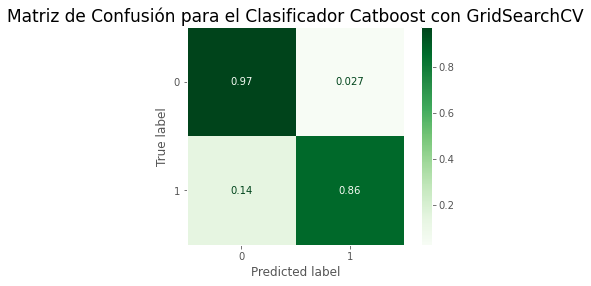

__________________________________________________________________


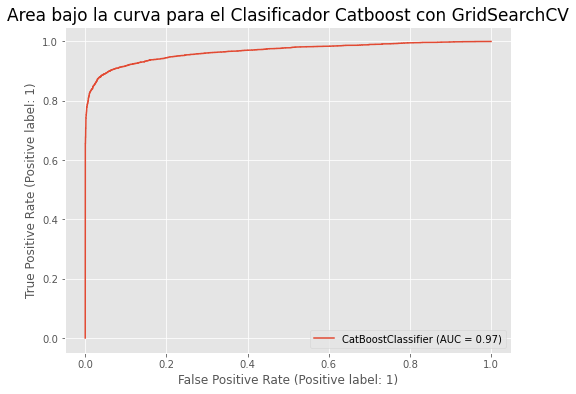

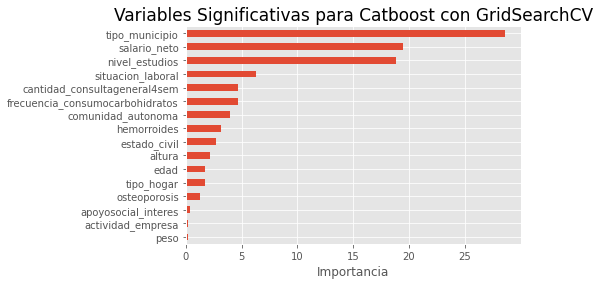

In [92]:
# Evaluación del modelo
pf.evaluate_model(cat_gridmodel, X_train, X_test, y_test, 
               title='Catboost con GridSearchCV', tree=True)

### 6.- Minería de Datos

Una vez ejecutados los 9 algoritmos de clasificación en su versión por defecto, y analizando su rendimiento con una parrilla de estimados, se debe escoger que estrategia tomar para la selección de un modelo definitivo que nos permita buscar patrones de predicción en la ansiedad y la depresión.

Para ello seleccionaremos los tres modelos que mejor rendimiento han ofrecido, tomando en cuenta los siguientes supuestos:

* __Mayor precisión__ en los valores del conjunto de datos correctamente clasificados…
* __Sensibilidad (recall)__ en la clasificación de cada clase; es importante tener en cuenta que un falso negativo puede ocasionar que un individuo presenta la enfermedad (1), pero que el modelo indique que no (0). Por ello este ratio debe ser el mas bajo posible.
* __Ratio alto en el AUC__, para asegurar que el modelo predice mas verdaderos positivos, que falsos positivos.

#### 6.1- Comparación de métricas

In [103]:
clasificador = {"Regresión Logística":logreg_clf,
                "Regresión Logística Grid":logreg_grid2,
                "Arbol de Decisión": tree_clf,
                "Arbol de Decisión Grid ": tree_grid2,
                "Random Forest": forest_clf,
                "Random Forest Grid": forest_grid2,
                "SVM": svm_clf,
                "SVM Grid": svm_grid2,
                "Naive Bayes": gnb_clf,
                "Naive Bayes Grid": nb_grid2,
                "Xgboost": xgb_clf,
                "Xgboost Grid": xgb_grid2,
                "CatBoost": cat_clf,
                "CatBoost Grid": cat_grid2,
                "Extra Trees": extratrees_clf,
                "Extra Trees Grid": extratrees_grid2,
                "SGD": sgd_clf,
                "SGD Grid": sgd_grid2
               }

In [104]:
#Precisión
from sklearn.metrics import accuracy_score

for nombre,clasf in clasificador.items():
    accuracy_clf= accuracy_score(y_true = y_test,
                                 y_pred = clasf.predict(X_test)
                                )

    acc_test = round(accuracy_clf,3)
    print("La precisión para el Modelo - %s" % nombre, "es: %s" %acc_test)

La precisión para el Modelo - Regresión Logística es: 0.635
La precisión para el Modelo - Regresión Logística Grid es: 0.635
La precisión para el Modelo - Arbol de Decisión es: 0.904
La precisión para el Modelo - Arbol de Decisión Grid  es: 0.72
La precisión para el Modelo - Random Forest es: 0.958
La precisión para el Modelo - Random Forest Grid es: 0.958
La precisión para el Modelo - SVM es: 0.836
La precisión para el Modelo - SVM Grid es: 0.932
La precisión para el Modelo - Naive Bayes es: 0.629
La precisión para el Modelo - Naive Bayes Grid es: 0.629
La precisión para el Modelo - Xgboost es: 0.921
La precisión para el Modelo - Xgboost Grid es: 0.951
La precisión para el Modelo - CatBoost es: 0.95
La precisión para el Modelo - CatBoost Grid es: 0.918
La precisión para el Modelo - Extra Trees es: 0.982
La precisión para el Modelo - Extra Trees Grid es: 0.973
La precisión para el Modelo - SGD es: 0.632
La precisión para el Modelo - SGD Grid es: 0.631


In [105]:
#Recall
from sklearn.metrics import recall_score

for nombre,clasf in clasificador.items():
    recall_clf = recall_score(y_true = y_test,
                              y_pred = clasf.predict(X_test),
                              average = None
                             )
    clase0 = round(recall_clf[0],3)
    clase1 = round(recall_clf[1],3)
    
    print("El recall para el Modelo - %s" % nombre, "es:", "[0] %s" % clase0, "[1] %s" % clase1)

El recall para el Modelo - Regresión Logística es: [0] 0.676 [1] 0.594
El recall para el Modelo - Regresión Logística Grid es: [0] 0.676 [1] 0.594
El recall para el Modelo - Arbol de Decisión es: [0] 0.892 [1] 0.917
El recall para el Modelo - Arbol de Decisión Grid  es: [0] 0.837 [1] 0.604
El recall para el Modelo - Random Forest es: [0] 0.988 [1] 0.927
El recall para el Modelo - Random Forest Grid es: [0] 0.988 [1] 0.927
El recall para el Modelo - SVM es: [0] 0.781 [1] 0.892
El recall para el Modelo - SVM Grid es: [0] 0.876 [1] 0.988
El recall para el Modelo - Naive Bayes es: [0] 0.739 [1] 0.519
El recall para el Modelo - Naive Bayes Grid es: [0] 0.739 [1] 0.519
El recall para el Modelo - Xgboost es: [0] 0.977 [1] 0.865
El recall para el Modelo - Xgboost Grid es: [0] 0.992 [1] 0.91
El recall para el Modelo - CatBoost es: [0] 0.994 [1] 0.906
El recall para el Modelo - CatBoost Grid es: [0] 0.973 [1] 0.864
El recall para el Modelo - Extra Trees es: [0] 0.98 [1] 0.984
El recall para el M

#### 6.2- Evaluación del modelo final

Como se puede observar en las gráficas y valores anteriores, hay cuatro modelos que no aportan la precisión ni la sensibilidad adecuada para la detección de este tipo de enfermedades; ellos son: Regresión Logística, Arboles de Decisión, Naive Bayes y SGD.

Pero por otro lado los algoritmos basados en conjunto de modelos (ensembles) y Support Vector Machine, si ofrecen unas métricas adecuadas al objetivo del estudio.

De hecho, los algoritmos SVM y XgBoost mejoran notablemente con la selección adecuada de estimadores.

De todos estos, el que mejor rendimiento presentó fue el clasificador Extra Tree. Por lo que para tomar una desición final; vamos a construir un stack de clasificadores con Random Forest, SVM y Xgboost y comparamos si en conjunto mejoran las métricas del Extra Tree.


In [107]:
estimators_grid = [
                    ('forest', forest_gridmodel),
                    ('svm', svm_gridmodel),
                    ('xgboost', xgb_gridmodel),  
                  ]
estimators_grid

[('forest', RandomForestClassifier(random_state=123)),
 ('svm', NuSVC(nu=0.125, random_state=123)),
 ('xgboost',
  XGBClassifier(max_depth=10, n_jobs=-1, random_state=123, subsample=0.7))]

In [108]:
# Cración del clasificador stack
stack_grid = StackingClassifier(estimators=estimators_grid, 
                                n_jobs=-1, 
                                passthrough=True,
                                final_estimator=LogisticRegression(random_state=rmst, n_jobs=-1))
stack_grid

StackingClassifier(estimators=[('forest',
                                RandomForestClassifier(random_state=123)),
                               ('svm', NuSVC(nu=0.125, random_state=123)),
                               ('xgboost',
                                XGBClassifier(max_depth=10, n_jobs=-1,
                                              random_state=123,
                                              subsample=0.7))],
                   final_estimator=LogisticRegression(n_jobs=-1,
                                                      random_state=123),
                   n_jobs=-1, passthrough=True)

In [109]:
# Entrenamiento del modelo stack
stackgrid_model = stack_grid.fit(X_train, y_train)

__________________________________________________________________
Reporte para el Clasificador: 
	Stacked Model
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.95      0.98      0.96      4056
           1       0.98      0.94      0.96      4056

    accuracy                           0.96      8112
   macro avg       0.96      0.96      0.96      8112
weighted avg       0.96      0.96      0.96      8112

__________________________________________________________________


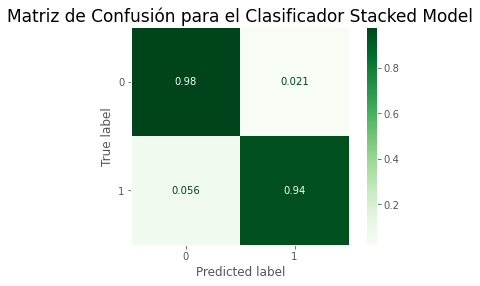

__________________________________________________________________


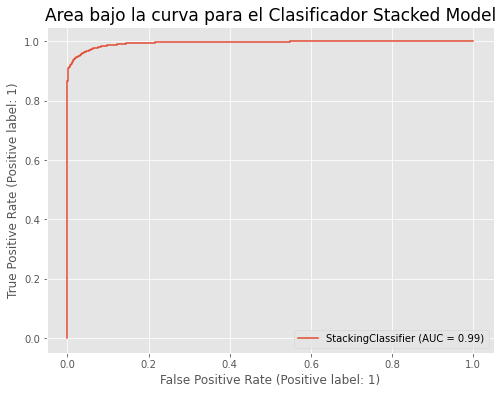

In [110]:
# Evaluación del modelo stack
pf.evaluate_model(stackgrid_model, X_train, X_test, y_test, 
               title='Stacked Model')

In [117]:
#Matriz de confusión del Stack
y_pred = extratrees_gridmodel.predict(X_test)
conf_mat = confusion_matrix(y_true=y_test, y_pred=y_pred)
print('Confusion matrix:\n', conf_mat)

Confusion matrix:
 [[3920  136]
 [  87 3969]]


In [114]:
#Matriz de confusión del Stack
y_pred = stackgrid_model.predict(X_test)
conf_mat = confusion_matrix(y_true=y_test, y_pred=y_pred)
print('Confusion matrix:\n', conf_mat)

Confusion matrix:
 [[3969   87]
 [ 229 3827]]


Como se puede observar el rendimiento y resultado de las métricas entre el Stack Classifier y el Extra Tree Classifier son mínimas, por lo que podemos considerar que ambas aproximaciones son correctas.

Pero si ilustramos el número de casos que se han clasificado como falsos negativos, un dato muy sensible a la valoración de enfermedades, nos decantamos por usar el __Modelo Simple con Clasificador Extra Tree__.

A nivel de velocidad de convergencia, el Extra Tree de por sí es un método más rápido que el usar estimadores en stack, algo a considerar en trabajos futuros si se añaden conjunto de datos con mayor número de instancias.

Dicho esto, esta es la evaluación del modelo escogido:

__________________________________________________________________
Reporte para el Clasificador: 
	Extra Trees con GridSearch CV
__________________________________________________________________


              precision    recall  f1-score   support

           0       0.98      0.97      0.97      4056
           1       0.97      0.98      0.97      4056

    accuracy                           0.97      8112
   macro avg       0.97      0.97      0.97      8112
weighted avg       0.97      0.97      0.97      8112

__________________________________________________________________


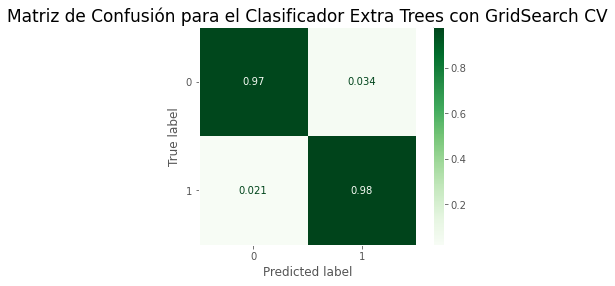

__________________________________________________________________


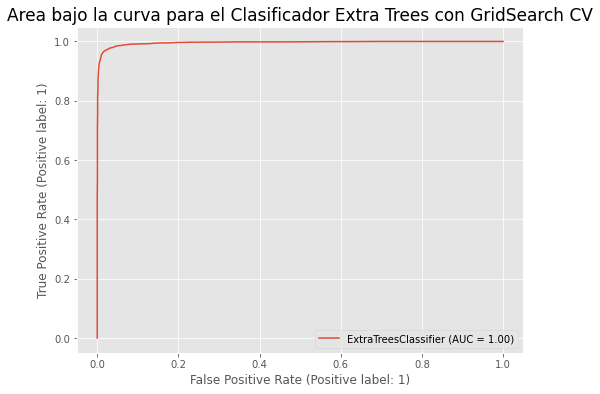

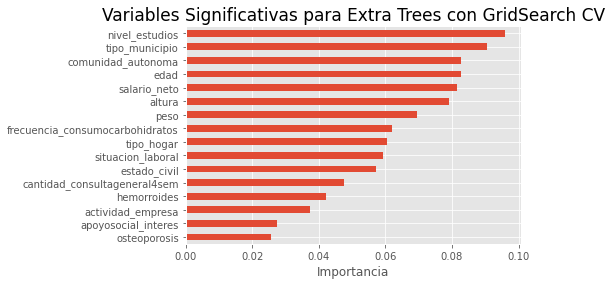

In [118]:
# Evaluación del modelo
pf.evaluate_model(extratrees_gridmodel, X_train, X_test, y_test, 
               tree=True, title='Extra Trees con GridSearch CV')

Con el uso de la herramienta PowerBI, se ilustrarán las tendencias de la variables significativas del modelo y su relación con la ansiedad y al depresión.

In [120]:
fin = datetime.now()
print("Fecha y hora de inicio =", inicio)
print("Fecha y hora de finalización =", fin)

Fecha y hora de inicio = 2022-09-02 20:28:38.005978
Fecha y hora de finalización = 2022-09-03 00:52:58.323132
